<a href="https://colab.research.google.com/github/Shobhit2000/MNIST_GAN/blob/master/MNIST_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Importing Libraries**

In [0]:
import numpy as np
import matplotlib.pyplot as plt
from keras.datasets import mnist
from keras.models import Model
from keras.layers import Dense, Conv2D, Flatten, UpSampling2D, Reshape, Input, LeakyReLU, BatchNormalization, Dropout, Conv2DTranspose
from keras.optimizers import Adam, SGD

Using TensorFlow backend.


**Loading the MNIST dataset**

In [0]:
def dataset():
  (X_train, _), (_, _) = mnist.load_data()
  X_train = np.reshape(X_train, [-1, 28, 28, 1])
  X_train = X_train.astype('float32')/255
  return X_train

**Generator Model**

In [0]:
def generator(inp):
  x = Dense(7*7*64)(inp)
  x = LeakyReLU(alpha = 0.3)(x)
  x = BatchNormalization()(x)
  x = Reshape((7, 7, 64), input_shape = (7*7*64,))(x)
  x = Conv2DTranspose(128, (3, 3), strides = 2, padding = 'same')(x)
  x = LeakyReLU(alpha = 0.2)(x)
  x = BatchNormalization()(x)
  x = Conv2DTranspose(64, (3,3), strides = 2, padding = 'same')(x)
  x = LeakyReLU(alpha = 0.2)(x)
  x = Conv2DTranspose(32, (3, 3), strides = 2, padding = 'same')(x)
  x = LeakyReLU(alpha = 0.2)(x)
  x = BatchNormalization()(x)
  x = Conv2DTranspose(1, (3, 3), strides = 1, padding = 'same')(x)
  x_out = LeakyReLU(alpha = 0.2)(x)
  gen_model = Model(inp, x_out)
  gen_model.summary()

  return gen_model

**Discriminator Model**

In [0]:
def discriminator(inputs):
  i = inputs
  y = Conv2D(32, (3, 3), padding='same')(i)
  y = LeakyReLU(alpha=0.2)(y)
  y = Conv2D(64, (3, 3), padding='same')(y)
  y = LeakyReLU(alpha=0.2)(y)
  y = Conv2D(128, (3, 3), padding='same')(y)
  y = Dropout(0.2)(y)
  y = LeakyReLU(alpha=0.2)(y)
  y = Conv2D(256, (3, 3), padding='same')(y)
  y = Dropout(0.2)(y)
  y = LeakyReLU(alpha=0.2)(y)
  y = Flatten()(y)
  y_out = Dense(1, activation='sigmoid')(y)
  disc_model = Model(i, y_out)
  disc_model.summary()

  return disc_model

**Display Generated Image**

In [0]:
def disp_img(imgs):
  imgs = imgs[0]
  imgs = np.reshape(imgs, [28, 28])
  print(imgs.shape)
  plt.imshow(imgs, cmap='gray')
  plt.show()
  plt.axis('off')
  #Pred_img.append(imgs)

**Training**

In [0]:
def train():
  
  batch_size = 100
  z_shape = 128
  epochs = 500
  input_size = 28

  #disc_optimizer = Adam(lr = 0.007, beta_1 = 0.5)
  disc_optimizer = SGD(lr = 0.004, momentum = 0.8, nesterov = True)
  gen_optimizer = SGD(lr = 0.005, momentum = 0.8, nesterov = True)
  #gen_optimizer = Adam(lr = 0.008, beta_1 = 0.5)

  inp_shape = (z_shape, )  
  inp = Input(shape = inp_shape)
  gen_model = generator(inp)
  gen_model.compile(loss = 'binary_crossentropy', optimizer = gen_optimizer)

  input_dim = (28, 28, 1)
  inputs = Input(shape = input_dim)
  disc_model = discriminator(inputs)
  disc_model.compile(optimizer = disc_optimizer, loss = 'binary_crossentropy')

  disc_model.trainable = False
  adverserial = Model(inp, disc_model(gen_model(inp)))
  adverserial.compile(loss = 'binary_crossentropy',
                      optimizer = gen_optimizer,
                      metrics = ['accuracy'])
  adverserial.summary()

  X_batch = dataset()
  num_batches = X_batch.shape[0] / batch_size
  print(X_batch.shape)

  for i in range(epochs):
    print('epoch :', i)
    
    for j in range(int(num_batches)):
      
      #training discriminator
      z_noise = np.random.randint(0, 1, size = (batch_size, z_shape))
      img_batch = X_batch[j * batch_size : (j + 1) * batch_size]
      generated_batch = gen_model.predict_on_batch(z_noise)

      y_fake = np.random.random_sample(batch_size) * 0.2
      y_real = np.ones(batch_size) - np.random.random_sample(batch_size) * 0.2

      real = disc_model.train_on_batch(img_batch, y_real)
      fake = disc_model.train_on_batch(generated_batch, y_fake)

      disc_loss = (real + fake) / 2
      print('discriminator loss :', disc_loss)
      
      #Training adverserial
      z_noise = np.random.randint(0, 1, size=(batch_size, z_shape))
      generator_loss = adverserial.train_on_batch(z_noise, y_real)
      print("Generator loss :", generator_loss)

      if(epochs % 100 == 0):
        
        z_noise = np.random.randint(0, 1, size=(1, z_shape))
        predicted_img = gen_model.predict(z_noise)
        print(predicted_img.shape)
        disp_img(predicted_img)












Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 3136)              404544    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 3136)              0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 3136)              12544     
_________________________________________________________________
reshape_1 (Reshape)          (None, 7, 7, 64)          0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 14, 14, 128)       73856     
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 14, 14, 128)

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


discriminator loss : 0.6891275644302368
Generator loss : [0.6927651, 0.0]
(1, 28, 28, 1)
(28, 28)


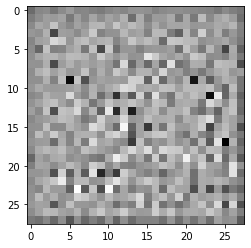

discriminator loss : 0.6726677417755127
Generator loss : [0.69277894, 0.0]
(1, 28, 28, 1)
(28, 28)


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


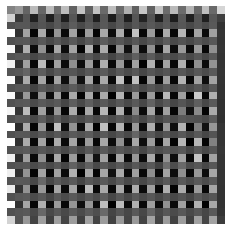

discriminator loss : 0.6538856625556946
Generator loss : [0.69309175, 0.0]
(1, 28, 28, 1)
(28, 28)


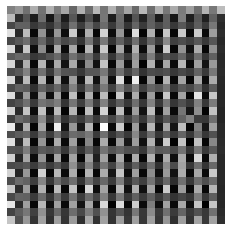

discriminator loss : 0.6324833631515503
Generator loss : [0.6939239, 0.0]
(1, 28, 28, 1)
(28, 28)


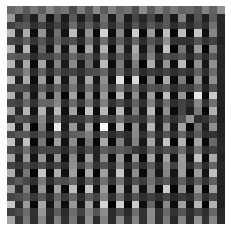

discriminator loss : 0.6123496294021606
Generator loss : [0.69482756, 0.0]
(1, 28, 28, 1)
(28, 28)


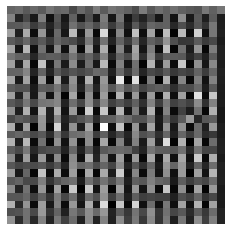

discriminator loss : 0.5936427712440491
Generator loss : [0.69685996, 0.0]
(1, 28, 28, 1)
(28, 28)


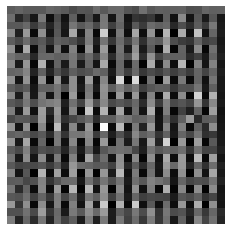

discriminator loss : 0.5665338039398193
Generator loss : [0.6989596, 0.0]
(1, 28, 28, 1)
(28, 28)


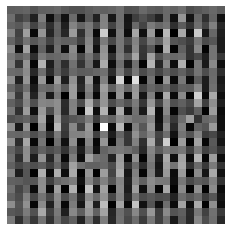

discriminator loss : 0.5419948697090149
Generator loss : [0.70162714, 0.0]
(1, 28, 28, 1)
(28, 28)


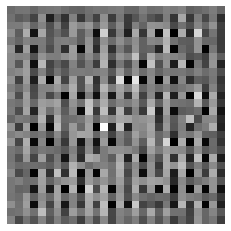

discriminator loss : 0.5308117866516113
Generator loss : [0.70534796, 0.0]
(1, 28, 28, 1)
(28, 28)


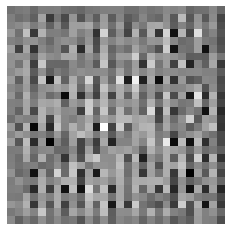

discriminator loss : 0.5165960788726807
Generator loss : [0.71015066, 0.0]
(1, 28, 28, 1)
(28, 28)


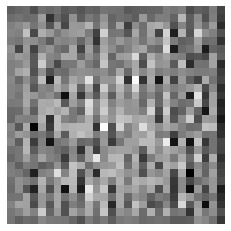

discriminator loss : 0.5170576572418213
Generator loss : [0.7165928, 0.0]
(1, 28, 28, 1)
(28, 28)


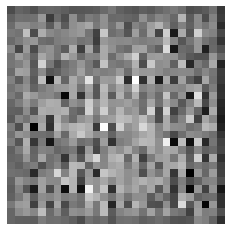

discriminator loss : 0.5146563053131104
Generator loss : [0.7245494, 0.0]
(1, 28, 28, 1)
(28, 28)


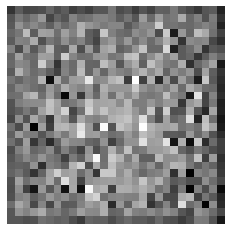

discriminator loss : 0.5049989819526672
Generator loss : [0.7370072, 0.0]
(1, 28, 28, 1)
(28, 28)


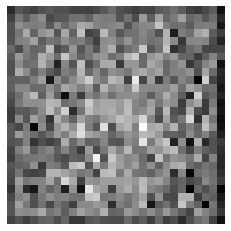

discriminator loss : 0.49938908219337463
Generator loss : [0.7507431, 0.0]
(1, 28, 28, 1)
(28, 28)


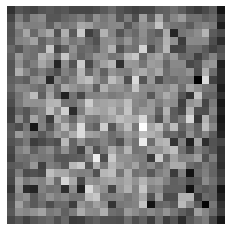

discriminator loss : 0.488391250371933
Generator loss : [0.7666926, 0.0]
(1, 28, 28, 1)
(28, 28)


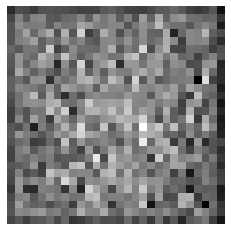

discriminator loss : 0.47544628381729126
Generator loss : [0.78783417, 0.0]
(1, 28, 28, 1)
(28, 28)


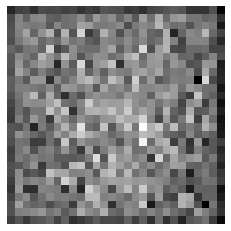

discriminator loss : 0.4783506989479065
Generator loss : [0.8077982, 0.0]
(1, 28, 28, 1)
(28, 28)


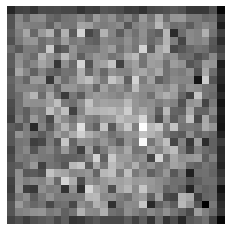

discriminator loss : 0.47443413734436035
Generator loss : [0.83585185, 0.0]
(1, 28, 28, 1)
(28, 28)


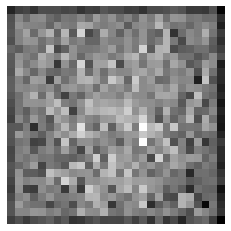

discriminator loss : 0.4621642827987671
Generator loss : [0.87649405, 0.0]
(1, 28, 28, 1)
(28, 28)


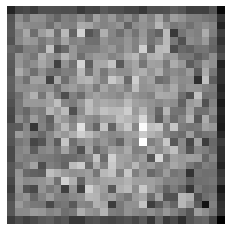

discriminator loss : 0.45156919956207275
Generator loss : [0.93004507, 0.0]
(1, 28, 28, 1)
(28, 28)


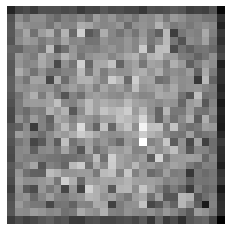

discriminator loss : 0.43072348833084106
Generator loss : [0.996473, 0.0]
(1, 28, 28, 1)
(28, 28)


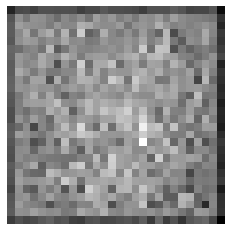

discriminator loss : 0.4287670850753784
Generator loss : [1.067075, 0.0]
(1, 28, 28, 1)
(28, 28)


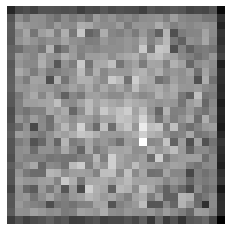

discriminator loss : 0.4170302152633667
Generator loss : [1.147263, 0.0]
(1, 28, 28, 1)
(28, 28)


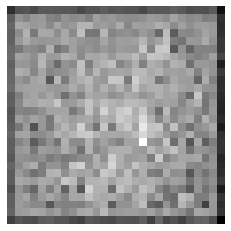

discriminator loss : 0.44700944423675537
Generator loss : [1.2193431, 0.0]
(1, 28, 28, 1)
(28, 28)


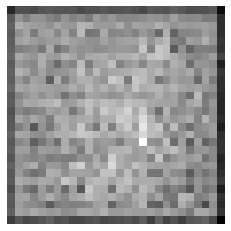

discriminator loss : 0.46052032709121704
Generator loss : [1.2945267, 0.0]
(1, 28, 28, 1)
(28, 28)


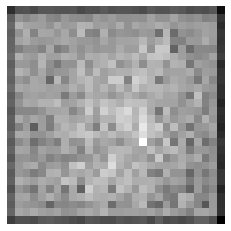

discriminator loss : 0.47658592462539673
Generator loss : [1.3787293, 0.0]
(1, 28, 28, 1)
(28, 28)


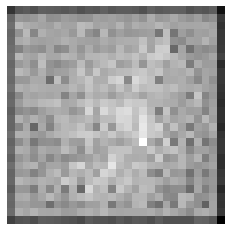

discriminator loss : 0.5649130344390869
Generator loss : [1.4210018, 0.0]
(1, 28, 28, 1)
(28, 28)


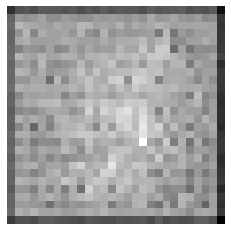

discriminator loss : 0.6387301087379456
Generator loss : [1.3584104, 0.0]
(1, 28, 28, 1)
(28, 28)


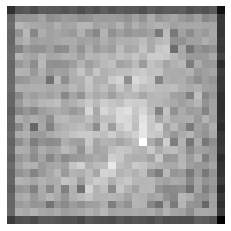

discriminator loss : 0.6521047353744507
Generator loss : [1.2709883, 0.0]
(1, 28, 28, 1)
(28, 28)


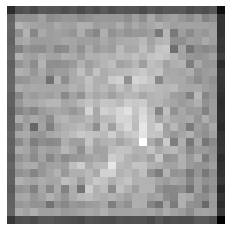

discriminator loss : 0.6650964617729187
Generator loss : [1.124757, 0.0]
(1, 28, 28, 1)
(28, 28)


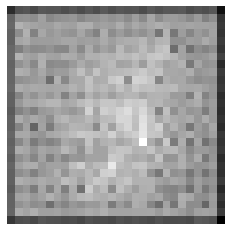

discriminator loss : 0.6476357579231262
Generator loss : [1.0712181, 0.0]
(1, 28, 28, 1)
(28, 28)


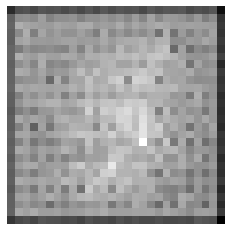

discriminator loss : 0.6095660328865051
Generator loss : [1.0064397, 0.0]
(1, 28, 28, 1)
(28, 28)


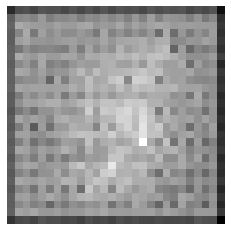

discriminator loss : 0.5625391006469727
Generator loss : [0.9824641, 0.0]
(1, 28, 28, 1)
(28, 28)


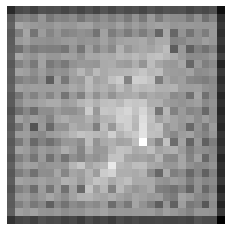

discriminator loss : 0.513705849647522
Generator loss : [0.9915414, 0.0]
(1, 28, 28, 1)
(28, 28)


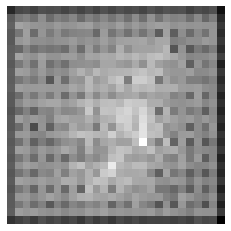

discriminator loss : 0.47656044363975525
Generator loss : [1.0888051, 0.0]
(1, 28, 28, 1)
(28, 28)


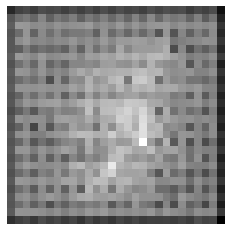

discriminator loss : 0.4318208694458008
Generator loss : [1.202014, 0.0]
(1, 28, 28, 1)
(28, 28)


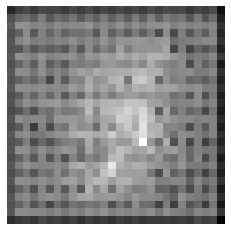

discriminator loss : 0.4019157290458679
Generator loss : [1.3145452, 0.0]
(1, 28, 28, 1)
(28, 28)


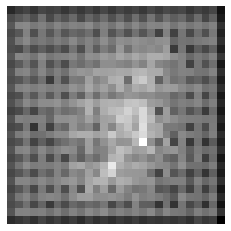

discriminator loss : 0.371395468711853
Generator loss : [1.4772141, 0.0]
(1, 28, 28, 1)
(28, 28)


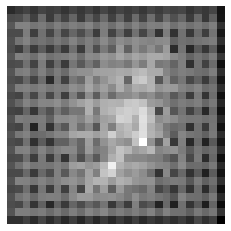

discriminator loss : 0.3574422597885132
Generator loss : [1.6636512, 0.0]
(1, 28, 28, 1)
(28, 28)


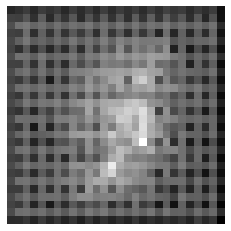

discriminator loss : 0.334444522857666
Generator loss : [1.8687367, 0.0]
(1, 28, 28, 1)
(28, 28)


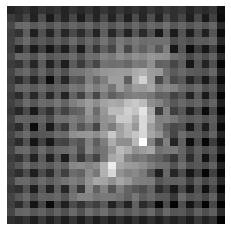

discriminator loss : 0.3228643536567688
Generator loss : [2.0249534, 0.0]
(1, 28, 28, 1)
(28, 28)


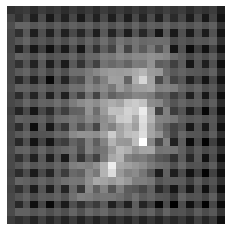

discriminator loss : 0.3233479857444763
Generator loss : [2.1965153, 0.0]
(1, 28, 28, 1)
(28, 28)


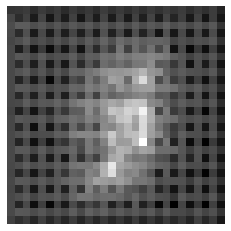

discriminator loss : 0.3246322274208069
Generator loss : [2.414356, 0.0]
(1, 28, 28, 1)
(28, 28)


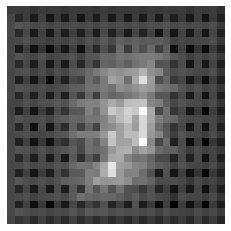

discriminator loss : 0.3546554446220398
Generator loss : [2.8311887, 0.0]
(1, 28, 28, 1)
(28, 28)


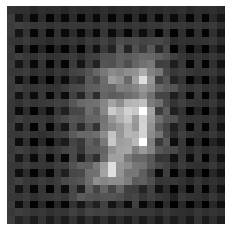

discriminator loss : 0.38498252630233765
Generator loss : [4.3848705, 0.0]
(1, 28, 28, 1)
(28, 28)


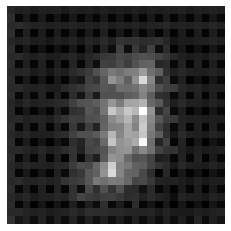

discriminator loss : 0.43201130628585815
Generator loss : [6.518717, 0.0]
(1, 28, 28, 1)
(28, 28)


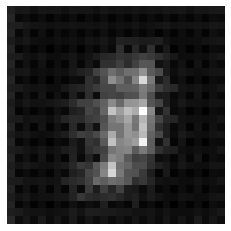

discriminator loss : 0.7000074982643127
Generator loss : [7.952894, 0.0]
(1, 28, 28, 1)
(28, 28)


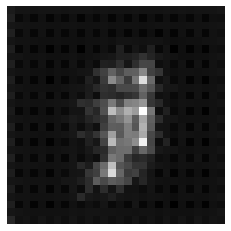

discriminator loss : 1.111084222793579
Generator loss : [6.2415895, 0.0]
(1, 28, 28, 1)
(28, 28)


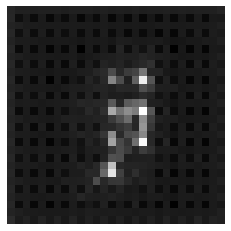

discriminator loss : 1.871917963027954
Generator loss : [1.7502862, 0.0]
(1, 28, 28, 1)
(28, 28)


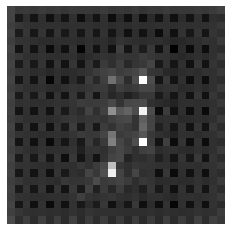

discriminator loss : 1.174638271331787
Generator loss : [0.762598, 0.0]
(1, 28, 28, 1)
(28, 28)


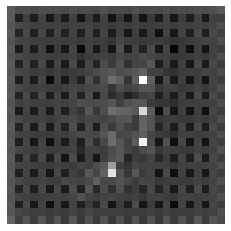

discriminator loss : 0.9024530649185181
Generator loss : [0.7356331, 0.0]
(1, 28, 28, 1)
(28, 28)


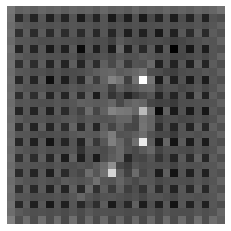

discriminator loss : 0.7535626888275146
Generator loss : [0.74499077, 0.0]
(1, 28, 28, 1)
(28, 28)


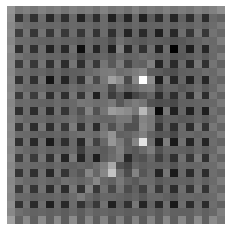

discriminator loss : 0.6961279511451721
Generator loss : [0.7453716, 0.0]
(1, 28, 28, 1)
(28, 28)


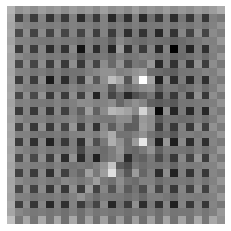

discriminator loss : 0.6654250621795654
Generator loss : [0.7431091, 0.0]
(1, 28, 28, 1)
(28, 28)


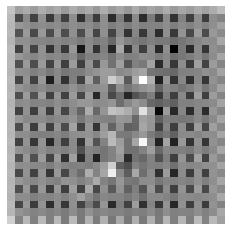

discriminator loss : 0.6460047960281372
Generator loss : [0.7424025, 0.0]
(1, 28, 28, 1)
(28, 28)


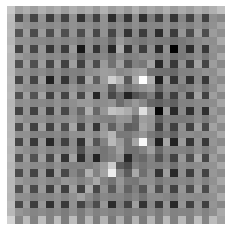

discriminator loss : 0.6253117918968201
Generator loss : [0.74385965, 0.0]
(1, 28, 28, 1)
(28, 28)


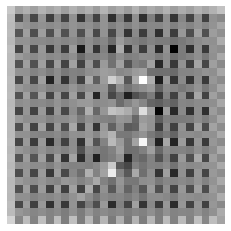

discriminator loss : 0.602895200252533
Generator loss : [0.74866915, 0.0]
(1, 28, 28, 1)
(28, 28)


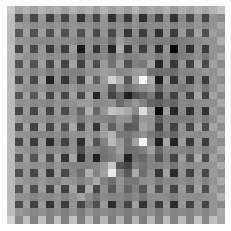

discriminator loss : 0.5807472467422485
Generator loss : [0.76056147, 0.0]
(1, 28, 28, 1)
(28, 28)


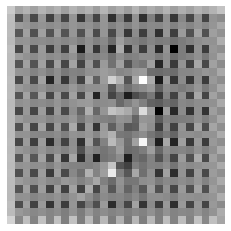

discriminator loss : 0.549616813659668
Generator loss : [0.7847325, 0.0]
(1, 28, 28, 1)
(28, 28)


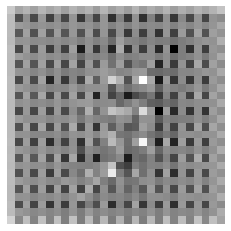

discriminator loss : 0.5146691799163818
Generator loss : [0.82348955, 0.0]
(1, 28, 28, 1)
(28, 28)


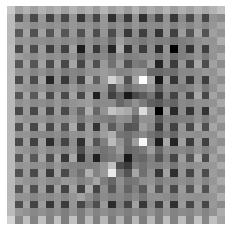

discriminator loss : 0.473028302192688
Generator loss : [0.87817985, 0.0]
(1, 28, 28, 1)
(28, 28)


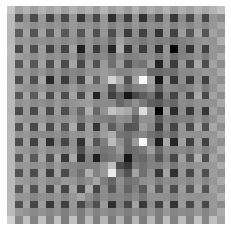

discriminator loss : 0.43185484409332275
Generator loss : [0.93834037, 0.0]
(1, 28, 28, 1)
(28, 28)


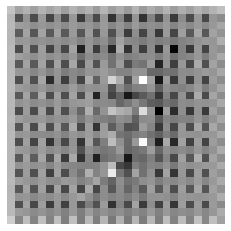

discriminator loss : 0.3940364122390747
Generator loss : [1.0084699, 0.0]
(1, 28, 28, 1)
(28, 28)


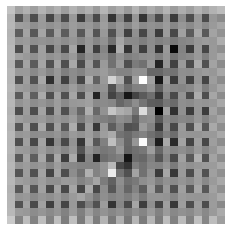

discriminator loss : 0.369451642036438
Generator loss : [1.0959234, 0.0]
(1, 28, 28, 1)
(28, 28)


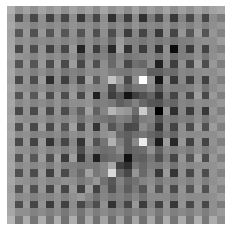

discriminator loss : 0.3459022641181946
Generator loss : [1.1782762, 0.0]
(1, 28, 28, 1)
(28, 28)


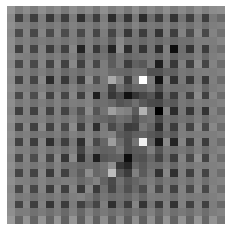

discriminator loss : 0.34651094675064087
Generator loss : [1.2151586, 0.0]
(1, 28, 28, 1)
(28, 28)


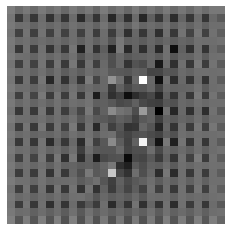

discriminator loss : 0.3472539782524109
Generator loss : [1.1820332, 0.0]
(1, 28, 28, 1)
(28, 28)


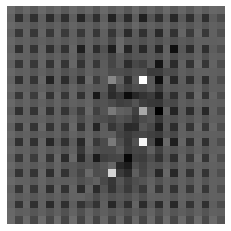

discriminator loss : 0.3353741765022278
Generator loss : [1.1057509, 0.0]
(1, 28, 28, 1)
(28, 28)


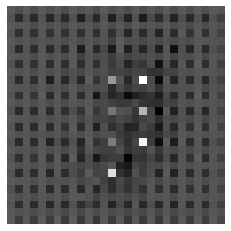

discriminator loss : 0.34740087389945984
Generator loss : [1.1645749, 0.0]
(1, 28, 28, 1)
(28, 28)


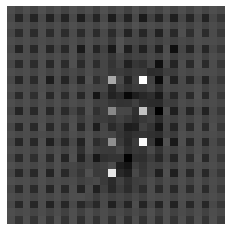

discriminator loss : 0.35365521907806396
Generator loss : [1.2076173, 0.0]
(1, 28, 28, 1)
(28, 28)


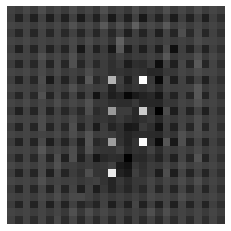

discriminator loss : 0.4117438495159149
Generator loss : [1.0772268, 0.0]
(1, 28, 28, 1)
(28, 28)


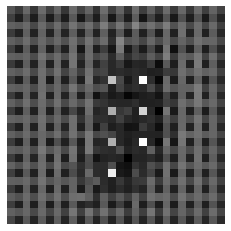

discriminator loss : 1.1934148073196411
Generator loss : [1.3707167, 0.0]
(1, 28, 28, 1)
(28, 28)


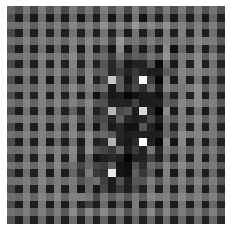

discriminator loss : 1.2448146343231201
Generator loss : [1.0213207, 0.0]
(1, 28, 28, 1)
(28, 28)


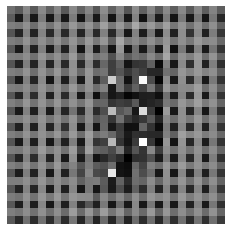

discriminator loss : 0.9276415109634399
Generator loss : [0.89223176, 0.0]
(1, 28, 28, 1)
(28, 28)


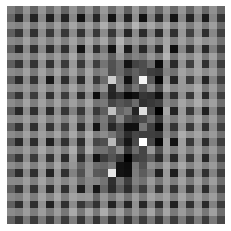

discriminator loss : 0.6408693790435791
Generator loss : [1.0216894, 0.0]
(1, 28, 28, 1)
(28, 28)


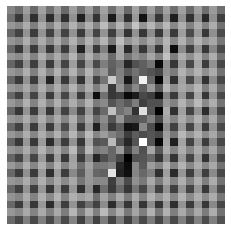

discriminator loss : 0.49667924642562866
Generator loss : [1.3547782, 0.0]
(1, 28, 28, 1)
(28, 28)


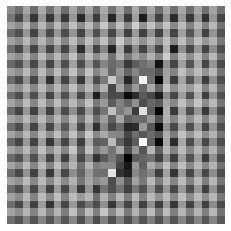

discriminator loss : 0.40331900119781494
Generator loss : [1.842731, 0.0]
(1, 28, 28, 1)
(28, 28)


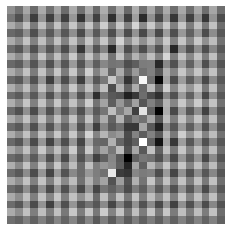

discriminator loss : 0.3617175221443176
Generator loss : [2.197431, 0.0]
(1, 28, 28, 1)
(28, 28)


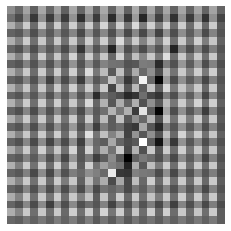

discriminator loss : 0.3374294638633728
Generator loss : [2.360057, 0.0]
(1, 28, 28, 1)
(28, 28)


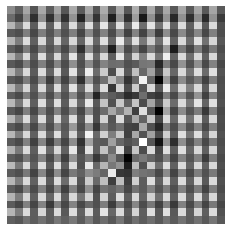

discriminator loss : 0.3306775689125061
Generator loss : [2.3598967, 0.0]
(1, 28, 28, 1)
(28, 28)


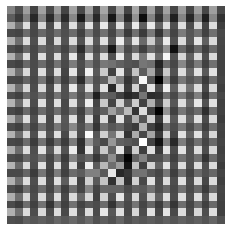

discriminator loss : 0.3485175371170044
Generator loss : [2.2321784, 0.0]
(1, 28, 28, 1)
(28, 28)


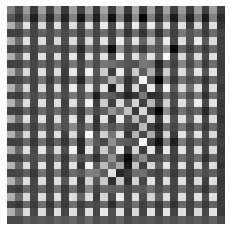

discriminator loss : 0.353788822889328
Generator loss : [2.104677, 0.0]
(1, 28, 28, 1)
(28, 28)


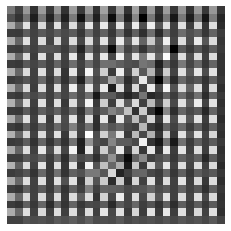

discriminator loss : 0.3416714370250702
Generator loss : [2.0812037, 0.0]
(1, 28, 28, 1)
(28, 28)


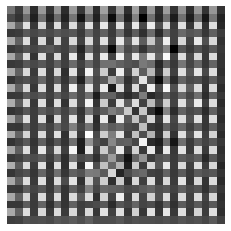

discriminator loss : 0.338677316904068
Generator loss : [2.083796, 0.0]
(1, 28, 28, 1)
(28, 28)


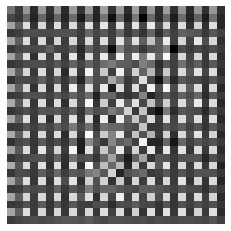

discriminator loss : 0.3385121524333954
Generator loss : [2.0842617, 0.0]
(1, 28, 28, 1)
(28, 28)


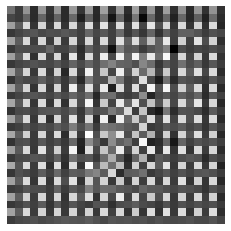

discriminator loss : 0.35921281576156616
Generator loss : [1.9541832, 0.0]
(1, 28, 28, 1)
(28, 28)


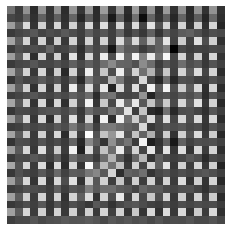

discriminator loss : 0.34236249327659607
Generator loss : [1.7961148, 0.0]
(1, 28, 28, 1)
(28, 28)


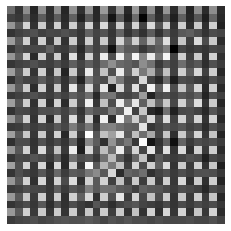

discriminator loss : 0.35619884729385376
Generator loss : [1.5546031, 0.0]
(1, 28, 28, 1)
(28, 28)


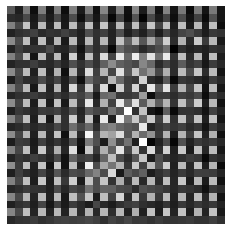

discriminator loss : 0.38232988119125366
Generator loss : [1.3644763, 0.0]
(1, 28, 28, 1)
(28, 28)


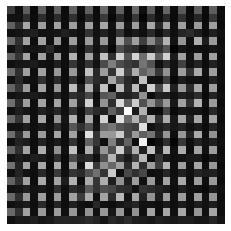

discriminator loss : 0.4139077067375183
Generator loss : [1.020798, 0.0]
(1, 28, 28, 1)
(28, 28)


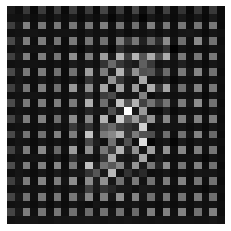

discriminator loss : 0.4368894398212433
Generator loss : [0.9726524, 0.0]
(1, 28, 28, 1)
(28, 28)


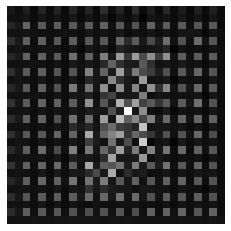

discriminator loss : 0.4581679701805115
Generator loss : [0.99584943, 0.0]
(1, 28, 28, 1)
(28, 28)


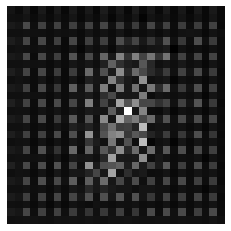

discriminator loss : 0.4660225510597229
Generator loss : [1.0634674, 0.0]
(1, 28, 28, 1)
(28, 28)


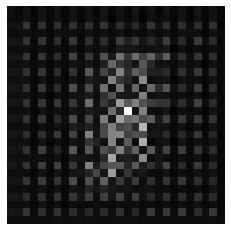

discriminator loss : 0.4602097272872925
Generator loss : [1.1833516, 0.0]
(1, 28, 28, 1)
(28, 28)


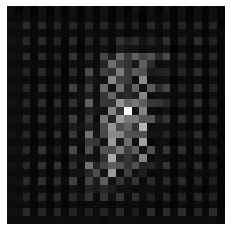

discriminator loss : 0.6269960403442383
Generator loss : [1.1765637, 0.0]
(1, 28, 28, 1)
(28, 28)


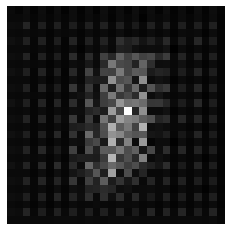

discriminator loss : 0.9155521988868713
Generator loss : [1.8892273, 0.0]
(1, 28, 28, 1)
(28, 28)


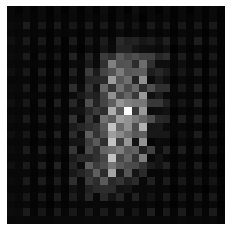

discriminator loss : 2.0167813301086426
Generator loss : [1.5081668, 0.0]
(1, 28, 28, 1)
(28, 28)


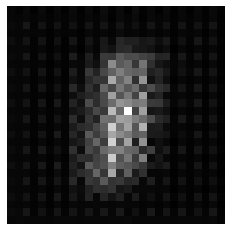

discriminator loss : 1.0490381717681885
Generator loss : [1.1002523, 0.0]
(1, 28, 28, 1)
(28, 28)


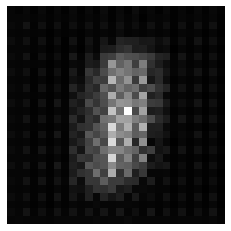

discriminator loss : 0.8229004740715027
Generator loss : [0.9919855, 0.0]
(1, 28, 28, 1)
(28, 28)


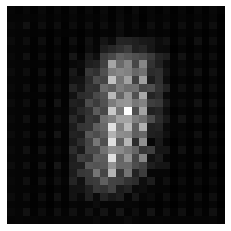

discriminator loss : 0.7070688009262085
Generator loss : [1.0578207, 0.0]
(1, 28, 28, 1)
(28, 28)


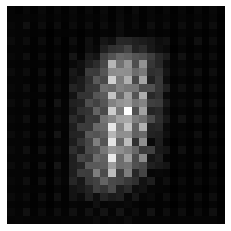

discriminator loss : 0.6137902140617371
Generator loss : [1.2939851, 0.0]
(1, 28, 28, 1)
(28, 28)


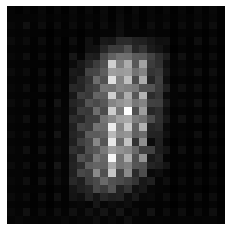

discriminator loss : 0.5681334137916565
Generator loss : [1.5776097, 0.0]
(1, 28, 28, 1)
(28, 28)


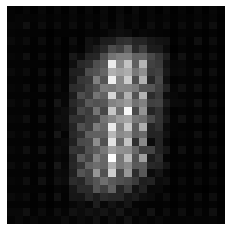

discriminator loss : 0.5321736931800842
Generator loss : [1.6741567, 0.0]
(1, 28, 28, 1)
(28, 28)


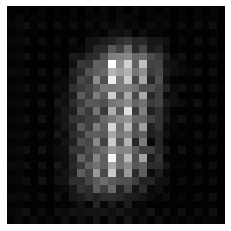

discriminator loss : 0.5063142776489258
Generator loss : [1.6292721, 0.0]
(1, 28, 28, 1)
(28, 28)


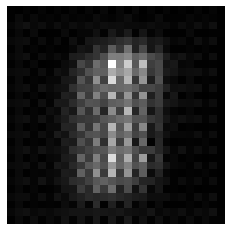

discriminator loss : 0.5035355091094971
Generator loss : [1.4367852, 0.0]
(1, 28, 28, 1)
(28, 28)


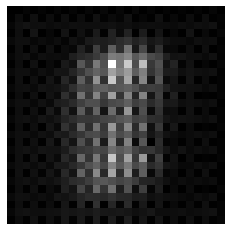

discriminator loss : 0.5035187602043152
Generator loss : [1.2271771, 0.0]
(1, 28, 28, 1)
(28, 28)


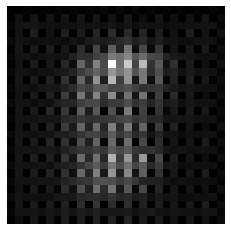

discriminator loss : 0.5085761547088623
Generator loss : [0.9579802, 0.0]
(1, 28, 28, 1)
(28, 28)


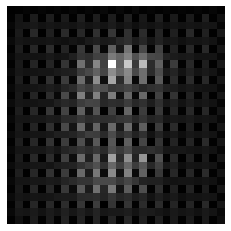

discriminator loss : 0.5153637528419495
Generator loss : [0.69014704, 0.0]
(1, 28, 28, 1)
(28, 28)


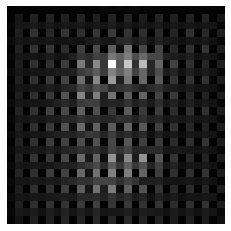

discriminator loss : 0.569847822189331
Generator loss : [0.57017255, 0.0]
(1, 28, 28, 1)
(28, 28)


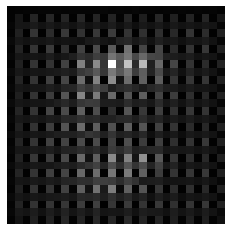

discriminator loss : 0.617838978767395
Generator loss : [0.5064441, 0.0]
(1, 28, 28, 1)
(28, 28)


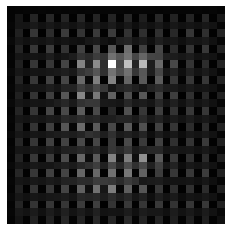

discriminator loss : 0.6012430191040039
Generator loss : [0.48972562, 0.0]
(1, 28, 28, 1)
(28, 28)


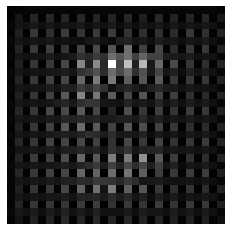

discriminator loss : 0.6054679155349731
Generator loss : [0.4754513, 0.0]
(1, 28, 28, 1)
(28, 28)


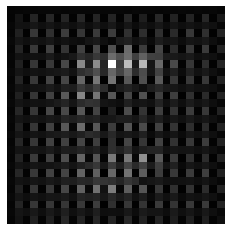

discriminator loss : 0.6319709420204163
Generator loss : [0.45479947, 0.0]
(1, 28, 28, 1)
(28, 28)


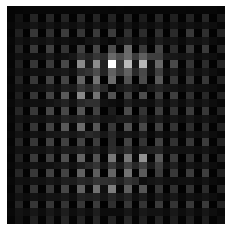

discriminator loss : 0.7160073518753052
Generator loss : [0.4239682, 0.0]
(1, 28, 28, 1)
(28, 28)


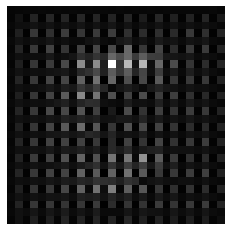

discriminator loss : 0.6971890926361084
Generator loss : [0.4212577, 0.0]
(1, 28, 28, 1)
(28, 28)


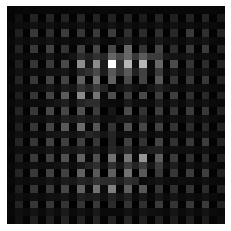

discriminator loss : 0.6769596338272095
Generator loss : [0.44904235, 0.0]
(1, 28, 28, 1)
(28, 28)


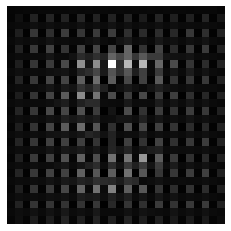

discriminator loss : 0.6899638772010803
Generator loss : [0.4488649, 0.0]
(1, 28, 28, 1)
(28, 28)


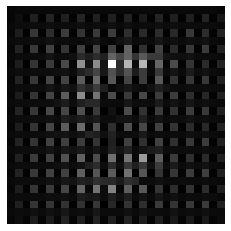

discriminator loss : 0.6757832765579224
Generator loss : [0.46240342, 0.0]
(1, 28, 28, 1)
(28, 28)


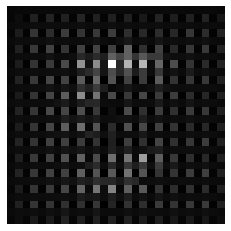

discriminator loss : 0.6269164085388184
Generator loss : [0.49061847, 0.0]
(1, 28, 28, 1)
(28, 28)


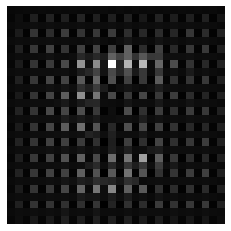

discriminator loss : 0.6141442060470581
Generator loss : [0.50776404, 0.0]
(1, 28, 28, 1)
(28, 28)


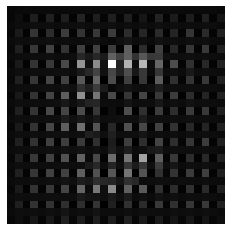

discriminator loss : 0.5740518569946289
Generator loss : [0.54188573, 0.0]
(1, 28, 28, 1)
(28, 28)


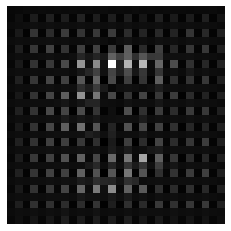

discriminator loss : 0.5362510085105896
Generator loss : [0.5832131, 0.0]
(1, 28, 28, 1)
(28, 28)


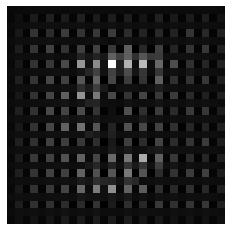

discriminator loss : 0.5129501819610596
Generator loss : [0.6167499, 0.0]
(1, 28, 28, 1)
(28, 28)


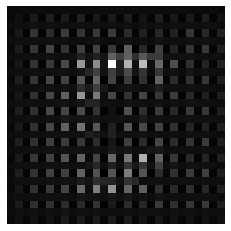

discriminator loss : 0.5001153945922852
Generator loss : [0.6584641, 0.0]
(1, 28, 28, 1)
(28, 28)


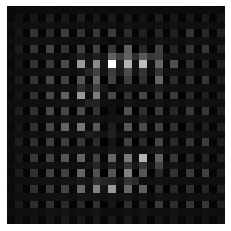

discriminator loss : 0.46097666025161743
Generator loss : [0.70855445, 0.0]
(1, 28, 28, 1)
(28, 28)


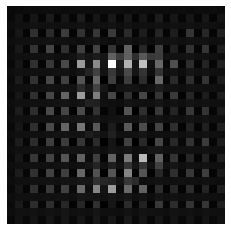

discriminator loss : 0.44664114713668823
Generator loss : [0.76569015, 0.0]
(1, 28, 28, 1)
(28, 28)


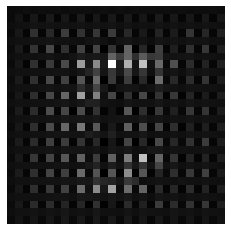

discriminator loss : 0.43109995126724243
Generator loss : [0.8304825, 0.0]
(1, 28, 28, 1)
(28, 28)


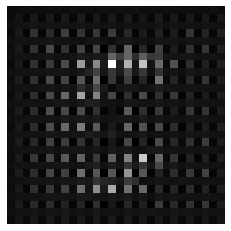

discriminator loss : 0.44354552030563354
Generator loss : [0.87353575, 0.0]
(1, 28, 28, 1)
(28, 28)


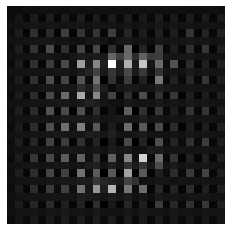

discriminator loss : 0.4279283285140991
Generator loss : [0.9135334, 0.0]
(1, 28, 28, 1)
(28, 28)


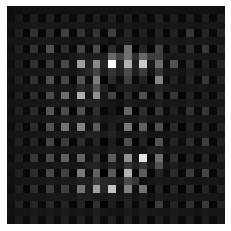

discriminator loss : 0.3928714990615845
Generator loss : [1.0067892, 0.0]
(1, 28, 28, 1)
(28, 28)


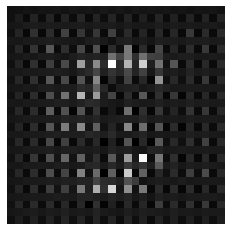

discriminator loss : 0.3861818015575409
Generator loss : [1.1239285, 0.0]
(1, 28, 28, 1)
(28, 28)


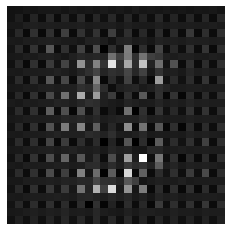

discriminator loss : 0.37872767448425293
Generator loss : [1.2234359, 0.0]
(1, 28, 28, 1)
(28, 28)


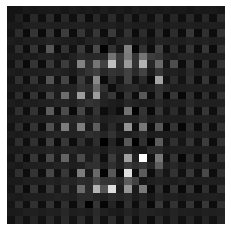

discriminator loss : 0.36492472887039185
Generator loss : [1.3042843, 0.0]
(1, 28, 28, 1)
(28, 28)


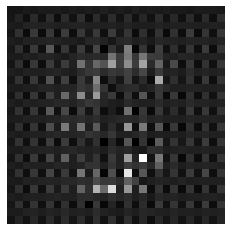

discriminator loss : 0.3613428473472595
Generator loss : [1.3768566, 0.0]
(1, 28, 28, 1)
(28, 28)


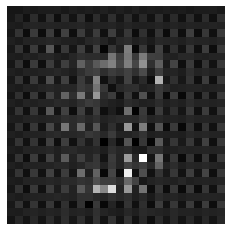

discriminator loss : 0.3506050109863281
Generator loss : [1.4751128, 0.0]
(1, 28, 28, 1)
(28, 28)


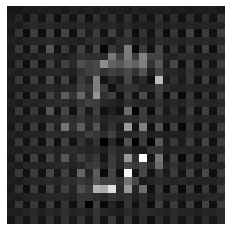

discriminator loss : 0.35528045892715454
Generator loss : [1.5630792, 0.0]
(1, 28, 28, 1)
(28, 28)


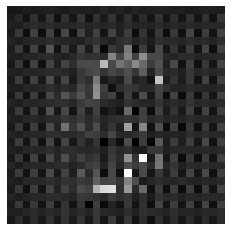

discriminator loss : 0.3782851994037628
Generator loss : [1.5277134, 0.0]
(1, 28, 28, 1)
(28, 28)


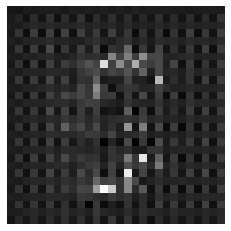

discriminator loss : 0.35345858335494995
Generator loss : [1.5432794, 0.0]
(1, 28, 28, 1)
(28, 28)


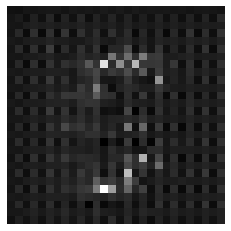

discriminator loss : 0.35211455821990967
Generator loss : [1.630424, 0.0]
(1, 28, 28, 1)
(28, 28)


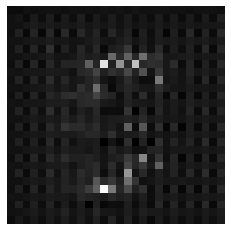

discriminator loss : 0.3439241647720337
Generator loss : [1.7113379, 0.0]
(1, 28, 28, 1)
(28, 28)


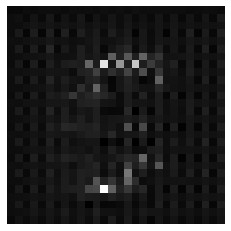

discriminator loss : 0.36261630058288574
Generator loss : [1.7904923, 0.0]
(1, 28, 28, 1)
(28, 28)


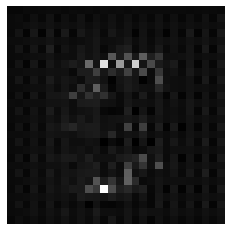

discriminator loss : 0.37766528129577637
Generator loss : [1.8120046, 0.0]
(1, 28, 28, 1)
(28, 28)


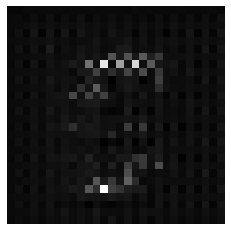

discriminator loss : 0.35987353324890137
Generator loss : [1.7917534, 0.0]
(1, 28, 28, 1)
(28, 28)


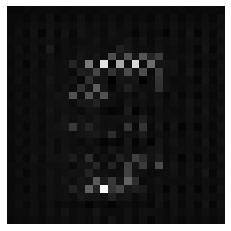

discriminator loss : 0.3699086308479309
Generator loss : [1.7270962, 0.0]
(1, 28, 28, 1)
(28, 28)


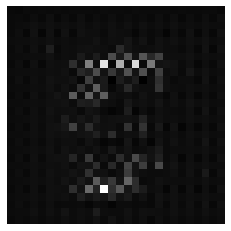

discriminator loss : 0.38132554292678833
Generator loss : [1.6340734, 0.0]
(1, 28, 28, 1)
(28, 28)


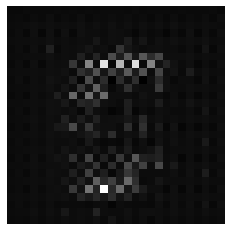

discriminator loss : 0.4785756766796112
Generator loss : [1.6542289, 0.0]
(1, 28, 28, 1)
(28, 28)


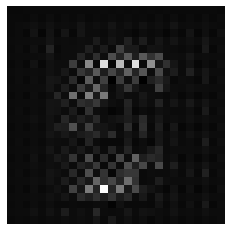

discriminator loss : 0.6772853136062622
Generator loss : [2.4010854, 0.0]
(1, 28, 28, 1)
(28, 28)


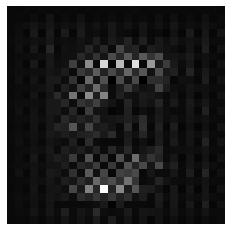

discriminator loss : 1.390978455543518
Generator loss : [2.8370543, 0.0]
(1, 28, 28, 1)
(28, 28)


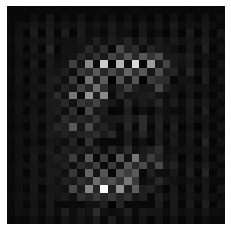

discriminator loss : 1.1853556632995605
Generator loss : [1.6762425, 0.0]
(1, 28, 28, 1)
(28, 28)


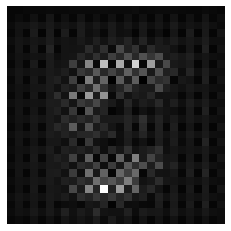

discriminator loss : 0.67676842212677
Generator loss : [1.562538, 0.0]
(1, 28, 28, 1)
(28, 28)


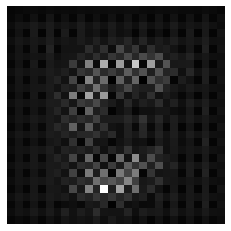

discriminator loss : 0.4915720522403717
Generator loss : [1.5312157, 0.0]
(1, 28, 28, 1)
(28, 28)


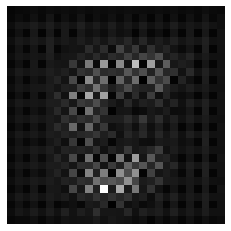

discriminator loss : 0.45360255241394043
Generator loss : [1.4370352, 0.0]
(1, 28, 28, 1)
(28, 28)


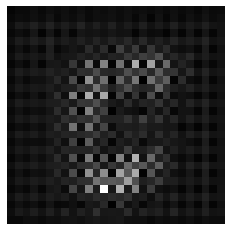

discriminator loss : 0.40146705508232117
Generator loss : [1.3358896, 0.0]
(1, 28, 28, 1)
(28, 28)


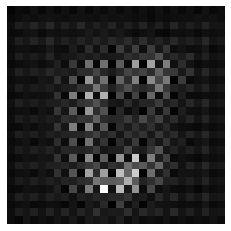

discriminator loss : 0.4304787516593933
Generator loss : [1.0692172, 0.0]
(1, 28, 28, 1)
(28, 28)


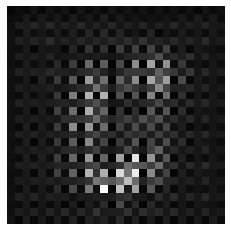

discriminator loss : 0.4121548533439636
Generator loss : [0.9753562, 0.0]
(1, 28, 28, 1)
(28, 28)


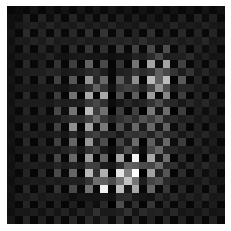

discriminator loss : 0.46085071563720703
Generator loss : [0.7683317, 0.0]
(1, 28, 28, 1)
(28, 28)


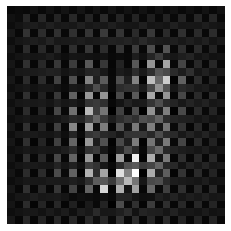

discriminator loss : 0.45370328426361084
Generator loss : [0.6220498, 0.0]
(1, 28, 28, 1)
(28, 28)


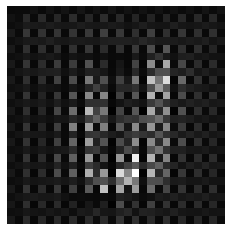

discriminator loss : 0.46099239587783813
Generator loss : [0.52799344, 0.0]
(1, 28, 28, 1)
(28, 28)


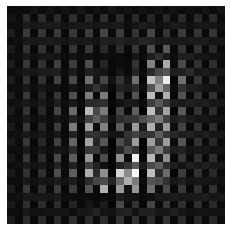

discriminator loss : 0.5348652005195618
Generator loss : [0.4746508, 0.0]
(1, 28, 28, 1)
(28, 28)


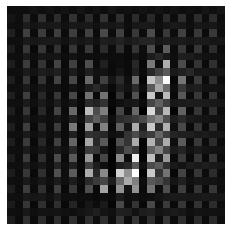

discriminator loss : 0.5207477807998657
Generator loss : [0.4258492, 0.0]
(1, 28, 28, 1)
(28, 28)


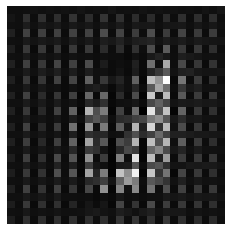

discriminator loss : 0.48744022846221924
Generator loss : [0.3971664, 0.0]
(1, 28, 28, 1)
(28, 28)


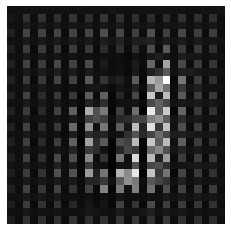

discriminator loss : 0.4849843382835388
Generator loss : [0.35121548, 0.0]
(1, 28, 28, 1)
(28, 28)


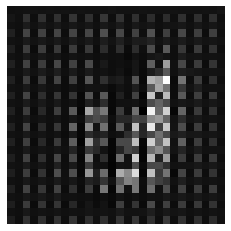

discriminator loss : 0.3948807120323181
Generator loss : [0.360193, 0.0]
(1, 28, 28, 1)
(28, 28)


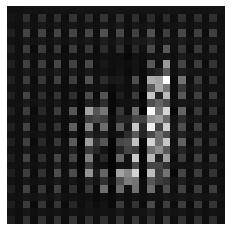

discriminator loss : 0.3786710202693939
Generator loss : [0.33167893, 0.0]
(1, 28, 28, 1)
(28, 28)


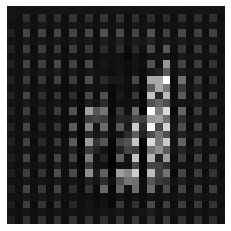

discriminator loss : 0.3537156879901886
Generator loss : [0.32577914, 0.0]
(1, 28, 28, 1)
(28, 28)


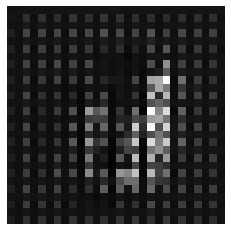

discriminator loss : 0.35363537073135376
Generator loss : [0.32935542, 0.0]
(1, 28, 28, 1)
(28, 28)


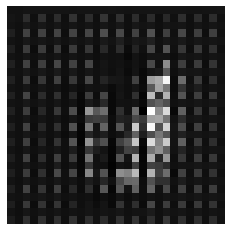

discriminator loss : 0.3597535490989685
Generator loss : [0.33907428, 0.0]
(1, 28, 28, 1)
(28, 28)


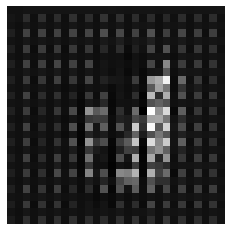

discriminator loss : 0.3393075168132782
Generator loss : [0.33639613, 0.0]
(1, 28, 28, 1)
(28, 28)


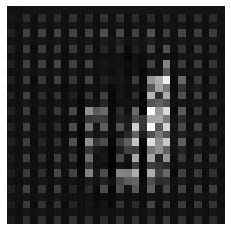

discriminator loss : 0.3444783389568329
Generator loss : [0.3524404, 0.0]
(1, 28, 28, 1)
(28, 28)


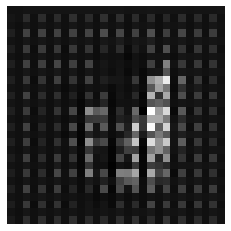

discriminator loss : 0.3593050539493561
Generator loss : [0.33306834, 0.0]
(1, 28, 28, 1)
(28, 28)


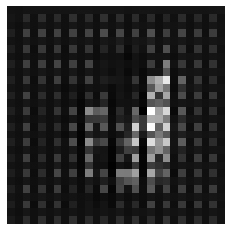

discriminator loss : 0.3506251275539398
Generator loss : [0.34164357, 0.0]
(1, 28, 28, 1)
(28, 28)


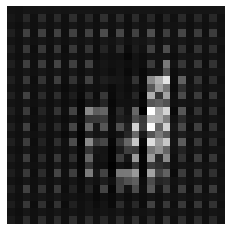

discriminator loss : 0.3667578101158142
Generator loss : [0.3449373, 0.0]
(1, 28, 28, 1)
(28, 28)


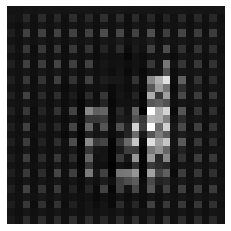

discriminator loss : 0.3523992896080017
Generator loss : [0.34918985, 0.0]
(1, 28, 28, 1)
(28, 28)


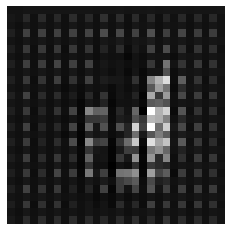

discriminator loss : 0.35103291273117065
Generator loss : [0.33491734, 0.0]
(1, 28, 28, 1)
(28, 28)


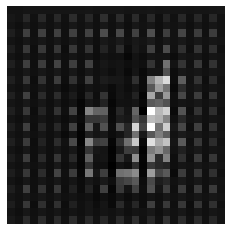

discriminator loss : 0.33349260687828064
Generator loss : [0.3625742, 0.0]
(1, 28, 28, 1)
(28, 28)


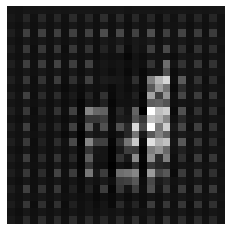

discriminator loss : 0.34319624304771423
Generator loss : [0.38504773, 0.0]
(1, 28, 28, 1)
(28, 28)


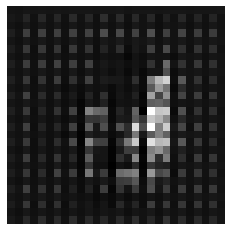

discriminator loss : 0.3580804467201233
Generator loss : [0.38487682, 0.0]
(1, 28, 28, 1)
(28, 28)


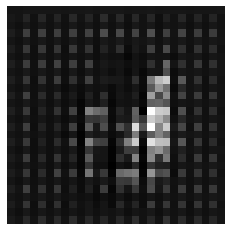

discriminator loss : 0.3442996144294739
Generator loss : [0.40244114, 0.0]
(1, 28, 28, 1)
(28, 28)


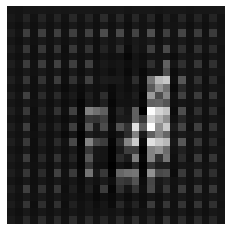

discriminator loss : 0.35406285524368286
Generator loss : [0.44016063, 0.0]
(1, 28, 28, 1)
(28, 28)


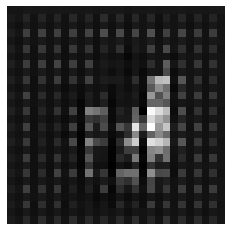

discriminator loss : 0.3900914788246155
Generator loss : [0.540508, 0.0]
(1, 28, 28, 1)
(28, 28)


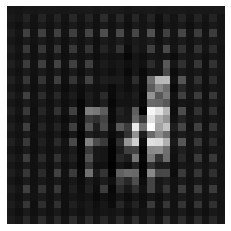

discriminator loss : 0.40871143341064453
Generator loss : [0.6164671, 0.0]
(1, 28, 28, 1)
(28, 28)


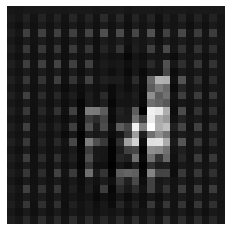

discriminator loss : 0.379838228225708
Generator loss : [0.55186486, 0.0]
(1, 28, 28, 1)
(28, 28)


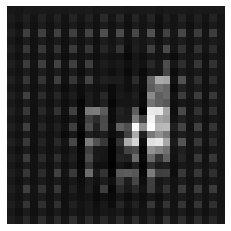

discriminator loss : 0.35253292322158813
Generator loss : [0.52832156, 0.0]
(1, 28, 28, 1)
(28, 28)


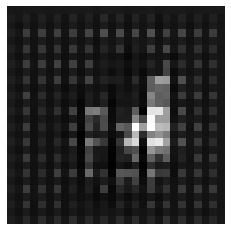

discriminator loss : 0.33641964197158813
Generator loss : [0.5438759, 0.0]
(1, 28, 28, 1)
(28, 28)


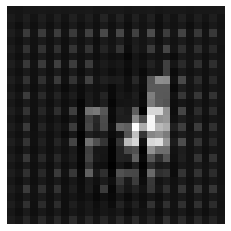

discriminator loss : 0.33481788635253906
Generator loss : [0.5689523, 0.0]
(1, 28, 28, 1)
(28, 28)


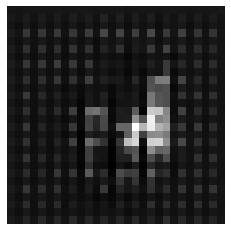

discriminator loss : 0.3550060987472534
Generator loss : [0.63684344, 0.0]
(1, 28, 28, 1)
(28, 28)


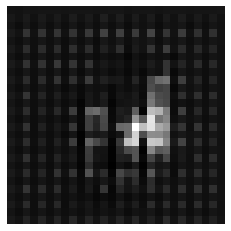

discriminator loss : 0.34759631752967834
Generator loss : [0.6281904, 0.0]
(1, 28, 28, 1)
(28, 28)


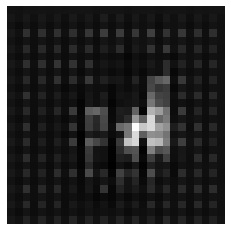

discriminator loss : 0.3466804027557373
Generator loss : [0.5696176, 0.0]
(1, 28, 28, 1)
(28, 28)


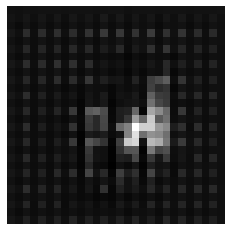

discriminator loss : 0.3456902503967285
Generator loss : [0.5438632, 0.0]
(1, 28, 28, 1)
(28, 28)


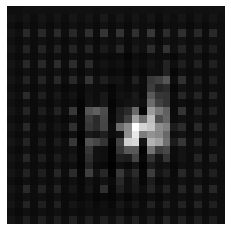

discriminator loss : 0.3319636583328247
Generator loss : [0.5553431, 0.0]
(1, 28, 28, 1)
(28, 28)


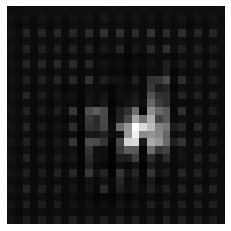

discriminator loss : 0.3598777949810028
Generator loss : [0.7180235, 0.0]
(1, 28, 28, 1)
(28, 28)


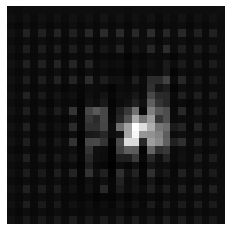

discriminator loss : 0.4850802421569824
Generator loss : [2.080344, 0.0]
(1, 28, 28, 1)
(28, 28)


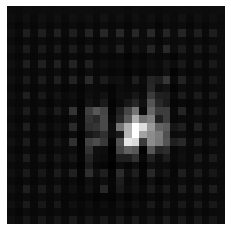

discriminator loss : 2.2662651538848877
Generator loss : [2.8286185, 0.0]
(1, 28, 28, 1)
(28, 28)


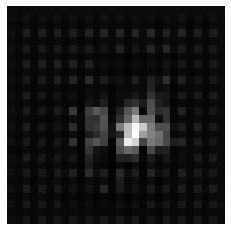

discriminator loss : 0.5304890871047974
Generator loss : [2.1960962, 0.0]
(1, 28, 28, 1)
(28, 28)


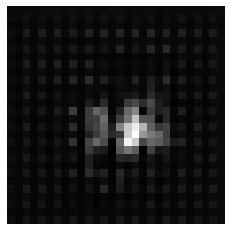

discriminator loss : 0.3669195771217346
Generator loss : [1.6101459, 0.0]
(1, 28, 28, 1)
(28, 28)


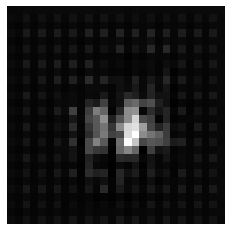

discriminator loss : 0.3548847436904907
Generator loss : [1.2338684, 0.0]
(1, 28, 28, 1)
(28, 28)


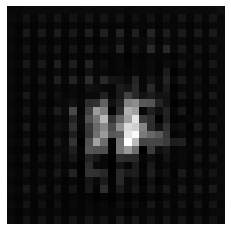

discriminator loss : 0.39654603600502014
Generator loss : [1.1754465, 0.0]
(1, 28, 28, 1)
(28, 28)


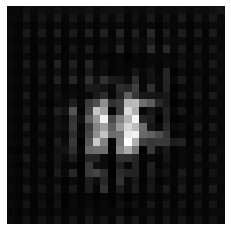

discriminator loss : 0.4108862280845642
Generator loss : [1.3046432, 0.0]
(1, 28, 28, 1)
(28, 28)


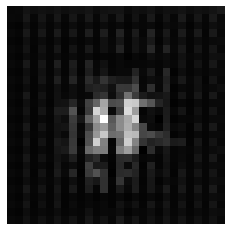

discriminator loss : 0.4562225937843323
Generator loss : [1.3232105, 0.0]
(1, 28, 28, 1)
(28, 28)


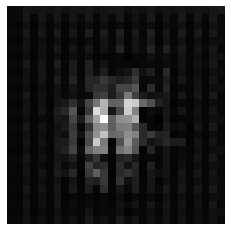

discriminator loss : 0.531010627746582
Generator loss : [1.268215, 0.0]
(1, 28, 28, 1)
(28, 28)


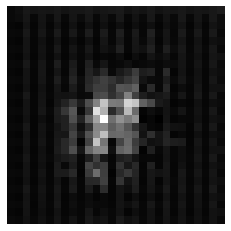

discriminator loss : 0.6082867383956909
Generator loss : [1.261157, 0.0]
(1, 28, 28, 1)
(28, 28)


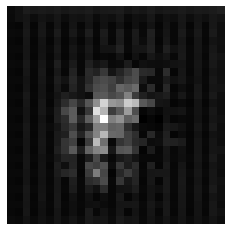

discriminator loss : 0.6292318105697632
Generator loss : [1.2550272, 0.0]
(1, 28, 28, 1)
(28, 28)


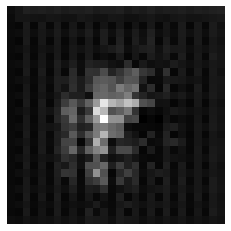

discriminator loss : 0.6558035612106323
Generator loss : [1.1988791, 0.0]
(1, 28, 28, 1)
(28, 28)


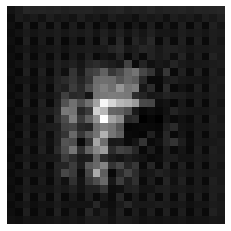

discriminator loss : 0.5442340970039368
Generator loss : [1.1868705, 0.0]
(1, 28, 28, 1)
(28, 28)


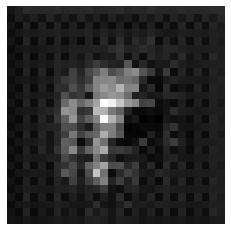

discriminator loss : 0.4983160197734833
Generator loss : [1.1075945, 0.0]
(1, 28, 28, 1)
(28, 28)


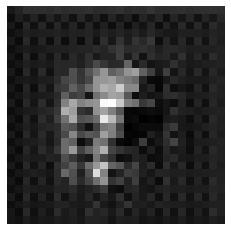

discriminator loss : 0.4655221998691559
Generator loss : [1.0051793, 0.0]
(1, 28, 28, 1)
(28, 28)


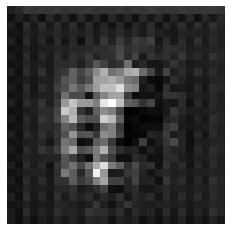

discriminator loss : 0.4374504089355469
Generator loss : [1.0657477, 0.0]
(1, 28, 28, 1)
(28, 28)


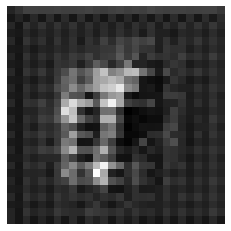

discriminator loss : 0.4633639454841614
Generator loss : [0.8600911, 0.0]
(1, 28, 28, 1)
(28, 28)


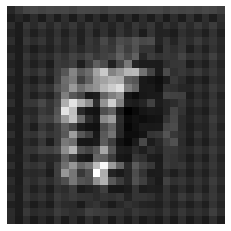

discriminator loss : 0.4992563724517822
Generator loss : [0.79905885, 0.0]
(1, 28, 28, 1)
(28, 28)


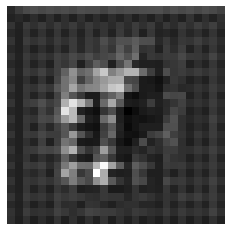

discriminator loss : 0.5906130075454712
Generator loss : [0.68083364, 0.0]
(1, 28, 28, 1)
(28, 28)


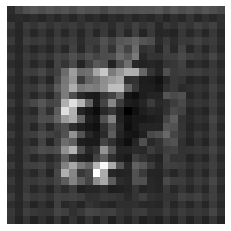

discriminator loss : 0.5861942172050476
Generator loss : [0.6684865, 0.0]
(1, 28, 28, 1)
(28, 28)


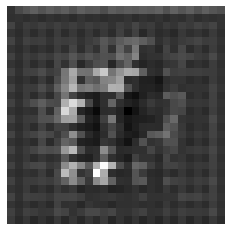

discriminator loss : 0.9016087651252747
Generator loss : [0.63922876, 0.0]
(1, 28, 28, 1)
(28, 28)


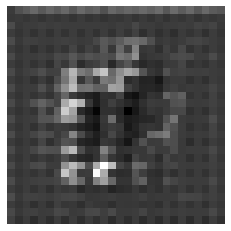

discriminator loss : 0.9572214484214783
Generator loss : [0.6950483, 0.0]
(1, 28, 28, 1)
(28, 28)


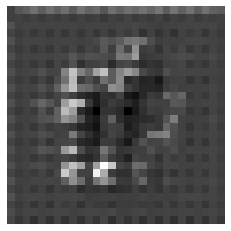

discriminator loss : 0.6992980241775513
Generator loss : [0.8990061, 0.0]
(1, 28, 28, 1)
(28, 28)


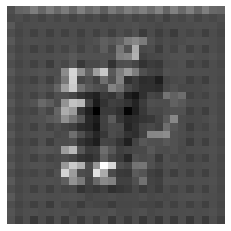

discriminator loss : 0.549010157585144
Generator loss : [1.0746746, 0.0]
(1, 28, 28, 1)
(28, 28)


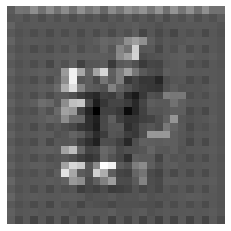

discriminator loss : 0.48215430974960327
Generator loss : [1.1023567, 0.0]
(1, 28, 28, 1)
(28, 28)


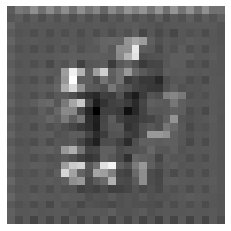

discriminator loss : 0.47829127311706543
Generator loss : [0.9687165, 0.0]
(1, 28, 28, 1)
(28, 28)


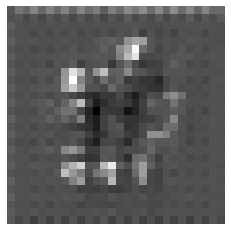

discriminator loss : 0.4530225396156311
Generator loss : [0.8893715, 0.0]
(1, 28, 28, 1)
(28, 28)


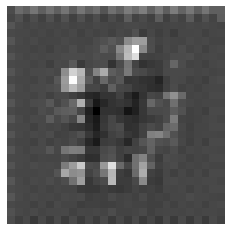

discriminator loss : 0.4154737889766693
Generator loss : [0.90155566, 0.0]
(1, 28, 28, 1)
(28, 28)


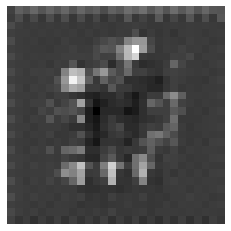

discriminator loss : 0.46163904666900635
Generator loss : [0.7846465, 0.0]
(1, 28, 28, 1)
(28, 28)


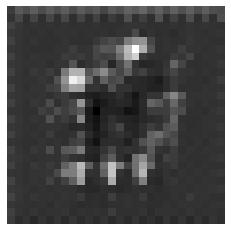

discriminator loss : 0.6183887720108032
Generator loss : [0.678126, 0.0]
(1, 28, 28, 1)
(28, 28)


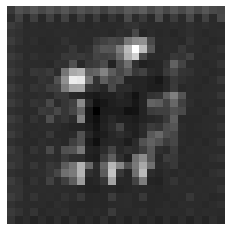

discriminator loss : 0.8419675827026367
Generator loss : [0.7000639, 0.0]
(1, 28, 28, 1)
(28, 28)


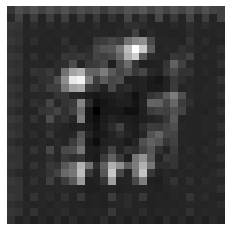

discriminator loss : 0.8007304668426514
Generator loss : [0.7499891, 0.0]
(1, 28, 28, 1)
(28, 28)


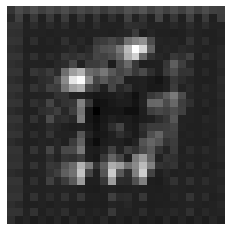

discriminator loss : 0.6530036330223083
Generator loss : [0.77291113, 0.0]
(1, 28, 28, 1)
(28, 28)


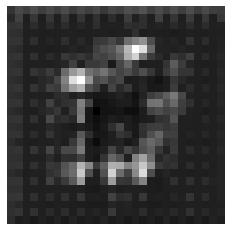

discriminator loss : 0.49357184767723083
Generator loss : [0.8586257, 0.0]
(1, 28, 28, 1)
(28, 28)


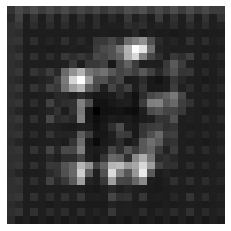

discriminator loss : 0.4106219410896301
Generator loss : [0.9419406, 0.0]
(1, 28, 28, 1)
(28, 28)


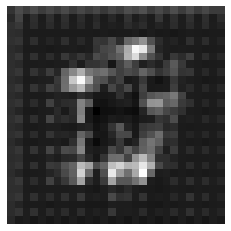

discriminator loss : 0.37510478496551514
Generator loss : [1.0137058, 0.0]
(1, 28, 28, 1)
(28, 28)


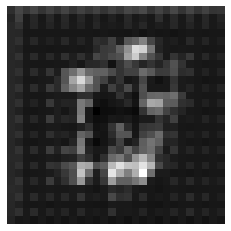

discriminator loss : 0.39149612188339233
Generator loss : [1.0870202, 0.0]
(1, 28, 28, 1)
(28, 28)


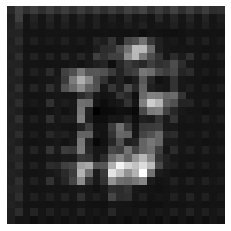

discriminator loss : 0.43686872720718384
Generator loss : [1.8160033, 0.0]
(1, 28, 28, 1)
(28, 28)


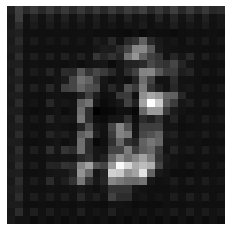

discriminator loss : 0.5569683909416199
Generator loss : [3.0805862, 0.0]
(1, 28, 28, 1)
(28, 28)


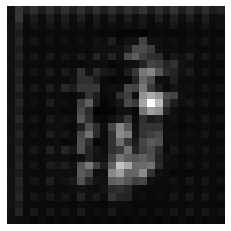

discriminator loss : 0.8629692792892456
Generator loss : [2.9188967, 0.0]
(1, 28, 28, 1)
(28, 28)


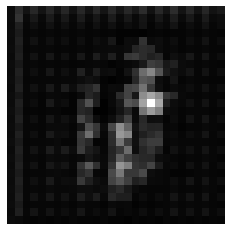

discriminator loss : 0.9375976324081421
Generator loss : [1.188038, 0.0]
(1, 28, 28, 1)
(28, 28)


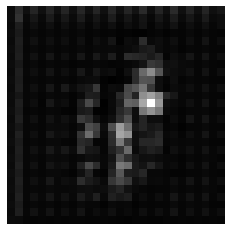

discriminator loss : 0.7340831756591797
Generator loss : [0.69483626, 0.0]
(1, 28, 28, 1)
(28, 28)


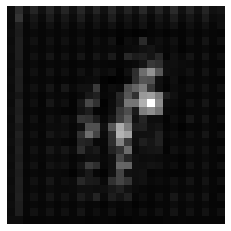

discriminator loss : 0.5800551176071167
Generator loss : [0.46863407, 0.0]
(1, 28, 28, 1)
(28, 28)


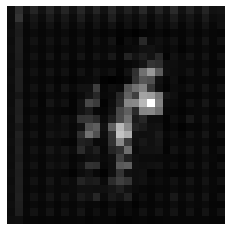

discriminator loss : 0.4289381504058838
Generator loss : [0.3921383, 0.0]
(1, 28, 28, 1)
(28, 28)


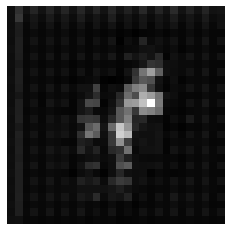

discriminator loss : 0.37031999230384827
Generator loss : [0.37493142, 0.0]
(1, 28, 28, 1)
(28, 28)


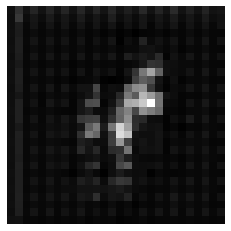

discriminator loss : 0.33682742714881897
Generator loss : [0.31665355, 0.0]
(1, 28, 28, 1)
(28, 28)


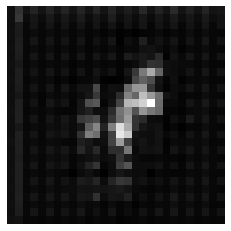

discriminator loss : 0.34472256898880005
Generator loss : [0.32872736, 0.0]
(1, 28, 28, 1)
(28, 28)


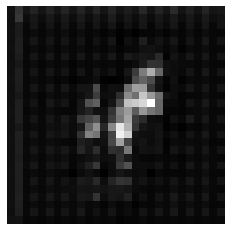

discriminator loss : 0.34445732831954956
Generator loss : [0.33446464, 0.0]
(1, 28, 28, 1)
(28, 28)


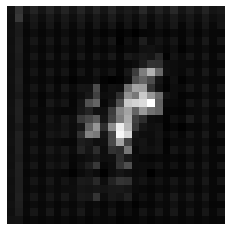

discriminator loss : 0.34174537658691406
Generator loss : [0.33698714, 0.0]
(1, 28, 28, 1)
(28, 28)


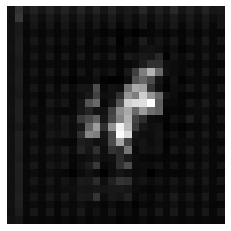

discriminator loss : 0.338105171918869
Generator loss : [0.33382076, 0.0]
(1, 28, 28, 1)
(28, 28)


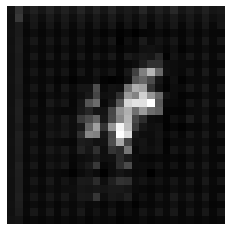

discriminator loss : 0.3275427520275116
Generator loss : [0.3037933, 0.0]
(1, 28, 28, 1)
(28, 28)


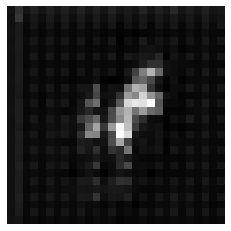

discriminator loss : 0.31070476770401
Generator loss : [0.306619, 0.0]
(1, 28, 28, 1)
(28, 28)


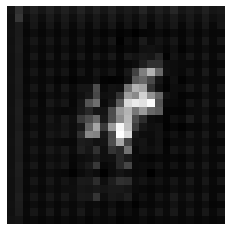

discriminator loss : 0.32730376720428467
Generator loss : [0.33265582, 0.0]
(1, 28, 28, 1)
(28, 28)


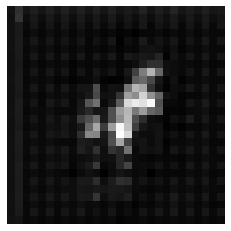

discriminator loss : 0.33777397871017456
Generator loss : [0.32123536, 0.0]
(1, 28, 28, 1)
(28, 28)


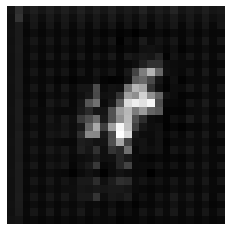

discriminator loss : 0.3478803038597107
Generator loss : [0.34170532, 0.0]
(1, 28, 28, 1)
(28, 28)


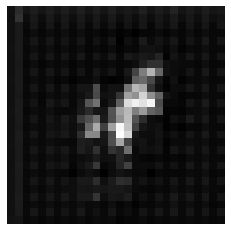

discriminator loss : 0.32487040758132935
Generator loss : [0.3317164, 0.0]
(1, 28, 28, 1)
(28, 28)


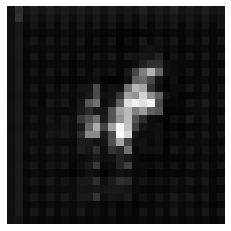

discriminator loss : 0.33907610177993774
Generator loss : [0.32186437, 0.0]
(1, 28, 28, 1)
(28, 28)


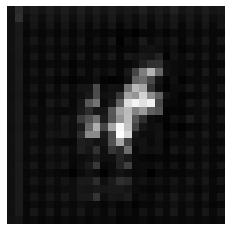

discriminator loss : 0.33216190338134766
Generator loss : [0.323099, 0.0]
(1, 28, 28, 1)
(28, 28)


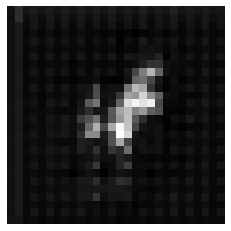

discriminator loss : 0.34099388122558594
Generator loss : [0.31387222, 0.0]
(1, 28, 28, 1)
(28, 28)


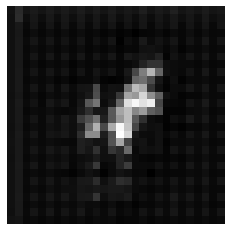

discriminator loss : 0.34336432814598083
Generator loss : [0.3494591, 0.0]
(1, 28, 28, 1)
(28, 28)


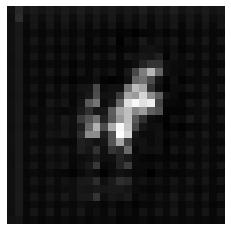

discriminator loss : 0.32838916778564453
Generator loss : [0.35158235, 0.0]
(1, 28, 28, 1)
(28, 28)


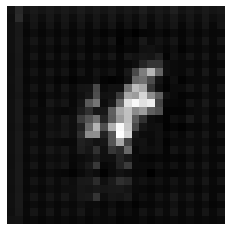

discriminator loss : 0.32684633135795593
Generator loss : [0.34187266, 0.0]
(1, 28, 28, 1)
(28, 28)


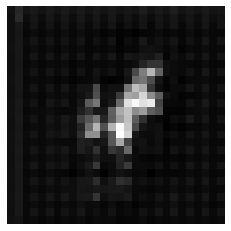

discriminator loss : 0.308818519115448
Generator loss : [0.31152683, 0.0]
(1, 28, 28, 1)
(28, 28)


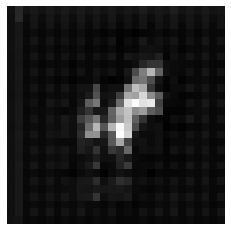

discriminator loss : 0.3203609883785248
Generator loss : [0.32179862, 0.0]
(1, 28, 28, 1)
(28, 28)


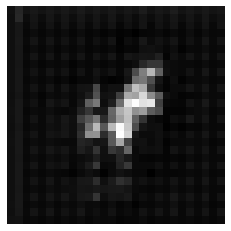

discriminator loss : 0.32329076528549194
Generator loss : [0.31736305, 0.0]
(1, 28, 28, 1)
(28, 28)


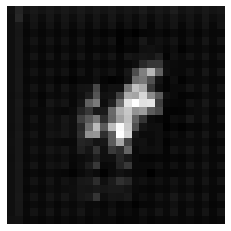

discriminator loss : 0.3366636037826538
Generator loss : [0.342748, 0.0]
(1, 28, 28, 1)
(28, 28)


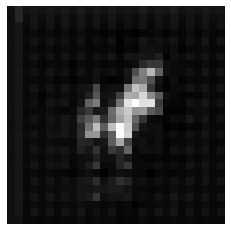

discriminator loss : 0.3382284641265869
Generator loss : [0.32848197, 0.0]
(1, 28, 28, 1)
(28, 28)


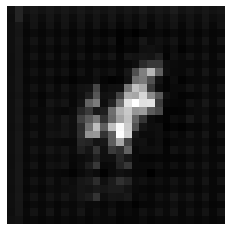

discriminator loss : 0.32782185077667236
Generator loss : [0.3240354, 0.0]
(1, 28, 28, 1)
(28, 28)


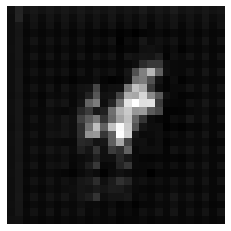

discriminator loss : 0.32758796215057373
Generator loss : [0.32323784, 0.0]
(1, 28, 28, 1)
(28, 28)


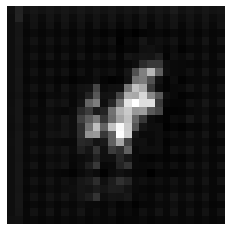

discriminator loss : 0.3168982267379761
Generator loss : [0.3160276, 0.0]
(1, 28, 28, 1)
(28, 28)


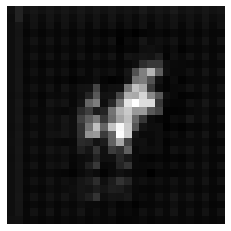

discriminator loss : 0.32415276765823364
Generator loss : [0.32357112, 0.0]
(1, 28, 28, 1)
(28, 28)


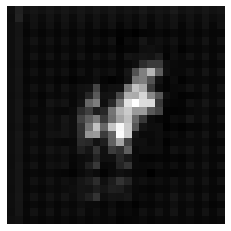

discriminator loss : 0.33837682008743286
Generator loss : [0.3547958, 0.0]
(1, 28, 28, 1)
(28, 28)


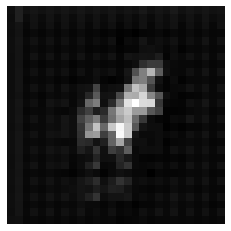

discriminator loss : 0.34202152490615845
Generator loss : [0.34804028, 0.0]
(1, 28, 28, 1)
(28, 28)


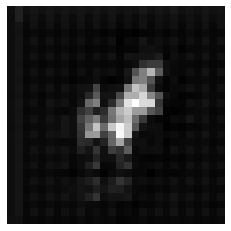

discriminator loss : 0.3169381618499756
Generator loss : [0.31730664, 0.0]
(1, 28, 28, 1)
(28, 28)


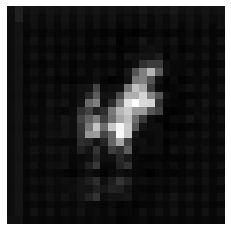

discriminator loss : 0.33245837688446045
Generator loss : [0.3354351, 0.0]
(1, 28, 28, 1)
(28, 28)


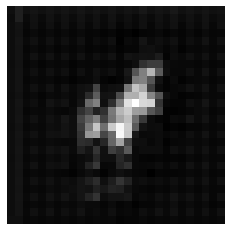

discriminator loss : 0.34127986431121826
Generator loss : [0.3354991, 0.0]
(1, 28, 28, 1)
(28, 28)


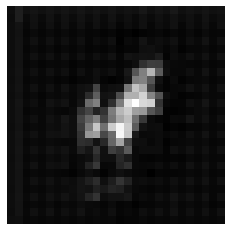

discriminator loss : 0.3103712201118469
Generator loss : [0.31053567, 0.0]
(1, 28, 28, 1)
(28, 28)


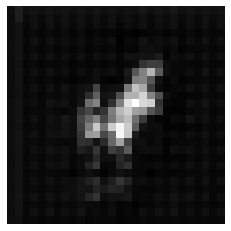

discriminator loss : 0.33588162064552307
Generator loss : [0.3326048, 0.0]
(1, 28, 28, 1)
(28, 28)


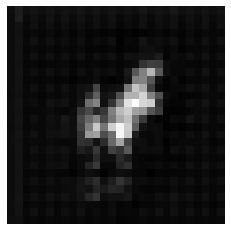

discriminator loss : 0.3160785734653473
Generator loss : [0.29837054, 0.0]
(1, 28, 28, 1)
(28, 28)


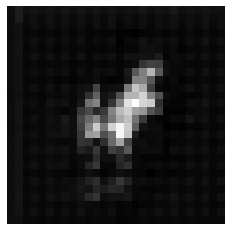

discriminator loss : 0.3360137343406677
Generator loss : [0.31935275, 0.0]
(1, 28, 28, 1)
(28, 28)


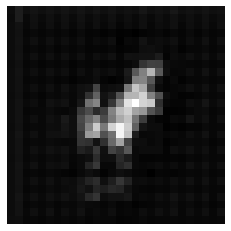

discriminator loss : 0.3253650665283203
Generator loss : [0.33205414, 0.0]
(1, 28, 28, 1)
(28, 28)


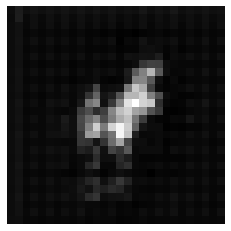

discriminator loss : 0.322024405002594
Generator loss : [0.30790463, 0.0]
(1, 28, 28, 1)
(28, 28)


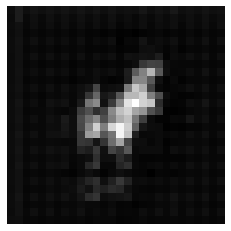

discriminator loss : 0.33534151315689087
Generator loss : [0.34376353, 0.0]
(1, 28, 28, 1)
(28, 28)


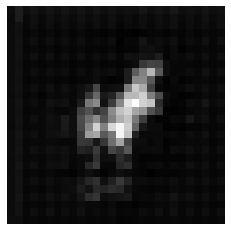

discriminator loss : 0.34215623140335083
Generator loss : [0.34341434, 0.0]
(1, 28, 28, 1)
(28, 28)


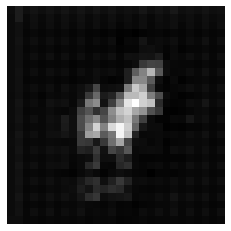

discriminator loss : 0.3388351798057556
Generator loss : [0.33666527, 0.0]
(1, 28, 28, 1)
(28, 28)


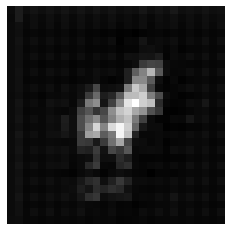

discriminator loss : 0.337572306394577
Generator loss : [0.32842654, 0.0]
(1, 28, 28, 1)
(28, 28)


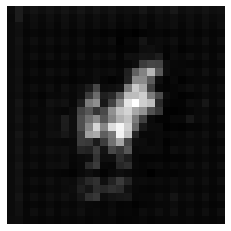

discriminator loss : 0.32093697786331177
Generator loss : [0.3480919, 0.0]
(1, 28, 28, 1)
(28, 28)


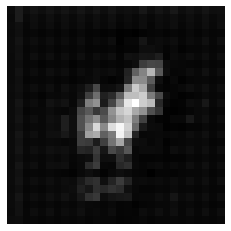

discriminator loss : 0.32522261142730713
Generator loss : [0.33684212, 0.0]
(1, 28, 28, 1)
(28, 28)


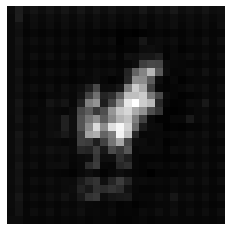

discriminator loss : 0.3410217761993408
Generator loss : [0.3521793, 0.0]
(1, 28, 28, 1)
(28, 28)


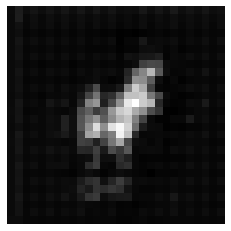

discriminator loss : 0.3355574309825897
Generator loss : [0.3346703, 0.0]
(1, 28, 28, 1)
(28, 28)


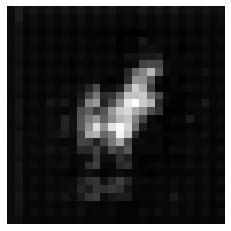

discriminator loss : 0.3526604175567627
Generator loss : [0.3404463, 0.0]
(1, 28, 28, 1)
(28, 28)


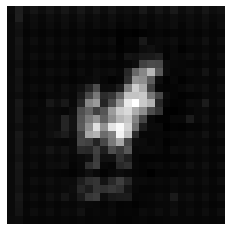

discriminator loss : 0.3216710686683655
Generator loss : [0.379464, 0.0]
(1, 28, 28, 1)
(28, 28)


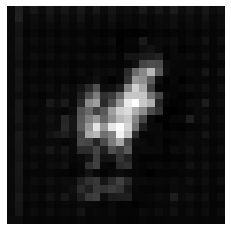

discriminator loss : 0.40168333053588867
Generator loss : [0.7544615, 0.0]
(1, 28, 28, 1)
(28, 28)


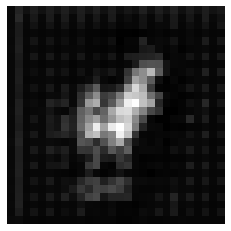

discriminator loss : 1.0774949789047241
Generator loss : [3.4925318, 0.0]
(1, 28, 28, 1)
(28, 28)


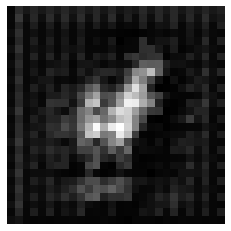

discriminator loss : 1.2062394618988037
Generator loss : [1.2541437, 0.0]
(1, 28, 28, 1)
(28, 28)


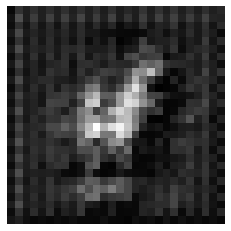

discriminator loss : 0.4101943373680115
Generator loss : [1.2172418, 0.0]
(1, 28, 28, 1)
(28, 28)


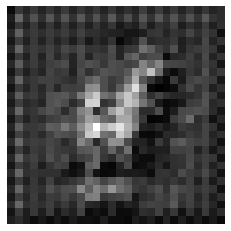

discriminator loss : 0.4763115644454956
Generator loss : [0.7345967, 0.0]
(1, 28, 28, 1)
(28, 28)


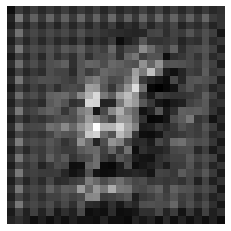

discriminator loss : 0.5121216773986816
Generator loss : [0.46715274, 0.0]
(1, 28, 28, 1)
(28, 28)


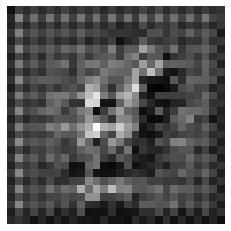

discriminator loss : 0.5166168212890625
Generator loss : [0.38147736, 0.0]
(1, 28, 28, 1)
(28, 28)


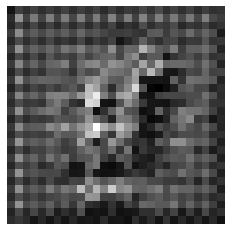

discriminator loss : 0.4763025641441345
Generator loss : [0.3610551, 0.0]
(1, 28, 28, 1)
(28, 28)


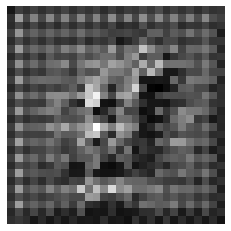

discriminator loss : 0.4330506920814514
Generator loss : [0.33828163, 0.0]
(1, 28, 28, 1)
(28, 28)


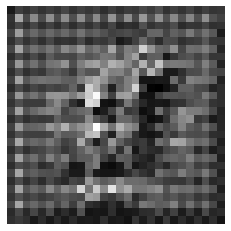

discriminator loss : 0.41316911578178406
Generator loss : [0.3327491, 0.0]
(1, 28, 28, 1)
(28, 28)


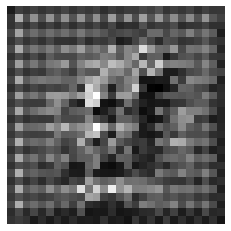

discriminator loss : 0.3788939118385315
Generator loss : [0.3434964, 0.0]
(1, 28, 28, 1)
(28, 28)


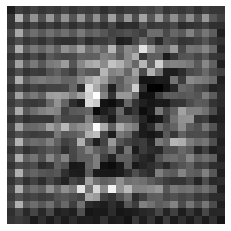

discriminator loss : 0.3389930725097656
Generator loss : [0.3390439, 0.0]
(1, 28, 28, 1)
(28, 28)


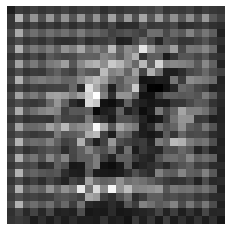

discriminator loss : 0.323893666267395
Generator loss : [0.339606, 0.0]
(1, 28, 28, 1)
(28, 28)


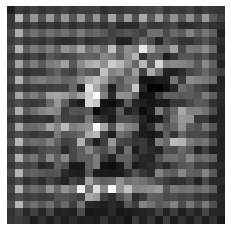

discriminator loss : 0.327551007270813
Generator loss : [0.32301837, 0.0]
(1, 28, 28, 1)
(28, 28)


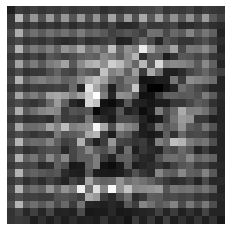

discriminator loss : 0.32811397314071655
Generator loss : [0.33876732, 0.0]
(1, 28, 28, 1)
(28, 28)


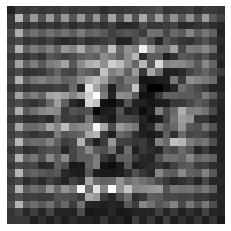

discriminator loss : 0.3293644189834595
Generator loss : [0.33855283, 0.0]
(1, 28, 28, 1)
(28, 28)


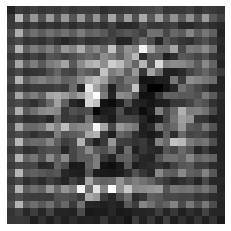

discriminator loss : 0.32614561915397644
Generator loss : [0.3298898, 0.0]
(1, 28, 28, 1)
(28, 28)


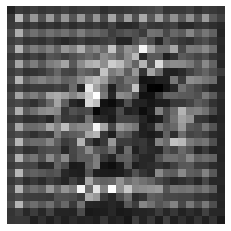

discriminator loss : 0.3268094062805176
Generator loss : [0.31641278, 0.0]
(1, 28, 28, 1)
(28, 28)


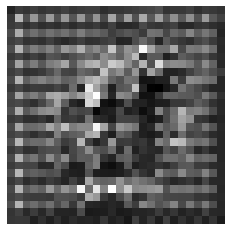

discriminator loss : 0.3436046838760376
Generator loss : [0.34887737, 0.0]
(1, 28, 28, 1)
(28, 28)


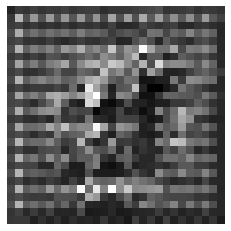

discriminator loss : 0.34414607286453247
Generator loss : [0.34800163, 0.0]
(1, 28, 28, 1)
(28, 28)


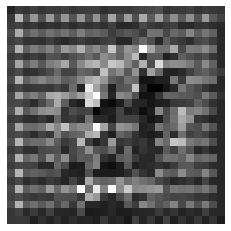

discriminator loss : 0.35821887850761414
Generator loss : [0.3553918, 0.0]
(1, 28, 28, 1)
(28, 28)


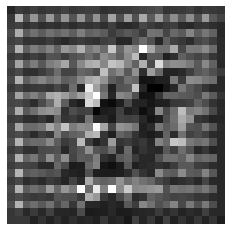

discriminator loss : 0.34451600909233093
Generator loss : [0.3525637, 0.0]
(1, 28, 28, 1)
(28, 28)


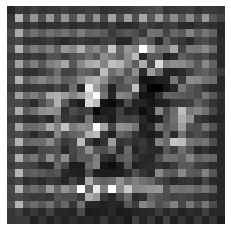

discriminator loss : 0.31106966733932495
Generator loss : [0.31838858, 0.0]
(1, 28, 28, 1)
(28, 28)


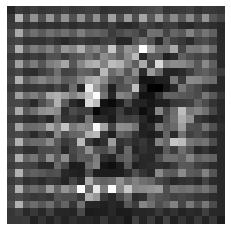

discriminator loss : 0.3237760663032532
Generator loss : [0.3295159, 0.0]
(1, 28, 28, 1)
(28, 28)


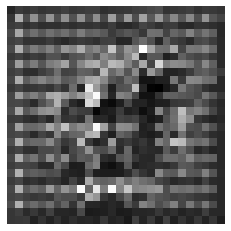

discriminator loss : 0.3394430875778198
Generator loss : [0.34223312, 0.0]
(1, 28, 28, 1)
(28, 28)


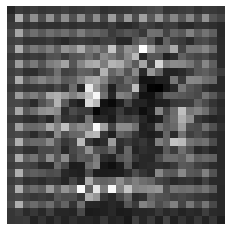

discriminator loss : 0.34768834710121155
Generator loss : [0.34700677, 0.0]
(1, 28, 28, 1)
(28, 28)


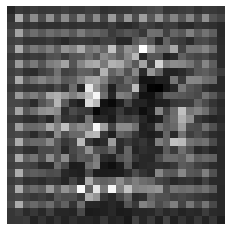

discriminator loss : 0.3352058529853821
Generator loss : [0.3416966, 0.0]
(1, 28, 28, 1)
(28, 28)


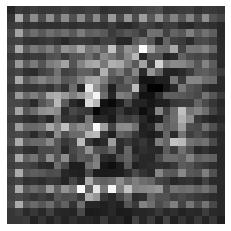

discriminator loss : 0.33337831497192383
Generator loss : [0.3194426, 0.0]
(1, 28, 28, 1)
(28, 28)


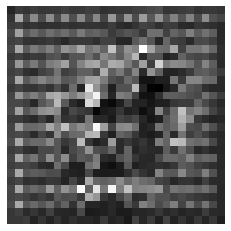

discriminator loss : 0.32600003480911255
Generator loss : [0.32883903, 0.0]
(1, 28, 28, 1)
(28, 28)


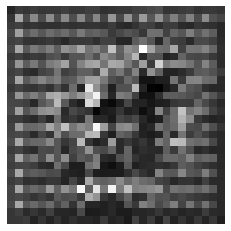

discriminator loss : 0.3446468710899353
Generator loss : [0.34432536, 0.0]
(1, 28, 28, 1)
(28, 28)


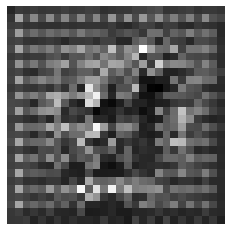

discriminator loss : 0.3295549154281616
Generator loss : [0.33000305, 0.0]
(1, 28, 28, 1)
(28, 28)


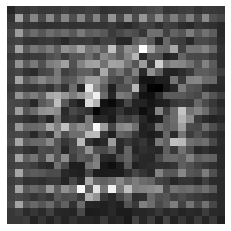

discriminator loss : 0.32276713848114014
Generator loss : [0.3224839, 0.0]
(1, 28, 28, 1)
(28, 28)


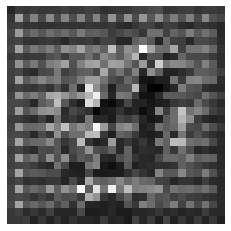

discriminator loss : 0.34761881828308105
Generator loss : [0.33560368, 0.0]
(1, 28, 28, 1)
(28, 28)


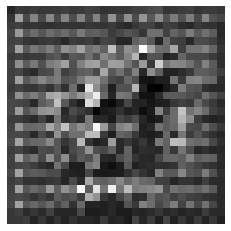

discriminator loss : 0.3294435143470764
Generator loss : [0.30711895, 0.0]
(1, 28, 28, 1)
(28, 28)


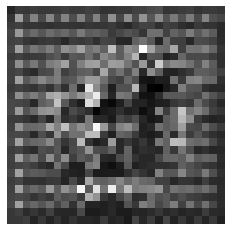

discriminator loss : 0.32606232166290283
Generator loss : [0.3364143, 0.0]
(1, 28, 28, 1)
(28, 28)


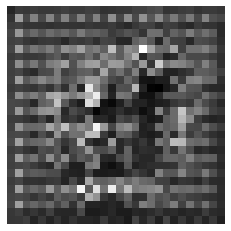

discriminator loss : 0.32450544834136963
Generator loss : [0.31630534, 0.0]
(1, 28, 28, 1)
(28, 28)


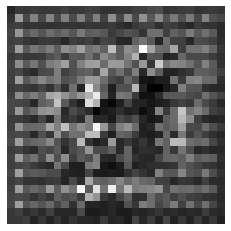

discriminator loss : 0.3413468599319458
Generator loss : [0.32762128, 0.0]
(1, 28, 28, 1)
(28, 28)


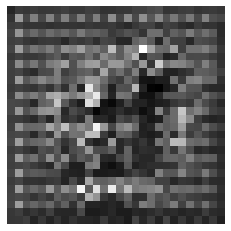

discriminator loss : 0.326117604970932
Generator loss : [0.31824654, 0.0]
(1, 28, 28, 1)
(28, 28)


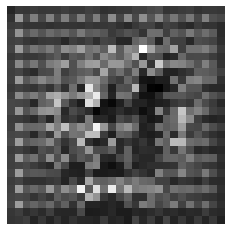

discriminator loss : 0.32728147506713867
Generator loss : [0.328464, 0.0]
(1, 28, 28, 1)
(28, 28)


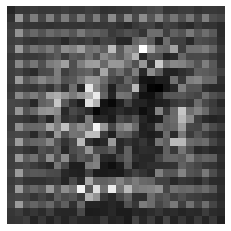

discriminator loss : 0.3325132131576538
Generator loss : [0.32703105, 0.0]
(1, 28, 28, 1)
(28, 28)


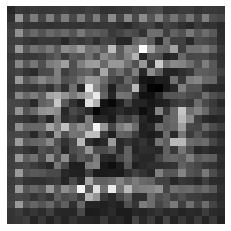

discriminator loss : 0.3243522047996521
Generator loss : [0.3226002, 0.0]
(1, 28, 28, 1)
(28, 28)


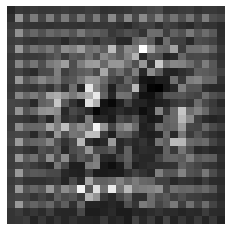

discriminator loss : 0.33092236518859863
Generator loss : [0.3289164, 0.0]
(1, 28, 28, 1)
(28, 28)


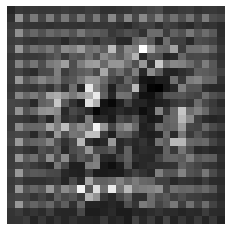

discriminator loss : 0.3215934634208679
Generator loss : [0.31722778, 0.0]
(1, 28, 28, 1)
(28, 28)


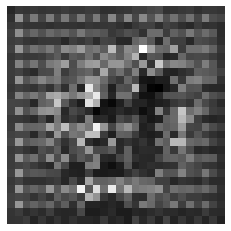

discriminator loss : 0.36057576537132263
Generator loss : [0.34156325, 0.0]
(1, 28, 28, 1)
(28, 28)


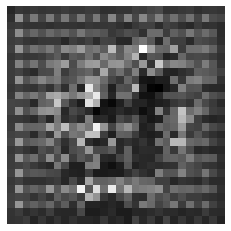

discriminator loss : 0.31263619661331177
Generator loss : [0.29823953, 0.0]
(1, 28, 28, 1)
(28, 28)


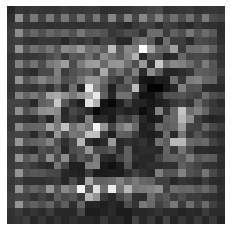

discriminator loss : 0.34114164113998413
Generator loss : [0.33562732, 0.0]
(1, 28, 28, 1)
(28, 28)


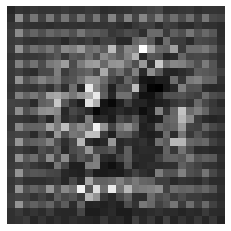

discriminator loss : 0.3339041471481323
Generator loss : [0.34324607, 0.0]
(1, 28, 28, 1)
(28, 28)


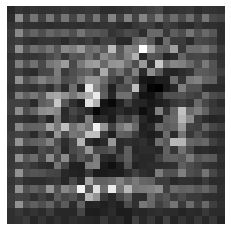

discriminator loss : 0.35167694091796875
Generator loss : [0.33480942, 0.0]
(1, 28, 28, 1)
(28, 28)


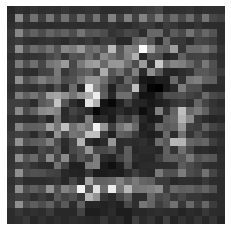

discriminator loss : 0.37823671102523804
Generator loss : [0.39308345, 0.0]
(1, 28, 28, 1)
(28, 28)


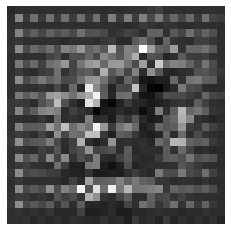

discriminator loss : 0.6133047342300415
Generator loss : [2.219617, 0.0]
(1, 28, 28, 1)
(28, 28)


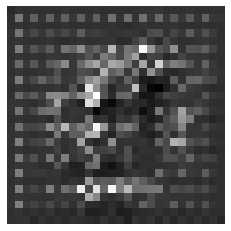

discriminator loss : 2.7510087490081787
Generator loss : [0.4171267, 0.0]
(1, 28, 28, 1)
(28, 28)


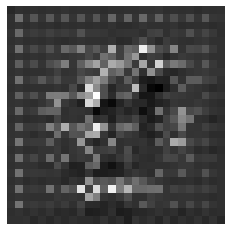

discriminator loss : 0.6577876806259155
Generator loss : [1.155765, 0.0]
(1, 28, 28, 1)
(28, 28)


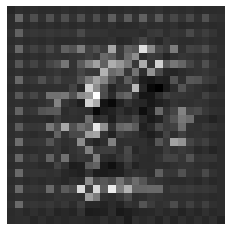

discriminator loss : 0.40198951959609985
Generator loss : [1.99437, 0.0]
(1, 28, 28, 1)
(28, 28)


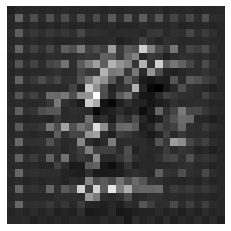

discriminator loss : 0.4154733419418335
Generator loss : [2.2840698, 0.0]
(1, 28, 28, 1)
(28, 28)


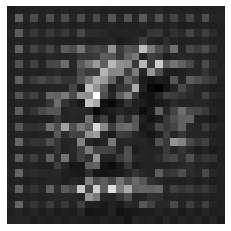

discriminator loss : 0.40630000829696655
Generator loss : [2.3005998, 0.0]
(1, 28, 28, 1)
(28, 28)


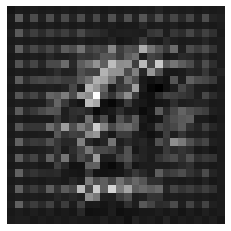

discriminator loss : 0.4273575246334076
Generator loss : [2.3136244, 0.0]
(1, 28, 28, 1)
(28, 28)


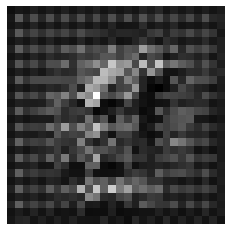

discriminator loss : 0.7152901887893677
Generator loss : [2.1193807, 0.0]
(1, 28, 28, 1)
(28, 28)


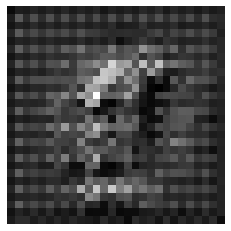

discriminator loss : 1.141930341720581
Generator loss : [1.5648416, 0.0]
(1, 28, 28, 1)
(28, 28)


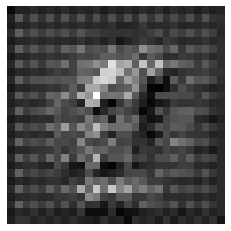

discriminator loss : 0.8569345474243164
Generator loss : [0.9321588, 0.0]
(1, 28, 28, 1)
(28, 28)


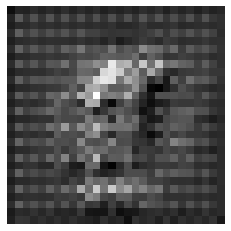

discriminator loss : 0.6123437881469727
Generator loss : [0.6976269, 0.0]
(1, 28, 28, 1)
(28, 28)


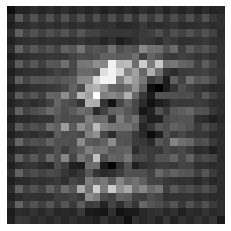

discriminator loss : 0.44155776500701904
Generator loss : [0.61418825, 0.0]
(1, 28, 28, 1)
(28, 28)


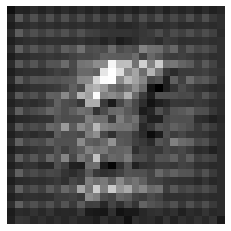

discriminator loss : 0.3866644501686096
Generator loss : [0.5062737, 0.0]
(1, 28, 28, 1)
(28, 28)


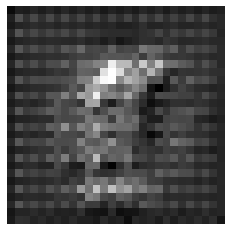

discriminator loss : 0.34174901247024536
Generator loss : [0.41629982, 0.0]
(1, 28, 28, 1)
(28, 28)


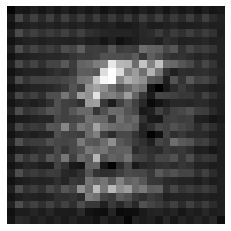

discriminator loss : 0.3345128893852234
Generator loss : [0.3795315, 0.0]
(1, 28, 28, 1)
(28, 28)


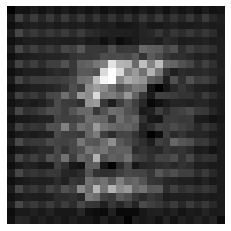

discriminator loss : 0.33697450160980225
Generator loss : [0.33145282, 0.0]
(1, 28, 28, 1)
(28, 28)


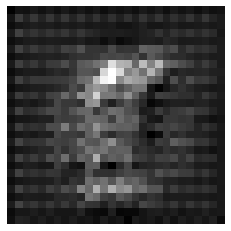

discriminator loss : 0.3516492545604706
Generator loss : [0.3421015, 0.0]
(1, 28, 28, 1)
(28, 28)


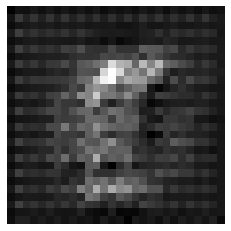

discriminator loss : 0.346439391374588
Generator loss : [0.34095788, 0.0]
(1, 28, 28, 1)
(28, 28)


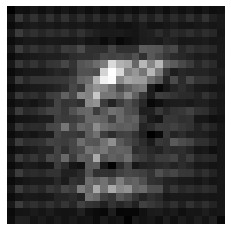

discriminator loss : 0.33138662576675415
Generator loss : [0.33081678, 0.0]
(1, 28, 28, 1)
(28, 28)


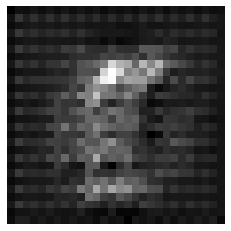

discriminator loss : 0.33702021837234497
Generator loss : [0.3189334, 0.0]
(1, 28, 28, 1)
(28, 28)


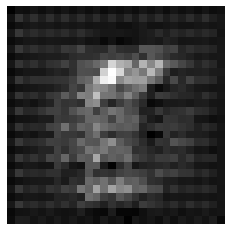

discriminator loss : 0.3445647954940796
Generator loss : [0.33620748, 0.0]
(1, 28, 28, 1)
(28, 28)


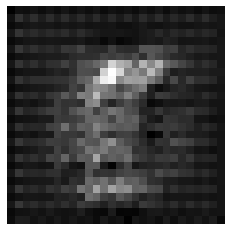

discriminator loss : 0.32880735397338867
Generator loss : [0.3374811, 0.0]
(1, 28, 28, 1)
(28, 28)


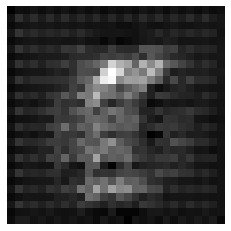

discriminator loss : 0.33130574226379395
Generator loss : [0.32521236, 0.0]
(1, 28, 28, 1)
(28, 28)


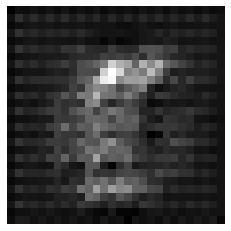

discriminator loss : 0.3394702076911926
Generator loss : [0.3539288, 0.0]
(1, 28, 28, 1)
(28, 28)


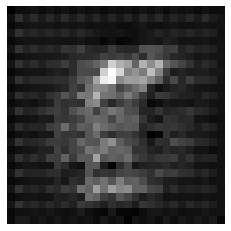

discriminator loss : 0.33051788806915283
Generator loss : [0.32731026, 0.0]
(1, 28, 28, 1)
(28, 28)


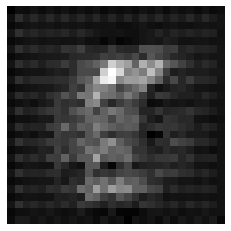

discriminator loss : 0.3430114984512329
Generator loss : [0.33668903, 0.0]
(1, 28, 28, 1)
(28, 28)


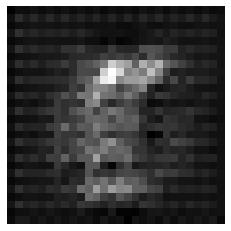

discriminator loss : 0.3383939266204834
Generator loss : [0.3293678, 0.0]
(1, 28, 28, 1)
(28, 28)


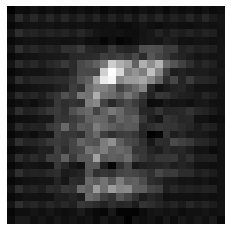

discriminator loss : 0.32492595911026
Generator loss : [0.32011655, 0.0]
(1, 28, 28, 1)
(28, 28)


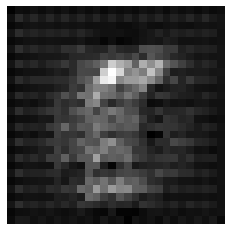

discriminator loss : 0.3393095135688782
Generator loss : [0.33916995, 0.0]
(1, 28, 28, 1)
(28, 28)


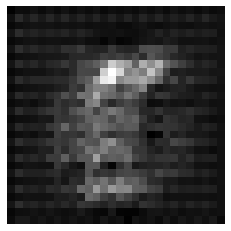

discriminator loss : 0.3277236223220825
Generator loss : [0.3361406, 0.0]
(1, 28, 28, 1)
(28, 28)


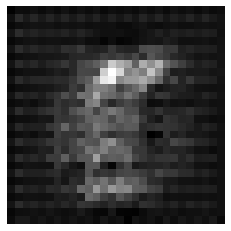

discriminator loss : 0.3415948152542114
Generator loss : [0.32709897, 0.0]
(1, 28, 28, 1)
(28, 28)


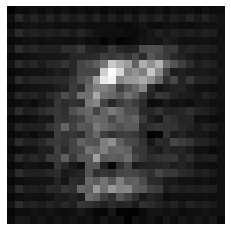

discriminator loss : 0.33536991477012634
Generator loss : [0.32158357, 0.0]
(1, 28, 28, 1)
(28, 28)


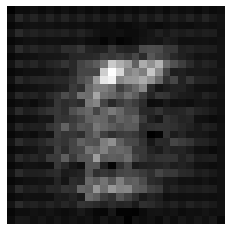

discriminator loss : 0.32324257493019104
Generator loss : [0.34657183, 0.0]
(1, 28, 28, 1)
(28, 28)


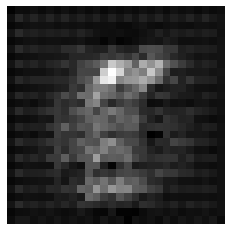

discriminator loss : 0.3328886032104492
Generator loss : [0.34902132, 0.0]
(1, 28, 28, 1)
(28, 28)


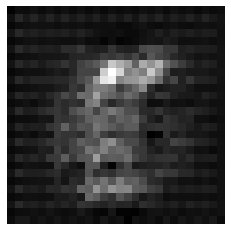

discriminator loss : 0.323245108127594
Generator loss : [0.3432181, 0.0]
(1, 28, 28, 1)
(28, 28)


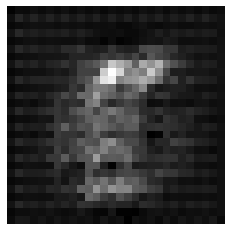

discriminator loss : 0.31323039531707764
Generator loss : [0.34578246, 0.0]
(1, 28, 28, 1)
(28, 28)


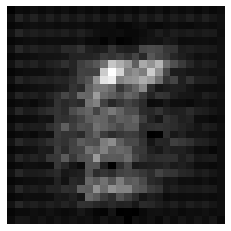

discriminator loss : 0.33537518978118896
Generator loss : [0.3863914, 0.0]
(1, 28, 28, 1)
(28, 28)


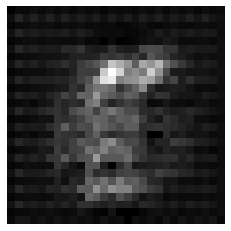

discriminator loss : 0.3258807063102722
Generator loss : [0.3727529, 0.0]
(1, 28, 28, 1)
(28, 28)


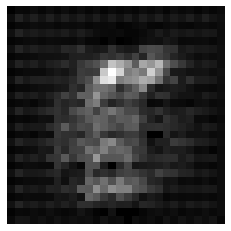

discriminator loss : 0.3265058994293213
Generator loss : [0.43102455, 0.0]
(1, 28, 28, 1)
(28, 28)


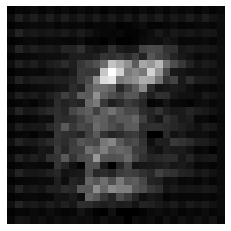

discriminator loss : 0.34490838646888733
Generator loss : [0.4645902, 0.0]
(1, 28, 28, 1)
(28, 28)


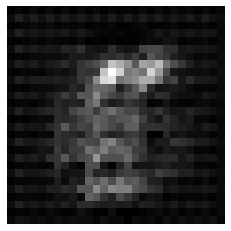

discriminator loss : 0.34792011976242065
Generator loss : [0.65691495, 0.0]
(1, 28, 28, 1)
(28, 28)


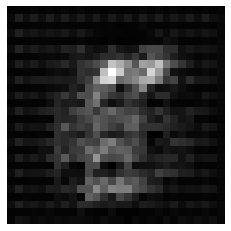

discriminator loss : 0.4075746536254883
Generator loss : [0.802613, 0.0]
(1, 28, 28, 1)
(28, 28)


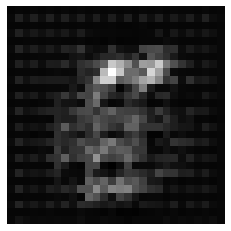

discriminator loss : 0.5654844641685486
Generator loss : [0.69791955, 0.0]
(1, 28, 28, 1)
(28, 28)


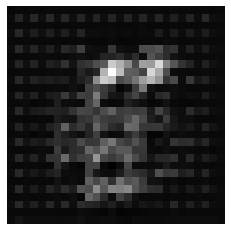

discriminator loss : 0.8839156627655029
Generator loss : [0.469436, 0.0]
(1, 28, 28, 1)
(28, 28)


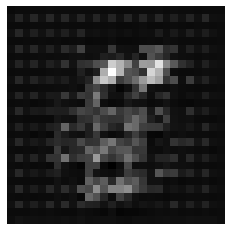

discriminator loss : 0.9449021220207214
Generator loss : [0.43809855, 0.0]
(1, 28, 28, 1)
(28, 28)


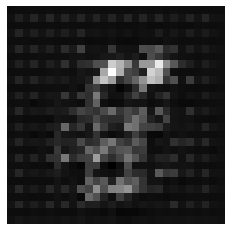

discriminator loss : 1.0017552375793457
Generator loss : [0.4620087, 0.0]
(1, 28, 28, 1)
(28, 28)


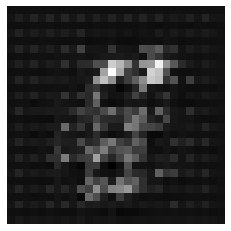

discriminator loss : 0.6941326856613159
Generator loss : [0.5451827, 0.0]
(1, 28, 28, 1)
(28, 28)


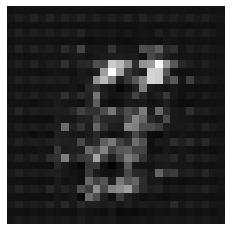

discriminator loss : 0.5863588452339172
Generator loss : [0.649782, 0.0]
(1, 28, 28, 1)
(28, 28)


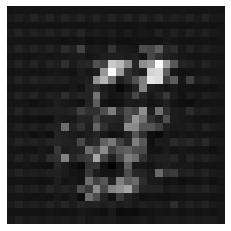

discriminator loss : 0.5610445737838745
Generator loss : [0.72220635, 0.0]
(1, 28, 28, 1)
(28, 28)


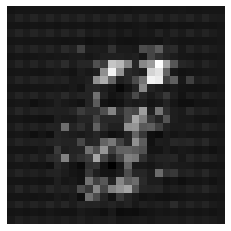

discriminator loss : 0.5047107338905334
Generator loss : [0.77705693, 0.0]
(1, 28, 28, 1)
(28, 28)


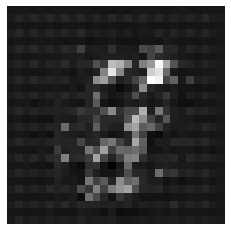

discriminator loss : 0.5072711706161499
Generator loss : [0.8040561, 0.0]
(1, 28, 28, 1)
(28, 28)


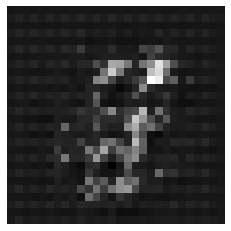

discriminator loss : 0.5012755990028381
Generator loss : [0.81346214, 0.0]
(1, 28, 28, 1)
(28, 28)


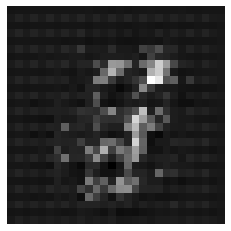

discriminator loss : 0.49528566002845764
Generator loss : [0.81022924, 0.0]
(1, 28, 28, 1)
(28, 28)


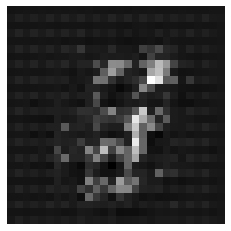

discriminator loss : 0.4833921790122986
Generator loss : [0.8218559, 0.0]
(1, 28, 28, 1)
(28, 28)


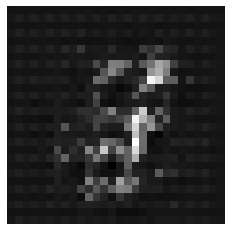

discriminator loss : 0.47645753622055054
Generator loss : [0.8670169, 0.0]
(1, 28, 28, 1)
(28, 28)


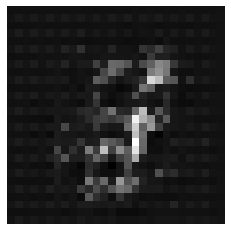

discriminator loss : 0.49811530113220215
Generator loss : [0.92549044, 0.0]
(1, 28, 28, 1)
(28, 28)


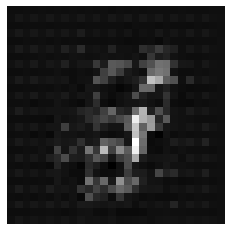

discriminator loss : 0.49296343326568604
Generator loss : [1.0323695, 0.0]
(1, 28, 28, 1)
(28, 28)


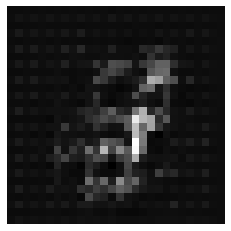

discriminator loss : 0.567793607711792
Generator loss : [1.0940653, 0.0]
(1, 28, 28, 1)
(28, 28)


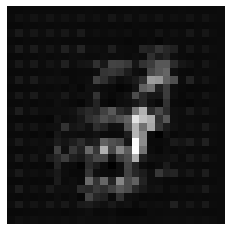

discriminator loss : 0.607737123966217
Generator loss : [1.221334, 0.0]
(1, 28, 28, 1)
(28, 28)


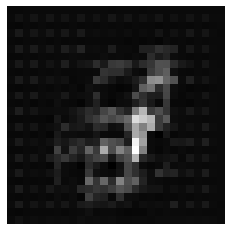

discriminator loss : 0.5845309495925903
Generator loss : [1.4970064, 0.0]
(1, 28, 28, 1)
(28, 28)


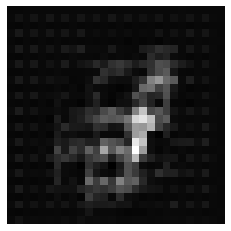

discriminator loss : 0.6522730588912964
Generator loss : [1.7483293, 0.0]
(1, 28, 28, 1)
(28, 28)


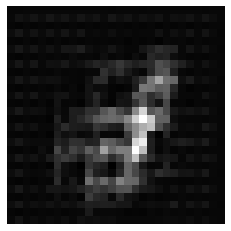

discriminator loss : 0.7472214698791504
Generator loss : [2.0985267, 0.0]
(1, 28, 28, 1)
(28, 28)


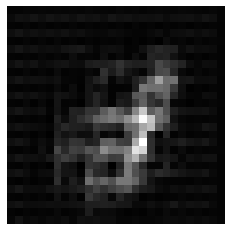

discriminator loss : 0.6876232624053955
Generator loss : [2.1894164, 0.0]
(1, 28, 28, 1)
(28, 28)


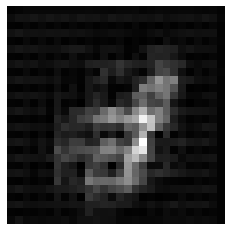

discriminator loss : 0.6005717515945435
Generator loss : [2.497602, 0.0]
(1, 28, 28, 1)
(28, 28)


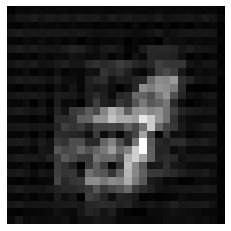

discriminator loss : 0.4781688153743744
Generator loss : [1.6377574, 0.0]
(1, 28, 28, 1)
(28, 28)


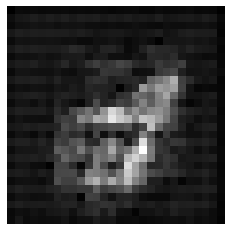

discriminator loss : 0.41651391983032227
Generator loss : [0.70034057, 0.0]
(1, 28, 28, 1)
(28, 28)


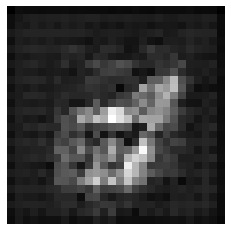

discriminator loss : 0.3738551139831543
Generator loss : [0.34852725, 0.0]
(1, 28, 28, 1)
(28, 28)


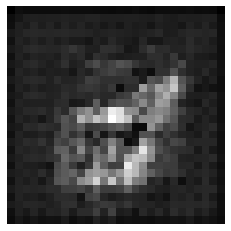

discriminator loss : 0.34080785512924194
Generator loss : [0.31527156, 0.0]
(1, 28, 28, 1)
(28, 28)


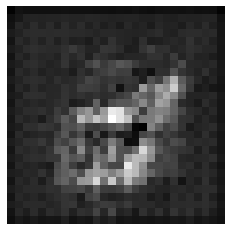

discriminator loss : 0.3545762896537781
Generator loss : [0.38298634, 0.0]
(1, 28, 28, 1)
(28, 28)


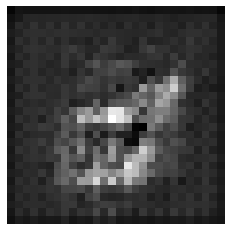

discriminator loss : 0.3956030607223511
Generator loss : [0.7239247, 0.0]
(1, 28, 28, 1)
(28, 28)


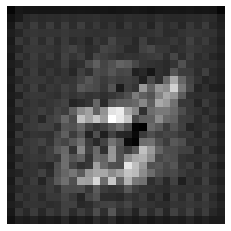

discriminator loss : 0.6784580945968628
Generator loss : [0.39869317, 0.0]
(1, 28, 28, 1)
(28, 28)


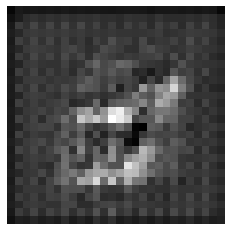

discriminator loss : 0.5301133990287781
Generator loss : [0.32006738, 0.0]
(1, 28, 28, 1)
(28, 28)


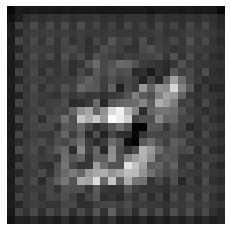

discriminator loss : 0.34159475564956665
Generator loss : [0.3694897, 0.0]
(1, 28, 28, 1)
(28, 28)


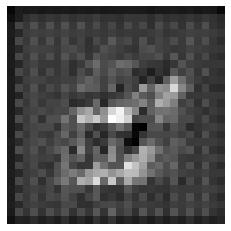

discriminator loss : 0.40617918968200684
Generator loss : [0.3286148, 0.0]
(1, 28, 28, 1)
(28, 28)


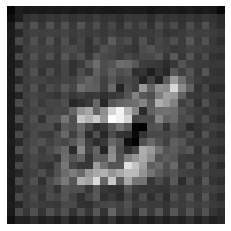

discriminator loss : 0.37763482332229614
Generator loss : [0.3622671, 0.0]
(1, 28, 28, 1)
(28, 28)


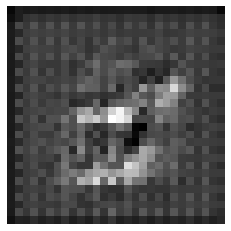

discriminator loss : 0.3611093759536743
Generator loss : [0.37696448, 0.0]
(1, 28, 28, 1)
(28, 28)


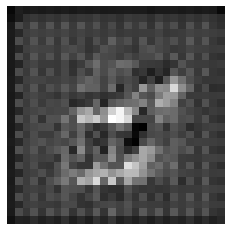

discriminator loss : 0.3309456408023834
Generator loss : [0.3191277, 0.0]
(1, 28, 28, 1)
(28, 28)


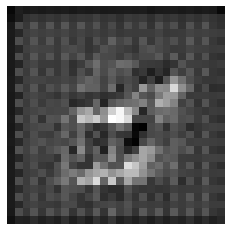

discriminator loss : 0.33708661794662476
Generator loss : [0.34899306, 0.0]
(1, 28, 28, 1)
(28, 28)


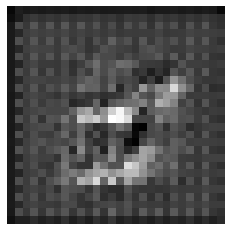

discriminator loss : 0.3258312940597534
Generator loss : [0.31121084, 0.0]
(1, 28, 28, 1)
(28, 28)


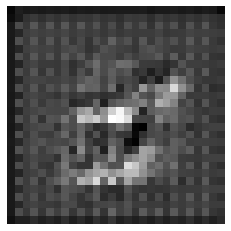

discriminator loss : 0.32641202211380005
Generator loss : [0.34195206, 0.0]
(1, 28, 28, 1)
(28, 28)


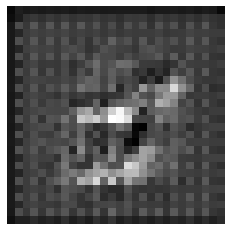

discriminator loss : 0.3303264379501343
Generator loss : [0.33992255, 0.0]
(1, 28, 28, 1)
(28, 28)


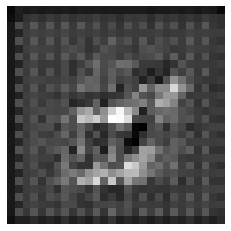

discriminator loss : 0.3369712829589844
Generator loss : [0.3421675, 0.0]
(1, 28, 28, 1)
(28, 28)


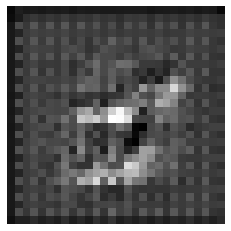

discriminator loss : 0.3193376958370209
Generator loss : [0.29467115, 0.0]
(1, 28, 28, 1)
(28, 28)


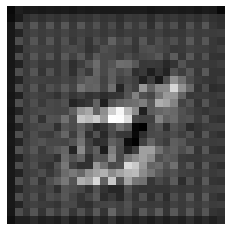

discriminator loss : 0.320231169462204
Generator loss : [0.34148356, 0.0]
(1, 28, 28, 1)
(28, 28)


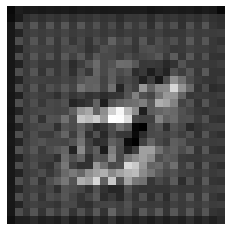

discriminator loss : 0.33729779720306396
Generator loss : [0.35336617, 0.0]
(1, 28, 28, 1)
(28, 28)


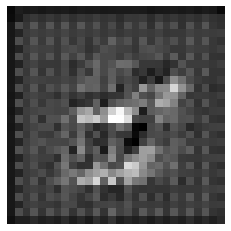

discriminator loss : 0.34688353538513184
Generator loss : [0.36232078, 0.0]
(1, 28, 28, 1)
(28, 28)


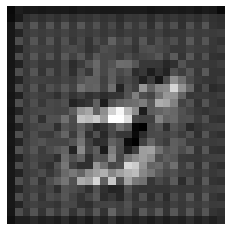

discriminator loss : 0.3392069339752197
Generator loss : [0.3561386, 0.0]
(1, 28, 28, 1)
(28, 28)


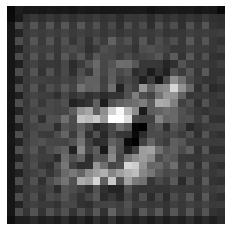

discriminator loss : 0.32390275597572327
Generator loss : [0.32060775, 0.0]
(1, 28, 28, 1)
(28, 28)


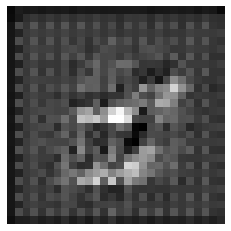

discriminator loss : 0.3484049439430237
Generator loss : [0.3561273, 0.0]
(1, 28, 28, 1)
(28, 28)


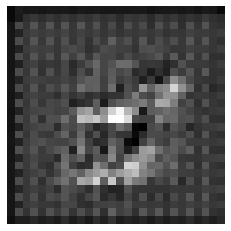

discriminator loss : 0.3234401047229767
Generator loss : [0.32787204, 0.0]
(1, 28, 28, 1)
(28, 28)


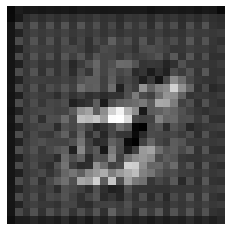

discriminator loss : 0.3213925361633301
Generator loss : [0.31884664, 0.0]
(1, 28, 28, 1)
(28, 28)


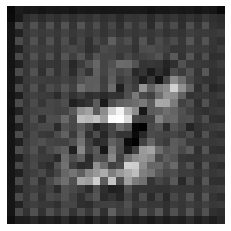

discriminator loss : 0.3369137644767761
Generator loss : [0.34209433, 0.0]
(1, 28, 28, 1)
(28, 28)


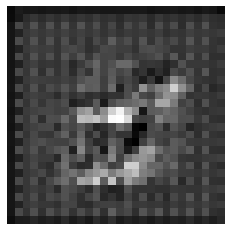

discriminator loss : 0.3313269019126892
Generator loss : [0.32683486, 0.0]
(1, 28, 28, 1)
(28, 28)


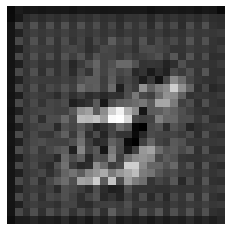

discriminator loss : 0.3279680609703064
Generator loss : [0.33307898, 0.0]
(1, 28, 28, 1)
(28, 28)


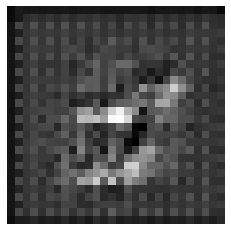

discriminator loss : 0.33019131422042847
Generator loss : [0.31213257, 0.0]
(1, 28, 28, 1)
(28, 28)


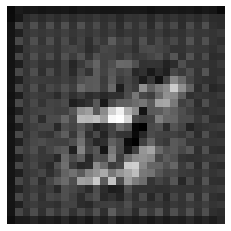

discriminator loss : 0.32949864864349365
Generator loss : [0.33477175, 0.0]
(1, 28, 28, 1)
(28, 28)


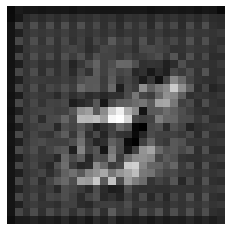

discriminator loss : 0.34578937292099
Generator loss : [0.35619998, 0.0]
(1, 28, 28, 1)
(28, 28)


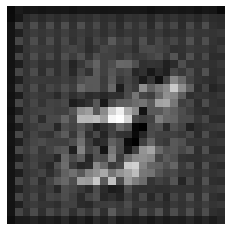

discriminator loss : 0.31700024008750916
Generator loss : [0.315472, 0.0]
(1, 28, 28, 1)
(28, 28)


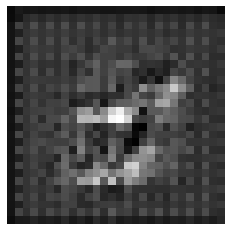

discriminator loss : 0.3313940465450287
Generator loss : [0.32767946, 0.0]
(1, 28, 28, 1)
(28, 28)


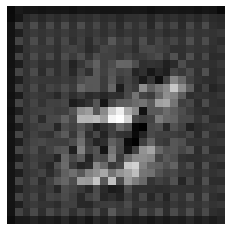

discriminator loss : 0.322624146938324
Generator loss : [0.31967565, 0.0]
(1, 28, 28, 1)
(28, 28)


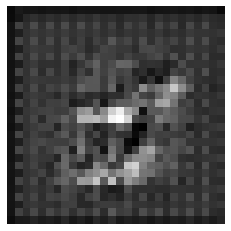

discriminator loss : 0.316882848739624
Generator loss : [0.30530208, 0.0]
(1, 28, 28, 1)
(28, 28)


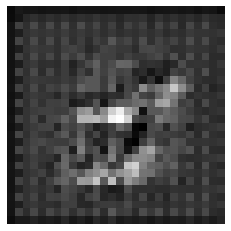

discriminator loss : 0.3283448815345764
Generator loss : [0.30323565, 0.0]
(1, 28, 28, 1)
(28, 28)


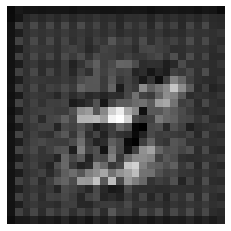

discriminator loss : 0.3226296305656433
Generator loss : [0.32156554, 0.0]
(1, 28, 28, 1)
(28, 28)


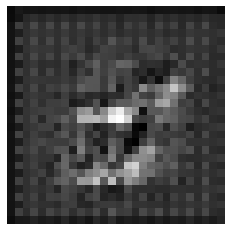

discriminator loss : 0.32250767946243286
Generator loss : [0.31769463, 0.0]
(1, 28, 28, 1)
(28, 28)


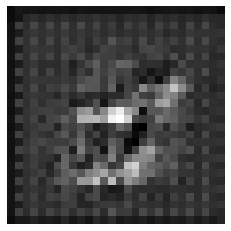

discriminator loss : 0.33801740407943726
Generator loss : [0.32996827, 0.0]
(1, 28, 28, 1)
(28, 28)


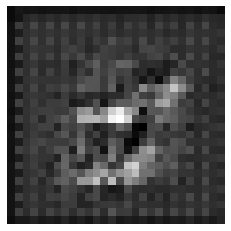

discriminator loss : 0.3326290249824524
Generator loss : [0.34792003, 0.0]
(1, 28, 28, 1)
(28, 28)


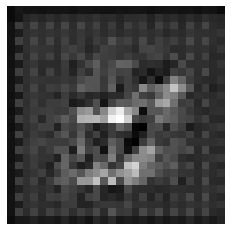

discriminator loss : 0.331757128238678
Generator loss : [0.34076798, 0.0]
(1, 28, 28, 1)
(28, 28)


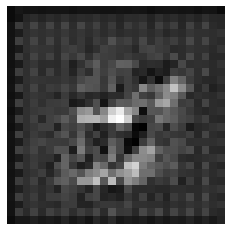

discriminator loss : 0.33566969633102417
Generator loss : [0.31956834, 0.0]
(1, 28, 28, 1)
(28, 28)


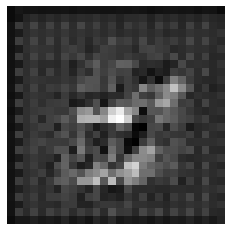

discriminator loss : 0.3382911682128906
Generator loss : [0.34008256, 0.0]
(1, 28, 28, 1)
(28, 28)


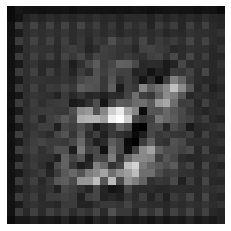

discriminator loss : 0.3387495279312134
Generator loss : [0.31879193, 0.0]
(1, 28, 28, 1)
(28, 28)


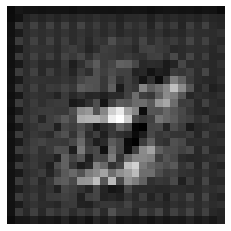

discriminator loss : 0.32106173038482666
Generator loss : [0.3199886, 0.0]
(1, 28, 28, 1)
(28, 28)


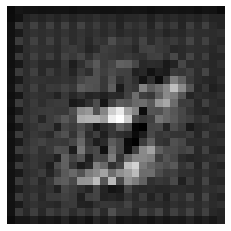

discriminator loss : 0.342956006526947
Generator loss : [0.34590626, 0.0]
(1, 28, 28, 1)
(28, 28)


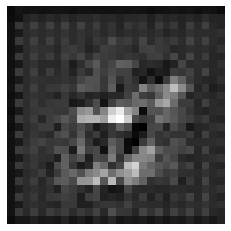

discriminator loss : 0.3350352644920349
Generator loss : [0.32780576, 0.0]
(1, 28, 28, 1)
(28, 28)


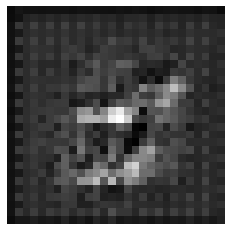

discriminator loss : 0.3332798182964325
Generator loss : [0.3258904, 0.0]
(1, 28, 28, 1)
(28, 28)


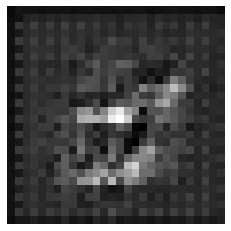

discriminator loss : 0.34164103865623474
Generator loss : [0.35601544, 0.0]
(1, 28, 28, 1)
(28, 28)


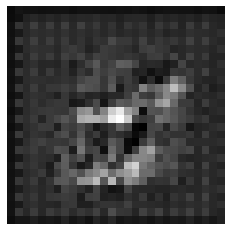

discriminator loss : 0.33092445135116577
Generator loss : [0.3260042, 0.0]
(1, 28, 28, 1)
(28, 28)


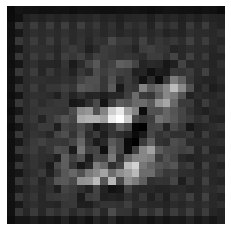

discriminator loss : 0.3273172378540039
Generator loss : [0.30910495, 0.0]
(1, 28, 28, 1)
(28, 28)


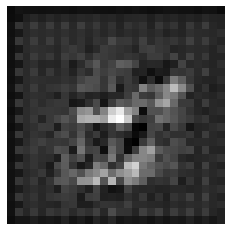

discriminator loss : 0.33411484956741333
Generator loss : [0.33449906, 0.0]
(1, 28, 28, 1)
(28, 28)


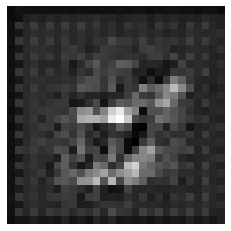

discriminator loss : 0.3279286026954651
Generator loss : [0.3437027, 0.0]
(1, 28, 28, 1)
(28, 28)


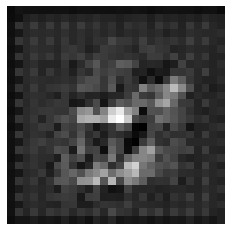

discriminator loss : 0.3225092887878418
Generator loss : [0.33106303, 0.0]
(1, 28, 28, 1)
(28, 28)


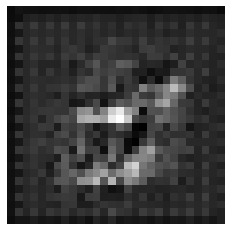

discriminator loss : 0.3258821964263916
Generator loss : [0.31334075, 0.0]
(1, 28, 28, 1)
(28, 28)


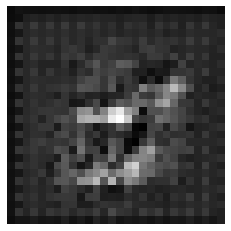

discriminator loss : 0.3072524070739746
Generator loss : [0.29390767, 0.0]
(1, 28, 28, 1)
(28, 28)


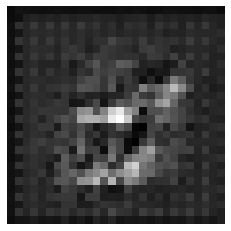

discriminator loss : 0.3336060643196106
Generator loss : [0.3325326, 0.0]
(1, 28, 28, 1)
(28, 28)


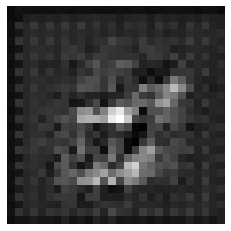

discriminator loss : 0.35030442476272583
Generator loss : [0.34591419, 0.0]
(1, 28, 28, 1)
(28, 28)


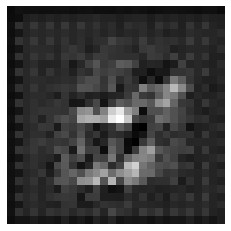

discriminator loss : 0.33280622959136963
Generator loss : [0.32283035, 0.0]
(1, 28, 28, 1)
(28, 28)


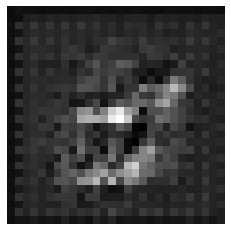

discriminator loss : 0.3421310782432556
Generator loss : [0.33344102, 0.0]
(1, 28, 28, 1)
(28, 28)


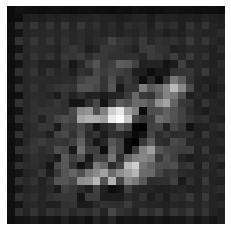

discriminator loss : 0.33124738931655884
Generator loss : [0.32064477, 0.0]
(1, 28, 28, 1)
(28, 28)


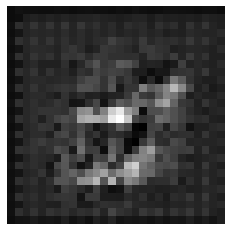

discriminator loss : 0.3283259868621826
Generator loss : [0.333171, 0.0]
(1, 28, 28, 1)
(28, 28)


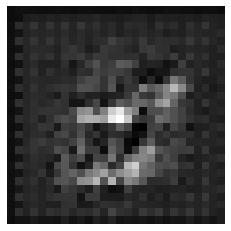

discriminator loss : 0.32895830273628235
Generator loss : [0.3547299, 0.0]
(1, 28, 28, 1)
(28, 28)


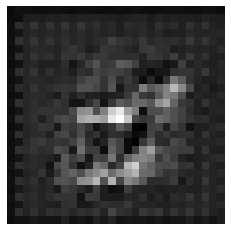

discriminator loss : 0.3383047580718994
Generator loss : [0.33578113, 0.0]
(1, 28, 28, 1)
(28, 28)


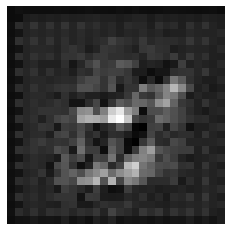

discriminator loss : 0.32262301445007324
Generator loss : [0.30460876, 0.0]
(1, 28, 28, 1)
(28, 28)


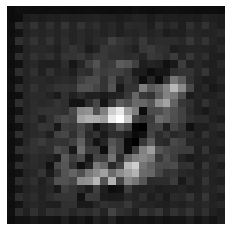

discriminator loss : 0.3489919900894165
Generator loss : [0.34403074, 0.0]
(1, 28, 28, 1)
(28, 28)


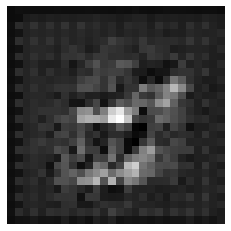

discriminator loss : 0.34287023544311523
Generator loss : [0.3269776, 0.0]
(1, 28, 28, 1)
(28, 28)


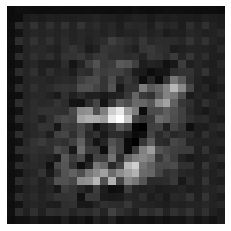

discriminator loss : 0.3244212567806244
Generator loss : [0.30681193, 0.0]
(1, 28, 28, 1)
(28, 28)


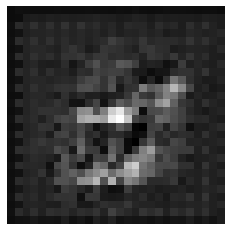

discriminator loss : 0.33235007524490356
Generator loss : [0.3328491, 0.0]
(1, 28, 28, 1)
(28, 28)


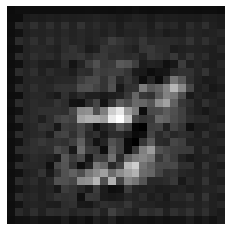

discriminator loss : 0.3336474597454071
Generator loss : [0.32542363, 0.0]
(1, 28, 28, 1)
(28, 28)


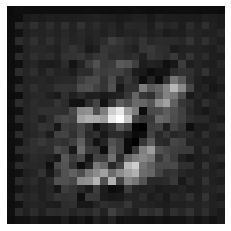

discriminator loss : 0.3400496244430542
Generator loss : [0.33762065, 0.0]
(1, 28, 28, 1)
(28, 28)


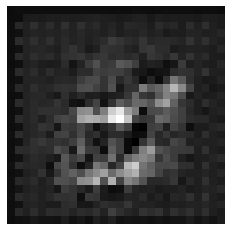

discriminator loss : 0.3332657814025879
Generator loss : [0.32826936, 0.0]
(1, 28, 28, 1)
(28, 28)


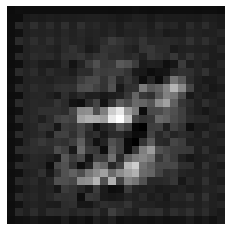

discriminator loss : 0.3468343913555145
Generator loss : [0.33994648, 0.0]
(1, 28, 28, 1)
(28, 28)


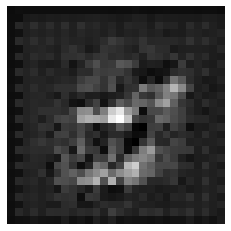

discriminator loss : 0.3425227999687195
Generator loss : [0.33457473, 0.0]
(1, 28, 28, 1)
(28, 28)


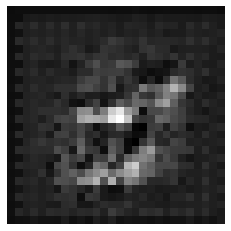

discriminator loss : 0.3292429447174072
Generator loss : [0.31280774, 0.0]
(1, 28, 28, 1)
(28, 28)


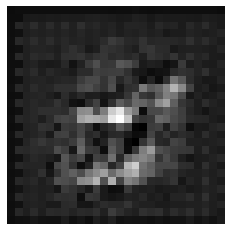

discriminator loss : 0.3361251652240753
Generator loss : [0.3226023, 0.0]
(1, 28, 28, 1)
(28, 28)


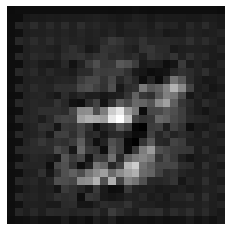

discriminator loss : 0.34374988079071045
Generator loss : [0.32217303, 0.0]
(1, 28, 28, 1)
(28, 28)


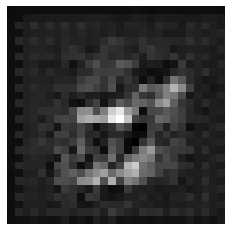

discriminator loss : 0.3395962715148926
Generator loss : [0.31738347, 0.0]
(1, 28, 28, 1)
(28, 28)


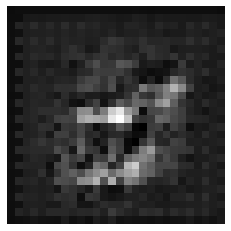

discriminator loss : 0.3627663254737854
Generator loss : [0.33016637, 0.0]
(1, 28, 28, 1)
(28, 28)


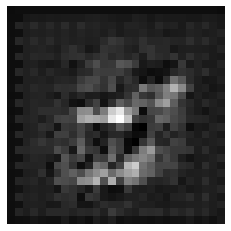

discriminator loss : 0.33368659019470215
Generator loss : [0.33567917, 0.0]
(1, 28, 28, 1)
(28, 28)


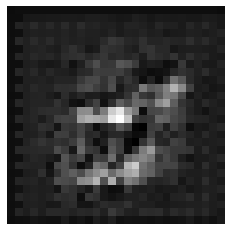

discriminator loss : 0.338767409324646
Generator loss : [0.31708276, 0.0]
(1, 28, 28, 1)
(28, 28)


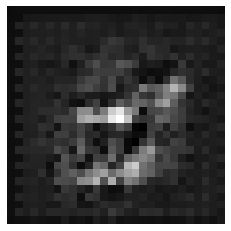

discriminator loss : 0.3355766236782074
Generator loss : [0.31169778, 0.0]
(1, 28, 28, 1)
(28, 28)


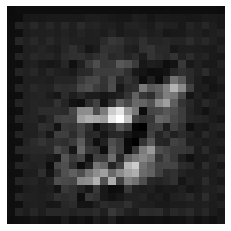

discriminator loss : 0.35692206025123596
Generator loss : [0.34239295, 0.0]
(1, 28, 28, 1)
(28, 28)


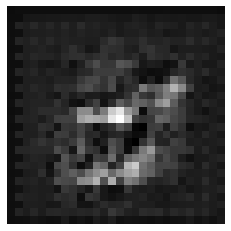

discriminator loss : 0.3375314474105835
Generator loss : [0.32879138, 0.0]
(1, 28, 28, 1)
(28, 28)


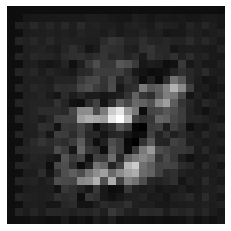

discriminator loss : 0.3412102460861206
Generator loss : [0.334657, 0.0]
(1, 28, 28, 1)
(28, 28)


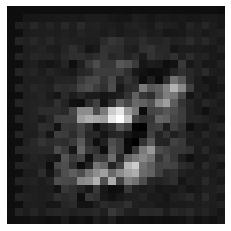

discriminator loss : 0.34468287229537964
Generator loss : [0.34079316, 0.0]
(1, 28, 28, 1)
(28, 28)


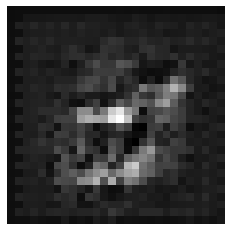

discriminator loss : 0.3327246904373169
Generator loss : [0.34247386, 0.0]
(1, 28, 28, 1)
(28, 28)


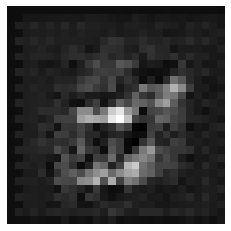

discriminator loss : 0.33962762355804443
Generator loss : [0.32724008, 0.0]
(1, 28, 28, 1)
(28, 28)


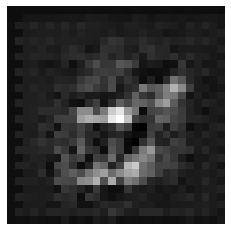

discriminator loss : 0.3290519714355469
Generator loss : [0.32845864, 0.0]
(1, 28, 28, 1)
(28, 28)


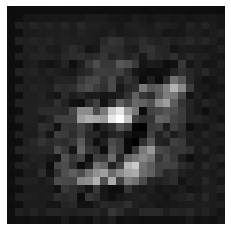

discriminator loss : 0.3495120704174042
Generator loss : [0.34455958, 0.0]
(1, 28, 28, 1)
(28, 28)


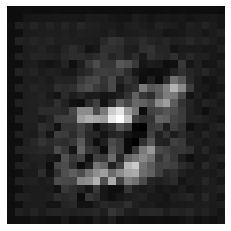

discriminator loss : 0.3518828749656677
Generator loss : [0.32620585, 0.0]
(1, 28, 28, 1)
(28, 28)


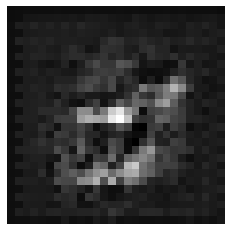

discriminator loss : 0.3443412780761719
Generator loss : [0.3395168, 0.0]
(1, 28, 28, 1)
(28, 28)


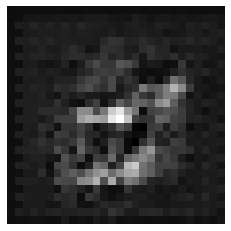

discriminator loss : 0.3269476890563965
Generator loss : [0.3197856, 0.0]
(1, 28, 28, 1)
(28, 28)


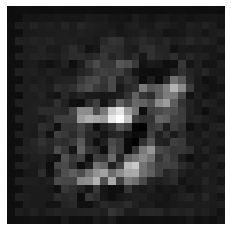

discriminator loss : 0.3509945273399353
Generator loss : [0.32953355, 0.0]
(1, 28, 28, 1)
(28, 28)


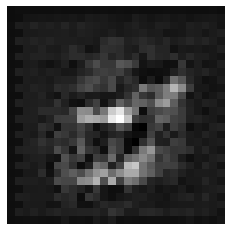

discriminator loss : 0.3333345055580139
Generator loss : [0.32307684, 0.0]
(1, 28, 28, 1)
(28, 28)


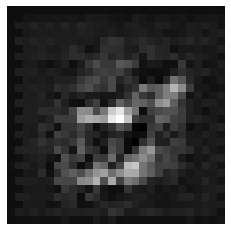

discriminator loss : 0.335714191198349
Generator loss : [0.32962444, 0.0]
(1, 28, 28, 1)
(28, 28)


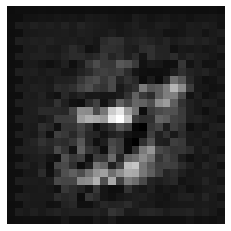

discriminator loss : 0.3526979982852936
Generator loss : [0.31327656, 0.0]
(1, 28, 28, 1)
(28, 28)


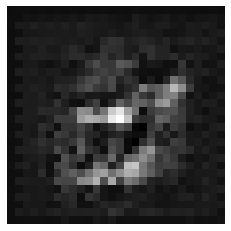

discriminator loss : 0.3755658268928528
Generator loss : [0.33988303, 0.0]
(1, 28, 28, 1)
(28, 28)


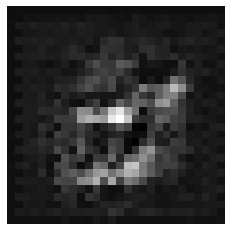

discriminator loss : 0.34462490677833557
Generator loss : [0.3294265, 0.0]
(1, 28, 28, 1)
(28, 28)


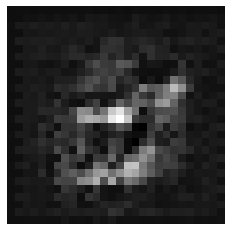

discriminator loss : 0.3716641664505005
Generator loss : [0.34788525, 0.0]
(1, 28, 28, 1)
(28, 28)


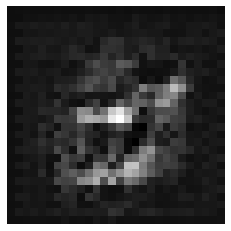

discriminator loss : 0.41927558183670044
Generator loss : [0.37576115, 0.0]
(1, 28, 28, 1)
(28, 28)


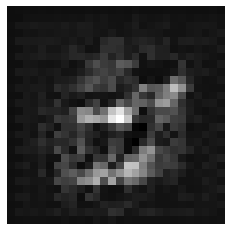

discriminator loss : 0.8837635517120361
Generator loss : [1.4114234, 0.0]
(1, 28, 28, 1)
(28, 28)


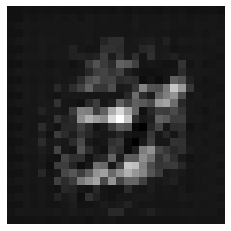

discriminator loss : 2.2668137550354004
Generator loss : [0.44682357, 0.0]
(1, 28, 28, 1)
(28, 28)


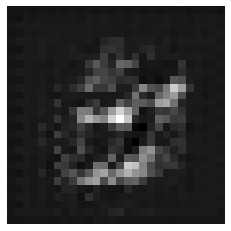

discriminator loss : 0.5443270802497864
Generator loss : [0.7228817, 0.0]
(1, 28, 28, 1)
(28, 28)


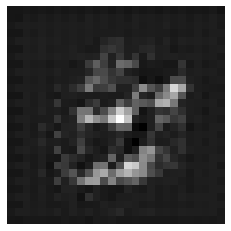

discriminator loss : 0.4770890772342682
Generator loss : [0.84424, 0.0]
(1, 28, 28, 1)
(28, 28)


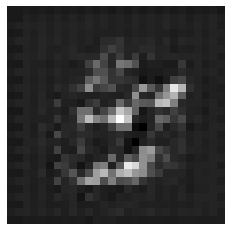

discriminator loss : 0.526899516582489
Generator loss : [0.8515051, 0.0]
(1, 28, 28, 1)
(28, 28)


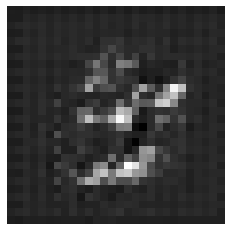

discriminator loss : 0.49201416969299316
Generator loss : [0.8587728, 0.0]
(1, 28, 28, 1)
(28, 28)


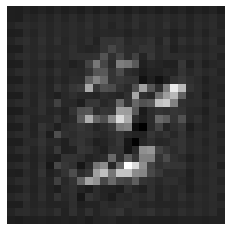

discriminator loss : 0.45678776502609253
Generator loss : [0.89332145, 0.0]
(1, 28, 28, 1)
(28, 28)


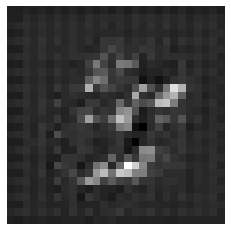

discriminator loss : 0.4422919452190399
Generator loss : [0.9502754, 0.0]
(1, 28, 28, 1)
(28, 28)


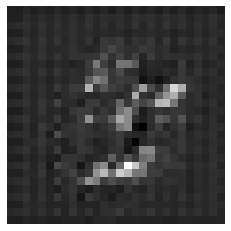

discriminator loss : 0.41214507818222046
Generator loss : [1.0345674, 0.0]
(1, 28, 28, 1)
(28, 28)


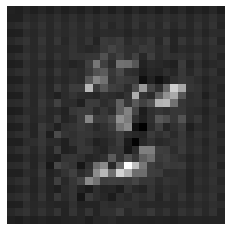

discriminator loss : 0.40205100178718567
Generator loss : [1.135602, 0.0]
(1, 28, 28, 1)
(28, 28)


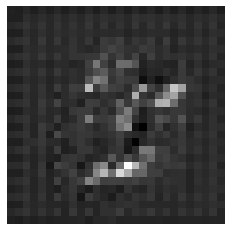

discriminator loss : 0.38922688364982605
Generator loss : [1.2530274, 0.0]
(1, 28, 28, 1)
(28, 28)


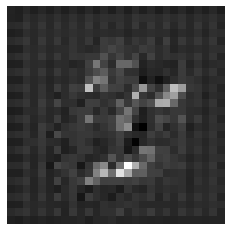

discriminator loss : 0.36524778604507446
Generator loss : [1.3957001, 0.0]
(1, 28, 28, 1)
(28, 28)


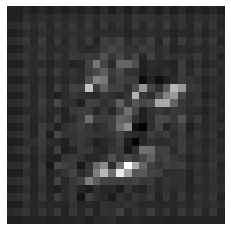

discriminator loss : 0.3590162992477417
Generator loss : [1.5310638, 0.0]
(1, 28, 28, 1)
(28, 28)


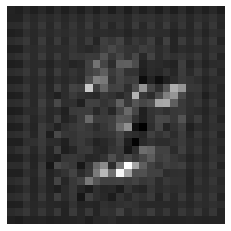

discriminator loss : 0.3604162931442261
Generator loss : [1.6433461, 0.0]
(1, 28, 28, 1)
(28, 28)


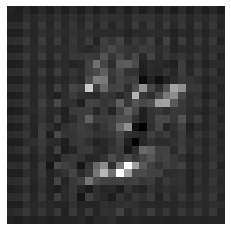

discriminator loss : 0.3552967309951782
Generator loss : [1.7479519, 0.0]
(1, 28, 28, 1)
(28, 28)


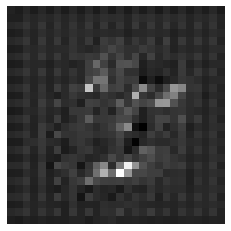

discriminator loss : 0.3602568209171295
Generator loss : [1.8201127, 0.0]
(1, 28, 28, 1)
(28, 28)


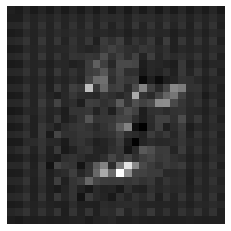

discriminator loss : 0.35803505778312683
Generator loss : [1.8570224, 0.0]
(1, 28, 28, 1)
(28, 28)


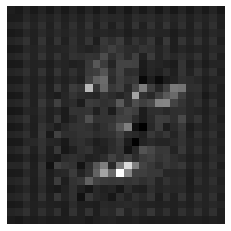

discriminator loss : 0.3423422574996948
Generator loss : [1.9177978, 0.0]
(1, 28, 28, 1)
(28, 28)


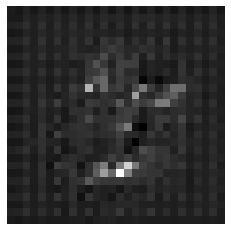

discriminator loss : 0.37464243173599243
Generator loss : [1.8868477, 0.0]
(1, 28, 28, 1)
(28, 28)


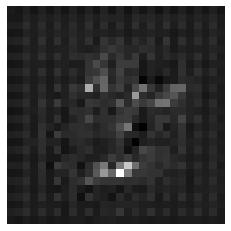

discriminator loss : 0.34861594438552856
Generator loss : [1.9446263, 0.0]
(1, 28, 28, 1)
(28, 28)


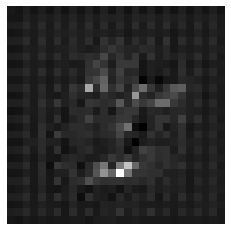

discriminator loss : 0.36094608902931213
Generator loss : [1.9658248, 0.0]
(1, 28, 28, 1)
(28, 28)


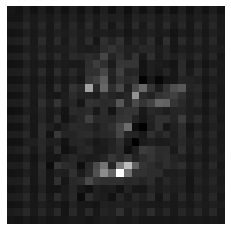

discriminator loss : 0.3715096116065979
Generator loss : [1.9313912, 0.0]
(1, 28, 28, 1)
(28, 28)


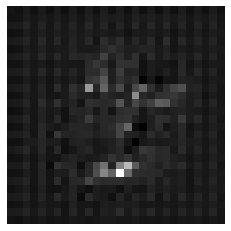

discriminator loss : 0.36263322830200195
Generator loss : [1.936077, 0.0]
(1, 28, 28, 1)
(28, 28)


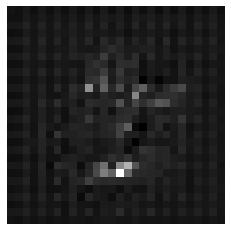

discriminator loss : 0.36340466141700745
Generator loss : [1.9869277, 0.0]
(1, 28, 28, 1)
(28, 28)


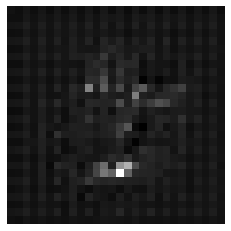

discriminator loss : 0.3461204767227173
Generator loss : [2.0551615, 0.0]
(1, 28, 28, 1)
(28, 28)


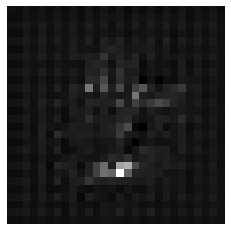

discriminator loss : 0.3742460608482361
Generator loss : [2.1498206, 0.0]
(1, 28, 28, 1)
(28, 28)


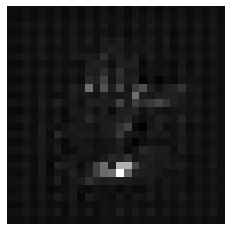

discriminator loss : 0.3597819209098816
Generator loss : [2.1974576, 0.0]
(1, 28, 28, 1)
(28, 28)


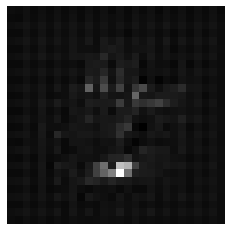

discriminator loss : 0.37247201800346375
Generator loss : [2.120679, 0.0]
(1, 28, 28, 1)
(28, 28)


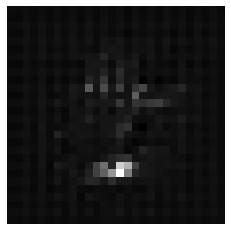

discriminator loss : 0.3810240626335144
Generator loss : [1.9695755, 0.0]
(1, 28, 28, 1)
(28, 28)


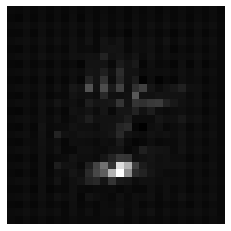

discriminator loss : 0.39486098289489746
Generator loss : [1.9365634, 0.0]
(1, 28, 28, 1)
(28, 28)


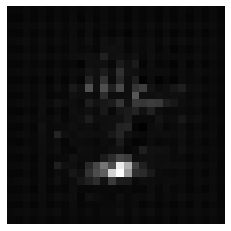

discriminator loss : 0.3900054693222046
Generator loss : [2.0171041, 0.0]
(1, 28, 28, 1)
(28, 28)


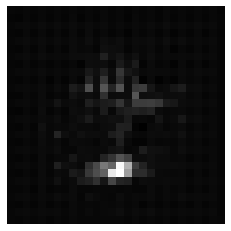

discriminator loss : 0.41136637330055237
Generator loss : [2.1785223, 0.0]
(1, 28, 28, 1)
(28, 28)


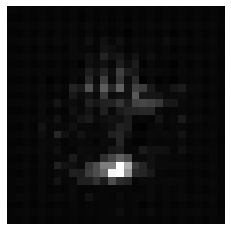

discriminator loss : 0.48370885848999023
Generator loss : [2.6271265, 0.0]
(1, 28, 28, 1)
(28, 28)


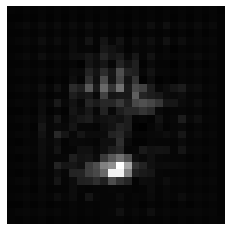

discriminator loss : 0.5596048831939697
Generator loss : [3.4706879, 0.0]
(1, 28, 28, 1)
(28, 28)


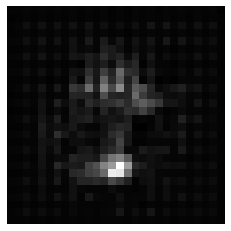

discriminator loss : 0.7059588432312012
Generator loss : [4.5550814, 0.0]
(1, 28, 28, 1)
(28, 28)


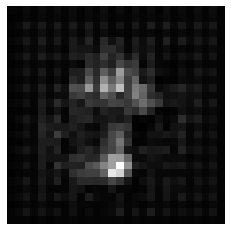

discriminator loss : 0.7314170002937317
Generator loss : [4.554289, 0.0]
(1, 28, 28, 1)
(28, 28)


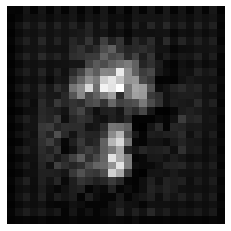

discriminator loss : 1.0344887971878052
Generator loss : [6.987374, 0.0]
(1, 28, 28, 1)
(28, 28)


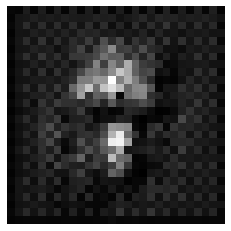

discriminator loss : 1.3501909971237183
Generator loss : [1.6474594, 0.0]
(1, 28, 28, 1)
(28, 28)


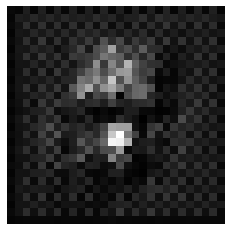

discriminator loss : 0.5555626153945923
Generator loss : [0.5415584, 0.0]
(1, 28, 28, 1)
(28, 28)


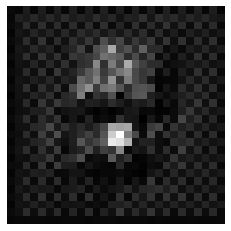

discriminator loss : 0.45854413509368896
Generator loss : [0.43092144, 0.0]
(1, 28, 28, 1)
(28, 28)


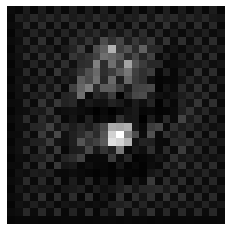

discriminator loss : 0.4526962637901306
Generator loss : [0.40032187, 0.0]
(1, 28, 28, 1)
(28, 28)


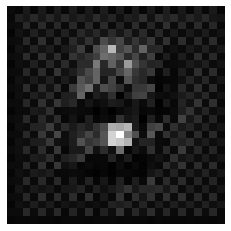

discriminator loss : 0.4014418125152588
Generator loss : [0.40689433, 0.0]
(1, 28, 28, 1)
(28, 28)


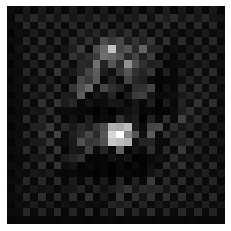

discriminator loss : 0.3701905608177185
Generator loss : [0.41717377, 0.0]
(1, 28, 28, 1)
(28, 28)


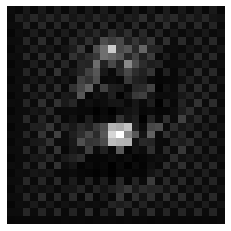

discriminator loss : 0.37224525213241577
Generator loss : [0.40302005, 0.0]
(1, 28, 28, 1)
(28, 28)


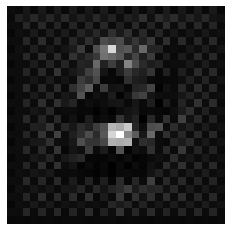

discriminator loss : 0.3862367272377014
Generator loss : [0.37527204, 0.0]
(1, 28, 28, 1)
(28, 28)


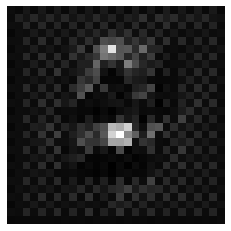

discriminator loss : 0.37440288066864014
Generator loss : [0.38589683, 0.0]
(1, 28, 28, 1)
(28, 28)


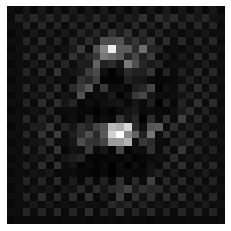

discriminator loss : 0.35938698053359985
Generator loss : [0.3439249, 0.0]
(1, 28, 28, 1)
(28, 28)


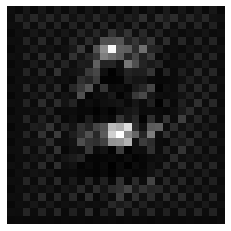

discriminator loss : 0.367088258266449
Generator loss : [0.3693737, 0.0]
(1, 28, 28, 1)
(28, 28)


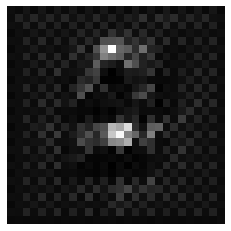

discriminator loss : 0.3646546006202698
Generator loss : [0.3550251, 0.0]
(1, 28, 28, 1)
(28, 28)


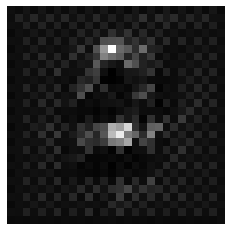

discriminator loss : 0.3738133907318115
Generator loss : [0.3512652, 0.0]
(1, 28, 28, 1)
(28, 28)


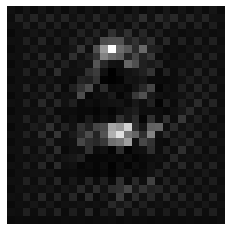

discriminator loss : 0.3959622383117676
Generator loss : [0.35378852, 0.0]
(1, 28, 28, 1)
(28, 28)


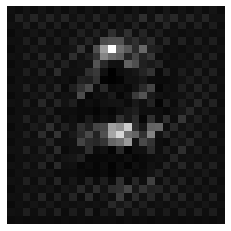

discriminator loss : 0.38342612981796265
Generator loss : [0.36165935, 0.0]
(1, 28, 28, 1)
(28, 28)


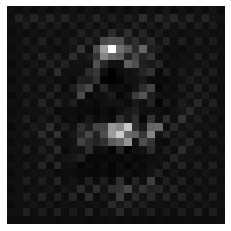

discriminator loss : 0.38050520420074463
Generator loss : [0.37127054, 0.0]
(1, 28, 28, 1)
(28, 28)


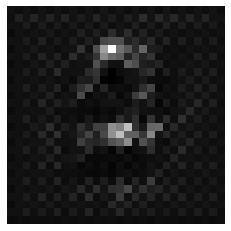

discriminator loss : 0.3900962471961975
Generator loss : [0.36922562, 0.0]
(1, 28, 28, 1)
(28, 28)


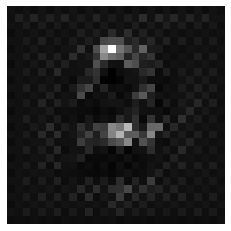

discriminator loss : 0.382501482963562
Generator loss : [0.38876387, 0.0]
(1, 28, 28, 1)
(28, 28)


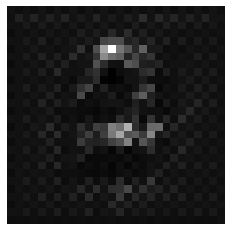

discriminator loss : 0.373088002204895
Generator loss : [0.38907668, 0.0]
(1, 28, 28, 1)
(28, 28)


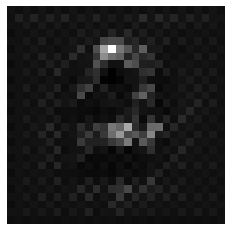

discriminator loss : 0.41043350100517273
Generator loss : [0.39420375, 0.0]
(1, 28, 28, 1)
(28, 28)


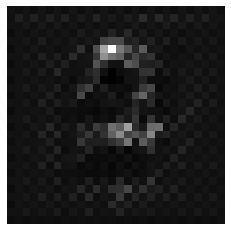

discriminator loss : 0.3826666474342346
Generator loss : [0.40369064, 0.0]
(1, 28, 28, 1)
(28, 28)


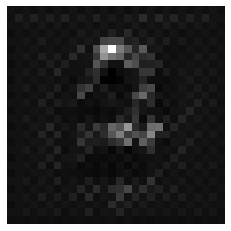

discriminator loss : 0.3731546103954315
Generator loss : [0.45596448, 0.0]
(1, 28, 28, 1)
(28, 28)


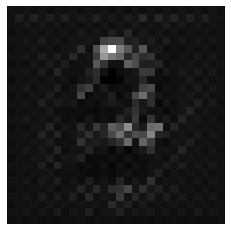

discriminator loss : 0.35791251063346863
Generator loss : [0.44364208, 0.0]
(1, 28, 28, 1)
(28, 28)


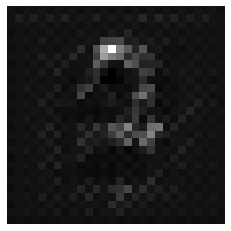

discriminator loss : 0.3634030818939209
Generator loss : [0.41562748, 0.0]
(1, 28, 28, 1)
(28, 28)


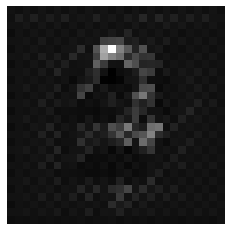

discriminator loss : 0.3733377456665039
Generator loss : [0.36997873, 0.0]
(1, 28, 28, 1)
(28, 28)


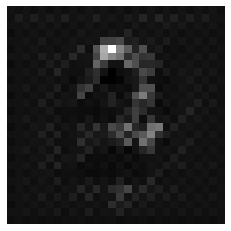

discriminator loss : 0.361133337020874
Generator loss : [0.36679468, 0.0]
(1, 28, 28, 1)
(28, 28)


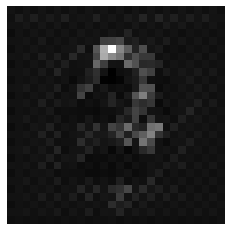

discriminator loss : 0.3500465154647827
Generator loss : [0.37755492, 0.0]
(1, 28, 28, 1)
(28, 28)


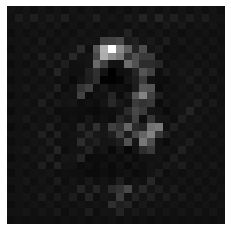

discriminator loss : 0.3671042323112488
Generator loss : [0.35435784, 0.0]
(1, 28, 28, 1)
(28, 28)


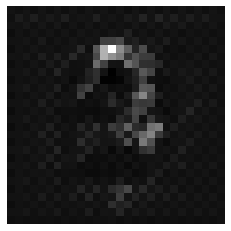

discriminator loss : 0.34835803508758545
Generator loss : [0.36232963, 0.0]
(1, 28, 28, 1)
(28, 28)


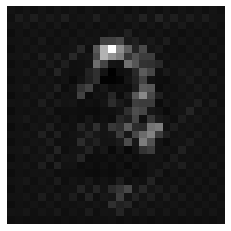

discriminator loss : 0.34912946820259094
Generator loss : [0.33798894, 0.0]
(1, 28, 28, 1)
(28, 28)


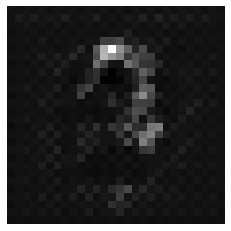

discriminator loss : 0.3660399913787842
Generator loss : [0.3281434, 0.0]
(1, 28, 28, 1)
(28, 28)


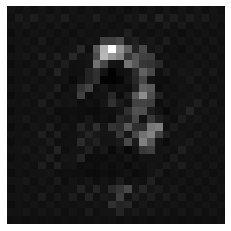

discriminator loss : 0.3539627492427826
Generator loss : [0.35555157, 0.0]
(1, 28, 28, 1)
(28, 28)


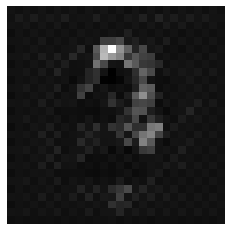

discriminator loss : 0.33147919178009033
Generator loss : [0.32344916, 0.0]
(1, 28, 28, 1)
(28, 28)


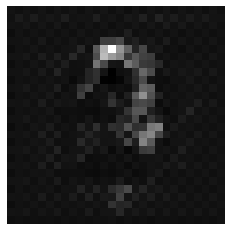

discriminator loss : 0.3313608765602112
Generator loss : [0.30839425, 0.0]
(1, 28, 28, 1)
(28, 28)


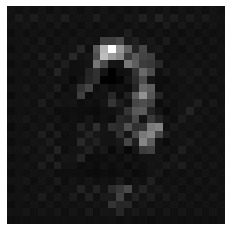

discriminator loss : 0.3330789804458618
Generator loss : [0.33739728, 0.0]
(1, 28, 28, 1)
(28, 28)


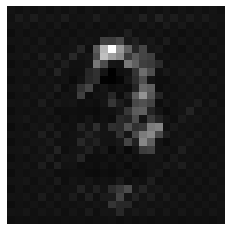

discriminator loss : 0.33304813504219055
Generator loss : [0.32357025, 0.0]
(1, 28, 28, 1)
(28, 28)


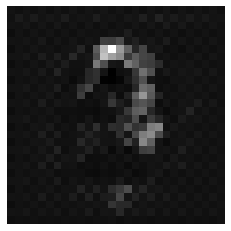

discriminator loss : 0.3266894817352295
Generator loss : [0.33004063, 0.0]
(1, 28, 28, 1)
(28, 28)


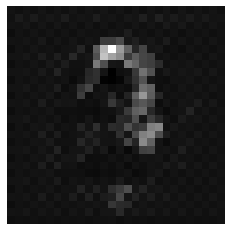

discriminator loss : 0.332051157951355
Generator loss : [0.33078897, 0.0]
(1, 28, 28, 1)
(28, 28)


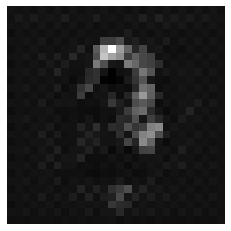

discriminator loss : 0.33684784173965454
Generator loss : [0.3212857, 0.0]
(1, 28, 28, 1)
(28, 28)


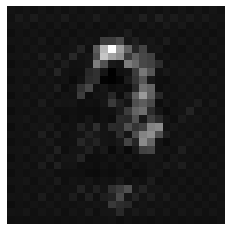

discriminator loss : 0.3322076201438904
Generator loss : [0.34140217, 0.0]
(1, 28, 28, 1)
(28, 28)


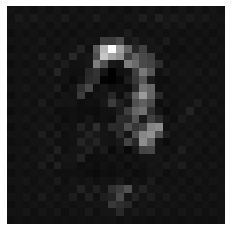

discriminator loss : 0.3396736979484558
Generator loss : [0.34963974, 0.0]
(1, 28, 28, 1)
(28, 28)


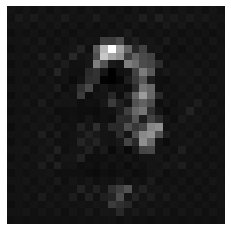

discriminator loss : 0.3297174572944641
Generator loss : [0.33565333, 0.0]
(1, 28, 28, 1)
(28, 28)


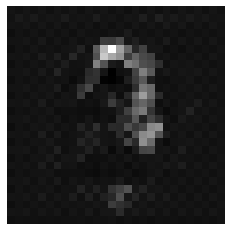

discriminator loss : 0.3509872853755951
Generator loss : [0.35938877, 0.0]
(1, 28, 28, 1)
(28, 28)


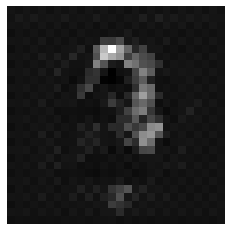

discriminator loss : 0.347699373960495
Generator loss : [0.35875875, 0.0]
(1, 28, 28, 1)
(28, 28)


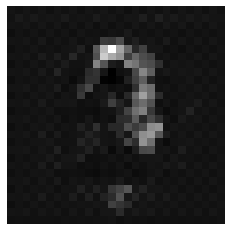

discriminator loss : 0.3435105085372925
Generator loss : [0.32865834, 0.0]
(1, 28, 28, 1)
(28, 28)


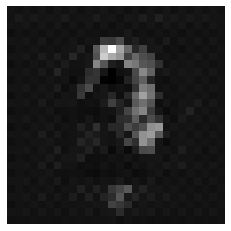

discriminator loss : 0.3307865858078003
Generator loss : [0.3178523, 0.0]
(1, 28, 28, 1)
(28, 28)


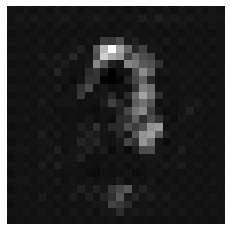

discriminator loss : 0.33920153975486755
Generator loss : [0.33289573, 0.0]
(1, 28, 28, 1)
(28, 28)


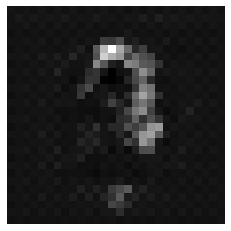

discriminator loss : 0.33215317130088806
Generator loss : [0.33048424, 0.0]
(1, 28, 28, 1)
(28, 28)


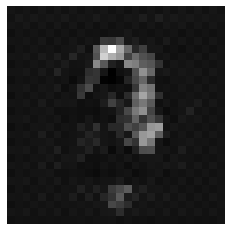

discriminator loss : 0.33737239241600037
Generator loss : [0.3525709, 0.0]
(1, 28, 28, 1)
(28, 28)


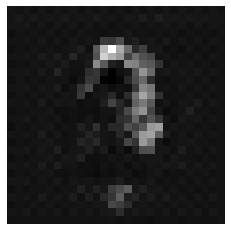

discriminator loss : 0.3489271402359009
Generator loss : [0.3973592, 0.0]
(1, 28, 28, 1)
(28, 28)


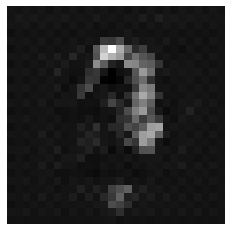

discriminator loss : 0.35590845346450806
Generator loss : [0.34921166, 0.0]
(1, 28, 28, 1)
(28, 28)


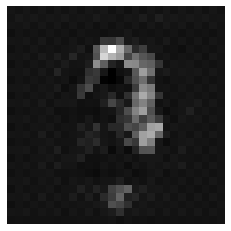

discriminator loss : 0.325042188167572
Generator loss : [0.33963165, 0.0]
(1, 28, 28, 1)
(28, 28)


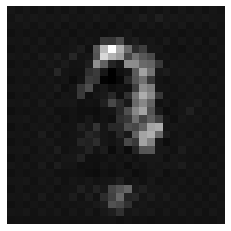

discriminator loss : 0.332503080368042
Generator loss : [0.3449884, 0.0]
(1, 28, 28, 1)
(28, 28)


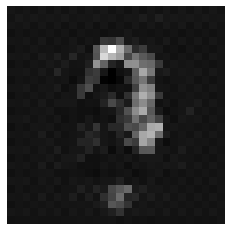

discriminator loss : 0.33932918310165405
Generator loss : [0.33639038, 0.0]
(1, 28, 28, 1)
(28, 28)


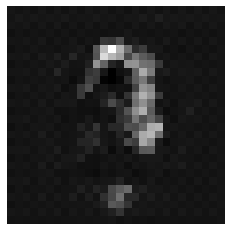

discriminator loss : 0.3260774612426758
Generator loss : [0.3510246, 0.0]
(1, 28, 28, 1)
(28, 28)


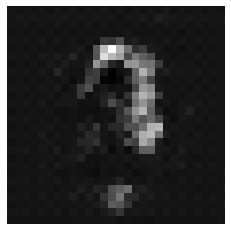

discriminator loss : 0.3367159366607666
Generator loss : [0.33633462, 0.0]
(1, 28, 28, 1)
(28, 28)


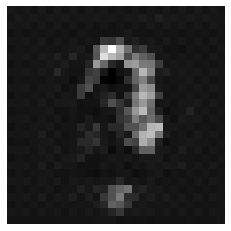

discriminator loss : 0.31728506088256836
Generator loss : [0.3385508, 0.0]
(1, 28, 28, 1)
(28, 28)


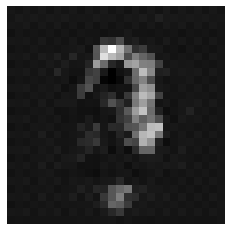

discriminator loss : 0.34017711877822876
Generator loss : [0.32460153, 0.0]
(1, 28, 28, 1)
(28, 28)


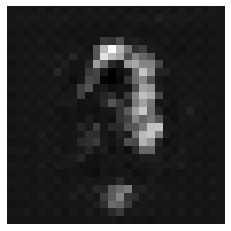

discriminator loss : 0.34994733333587646
Generator loss : [0.35334396, 0.0]
(1, 28, 28, 1)
(28, 28)


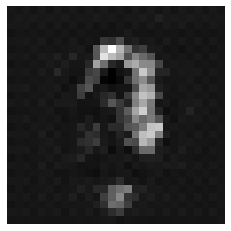

discriminator loss : 0.338564932346344
Generator loss : [0.3518122, 0.0]
(1, 28, 28, 1)
(28, 28)


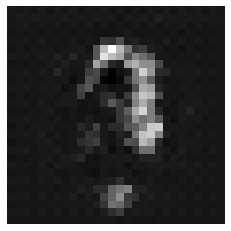

discriminator loss : 0.3588286340236664
Generator loss : [0.44185123, 0.0]
(1, 28, 28, 1)
(28, 28)


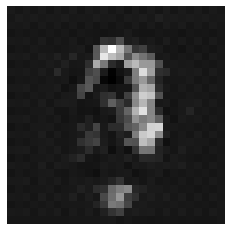

discriminator loss : 0.5134020447731018
Generator loss : [1.8165778, 0.0]
(1, 28, 28, 1)
(28, 28)


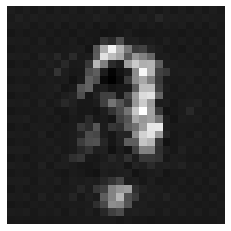

discriminator loss : 1.8040239810943604
Generator loss : [0.6495596, 0.0]
(1, 28, 28, 1)
(28, 28)


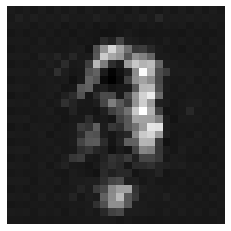

discriminator loss : 0.5659803748130798
Generator loss : [0.3818125, 0.0]
(1, 28, 28, 1)
(28, 28)


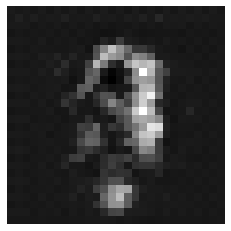

epoch : 1
discriminator loss : 0.4396967589855194
Generator loss : [0.33025166, 0.0]
(1, 28, 28, 1)
(28, 28)


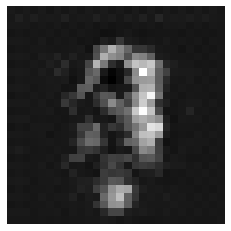

discriminator loss : 0.42649751901626587
Generator loss : [0.33678257, 0.0]
(1, 28, 28, 1)
(28, 28)


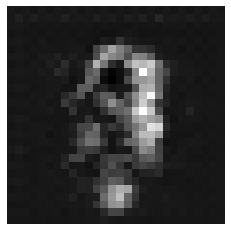

discriminator loss : 0.43398725986480713
Generator loss : [0.34486398, 0.0]
(1, 28, 28, 1)
(28, 28)


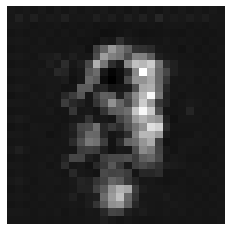

discriminator loss : 0.4364404082298279
Generator loss : [0.31698874, 0.0]
(1, 28, 28, 1)
(28, 28)


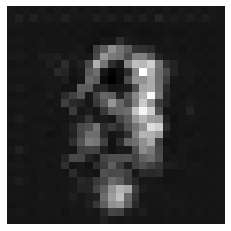

discriminator loss : 0.4433485269546509
Generator loss : [0.33998924, 0.0]
(1, 28, 28, 1)
(28, 28)


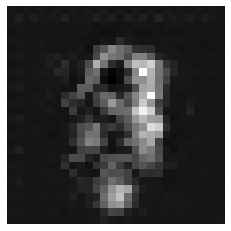

discriminator loss : 0.43507006764411926
Generator loss : [0.33924815, 0.0]
(1, 28, 28, 1)
(28, 28)


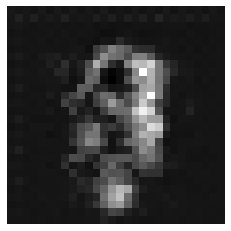

discriminator loss : 0.42669981718063354
Generator loss : [0.32308635, 0.0]
(1, 28, 28, 1)
(28, 28)


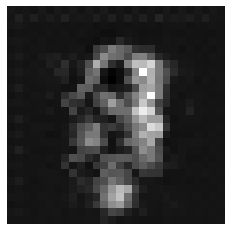

discriminator loss : 0.41483014822006226
Generator loss : [0.34783742, 0.0]
(1, 28, 28, 1)
(28, 28)


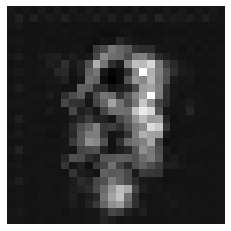

discriminator loss : 0.4127123951911926
Generator loss : [0.33052367, 0.0]
(1, 28, 28, 1)
(28, 28)


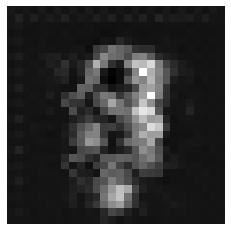

discriminator loss : 0.39287251234054565
Generator loss : [0.3350058, 0.0]
(1, 28, 28, 1)
(28, 28)


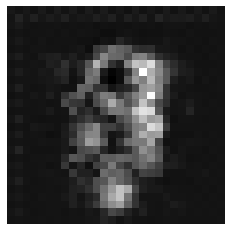

discriminator loss : 0.40461814403533936
Generator loss : [0.3475182, 0.0]
(1, 28, 28, 1)
(28, 28)


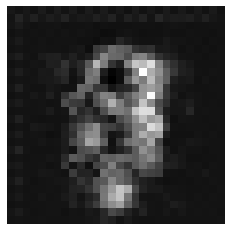

discriminator loss : 0.40720584988594055
Generator loss : [0.34099475, 0.0]
(1, 28, 28, 1)
(28, 28)


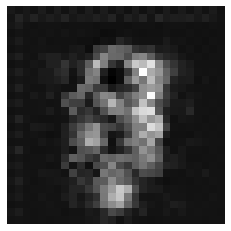

discriminator loss : 0.401165246963501
Generator loss : [0.35449326, 0.0]
(1, 28, 28, 1)
(28, 28)


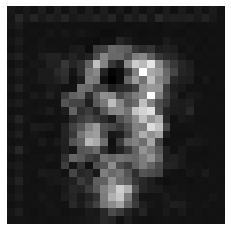

discriminator loss : 0.4001537561416626
Generator loss : [0.33809608, 0.0]
(1, 28, 28, 1)
(28, 28)


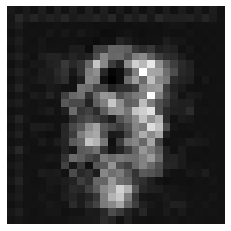

discriminator loss : 0.38862499594688416
Generator loss : [0.36409676, 0.0]
(1, 28, 28, 1)
(28, 28)


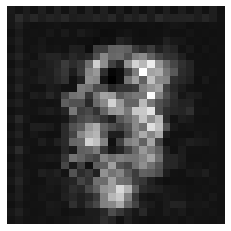

discriminator loss : 0.4112851917743683
Generator loss : [0.37730193, 0.0]
(1, 28, 28, 1)
(28, 28)


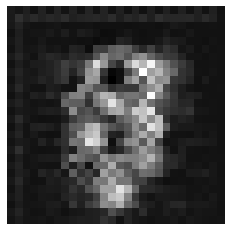

discriminator loss : 0.4876149892807007
Generator loss : [0.4814138, 0.0]
(1, 28, 28, 1)
(28, 28)


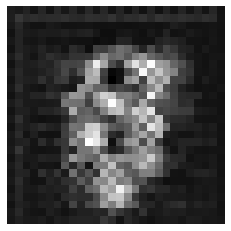

discriminator loss : 0.5569448471069336
Generator loss : [1.1130445, 0.0]
(1, 28, 28, 1)
(28, 28)


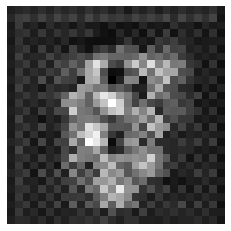

discriminator loss : 0.8755416870117188
Generator loss : [3.4392426, 0.0]
(1, 28, 28, 1)
(28, 28)


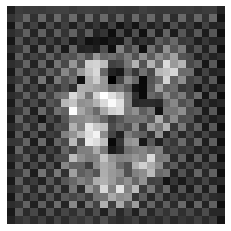

discriminator loss : 0.8452481031417847
Generator loss : [0.6974765, 0.0]
(1, 28, 28, 1)
(28, 28)


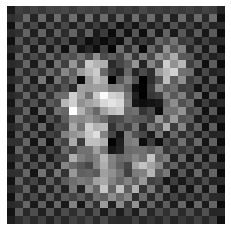

discriminator loss : 0.472478449344635
Generator loss : [0.31321004, 0.0]
(1, 28, 28, 1)
(28, 28)


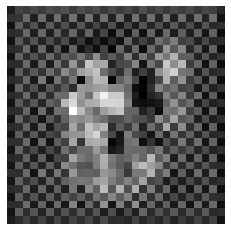

discriminator loss : 0.3497534990310669
Generator loss : [0.36813977, 0.0]
(1, 28, 28, 1)
(28, 28)


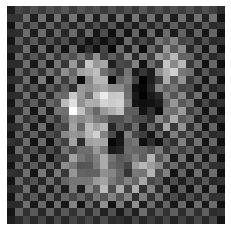

discriminator loss : 0.32927370071411133
Generator loss : [0.36662105, 0.0]
(1, 28, 28, 1)
(28, 28)


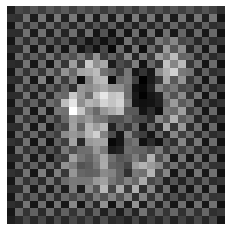

discriminator loss : 0.3805100917816162
Generator loss : [0.40227905, 0.0]
(1, 28, 28, 1)
(28, 28)


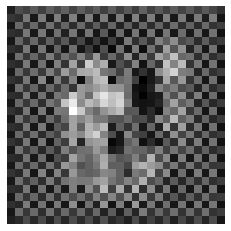

discriminator loss : 0.39914292097091675
Generator loss : [0.37454605, 0.0]
(1, 28, 28, 1)
(28, 28)


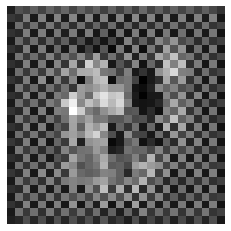

discriminator loss : 0.3828731179237366
Generator loss : [0.34780025, 0.0]
(1, 28, 28, 1)
(28, 28)


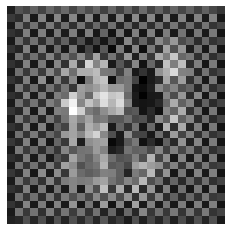

discriminator loss : 0.3519251346588135
Generator loss : [0.36544845, 0.0]
(1, 28, 28, 1)
(28, 28)


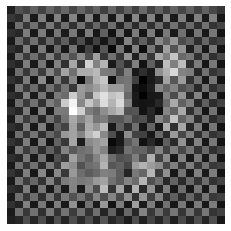

discriminator loss : 0.3413156270980835
Generator loss : [0.37166274, 0.0]
(1, 28, 28, 1)
(28, 28)


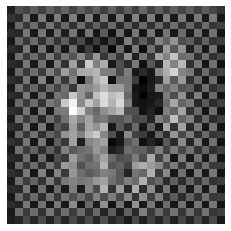

discriminator loss : 0.33646059036254883
Generator loss : [0.34170264, 0.0]
(1, 28, 28, 1)
(28, 28)


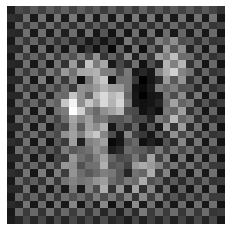

discriminator loss : 0.3312833905220032
Generator loss : [0.32054314, 0.0]
(1, 28, 28, 1)
(28, 28)


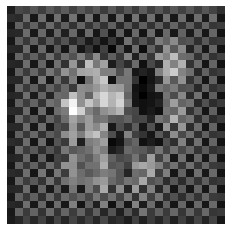

discriminator loss : 0.34058678150177
Generator loss : [0.33149055, 0.0]
(1, 28, 28, 1)
(28, 28)


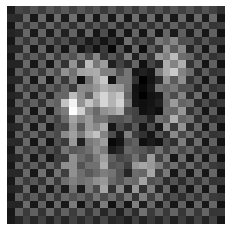

discriminator loss : 0.34484830498695374
Generator loss : [0.3416236, 0.0]
(1, 28, 28, 1)
(28, 28)


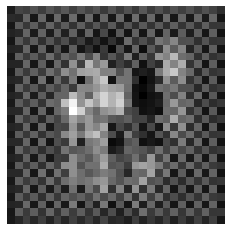

discriminator loss : 0.34226539731025696
Generator loss : [0.32725838, 0.0]
(1, 28, 28, 1)
(28, 28)


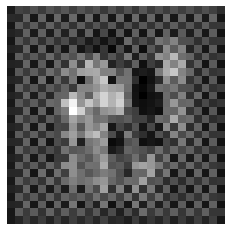

discriminator loss : 0.3414682149887085
Generator loss : [0.3427211, 0.0]
(1, 28, 28, 1)
(28, 28)


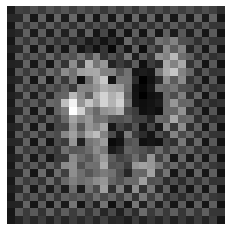

discriminator loss : 0.3370027542114258
Generator loss : [0.31454232, 0.0]
(1, 28, 28, 1)
(28, 28)


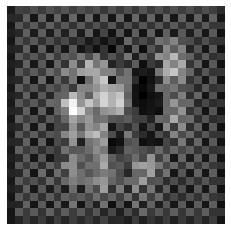

discriminator loss : 0.3506953716278076
Generator loss : [0.34710354, 0.0]
(1, 28, 28, 1)
(28, 28)


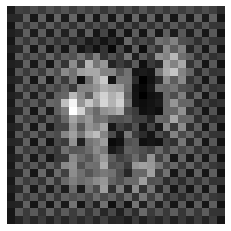

discriminator loss : 0.3494773507118225
Generator loss : [0.33112264, 0.0]
(1, 28, 28, 1)
(28, 28)


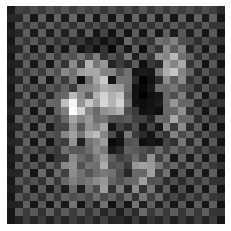

discriminator loss : 0.3447880446910858
Generator loss : [0.33590314, 0.0]
(1, 28, 28, 1)
(28, 28)


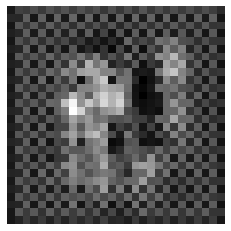

discriminator loss : 0.33602356910705566
Generator loss : [0.31993517, 0.0]
(1, 28, 28, 1)
(28, 28)


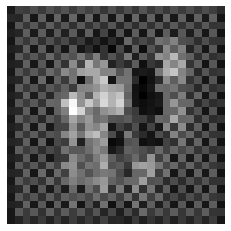

discriminator loss : 0.32929450273513794
Generator loss : [0.32153243, 0.0]
(1, 28, 28, 1)
(28, 28)


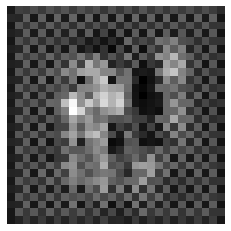

discriminator loss : 0.3279646635055542
Generator loss : [0.31227857, 0.0]
(1, 28, 28, 1)
(28, 28)


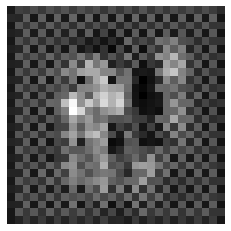

discriminator loss : 0.34546974301338196
Generator loss : [0.32278714, 0.0]
(1, 28, 28, 1)
(28, 28)


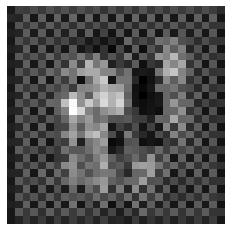

discriminator loss : 0.34245115518569946
Generator loss : [0.3295815, 0.0]
(1, 28, 28, 1)
(28, 28)


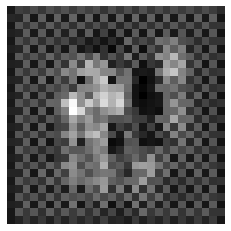

discriminator loss : 0.3414473533630371
Generator loss : [0.32066736, 0.0]
(1, 28, 28, 1)
(28, 28)


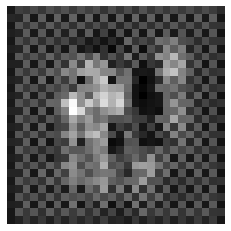

discriminator loss : 0.3349321484565735
Generator loss : [0.3362117, 0.0]
(1, 28, 28, 1)
(28, 28)


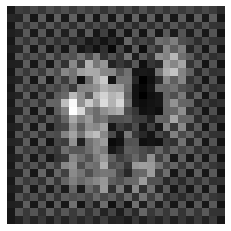

discriminator loss : 0.3368479013442993
Generator loss : [0.32589385, 0.0]
(1, 28, 28, 1)
(28, 28)


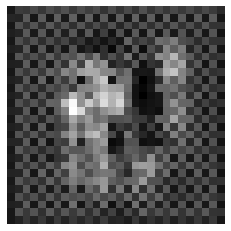

discriminator loss : 0.32442981004714966
Generator loss : [0.31307805, 0.0]
(1, 28, 28, 1)
(28, 28)


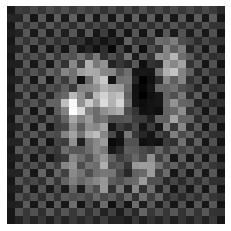

discriminator loss : 0.35384511947631836
Generator loss : [0.3556113, 0.0]
(1, 28, 28, 1)
(28, 28)


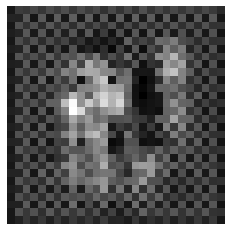

discriminator loss : 0.3326749801635742
Generator loss : [0.31468245, 0.0]
(1, 28, 28, 1)
(28, 28)


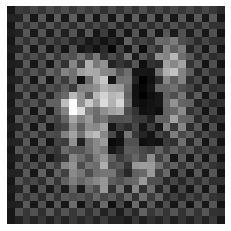

discriminator loss : 0.34034329652786255
Generator loss : [0.34248137, 0.0]
(1, 28, 28, 1)
(28, 28)


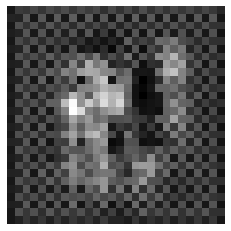

discriminator loss : 0.3320068120956421
Generator loss : [0.3132285, 0.0]
(1, 28, 28, 1)
(28, 28)


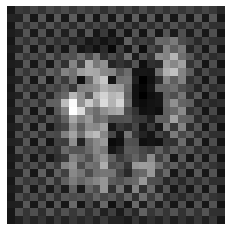

discriminator loss : 0.3401135206222534
Generator loss : [0.3252438, 0.0]
(1, 28, 28, 1)
(28, 28)


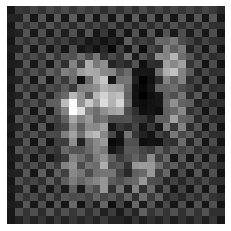

discriminator loss : 0.3466832935810089
Generator loss : [0.35093936, 0.0]
(1, 28, 28, 1)
(28, 28)


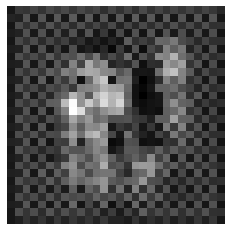

discriminator loss : 0.3120638430118561
Generator loss : [0.30422986, 0.0]
(1, 28, 28, 1)
(28, 28)


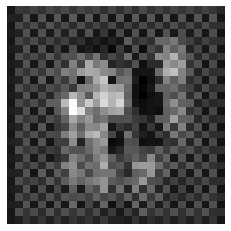

discriminator loss : 0.3417719602584839
Generator loss : [0.33184505, 0.0]
(1, 28, 28, 1)
(28, 28)


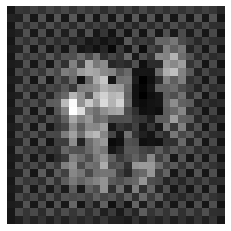

discriminator loss : 0.332067608833313
Generator loss : [0.3163384, 0.0]
(1, 28, 28, 1)
(28, 28)


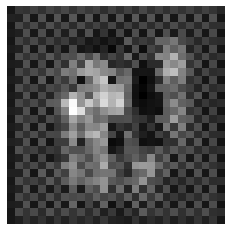

discriminator loss : 0.3138846457004547
Generator loss : [0.3071867, 0.0]
(1, 28, 28, 1)
(28, 28)


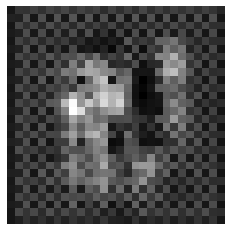

discriminator loss : 0.3252607583999634
Generator loss : [0.31565088, 0.0]
(1, 28, 28, 1)
(28, 28)


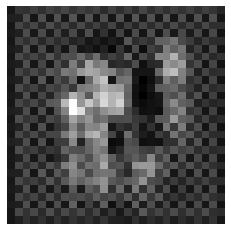

discriminator loss : 0.3387114703655243
Generator loss : [0.3467994, 0.0]
(1, 28, 28, 1)
(28, 28)


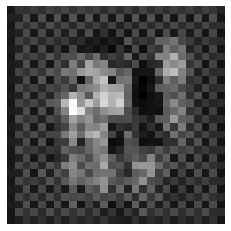

discriminator loss : 0.3365994095802307
Generator loss : [0.3322322, 0.0]
(1, 28, 28, 1)
(28, 28)


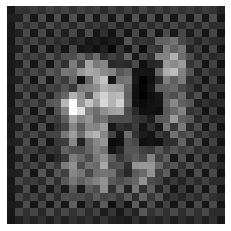

discriminator loss : 0.34400686621665955
Generator loss : [0.3397556, 0.0]
(1, 28, 28, 1)
(28, 28)


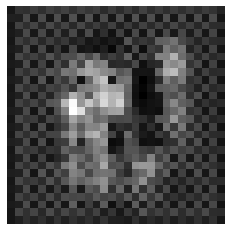

discriminator loss : 0.3285076320171356
Generator loss : [0.32802606, 0.0]
(1, 28, 28, 1)
(28, 28)


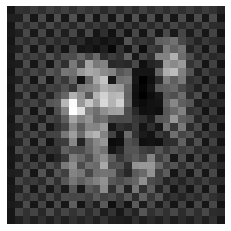

discriminator loss : 0.33424898982048035
Generator loss : [0.31565517, 0.0]
(1, 28, 28, 1)
(28, 28)


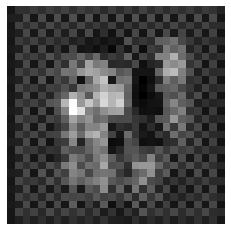

discriminator loss : 0.32464343309402466
Generator loss : [0.3129232, 0.0]
(1, 28, 28, 1)
(28, 28)


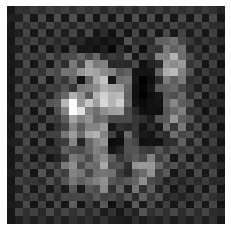

discriminator loss : 0.3296671509742737
Generator loss : [0.31611857, 0.0]
(1, 28, 28, 1)
(28, 28)


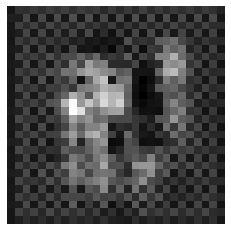

discriminator loss : 0.3199247121810913
Generator loss : [0.32034016, 0.0]
(1, 28, 28, 1)
(28, 28)


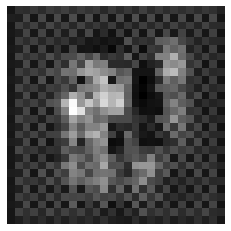

discriminator loss : 0.33082178235054016
Generator loss : [0.3373673, 0.0]
(1, 28, 28, 1)
(28, 28)


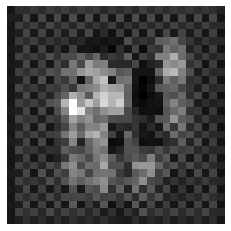

discriminator loss : 0.3433196544647217
Generator loss : [0.342415, 0.0]
(1, 28, 28, 1)
(28, 28)


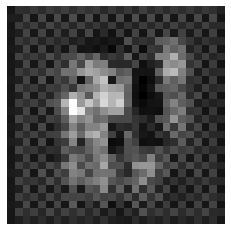

discriminator loss : 0.3187903165817261
Generator loss : [0.31502807, 0.0]
(1, 28, 28, 1)
(28, 28)


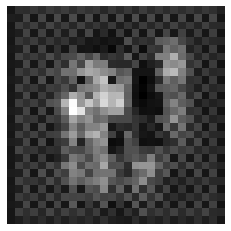

discriminator loss : 0.3277817368507385
Generator loss : [0.30829427, 0.0]
(1, 28, 28, 1)
(28, 28)


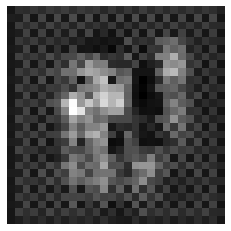

discriminator loss : 0.3204531669616699
Generator loss : [0.31182396, 0.0]
(1, 28, 28, 1)
(28, 28)


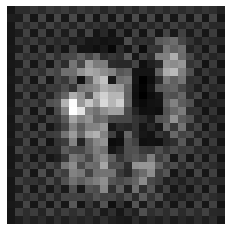

discriminator loss : 0.3309474587440491
Generator loss : [0.32792595, 0.0]
(1, 28, 28, 1)
(28, 28)


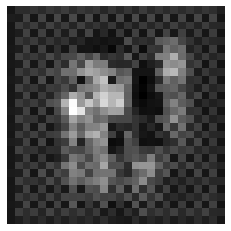

discriminator loss : 0.3271961212158203
Generator loss : [0.3231038, 0.0]
(1, 28, 28, 1)
(28, 28)


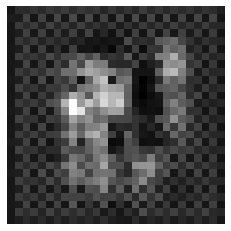

discriminator loss : 0.3234593868255615
Generator loss : [0.31705967, 0.0]
(1, 28, 28, 1)
(28, 28)


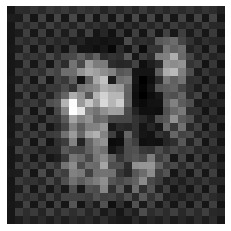

discriminator loss : 0.3239617347717285
Generator loss : [0.32451287, 0.0]
(1, 28, 28, 1)
(28, 28)


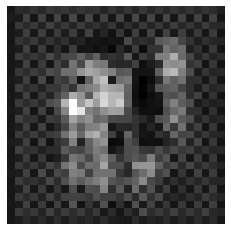

discriminator loss : 0.3293645977973938
Generator loss : [0.32052228, 0.0]
(1, 28, 28, 1)
(28, 28)


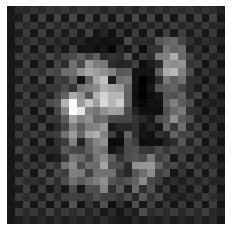

discriminator loss : 0.3304929733276367
Generator loss : [0.33320385, 0.0]
(1, 28, 28, 1)
(28, 28)


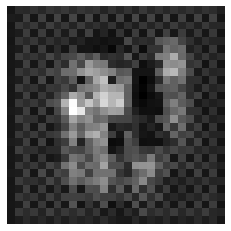

discriminator loss : 0.331479012966156
Generator loss : [0.3424304, 0.0]
(1, 28, 28, 1)
(28, 28)


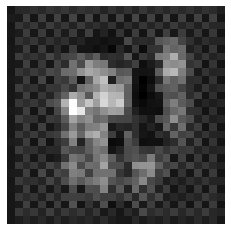

discriminator loss : 0.31610235571861267
Generator loss : [0.32783714, 0.0]
(1, 28, 28, 1)
(28, 28)


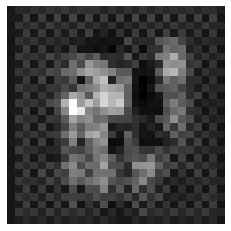

discriminator loss : 0.34400129318237305
Generator loss : [0.33233055, 0.0]
(1, 28, 28, 1)
(28, 28)


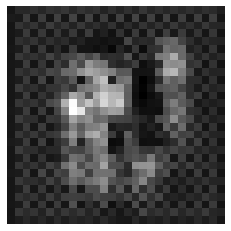

discriminator loss : 0.33192944526672363
Generator loss : [0.3318266, 0.0]
(1, 28, 28, 1)
(28, 28)


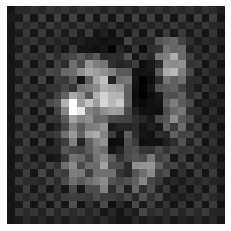

discriminator loss : 0.32600659132003784
Generator loss : [0.31395248, 0.0]
(1, 28, 28, 1)
(28, 28)


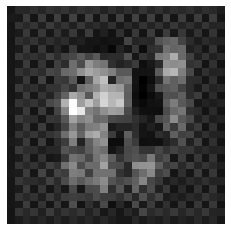

discriminator loss : 0.3322228789329529
Generator loss : [0.33374843, 0.0]
(1, 28, 28, 1)
(28, 28)


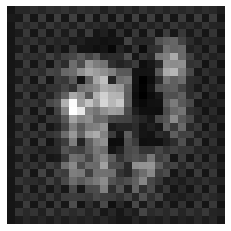

discriminator loss : 0.3205428421497345
Generator loss : [0.32253444, 0.0]
(1, 28, 28, 1)
(28, 28)


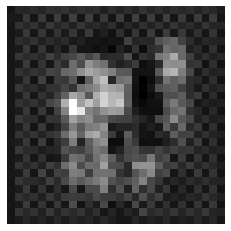

discriminator loss : 0.32992875576019287
Generator loss : [0.31683934, 0.0]
(1, 28, 28, 1)
(28, 28)


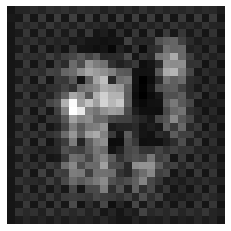

discriminator loss : 0.32853585481643677
Generator loss : [0.327699, 0.0]
(1, 28, 28, 1)
(28, 28)


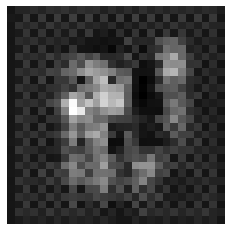

discriminator loss : 0.3231421709060669
Generator loss : [0.30553064, 0.0]
(1, 28, 28, 1)
(28, 28)


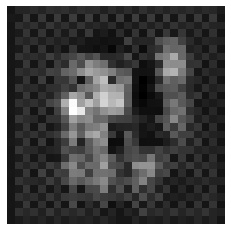

discriminator loss : 0.3190140724182129
Generator loss : [0.32035035, 0.0]
(1, 28, 28, 1)
(28, 28)


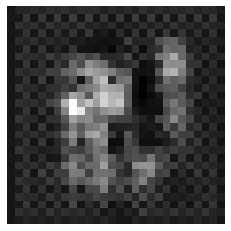

discriminator loss : 0.3111724257469177
Generator loss : [0.30591935, 0.0]
(1, 28, 28, 1)
(28, 28)


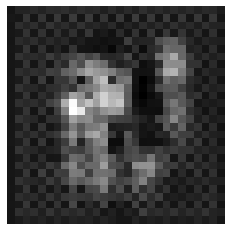

discriminator loss : 0.3377290368080139
Generator loss : [0.33794263, 0.0]
(1, 28, 28, 1)
(28, 28)


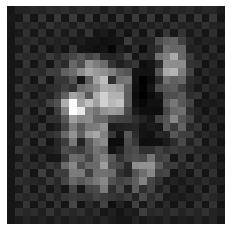

discriminator loss : 0.3277287185192108
Generator loss : [0.3185694, 0.0]
(1, 28, 28, 1)
(28, 28)


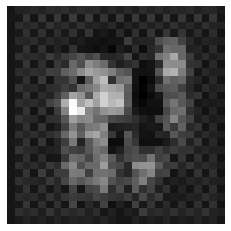

discriminator loss : 0.34743374586105347
Generator loss : [0.3406027, 0.0]
(1, 28, 28, 1)
(28, 28)


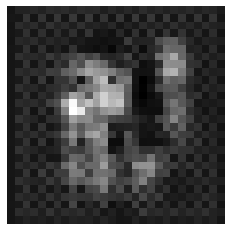

discriminator loss : 0.3291032016277313
Generator loss : [0.31737426, 0.0]
(1, 28, 28, 1)
(28, 28)


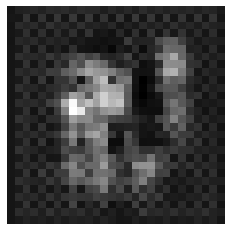

discriminator loss : 0.3408363461494446
Generator loss : [0.3504914, 0.0]
(1, 28, 28, 1)
(28, 28)


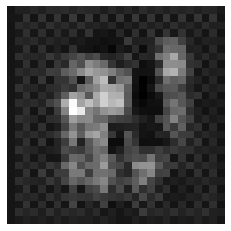

discriminator loss : 0.3343011140823364
Generator loss : [0.3281941, 0.0]
(1, 28, 28, 1)
(28, 28)


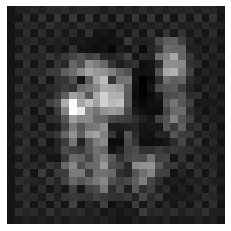

discriminator loss : 0.34630584716796875
Generator loss : [0.3349502, 0.0]
(1, 28, 28, 1)
(28, 28)


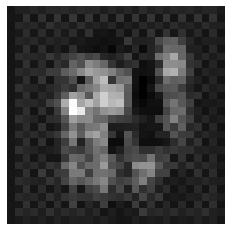

discriminator loss : 0.3382997512817383
Generator loss : [0.32368955, 0.0]
(1, 28, 28, 1)
(28, 28)


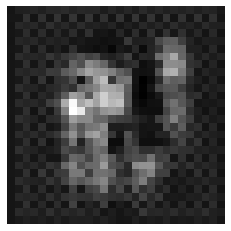

discriminator loss : 0.3295329213142395
Generator loss : [0.32084933, 0.0]
(1, 28, 28, 1)
(28, 28)


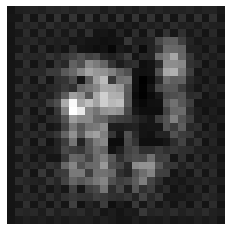

discriminator loss : 0.3206941485404968
Generator loss : [0.31802928, 0.0]
(1, 28, 28, 1)
(28, 28)


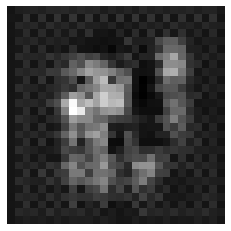

discriminator loss : 0.32789885997772217
Generator loss : [0.31886023, 0.0]
(1, 28, 28, 1)
(28, 28)


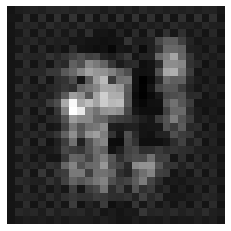

discriminator loss : 0.32540783286094666
Generator loss : [0.33358547, 0.0]
(1, 28, 28, 1)
(28, 28)


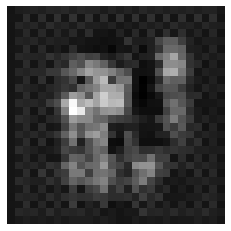

discriminator loss : 0.32207655906677246
Generator loss : [0.32645693, 0.0]
(1, 28, 28, 1)
(28, 28)


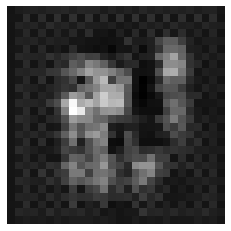

discriminator loss : 0.3328341543674469
Generator loss : [0.30163547, 0.0]
(1, 28, 28, 1)
(28, 28)


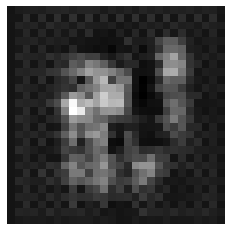

discriminator loss : 0.32800573110580444
Generator loss : [0.32882065, 0.0]
(1, 28, 28, 1)
(28, 28)


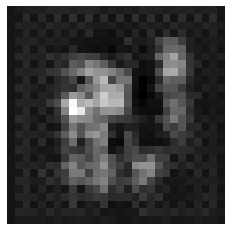

discriminator loss : 0.34510537981987
Generator loss : [0.3424165, 0.0]
(1, 28, 28, 1)
(28, 28)


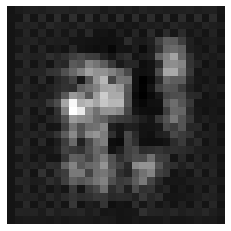

discriminator loss : 0.3280279338359833
Generator loss : [0.33007967, 0.0]
(1, 28, 28, 1)
(28, 28)


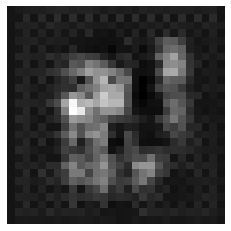

discriminator loss : 0.3313536047935486
Generator loss : [0.32877705, 0.0]
(1, 28, 28, 1)
(28, 28)


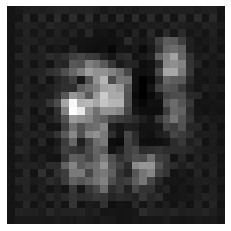

discriminator loss : 0.3335533142089844
Generator loss : [0.3453895, 0.0]
(1, 28, 28, 1)
(28, 28)


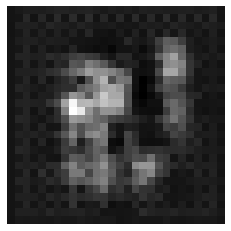

discriminator loss : 0.34254974126815796
Generator loss : [0.34613323, 0.0]
(1, 28, 28, 1)
(28, 28)


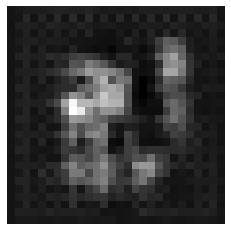

discriminator loss : 0.3495497703552246
Generator loss : [0.38039353, 0.0]
(1, 28, 28, 1)
(28, 28)


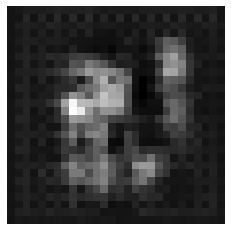

discriminator loss : 0.3677210807800293
Generator loss : [0.41129553, 0.0]
(1, 28, 28, 1)
(28, 28)


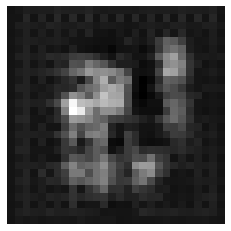

discriminator loss : 0.3889567255973816
Generator loss : [0.4522833, 0.0]
(1, 28, 28, 1)
(28, 28)


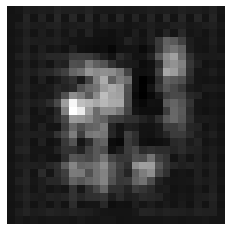

discriminator loss : 0.3864387273788452
Generator loss : [0.47446412, 0.0]
(1, 28, 28, 1)
(28, 28)


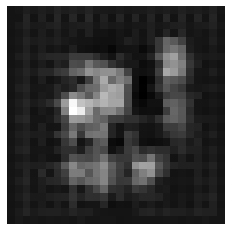

discriminator loss : 0.42173629999160767
Generator loss : [0.69966334, 0.0]
(1, 28, 28, 1)
(28, 28)


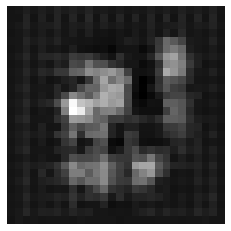

discriminator loss : 0.5830578804016113
Generator loss : [1.15693, 0.0]
(1, 28, 28, 1)
(28, 28)


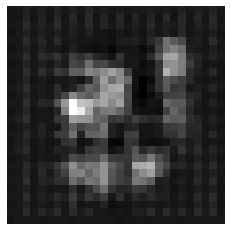

discriminator loss : 0.8685741424560547
Generator loss : [0.515734, 0.0]
(1, 28, 28, 1)
(28, 28)


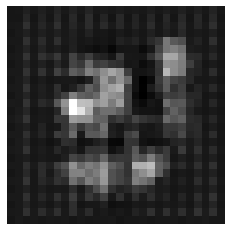

discriminator loss : 0.44589418172836304
Generator loss : [0.3380934, 0.0]
(1, 28, 28, 1)
(28, 28)


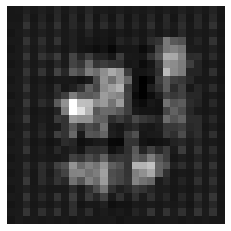

discriminator loss : 0.34720277786254883
Generator loss : [0.37608188, 0.0]
(1, 28, 28, 1)
(28, 28)


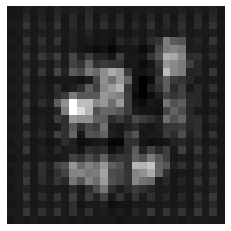

discriminator loss : 0.3678892254829407
Generator loss : [0.38018134, 0.0]
(1, 28, 28, 1)
(28, 28)


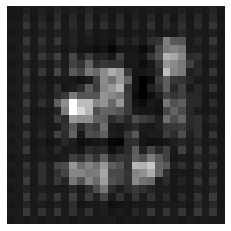

discriminator loss : 0.34941381216049194
Generator loss : [0.341136, 0.0]
(1, 28, 28, 1)
(28, 28)


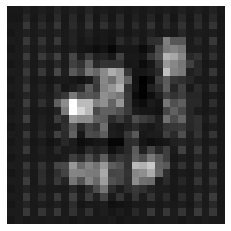

discriminator loss : 0.33404862880706787
Generator loss : [0.32293662, 0.0]
(1, 28, 28, 1)
(28, 28)


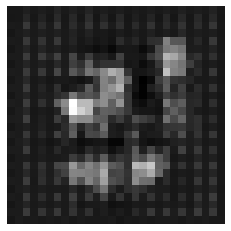

discriminator loss : 0.34304773807525635
Generator loss : [0.34473354, 0.0]
(1, 28, 28, 1)
(28, 28)


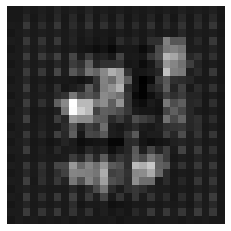

discriminator loss : 0.32916468381881714
Generator loss : [0.32350823, 0.0]
(1, 28, 28, 1)
(28, 28)


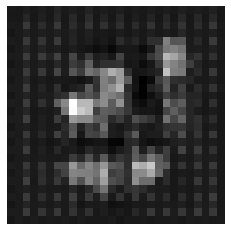

discriminator loss : 0.33914732933044434
Generator loss : [0.3340709, 0.0]
(1, 28, 28, 1)
(28, 28)


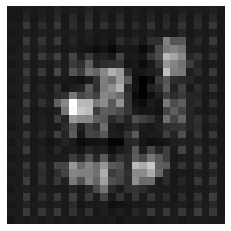

discriminator loss : 0.3339035212993622
Generator loss : [0.32082984, 0.0]
(1, 28, 28, 1)
(28, 28)


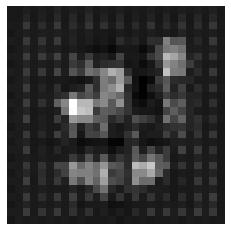

discriminator loss : 0.3398358225822449
Generator loss : [0.34257102, 0.0]
(1, 28, 28, 1)
(28, 28)


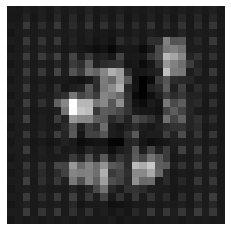

discriminator loss : 0.32852640748023987
Generator loss : [0.31210494, 0.0]
(1, 28, 28, 1)
(28, 28)


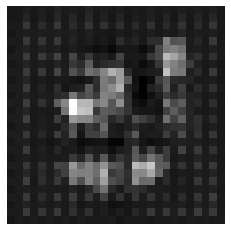

discriminator loss : 0.31802815198898315
Generator loss : [0.3022047, 0.0]
(1, 28, 28, 1)
(28, 28)


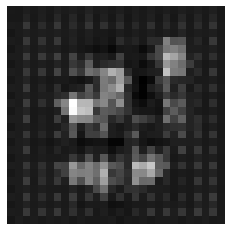

discriminator loss : 0.3424713909626007
Generator loss : [0.34799382, 0.0]
(1, 28, 28, 1)
(28, 28)


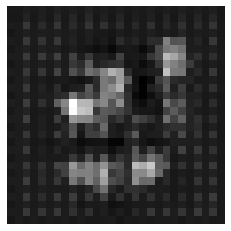

discriminator loss : 0.3162478804588318
Generator loss : [0.30627042, 0.0]
(1, 28, 28, 1)
(28, 28)


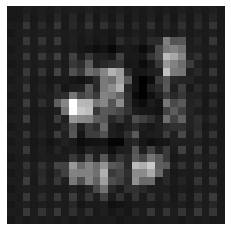

discriminator loss : 0.33073529601097107
Generator loss : [0.33186105, 0.0]
(1, 28, 28, 1)
(28, 28)


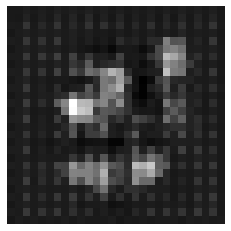

discriminator loss : 0.3219294548034668
Generator loss : [0.32167637, 0.0]
(1, 28, 28, 1)
(28, 28)


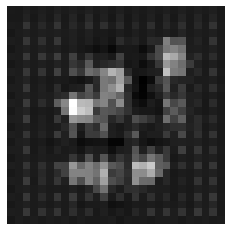

discriminator loss : 0.32865041494369507
Generator loss : [0.32651356, 0.0]
(1, 28, 28, 1)
(28, 28)


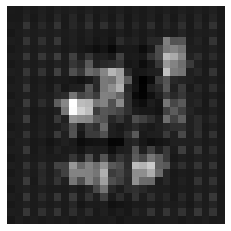

discriminator loss : 0.3299889862537384
Generator loss : [0.34465924, 0.0]
(1, 28, 28, 1)
(28, 28)


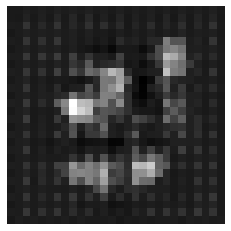

discriminator loss : 0.3377613425254822
Generator loss : [0.3326668, 0.0]
(1, 28, 28, 1)
(28, 28)


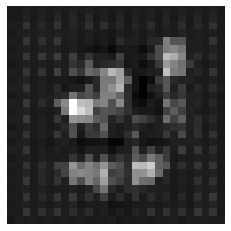

discriminator loss : 0.333431214094162
Generator loss : [0.32262078, 0.0]
(1, 28, 28, 1)
(28, 28)


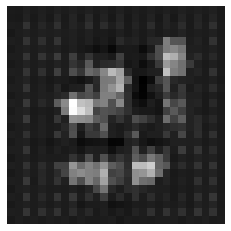

discriminator loss : 0.3361547589302063
Generator loss : [0.34912425, 0.0]
(1, 28, 28, 1)
(28, 28)


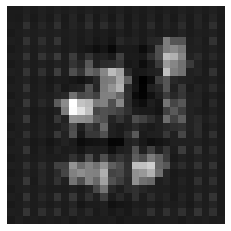

discriminator loss : 0.3303040862083435
Generator loss : [0.36038095, 0.0]
(1, 28, 28, 1)
(28, 28)


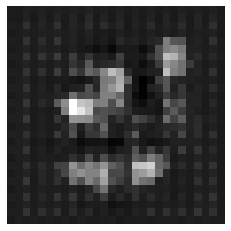

discriminator loss : 0.33267003297805786
Generator loss : [0.36172456, 0.0]
(1, 28, 28, 1)
(28, 28)


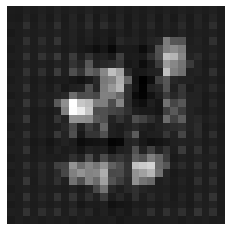

discriminator loss : 0.34366288781166077
Generator loss : [0.3754704, 0.0]
(1, 28, 28, 1)
(28, 28)


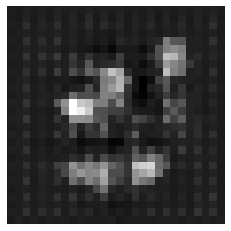

discriminator loss : 0.35440438985824585
Generator loss : [0.36461097, 0.0]
(1, 28, 28, 1)
(28, 28)


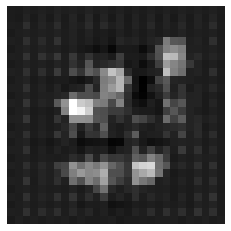

discriminator loss : 0.3451186418533325
Generator loss : [0.38612404, 0.0]
(1, 28, 28, 1)
(28, 28)


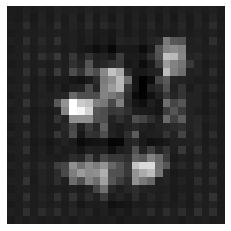

discriminator loss : 0.330124169588089
Generator loss : [0.40046898, 0.0]
(1, 28, 28, 1)
(28, 28)


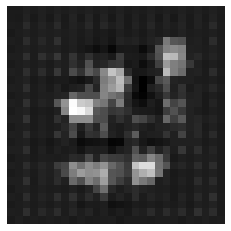

discriminator loss : 0.33640992641448975
Generator loss : [0.38541377, 0.0]
(1, 28, 28, 1)
(28, 28)


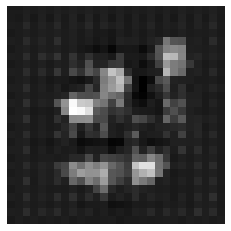

discriminator loss : 0.3382737636566162
Generator loss : [0.4094693, 0.0]
(1, 28, 28, 1)
(28, 28)


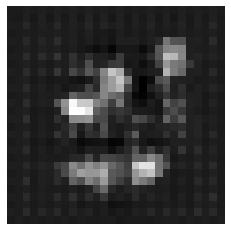

discriminator loss : 0.34017425775527954
Generator loss : [0.4148877, 0.0]
(1, 28, 28, 1)
(28, 28)


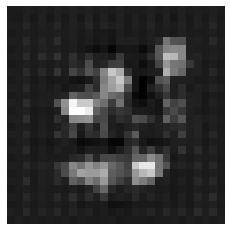

discriminator loss : 0.35155799984931946
Generator loss : [0.38880578, 0.0]
(1, 28, 28, 1)
(28, 28)


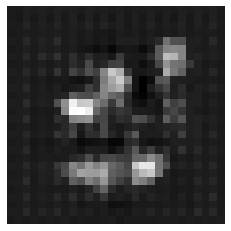

discriminator loss : 0.34413671493530273
Generator loss : [0.41865844, 0.0]
(1, 28, 28, 1)
(28, 28)


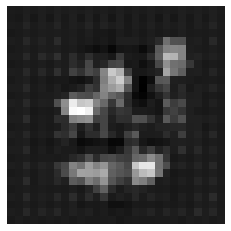

discriminator loss : 0.3483198881149292
Generator loss : [0.39270753, 0.0]
(1, 28, 28, 1)
(28, 28)


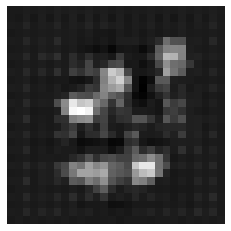

discriminator loss : 0.3484194874763489
Generator loss : [0.37738866, 0.0]
(1, 28, 28, 1)
(28, 28)


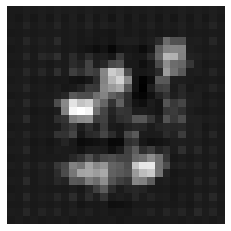

discriminator loss : 0.3461377024650574
Generator loss : [0.3644551, 0.0]
(1, 28, 28, 1)
(28, 28)


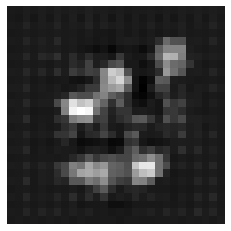

discriminator loss : 0.36765551567077637
Generator loss : [0.3655238, 0.0]
(1, 28, 28, 1)
(28, 28)


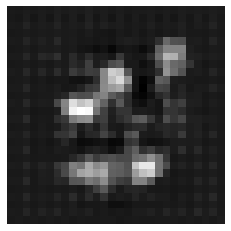

discriminator loss : 0.33582788705825806
Generator loss : [0.34638736, 0.0]
(1, 28, 28, 1)
(28, 28)


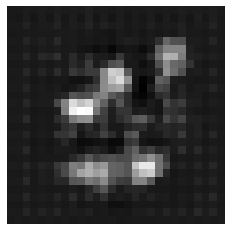

discriminator loss : 0.3405333161354065
Generator loss : [0.33554387, 0.0]
(1, 28, 28, 1)
(28, 28)


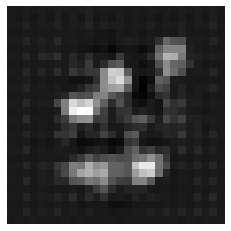

discriminator loss : 0.3525059223175049
Generator loss : [0.3353126, 0.0]
(1, 28, 28, 1)
(28, 28)


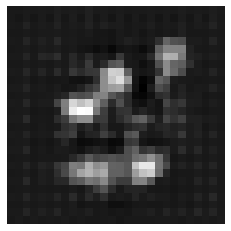

discriminator loss : 0.3411695063114166
Generator loss : [0.3259438, 0.0]
(1, 28, 28, 1)
(28, 28)


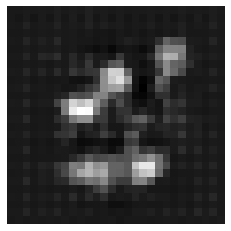

discriminator loss : 0.3534662425518036
Generator loss : [0.3400691, 0.0]
(1, 28, 28, 1)
(28, 28)


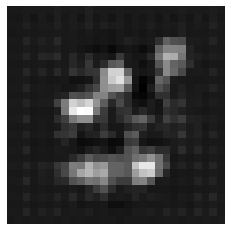

discriminator loss : 0.3509593904018402
Generator loss : [0.3285838, 0.0]
(1, 28, 28, 1)
(28, 28)


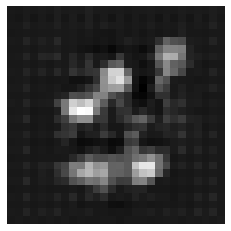

discriminator loss : 0.36444008350372314
Generator loss : [0.3381447, 0.0]
(1, 28, 28, 1)
(28, 28)


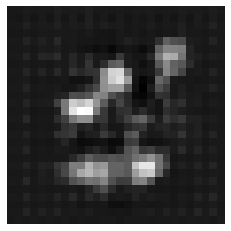

discriminator loss : 0.34515249729156494
Generator loss : [0.3397474, 0.0]
(1, 28, 28, 1)
(28, 28)


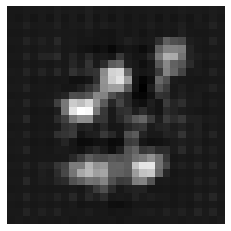

discriminator loss : 0.3290855884552002
Generator loss : [0.29991823, 0.0]
(1, 28, 28, 1)
(28, 28)


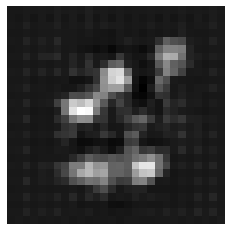

discriminator loss : 0.3348570466041565
Generator loss : [0.31106535, 0.0]
(1, 28, 28, 1)
(28, 28)


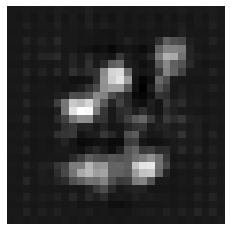

discriminator loss : 0.3470914959907532
Generator loss : [0.3280272, 0.0]
(1, 28, 28, 1)
(28, 28)


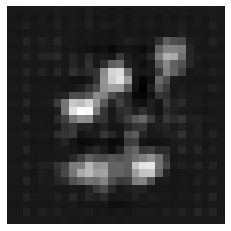

discriminator loss : 0.3567056953907013
Generator loss : [0.34465453, 0.0]
(1, 28, 28, 1)
(28, 28)


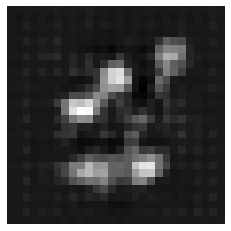

discriminator loss : 0.33871984481811523
Generator loss : [0.32420427, 0.0]
(1, 28, 28, 1)
(28, 28)


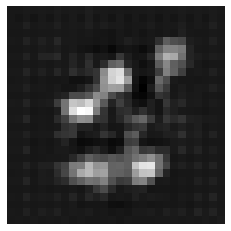

discriminator loss : 0.3395006060600281
Generator loss : [0.36744815, 0.0]
(1, 28, 28, 1)
(28, 28)


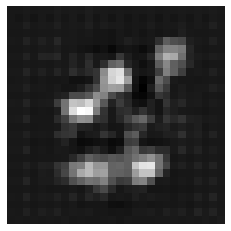

discriminator loss : 0.42294421792030334
Generator loss : [0.55768466, 0.0]
(1, 28, 28, 1)
(28, 28)


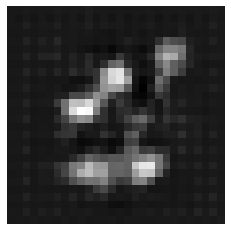

discriminator loss : 0.8930768966674805
Generator loss : [2.5260618, 0.0]
(1, 28, 28, 1)
(28, 28)


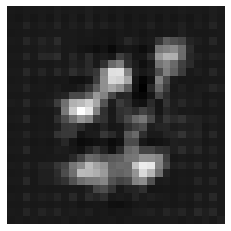

discriminator loss : 2.4564244747161865
Generator loss : [0.41178894, 0.0]
(1, 28, 28, 1)
(28, 28)


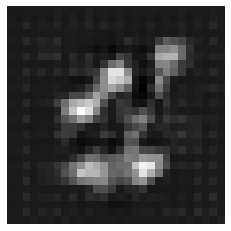

discriminator loss : 0.4185323417186737
Generator loss : [0.9647843, 0.0]
(1, 28, 28, 1)
(28, 28)


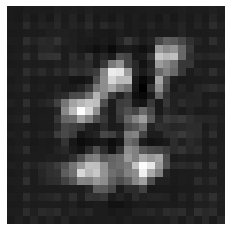

discriminator loss : 0.400543749332428
Generator loss : [1.123426, 0.0]
(1, 28, 28, 1)
(28, 28)


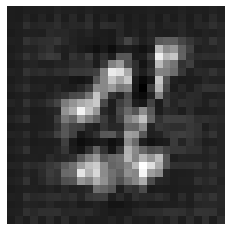

discriminator loss : 0.49723154306411743
Generator loss : [0.91196847, 0.0]
(1, 28, 28, 1)
(28, 28)


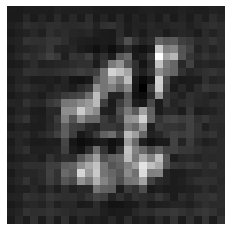

discriminator loss : 0.5955124497413635
Generator loss : [0.7800355, 0.0]
(1, 28, 28, 1)
(28, 28)


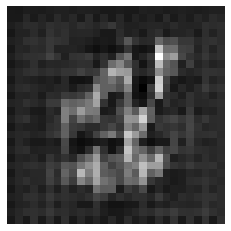

discriminator loss : 0.6032603979110718
Generator loss : [0.7769803, 0.0]
(1, 28, 28, 1)
(28, 28)


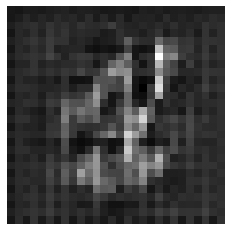

discriminator loss : 0.5092999339103699
Generator loss : [0.78022796, 0.0]
(1, 28, 28, 1)
(28, 28)


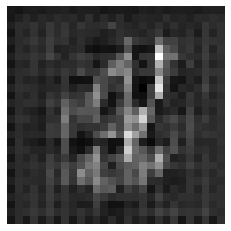

discriminator loss : 0.5073938369750977
Generator loss : [0.6422018, 0.0]
(1, 28, 28, 1)
(28, 28)


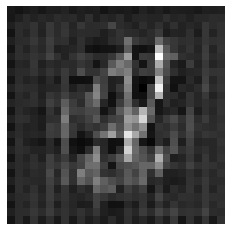

discriminator loss : 0.4610254168510437
Generator loss : [0.5310741, 0.0]
(1, 28, 28, 1)
(28, 28)


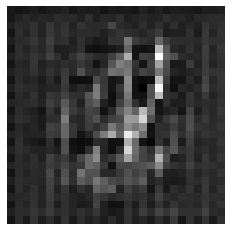

discriminator loss : 0.4142133593559265
Generator loss : [0.48588273, 0.0]
(1, 28, 28, 1)
(28, 28)


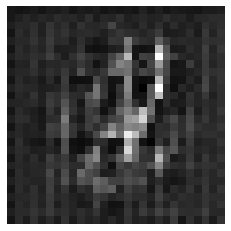

discriminator loss : 0.39475584030151367
Generator loss : [0.4460201, 0.0]
(1, 28, 28, 1)
(28, 28)


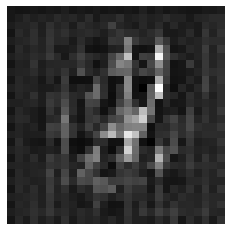

discriminator loss : 0.42617473006248474
Generator loss : [0.4352868, 0.0]
(1, 28, 28, 1)
(28, 28)


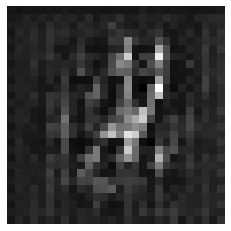

discriminator loss : 0.45022037625312805
Generator loss : [0.4782254, 0.0]
(1, 28, 28, 1)
(28, 28)


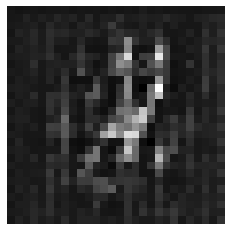

discriminator loss : 0.5299625396728516
Generator loss : [0.6607973, 0.0]
(1, 28, 28, 1)
(28, 28)


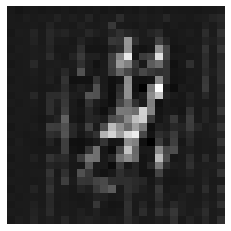

discriminator loss : 0.8425809741020203
Generator loss : [0.98358214, 0.0]
(1, 28, 28, 1)
(28, 28)


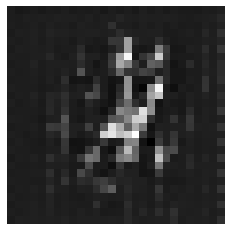

discriminator loss : 1.091477394104004
Generator loss : [0.69094676, 0.0]
(1, 28, 28, 1)
(28, 28)


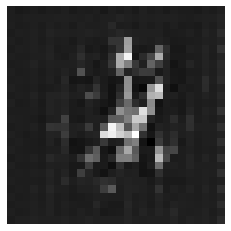

discriminator loss : 0.616085946559906
Generator loss : [0.923608, 0.0]
(1, 28, 28, 1)
(28, 28)


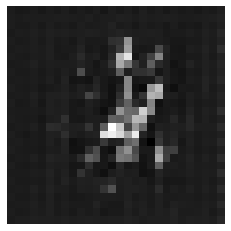

discriminator loss : 0.532018780708313
Generator loss : [0.9744173, 0.0]
(1, 28, 28, 1)
(28, 28)


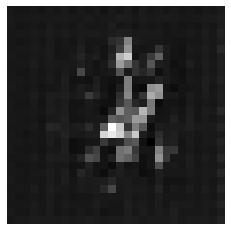

discriminator loss : 0.4495251178741455
Generator loss : [0.974165, 0.0]
(1, 28, 28, 1)
(28, 28)


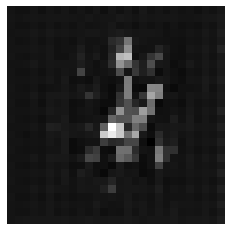

discriminator loss : 0.44047585129737854
Generator loss : [0.941925, 0.0]
(1, 28, 28, 1)
(28, 28)


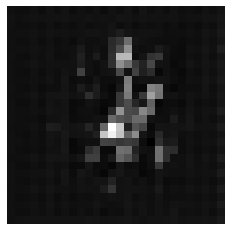

discriminator loss : 0.48759639263153076
Generator loss : [0.84586906, 0.0]
(1, 28, 28, 1)
(28, 28)


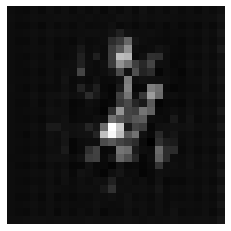

discriminator loss : 0.49132534861564636
Generator loss : [0.82499987, 0.0]
(1, 28, 28, 1)
(28, 28)


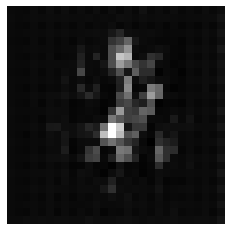

discriminator loss : 0.6406948566436768
Generator loss : [0.84115195, 0.0]
(1, 28, 28, 1)
(28, 28)


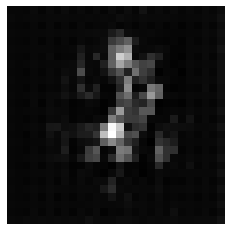

discriminator loss : 0.5822842121124268
Generator loss : [0.9741026, 0.0]
(1, 28, 28, 1)
(28, 28)


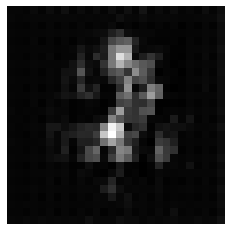

discriminator loss : 0.523775577545166
Generator loss : [0.97984064, 0.0]
(1, 28, 28, 1)
(28, 28)


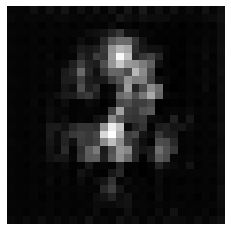

discriminator loss : 0.7438973188400269
Generator loss : [2.7443662, 0.0]
(1, 28, 28, 1)
(28, 28)


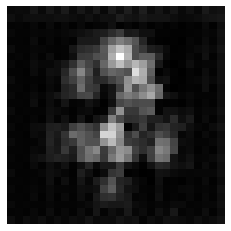

discriminator loss : 1.0761692523956299
Generator loss : [6.5532713, 0.0]
(1, 28, 28, 1)
(28, 28)


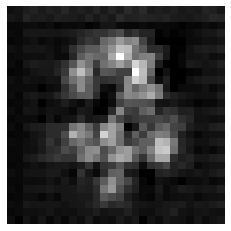

discriminator loss : 1.1751679182052612
Generator loss : [2.567851, 0.0]
(1, 28, 28, 1)
(28, 28)


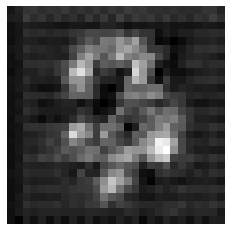

discriminator loss : 0.984771728515625
Generator loss : [3.795405, 0.0]
(1, 28, 28, 1)
(28, 28)


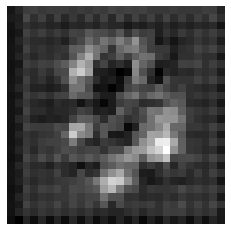

discriminator loss : 0.9180405139923096
Generator loss : [0.31835824, 0.0]
(1, 28, 28, 1)
(28, 28)


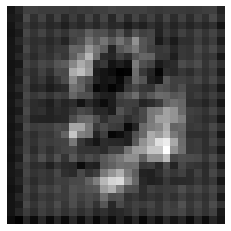

discriminator loss : 0.4692102074623108
Generator loss : [0.39538392, 0.0]
(1, 28, 28, 1)
(28, 28)


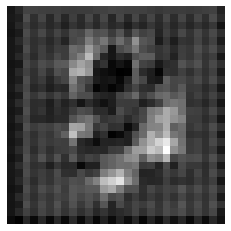

discriminator loss : 0.33799177408218384
Generator loss : [0.41123798, 0.0]
(1, 28, 28, 1)
(28, 28)


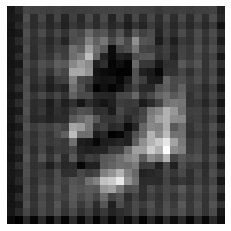

discriminator loss : 0.3466361165046692
Generator loss : [0.46319634, 0.0]
(1, 28, 28, 1)
(28, 28)


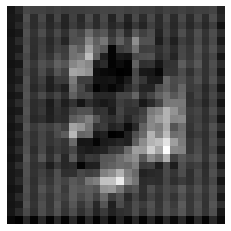

discriminator loss : 0.35841113328933716
Generator loss : [0.44695485, 0.0]
(1, 28, 28, 1)
(28, 28)


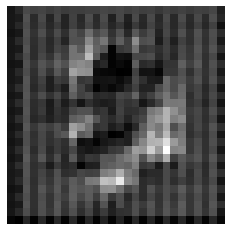

discriminator loss : 0.3635389804840088
Generator loss : [0.4279395, 0.0]
(1, 28, 28, 1)
(28, 28)


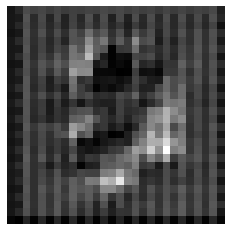

discriminator loss : 0.33946287631988525
Generator loss : [0.34495848, 0.0]
(1, 28, 28, 1)
(28, 28)


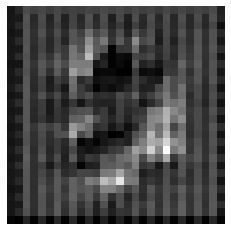

discriminator loss : 0.34817981719970703
Generator loss : [0.36665192, 0.0]
(1, 28, 28, 1)
(28, 28)


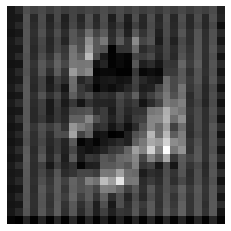

discriminator loss : 0.3282739520072937
Generator loss : [0.32466674, 0.0]
(1, 28, 28, 1)
(28, 28)


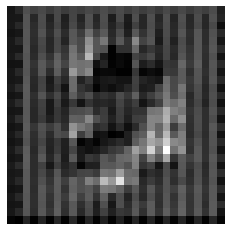

discriminator loss : 0.32506829500198364
Generator loss : [0.33138987, 0.0]
(1, 28, 28, 1)
(28, 28)


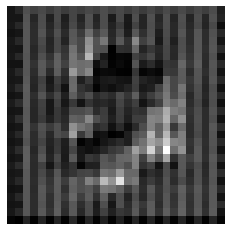

discriminator loss : 0.33856630325317383
Generator loss : [0.3241645, 0.0]
(1, 28, 28, 1)
(28, 28)


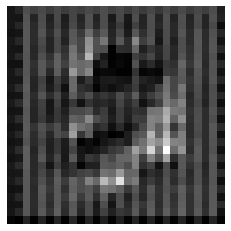

discriminator loss : 0.3397940993309021
Generator loss : [0.33540666, 0.0]
(1, 28, 28, 1)
(28, 28)


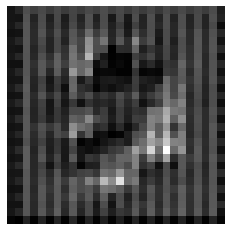

discriminator loss : 0.3329409956932068
Generator loss : [0.33522987, 0.0]
(1, 28, 28, 1)
(28, 28)


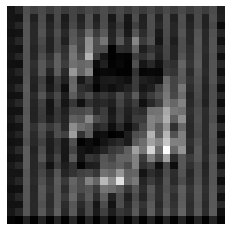

discriminator loss : 0.33544600009918213
Generator loss : [0.3288007, 0.0]
(1, 28, 28, 1)
(28, 28)


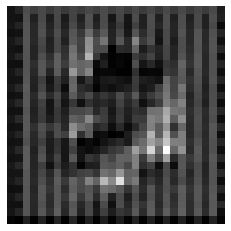

discriminator loss : 0.3232332468032837
Generator loss : [0.3163304, 0.0]
(1, 28, 28, 1)
(28, 28)


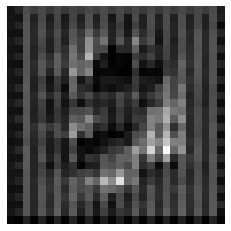

discriminator loss : 0.3155525326728821
Generator loss : [0.3062151, 0.0]
(1, 28, 28, 1)
(28, 28)


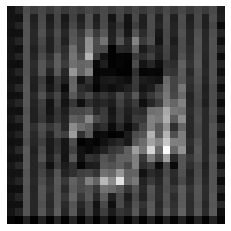

discriminator loss : 0.3218271732330322
Generator loss : [0.32353133, 0.0]
(1, 28, 28, 1)
(28, 28)


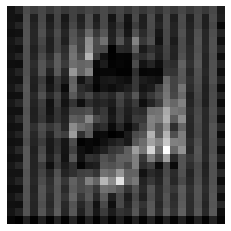

discriminator loss : 0.3218213617801666
Generator loss : [0.31663448, 0.0]
(1, 28, 28, 1)
(28, 28)


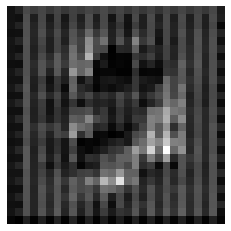

discriminator loss : 0.3220738172531128
Generator loss : [0.31765917, 0.0]
(1, 28, 28, 1)
(28, 28)


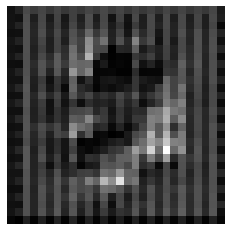

discriminator loss : 0.3267514109611511
Generator loss : [0.32291234, 0.0]
(1, 28, 28, 1)
(28, 28)


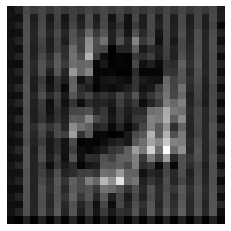

discriminator loss : 0.3272593021392822
Generator loss : [0.32935786, 0.0]
(1, 28, 28, 1)
(28, 28)


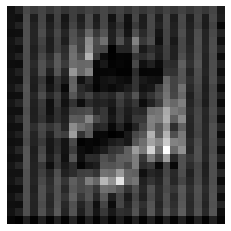

discriminator loss : 0.33271706104278564
Generator loss : [0.3132984, 0.0]
(1, 28, 28, 1)
(28, 28)


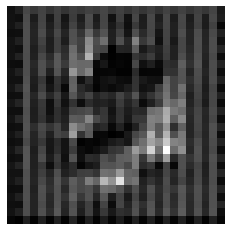

discriminator loss : 0.3321966528892517
Generator loss : [0.33361873, 0.0]
(1, 28, 28, 1)
(28, 28)


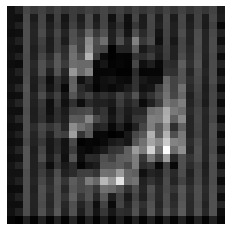

discriminator loss : 0.3347238302230835
Generator loss : [0.33560634, 0.0]
(1, 28, 28, 1)
(28, 28)


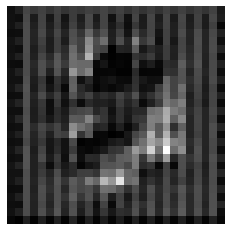

discriminator loss : 0.34427201747894287
Generator loss : [0.34812033, 0.0]
(1, 28, 28, 1)
(28, 28)


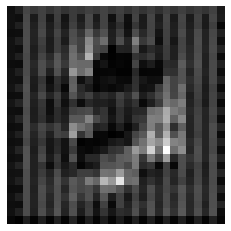

discriminator loss : 0.33719342947006226
Generator loss : [0.32908458, 0.0]
(1, 28, 28, 1)
(28, 28)


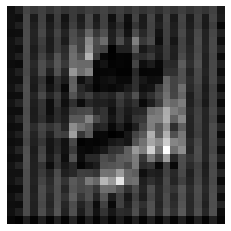

discriminator loss : 0.3232482373714447
Generator loss : [0.31171727, 0.0]
(1, 28, 28, 1)
(28, 28)


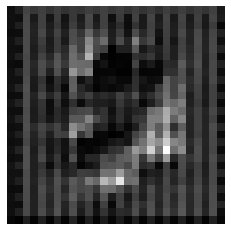

discriminator loss : 0.3305429220199585
Generator loss : [0.31202227, 0.0]
(1, 28, 28, 1)
(28, 28)


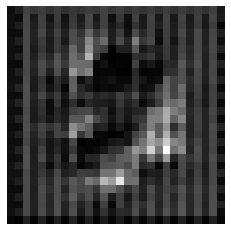

discriminator loss : 0.33048418164253235
Generator loss : [0.32724136, 0.0]
(1, 28, 28, 1)
(28, 28)


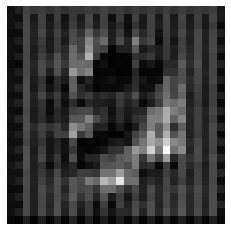

discriminator loss : 0.3310158848762512
Generator loss : [0.30908233, 0.0]
(1, 28, 28, 1)
(28, 28)


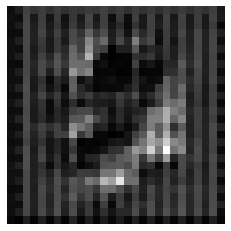

discriminator loss : 0.3213168978691101
Generator loss : [0.30483943, 0.0]
(1, 28, 28, 1)
(28, 28)


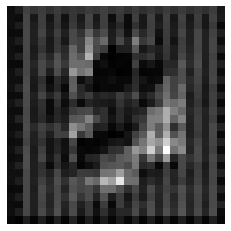

discriminator loss : 0.320249080657959
Generator loss : [0.31323045, 0.0]
(1, 28, 28, 1)
(28, 28)


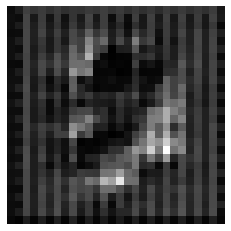

discriminator loss : 0.33658748865127563
Generator loss : [0.32066524, 0.0]
(1, 28, 28, 1)
(28, 28)


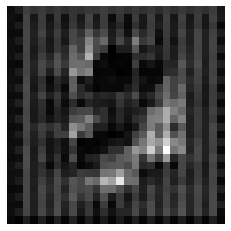

discriminator loss : 0.34261035919189453
Generator loss : [0.3340351, 0.0]
(1, 28, 28, 1)
(28, 28)


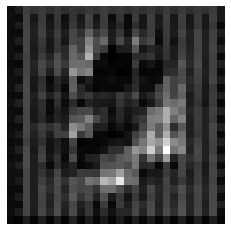

discriminator loss : 0.33190828561782837
Generator loss : [0.32519776, 0.0]
(1, 28, 28, 1)
(28, 28)


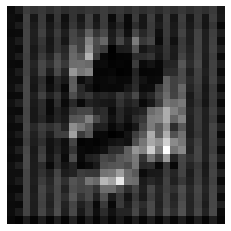

discriminator loss : 0.3359242081642151
Generator loss : [0.32079327, 0.0]
(1, 28, 28, 1)
(28, 28)


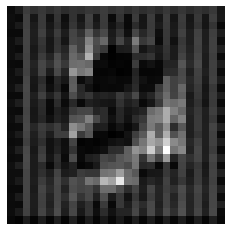

discriminator loss : 0.3383710980415344
Generator loss : [0.33457878, 0.0]
(1, 28, 28, 1)
(28, 28)


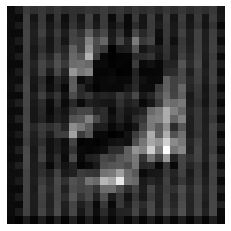

discriminator loss : 0.3206128478050232
Generator loss : [0.31106454, 0.0]
(1, 28, 28, 1)
(28, 28)


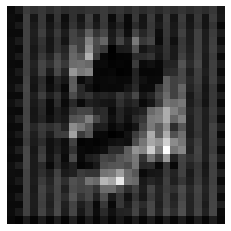

discriminator loss : 0.3229331970214844
Generator loss : [0.3271341, 0.0]
(1, 28, 28, 1)
(28, 28)


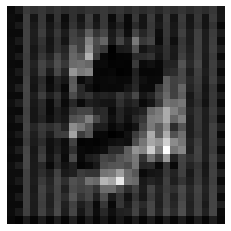

discriminator loss : 0.33733922243118286
Generator loss : [0.34890044, 0.0]
(1, 28, 28, 1)
(28, 28)


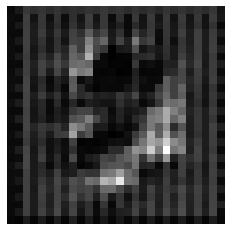

discriminator loss : 0.32504889369010925
Generator loss : [0.32446966, 0.0]
(1, 28, 28, 1)
(28, 28)


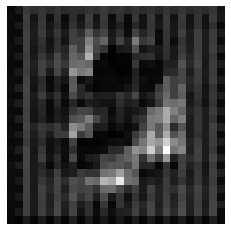

discriminator loss : 0.3253927230834961
Generator loss : [0.31249702, 0.0]
(1, 28, 28, 1)
(28, 28)


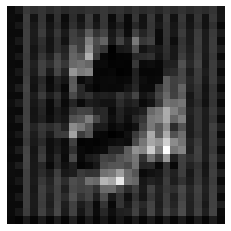

discriminator loss : 0.32503724098205566
Generator loss : [0.32615197, 0.0]
(1, 28, 28, 1)
(28, 28)


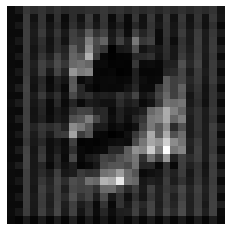

discriminator loss : 0.3187347650527954
Generator loss : [0.305504, 0.0]
(1, 28, 28, 1)
(28, 28)


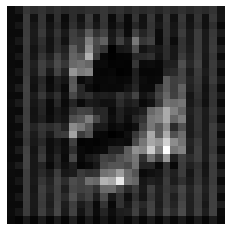

discriminator loss : 0.3405071794986725
Generator loss : [0.32889122, 0.0]
(1, 28, 28, 1)
(28, 28)


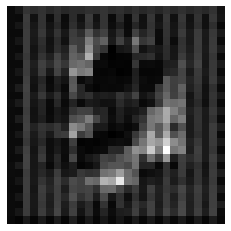

discriminator loss : 0.3201320767402649
Generator loss : [0.3239455, 0.0]
(1, 28, 28, 1)
(28, 28)


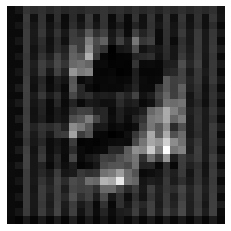

discriminator loss : 0.3220778703689575
Generator loss : [0.31817406, 0.0]
(1, 28, 28, 1)
(28, 28)


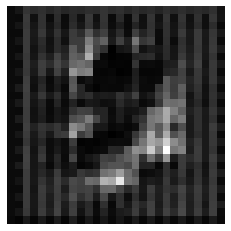

discriminator loss : 0.3220066428184509
Generator loss : [0.32989806, 0.0]
(1, 28, 28, 1)
(28, 28)


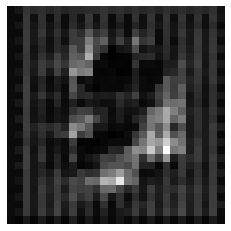

discriminator loss : 0.3376663327217102
Generator loss : [0.3289487, 0.0]
(1, 28, 28, 1)
(28, 28)


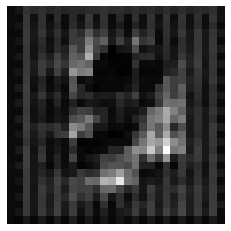

discriminator loss : 0.33200764656066895
Generator loss : [0.32558846, 0.0]
(1, 28, 28, 1)
(28, 28)


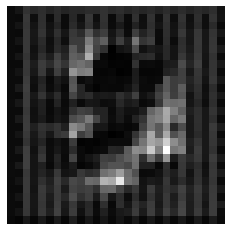

discriminator loss : 0.3373818099498749
Generator loss : [0.33354598, 0.0]
(1, 28, 28, 1)
(28, 28)


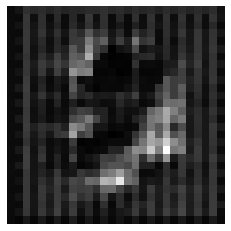

discriminator loss : 0.33362889289855957
Generator loss : [0.3414698, 0.0]
(1, 28, 28, 1)
(28, 28)


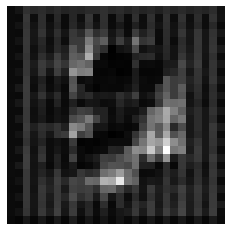

discriminator loss : 0.3308769762516022
Generator loss : [0.33192116, 0.0]
(1, 28, 28, 1)
(28, 28)


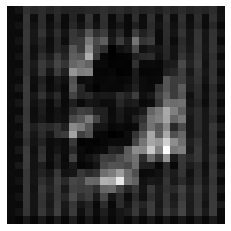

discriminator loss : 0.3363099992275238
Generator loss : [0.3330728, 0.0]
(1, 28, 28, 1)
(28, 28)


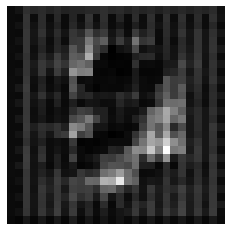

discriminator loss : 0.3343394100666046
Generator loss : [0.35451794, 0.0]
(1, 28, 28, 1)
(28, 28)


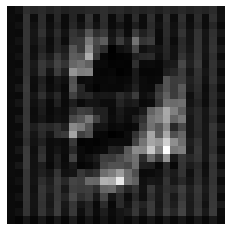

discriminator loss : 0.33134448528289795
Generator loss : [0.32590216, 0.0]
(1, 28, 28, 1)
(28, 28)


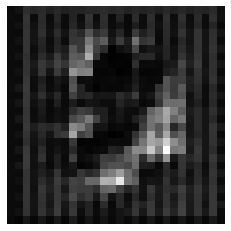

discriminator loss : 0.3255629539489746
Generator loss : [0.31560346, 0.0]
(1, 28, 28, 1)
(28, 28)


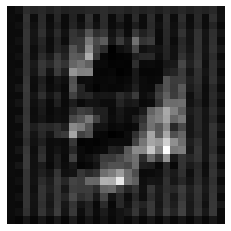

discriminator loss : 0.3461330831050873
Generator loss : [0.34086025, 0.0]
(1, 28, 28, 1)
(28, 28)


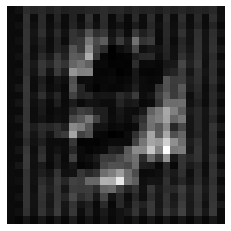

discriminator loss : 0.331682413816452
Generator loss : [0.3226177, 0.0]
(1, 28, 28, 1)
(28, 28)


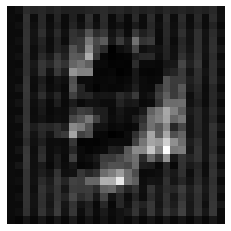

discriminator loss : 0.34354376792907715
Generator loss : [0.34584397, 0.0]
(1, 28, 28, 1)
(28, 28)


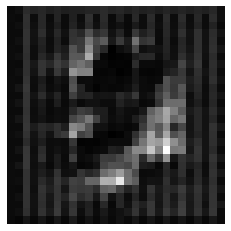

discriminator loss : 0.3193560838699341
Generator loss : [0.32295123, 0.0]
(1, 28, 28, 1)
(28, 28)


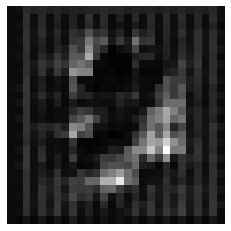

discriminator loss : 0.3219773471355438
Generator loss : [0.31580484, 0.0]
(1, 28, 28, 1)
(28, 28)


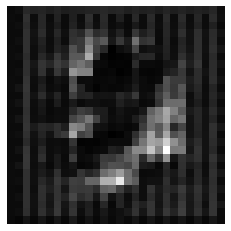

discriminator loss : 0.32121434807777405
Generator loss : [0.32861623, 0.0]
(1, 28, 28, 1)
(28, 28)


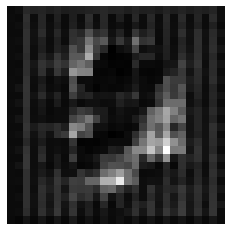

discriminator loss : 0.313175767660141
Generator loss : [0.3098655, 0.0]
(1, 28, 28, 1)
(28, 28)


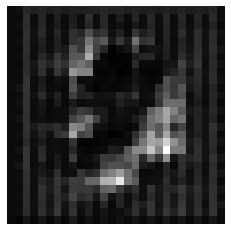

discriminator loss : 0.31881383061408997
Generator loss : [0.31012377, 0.0]
(1, 28, 28, 1)
(28, 28)


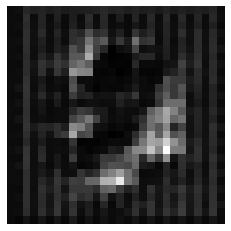

discriminator loss : 0.3393840193748474
Generator loss : [0.32862598, 0.0]
(1, 28, 28, 1)
(28, 28)


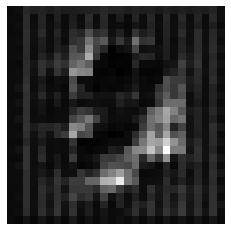

discriminator loss : 0.3319230079650879
Generator loss : [0.32132587, 0.0]
(1, 28, 28, 1)
(28, 28)


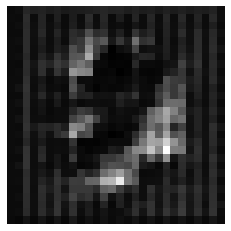

discriminator loss : 0.32393866777420044
Generator loss : [0.3116955, 0.0]
(1, 28, 28, 1)
(28, 28)


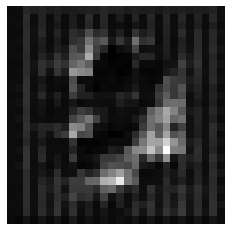

discriminator loss : 0.3344206213951111
Generator loss : [0.33371994, 0.0]
(1, 28, 28, 1)
(28, 28)


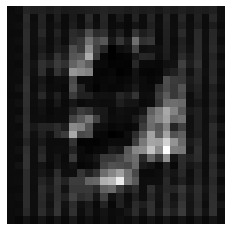

discriminator loss : 0.3349560499191284
Generator loss : [0.32731378, 0.0]
(1, 28, 28, 1)
(28, 28)


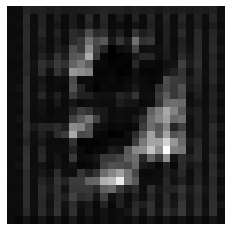

discriminator loss : 0.3301435112953186
Generator loss : [0.3355466, 0.0]
(1, 28, 28, 1)
(28, 28)


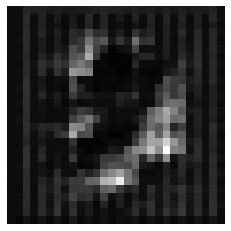

discriminator loss : 0.3211589455604553
Generator loss : [0.31998816, 0.0]
(1, 28, 28, 1)
(28, 28)


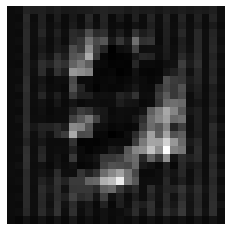

discriminator loss : 0.30357760190963745
Generator loss : [0.30330023, 0.0]
(1, 28, 28, 1)
(28, 28)


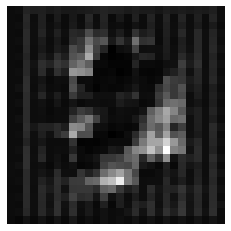

discriminator loss : 0.3201969861984253
Generator loss : [0.3113581, 0.0]
(1, 28, 28, 1)
(28, 28)


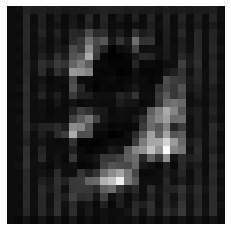

discriminator loss : 0.32721254229545593
Generator loss : [0.33408183, 0.0]
(1, 28, 28, 1)
(28, 28)


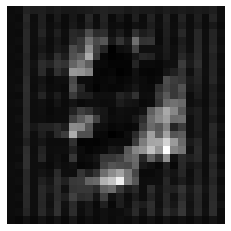

discriminator loss : 0.3264928460121155
Generator loss : [0.30687252, 0.0]
(1, 28, 28, 1)
(28, 28)


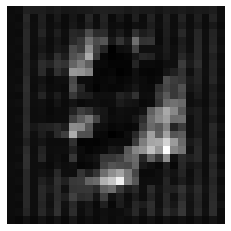

discriminator loss : 0.3161006569862366
Generator loss : [0.30425277, 0.0]
(1, 28, 28, 1)
(28, 28)


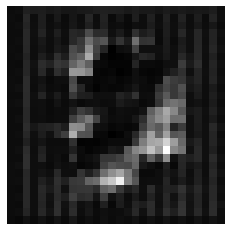

discriminator loss : 0.3076484501361847
Generator loss : [0.2856447, 0.0]
(1, 28, 28, 1)
(28, 28)


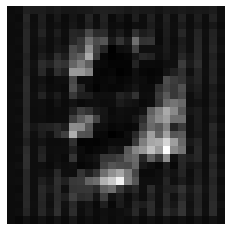

discriminator loss : 0.339874804019928
Generator loss : [0.34429765, 0.0]
(1, 28, 28, 1)
(28, 28)


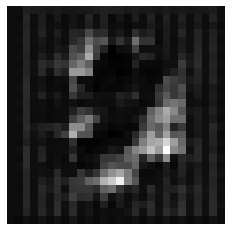

discriminator loss : 0.3407359719276428
Generator loss : [0.33343858, 0.0]
(1, 28, 28, 1)
(28, 28)


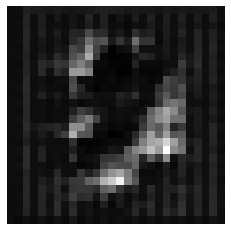

discriminator loss : 0.33082443475723267
Generator loss : [0.31739008, 0.0]
(1, 28, 28, 1)
(28, 28)


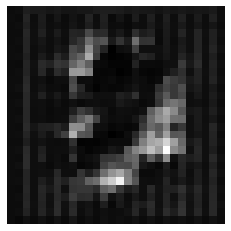

discriminator loss : 0.323388934135437
Generator loss : [0.31489348, 0.0]
(1, 28, 28, 1)
(28, 28)


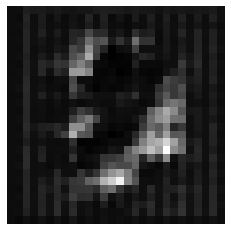

discriminator loss : 0.3291003406047821
Generator loss : [0.3280246, 0.0]
(1, 28, 28, 1)
(28, 28)


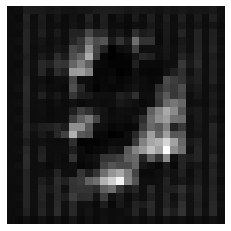

discriminator loss : 0.3306063711643219
Generator loss : [0.3435767, 0.0]
(1, 28, 28, 1)
(28, 28)


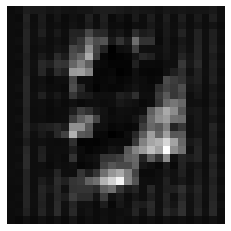

discriminator loss : 0.31643521785736084
Generator loss : [0.31689858, 0.0]
(1, 28, 28, 1)
(28, 28)


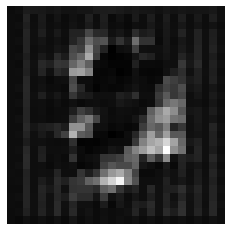

discriminator loss : 0.33310452103614807
Generator loss : [0.3304567, 0.0]
(1, 28, 28, 1)
(28, 28)


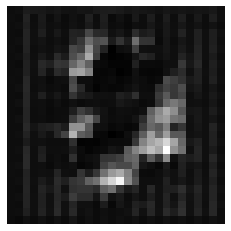

discriminator loss : 0.3257017135620117
Generator loss : [0.3259291, 0.0]
(1, 28, 28, 1)
(28, 28)


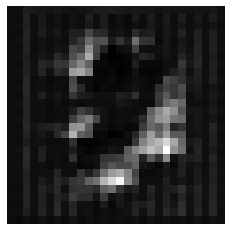

discriminator loss : 0.32780617475509644
Generator loss : [0.31594315, 0.0]
(1, 28, 28, 1)
(28, 28)


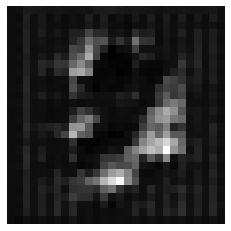

discriminator loss : 0.3230488896369934
Generator loss : [0.29591557, 0.0]
(1, 28, 28, 1)
(28, 28)


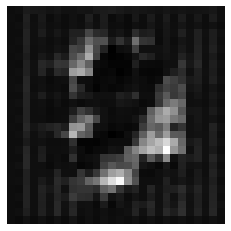

discriminator loss : 0.3464127779006958
Generator loss : [0.34889933, 0.0]
(1, 28, 28, 1)
(28, 28)


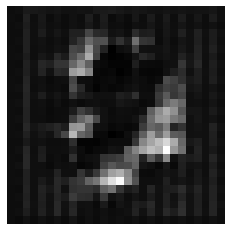

discriminator loss : 0.337624192237854
Generator loss : [0.33722773, 0.0]
(1, 28, 28, 1)
(28, 28)


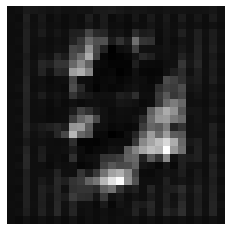

discriminator loss : 0.3382727801799774
Generator loss : [0.33777985, 0.0]
(1, 28, 28, 1)
(28, 28)


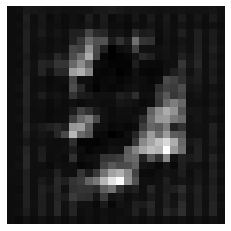

discriminator loss : 0.3181607723236084
Generator loss : [0.30926025, 0.0]
(1, 28, 28, 1)
(28, 28)


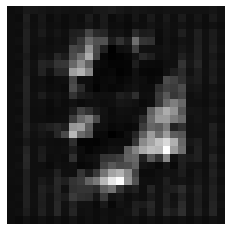

discriminator loss : 0.33026593923568726
Generator loss : [0.32439464, 0.0]
(1, 28, 28, 1)
(28, 28)


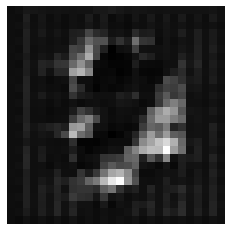

discriminator loss : 0.3172568678855896
Generator loss : [0.30891275, 0.0]
(1, 28, 28, 1)
(28, 28)


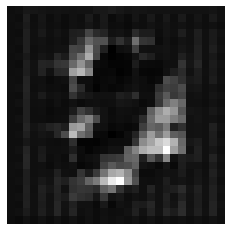

discriminator loss : 0.34241271018981934
Generator loss : [0.32955444, 0.0]
(1, 28, 28, 1)
(28, 28)


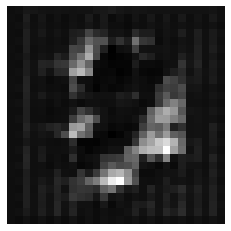

discriminator loss : 0.33592620491981506
Generator loss : [0.31999484, 0.0]
(1, 28, 28, 1)
(28, 28)


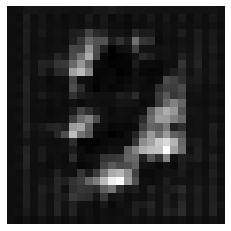

discriminator loss : 0.33793455362319946
Generator loss : [0.32760447, 0.0]
(1, 28, 28, 1)
(28, 28)


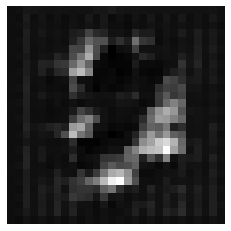

discriminator loss : 0.34102994203567505
Generator loss : [0.3300475, 0.0]
(1, 28, 28, 1)
(28, 28)


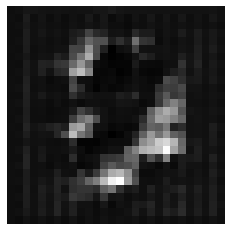

discriminator loss : 0.35949021577835083
Generator loss : [0.34030473, 0.0]
(1, 28, 28, 1)
(28, 28)


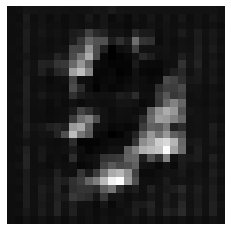

discriminator loss : 0.3294793367385864
Generator loss : [0.31865388, 0.0]
(1, 28, 28, 1)
(28, 28)


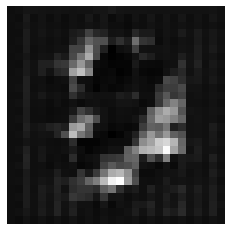

discriminator loss : 0.3353632688522339
Generator loss : [0.32055897, 0.0]
(1, 28, 28, 1)
(28, 28)


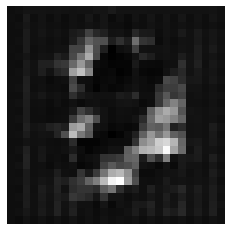

discriminator loss : 0.34079432487487793
Generator loss : [0.336223, 0.0]
(1, 28, 28, 1)
(28, 28)


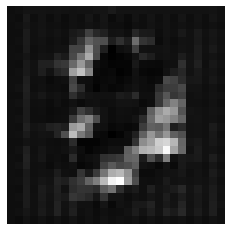

discriminator loss : 0.3524782657623291
Generator loss : [0.34484863, 0.0]
(1, 28, 28, 1)
(28, 28)


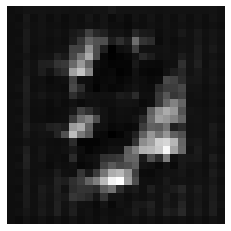

discriminator loss : 0.36355674266815186
Generator loss : [0.3471279, 0.0]
(1, 28, 28, 1)
(28, 28)


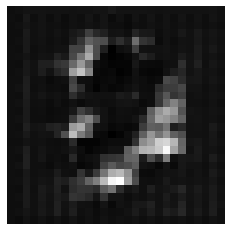

discriminator loss : 0.36063069105148315
Generator loss : [0.33718002, 0.0]
(1, 28, 28, 1)
(28, 28)


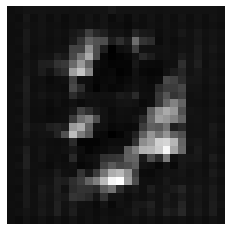

discriminator loss : 0.36008018255233765
Generator loss : [0.3086662, 0.0]
(1, 28, 28, 1)
(28, 28)


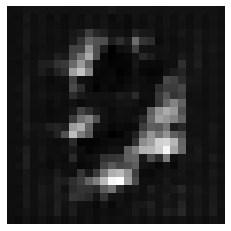

discriminator loss : 0.34526145458221436
Generator loss : [0.33749706, 0.0]
(1, 28, 28, 1)
(28, 28)


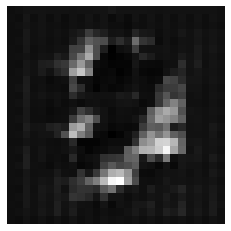

discriminator loss : 0.33103179931640625
Generator loss : [0.33247158, 0.0]
(1, 28, 28, 1)
(28, 28)


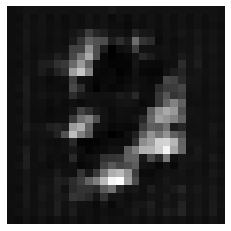

discriminator loss : 0.32542335987091064
Generator loss : [0.29782516, 0.0]
(1, 28, 28, 1)
(28, 28)


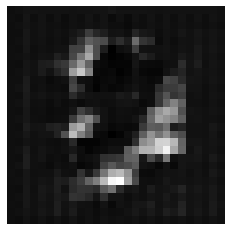

discriminator loss : 0.33615508675575256
Generator loss : [0.3226043, 0.0]
(1, 28, 28, 1)
(28, 28)


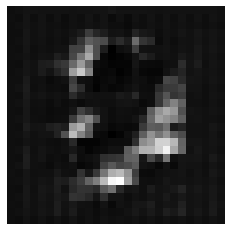

discriminator loss : 0.35362708568573
Generator loss : [0.32215524, 0.0]
(1, 28, 28, 1)
(28, 28)


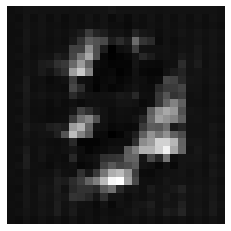

discriminator loss : 0.34895139932632446
Generator loss : [0.33626363, 0.0]
(1, 28, 28, 1)
(28, 28)


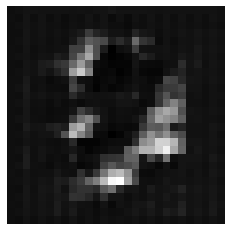

discriminator loss : 0.3338265120983124
Generator loss : [0.31123185, 0.0]
(1, 28, 28, 1)
(28, 28)


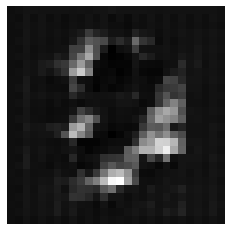

discriminator loss : 0.3562615215778351
Generator loss : [0.34135276, 0.0]
(1, 28, 28, 1)
(28, 28)


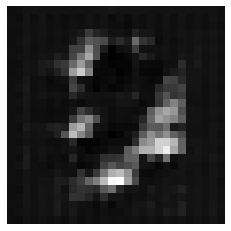

discriminator loss : 0.34641939401626587
Generator loss : [0.3232422, 0.0]
(1, 28, 28, 1)
(28, 28)


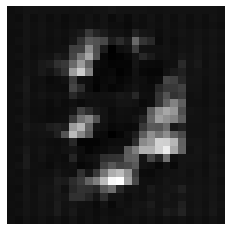

discriminator loss : 0.34413838386535645
Generator loss : [0.34023857, 0.0]
(1, 28, 28, 1)
(28, 28)


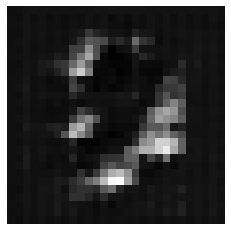

discriminator loss : 0.3530075252056122
Generator loss : [0.3201723, 0.0]
(1, 28, 28, 1)
(28, 28)


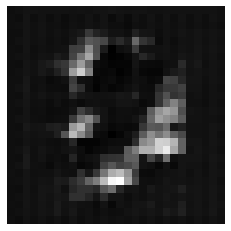

discriminator loss : 0.3522838354110718
Generator loss : [0.33685914, 0.0]
(1, 28, 28, 1)
(28, 28)


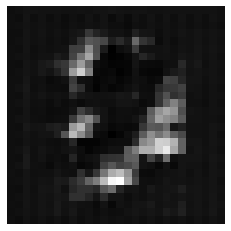

discriminator loss : 0.35695016384124756
Generator loss : [0.34538993, 0.0]
(1, 28, 28, 1)
(28, 28)


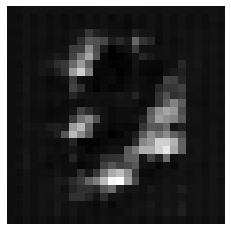

discriminator loss : 0.3601714074611664
Generator loss : [0.33702403, 0.0]
(1, 28, 28, 1)
(28, 28)


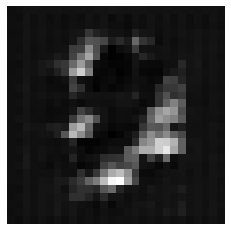

discriminator loss : 0.35594642162323
Generator loss : [0.33209285, 0.0]
(1, 28, 28, 1)
(28, 28)


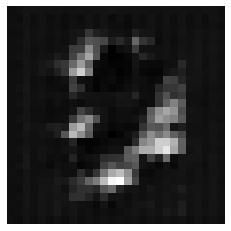

discriminator loss : 0.3365895748138428
Generator loss : [0.32424173, 0.0]
(1, 28, 28, 1)
(28, 28)


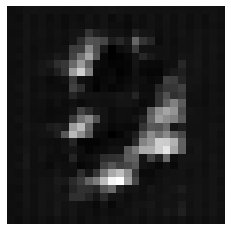

discriminator loss : 0.33902955055236816
Generator loss : [0.33048722, 0.0]
(1, 28, 28, 1)
(28, 28)


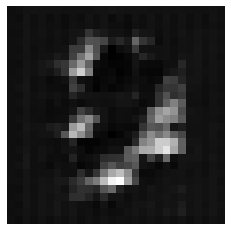

discriminator loss : 0.35972875356674194
Generator loss : [0.34616882, 0.0]
(1, 28, 28, 1)
(28, 28)


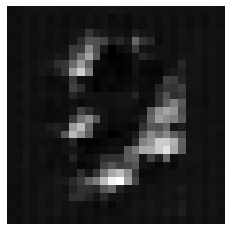

discriminator loss : 0.3370080590248108
Generator loss : [0.32079047, 0.0]
(1, 28, 28, 1)
(28, 28)


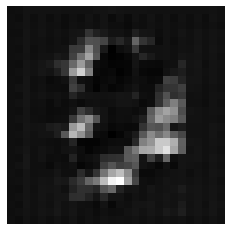

discriminator loss : 0.33957868814468384
Generator loss : [0.32154733, 0.0]
(1, 28, 28, 1)
(28, 28)


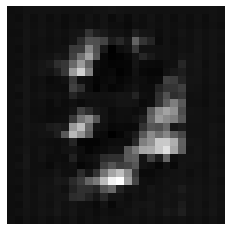

discriminator loss : 0.33726319670677185
Generator loss : [0.33067688, 0.0]
(1, 28, 28, 1)
(28, 28)


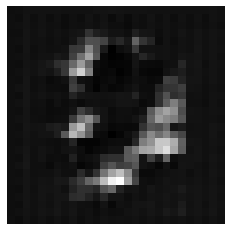

discriminator loss : 0.3462979197502136
Generator loss : [0.32885674, 0.0]
(1, 28, 28, 1)
(28, 28)


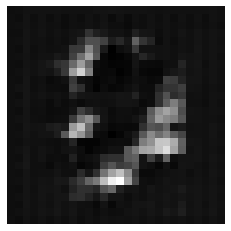

discriminator loss : 0.3382522761821747
Generator loss : [0.32865253, 0.0]
(1, 28, 28, 1)
(28, 28)


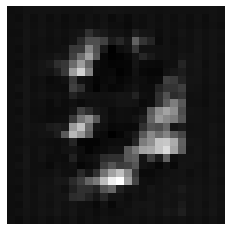

discriminator loss : 0.375216007232666
Generator loss : [0.33629495, 0.0]
(1, 28, 28, 1)
(28, 28)


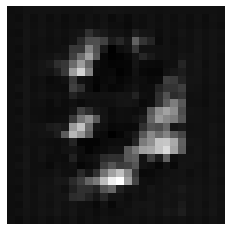

discriminator loss : 0.3288278877735138
Generator loss : [0.31267795, 0.0]
(1, 28, 28, 1)
(28, 28)


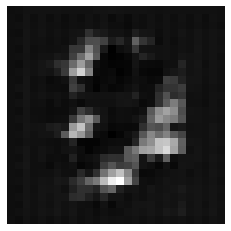

discriminator loss : 0.3456997275352478
Generator loss : [0.34125727, 0.0]
(1, 28, 28, 1)
(28, 28)


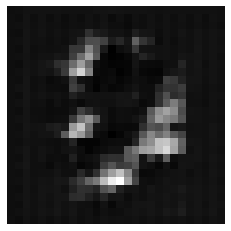

discriminator loss : 0.36416196823120117
Generator loss : [0.3417907, 0.0]
(1, 28, 28, 1)
(28, 28)


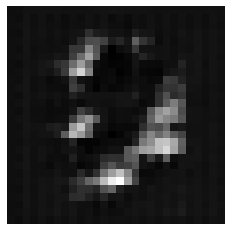

discriminator loss : 0.34333401918411255
Generator loss : [0.32551536, 0.0]
(1, 28, 28, 1)
(28, 28)


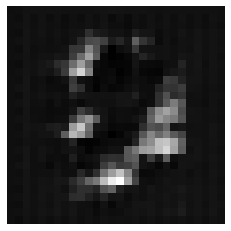

discriminator loss : 0.33996206521987915
Generator loss : [0.33084688, 0.0]
(1, 28, 28, 1)
(28, 28)


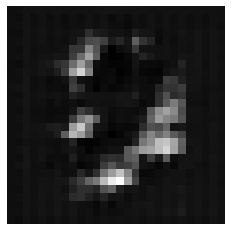

discriminator loss : 0.34640640020370483
Generator loss : [0.33300343, 0.0]
(1, 28, 28, 1)
(28, 28)


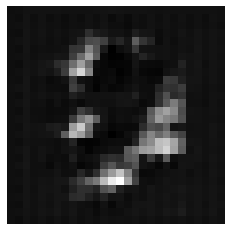

discriminator loss : 0.34179550409317017
Generator loss : [0.33087772, 0.0]
(1, 28, 28, 1)
(28, 28)


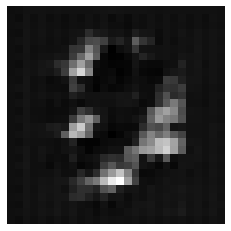

discriminator loss : 0.3402937054634094
Generator loss : [0.31611878, 0.0]
(1, 28, 28, 1)
(28, 28)


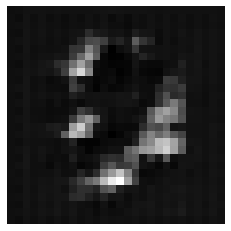

discriminator loss : 0.32730919122695923
Generator loss : [0.31784666, 0.0]
(1, 28, 28, 1)
(28, 28)


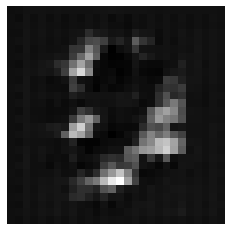

discriminator loss : 0.33537036180496216
Generator loss : [0.33301002, 0.0]
(1, 28, 28, 1)
(28, 28)


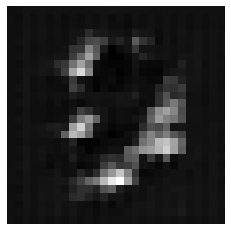

discriminator loss : 0.3277153968811035
Generator loss : [0.33598587, 0.0]
(1, 28, 28, 1)
(28, 28)


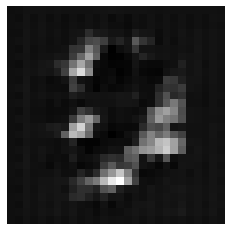

discriminator loss : 0.3398238718509674
Generator loss : [0.34236714, 0.0]
(1, 28, 28, 1)
(28, 28)


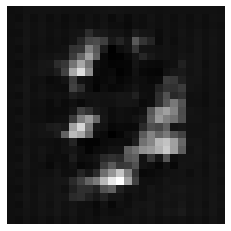

discriminator loss : 0.35057616233825684
Generator loss : [0.3418846, 0.0]
(1, 28, 28, 1)
(28, 28)


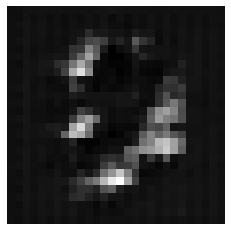

discriminator loss : 0.34862005710601807
Generator loss : [0.3349615, 0.0]
(1, 28, 28, 1)
(28, 28)


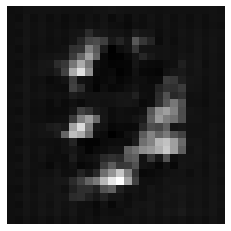

discriminator loss : 0.34121203422546387
Generator loss : [0.30991346, 0.0]
(1, 28, 28, 1)
(28, 28)


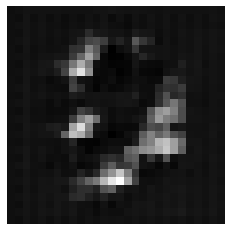

discriminator loss : 0.34099727869033813
Generator loss : [0.336259, 0.0]
(1, 28, 28, 1)
(28, 28)


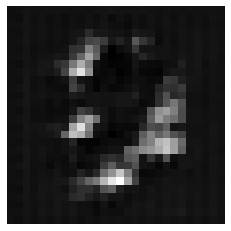

discriminator loss : 0.3417043089866638
Generator loss : [0.32438827, 0.0]
(1, 28, 28, 1)
(28, 28)


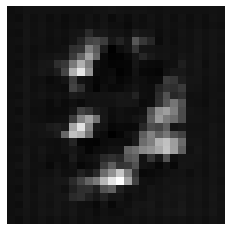

discriminator loss : 0.33194464445114136
Generator loss : [0.33021978, 0.0]
(1, 28, 28, 1)
(28, 28)


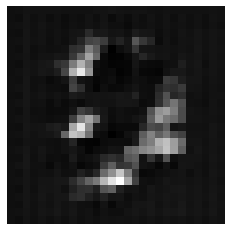

discriminator loss : 0.3393377661705017
Generator loss : [0.3547483, 0.0]
(1, 28, 28, 1)
(28, 28)


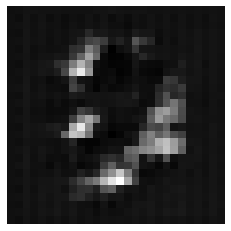

discriminator loss : 0.325287401676178
Generator loss : [0.3306051, 0.0]
(1, 28, 28, 1)
(28, 28)


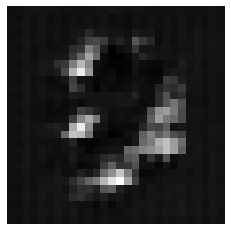

discriminator loss : 0.34610116481781006
Generator loss : [0.34890366, 0.0]
(1, 28, 28, 1)
(28, 28)


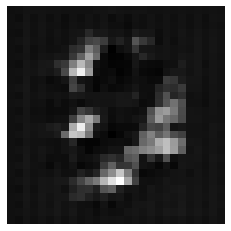

discriminator loss : 0.34241676330566406
Generator loss : [0.3433669, 0.0]
(1, 28, 28, 1)
(28, 28)


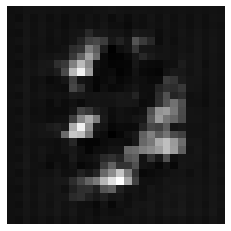

discriminator loss : 0.3313407897949219
Generator loss : [0.33025968, 0.0]
(1, 28, 28, 1)
(28, 28)


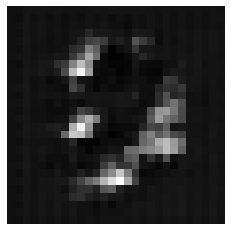

discriminator loss : 0.3365960121154785
Generator loss : [0.35239375, 0.0]
(1, 28, 28, 1)
(28, 28)


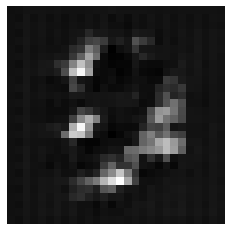

discriminator loss : 0.34464114904403687
Generator loss : [0.35150844, 0.0]
(1, 28, 28, 1)
(28, 28)


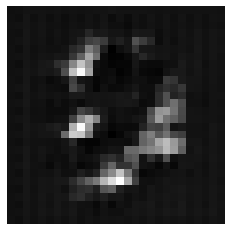

discriminator loss : 0.35413074493408203
Generator loss : [0.35305503, 0.0]
(1, 28, 28, 1)
(28, 28)


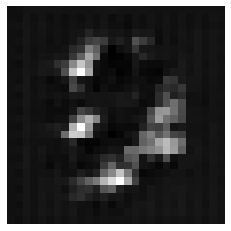

discriminator loss : 0.33333438634872437
Generator loss : [0.34635574, 0.0]
(1, 28, 28, 1)
(28, 28)


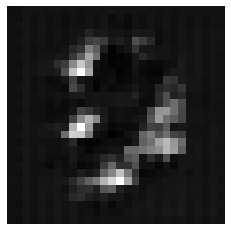

discriminator loss : 0.33442583680152893
Generator loss : [0.3716826, 0.0]
(1, 28, 28, 1)
(28, 28)


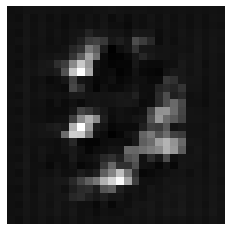

discriminator loss : 0.3290535509586334
Generator loss : [0.35547316, 0.0]
(1, 28, 28, 1)
(28, 28)


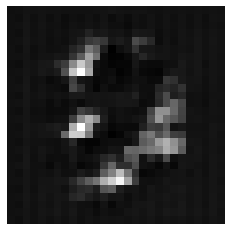

discriminator loss : 0.350247859954834
Generator loss : [0.32752037, 0.0]
(1, 28, 28, 1)
(28, 28)


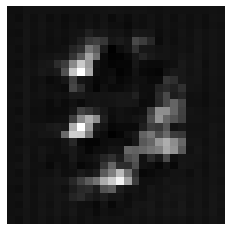

discriminator loss : 0.3527304530143738
Generator loss : [0.33025125, 0.0]
(1, 28, 28, 1)
(28, 28)


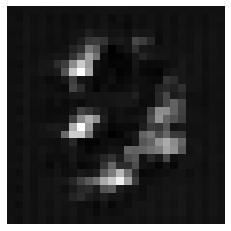

discriminator loss : 0.3341541886329651
Generator loss : [0.35042694, 0.0]
(1, 28, 28, 1)
(28, 28)


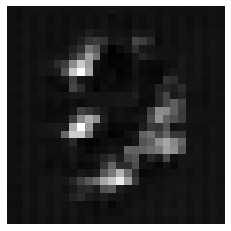

discriminator loss : 0.33573177456855774
Generator loss : [0.33068806, 0.0]
(1, 28, 28, 1)
(28, 28)


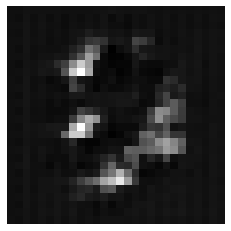

discriminator loss : 0.32125169038772583
Generator loss : [0.33903506, 0.0]
(1, 28, 28, 1)
(28, 28)


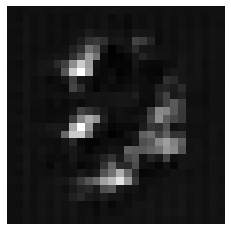

discriminator loss : 0.3671225309371948
Generator loss : [0.34056652, 0.0]
(1, 28, 28, 1)
(28, 28)


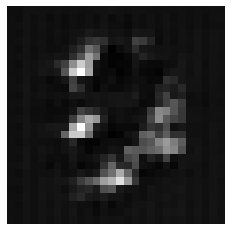

discriminator loss : 0.3346065282821655
Generator loss : [0.34807473, 0.0]
(1, 28, 28, 1)
(28, 28)


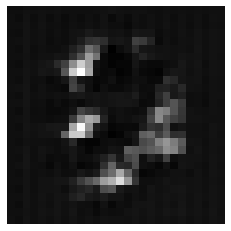

discriminator loss : 0.3237452208995819
Generator loss : [0.36029977, 0.0]
(1, 28, 28, 1)
(28, 28)


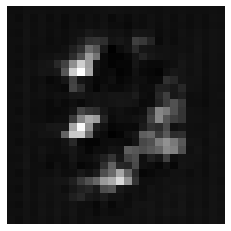

discriminator loss : 0.33661770820617676
Generator loss : [0.35567293, 0.0]
(1, 28, 28, 1)
(28, 28)


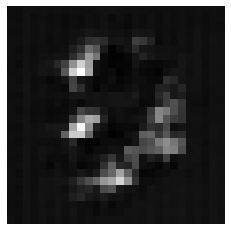

discriminator loss : 0.3349953889846802
Generator loss : [0.3443399, 0.0]
(1, 28, 28, 1)
(28, 28)


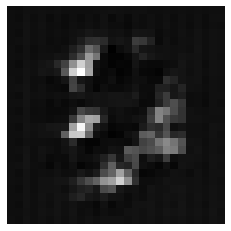

discriminator loss : 0.3311302363872528
Generator loss : [0.36791307, 0.0]
(1, 28, 28, 1)
(28, 28)


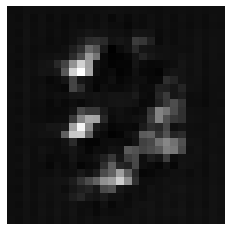

discriminator loss : 0.3376750946044922
Generator loss : [0.3484851, 0.0]
(1, 28, 28, 1)
(28, 28)


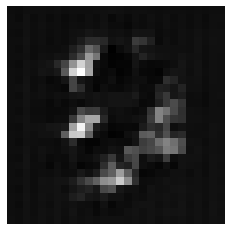

discriminator loss : 0.33552855253219604
Generator loss : [0.33982724, 0.0]
(1, 28, 28, 1)
(28, 28)


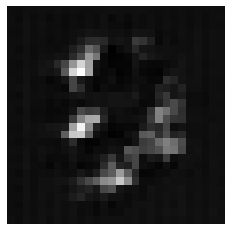

discriminator loss : 0.3404829502105713
Generator loss : [0.35087064, 0.0]
(1, 28, 28, 1)
(28, 28)


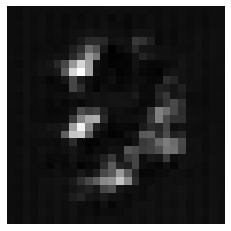

discriminator loss : 0.349042683839798
Generator loss : [0.35944462, 0.0]
(1, 28, 28, 1)
(28, 28)


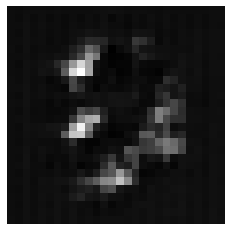

discriminator loss : 0.33961036801338196
Generator loss : [0.34946662, 0.0]
(1, 28, 28, 1)
(28, 28)


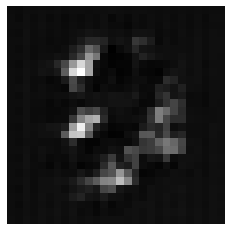

discriminator loss : 0.33891046047210693
Generator loss : [0.3266864, 0.0]
(1, 28, 28, 1)
(28, 28)


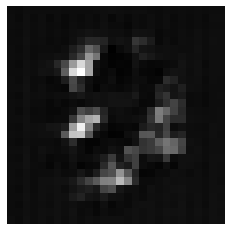

discriminator loss : 0.35236746072769165
Generator loss : [0.33980605, 0.0]
(1, 28, 28, 1)
(28, 28)


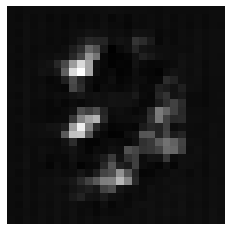

discriminator loss : 0.359072208404541
Generator loss : [0.3576746, 0.0]
(1, 28, 28, 1)
(28, 28)


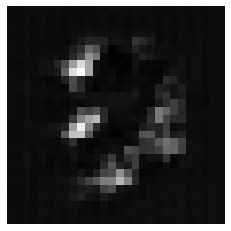

discriminator loss : 0.36208587884902954
Generator loss : [0.36696926, 0.0]
(1, 28, 28, 1)
(28, 28)


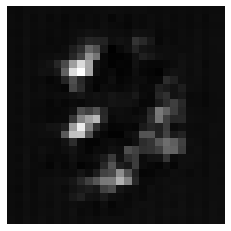

discriminator loss : 0.3535386323928833
Generator loss : [0.3600363, 0.0]
(1, 28, 28, 1)
(28, 28)


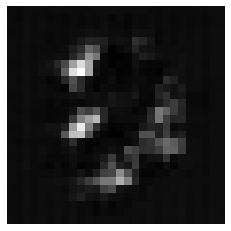

discriminator loss : 0.32637256383895874
Generator loss : [0.3454891, 0.0]
(1, 28, 28, 1)
(28, 28)


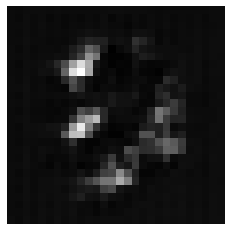

discriminator loss : 0.3361586928367615
Generator loss : [0.36063927, 0.0]
(1, 28, 28, 1)
(28, 28)


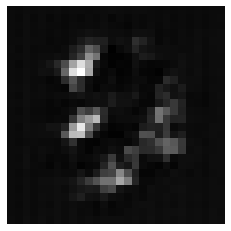

discriminator loss : 0.34543174505233765
Generator loss : [0.37973815, 0.0]
(1, 28, 28, 1)
(28, 28)


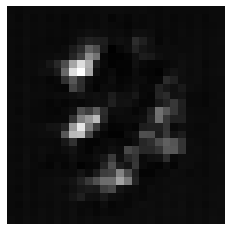

discriminator loss : 0.3596095144748688
Generator loss : [0.40348262, 0.0]
(1, 28, 28, 1)
(28, 28)


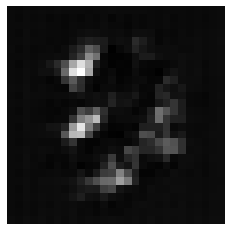

discriminator loss : 0.40025901794433594
Generator loss : [0.51099265, 0.0]
(1, 28, 28, 1)
(28, 28)


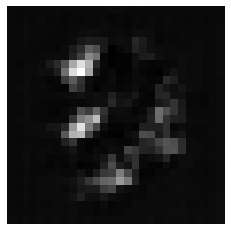

discriminator loss : 0.581748902797699
Generator loss : [1.4515904, 0.0]
(1, 28, 28, 1)
(28, 28)


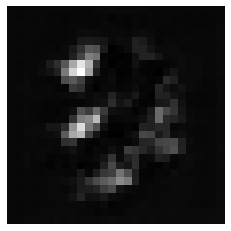

discriminator loss : 1.5537339448928833
Generator loss : [1.6163841, 0.0]
(1, 28, 28, 1)
(28, 28)


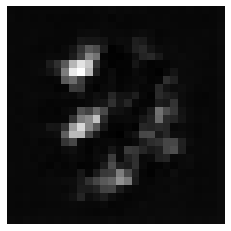

discriminator loss : 0.5430440902709961
Generator loss : [1.6319029, 0.0]
(1, 28, 28, 1)
(28, 28)


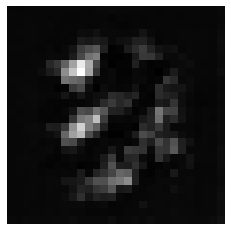

discriminator loss : 0.473324179649353
Generator loss : [1.8558416, 0.0]
(1, 28, 28, 1)
(28, 28)


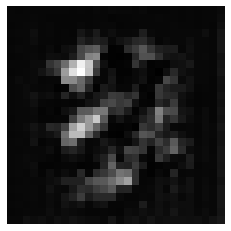

discriminator loss : 0.5577614903450012
Generator loss : [1.3067772, 0.0]
(1, 28, 28, 1)
(28, 28)


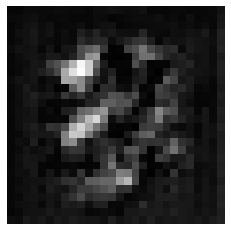

discriminator loss : 0.5654833316802979
Generator loss : [1.0115776, 0.0]
(1, 28, 28, 1)
(28, 28)


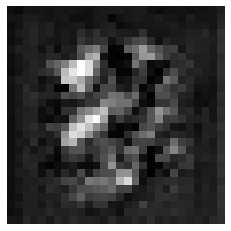

discriminator loss : 0.5226331949234009
Generator loss : [0.99747556, 0.0]
(1, 28, 28, 1)
(28, 28)


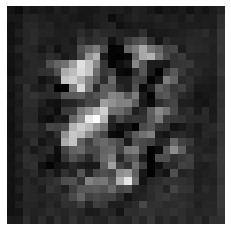

discriminator loss : 0.4969320297241211
Generator loss : [0.9349905, 0.0]
(1, 28, 28, 1)
(28, 28)


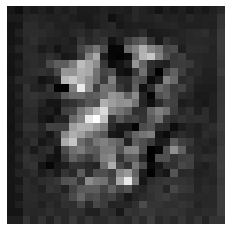

discriminator loss : 0.49093911051750183
Generator loss : [0.8510022, 0.0]
(1, 28, 28, 1)
(28, 28)


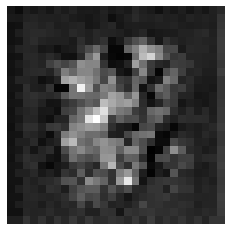

discriminator loss : 0.48412758111953735
Generator loss : [0.7315082, 0.0]
(1, 28, 28, 1)
(28, 28)


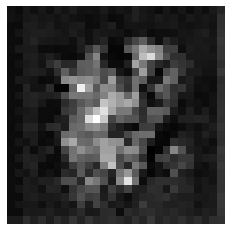

discriminator loss : 0.5893835425376892
Generator loss : [0.72713053, 0.0]
(1, 28, 28, 1)
(28, 28)


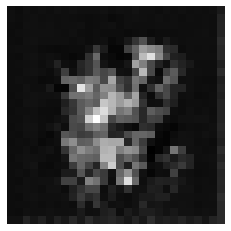

discriminator loss : 1.0980288982391357
Generator loss : [1.1469592, 0.0]
(1, 28, 28, 1)
(28, 28)


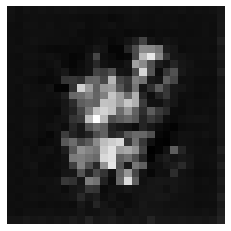

discriminator loss : 1.7906596660614014
Generator loss : [0.42060053, 0.0]
(1, 28, 28, 1)
(28, 28)


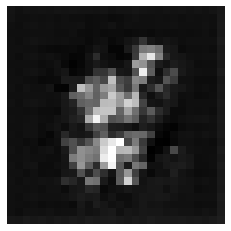

discriminator loss : 0.8219252228736877
Generator loss : [0.4512189, 0.0]
(1, 28, 28, 1)
(28, 28)


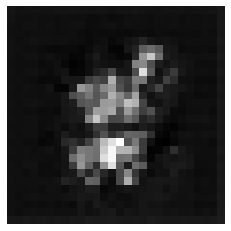

discriminator loss : 0.6877684593200684
Generator loss : [0.414593, 0.0]
(1, 28, 28, 1)
(28, 28)


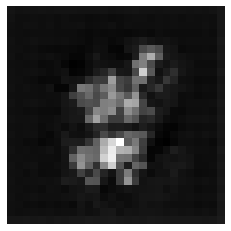

discriminator loss : 0.5797601938247681
Generator loss : [0.34992734, 0.0]
(1, 28, 28, 1)
(28, 28)


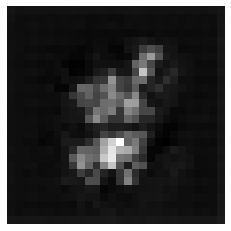

discriminator loss : 0.4502204656600952
Generator loss : [0.3337093, 0.0]
(1, 28, 28, 1)
(28, 28)


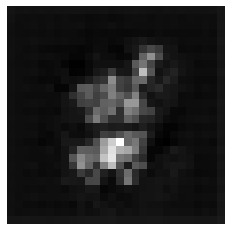

discriminator loss : 0.3901766538619995
Generator loss : [0.3367685, 0.0]
(1, 28, 28, 1)
(28, 28)


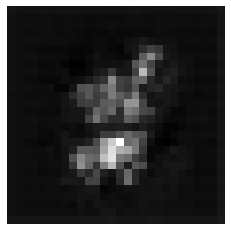

discriminator loss : 0.36297112703323364
Generator loss : [0.36526853, 0.0]
(1, 28, 28, 1)
(28, 28)


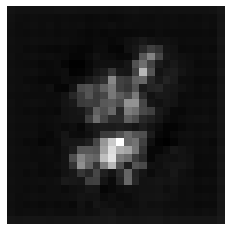

discriminator loss : 0.3403565287590027
Generator loss : [0.34018868, 0.0]
(1, 28, 28, 1)
(28, 28)


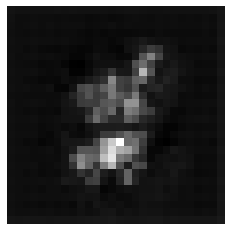

discriminator loss : 0.3320994973182678
Generator loss : [0.3392696, 0.0]
(1, 28, 28, 1)
(28, 28)


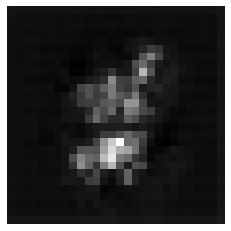

discriminator loss : 0.3553091883659363
Generator loss : [0.32734144, 0.0]
(1, 28, 28, 1)
(28, 28)


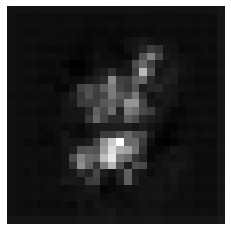

discriminator loss : 0.34525755047798157
Generator loss : [0.31887734, 0.0]
(1, 28, 28, 1)
(28, 28)


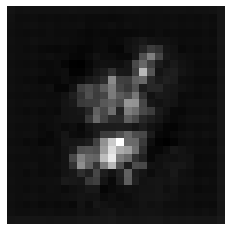

discriminator loss : 0.3397824466228485
Generator loss : [0.3167097, 0.0]
(1, 28, 28, 1)
(28, 28)


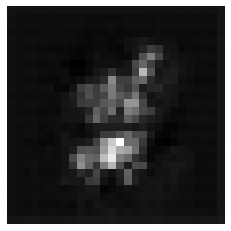

discriminator loss : 0.32876330614089966
Generator loss : [0.31235525, 0.0]
(1, 28, 28, 1)
(28, 28)


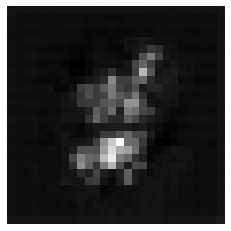

discriminator loss : 0.33908870816230774
Generator loss : [0.32385808, 0.0]
(1, 28, 28, 1)
(28, 28)


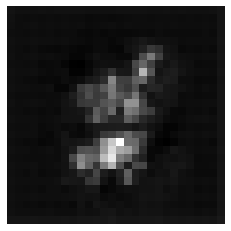

discriminator loss : 0.3350772261619568
Generator loss : [0.33351764, 0.0]
(1, 28, 28, 1)
(28, 28)


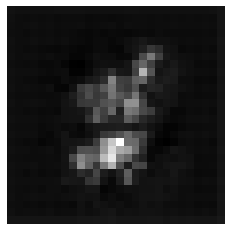

discriminator loss : 0.3198097348213196
Generator loss : [0.32628804, 0.0]
(1, 28, 28, 1)
(28, 28)


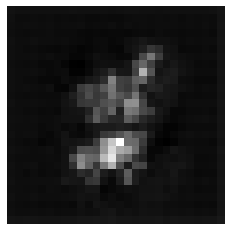

discriminator loss : 0.33747637271881104
Generator loss : [0.3236666, 0.0]
(1, 28, 28, 1)
(28, 28)


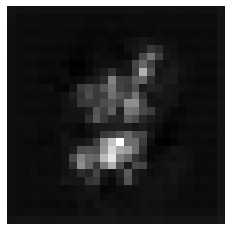

discriminator loss : 0.33998221158981323
Generator loss : [0.3072049, 0.0]
(1, 28, 28, 1)
(28, 28)


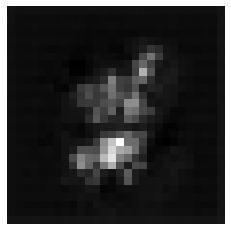

discriminator loss : 0.3490285873413086
Generator loss : [0.334784, 0.0]
(1, 28, 28, 1)
(28, 28)


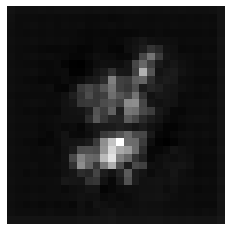

discriminator loss : 0.3455285429954529
Generator loss : [0.32557908, 0.0]
(1, 28, 28, 1)
(28, 28)


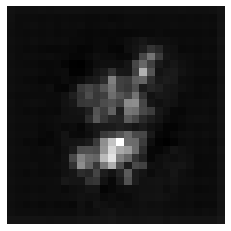

discriminator loss : 0.34920671582221985
Generator loss : [0.31692454, 0.0]
(1, 28, 28, 1)
(28, 28)


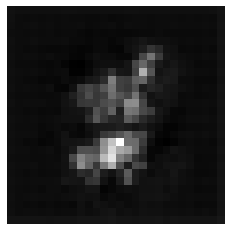

discriminator loss : 0.34231555461883545
Generator loss : [0.33040342, 0.0]
(1, 28, 28, 1)
(28, 28)


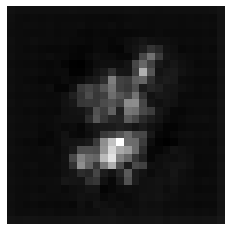

discriminator loss : 0.3516172766685486
Generator loss : [0.33313107, 0.0]
(1, 28, 28, 1)
(28, 28)


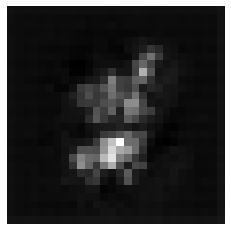

discriminator loss : 0.36403870582580566
Generator loss : [0.3514825, 0.0]
(1, 28, 28, 1)
(28, 28)


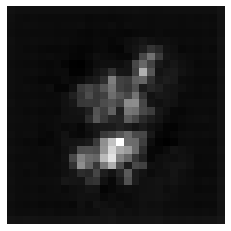

discriminator loss : 0.33114010095596313
Generator loss : [0.31427252, 0.0]
(1, 28, 28, 1)
(28, 28)


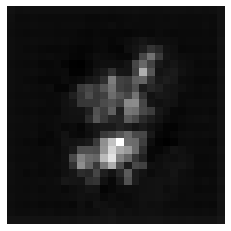

discriminator loss : 0.34694015979766846
Generator loss : [0.32923424, 0.0]
(1, 28, 28, 1)
(28, 28)


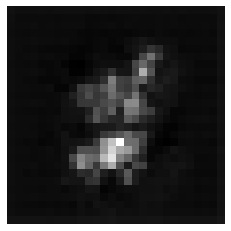

discriminator loss : 0.3460800051689148
Generator loss : [0.3458356, 0.0]
(1, 28, 28, 1)
(28, 28)


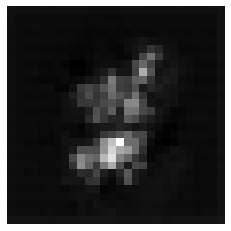

discriminator loss : 0.3479117155075073
Generator loss : [0.3460704, 0.0]
(1, 28, 28, 1)
(28, 28)


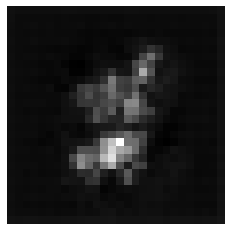

discriminator loss : 0.3406201899051666
Generator loss : [0.31489676, 0.0]
(1, 28, 28, 1)
(28, 28)


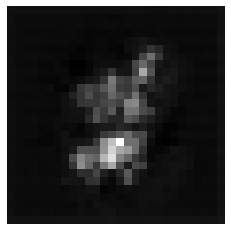

discriminator loss : 0.3400493264198303
Generator loss : [0.3448038, 0.0]
(1, 28, 28, 1)
(28, 28)


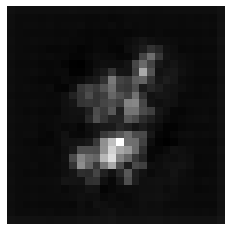

discriminator loss : 0.3338439464569092
Generator loss : [0.31649458, 0.0]
(1, 28, 28, 1)
(28, 28)


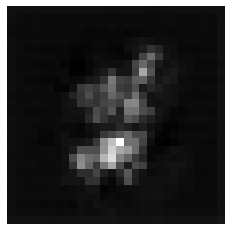

discriminator loss : 0.3220348656177521
Generator loss : [0.319758, 0.0]
(1, 28, 28, 1)
(28, 28)


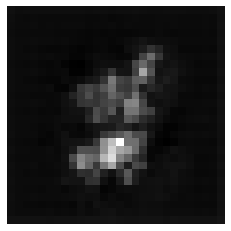

discriminator loss : 0.34709152579307556
Generator loss : [0.3465911, 0.0]
(1, 28, 28, 1)
(28, 28)


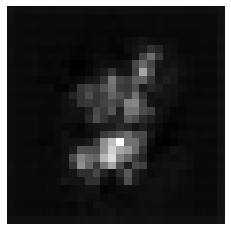

discriminator loss : 0.35304051637649536
Generator loss : [0.3498132, 0.0]
(1, 28, 28, 1)
(28, 28)


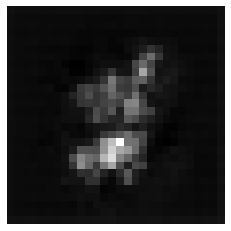

discriminator loss : 0.33390700817108154
Generator loss : [0.33688122, 0.0]
(1, 28, 28, 1)
(28, 28)


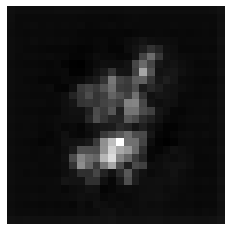

discriminator loss : 0.33008092641830444
Generator loss : [0.30625015, 0.0]
(1, 28, 28, 1)
(28, 28)


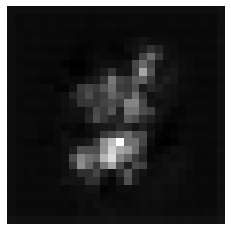

discriminator loss : 0.32715046405792236
Generator loss : [0.3290487, 0.0]
(1, 28, 28, 1)
(28, 28)


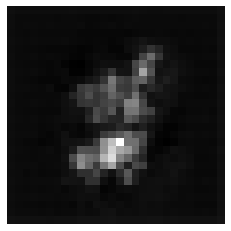

discriminator loss : 0.3316095173358917
Generator loss : [0.3250819, 0.0]
(1, 28, 28, 1)
(28, 28)


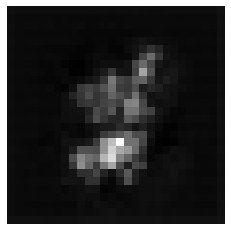

discriminator loss : 0.3239291310310364
Generator loss : [0.32468227, 0.0]
(1, 28, 28, 1)
(28, 28)


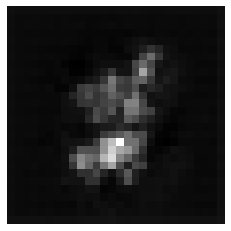

discriminator loss : 0.35249102115631104
Generator loss : [0.3399924, 0.0]
(1, 28, 28, 1)
(28, 28)


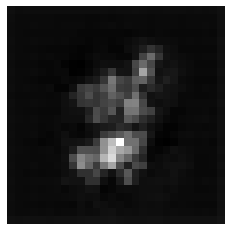

discriminator loss : 0.337248831987381
Generator loss : [0.31691793, 0.0]
(1, 28, 28, 1)
(28, 28)


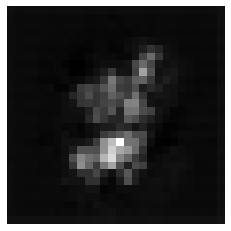

discriminator loss : 0.3485889434814453
Generator loss : [0.323846, 0.0]
(1, 28, 28, 1)
(28, 28)


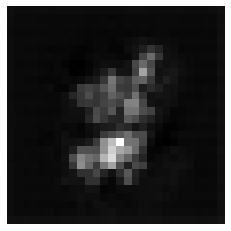

discriminator loss : 0.32918059825897217
Generator loss : [0.3221752, 0.0]
(1, 28, 28, 1)
(28, 28)


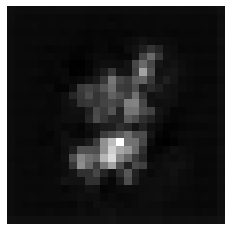

discriminator loss : 0.3321354389190674
Generator loss : [0.31287405, 0.0]
(1, 28, 28, 1)
(28, 28)


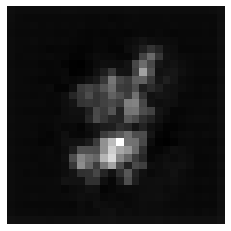

discriminator loss : 0.33768704533576965
Generator loss : [0.32484168, 0.0]
(1, 28, 28, 1)
(28, 28)


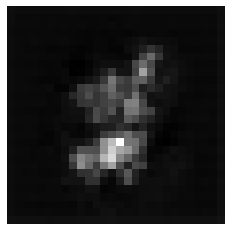

discriminator loss : 0.34813523292541504
Generator loss : [0.34294483, 0.0]
(1, 28, 28, 1)
(28, 28)


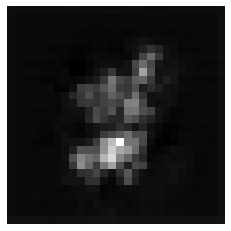

discriminator loss : 0.3232290744781494
Generator loss : [0.30556616, 0.0]
(1, 28, 28, 1)
(28, 28)


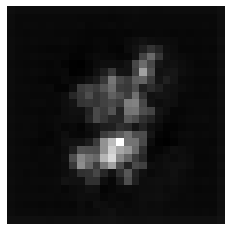

discriminator loss : 0.32964617013931274
Generator loss : [0.32616547, 0.0]
(1, 28, 28, 1)
(28, 28)


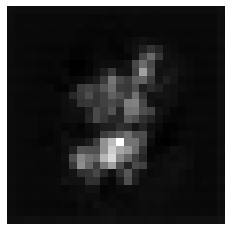

discriminator loss : 0.33295682072639465
Generator loss : [0.33346698, 0.0]
(1, 28, 28, 1)
(28, 28)


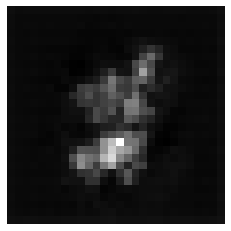

discriminator loss : 0.31949383020401
Generator loss : [0.30976757, 0.0]
(1, 28, 28, 1)
(28, 28)


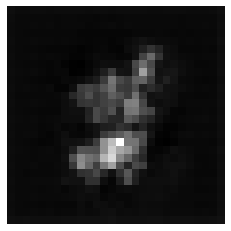

discriminator loss : 0.32082709670066833
Generator loss : [0.30870053, 0.0]
(1, 28, 28, 1)
(28, 28)


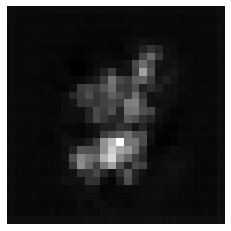

discriminator loss : 0.33383509516716003
Generator loss : [0.34727967, 0.0]
(1, 28, 28, 1)
(28, 28)


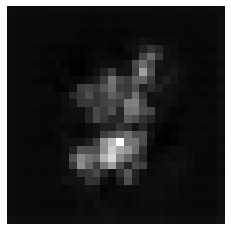

discriminator loss : 0.3272860050201416
Generator loss : [0.32938632, 0.0]
(1, 28, 28, 1)
(28, 28)


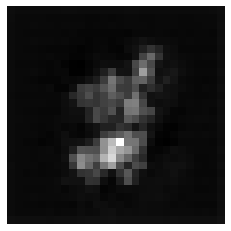

discriminator loss : 0.3256528973579407
Generator loss : [0.33202052, 0.0]
(1, 28, 28, 1)
(28, 28)


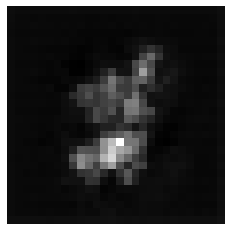

discriminator loss : 0.3230651021003723
Generator loss : [0.33143702, 0.0]
(1, 28, 28, 1)
(28, 28)


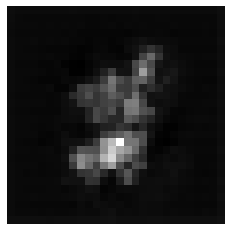

discriminator loss : 0.3289833664894104
Generator loss : [0.31906286, 0.0]
(1, 28, 28, 1)
(28, 28)


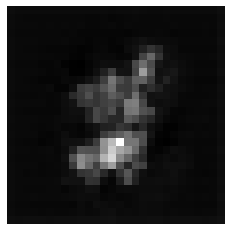

discriminator loss : 0.34606778621673584
Generator loss : [0.35027358, 0.0]
(1, 28, 28, 1)
(28, 28)


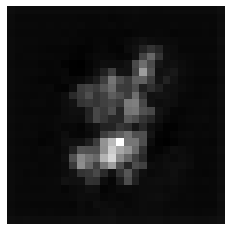

discriminator loss : 0.3267894983291626
Generator loss : [0.3318435, 0.0]
(1, 28, 28, 1)
(28, 28)


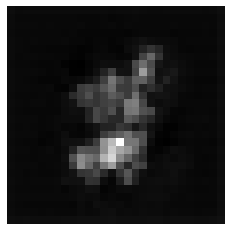

discriminator loss : 0.3297644257545471
Generator loss : [0.35186115, 0.0]
(1, 28, 28, 1)
(28, 28)


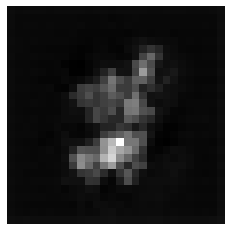

discriminator loss : 0.3302866816520691
Generator loss : [0.32188046, 0.0]
(1, 28, 28, 1)
(28, 28)


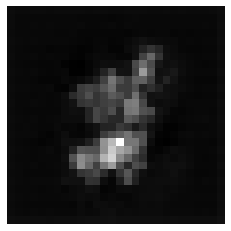

discriminator loss : 0.3259366750717163
Generator loss : [0.32223895, 0.0]
(1, 28, 28, 1)
(28, 28)


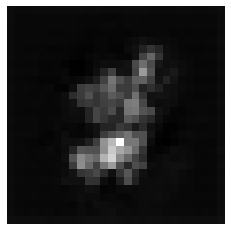

discriminator loss : 0.3249099552631378
Generator loss : [0.31381616, 0.0]
(1, 28, 28, 1)
(28, 28)


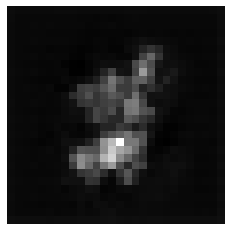

discriminator loss : 0.3360669016838074
Generator loss : [0.32975003, 0.0]
(1, 28, 28, 1)
(28, 28)


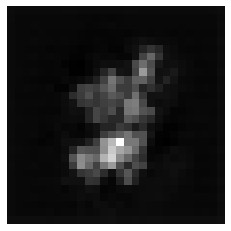

discriminator loss : 0.3288300037384033
Generator loss : [0.31892985, 0.0]
(1, 28, 28, 1)
(28, 28)


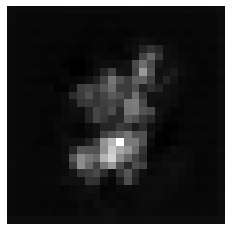

discriminator loss : 0.32982057332992554
Generator loss : [0.34282613, 0.0]
(1, 28, 28, 1)
(28, 28)


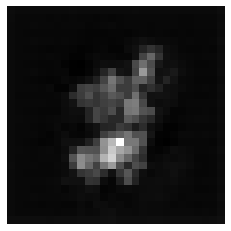

discriminator loss : 0.32719147205352783
Generator loss : [0.3266463, 0.0]
(1, 28, 28, 1)
(28, 28)


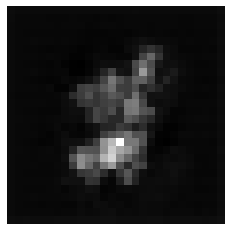

discriminator loss : 0.32465386390686035
Generator loss : [0.32022026, 0.0]
(1, 28, 28, 1)
(28, 28)


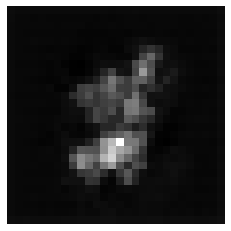

discriminator loss : 0.32715898752212524
Generator loss : [0.31862012, 0.0]
(1, 28, 28, 1)
(28, 28)


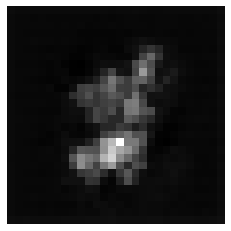

discriminator loss : 0.3096131682395935
Generator loss : [0.29401058, 0.0]
(1, 28, 28, 1)
(28, 28)


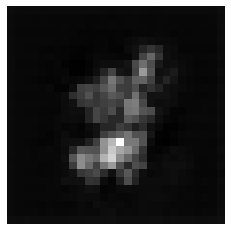

discriminator loss : 0.3356325626373291
Generator loss : [0.3373576, 0.0]
(1, 28, 28, 1)
(28, 28)


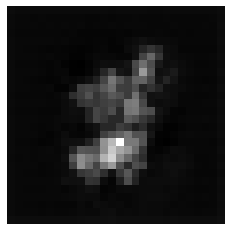

discriminator loss : 0.3323078751564026
Generator loss : [0.34125644, 0.0]
(1, 28, 28, 1)
(28, 28)


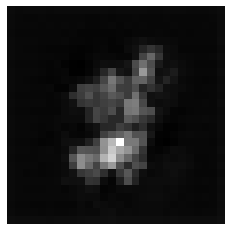

discriminator loss : 0.32986825704574585
Generator loss : [0.3352753, 0.0]
(1, 28, 28, 1)
(28, 28)


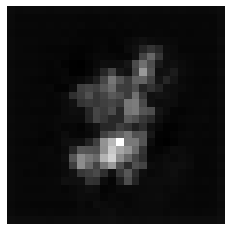

discriminator loss : 0.34581249952316284
Generator loss : [0.33636716, 0.0]
(1, 28, 28, 1)
(28, 28)


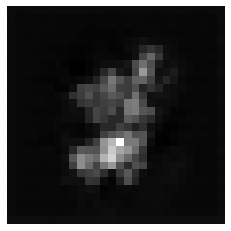

discriminator loss : 0.3387732207775116
Generator loss : [0.34786862, 0.0]
(1, 28, 28, 1)
(28, 28)


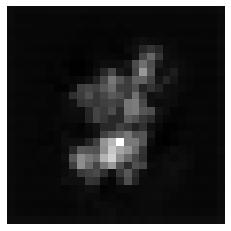

discriminator loss : 0.335433691740036
Generator loss : [0.33808354, 0.0]
(1, 28, 28, 1)
(28, 28)


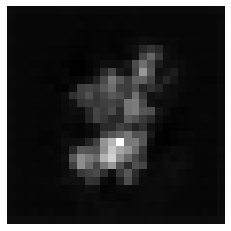

discriminator loss : 0.3351401686668396
Generator loss : [0.33361435, 0.0]
(1, 28, 28, 1)
(28, 28)


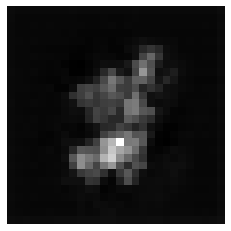

discriminator loss : 0.31585317850112915
Generator loss : [0.32353103, 0.0]
(1, 28, 28, 1)
(28, 28)


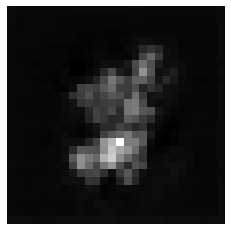

discriminator loss : 0.3459385633468628
Generator loss : [0.34834388, 0.0]
(1, 28, 28, 1)
(28, 28)


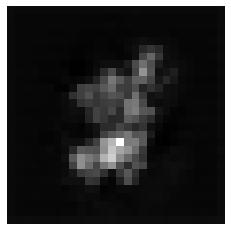

discriminator loss : 0.3197641968727112
Generator loss : [0.30650893, 0.0]
(1, 28, 28, 1)
(28, 28)


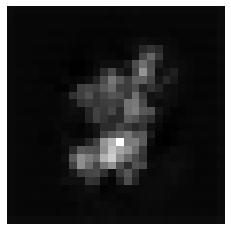

discriminator loss : 0.3195189833641052
Generator loss : [0.33084553, 0.0]
(1, 28, 28, 1)
(28, 28)


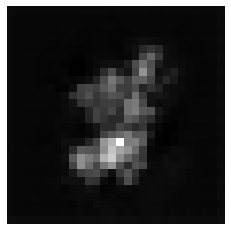

discriminator loss : 0.34353187680244446
Generator loss : [0.3414722, 0.0]
(1, 28, 28, 1)
(28, 28)


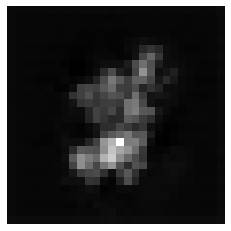

discriminator loss : 0.3348557949066162
Generator loss : [0.32743844, 0.0]
(1, 28, 28, 1)
(28, 28)


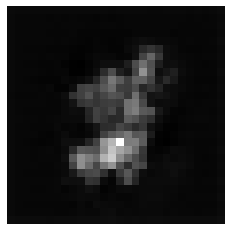

discriminator loss : 0.3230799436569214
Generator loss : [0.32890034, 0.0]
(1, 28, 28, 1)
(28, 28)


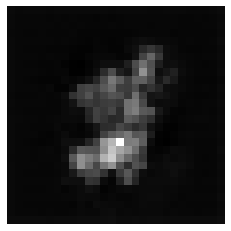

discriminator loss : 0.3311963677406311
Generator loss : [0.32672364, 0.0]
(1, 28, 28, 1)
(28, 28)


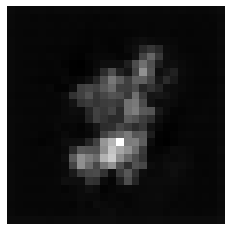

discriminator loss : 0.3226802945137024
Generator loss : [0.3356299, 0.0]
(1, 28, 28, 1)
(28, 28)


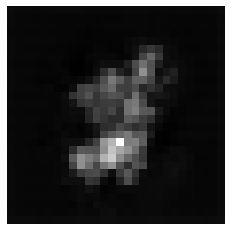

discriminator loss : 0.3255186080932617
Generator loss : [0.3224862, 0.0]
(1, 28, 28, 1)
(28, 28)


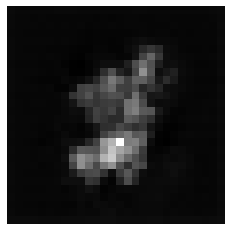

discriminator loss : 0.3350803554058075
Generator loss : [0.3337612, 0.0]
(1, 28, 28, 1)
(28, 28)


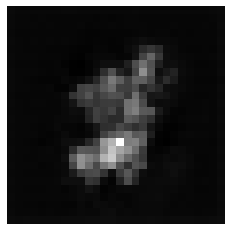

discriminator loss : 0.3383010923862457
Generator loss : [0.33234873, 0.0]
(1, 28, 28, 1)
(28, 28)


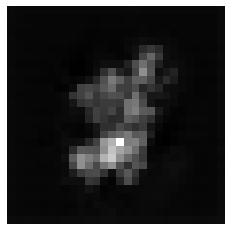

discriminator loss : 0.32750949263572693
Generator loss : [0.3216964, 0.0]
(1, 28, 28, 1)
(28, 28)


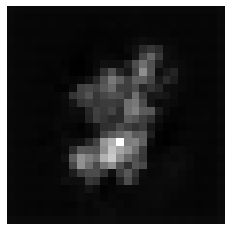

discriminator loss : 0.3128929138183594
Generator loss : [0.30858013, 0.0]
(1, 28, 28, 1)
(28, 28)


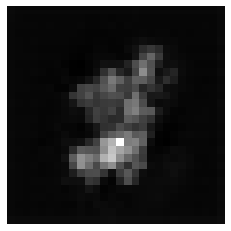

discriminator loss : 0.3250937759876251
Generator loss : [0.31276536, 0.0]
(1, 28, 28, 1)
(28, 28)


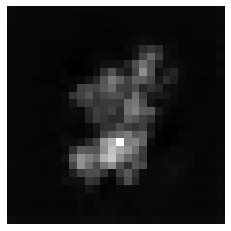

discriminator loss : 0.3335433900356293
Generator loss : [0.34248188, 0.0]
(1, 28, 28, 1)
(28, 28)


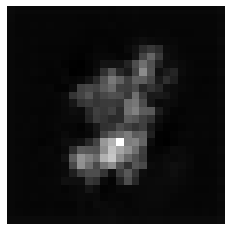

discriminator loss : 0.3304023742675781
Generator loss : [0.32782924, 0.0]
(1, 28, 28, 1)
(28, 28)


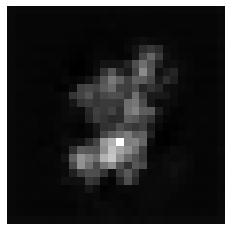

discriminator loss : 0.3309493064880371
Generator loss : [0.32865077, 0.0]
(1, 28, 28, 1)
(28, 28)


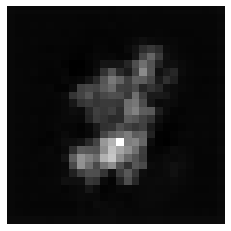

discriminator loss : 0.31898778676986694
Generator loss : [0.3297804, 0.0]
(1, 28, 28, 1)
(28, 28)


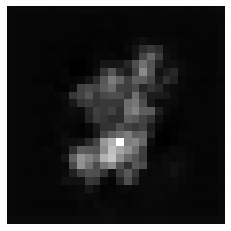

discriminator loss : 0.33078134059906006
Generator loss : [0.3288725, 0.0]
(1, 28, 28, 1)
(28, 28)


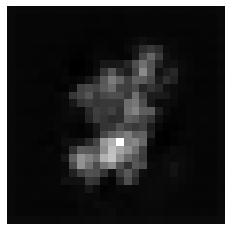

discriminator loss : 0.32873600721359253
Generator loss : [0.35173094, 0.0]
(1, 28, 28, 1)
(28, 28)


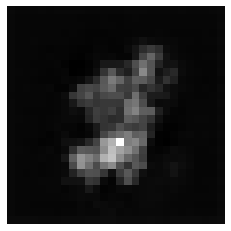

discriminator loss : 0.340496301651001
Generator loss : [0.33931854, 0.0]
(1, 28, 28, 1)
(28, 28)


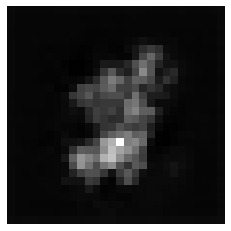

discriminator loss : 0.3348994255065918
Generator loss : [0.32936528, 0.0]
(1, 28, 28, 1)
(28, 28)


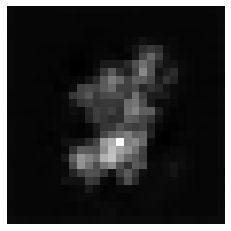

discriminator loss : 0.32284486293792725
Generator loss : [0.32252568, 0.0]
(1, 28, 28, 1)
(28, 28)


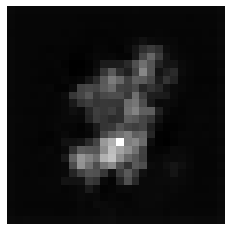

discriminator loss : 0.33493852615356445
Generator loss : [0.34212354, 0.0]
(1, 28, 28, 1)
(28, 28)


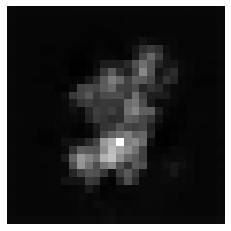

discriminator loss : 0.3280794620513916
Generator loss : [0.33611682, 0.0]
(1, 28, 28, 1)
(28, 28)


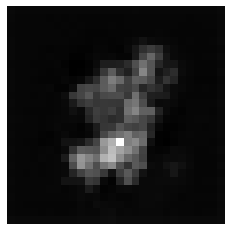

discriminator loss : 0.3465157747268677
Generator loss : [0.34622574, 0.0]
(1, 28, 28, 1)
(28, 28)


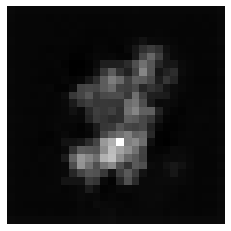

discriminator loss : 0.3243449628353119
Generator loss : [0.33310634, 0.0]
(1, 28, 28, 1)
(28, 28)


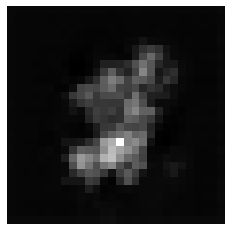

discriminator loss : 0.3182036280632019
Generator loss : [0.31849724, 0.0]
(1, 28, 28, 1)
(28, 28)


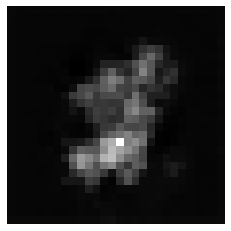

discriminator loss : 0.35546785593032837
Generator loss : [0.3510836, 0.0]
(1, 28, 28, 1)
(28, 28)


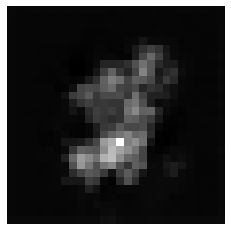

discriminator loss : 0.34181565046310425
Generator loss : [0.3500569, 0.0]
(1, 28, 28, 1)
(28, 28)


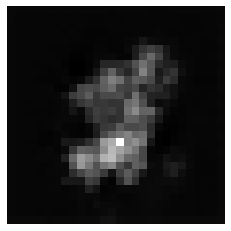

discriminator loss : 0.3385375142097473
Generator loss : [0.36680833, 0.0]
(1, 28, 28, 1)
(28, 28)


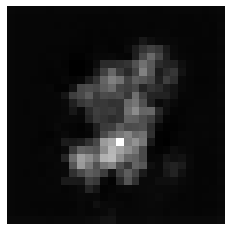

discriminator loss : 0.3640054166316986
Generator loss : [0.738539, 0.0]
(1, 28, 28, 1)
(28, 28)


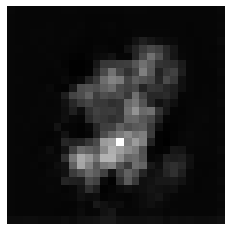

discriminator loss : 1.4164577722549438
Generator loss : [8.034549, 0.0]
(1, 28, 28, 1)
(28, 28)


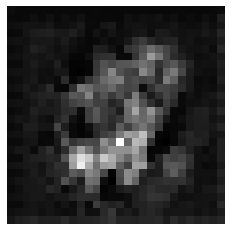

discriminator loss : 0.5882516503334045
Generator loss : [3.3242097, 0.0]
(1, 28, 28, 1)
(28, 28)


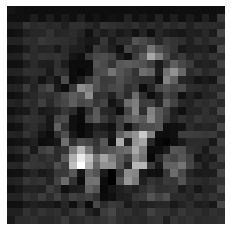

discriminator loss : 0.9401304721832275
Generator loss : [0.5439867, 0.0]
(1, 28, 28, 1)
(28, 28)


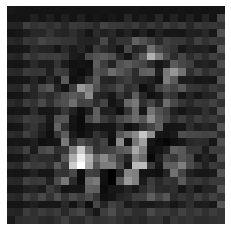

discriminator loss : 1.1235476732254028
Generator loss : [0.4290751, 0.0]
(1, 28, 28, 1)
(28, 28)


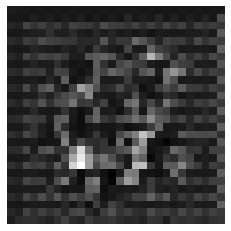

discriminator loss : 0.6693927049636841
Generator loss : [0.47134322, 0.0]
(1, 28, 28, 1)
(28, 28)


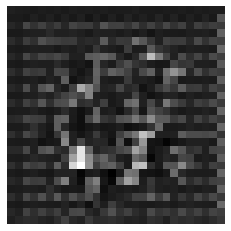

discriminator loss : 0.4737809896469116
Generator loss : [0.5551901, 0.0]
(1, 28, 28, 1)
(28, 28)


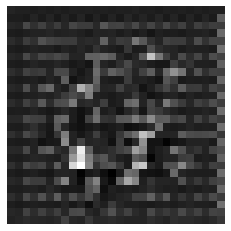

discriminator loss : 0.42869657278060913
Generator loss : [0.6353679, 0.0]
(1, 28, 28, 1)
(28, 28)


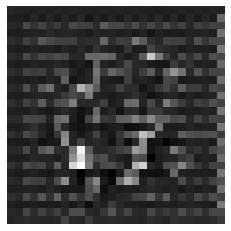

discriminator loss : 0.412547767162323
Generator loss : [0.6080798, 0.0]
(1, 28, 28, 1)
(28, 28)


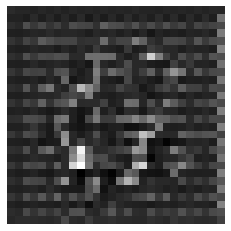

discriminator loss : 0.3913767635822296
Generator loss : [0.5241043, 0.0]
(1, 28, 28, 1)
(28, 28)


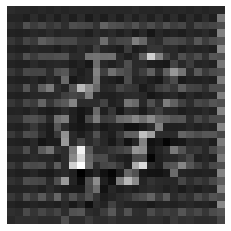

discriminator loss : 0.3774341344833374
Generator loss : [0.46735382, 0.0]
(1, 28, 28, 1)
(28, 28)


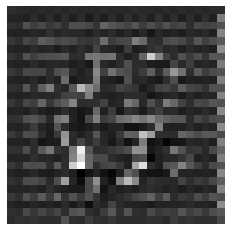

discriminator loss : 0.35685503482818604
Generator loss : [0.44567063, 0.0]
(1, 28, 28, 1)
(28, 28)


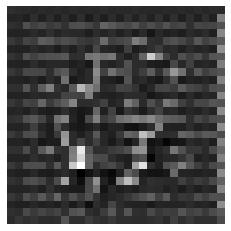

discriminator loss : 0.3523467481136322
Generator loss : [0.43298876, 0.0]
(1, 28, 28, 1)
(28, 28)


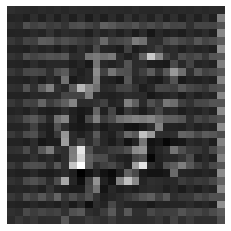

discriminator loss : 0.33852463960647583
Generator loss : [0.41357452, 0.0]
(1, 28, 28, 1)
(28, 28)


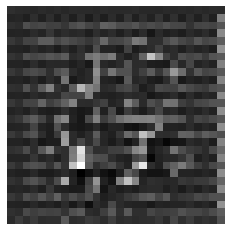

discriminator loss : 0.3555927872657776
Generator loss : [0.4052922, 0.0]
(1, 28, 28, 1)
(28, 28)


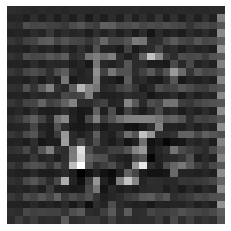

discriminator loss : 0.35096001625061035
Generator loss : [0.3926976, 0.0]
(1, 28, 28, 1)
(28, 28)


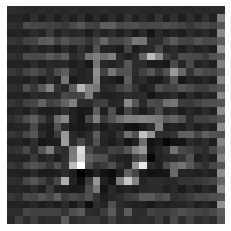

discriminator loss : 0.3343525826931
Generator loss : [0.3840569, 0.0]
(1, 28, 28, 1)
(28, 28)


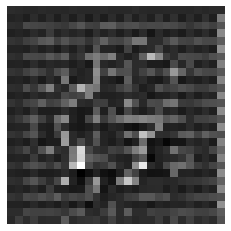

discriminator loss : 0.32745397090911865
Generator loss : [0.35735726, 0.0]
(1, 28, 28, 1)
(28, 28)


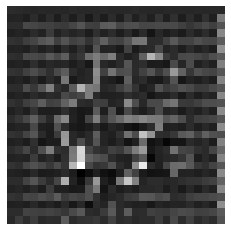

discriminator loss : 0.32670027017593384
Generator loss : [0.33937058, 0.0]
(1, 28, 28, 1)
(28, 28)


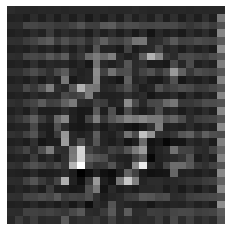

discriminator loss : 0.34798330068588257
Generator loss : [0.36241615, 0.0]
(1, 28, 28, 1)
(28, 28)


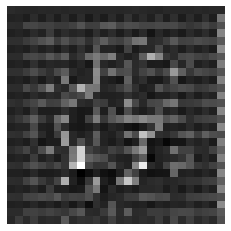

discriminator loss : 0.3219461441040039
Generator loss : [0.35634723, 0.0]
(1, 28, 28, 1)
(28, 28)


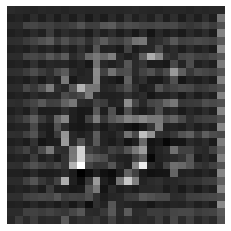

discriminator loss : 0.33763429522514343
Generator loss : [0.34989342, 0.0]
(1, 28, 28, 1)
(28, 28)


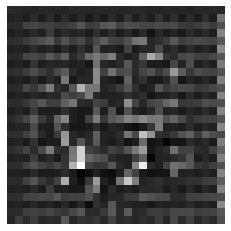

discriminator loss : 0.335718035697937
Generator loss : [0.34580213, 0.0]
(1, 28, 28, 1)
(28, 28)


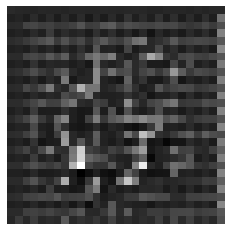

discriminator loss : 0.3301073908805847
Generator loss : [0.3492625, 0.0]
(1, 28, 28, 1)
(28, 28)


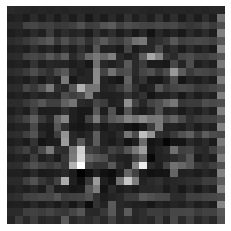

discriminator loss : 0.31610608100891113
Generator loss : [0.34617516, 0.0]
(1, 28, 28, 1)
(28, 28)


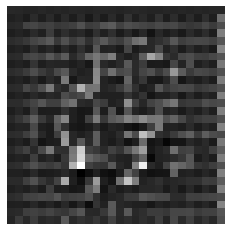

discriminator loss : 0.34423768520355225
Generator loss : [0.35714272, 0.0]
(1, 28, 28, 1)
(28, 28)


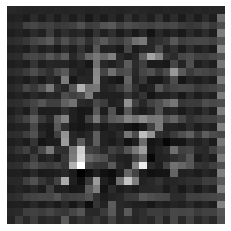

discriminator loss : 0.32577046751976013
Generator loss : [0.33455554, 0.0]
(1, 28, 28, 1)
(28, 28)


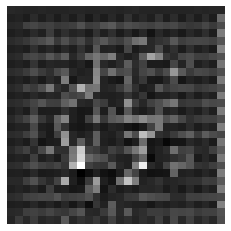

discriminator loss : 0.31744134426116943
Generator loss : [0.3410051, 0.0]
(1, 28, 28, 1)
(28, 28)


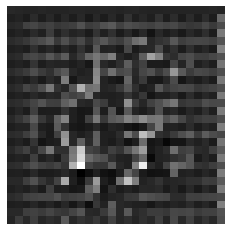

discriminator loss : 0.34364229440689087
Generator loss : [0.34330714, 0.0]
(1, 28, 28, 1)
(28, 28)


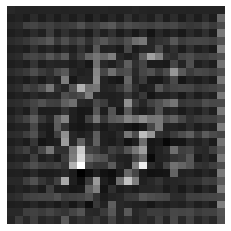

discriminator loss : 0.32781440019607544
Generator loss : [0.33334115, 0.0]
(1, 28, 28, 1)
(28, 28)


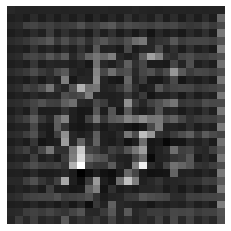

discriminator loss : 0.32260334491729736
Generator loss : [0.32891655, 0.0]
(1, 28, 28, 1)
(28, 28)


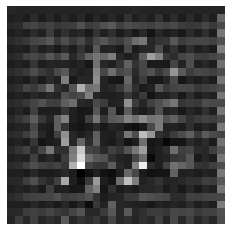

discriminator loss : 0.33897823095321655
Generator loss : [0.35485664, 0.0]
(1, 28, 28, 1)
(28, 28)


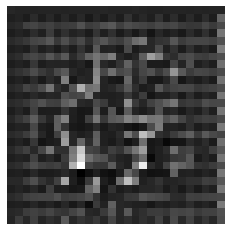

discriminator loss : 0.31430482864379883
Generator loss : [0.3317667, 0.0]
(1, 28, 28, 1)
(28, 28)


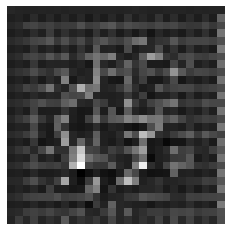

discriminator loss : 0.3347252607345581
Generator loss : [0.34818307, 0.0]
(1, 28, 28, 1)
(28, 28)


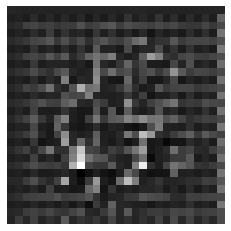

discriminator loss : 0.3191162943840027
Generator loss : [0.3262743, 0.0]
(1, 28, 28, 1)
(28, 28)


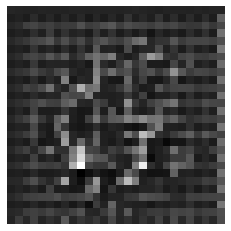

discriminator loss : 0.334613561630249
Generator loss : [0.33440018, 0.0]
(1, 28, 28, 1)
(28, 28)


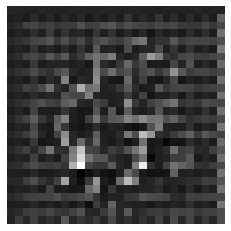

discriminator loss : 0.3376249074935913
Generator loss : [0.3305477, 0.0]
(1, 28, 28, 1)
(28, 28)


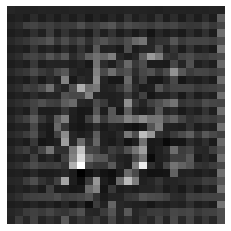

discriminator loss : 0.33884498476982117
Generator loss : [0.3436428, 0.0]
(1, 28, 28, 1)
(28, 28)


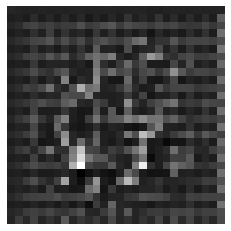

discriminator loss : 0.332095742225647
Generator loss : [0.34764695, 0.0]
(1, 28, 28, 1)
(28, 28)


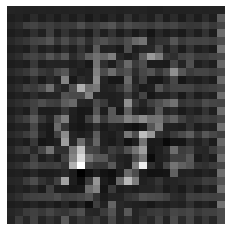

discriminator loss : 0.3336210250854492
Generator loss : [0.3458355, 0.0]
(1, 28, 28, 1)
(28, 28)


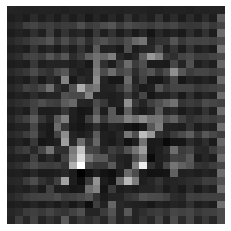

discriminator loss : 0.3404524326324463
Generator loss : [0.3561884, 0.0]
(1, 28, 28, 1)
(28, 28)


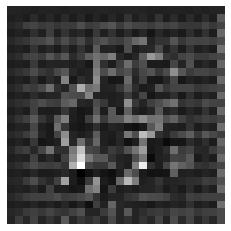

discriminator loss : 0.32656556367874146
Generator loss : [0.3379192, 0.0]
(1, 28, 28, 1)
(28, 28)


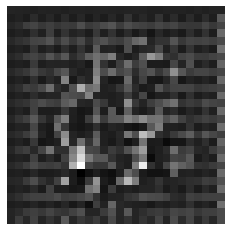

discriminator loss : 0.3177487850189209
Generator loss : [0.31599608, 0.0]
(1, 28, 28, 1)
(28, 28)


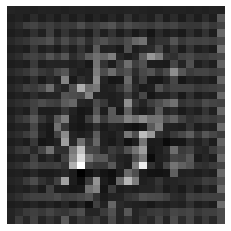

discriminator loss : 0.3353479504585266
Generator loss : [0.34367412, 0.0]
(1, 28, 28, 1)
(28, 28)


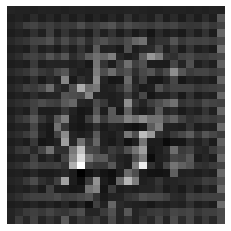

discriminator loss : 0.3316028118133545
Generator loss : [0.34171027, 0.0]
(1, 28, 28, 1)
(28, 28)


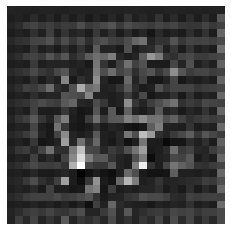

discriminator loss : 0.3306695222854614
Generator loss : [0.33482924, 0.0]
(1, 28, 28, 1)
(28, 28)


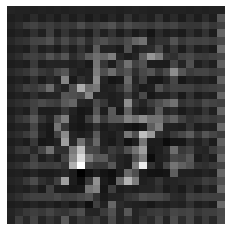

discriminator loss : 0.3401176333427429
Generator loss : [0.32574883, 0.0]
(1, 28, 28, 1)
(28, 28)


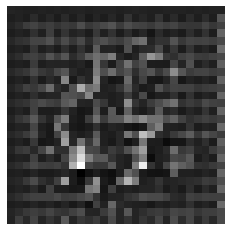

discriminator loss : 0.3294983506202698
Generator loss : [0.3301927, 0.0]
(1, 28, 28, 1)
(28, 28)


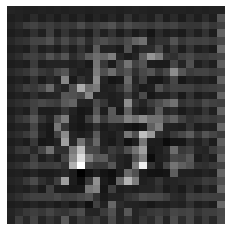

discriminator loss : 0.3203548192977905
Generator loss : [0.3176877, 0.0]
(1, 28, 28, 1)
(28, 28)


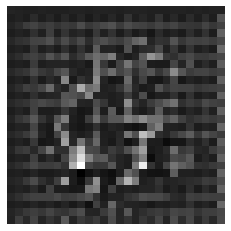

discriminator loss : 0.32851627469062805
Generator loss : [0.3074482, 0.0]
(1, 28, 28, 1)
(28, 28)


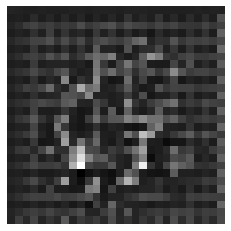

discriminator loss : 0.3320399522781372
Generator loss : [0.32812986, 0.0]
(1, 28, 28, 1)
(28, 28)


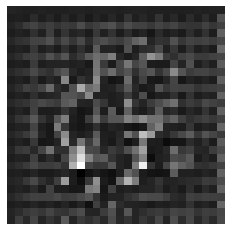

discriminator loss : 0.3425125777721405
Generator loss : [0.34591162, 0.0]
(1, 28, 28, 1)
(28, 28)


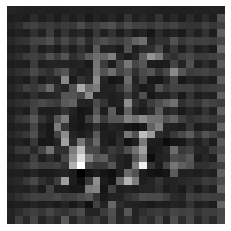

discriminator loss : 0.32289132475852966
Generator loss : [0.31455472, 0.0]
(1, 28, 28, 1)
(28, 28)


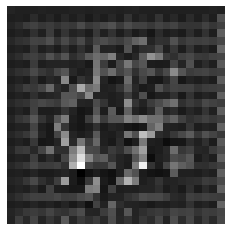

discriminator loss : 0.3283730149269104
Generator loss : [0.32942513, 0.0]
(1, 28, 28, 1)
(28, 28)


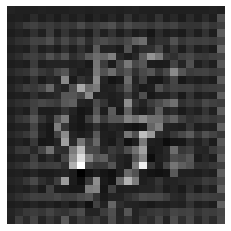

discriminator loss : 0.33378952741622925
Generator loss : [0.3236873, 0.0]
(1, 28, 28, 1)
(28, 28)


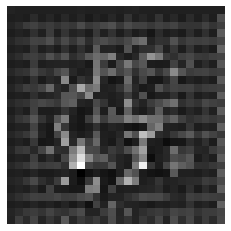

discriminator loss : 0.32459792494773865
Generator loss : [0.32061872, 0.0]
(1, 28, 28, 1)
(28, 28)


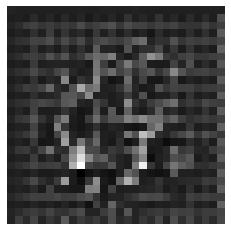

discriminator loss : 0.33103638887405396
Generator loss : [0.32205993, 0.0]
(1, 28, 28, 1)
(28, 28)


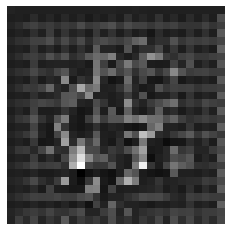

discriminator loss : 0.3258594870567322
Generator loss : [0.32533345, 0.0]
(1, 28, 28, 1)
(28, 28)


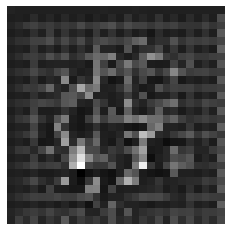

discriminator loss : 0.3393694758415222
Generator loss : [0.3361502, 0.0]
(1, 28, 28, 1)
(28, 28)


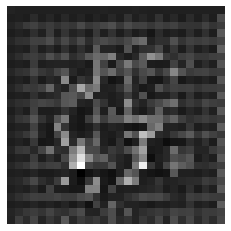

discriminator loss : 0.33704328536987305
Generator loss : [0.31805333, 0.0]
(1, 28, 28, 1)
(28, 28)


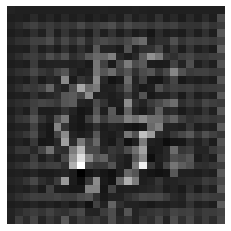

discriminator loss : 0.3249639868736267
Generator loss : [0.33540893, 0.0]
(1, 28, 28, 1)
(28, 28)


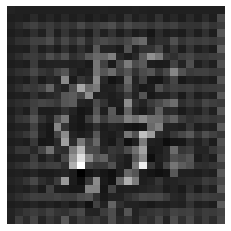

discriminator loss : 0.3308679163455963
Generator loss : [0.34584522, 0.0]
(1, 28, 28, 1)
(28, 28)


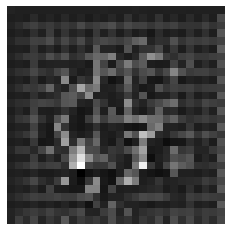

discriminator loss : 0.3501233458518982
Generator loss : [0.34960288, 0.0]
(1, 28, 28, 1)
(28, 28)


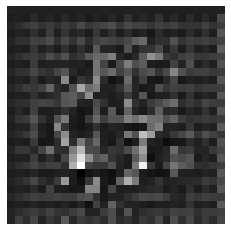

discriminator loss : 0.3153945803642273
Generator loss : [0.32868278, 0.0]
(1, 28, 28, 1)
(28, 28)


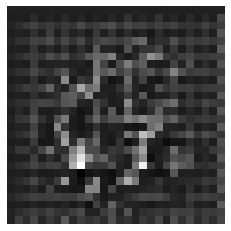

discriminator loss : 0.34252703189849854
Generator loss : [0.32811955, 0.0]
(1, 28, 28, 1)
(28, 28)


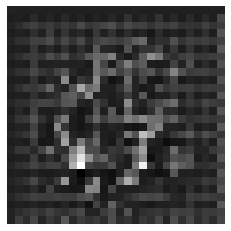

discriminator loss : 0.33188891410827637
Generator loss : [0.34079877, 0.0]
(1, 28, 28, 1)
(28, 28)


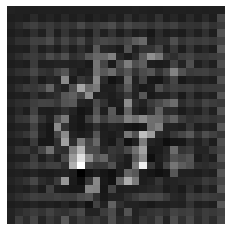

discriminator loss : 0.3234620690345764
Generator loss : [0.32598022, 0.0]
(1, 28, 28, 1)
(28, 28)


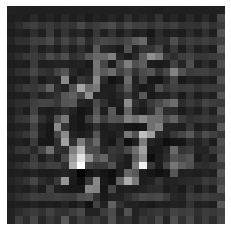

discriminator loss : 0.3415830433368683
Generator loss : [0.34009916, 0.0]
(1, 28, 28, 1)
(28, 28)


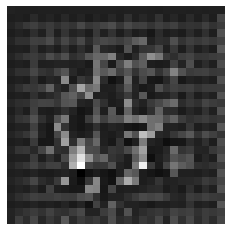

discriminator loss : 0.3239307999610901
Generator loss : [0.31749234, 0.0]
(1, 28, 28, 1)
(28, 28)


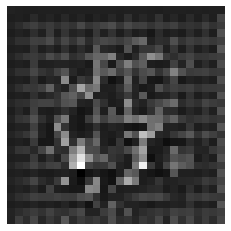

discriminator loss : 0.336880624294281
Generator loss : [0.33670205, 0.0]
(1, 28, 28, 1)
(28, 28)


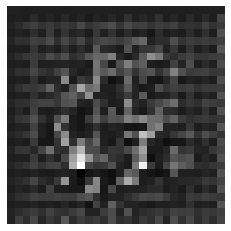

discriminator loss : 0.3319547474384308
Generator loss : [0.3260572, 0.0]
(1, 28, 28, 1)
(28, 28)


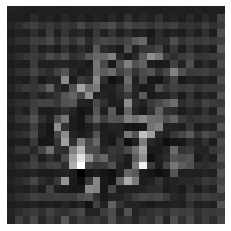

discriminator loss : 0.3272000551223755
Generator loss : [0.3164486, 0.0]
(1, 28, 28, 1)
(28, 28)


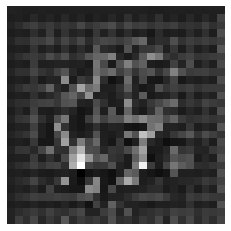

discriminator loss : 0.32426097989082336
Generator loss : [0.32259107, 0.0]
(1, 28, 28, 1)
(28, 28)


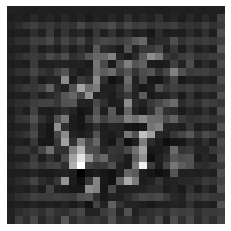

discriminator loss : 0.32731592655181885
Generator loss : [0.32739493, 0.0]
(1, 28, 28, 1)
(28, 28)


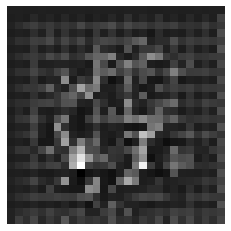

discriminator loss : 0.32470250129699707
Generator loss : [0.3463572, 0.0]
(1, 28, 28, 1)
(28, 28)


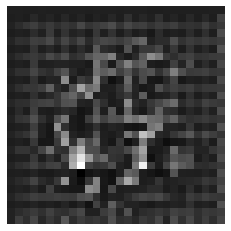

discriminator loss : 0.33910125494003296
Generator loss : [0.3340603, 0.0]
(1, 28, 28, 1)
(28, 28)


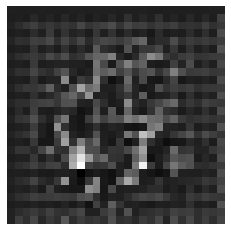

discriminator loss : 0.3183910846710205
Generator loss : [0.32425904, 0.0]
(1, 28, 28, 1)
(28, 28)


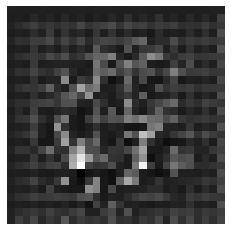

discriminator loss : 0.3245599567890167
Generator loss : [0.3285175, 0.0]
(1, 28, 28, 1)
(28, 28)


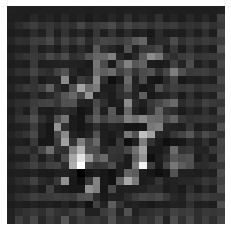

discriminator loss : 0.34191811084747314
Generator loss : [0.32649806, 0.0]
(1, 28, 28, 1)
(28, 28)


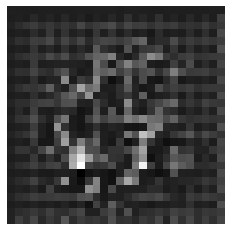

discriminator loss : 0.3253553807735443
Generator loss : [0.33252743, 0.0]
(1, 28, 28, 1)
(28, 28)


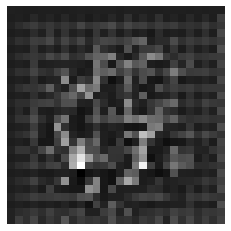

discriminator loss : 0.3211604356765747
Generator loss : [0.32318288, 0.0]
(1, 28, 28, 1)
(28, 28)


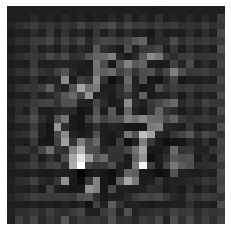

discriminator loss : 0.3051307797431946
Generator loss : [0.3068876, 0.0]
(1, 28, 28, 1)
(28, 28)


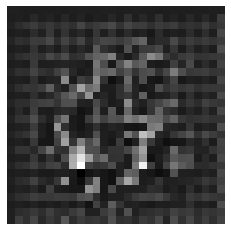

discriminator loss : 0.334661602973938
Generator loss : [0.34108925, 0.0]
(1, 28, 28, 1)
(28, 28)


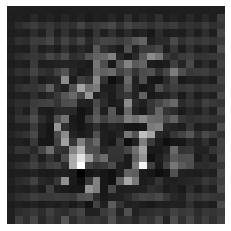

discriminator loss : 0.3291166424751282
Generator loss : [0.32274425, 0.0]
(1, 28, 28, 1)
(28, 28)


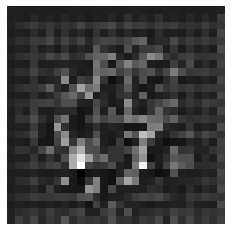

discriminator loss : 0.3116404414176941
Generator loss : [0.3172237, 0.0]
(1, 28, 28, 1)
(28, 28)


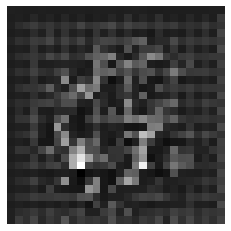

discriminator loss : 0.32952696084976196
Generator loss : [0.3185112, 0.0]
(1, 28, 28, 1)
(28, 28)


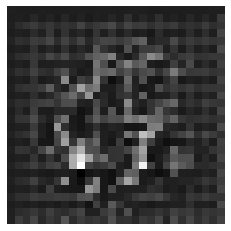

discriminator loss : 0.33090895414352417
Generator loss : [0.3442402, 0.0]
(1, 28, 28, 1)
(28, 28)


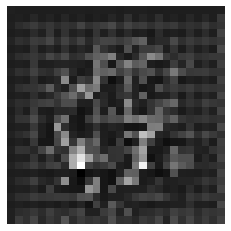

discriminator loss : 0.3427172899246216
Generator loss : [0.35035402, 0.0]
(1, 28, 28, 1)
(28, 28)


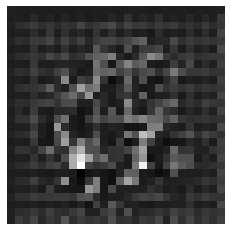

discriminator loss : 0.33764487504959106
Generator loss : [0.35128188, 0.0]
(1, 28, 28, 1)
(28, 28)


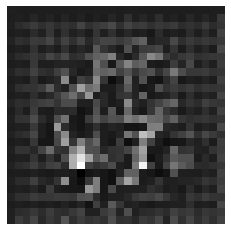

discriminator loss : 0.33581089973449707
Generator loss : [0.3366943, 0.0]
(1, 28, 28, 1)
(28, 28)


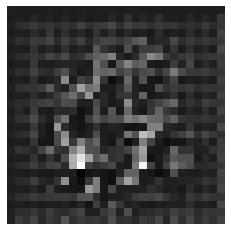

discriminator loss : 0.3326244354248047
Generator loss : [0.3335954, 0.0]
(1, 28, 28, 1)
(28, 28)


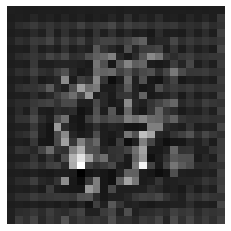

discriminator loss : 0.30753397941589355
Generator loss : [0.316768, 0.0]
(1, 28, 28, 1)
(28, 28)


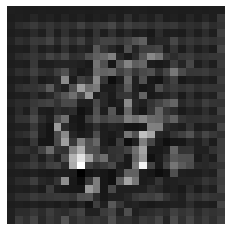

discriminator loss : 0.31934505701065063
Generator loss : [0.32385734, 0.0]
(1, 28, 28, 1)
(28, 28)


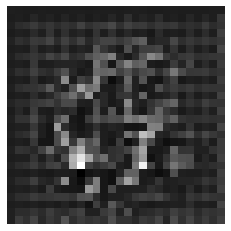

discriminator loss : 0.3279274106025696
Generator loss : [0.31905308, 0.0]
(1, 28, 28, 1)
(28, 28)


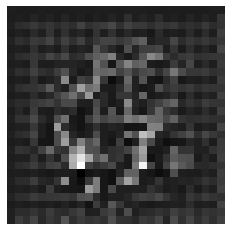

discriminator loss : 0.3177773356437683
Generator loss : [0.32424217, 0.0]
(1, 28, 28, 1)
(28, 28)


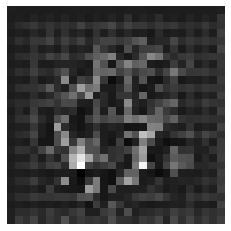

discriminator loss : 0.3374476730823517
Generator loss : [0.3473227, 0.0]
(1, 28, 28, 1)
(28, 28)


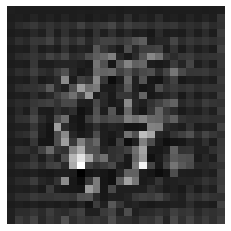

discriminator loss : 0.34371960163116455
Generator loss : [0.33425498, 0.0]
(1, 28, 28, 1)
(28, 28)


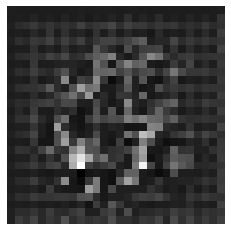

epoch : 2
discriminator loss : 0.33193540573120117
Generator loss : [0.32697722, 0.0]
(1, 28, 28, 1)
(28, 28)


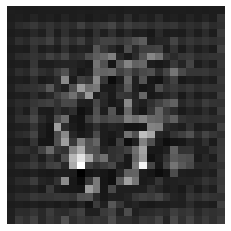

discriminator loss : 0.33868318796157837
Generator loss : [0.345083, 0.0]
(1, 28, 28, 1)
(28, 28)


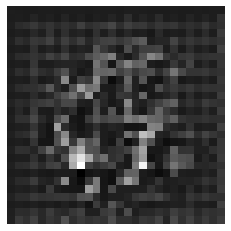

discriminator loss : 0.3406403064727783
Generator loss : [0.35119, 0.0]
(1, 28, 28, 1)
(28, 28)


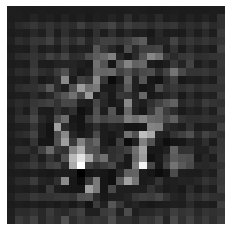

discriminator loss : 0.33689677715301514
Generator loss : [0.34769055, 0.0]
(1, 28, 28, 1)
(28, 28)


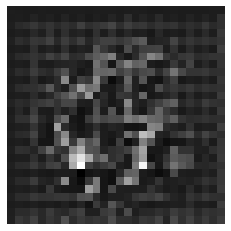

discriminator loss : 0.3367146849632263
Generator loss : [0.31363398, 0.0]
(1, 28, 28, 1)
(28, 28)


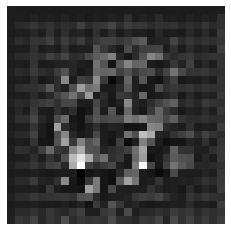

discriminator loss : 0.32567256689071655
Generator loss : [0.33823204, 0.0]
(1, 28, 28, 1)
(28, 28)


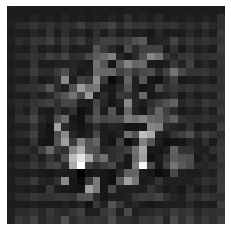

discriminator loss : 0.3279200494289398
Generator loss : [0.33140823, 0.0]
(1, 28, 28, 1)
(28, 28)


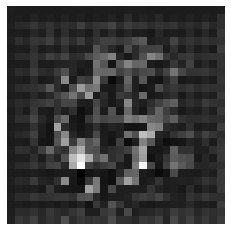

discriminator loss : 0.32690683007240295
Generator loss : [0.32178813, 0.0]
(1, 28, 28, 1)
(28, 28)


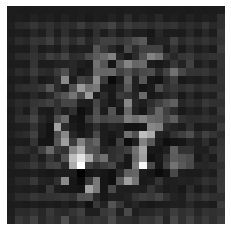

discriminator loss : 0.34172821044921875
Generator loss : [0.3417958, 0.0]
(1, 28, 28, 1)
(28, 28)


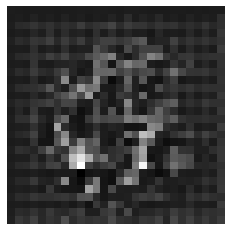

discriminator loss : 0.3252628445625305
Generator loss : [0.32956466, 0.0]
(1, 28, 28, 1)
(28, 28)


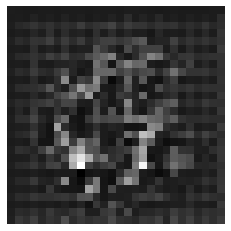

discriminator loss : 0.34002771973609924
Generator loss : [0.3368903, 0.0]
(1, 28, 28, 1)
(28, 28)


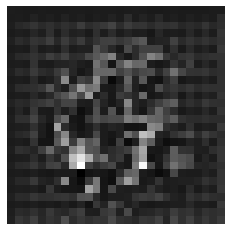

discriminator loss : 0.32842081785202026
Generator loss : [0.313567, 0.0]
(1, 28, 28, 1)
(28, 28)


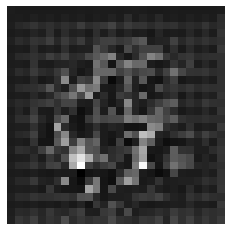

discriminator loss : 0.33278143405914307
Generator loss : [0.33552098, 0.0]
(1, 28, 28, 1)
(28, 28)


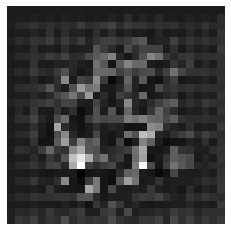

discriminator loss : 0.3431709110736847
Generator loss : [0.33946627, 0.0]
(1, 28, 28, 1)
(28, 28)


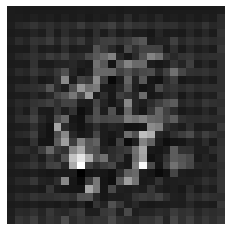

discriminator loss : 0.3326369524002075
Generator loss : [0.33803752, 0.0]
(1, 28, 28, 1)
(28, 28)


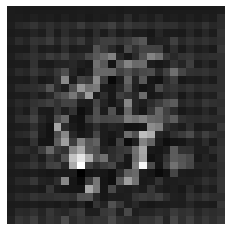

discriminator loss : 0.33497321605682373
Generator loss : [0.32696044, 0.0]
(1, 28, 28, 1)
(28, 28)


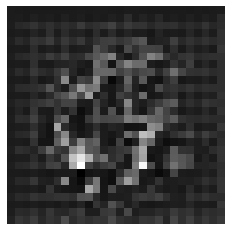

discriminator loss : 0.33617138862609863
Generator loss : [0.34840956, 0.0]
(1, 28, 28, 1)
(28, 28)


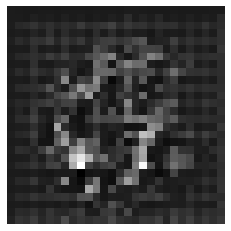

discriminator loss : 0.32442986965179443
Generator loss : [0.3380519, 0.0]
(1, 28, 28, 1)
(28, 28)


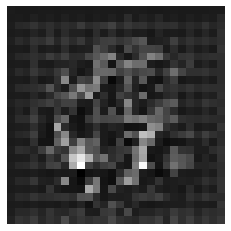

discriminator loss : 0.3464210331439972
Generator loss : [0.34915137, 0.0]
(1, 28, 28, 1)
(28, 28)


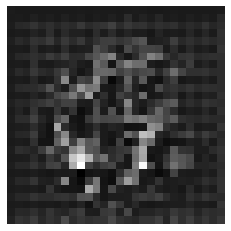

discriminator loss : 0.3174036145210266
Generator loss : [0.31777164, 0.0]
(1, 28, 28, 1)
(28, 28)


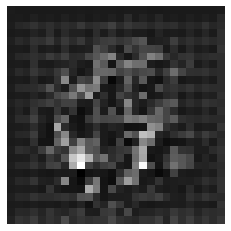

discriminator loss : 0.3316367268562317
Generator loss : [0.3273516, 0.0]
(1, 28, 28, 1)
(28, 28)


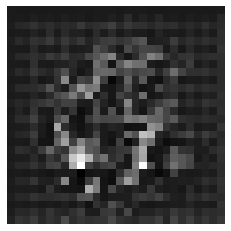

discriminator loss : 0.3404637575149536
Generator loss : [0.35254627, 0.0]
(1, 28, 28, 1)
(28, 28)


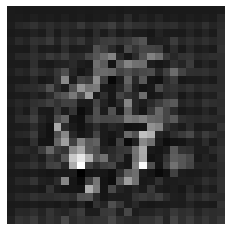

discriminator loss : 0.3311993479728699
Generator loss : [0.34108827, 0.0]
(1, 28, 28, 1)
(28, 28)


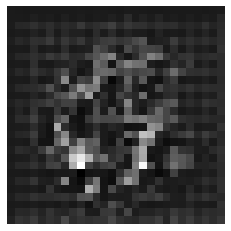

discriminator loss : 0.32725802063941956
Generator loss : [0.33927798, 0.0]
(1, 28, 28, 1)
(28, 28)


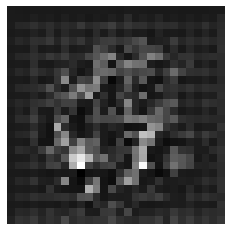

discriminator loss : 0.32856935262680054
Generator loss : [0.32294977, 0.0]
(1, 28, 28, 1)
(28, 28)


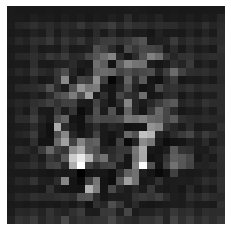

discriminator loss : 0.3288572430610657
Generator loss : [0.33489987, 0.0]
(1, 28, 28, 1)
(28, 28)


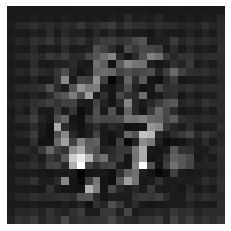

discriminator loss : 0.32098132371902466
Generator loss : [0.3402947, 0.0]
(1, 28, 28, 1)
(28, 28)


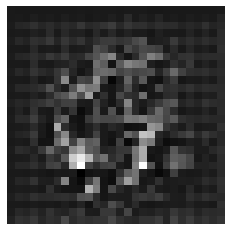

discriminator loss : 0.32684582471847534
Generator loss : [0.3187263, 0.0]
(1, 28, 28, 1)
(28, 28)


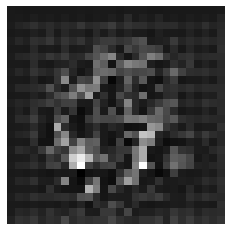

discriminator loss : 0.3354024291038513
Generator loss : [0.34402725, 0.0]
(1, 28, 28, 1)
(28, 28)


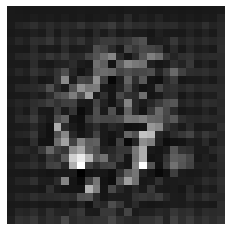

discriminator loss : 0.32906606793403625
Generator loss : [0.33421013, 0.0]
(1, 28, 28, 1)
(28, 28)


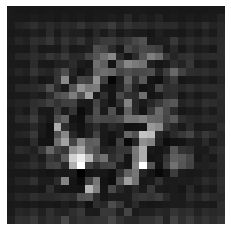

discriminator loss : 0.33342471718788147
Generator loss : [0.3473607, 0.0]
(1, 28, 28, 1)
(28, 28)


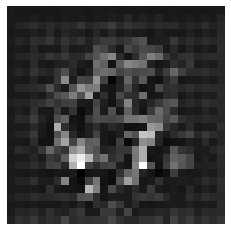

discriminator loss : 0.34232446551322937
Generator loss : [0.34192225, 0.0]
(1, 28, 28, 1)
(28, 28)


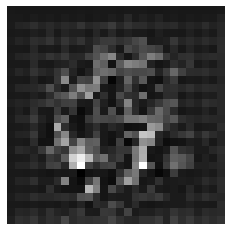

discriminator loss : 0.3332896828651428
Generator loss : [0.33311912, 0.0]
(1, 28, 28, 1)
(28, 28)


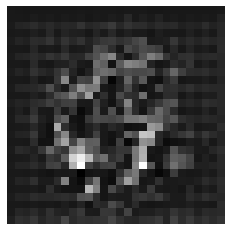

discriminator loss : 0.3488491177558899
Generator loss : [0.3596999, 0.0]
(1, 28, 28, 1)
(28, 28)


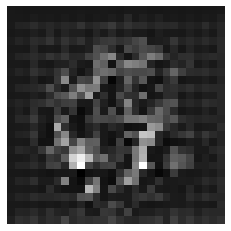

discriminator loss : 0.3306441307067871
Generator loss : [0.33658418, 0.0]
(1, 28, 28, 1)
(28, 28)


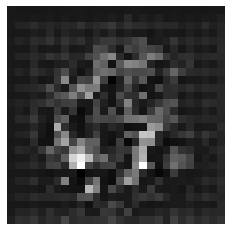

discriminator loss : 0.33652275800704956
Generator loss : [0.32922006, 0.0]
(1, 28, 28, 1)
(28, 28)


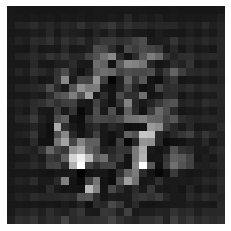

discriminator loss : 0.32158809900283813
Generator loss : [0.33111817, 0.0]
(1, 28, 28, 1)
(28, 28)


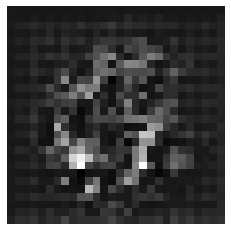

discriminator loss : 0.33749091625213623
Generator loss : [0.34212005, 0.0]
(1, 28, 28, 1)
(28, 28)


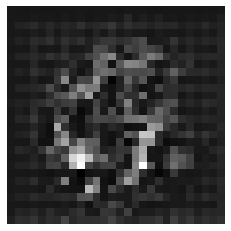

discriminator loss : 0.33313989639282227
Generator loss : [0.35265714, 0.0]
(1, 28, 28, 1)
(28, 28)


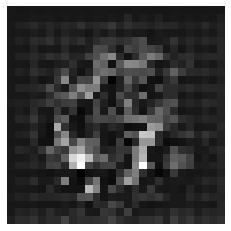

discriminator loss : 0.32756394147872925
Generator loss : [0.33098713, 0.0]
(1, 28, 28, 1)
(28, 28)


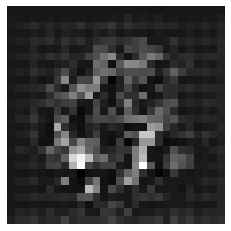

discriminator loss : 0.3483928442001343
Generator loss : [0.35505742, 0.0]
(1, 28, 28, 1)
(28, 28)


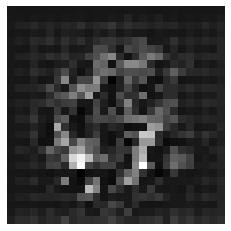

discriminator loss : 0.3419821858406067
Generator loss : [0.3416255, 0.0]
(1, 28, 28, 1)
(28, 28)


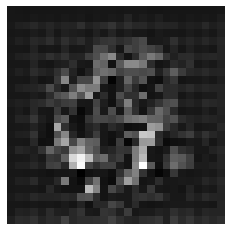

discriminator loss : 0.3481803834438324
Generator loss : [0.34899312, 0.0]
(1, 28, 28, 1)
(28, 28)


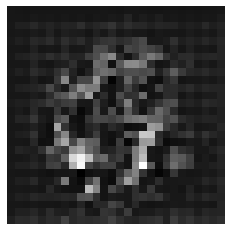

discriminator loss : 0.3322290778160095
Generator loss : [0.33452705, 0.0]
(1, 28, 28, 1)
(28, 28)


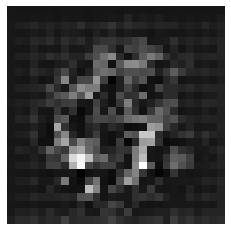

discriminator loss : 0.3474193811416626
Generator loss : [0.35372517, 0.0]
(1, 28, 28, 1)
(28, 28)


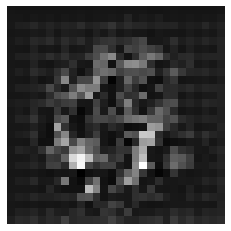

discriminator loss : 0.3266030550003052
Generator loss : [0.32327056, 0.0]
(1, 28, 28, 1)
(28, 28)


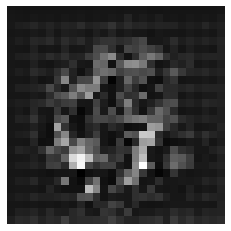

discriminator loss : 0.34652477502822876
Generator loss : [0.36038104, 0.0]
(1, 28, 28, 1)
(28, 28)


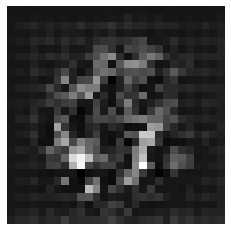

discriminator loss : 0.3459310233592987
Generator loss : [0.3403735, 0.0]
(1, 28, 28, 1)
(28, 28)


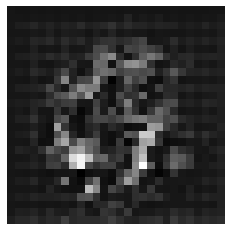

discriminator loss : 0.3476884961128235
Generator loss : [0.35242862, 0.0]
(1, 28, 28, 1)
(28, 28)


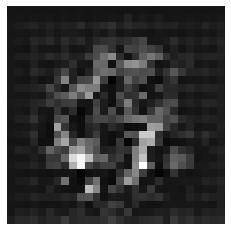

discriminator loss : 0.3771919012069702
Generator loss : [0.35608894, 0.0]
(1, 28, 28, 1)
(28, 28)


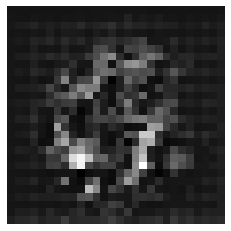

discriminator loss : 0.34976014494895935
Generator loss : [0.35489732, 0.0]
(1, 28, 28, 1)
(28, 28)


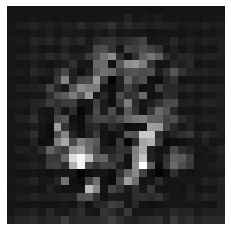

discriminator loss : 0.33190327882766724
Generator loss : [0.36403304, 0.0]
(1, 28, 28, 1)
(28, 28)


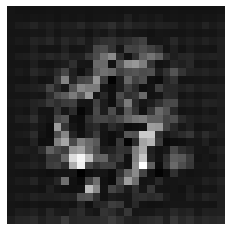

discriminator loss : 0.32490772008895874
Generator loss : [0.34513974, 0.0]
(1, 28, 28, 1)
(28, 28)


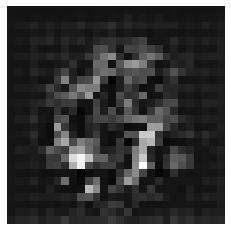

discriminator loss : 0.3410792350769043
Generator loss : [0.34295395, 0.0]
(1, 28, 28, 1)
(28, 28)


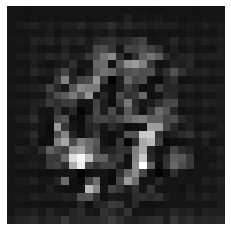

discriminator loss : 0.3302828073501587
Generator loss : [0.35011742, 0.0]
(1, 28, 28, 1)
(28, 28)


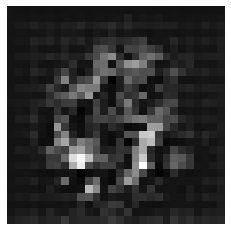

discriminator loss : 0.3284209966659546
Generator loss : [0.33809626, 0.0]
(1, 28, 28, 1)
(28, 28)


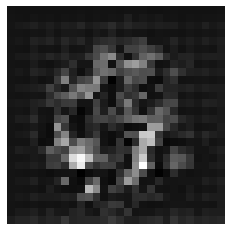

discriminator loss : 0.3501754105091095
Generator loss : [0.35111496, 0.0]
(1, 28, 28, 1)
(28, 28)


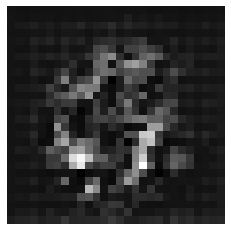

discriminator loss : 0.3446093797683716
Generator loss : [0.37465522, 0.0]
(1, 28, 28, 1)
(28, 28)


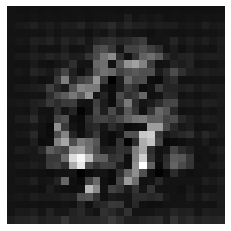

discriminator loss : 0.3403378129005432
Generator loss : [0.33730328, 0.0]
(1, 28, 28, 1)
(28, 28)


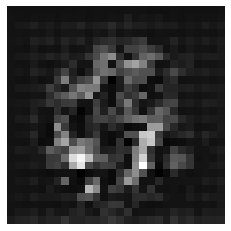

discriminator loss : 0.3378594219684601
Generator loss : [0.3427597, 0.0]
(1, 28, 28, 1)
(28, 28)


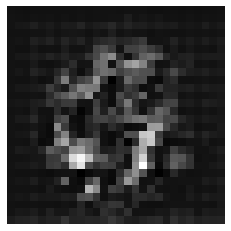

discriminator loss : 0.34737107157707214
Generator loss : [0.35944176, 0.0]
(1, 28, 28, 1)
(28, 28)


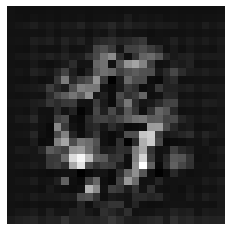

discriminator loss : 0.34016406536102295
Generator loss : [0.34448695, 0.0]
(1, 28, 28, 1)
(28, 28)


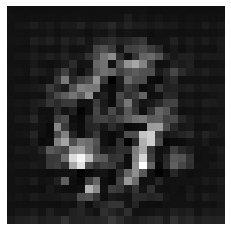

discriminator loss : 0.328948974609375
Generator loss : [0.3375138, 0.0]
(1, 28, 28, 1)
(28, 28)


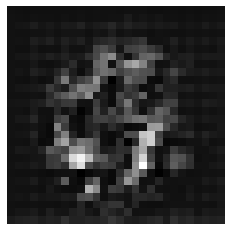

discriminator loss : 0.33731913566589355
Generator loss : [0.34865177, 0.0]
(1, 28, 28, 1)
(28, 28)


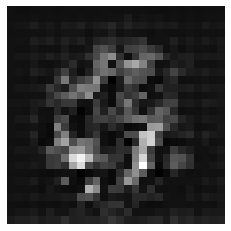

discriminator loss : 0.3456922173500061
Generator loss : [0.35129347, 0.0]
(1, 28, 28, 1)
(28, 28)


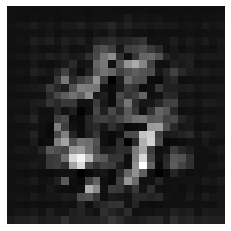

discriminator loss : 0.343839555978775
Generator loss : [0.34502834, 0.0]
(1, 28, 28, 1)
(28, 28)


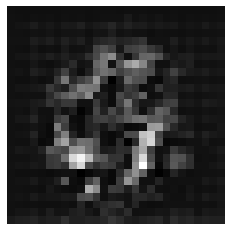

discriminator loss : 0.33983534574508667
Generator loss : [0.34623387, 0.0]
(1, 28, 28, 1)
(28, 28)


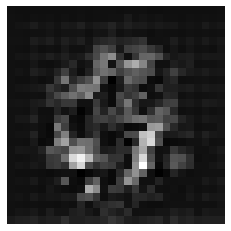

discriminator loss : 0.37092822790145874
Generator loss : [0.35988975, 0.0]
(1, 28, 28, 1)
(28, 28)


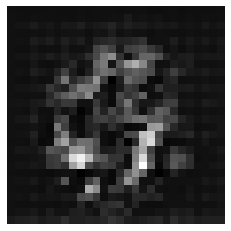

discriminator loss : 0.35281482338905334
Generator loss : [0.34191293, 0.0]
(1, 28, 28, 1)
(28, 28)


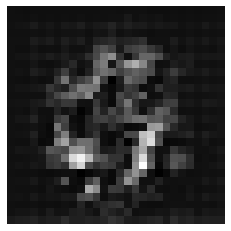

discriminator loss : 0.34471410512924194
Generator loss : [0.33623385, 0.0]
(1, 28, 28, 1)
(28, 28)


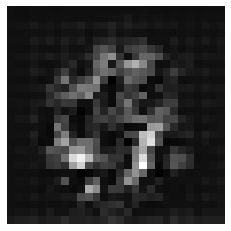

discriminator loss : 0.3368624448776245
Generator loss : [0.33272147, 0.0]
(1, 28, 28, 1)
(28, 28)


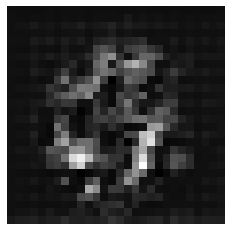

discriminator loss : 0.34422987699508667
Generator loss : [0.3309494, 0.0]
(1, 28, 28, 1)
(28, 28)


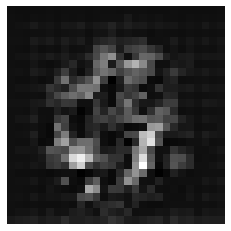

discriminator loss : 0.34061169624328613
Generator loss : [0.34285903, 0.0]
(1, 28, 28, 1)
(28, 28)


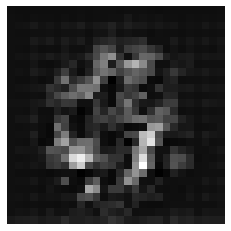

discriminator loss : 0.3899490237236023
Generator loss : [0.34533435, 0.0]
(1, 28, 28, 1)
(28, 28)


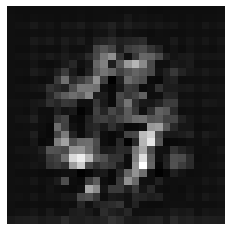

discriminator loss : 0.32616591453552246
Generator loss : [0.33457536, 0.0]
(1, 28, 28, 1)
(28, 28)


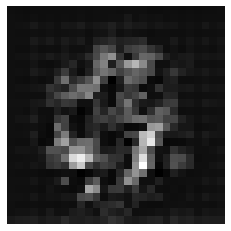

discriminator loss : 0.3455023765563965
Generator loss : [0.33076823, 0.0]
(1, 28, 28, 1)
(28, 28)


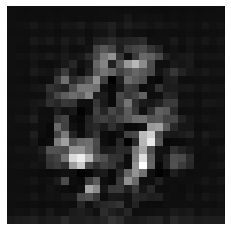

discriminator loss : 0.33141225576400757
Generator loss : [0.34314942, 0.0]
(1, 28, 28, 1)
(28, 28)


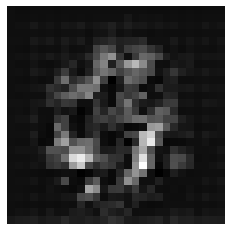

discriminator loss : 0.3384348154067993
Generator loss : [0.3358431, 0.0]
(1, 28, 28, 1)
(28, 28)


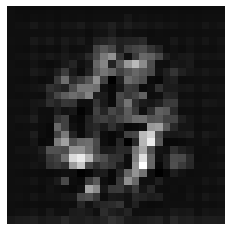

discriminator loss : 0.3507837653160095
Generator loss : [0.33812308, 0.0]
(1, 28, 28, 1)
(28, 28)


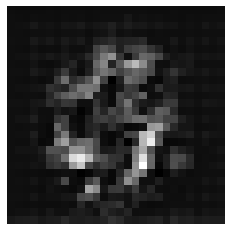

discriminator loss : 0.33543306589126587
Generator loss : [0.3285501, 0.0]
(1, 28, 28, 1)
(28, 28)


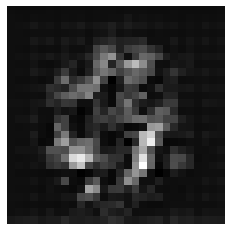

discriminator loss : 0.33630216121673584
Generator loss : [0.3190256, 0.0]
(1, 28, 28, 1)
(28, 28)


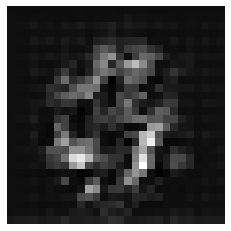

discriminator loss : 0.3338361978530884
Generator loss : [0.33663353, 0.0]
(1, 28, 28, 1)
(28, 28)


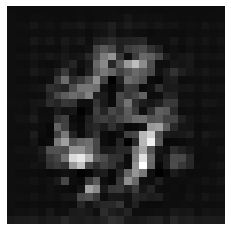

discriminator loss : 0.3442106544971466
Generator loss : [0.34318283, 0.0]
(1, 28, 28, 1)
(28, 28)


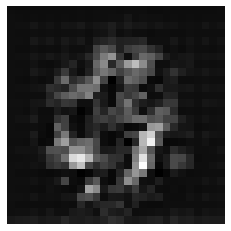

discriminator loss : 0.3434411883354187
Generator loss : [0.32699636, 0.0]
(1, 28, 28, 1)
(28, 28)


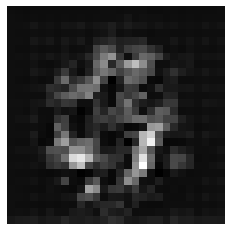

discriminator loss : 0.3353903889656067
Generator loss : [0.32610497, 0.0]
(1, 28, 28, 1)
(28, 28)


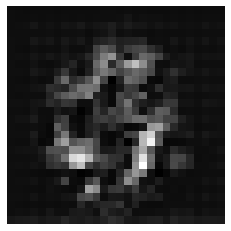

discriminator loss : 0.34171420335769653
Generator loss : [0.34274566, 0.0]
(1, 28, 28, 1)
(28, 28)


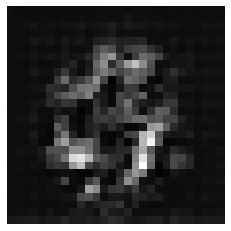

discriminator loss : 0.3422253727912903
Generator loss : [0.3397605, 0.0]
(1, 28, 28, 1)
(28, 28)


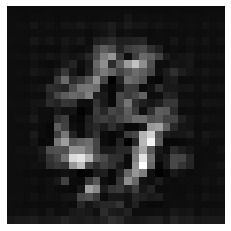

discriminator loss : 0.34506237506866455
Generator loss : [0.35853633, 0.0]
(1, 28, 28, 1)
(28, 28)


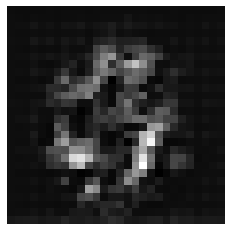

discriminator loss : 0.3407742977142334
Generator loss : [0.3325582, 0.0]
(1, 28, 28, 1)
(28, 28)


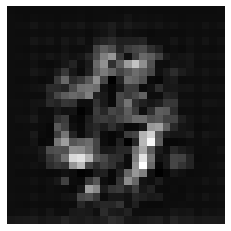

discriminator loss : 0.3319566249847412
Generator loss : [0.3158449, 0.0]
(1, 28, 28, 1)
(28, 28)


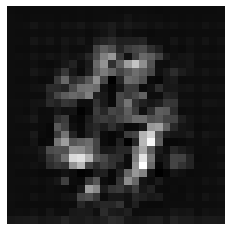

discriminator loss : 0.35930293798446655
Generator loss : [0.3485272, 0.0]
(1, 28, 28, 1)
(28, 28)


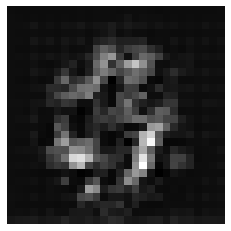

discriminator loss : 0.3730010986328125
Generator loss : [0.35257518, 0.0]
(1, 28, 28, 1)
(28, 28)


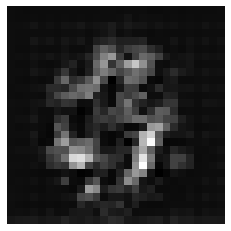

discriminator loss : 0.3799440860748291
Generator loss : [0.3260103, 0.0]
(1, 28, 28, 1)
(28, 28)


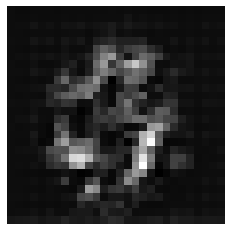

discriminator loss : 0.34212231636047363
Generator loss : [0.3336878, 0.0]
(1, 28, 28, 1)
(28, 28)


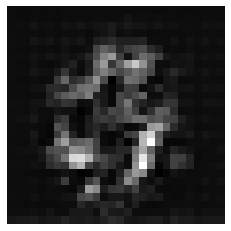

discriminator loss : 0.3397393822669983
Generator loss : [0.330109, 0.0]
(1, 28, 28, 1)
(28, 28)


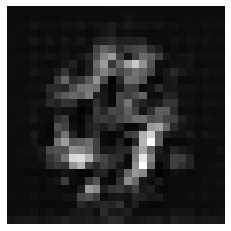

discriminator loss : 0.35496336221694946
Generator loss : [0.32046893, 0.0]
(1, 28, 28, 1)
(28, 28)


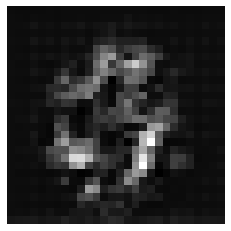

discriminator loss : 0.33315184712409973
Generator loss : [0.31972092, 0.0]
(1, 28, 28, 1)
(28, 28)


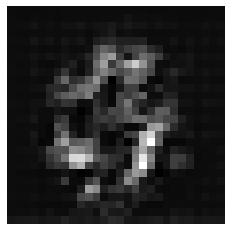

discriminator loss : 0.3440472483634949
Generator loss : [0.33031937, 0.0]
(1, 28, 28, 1)
(28, 28)


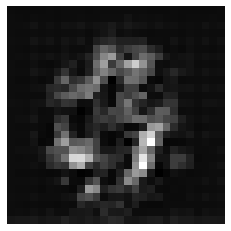

discriminator loss : 0.3482106328010559
Generator loss : [0.32599637, 0.0]
(1, 28, 28, 1)
(28, 28)


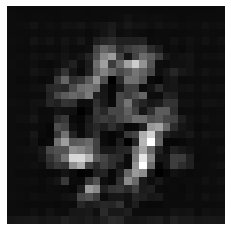

discriminator loss : 0.34442955255508423
Generator loss : [0.33103368, 0.0]
(1, 28, 28, 1)
(28, 28)


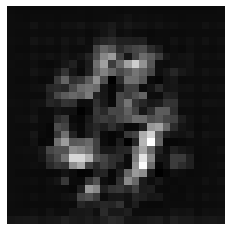

discriminator loss : 0.33571359515190125
Generator loss : [0.3225561, 0.0]
(1, 28, 28, 1)
(28, 28)


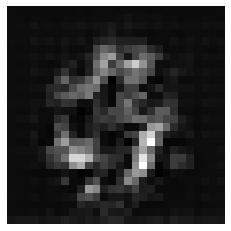

discriminator loss : 0.3450656533241272
Generator loss : [0.35207447, 0.0]
(1, 28, 28, 1)
(28, 28)


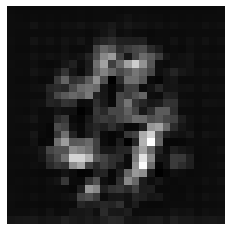

discriminator loss : 0.3383864164352417
Generator loss : [0.32603127, 0.0]
(1, 28, 28, 1)
(28, 28)


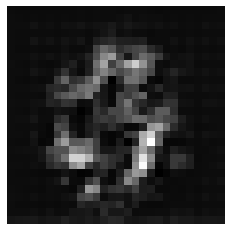

discriminator loss : 0.35397785902023315
Generator loss : [0.33874473, 0.0]
(1, 28, 28, 1)
(28, 28)


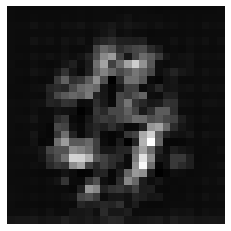

discriminator loss : 0.33654892444610596
Generator loss : [0.33453545, 0.0]
(1, 28, 28, 1)
(28, 28)


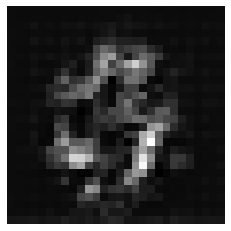

discriminator loss : 0.3399011194705963
Generator loss : [0.3460861, 0.0]
(1, 28, 28, 1)
(28, 28)


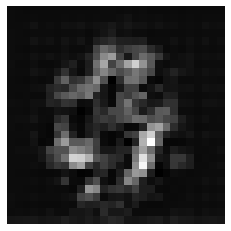

discriminator loss : 0.37466198205947876
Generator loss : [0.36856335, 0.0]
(1, 28, 28, 1)
(28, 28)


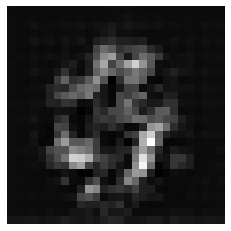

discriminator loss : 0.3606190085411072
Generator loss : [0.3562486, 0.0]
(1, 28, 28, 1)
(28, 28)


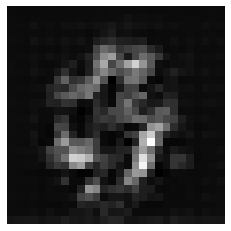

discriminator loss : 0.3445223271846771
Generator loss : [0.34304902, 0.0]
(1, 28, 28, 1)
(28, 28)


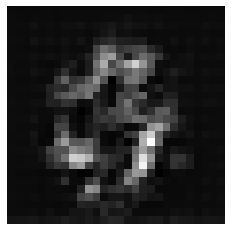

discriminator loss : 0.34752893447875977
Generator loss : [0.34341645, 0.0]
(1, 28, 28, 1)
(28, 28)


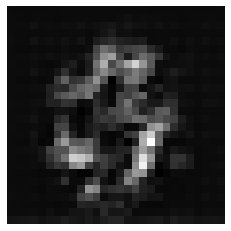

discriminator loss : 0.32845932245254517
Generator loss : [0.35914207, 0.0]
(1, 28, 28, 1)
(28, 28)


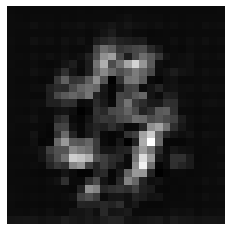

discriminator loss : 0.38188546895980835
Generator loss : [0.38094002, 0.0]
(1, 28, 28, 1)
(28, 28)


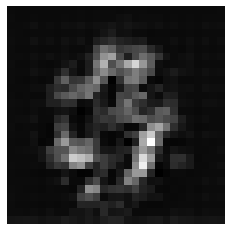

discriminator loss : 0.39301005005836487
Generator loss : [0.3894261, 0.0]
(1, 28, 28, 1)
(28, 28)


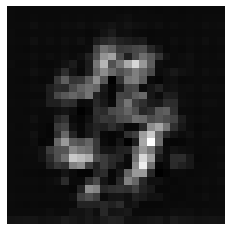

discriminator loss : 0.41319820284843445
Generator loss : [0.42677638, 0.0]
(1, 28, 28, 1)
(28, 28)


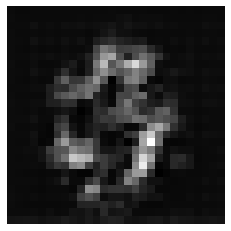

discriminator loss : 0.5207390785217285
Generator loss : [0.5878073, 0.0]
(1, 28, 28, 1)
(28, 28)


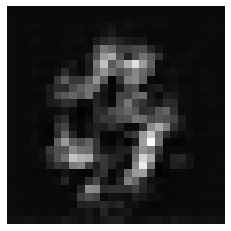

discriminator loss : 0.9185467958450317
Generator loss : [1.2885784, 0.0]
(1, 28, 28, 1)
(28, 28)


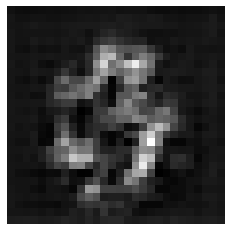

discriminator loss : 0.8327468633651733
Generator loss : [0.4526735, 0.0]
(1, 28, 28, 1)
(28, 28)


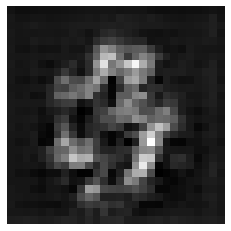

discriminator loss : 0.3894859254360199
Generator loss : [0.8447329, 0.0]
(1, 28, 28, 1)
(28, 28)


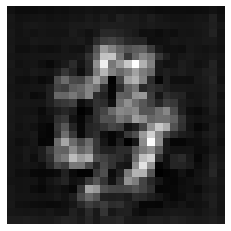

discriminator loss : 0.43785360455513
Generator loss : [1.5745038, 0.0]
(1, 28, 28, 1)
(28, 28)


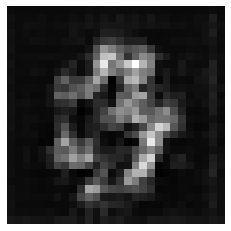

discriminator loss : 0.9550799131393433
Generator loss : [2.4558213, 0.0]
(1, 28, 28, 1)
(28, 28)


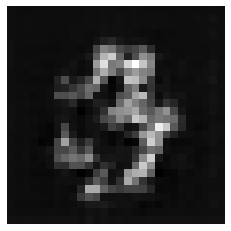

discriminator loss : 0.9638451337814331
Generator loss : [1.3985367, 0.0]
(1, 28, 28, 1)
(28, 28)


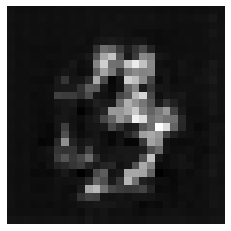

discriminator loss : 0.5576467514038086
Generator loss : [1.7569709, 0.0]
(1, 28, 28, 1)
(28, 28)


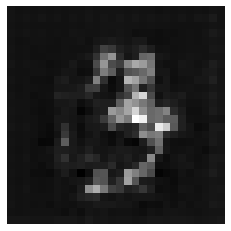

discriminator loss : 0.6804327368736267
Generator loss : [1.6457859, 0.0]
(1, 28, 28, 1)
(28, 28)


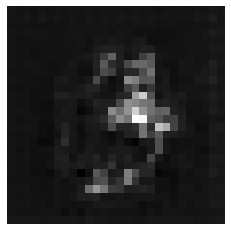

discriminator loss : 0.7130656242370605
Generator loss : [1.5251982, 0.0]
(1, 28, 28, 1)
(28, 28)


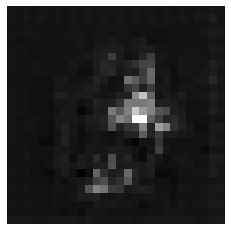

discriminator loss : 0.6611708402633667
Generator loss : [1.4572452, 0.0]
(1, 28, 28, 1)
(28, 28)


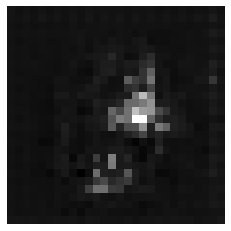

discriminator loss : 0.49732309579849243
Generator loss : [1.7142525, 0.0]
(1, 28, 28, 1)
(28, 28)


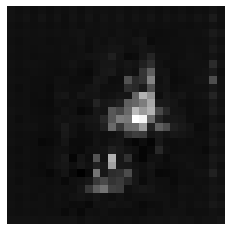

discriminator loss : 0.48142510652542114
Generator loss : [2.2284036, 0.0]
(1, 28, 28, 1)
(28, 28)


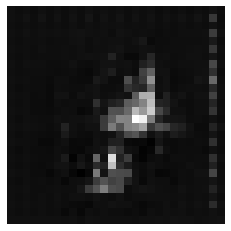

discriminator loss : 0.8320460319519043
Generator loss : [3.9601412, 0.0]
(1, 28, 28, 1)
(28, 28)


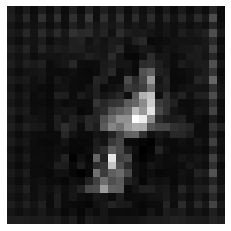

discriminator loss : 1.4795981645584106
Generator loss : [4.3180437, 0.0]
(1, 28, 28, 1)
(28, 28)


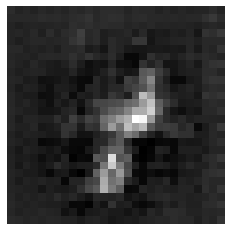

discriminator loss : 0.3701220154762268
Generator loss : [0.89788437, 0.0]
(1, 28, 28, 1)
(28, 28)


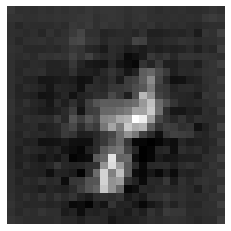

discriminator loss : 0.3698456883430481
Generator loss : [0.8343374, 0.0]
(1, 28, 28, 1)
(28, 28)


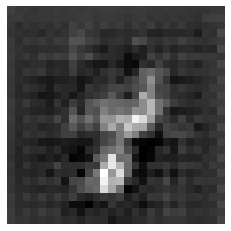

discriminator loss : 0.47431695461273193
Generator loss : [0.57460546, 0.0]
(1, 28, 28, 1)
(28, 28)


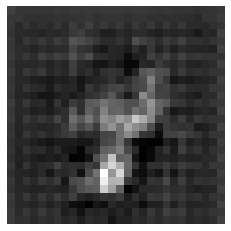

discriminator loss : 0.4154273271560669
Generator loss : [0.34699333, 0.0]
(1, 28, 28, 1)
(28, 28)


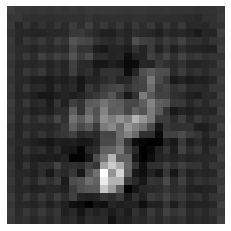

discriminator loss : 0.3720649480819702
Generator loss : [0.31665748, 0.0]
(1, 28, 28, 1)
(28, 28)


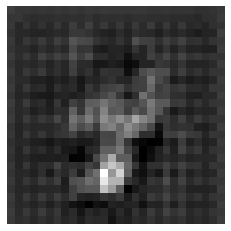

discriminator loss : 0.3715364336967468
Generator loss : [0.36806008, 0.0]
(1, 28, 28, 1)
(28, 28)


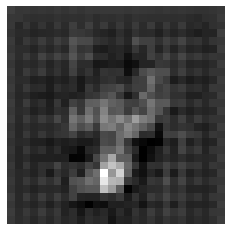

discriminator loss : 0.39300137758255005
Generator loss : [0.35709995, 0.0]
(1, 28, 28, 1)
(28, 28)


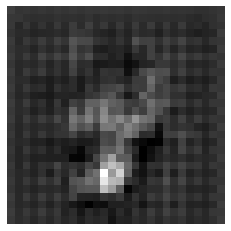

discriminator loss : 0.5276443362236023
Generator loss : [0.35340756, 0.0]
(1, 28, 28, 1)
(28, 28)


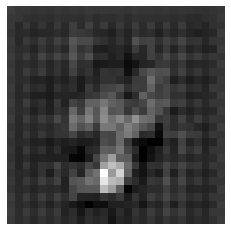

discriminator loss : 0.34633809328079224
Generator loss : [0.41691548, 0.0]
(1, 28, 28, 1)
(28, 28)


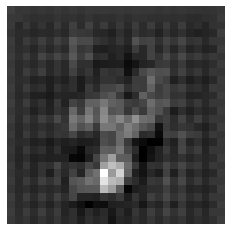

discriminator loss : 0.3701847493648529
Generator loss : [0.33439583, 0.0]
(1, 28, 28, 1)
(28, 28)


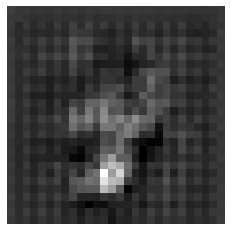

discriminator loss : 0.4645704925060272
Generator loss : [0.33653986, 0.0]
(1, 28, 28, 1)
(28, 28)


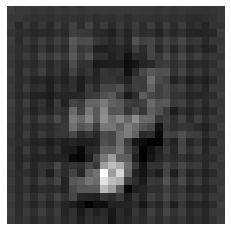

discriminator loss : 0.34717610478401184
Generator loss : [0.32713675, 0.0]
(1, 28, 28, 1)
(28, 28)


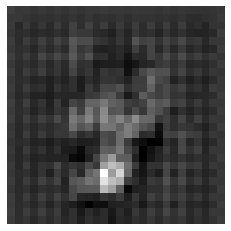

discriminator loss : 0.35997897386550903
Generator loss : [0.33744675, 0.0]
(1, 28, 28, 1)
(28, 28)


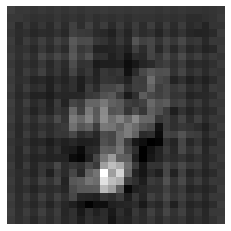

discriminator loss : 0.33225932717323303
Generator loss : [0.32277724, 0.0]
(1, 28, 28, 1)
(28, 28)


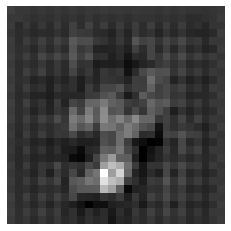

discriminator loss : 0.3377665877342224
Generator loss : [0.35377118, 0.0]
(1, 28, 28, 1)
(28, 28)


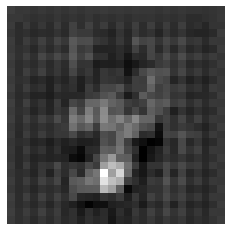

discriminator loss : 0.32543832063674927
Generator loss : [0.2999916, 0.0]
(1, 28, 28, 1)
(28, 28)


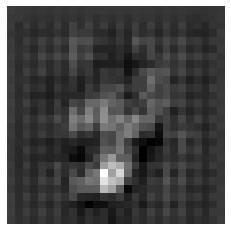

discriminator loss : 0.3669547438621521
Generator loss : [0.42230934, 0.0]
(1, 28, 28, 1)
(28, 28)


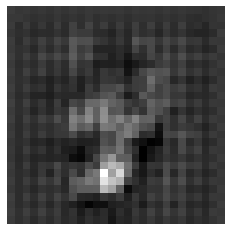

discriminator loss : 0.3624017834663391
Generator loss : [0.3415503, 0.0]
(1, 28, 28, 1)
(28, 28)


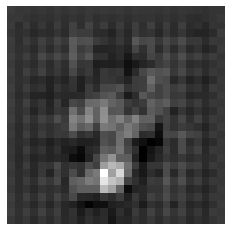

discriminator loss : 0.34268176555633545
Generator loss : [0.49686646, 0.0]
(1, 28, 28, 1)
(28, 28)


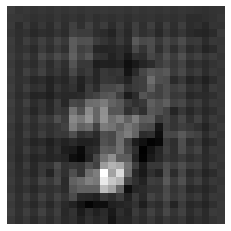

discriminator loss : 0.36618196964263916
Generator loss : [0.31944576, 0.0]
(1, 28, 28, 1)
(28, 28)


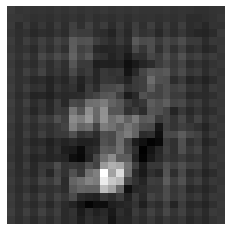

discriminator loss : 0.38892388343811035
Generator loss : [0.7434249, 0.0]
(1, 28, 28, 1)
(28, 28)


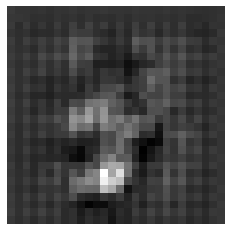

discriminator loss : 0.4158296585083008
Generator loss : [0.41623744, 0.0]
(1, 28, 28, 1)
(28, 28)


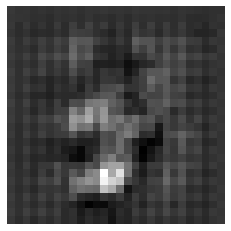

discriminator loss : 0.35976511240005493
Generator loss : [0.47763842, 0.0]
(1, 28, 28, 1)
(28, 28)


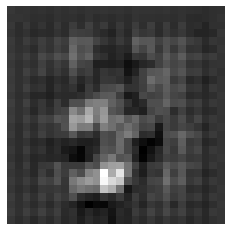

discriminator loss : 0.3405013680458069
Generator loss : [0.3344301, 0.0]
(1, 28, 28, 1)
(28, 28)


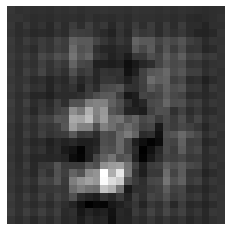

discriminator loss : 0.3970297574996948
Generator loss : [1.3889863, 0.0]
(1, 28, 28, 1)
(28, 28)


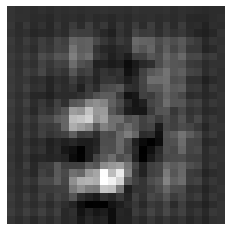

discriminator loss : 0.5310837030410767
Generator loss : [0.5568201, 0.0]
(1, 28, 28, 1)
(28, 28)


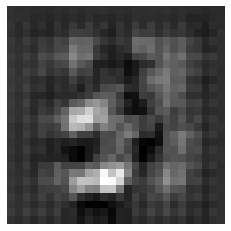

discriminator loss : 0.3464311361312866
Generator loss : [0.33944827, 0.0]
(1, 28, 28, 1)
(28, 28)


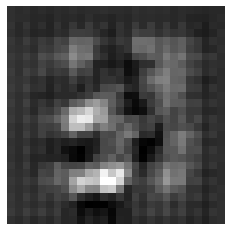

discriminator loss : 0.5047561526298523
Generator loss : [5.3072944, 0.0]
(1, 28, 28, 1)
(28, 28)


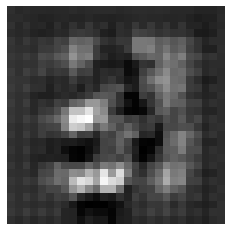

discriminator loss : 0.9122110605239868
Generator loss : [4.223835, 0.0]
(1, 28, 28, 1)
(28, 28)


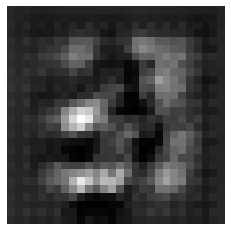

discriminator loss : 0.44406139850616455
Generator loss : [0.6038879, 0.0]
(1, 28, 28, 1)
(28, 28)


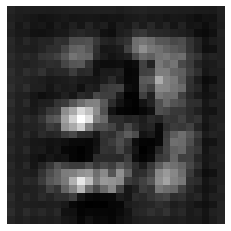

discriminator loss : 0.858379602432251
Generator loss : [9.137402, 0.0]
(1, 28, 28, 1)
(28, 28)


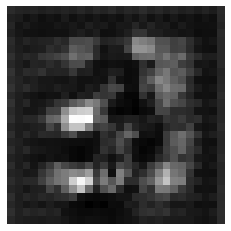

discriminator loss : 0.8468018770217896
Generator loss : [6.1102953, 0.0]
(1, 28, 28, 1)
(28, 28)


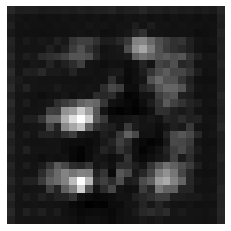

discriminator loss : 0.5375963449478149
Generator loss : [0.90710753, 0.0]
(1, 28, 28, 1)
(28, 28)


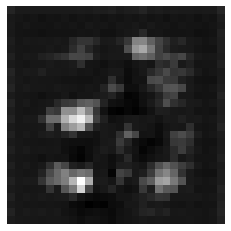

discriminator loss : 0.7326409816741943
Generator loss : [0.6386364, 0.0]
(1, 28, 28, 1)
(28, 28)


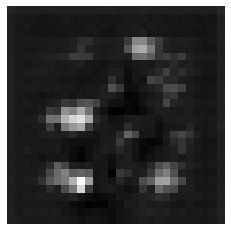

discriminator loss : 0.5542120933532715
Generator loss : [0.83748895, 0.0]
(1, 28, 28, 1)
(28, 28)


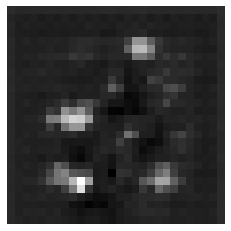

discriminator loss : 0.4641212821006775
Generator loss : [0.840344, 0.0]
(1, 28, 28, 1)
(28, 28)


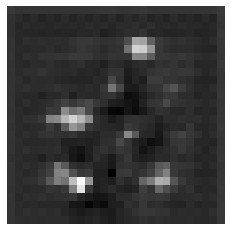

discriminator loss : 0.4344285726547241
Generator loss : [0.7142802, 0.0]
(1, 28, 28, 1)
(28, 28)


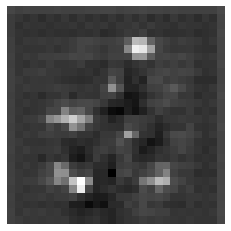

discriminator loss : 0.4095992147922516
Generator loss : [0.51194215, 0.0]
(1, 28, 28, 1)
(28, 28)


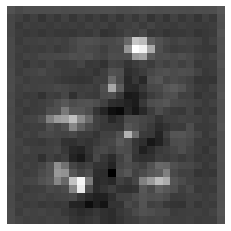

discriminator loss : 0.3886881470680237
Generator loss : [0.40218875, 0.0]
(1, 28, 28, 1)
(28, 28)


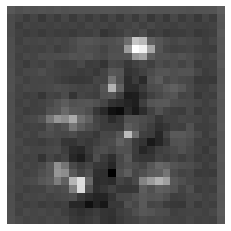

discriminator loss : 0.3450796604156494
Generator loss : [0.364035, 0.0]
(1, 28, 28, 1)
(28, 28)


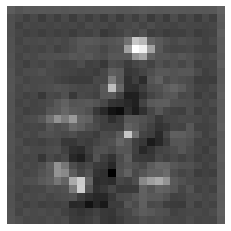

discriminator loss : 0.32672303915023804
Generator loss : [0.33668095, 0.0]
(1, 28, 28, 1)
(28, 28)


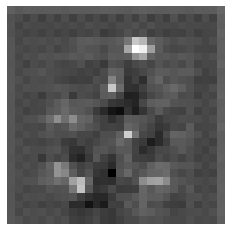

discriminator loss : 0.32980281114578247
Generator loss : [0.35014835, 0.0]
(1, 28, 28, 1)
(28, 28)


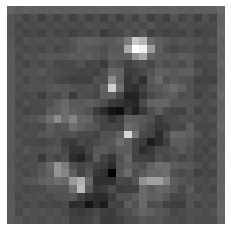

discriminator loss : 0.3313501477241516
Generator loss : [0.34312856, 0.0]
(1, 28, 28, 1)
(28, 28)


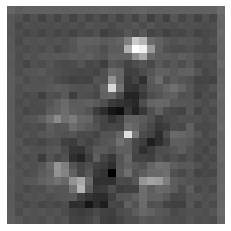

discriminator loss : 0.3386949300765991
Generator loss : [0.35081902, 0.0]
(1, 28, 28, 1)
(28, 28)


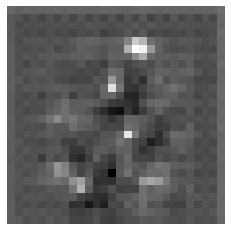

discriminator loss : 0.31421855092048645
Generator loss : [0.335738, 0.0]
(1, 28, 28, 1)
(28, 28)


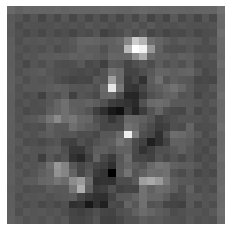

discriminator loss : 0.3188113570213318
Generator loss : [0.3254602, 0.0]
(1, 28, 28, 1)
(28, 28)


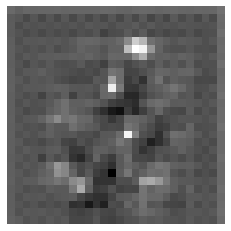

discriminator loss : 0.32337331771850586
Generator loss : [0.33393228, 0.0]
(1, 28, 28, 1)
(28, 28)


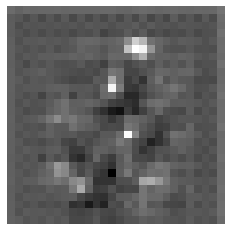

discriminator loss : 0.31281185150146484
Generator loss : [0.32951632, 0.0]
(1, 28, 28, 1)
(28, 28)


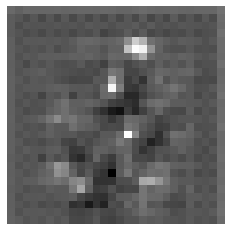

discriminator loss : 0.34057387709617615
Generator loss : [0.34380543, 0.0]
(1, 28, 28, 1)
(28, 28)


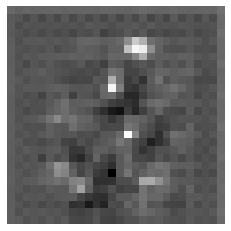

discriminator loss : 0.32387596368789673
Generator loss : [0.34592995, 0.0]
(1, 28, 28, 1)
(28, 28)


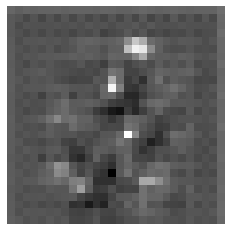

discriminator loss : 0.3505997955799103
Generator loss : [0.34083873, 0.0]
(1, 28, 28, 1)
(28, 28)


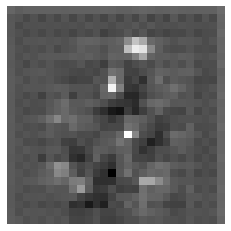

discriminator loss : 0.34758782386779785
Generator loss : [0.3470981, 0.0]
(1, 28, 28, 1)
(28, 28)


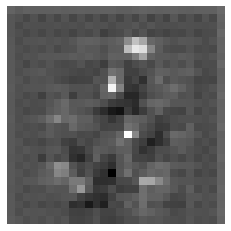

discriminator loss : 0.33126771450042725
Generator loss : [0.33441842, 0.0]
(1, 28, 28, 1)
(28, 28)


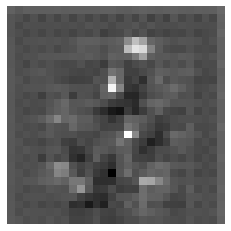

discriminator loss : 0.3357381224632263
Generator loss : [0.34555668, 0.0]
(1, 28, 28, 1)
(28, 28)


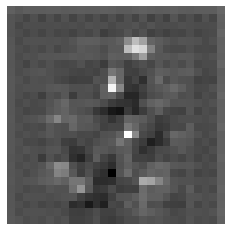

discriminator loss : 0.3130497336387634
Generator loss : [0.33905986, 0.0]
(1, 28, 28, 1)
(28, 28)


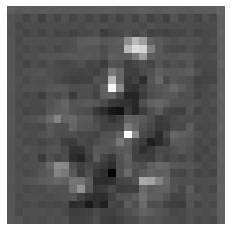

discriminator loss : 0.32797545194625854
Generator loss : [0.34033576, 0.0]
(1, 28, 28, 1)
(28, 28)


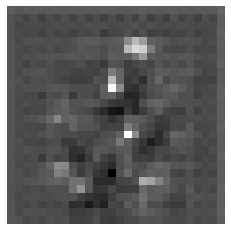

discriminator loss : 0.3302164077758789
Generator loss : [0.34882775, 0.0]
(1, 28, 28, 1)
(28, 28)


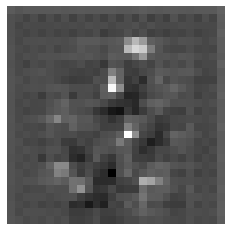

discriminator loss : 0.317285418510437
Generator loss : [0.33672982, 0.0]
(1, 28, 28, 1)
(28, 28)


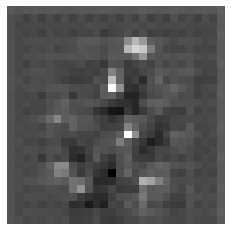

discriminator loss : 0.32810699939727783
Generator loss : [0.34362137, 0.0]
(1, 28, 28, 1)
(28, 28)


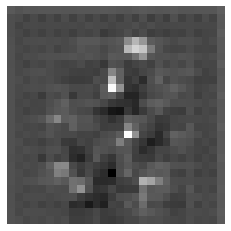

discriminator loss : 0.3205984830856323
Generator loss : [0.3390517, 0.0]
(1, 28, 28, 1)
(28, 28)


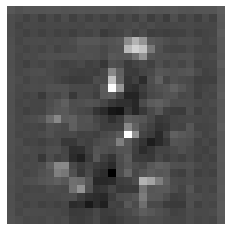

discriminator loss : 0.3374142646789551
Generator loss : [0.3605701, 0.0]
(1, 28, 28, 1)
(28, 28)


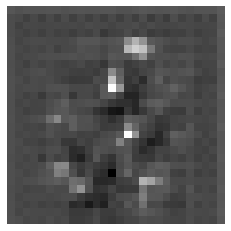

discriminator loss : 0.3312573730945587
Generator loss : [0.35002178, 0.0]
(1, 28, 28, 1)
(28, 28)


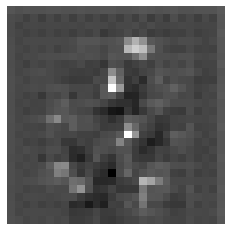

discriminator loss : 0.3311730623245239
Generator loss : [0.34038597, 0.0]
(1, 28, 28, 1)
(28, 28)


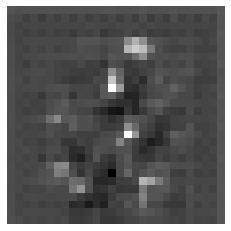

discriminator loss : 0.32556289434432983
Generator loss : [0.3516099, 0.0]
(1, 28, 28, 1)
(28, 28)


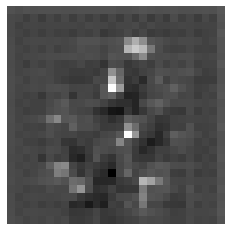

discriminator loss : 0.3334267735481262
Generator loss : [0.33355755, 0.0]
(1, 28, 28, 1)
(28, 28)


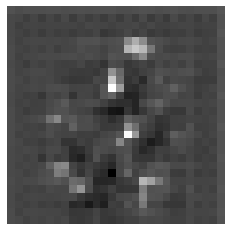

discriminator loss : 0.33437779545783997
Generator loss : [0.33603725, 0.0]
(1, 28, 28, 1)
(28, 28)


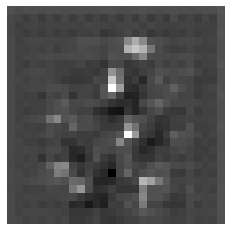

discriminator loss : 0.32453295588493347
Generator loss : [0.3364216, 0.0]
(1, 28, 28, 1)
(28, 28)


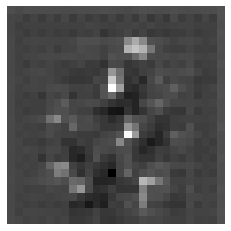

discriminator loss : 0.34456154704093933
Generator loss : [0.35790318, 0.0]
(1, 28, 28, 1)
(28, 28)


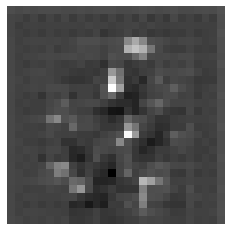

discriminator loss : 0.33400100469589233
Generator loss : [0.3352088, 0.0]
(1, 28, 28, 1)
(28, 28)


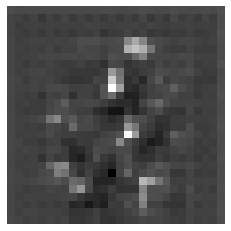

discriminator loss : 0.34266284108161926
Generator loss : [0.34712166, 0.0]
(1, 28, 28, 1)
(28, 28)


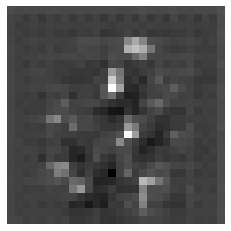

discriminator loss : 0.32234644889831543
Generator loss : [0.3490583, 0.0]
(1, 28, 28, 1)
(28, 28)


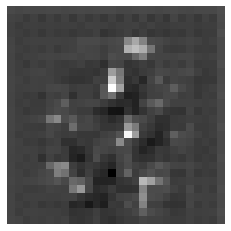

discriminator loss : 0.3225863575935364
Generator loss : [0.34653226, 0.0]
(1, 28, 28, 1)
(28, 28)


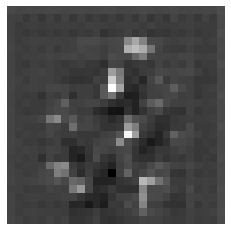

discriminator loss : 0.3252415060997009
Generator loss : [0.34020096, 0.0]
(1, 28, 28, 1)
(28, 28)


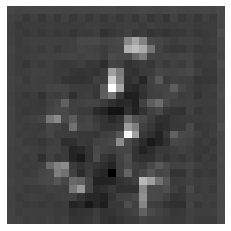

discriminator loss : 0.34406885504722595
Generator loss : [0.3532869, 0.0]
(1, 28, 28, 1)
(28, 28)


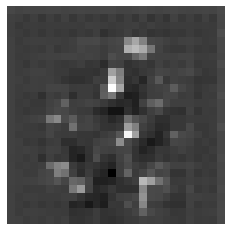

discriminator loss : 0.31588876247406006
Generator loss : [0.33559692, 0.0]
(1, 28, 28, 1)
(28, 28)


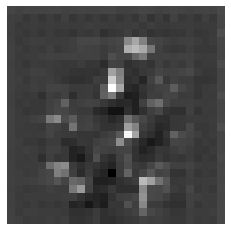

discriminator loss : 0.3309239447116852
Generator loss : [0.33133924, 0.0]
(1, 28, 28, 1)
(28, 28)


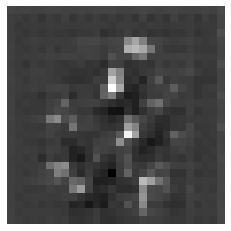

discriminator loss : 0.33402830362319946
Generator loss : [0.3462234, 0.0]
(1, 28, 28, 1)
(28, 28)


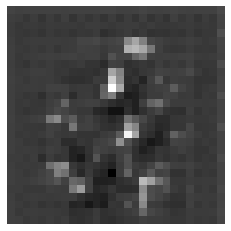

discriminator loss : 0.3509501814842224
Generator loss : [0.33540505, 0.0]
(1, 28, 28, 1)
(28, 28)


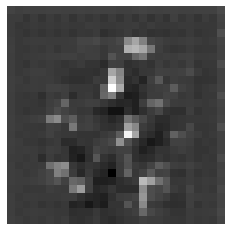

discriminator loss : 0.35176920890808105
Generator loss : [0.36315987, 0.0]
(1, 28, 28, 1)
(28, 28)


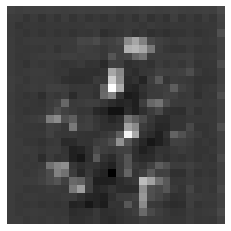

discriminator loss : 0.360007643699646
Generator loss : [0.3349977, 0.0]
(1, 28, 28, 1)
(28, 28)


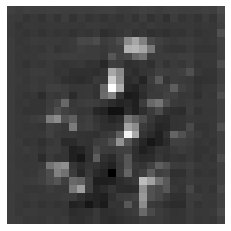

discriminator loss : 0.3606119751930237
Generator loss : [0.34851602, 0.0]
(1, 28, 28, 1)
(28, 28)


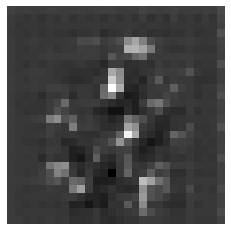

discriminator loss : 0.3562461733818054
Generator loss : [0.3325965, 0.0]
(1, 28, 28, 1)
(28, 28)


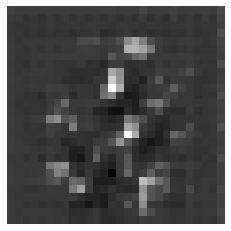

discriminator loss : 0.35299697518348694
Generator loss : [0.3532474, 0.0]
(1, 28, 28, 1)
(28, 28)


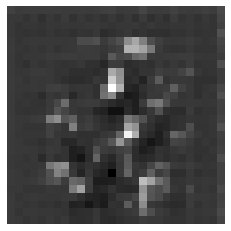

discriminator loss : 0.36448976397514343
Generator loss : [0.34117472, 0.0]
(1, 28, 28, 1)
(28, 28)


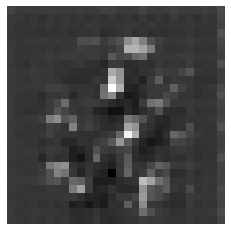

discriminator loss : 0.34025049209594727
Generator loss : [0.32281575, 0.0]
(1, 28, 28, 1)
(28, 28)


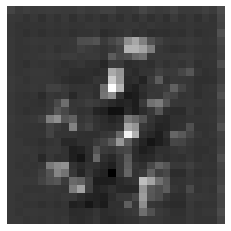

discriminator loss : 0.36527734994888306
Generator loss : [0.3368198, 0.0]
(1, 28, 28, 1)
(28, 28)


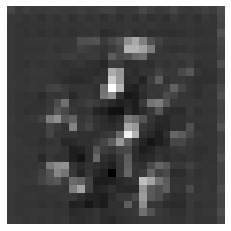

discriminator loss : 0.3593972325325012
Generator loss : [0.34002498, 0.0]
(1, 28, 28, 1)
(28, 28)


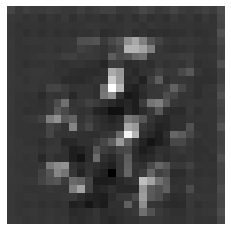

discriminator loss : 0.34359580278396606
Generator loss : [0.31578204, 0.0]
(1, 28, 28, 1)
(28, 28)


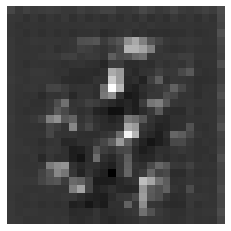

discriminator loss : 0.3319942057132721
Generator loss : [0.32014796, 0.0]
(1, 28, 28, 1)
(28, 28)


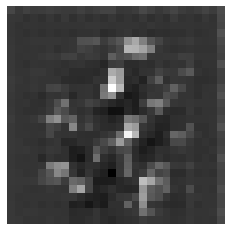

discriminator loss : 0.33194926381111145
Generator loss : [0.332309, 0.0]
(1, 28, 28, 1)
(28, 28)


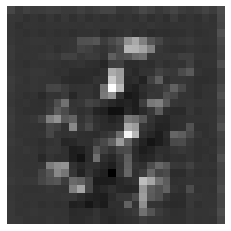

discriminator loss : 0.33886581659317017
Generator loss : [0.3266133, 0.0]
(1, 28, 28, 1)
(28, 28)


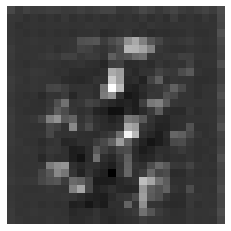

discriminator loss : 0.3378291130065918
Generator loss : [0.32810104, 0.0]
(1, 28, 28, 1)
(28, 28)


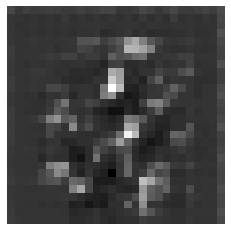

discriminator loss : 0.34811800718307495
Generator loss : [0.32176048, 0.0]
(1, 28, 28, 1)
(28, 28)


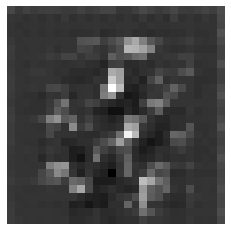

discriminator loss : 0.33094725012779236
Generator loss : [0.32283616, 0.0]
(1, 28, 28, 1)
(28, 28)


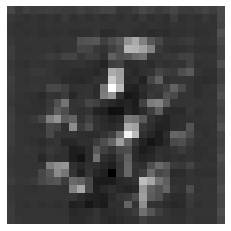

discriminator loss : 0.3548855781555176
Generator loss : [0.34151474, 0.0]
(1, 28, 28, 1)
(28, 28)


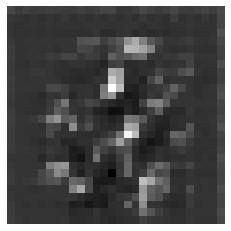

discriminator loss : 0.33536994457244873
Generator loss : [0.33969554, 0.0]
(1, 28, 28, 1)
(28, 28)


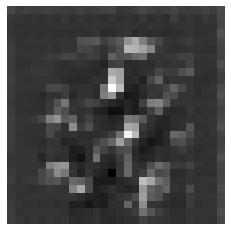

discriminator loss : 0.3308660387992859
Generator loss : [0.29569086, 0.0]
(1, 28, 28, 1)
(28, 28)


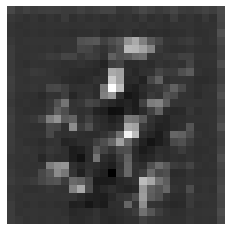

discriminator loss : 0.3278203308582306
Generator loss : [0.3303729, 0.0]
(1, 28, 28, 1)
(28, 28)


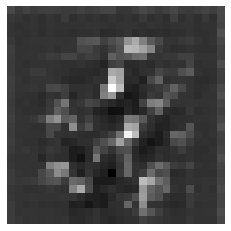

discriminator loss : 0.3363237679004669
Generator loss : [0.33521315, 0.0]
(1, 28, 28, 1)
(28, 28)


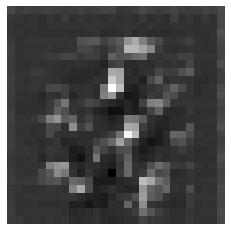

discriminator loss : 0.3419952988624573
Generator loss : [0.34193707, 0.0]
(1, 28, 28, 1)
(28, 28)


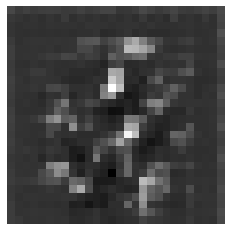

discriminator loss : 0.3358469307422638
Generator loss : [0.3181158, 0.0]
(1, 28, 28, 1)
(28, 28)


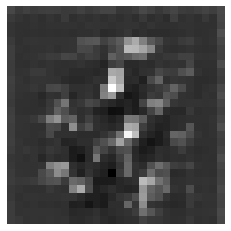

discriminator loss : 0.3310635983943939
Generator loss : [0.31688, 0.0]
(1, 28, 28, 1)
(28, 28)


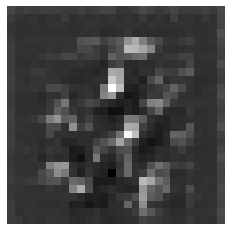

discriminator loss : 0.32298973202705383
Generator loss : [0.33072358, 0.0]
(1, 28, 28, 1)
(28, 28)


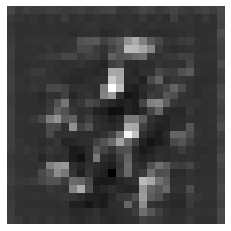

discriminator loss : 0.3267446756362915
Generator loss : [0.33734033, 0.0]
(1, 28, 28, 1)
(28, 28)


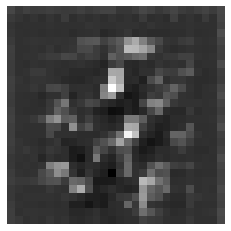

discriminator loss : 0.3299863338470459
Generator loss : [0.33289278, 0.0]
(1, 28, 28, 1)
(28, 28)


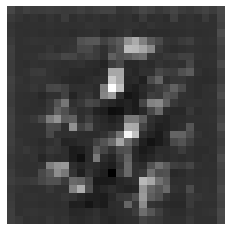

discriminator loss : 0.3331426680088043
Generator loss : [0.32154474, 0.0]
(1, 28, 28, 1)
(28, 28)


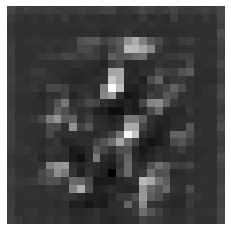

discriminator loss : 0.3268955647945404
Generator loss : [0.32073048, 0.0]
(1, 28, 28, 1)
(28, 28)


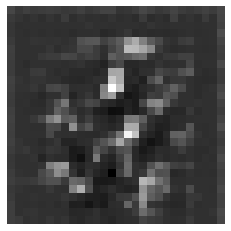

discriminator loss : 0.33607983589172363
Generator loss : [0.32937995, 0.0]
(1, 28, 28, 1)
(28, 28)


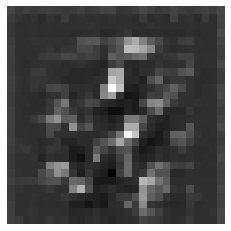

discriminator loss : 0.3213837444782257
Generator loss : [0.31782302, 0.0]
(1, 28, 28, 1)
(28, 28)


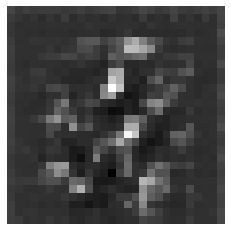

discriminator loss : 0.33374565839767456
Generator loss : [0.33789712, 0.0]
(1, 28, 28, 1)
(28, 28)


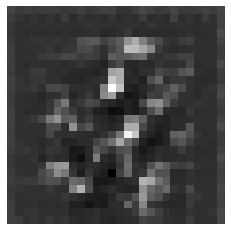

discriminator loss : 0.32328516244888306
Generator loss : [0.32737622, 0.0]
(1, 28, 28, 1)
(28, 28)


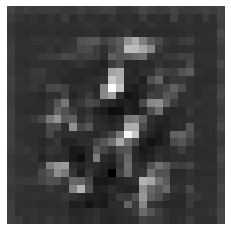

discriminator loss : 0.32117629051208496
Generator loss : [0.31030178, 0.0]
(1, 28, 28, 1)
(28, 28)


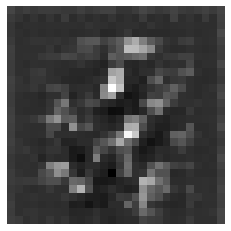

discriminator loss : 0.32527852058410645
Generator loss : [0.31718296, 0.0]
(1, 28, 28, 1)
(28, 28)


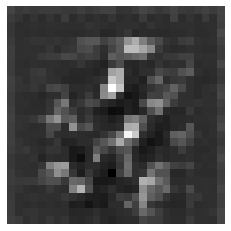

discriminator loss : 0.3394045829772949
Generator loss : [0.33976212, 0.0]
(1, 28, 28, 1)
(28, 28)


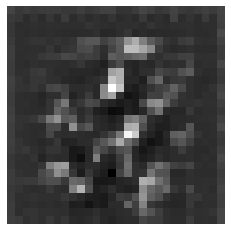

discriminator loss : 0.34656327962875366
Generator loss : [0.35472977, 0.0]
(1, 28, 28, 1)
(28, 28)


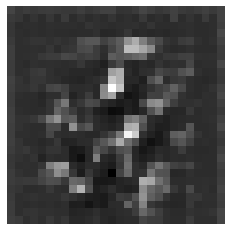

discriminator loss : 0.3393562436103821
Generator loss : [0.34644353, 0.0]
(1, 28, 28, 1)
(28, 28)


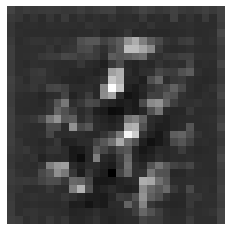

discriminator loss : 0.33307531476020813
Generator loss : [0.3413747, 0.0]
(1, 28, 28, 1)
(28, 28)


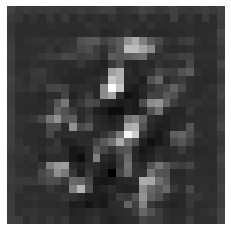

discriminator loss : 0.35851195454597473
Generator loss : [0.34872037, 0.0]
(1, 28, 28, 1)
(28, 28)


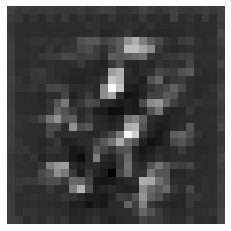

discriminator loss : 0.33823317289352417
Generator loss : [0.33393845, 0.0]
(1, 28, 28, 1)
(28, 28)


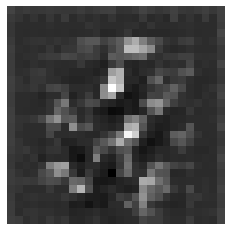

discriminator loss : 0.33588093519210815
Generator loss : [0.35206303, 0.0]
(1, 28, 28, 1)
(28, 28)


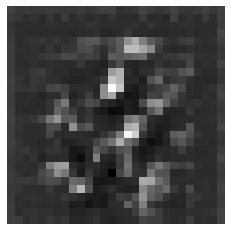

discriminator loss : 0.34464773535728455
Generator loss : [0.33385152, 0.0]
(1, 28, 28, 1)
(28, 28)


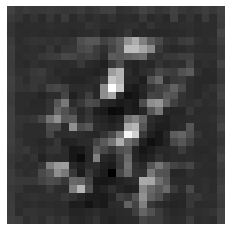

discriminator loss : 0.32935068011283875
Generator loss : [0.3180706, 0.0]
(1, 28, 28, 1)
(28, 28)


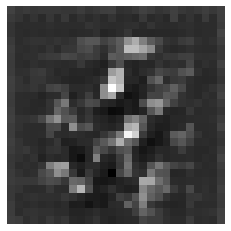

discriminator loss : 0.31351375579833984
Generator loss : [0.31536064, 0.0]
(1, 28, 28, 1)
(28, 28)


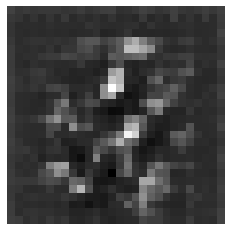

discriminator loss : 0.3234415054321289
Generator loss : [0.3036729, 0.0]
(1, 28, 28, 1)
(28, 28)


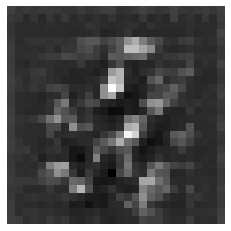

discriminator loss : 0.32754749059677124
Generator loss : [0.32641807, 0.0]
(1, 28, 28, 1)
(28, 28)


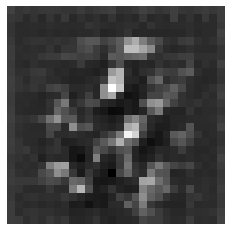

discriminator loss : 0.3241916298866272
Generator loss : [0.31436917, 0.0]
(1, 28, 28, 1)
(28, 28)


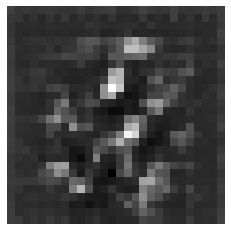

discriminator loss : 0.3558352589607239
Generator loss : [0.35273752, 0.0]
(1, 28, 28, 1)
(28, 28)


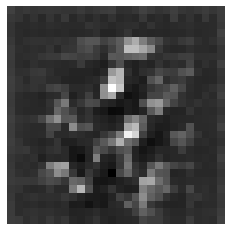

discriminator loss : 0.34524005651474
Generator loss : [0.34117177, 0.0]
(1, 28, 28, 1)
(28, 28)


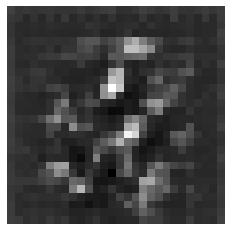

discriminator loss : 0.3401641249656677
Generator loss : [0.32572007, 0.0]
(1, 28, 28, 1)
(28, 28)


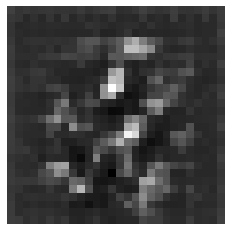

discriminator loss : 0.3281307816505432
Generator loss : [0.34196824, 0.0]
(1, 28, 28, 1)
(28, 28)


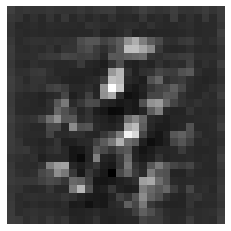

discriminator loss : 0.32480859756469727
Generator loss : [0.32295123, 0.0]
(1, 28, 28, 1)
(28, 28)


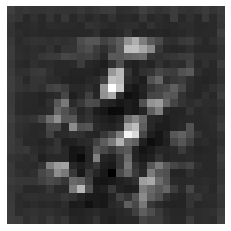

discriminator loss : 0.33196765184402466
Generator loss : [0.33558902, 0.0]
(1, 28, 28, 1)
(28, 28)


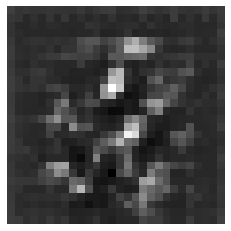

discriminator loss : 0.32873445749282837
Generator loss : [0.324919, 0.0]
(1, 28, 28, 1)
(28, 28)


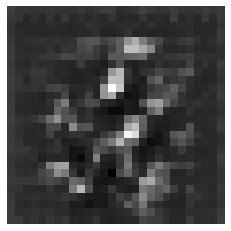

discriminator loss : 0.33042746782302856
Generator loss : [0.33010906, 0.0]
(1, 28, 28, 1)
(28, 28)


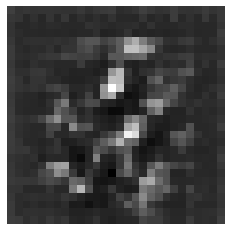

discriminator loss : 0.3336620032787323
Generator loss : [0.3314114, 0.0]
(1, 28, 28, 1)
(28, 28)


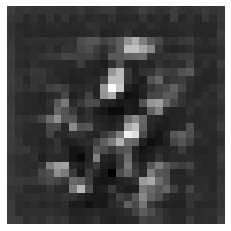

discriminator loss : 0.34156230092048645
Generator loss : [0.32693252, 0.0]
(1, 28, 28, 1)
(28, 28)


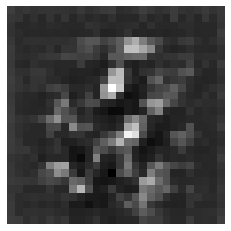

discriminator loss : 0.3467913269996643
Generator loss : [0.33759978, 0.0]
(1, 28, 28, 1)
(28, 28)


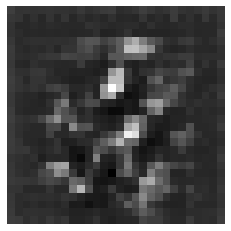

discriminator loss : 0.3373974561691284
Generator loss : [0.34373635, 0.0]
(1, 28, 28, 1)
(28, 28)


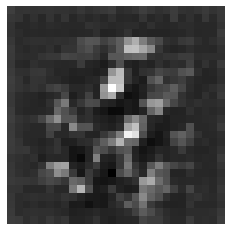

discriminator loss : 0.33442360162734985
Generator loss : [0.33196706, 0.0]
(1, 28, 28, 1)
(28, 28)


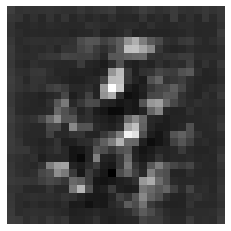

discriminator loss : 0.34894615411758423
Generator loss : [0.33404785, 0.0]
(1, 28, 28, 1)
(28, 28)


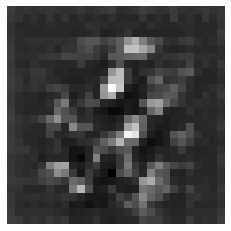

discriminator loss : 0.3221393823623657
Generator loss : [0.3227872, 0.0]
(1, 28, 28, 1)
(28, 28)


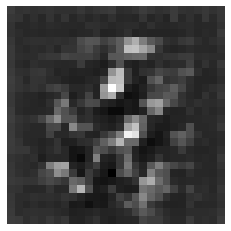

discriminator loss : 0.32561010122299194
Generator loss : [0.31920302, 0.0]
(1, 28, 28, 1)
(28, 28)


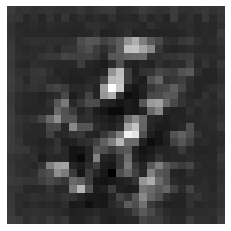

discriminator loss : 0.344152569770813
Generator loss : [0.32167834, 0.0]
(1, 28, 28, 1)
(28, 28)


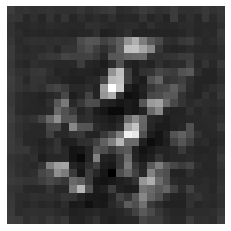

discriminator loss : 0.34501874446868896
Generator loss : [0.34169388, 0.0]
(1, 28, 28, 1)
(28, 28)


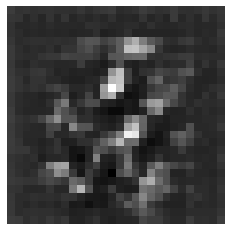

discriminator loss : 0.3365817964076996
Generator loss : [0.32795128, 0.0]
(1, 28, 28, 1)
(28, 28)


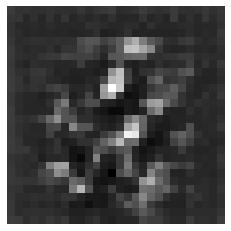

discriminator loss : 0.35393697023391724
Generator loss : [0.34486213, 0.0]
(1, 28, 28, 1)
(28, 28)


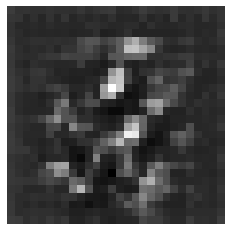

discriminator loss : 0.3344993591308594
Generator loss : [0.31917188, 0.0]
(1, 28, 28, 1)
(28, 28)


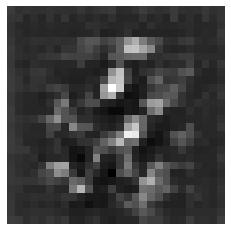

discriminator loss : 0.33003196120262146
Generator loss : [0.33581245, 0.0]
(1, 28, 28, 1)
(28, 28)


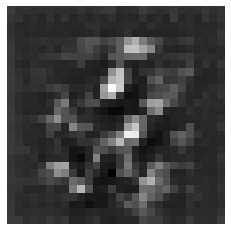

discriminator loss : 0.34195804595947266
Generator loss : [0.3438574, 0.0]
(1, 28, 28, 1)
(28, 28)


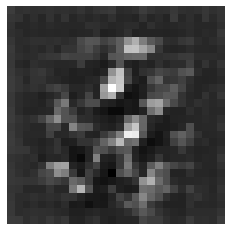

discriminator loss : 0.3472711443901062
Generator loss : [0.3366987, 0.0]
(1, 28, 28, 1)
(28, 28)


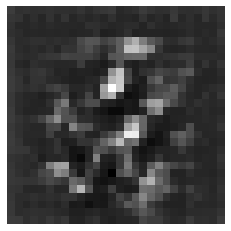

discriminator loss : 0.3320000171661377
Generator loss : [0.33868968, 0.0]
(1, 28, 28, 1)
(28, 28)


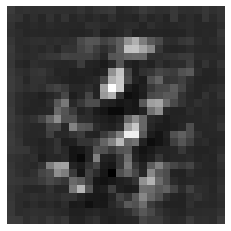

discriminator loss : 0.3226601183414459
Generator loss : [0.31659928, 0.0]
(1, 28, 28, 1)
(28, 28)


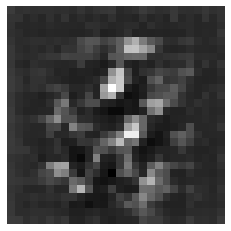

discriminator loss : 0.32468581199645996
Generator loss : [0.32525557, 0.0]
(1, 28, 28, 1)
(28, 28)


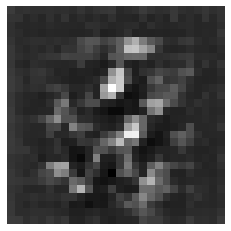

discriminator loss : 0.335716187953949
Generator loss : [0.3449147, 0.0]
(1, 28, 28, 1)
(28, 28)


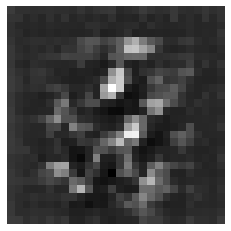

discriminator loss : 0.33557355403900146
Generator loss : [0.33174187, 0.0]
(1, 28, 28, 1)
(28, 28)


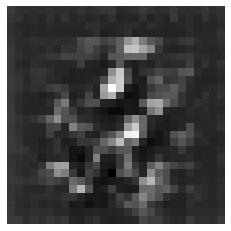

discriminator loss : 0.3359464704990387
Generator loss : [0.33340523, 0.0]
(1, 28, 28, 1)
(28, 28)


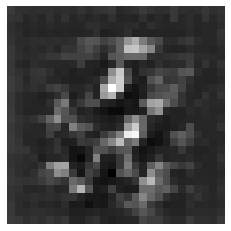

discriminator loss : 0.3328973054885864
Generator loss : [0.336028, 0.0]
(1, 28, 28, 1)
(28, 28)


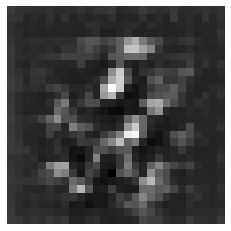

discriminator loss : 0.3440249264240265
Generator loss : [0.31450975, 0.0]
(1, 28, 28, 1)
(28, 28)


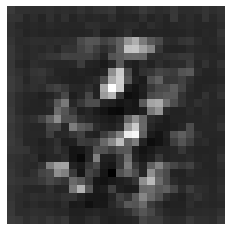

discriminator loss : 0.3449346423149109
Generator loss : [0.34904075, 0.0]
(1, 28, 28, 1)
(28, 28)


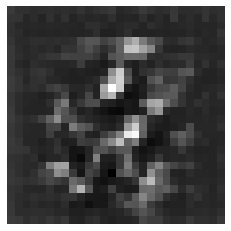

discriminator loss : 0.3571666181087494
Generator loss : [0.3525538, 0.0]
(1, 28, 28, 1)
(28, 28)


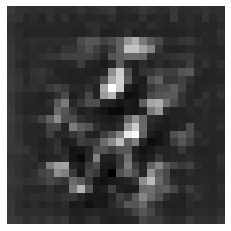

discriminator loss : 0.3343604803085327
Generator loss : [0.35491002, 0.0]
(1, 28, 28, 1)
(28, 28)


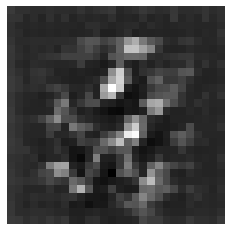

discriminator loss : 0.34737324714660645
Generator loss : [0.34565684, 0.0]
(1, 28, 28, 1)
(28, 28)


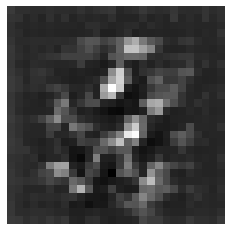

discriminator loss : 0.32994988560676575
Generator loss : [0.32374173, 0.0]
(1, 28, 28, 1)
(28, 28)


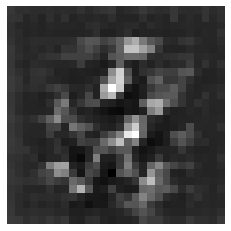

discriminator loss : 0.35385334491729736
Generator loss : [0.35473946, 0.0]
(1, 28, 28, 1)
(28, 28)


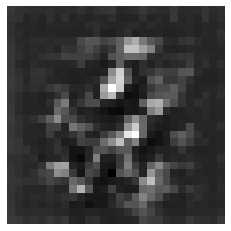

discriminator loss : 0.324848473072052
Generator loss : [0.32894382, 0.0]
(1, 28, 28, 1)
(28, 28)


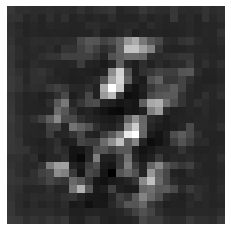

discriminator loss : 0.3343442678451538
Generator loss : [0.35578546, 0.0]
(1, 28, 28, 1)
(28, 28)


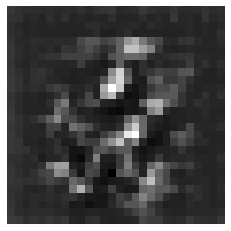

discriminator loss : 0.3376225233078003
Generator loss : [0.33259284, 0.0]
(1, 28, 28, 1)
(28, 28)


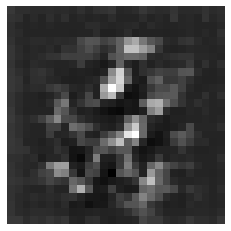

discriminator loss : 0.33988523483276367
Generator loss : [0.34987175, 0.0]
(1, 28, 28, 1)
(28, 28)


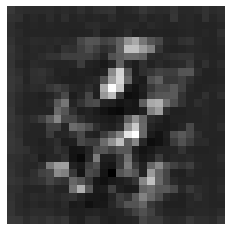

discriminator loss : 0.3421127200126648
Generator loss : [0.3520761, 0.0]
(1, 28, 28, 1)
(28, 28)


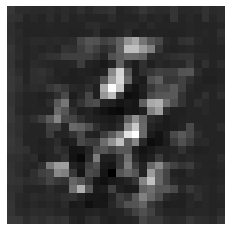

discriminator loss : 0.3466217815876007
Generator loss : [0.35107845, 0.0]
(1, 28, 28, 1)
(28, 28)


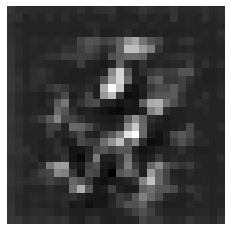

discriminator loss : 0.3377213478088379
Generator loss : [0.34572577, 0.0]
(1, 28, 28, 1)
(28, 28)


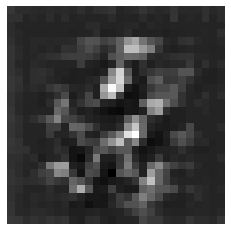

discriminator loss : 0.33347466588020325
Generator loss : [0.34948742, 0.0]
(1, 28, 28, 1)
(28, 28)


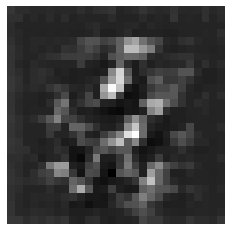

discriminator loss : 0.33351486921310425
Generator loss : [0.33842087, 0.0]
(1, 28, 28, 1)
(28, 28)


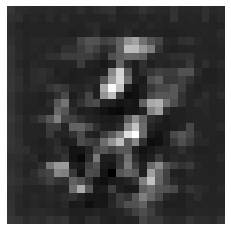

discriminator loss : 0.3388354182243347
Generator loss : [0.32999384, 0.0]
(1, 28, 28, 1)
(28, 28)


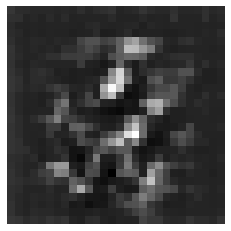

discriminator loss : 0.3241211771965027
Generator loss : [0.3282206, 0.0]
(1, 28, 28, 1)
(28, 28)


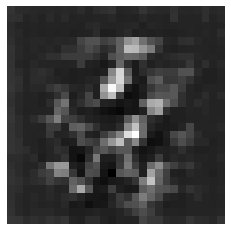

discriminator loss : 0.34207266569137573
Generator loss : [0.35707596, 0.0]
(1, 28, 28, 1)
(28, 28)


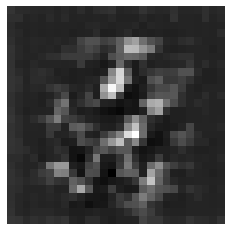

discriminator loss : 0.33585959672927856
Generator loss : [0.3378109, 0.0]
(1, 28, 28, 1)
(28, 28)


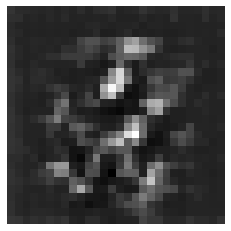

discriminator loss : 0.35408249497413635
Generator loss : [0.35139844, 0.0]
(1, 28, 28, 1)
(28, 28)


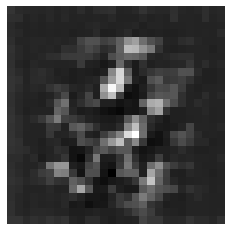

discriminator loss : 0.340088427066803
Generator loss : [0.3250006, 0.0]
(1, 28, 28, 1)
(28, 28)


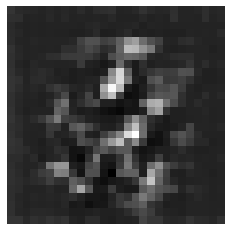

discriminator loss : 0.32212764024734497
Generator loss : [0.32883468, 0.0]
(1, 28, 28, 1)
(28, 28)


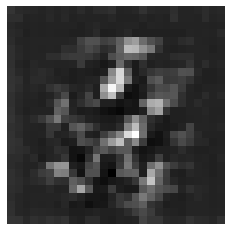

discriminator loss : 0.325939416885376
Generator loss : [0.31748128, 0.0]
(1, 28, 28, 1)
(28, 28)


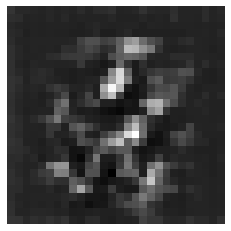

discriminator loss : 0.33951443433761597
Generator loss : [0.34003747, 0.0]
(1, 28, 28, 1)
(28, 28)


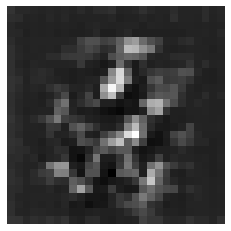

discriminator loss : 0.34576958417892456
Generator loss : [0.3457862, 0.0]
(1, 28, 28, 1)
(28, 28)


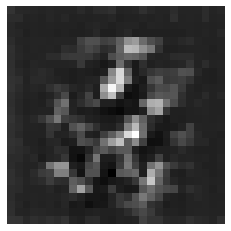

discriminator loss : 0.3582005500793457
Generator loss : [0.35175678, 0.0]
(1, 28, 28, 1)
(28, 28)


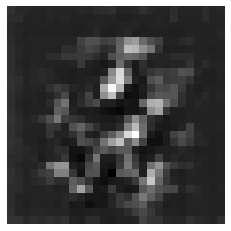

discriminator loss : 0.3360106348991394
Generator loss : [0.332262, 0.0]
(1, 28, 28, 1)
(28, 28)


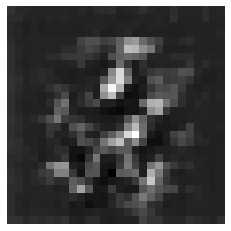

discriminator loss : 0.32745394110679626
Generator loss : [0.34238416, 0.0]
(1, 28, 28, 1)
(28, 28)


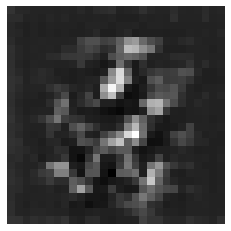

discriminator loss : 0.3609763979911804
Generator loss : [0.3388647, 0.0]
(1, 28, 28, 1)
(28, 28)


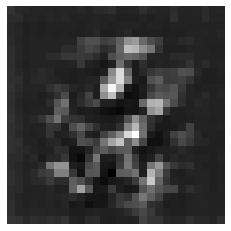

discriminator loss : 0.3494299352169037
Generator loss : [0.35578117, 0.0]
(1, 28, 28, 1)
(28, 28)


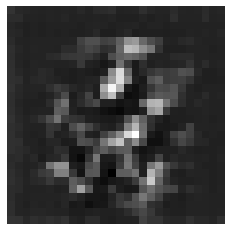

discriminator loss : 0.3384677767753601
Generator loss : [0.3378303, 0.0]
(1, 28, 28, 1)
(28, 28)


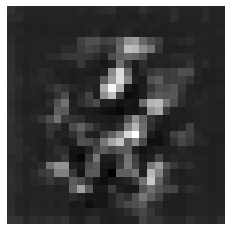

discriminator loss : 0.33383697271347046
Generator loss : [0.34342176, 0.0]
(1, 28, 28, 1)
(28, 28)


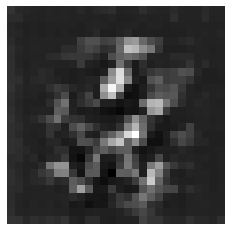

discriminator loss : 0.3251436948776245
Generator loss : [0.3433381, 0.0]
(1, 28, 28, 1)
(28, 28)


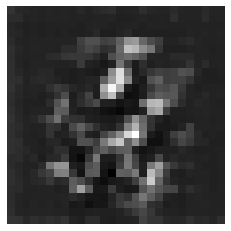

discriminator loss : 0.3292146325111389
Generator loss : [0.33604047, 0.0]
(1, 28, 28, 1)
(28, 28)


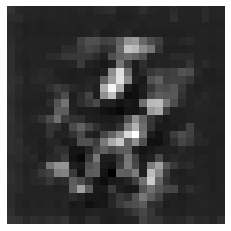

discriminator loss : 0.33904990553855896
Generator loss : [0.35033882, 0.0]
(1, 28, 28, 1)
(28, 28)


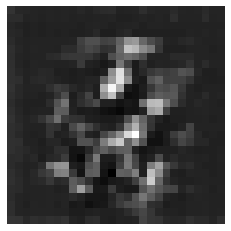

discriminator loss : 0.3534144163131714
Generator loss : [0.33606377, 0.0]
(1, 28, 28, 1)
(28, 28)


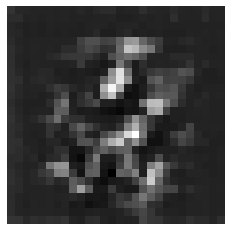

discriminator loss : 0.33822762966156006
Generator loss : [0.35704848, 0.0]
(1, 28, 28, 1)
(28, 28)


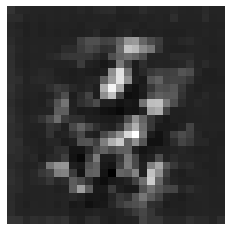

discriminator loss : 0.3477693796157837
Generator loss : [0.35064134, 0.0]
(1, 28, 28, 1)
(28, 28)


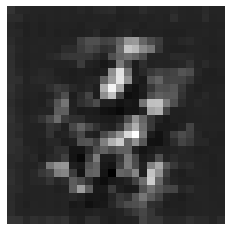

discriminator loss : 0.3413061499595642
Generator loss : [0.36621273, 0.0]
(1, 28, 28, 1)
(28, 28)


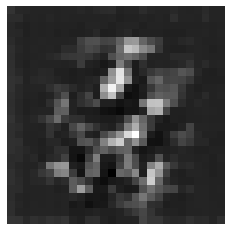

discriminator loss : 0.34148919582366943
Generator loss : [0.35153794, 0.0]
(1, 28, 28, 1)
(28, 28)


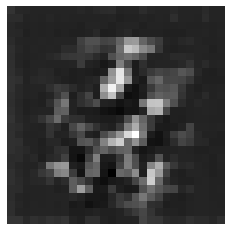

discriminator loss : 0.3803921043872833
Generator loss : [0.38113713, 0.0]
(1, 28, 28, 1)
(28, 28)


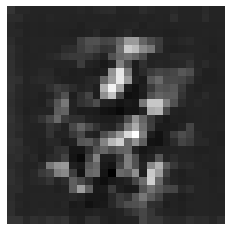

discriminator loss : 0.3504561185836792
Generator loss : [0.3839873, 0.0]
(1, 28, 28, 1)
(28, 28)


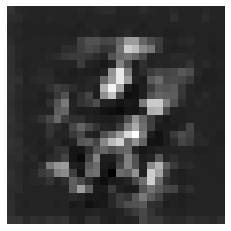

discriminator loss : 0.33184510469436646
Generator loss : [0.36347213, 0.0]
(1, 28, 28, 1)
(28, 28)


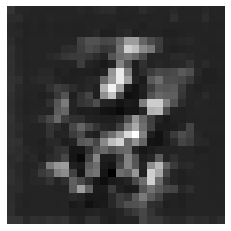

discriminator loss : 0.34313690662384033
Generator loss : [0.37305537, 0.0]
(1, 28, 28, 1)
(28, 28)


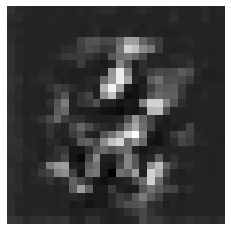

discriminator loss : 0.33861568570137024
Generator loss : [0.3646295, 0.0]
(1, 28, 28, 1)
(28, 28)


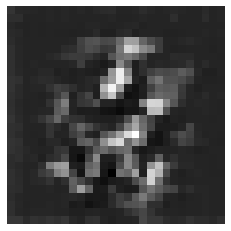

discriminator loss : 0.338764488697052
Generator loss : [0.37947255, 0.0]
(1, 28, 28, 1)
(28, 28)


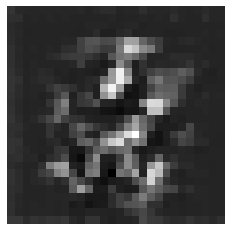

discriminator loss : 0.37167060375213623
Generator loss : [0.39362797, 0.0]
(1, 28, 28, 1)
(28, 28)


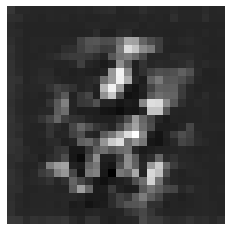

discriminator loss : 0.3456308841705322
Generator loss : [0.45721287, 0.0]
(1, 28, 28, 1)
(28, 28)


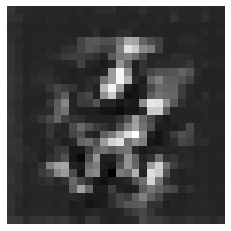

discriminator loss : 0.4818636476993561
Generator loss : [0.45915702, 0.0]
(1, 28, 28, 1)
(28, 28)


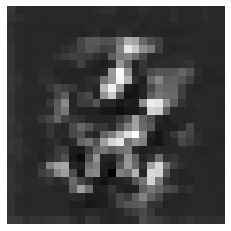

discriminator loss : 0.5044332146644592
Generator loss : [1.8422595, 0.0]
(1, 28, 28, 1)
(28, 28)


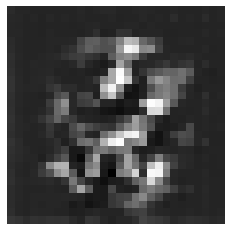

discriminator loss : 0.7217677235603333
Generator loss : [0.7999913, 0.0]
(1, 28, 28, 1)
(28, 28)


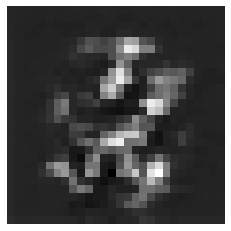

discriminator loss : 0.6577942371368408
Generator loss : [6.950755, 0.0]
(1, 28, 28, 1)
(28, 28)


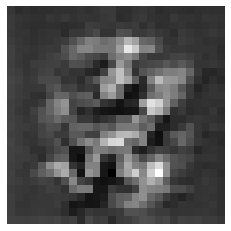

discriminator loss : 1.5437874794006348
Generator loss : [1.6405008, 0.0]
(1, 28, 28, 1)
(28, 28)


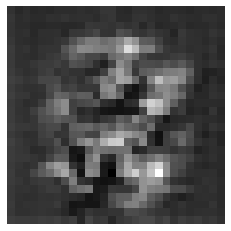

discriminator loss : 0.3331301808357239
Generator loss : [2.0852714, 0.0]
(1, 28, 28, 1)
(28, 28)


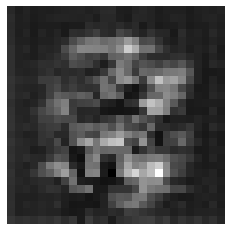

discriminator loss : 0.4812125265598297
Generator loss : [3.0151339, 0.0]
(1, 28, 28, 1)
(28, 28)


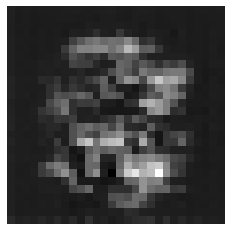

discriminator loss : 1.3015820980072021
Generator loss : [2.518123, 0.0]
(1, 28, 28, 1)
(28, 28)


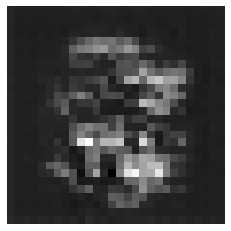

discriminator loss : 0.9909616708755493
Generator loss : [1.6568805, 0.0]
(1, 28, 28, 1)
(28, 28)


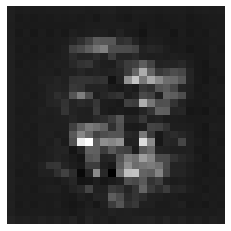

discriminator loss : 0.9370608329772949
Generator loss : [1.3432703, 0.0]
(1, 28, 28, 1)
(28, 28)


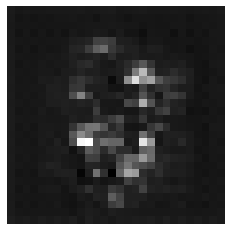

discriminator loss : 1.1368799209594727
Generator loss : [1.0791452, 0.0]
(1, 28, 28, 1)
(28, 28)


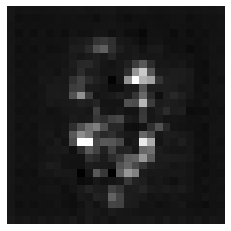

discriminator loss : 1.2801861763000488
Generator loss : [1.0562974, 0.0]
(1, 28, 28, 1)
(28, 28)


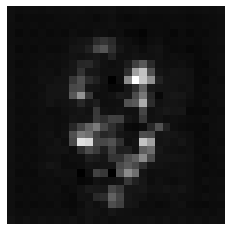

discriminator loss : 1.0480550527572632
Generator loss : [1.434974, 0.0]
(1, 28, 28, 1)
(28, 28)


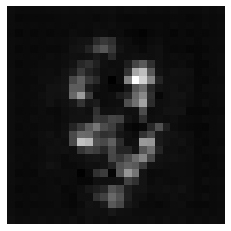

discriminator loss : 0.8303242921829224
Generator loss : [1.6381695, 0.0]
(1, 28, 28, 1)
(28, 28)


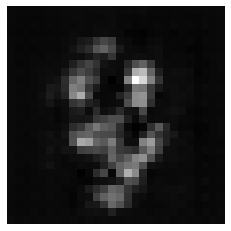

discriminator loss : 0.9869608879089355
Generator loss : [2.315565, 0.0]
(1, 28, 28, 1)
(28, 28)


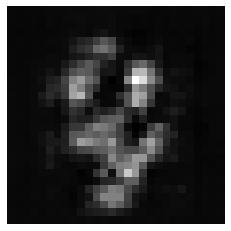

discriminator loss : 0.9961314797401428
Generator loss : [1.2084335, 0.0]
(1, 28, 28, 1)
(28, 28)


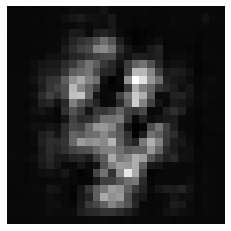

discriminator loss : 0.5178866386413574
Generator loss : [0.79537535, 0.0]
(1, 28, 28, 1)
(28, 28)


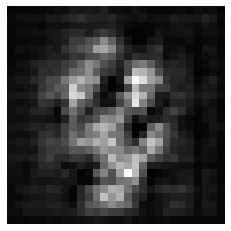

discriminator loss : 0.40730756521224976
Generator loss : [0.41641656, 0.0]
(1, 28, 28, 1)
(28, 28)


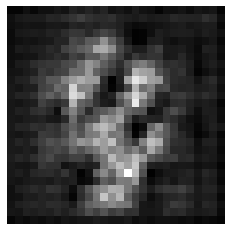

discriminator loss : 0.36883050203323364
Generator loss : [0.44740158, 0.0]
(1, 28, 28, 1)
(28, 28)


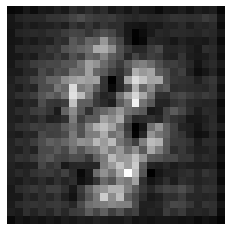

discriminator loss : 0.4559643864631653
Generator loss : [0.31093526, 0.0]
(1, 28, 28, 1)
(28, 28)


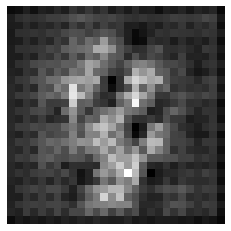

discriminator loss : 0.3572794198989868
Generator loss : [0.33823895, 0.0]
(1, 28, 28, 1)
(28, 28)


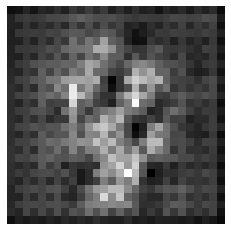

discriminator loss : 0.42144453525543213
Generator loss : [0.35207897, 0.0]
(1, 28, 28, 1)
(28, 28)


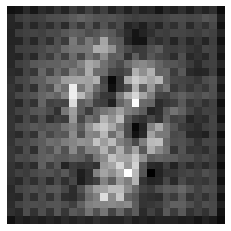

discriminator loss : 0.40365153551101685
Generator loss : [0.38360313, 0.0]
(1, 28, 28, 1)
(28, 28)


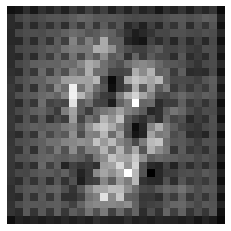

discriminator loss : 1.0286285877227783
Generator loss : [0.32967272, 0.0]
(1, 28, 28, 1)
(28, 28)


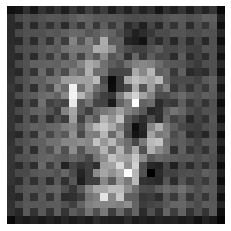

discriminator loss : 0.6754496693611145
Generator loss : [0.34185234, 0.0]
(1, 28, 28, 1)
(28, 28)


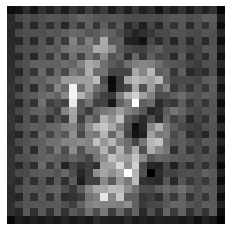

discriminator loss : 0.33236148953437805
Generator loss : [0.3878971, 0.0]
(1, 28, 28, 1)
(28, 28)


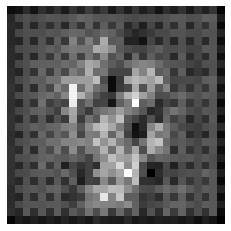

discriminator loss : 0.5547440648078918
Generator loss : [0.3429995, 0.0]
(1, 28, 28, 1)
(28, 28)


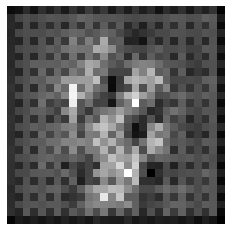

discriminator loss : 0.9751786589622498
Generator loss : [0.36167467, 0.0]
(1, 28, 28, 1)
(28, 28)


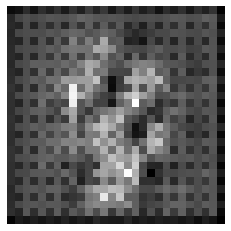

discriminator loss : 0.8228861689567566
Generator loss : [0.33836573, 0.0]
(1, 28, 28, 1)
(28, 28)


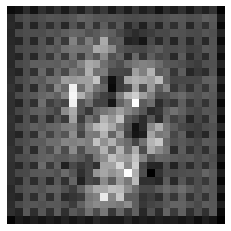

discriminator loss : 0.6571869850158691
Generator loss : [0.32606912, 0.0]
(1, 28, 28, 1)
(28, 28)


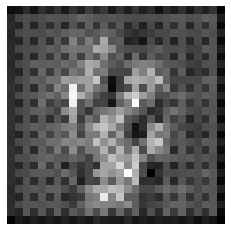

discriminator loss : 0.36883941292762756
Generator loss : [0.3485018, 0.0]
(1, 28, 28, 1)
(28, 28)


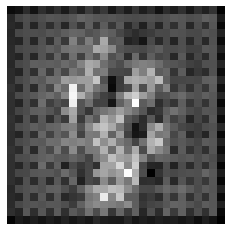

discriminator loss : 0.5478646755218506
Generator loss : [0.32520103, 0.0]
(1, 28, 28, 1)
(28, 28)


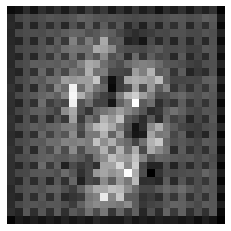

discriminator loss : 0.5182135701179504
Generator loss : [0.35402393, 0.0]
(1, 28, 28, 1)
(28, 28)


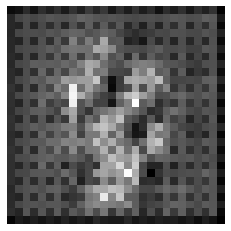

discriminator loss : 0.527588963508606
Generator loss : [0.33575213, 0.0]
(1, 28, 28, 1)
(28, 28)


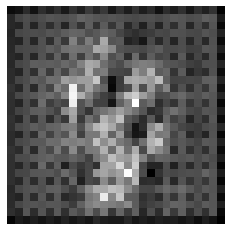

discriminator loss : 0.42894500494003296
Generator loss : [0.3210717, 0.0]
(1, 28, 28, 1)
(28, 28)


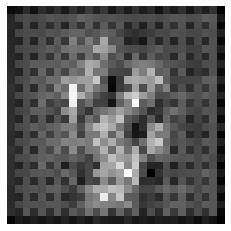

discriminator loss : 0.3404633402824402
Generator loss : [0.34598893, 0.0]
(1, 28, 28, 1)
(28, 28)


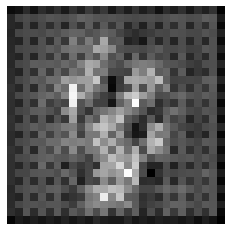

discriminator loss : 0.3744683861732483
Generator loss : [0.33523372, 0.0]
(1, 28, 28, 1)
(28, 28)


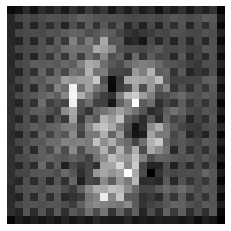

discriminator loss : 0.3325503170490265
Generator loss : [0.3350199, 0.0]
(1, 28, 28, 1)
(28, 28)


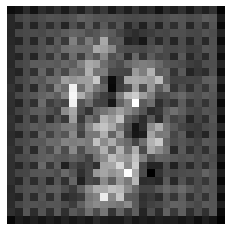

discriminator loss : 0.31320321559906006
Generator loss : [0.32611504, 0.0]
(1, 28, 28, 1)
(28, 28)


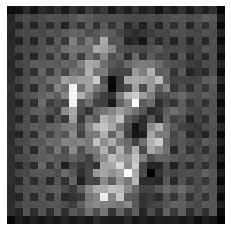

discriminator loss : 0.3415904641151428
Generator loss : [0.34422642, 0.0]
(1, 28, 28, 1)
(28, 28)


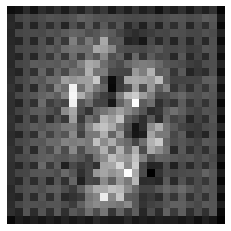

discriminator loss : 0.3492470979690552
Generator loss : [0.327324, 0.0]
(1, 28, 28, 1)
(28, 28)


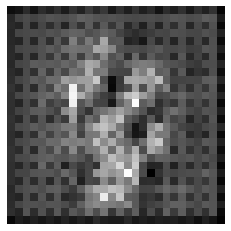

discriminator loss : 0.32721254229545593
Generator loss : [0.31406555, 0.0]
(1, 28, 28, 1)
(28, 28)


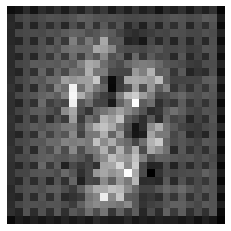

discriminator loss : 0.3252076506614685
Generator loss : [0.31139967, 0.0]
(1, 28, 28, 1)
(28, 28)


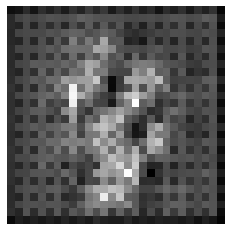

discriminator loss : 0.34080952405929565
Generator loss : [0.34263733, 0.0]
(1, 28, 28, 1)
(28, 28)


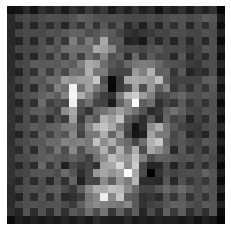

discriminator loss : 0.32246434688568115
Generator loss : [0.31673715, 0.0]
(1, 28, 28, 1)
(28, 28)


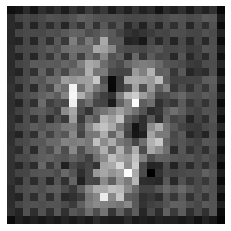

discriminator loss : 0.3283870220184326
Generator loss : [0.31882194, 0.0]
(1, 28, 28, 1)
(28, 28)


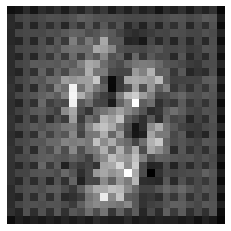

discriminator loss : 0.3266146183013916
Generator loss : [0.34484142, 0.0]
(1, 28, 28, 1)
(28, 28)


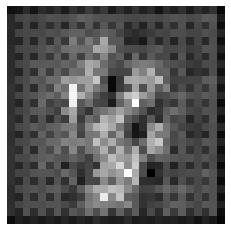

discriminator loss : 0.32556846737861633
Generator loss : [0.34243813, 0.0]
(1, 28, 28, 1)
(28, 28)


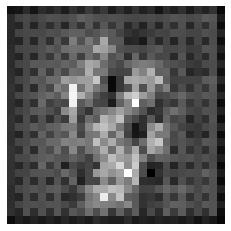

discriminator loss : 0.33096057176589966
Generator loss : [0.31459865, 0.0]
(1, 28, 28, 1)
(28, 28)


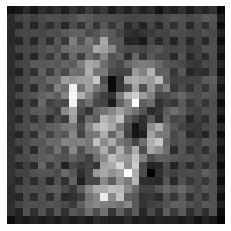

discriminator loss : 0.3102250099182129
Generator loss : [0.31541437, 0.0]
(1, 28, 28, 1)
(28, 28)


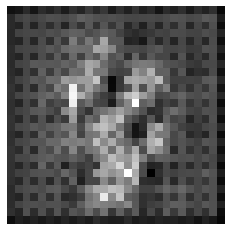

discriminator loss : 0.3199012875556946
Generator loss : [0.29437533, 0.0]
(1, 28, 28, 1)
(28, 28)


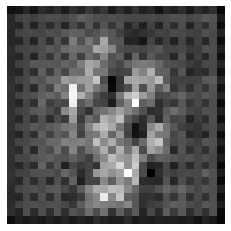

discriminator loss : 0.3285472095012665
Generator loss : [0.3284649, 0.0]
(1, 28, 28, 1)
(28, 28)


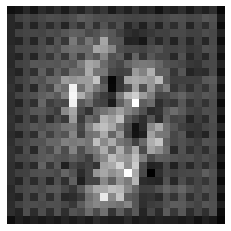

discriminator loss : 0.33179008960723877
Generator loss : [0.3318193, 0.0]
(1, 28, 28, 1)
(28, 28)


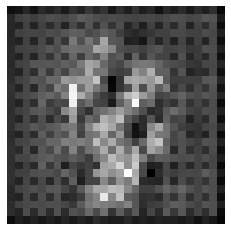

discriminator loss : 0.33234402537345886
Generator loss : [0.32592905, 0.0]
(1, 28, 28, 1)
(28, 28)


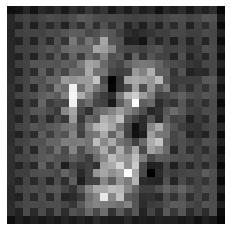

discriminator loss : 0.3222271203994751
Generator loss : [0.30692628, 0.0]
(1, 28, 28, 1)
(28, 28)


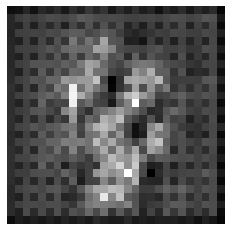

discriminator loss : 0.32266831398010254
Generator loss : [0.31317508, 0.0]
(1, 28, 28, 1)
(28, 28)


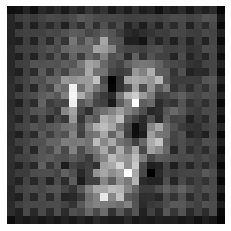

discriminator loss : 0.33016452193260193
Generator loss : [0.31673706, 0.0]
(1, 28, 28, 1)
(28, 28)


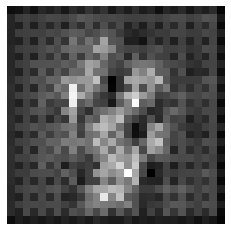

discriminator loss : 0.3409925699234009
Generator loss : [0.35108605, 0.0]
(1, 28, 28, 1)
(28, 28)


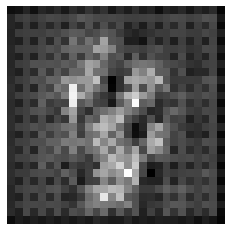

discriminator loss : 0.31878983974456787
Generator loss : [0.31441587, 0.0]
(1, 28, 28, 1)
(28, 28)


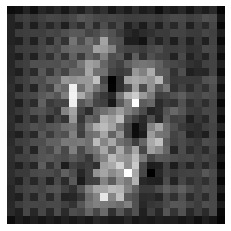

discriminator loss : 0.3283371925354004
Generator loss : [0.3502526, 0.0]
(1, 28, 28, 1)
(28, 28)


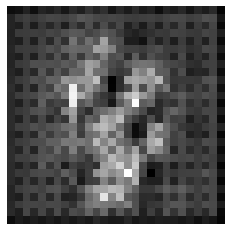

discriminator loss : 0.33098405599594116
Generator loss : [0.33558884, 0.0]
(1, 28, 28, 1)
(28, 28)


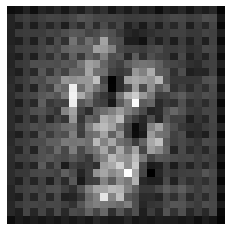

discriminator loss : 0.3347051739692688
Generator loss : [0.34664208, 0.0]
(1, 28, 28, 1)
(28, 28)


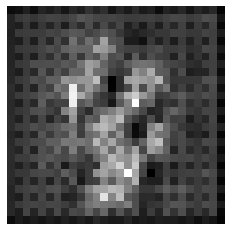

discriminator loss : 0.33256012201309204
Generator loss : [0.3361533, 0.0]
(1, 28, 28, 1)
(28, 28)


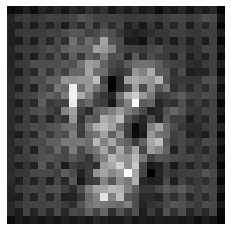

discriminator loss : 0.31978586316108704
Generator loss : [0.31197083, 0.0]
(1, 28, 28, 1)
(28, 28)


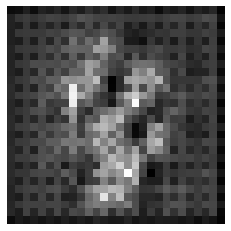

discriminator loss : 0.3258228003978729
Generator loss : [0.32297465, 0.0]
(1, 28, 28, 1)
(28, 28)


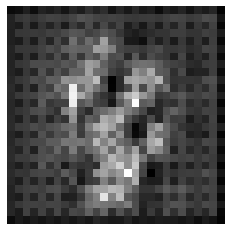

discriminator loss : 0.31335508823394775
Generator loss : [0.3286681, 0.0]
(1, 28, 28, 1)
(28, 28)


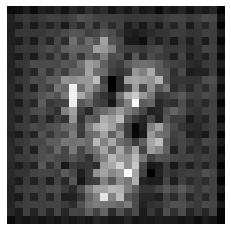

discriminator loss : 0.33810341358184814
Generator loss : [0.34370983, 0.0]
(1, 28, 28, 1)
(28, 28)


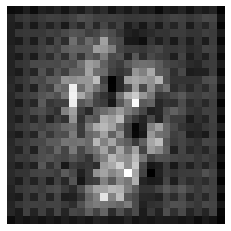

discriminator loss : 0.31842559576034546
Generator loss : [0.31321377, 0.0]
(1, 28, 28, 1)
(28, 28)


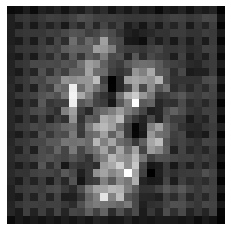

discriminator loss : 0.32963061332702637
Generator loss : [0.3338062, 0.0]
(1, 28, 28, 1)
(28, 28)


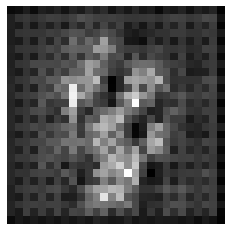

discriminator loss : 0.3085322678089142
Generator loss : [0.3151038, 0.0]
(1, 28, 28, 1)
(28, 28)


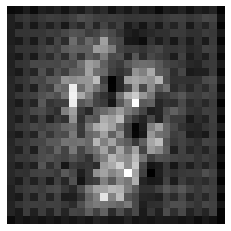

discriminator loss : 0.32370471954345703
Generator loss : [0.32433608, 0.0]
(1, 28, 28, 1)
(28, 28)


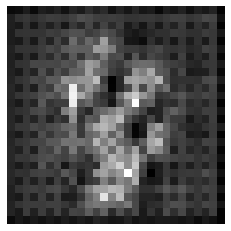

discriminator loss : 0.3279435634613037
Generator loss : [0.323564, 0.0]
(1, 28, 28, 1)
(28, 28)


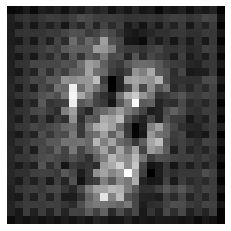

discriminator loss : 0.3162447214126587
Generator loss : [0.31157258, 0.0]
(1, 28, 28, 1)
(28, 28)


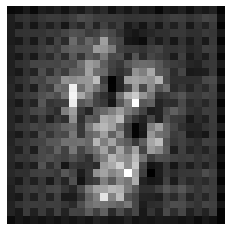

discriminator loss : 0.3350723385810852
Generator loss : [0.3219816, 0.0]
(1, 28, 28, 1)
(28, 28)


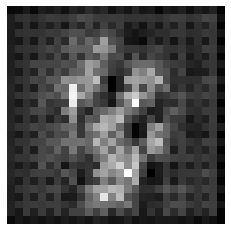

discriminator loss : 0.33638882637023926
Generator loss : [0.32895607, 0.0]
(1, 28, 28, 1)
(28, 28)


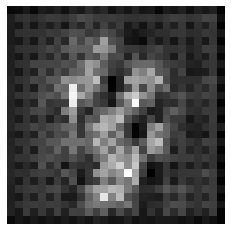

discriminator loss : 0.32779330015182495
Generator loss : [0.31667054, 0.0]
(1, 28, 28, 1)
(28, 28)


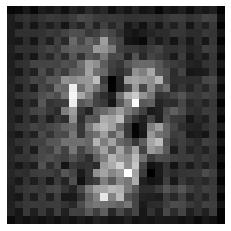

discriminator loss : 0.3299371898174286
Generator loss : [0.31866604, 0.0]
(1, 28, 28, 1)
(28, 28)


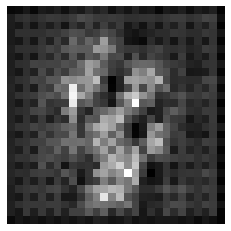

discriminator loss : 0.34008562564849854
Generator loss : [0.3341397, 0.0]
(1, 28, 28, 1)
(28, 28)


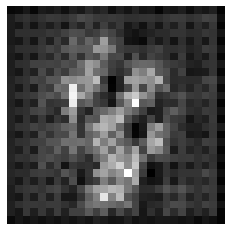

discriminator loss : 0.3267272114753723
Generator loss : [0.33125332, 0.0]
(1, 28, 28, 1)
(28, 28)


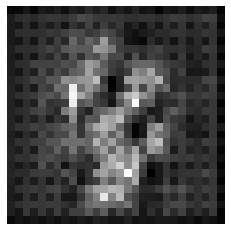

discriminator loss : 0.339138001203537
Generator loss : [0.3307735, 0.0]
(1, 28, 28, 1)
(28, 28)


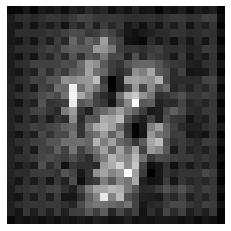

discriminator loss : 0.3444843888282776
Generator loss : [0.3447748, 0.0]
(1, 28, 28, 1)
(28, 28)


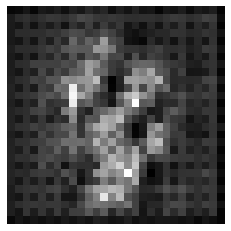

discriminator loss : 0.32177019119262695
Generator loss : [0.3186945, 0.0]
(1, 28, 28, 1)
(28, 28)


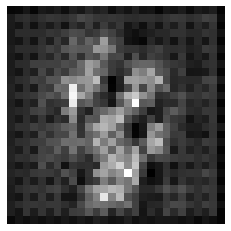

discriminator loss : 0.3321775197982788
Generator loss : [0.3315693, 0.0]
(1, 28, 28, 1)
(28, 28)


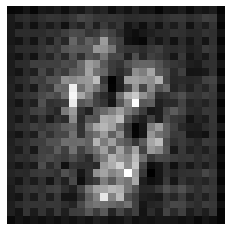

discriminator loss : 0.3302416205406189
Generator loss : [0.332904, 0.0]
(1, 28, 28, 1)
(28, 28)


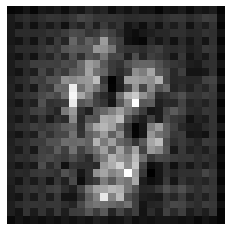

discriminator loss : 0.3343399167060852
Generator loss : [0.3418397, 0.0]
(1, 28, 28, 1)
(28, 28)


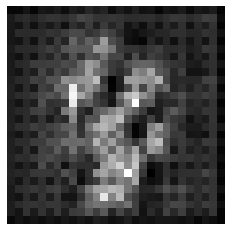

discriminator loss : 0.32525163888931274
Generator loss : [0.32942864, 0.0]
(1, 28, 28, 1)
(28, 28)


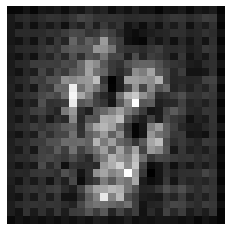

discriminator loss : 0.32177799940109253
Generator loss : [0.32068345, 0.0]
(1, 28, 28, 1)
(28, 28)


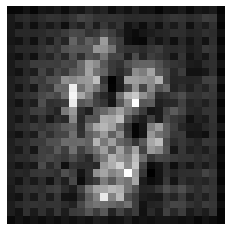

discriminator loss : 0.32582396268844604
Generator loss : [0.32723182, 0.0]
(1, 28, 28, 1)
(28, 28)


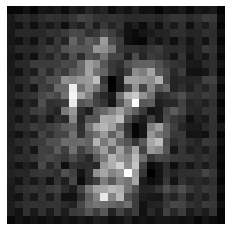

discriminator loss : 0.32795608043670654
Generator loss : [0.32704276, 0.0]
(1, 28, 28, 1)
(28, 28)


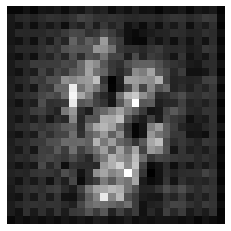

discriminator loss : 0.3430835008621216
Generator loss : [0.3424133, 0.0]
(1, 28, 28, 1)
(28, 28)


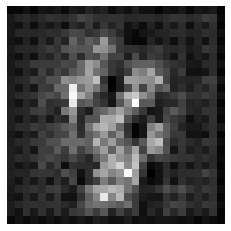

discriminator loss : 0.3225541114807129
Generator loss : [0.31924334, 0.0]
(1, 28, 28, 1)
(28, 28)


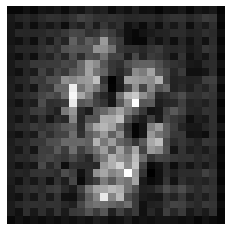

discriminator loss : 0.3414667844772339
Generator loss : [0.3420717, 0.0]
(1, 28, 28, 1)
(28, 28)


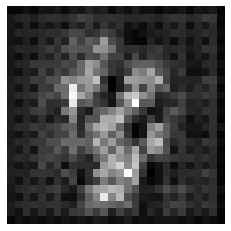

discriminator loss : 0.3260522484779358
Generator loss : [0.322761, 0.0]
(1, 28, 28, 1)
(28, 28)


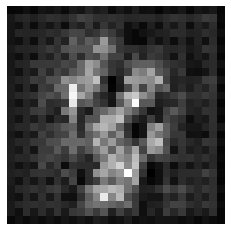

discriminator loss : 0.32547158002853394
Generator loss : [0.30582592, 0.0]
(1, 28, 28, 1)
(28, 28)


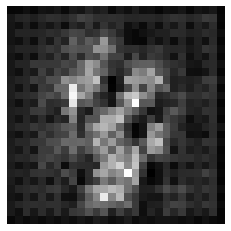

discriminator loss : 0.3358922004699707
Generator loss : [0.3301664, 0.0]
(1, 28, 28, 1)
(28, 28)


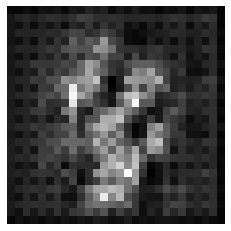

discriminator loss : 0.3272581100463867
Generator loss : [0.335633, 0.0]
(1, 28, 28, 1)
(28, 28)


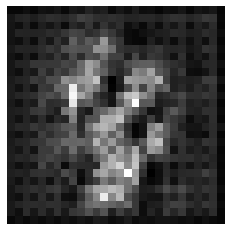

discriminator loss : 0.3373401463031769
Generator loss : [0.34382558, 0.0]
(1, 28, 28, 1)
(28, 28)


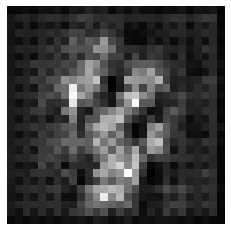

discriminator loss : 0.32614585757255554
Generator loss : [0.33632016, 0.0]
(1, 28, 28, 1)
(28, 28)


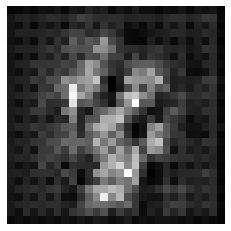

discriminator loss : 0.3288933336734772
Generator loss : [0.3395521, 0.0]
(1, 28, 28, 1)
(28, 28)


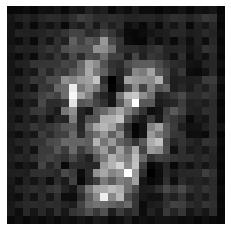

discriminator loss : 0.3432121276855469
Generator loss : [0.3610001, 0.0]
(1, 28, 28, 1)
(28, 28)


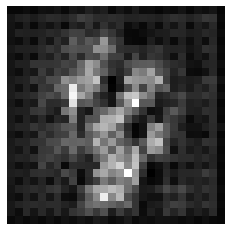

discriminator loss : 0.32500195503234863
Generator loss : [0.33232498, 0.0]
(1, 28, 28, 1)
(28, 28)


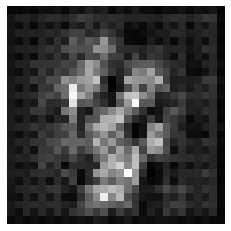

discriminator loss : 0.34173843264579773
Generator loss : [0.35185355, 0.0]
(1, 28, 28, 1)
(28, 28)


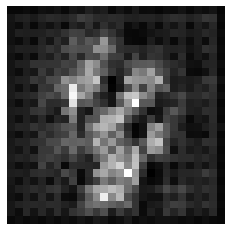

discriminator loss : 0.32758259773254395
Generator loss : [0.32605892, 0.0]
(1, 28, 28, 1)
(28, 28)


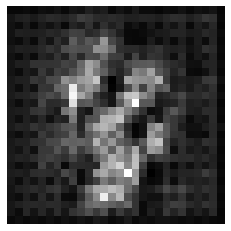

discriminator loss : 0.3372570276260376
Generator loss : [0.3389111, 0.0]
(1, 28, 28, 1)
(28, 28)


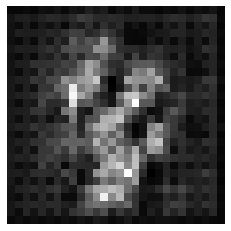

discriminator loss : 0.3153786063194275
Generator loss : [0.3135046, 0.0]
(1, 28, 28, 1)
(28, 28)


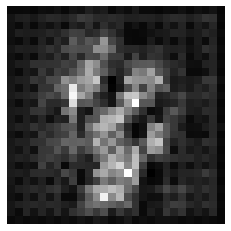

discriminator loss : 0.3288717269897461
Generator loss : [0.31406453, 0.0]
(1, 28, 28, 1)
(28, 28)


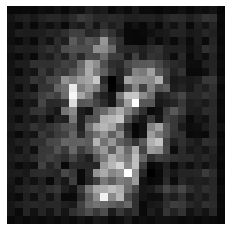

discriminator loss : 0.32708555459976196
Generator loss : [0.33056816, 0.0]
(1, 28, 28, 1)
(28, 28)


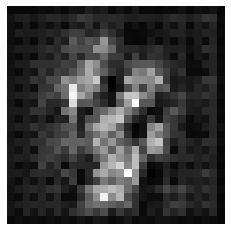

discriminator loss : 0.3304765820503235
Generator loss : [0.3295499, 0.0]
(1, 28, 28, 1)
(28, 28)


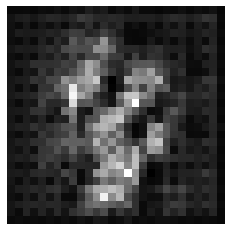

discriminator loss : 0.33027157187461853
Generator loss : [0.33481467, 0.0]
(1, 28, 28, 1)
(28, 28)


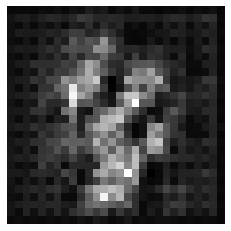

discriminator loss : 0.3287496864795685
Generator loss : [0.3483204, 0.0]
(1, 28, 28, 1)
(28, 28)


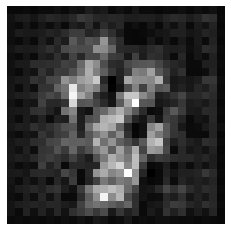

discriminator loss : 0.33343505859375
Generator loss : [0.3341568, 0.0]
(1, 28, 28, 1)
(28, 28)


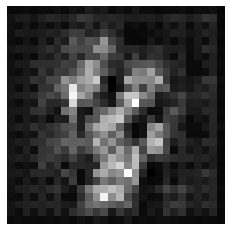

discriminator loss : 0.3318280577659607
Generator loss : [0.33967, 0.0]
(1, 28, 28, 1)
(28, 28)


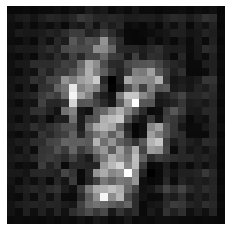

discriminator loss : 0.31379246711730957
Generator loss : [0.3195278, 0.0]
(1, 28, 28, 1)
(28, 28)


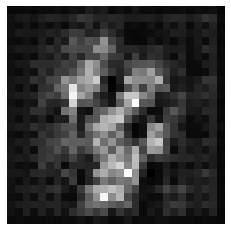

discriminator loss : 0.32060956954956055
Generator loss : [0.3277946, 0.0]
(1, 28, 28, 1)
(28, 28)


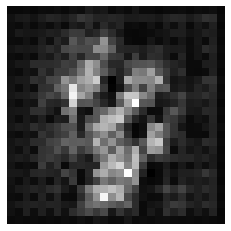

discriminator loss : 0.3352852165699005
Generator loss : [0.33314937, 0.0]
(1, 28, 28, 1)
(28, 28)


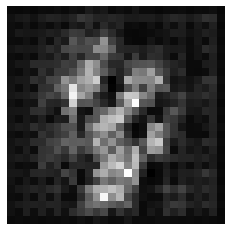

discriminator loss : 0.32382506132125854
Generator loss : [0.32394272, 0.0]
(1, 28, 28, 1)
(28, 28)


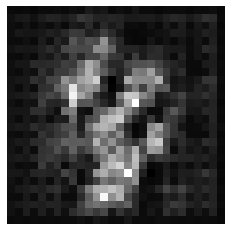

discriminator loss : 0.3281559944152832
Generator loss : [0.32548648, 0.0]
(1, 28, 28, 1)
(28, 28)


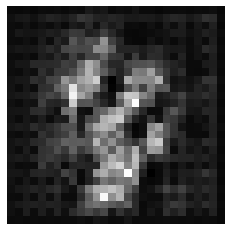

discriminator loss : 0.3343700170516968
Generator loss : [0.3322853, 0.0]
(1, 28, 28, 1)
(28, 28)


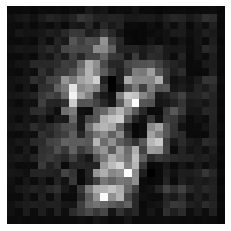

discriminator loss : 0.3136424422264099
Generator loss : [0.31912985, 0.0]
(1, 28, 28, 1)
(28, 28)


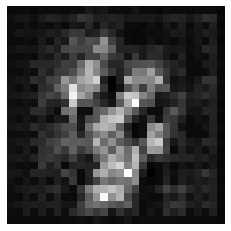

discriminator loss : 0.32505011558532715
Generator loss : [0.32458705, 0.0]
(1, 28, 28, 1)
(28, 28)


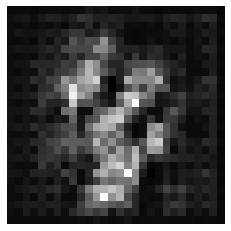

discriminator loss : 0.3321956992149353
Generator loss : [0.32306778, 0.0]
(1, 28, 28, 1)
(28, 28)


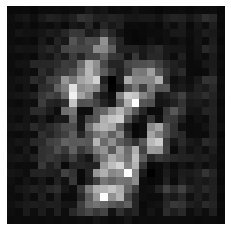

discriminator loss : 0.34126389026641846
Generator loss : [0.3389631, 0.0]
(1, 28, 28, 1)
(28, 28)


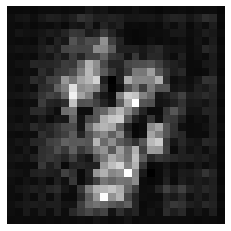

discriminator loss : 0.32741180062294006
Generator loss : [0.3436117, 0.0]
(1, 28, 28, 1)
(28, 28)


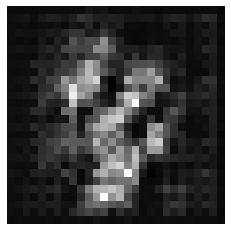

discriminator loss : 0.32553499937057495
Generator loss : [0.34714046, 0.0]
(1, 28, 28, 1)
(28, 28)


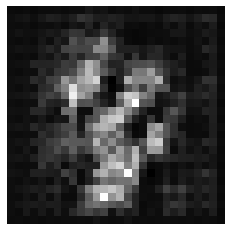

discriminator loss : 0.3340612053871155
Generator loss : [0.3334742, 0.0]
(1, 28, 28, 1)
(28, 28)


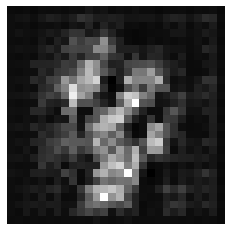

discriminator loss : 0.33666089177131653
Generator loss : [0.34416088, 0.0]
(1, 28, 28, 1)
(28, 28)


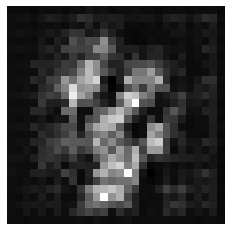

discriminator loss : 0.33626723289489746
Generator loss : [0.34503606, 0.0]
(1, 28, 28, 1)
(28, 28)


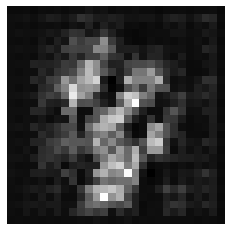

discriminator loss : 0.3256392478942871
Generator loss : [0.33136696, 0.0]
(1, 28, 28, 1)
(28, 28)


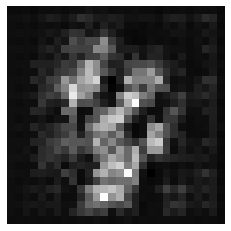

discriminator loss : 0.3216012716293335
Generator loss : [0.322011, 0.0]
(1, 28, 28, 1)
(28, 28)


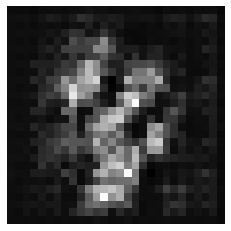

discriminator loss : 0.3397948741912842
Generator loss : [0.34349895, 0.0]
(1, 28, 28, 1)
(28, 28)


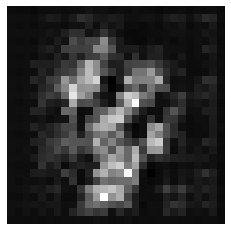

discriminator loss : 0.32415807247161865
Generator loss : [0.32775962, 0.0]
(1, 28, 28, 1)
(28, 28)


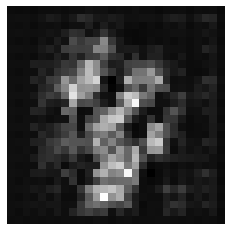

discriminator loss : 0.3418191075325012
Generator loss : [0.3529572, 0.0]
(1, 28, 28, 1)
(28, 28)


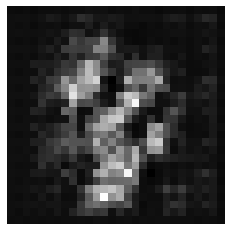

discriminator loss : 0.33670228719711304
Generator loss : [0.33038932, 0.0]
(1, 28, 28, 1)
(28, 28)


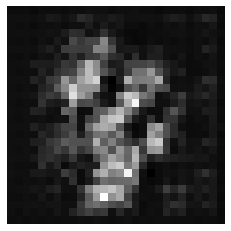

discriminator loss : 0.3467891812324524
Generator loss : [0.34776706, 0.0]
(1, 28, 28, 1)
(28, 28)


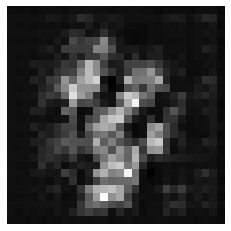

discriminator loss : 0.33761268854141235
Generator loss : [0.3399107, 0.0]
(1, 28, 28, 1)
(28, 28)


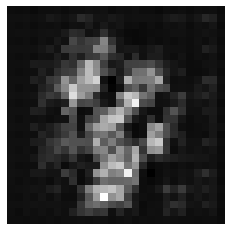

discriminator loss : 0.3266075849533081
Generator loss : [0.31120524, 0.0]
(1, 28, 28, 1)
(28, 28)


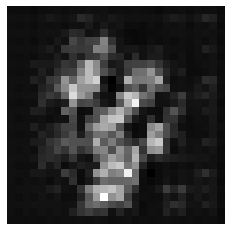

discriminator loss : 0.33598071336746216
Generator loss : [0.32761523, 0.0]
(1, 28, 28, 1)
(28, 28)


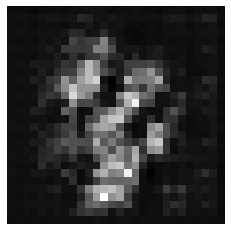

discriminator loss : 0.33125895261764526
Generator loss : [0.34672555, 0.0]
(1, 28, 28, 1)
(28, 28)


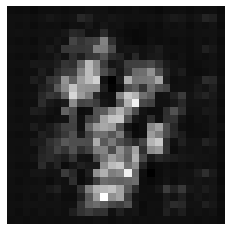

discriminator loss : 0.34226539731025696
Generator loss : [0.34964553, 0.0]
(1, 28, 28, 1)
(28, 28)


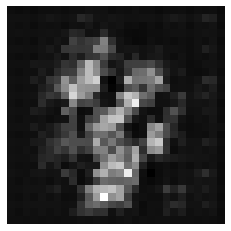

discriminator loss : 0.35221076011657715
Generator loss : [0.3172816, 0.0]
(1, 28, 28, 1)
(28, 28)


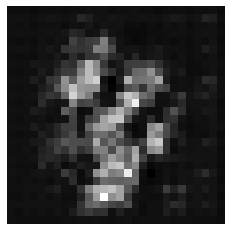

discriminator loss : 0.33561697602272034
Generator loss : [0.3100987, 0.0]
(1, 28, 28, 1)
(28, 28)


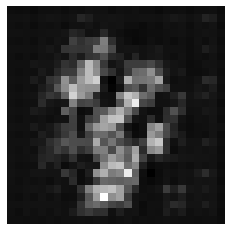

discriminator loss : 0.36242207884788513
Generator loss : [0.3313743, 0.0]
(1, 28, 28, 1)
(28, 28)


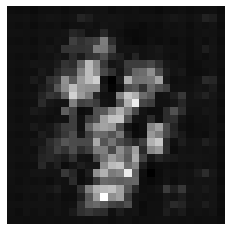

discriminator loss : 0.34294241666793823
Generator loss : [0.3244726, 0.0]
(1, 28, 28, 1)
(28, 28)


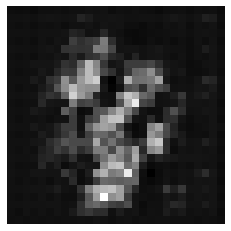

discriminator loss : 0.3472544550895691
Generator loss : [0.3279829, 0.0]
(1, 28, 28, 1)
(28, 28)


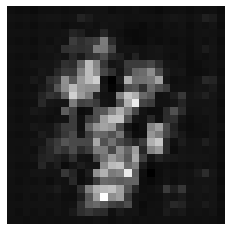

discriminator loss : 0.34623342752456665
Generator loss : [0.32942578, 0.0]
(1, 28, 28, 1)
(28, 28)


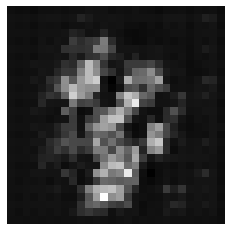

discriminator loss : 0.3513041138648987
Generator loss : [0.3341321, 0.0]
(1, 28, 28, 1)
(28, 28)


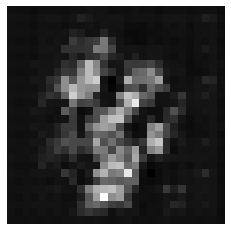

discriminator loss : 0.35874801874160767
Generator loss : [0.32881042, 0.0]
(1, 28, 28, 1)
(28, 28)


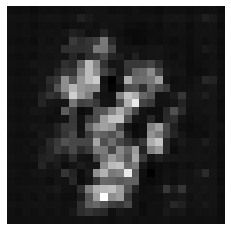

discriminator loss : 0.3393959403038025
Generator loss : [0.33495995, 0.0]
(1, 28, 28, 1)
(28, 28)


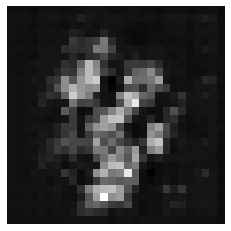

discriminator loss : 0.343075156211853
Generator loss : [0.32654902, 0.0]
(1, 28, 28, 1)
(28, 28)


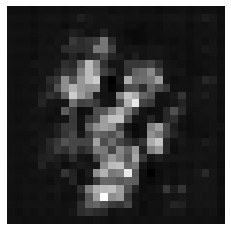

discriminator loss : 0.341128408908844
Generator loss : [0.31883228, 0.0]
(1, 28, 28, 1)
(28, 28)


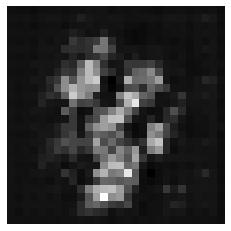

discriminator loss : 0.3350435495376587
Generator loss : [0.32663086, 0.0]
(1, 28, 28, 1)
(28, 28)


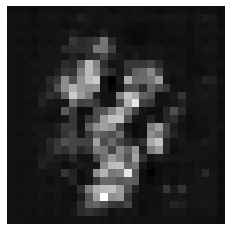

discriminator loss : 0.3094250559806824
Generator loss : [0.30839923, 0.0]
(1, 28, 28, 1)
(28, 28)


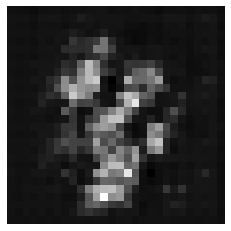

discriminator loss : 0.32586631178855896
Generator loss : [0.3183894, 0.0]
(1, 28, 28, 1)
(28, 28)


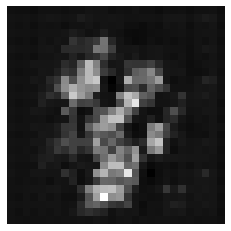

discriminator loss : 0.34497323632240295
Generator loss : [0.3320468, 0.0]
(1, 28, 28, 1)
(28, 28)


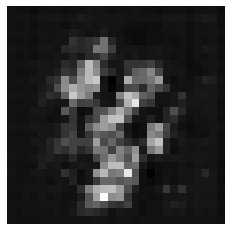

discriminator loss : 0.33465564250946045
Generator loss : [0.3451515, 0.0]
(1, 28, 28, 1)
(28, 28)


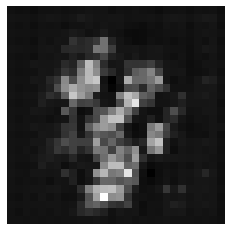

discriminator loss : 0.32931211590766907
Generator loss : [0.32603204, 0.0]
(1, 28, 28, 1)
(28, 28)


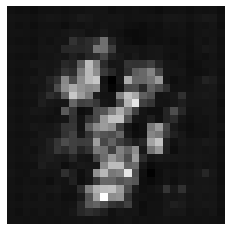

discriminator loss : 0.33942705392837524
Generator loss : [0.33930466, 0.0]
(1, 28, 28, 1)
(28, 28)


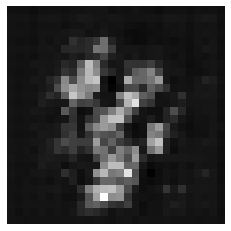

discriminator loss : 0.3410472273826599
Generator loss : [0.35038978, 0.0]
(1, 28, 28, 1)
(28, 28)


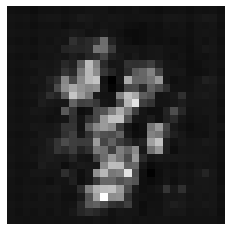

discriminator loss : 0.3326600193977356
Generator loss : [0.31943625, 0.0]
(1, 28, 28, 1)
(28, 28)


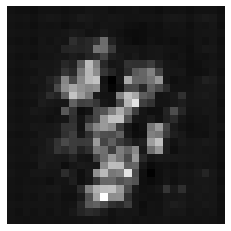

discriminator loss : 0.34077897667884827
Generator loss : [0.33359295, 0.0]
(1, 28, 28, 1)
(28, 28)


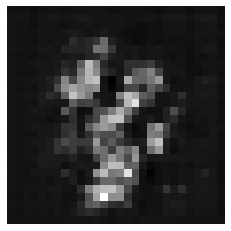

discriminator loss : 0.3480956554412842
Generator loss : [0.34660214, 0.0]
(1, 28, 28, 1)
(28, 28)


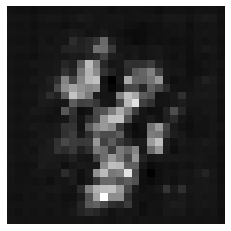

discriminator loss : 0.3438918888568878
Generator loss : [0.32788077, 0.0]
(1, 28, 28, 1)
(28, 28)


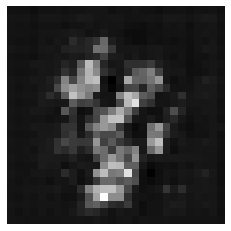

discriminator loss : 0.3395109176635742
Generator loss : [0.3253973, 0.0]
(1, 28, 28, 1)
(28, 28)


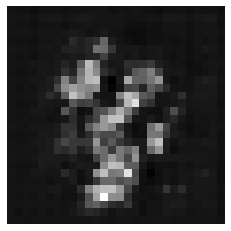

discriminator loss : 0.35905730724334717
Generator loss : [0.3329836, 0.0]
(1, 28, 28, 1)
(28, 28)


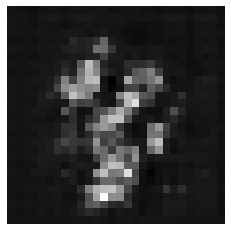

discriminator loss : 0.35893142223358154
Generator loss : [0.33033863, 0.0]
(1, 28, 28, 1)
(28, 28)


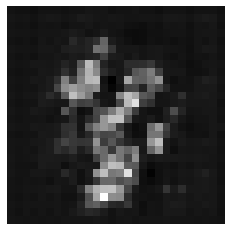

discriminator loss : 0.3478042185306549
Generator loss : [0.31682754, 0.0]
(1, 28, 28, 1)
(28, 28)


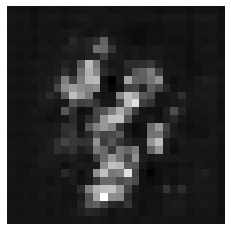

discriminator loss : 0.3505901098251343
Generator loss : [0.31783032, 0.0]
(1, 28, 28, 1)
(28, 28)


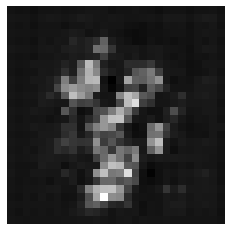

discriminator loss : 0.34071990847587585
Generator loss : [0.32935387, 0.0]
(1, 28, 28, 1)
(28, 28)


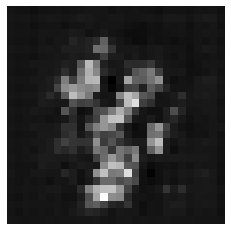

discriminator loss : 0.34893855452537537
Generator loss : [0.33306926, 0.0]
(1, 28, 28, 1)
(28, 28)


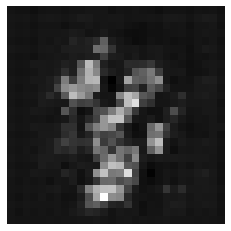

discriminator loss : 0.3360271453857422
Generator loss : [0.30676562, 0.0]
(1, 28, 28, 1)
(28, 28)


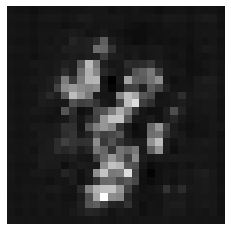

discriminator loss : 0.3577802777290344
Generator loss : [0.34290764, 0.0]
(1, 28, 28, 1)
(28, 28)


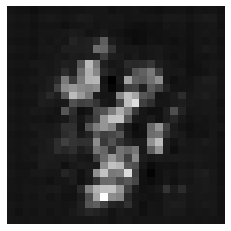

discriminator loss : 0.34172430634498596
Generator loss : [0.32615307, 0.0]
(1, 28, 28, 1)
(28, 28)


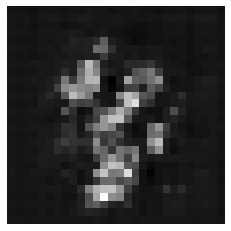

discriminator loss : 0.35727789998054504
Generator loss : [0.32101873, 0.0]
(1, 28, 28, 1)
(28, 28)


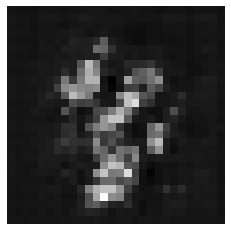

discriminator loss : 0.3661935329437256
Generator loss : [0.34539405, 0.0]
(1, 28, 28, 1)
(28, 28)


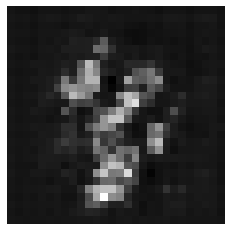

discriminator loss : 0.33344656229019165
Generator loss : [0.3465361, 0.0]
(1, 28, 28, 1)
(28, 28)


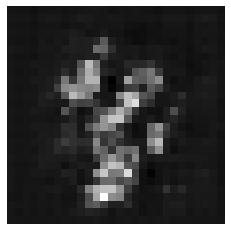

discriminator loss : 0.3280720114707947
Generator loss : [0.3220474, 0.0]
(1, 28, 28, 1)
(28, 28)


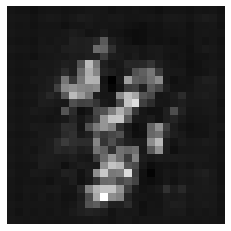

discriminator loss : 0.34791266918182373
Generator loss : [0.32846627, 0.0]
(1, 28, 28, 1)
(28, 28)


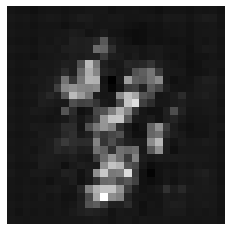

discriminator loss : 0.32818472385406494
Generator loss : [0.34521884, 0.0]
(1, 28, 28, 1)
(28, 28)


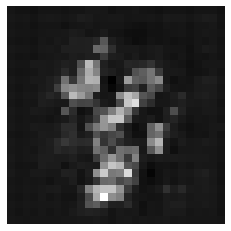

discriminator loss : 0.3472312092781067
Generator loss : [0.31723407, 0.0]
(1, 28, 28, 1)
(28, 28)


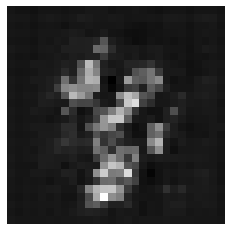

discriminator loss : 0.3620840907096863
Generator loss : [0.35688028, 0.0]
(1, 28, 28, 1)
(28, 28)


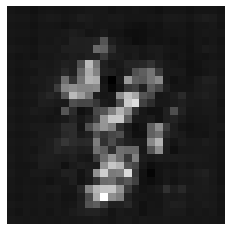

discriminator loss : 0.3497745096683502
Generator loss : [0.31621647, 0.0]
(1, 28, 28, 1)
(28, 28)


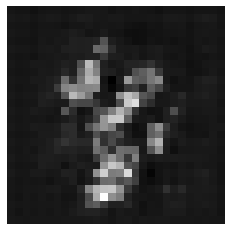

discriminator loss : 0.35588788986206055
Generator loss : [0.36471677, 0.0]
(1, 28, 28, 1)
(28, 28)


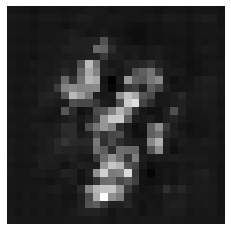

discriminator loss : 0.3379596471786499
Generator loss : [0.3152221, 0.0]
(1, 28, 28, 1)
(28, 28)


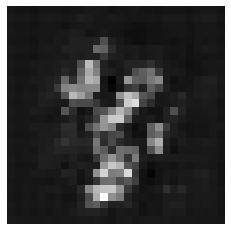

discriminator loss : 0.3513765335083008
Generator loss : [0.33388424, 0.0]
(1, 28, 28, 1)
(28, 28)


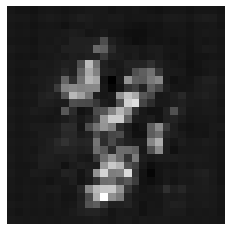

discriminator loss : 0.34720951318740845
Generator loss : [0.33223265, 0.0]
(1, 28, 28, 1)
(28, 28)


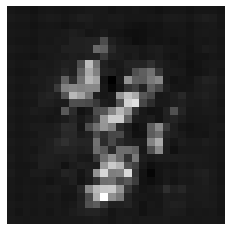

discriminator loss : 0.34897229075431824
Generator loss : [0.3238848, 0.0]
(1, 28, 28, 1)
(28, 28)


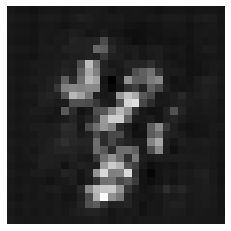

discriminator loss : 0.3564916253089905
Generator loss : [0.33596924, 0.0]
(1, 28, 28, 1)
(28, 28)


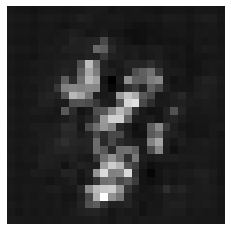

discriminator loss : 0.3864998519420624
Generator loss : [0.34739682, 0.0]
(1, 28, 28, 1)
(28, 28)


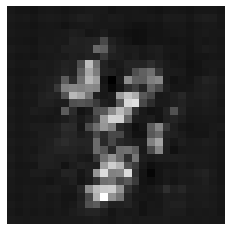

discriminator loss : 0.36155417561531067
Generator loss : [0.32713875, 0.0]
(1, 28, 28, 1)
(28, 28)


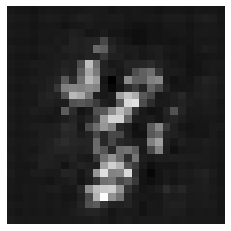

discriminator loss : 0.38481831550598145
Generator loss : [0.3495742, 0.0]
(1, 28, 28, 1)
(28, 28)


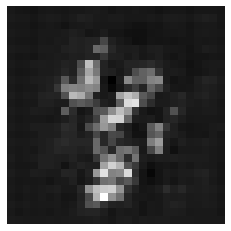

discriminator loss : 0.36263859272003174
Generator loss : [0.32730615, 0.0]
(1, 28, 28, 1)
(28, 28)


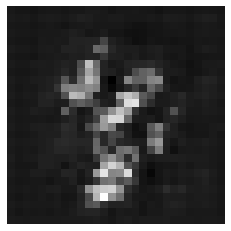

discriminator loss : 0.35831981897354126
Generator loss : [0.32820854, 0.0]
(1, 28, 28, 1)
(28, 28)


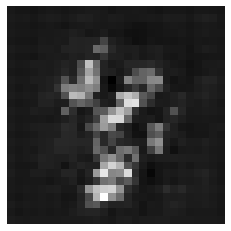

discriminator loss : 0.3902410864830017
Generator loss : [0.3625734, 0.0]
(1, 28, 28, 1)
(28, 28)


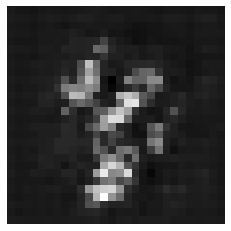

discriminator loss : 0.3912169337272644
Generator loss : [0.36602485, 0.0]
(1, 28, 28, 1)
(28, 28)


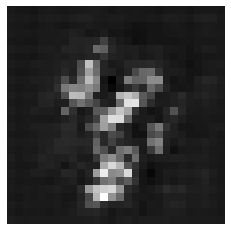

discriminator loss : 0.45504269003868103
Generator loss : [0.38069993, 0.0]
(1, 28, 28, 1)
(28, 28)


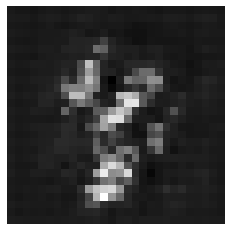

discriminator loss : 0.44425809383392334
Generator loss : [0.39652985, 0.0]
(1, 28, 28, 1)
(28, 28)


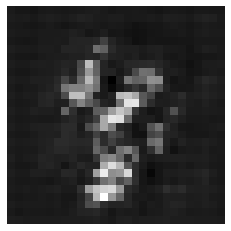

discriminator loss : 0.4331972002983093
Generator loss : [0.45100117, 0.0]
(1, 28, 28, 1)
(28, 28)


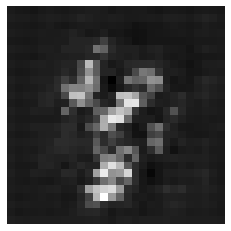

discriminator loss : 0.44855251908302307
Generator loss : [0.4938749, 0.0]
(1, 28, 28, 1)
(28, 28)


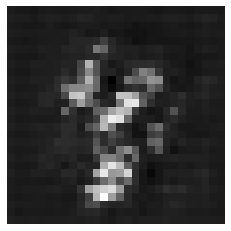

discriminator loss : 0.5392351150512695
Generator loss : [0.5852894, 0.0]
(1, 28, 28, 1)
(28, 28)


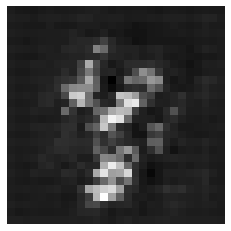

discriminator loss : 0.630752682685852
Generator loss : [0.6240855, 0.0]
(1, 28, 28, 1)
(28, 28)


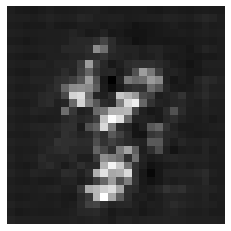

discriminator loss : 0.5936273336410522
Generator loss : [0.63399476, 0.0]
(1, 28, 28, 1)
(28, 28)


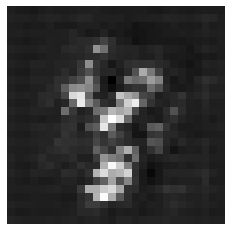

discriminator loss : 0.5538582801818848
Generator loss : [0.6748918, 0.0]
(1, 28, 28, 1)
(28, 28)


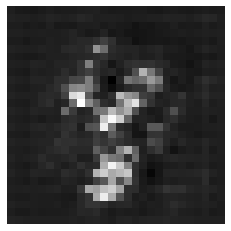

discriminator loss : 0.49472710490226746
Generator loss : [0.74483854, 0.0]
(1, 28, 28, 1)
(28, 28)


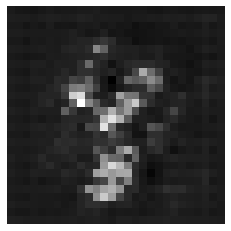

discriminator loss : 0.47912803292274475
Generator loss : [0.8549664, 0.0]
(1, 28, 28, 1)
(28, 28)


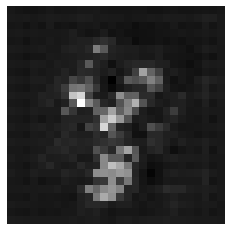

discriminator loss : 0.4252215325832367
Generator loss : [1.0204918, 0.0]
(1, 28, 28, 1)
(28, 28)


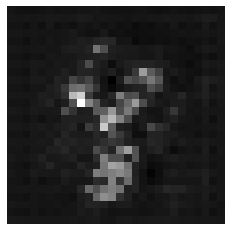

discriminator loss : 0.4195858836174011
Generator loss : [1.1783673, 0.0]
(1, 28, 28, 1)
(28, 28)


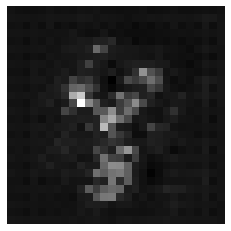

discriminator loss : 0.4338364601135254
Generator loss : [1.4441698, 0.0]
(1, 28, 28, 1)
(28, 28)


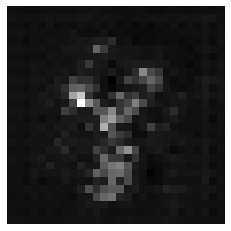

discriminator loss : 0.42592892050743103
Generator loss : [1.5987296, 0.0]
(1, 28, 28, 1)
(28, 28)


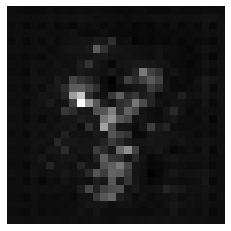

discriminator loss : 0.41647979617118835
Generator loss : [1.7700957, 0.0]
(1, 28, 28, 1)
(28, 28)


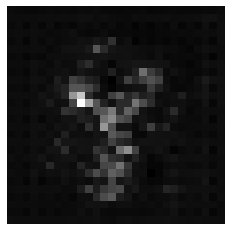

discriminator loss : 0.36713188886642456
Generator loss : [1.8352678, 0.0]
(1, 28, 28, 1)
(28, 28)


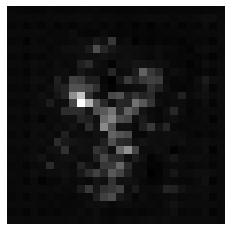

discriminator loss : 0.3828417956829071
Generator loss : [2.119987, 0.0]
(1, 28, 28, 1)
(28, 28)


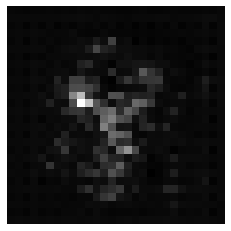

discriminator loss : 0.4554092586040497
Generator loss : [2.4709997, 0.0]
(1, 28, 28, 1)
(28, 28)


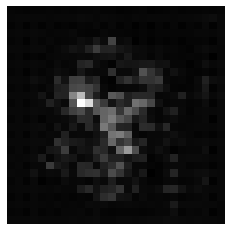

discriminator loss : 0.667216420173645
Generator loss : [3.2212372, 0.0]
(1, 28, 28, 1)
(28, 28)


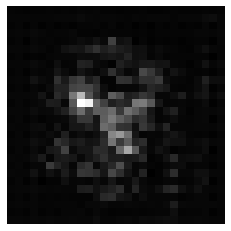

discriminator loss : 1.031946063041687
Generator loss : [2.7668257, 0.0]
(1, 28, 28, 1)
(28, 28)


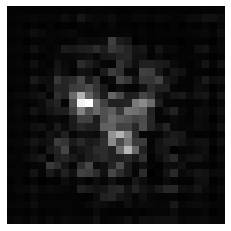

discriminator loss : 0.5219546556472778
Generator loss : [0.7374432, 0.0]
(1, 28, 28, 1)
(28, 28)


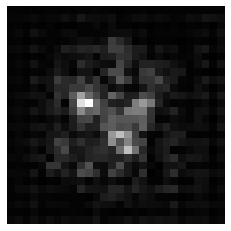

discriminator loss : 0.3911742568016052
Generator loss : [0.37581292, 0.0]
(1, 28, 28, 1)
(28, 28)


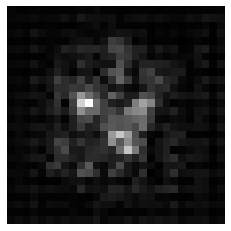

discriminator loss : 0.36759114265441895
Generator loss : [0.35789785, 0.0]
(1, 28, 28, 1)
(28, 28)


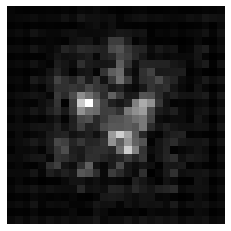

discriminator loss : 0.3678819537162781
Generator loss : [0.31373706, 0.0]
(1, 28, 28, 1)
(28, 28)


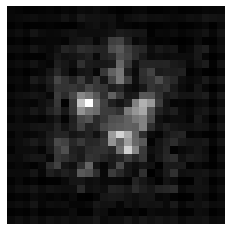

discriminator loss : 0.36921411752700806
Generator loss : [0.31763127, 0.0]
(1, 28, 28, 1)
(28, 28)


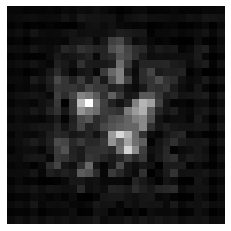

discriminator loss : 0.37016063928604126
Generator loss : [0.3201445, 0.0]
(1, 28, 28, 1)
(28, 28)


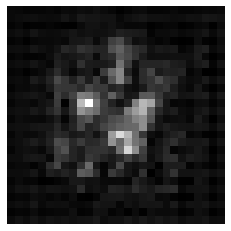

discriminator loss : 0.36110952496528625
Generator loss : [0.33413953, 0.0]
(1, 28, 28, 1)
(28, 28)


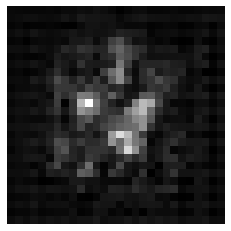

discriminator loss : 0.35965144634246826
Generator loss : [0.34885, 0.0]
(1, 28, 28, 1)
(28, 28)


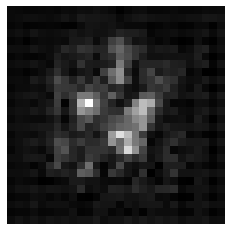

discriminator loss : 0.3311977684497833
Generator loss : [0.29801962, 0.0]
(1, 28, 28, 1)
(28, 28)


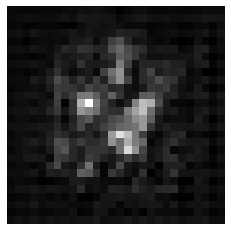

discriminator loss : 0.33992183208465576
Generator loss : [0.3213068, 0.0]
(1, 28, 28, 1)
(28, 28)


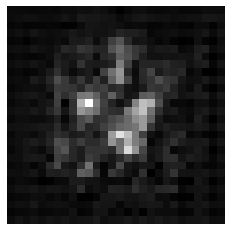

discriminator loss : 0.3554362654685974
Generator loss : [0.33700946, 0.0]
(1, 28, 28, 1)
(28, 28)


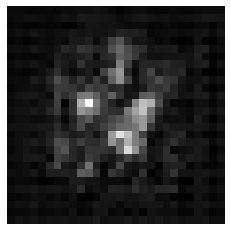

discriminator loss : 0.36336228251457214
Generator loss : [0.33195767, 0.0]
(1, 28, 28, 1)
(28, 28)


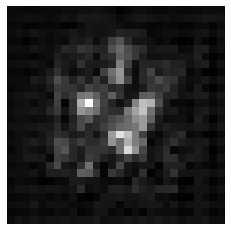

discriminator loss : 0.3401535451412201
Generator loss : [0.31362632, 0.0]
(1, 28, 28, 1)
(28, 28)


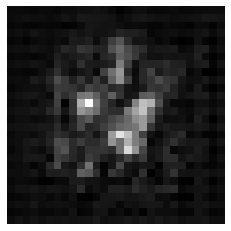

discriminator loss : 0.3500206172466278
Generator loss : [0.32308248, 0.0]
(1, 28, 28, 1)
(28, 28)


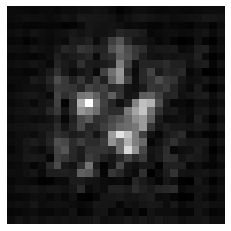

discriminator loss : 0.33977627754211426
Generator loss : [0.32794315, 0.0]
(1, 28, 28, 1)
(28, 28)


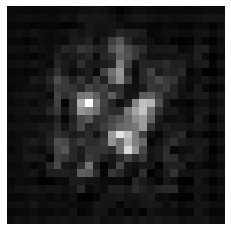

discriminator loss : 0.35692542791366577
Generator loss : [0.33904564, 0.0]
(1, 28, 28, 1)
(28, 28)


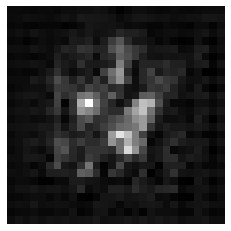

discriminator loss : 0.3462930917739868
Generator loss : [0.33355355, 0.0]
(1, 28, 28, 1)
(28, 28)


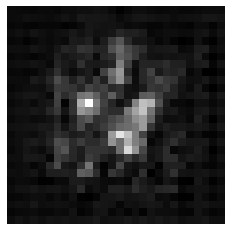

discriminator loss : 0.3298911452293396
Generator loss : [0.3112576, 0.0]
(1, 28, 28, 1)
(28, 28)


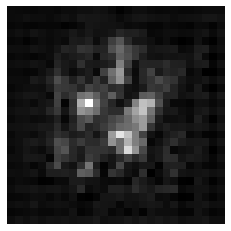

discriminator loss : 0.3164682388305664
Generator loss : [0.32363835, 0.0]
(1, 28, 28, 1)
(28, 28)


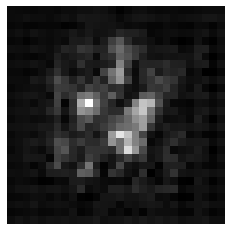

discriminator loss : 0.3484842777252197
Generator loss : [0.3257703, 0.0]
(1, 28, 28, 1)
(28, 28)


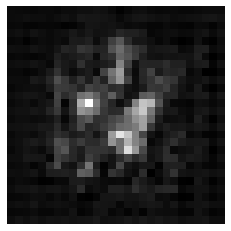

discriminator loss : 0.33870574831962585
Generator loss : [0.34243643, 0.0]
(1, 28, 28, 1)
(28, 28)


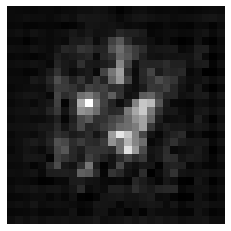

discriminator loss : 0.3389517366886139
Generator loss : [0.3301273, 0.0]
(1, 28, 28, 1)
(28, 28)


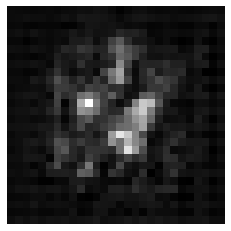

discriminator loss : 0.3419067859649658
Generator loss : [0.31321648, 0.0]
(1, 28, 28, 1)
(28, 28)


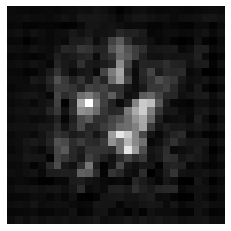

discriminator loss : 0.3572339415550232
Generator loss : [0.35205013, 0.0]
(1, 28, 28, 1)
(28, 28)


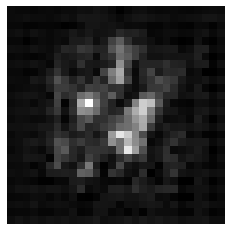

discriminator loss : 0.34379780292510986
Generator loss : [0.3434848, 0.0]
(1, 28, 28, 1)
(28, 28)


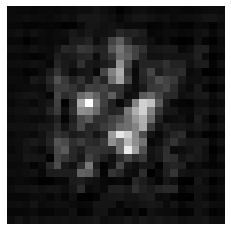

discriminator loss : 0.33737242221832275
Generator loss : [0.33859912, 0.0]
(1, 28, 28, 1)
(28, 28)


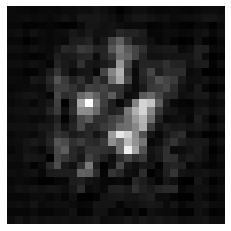

discriminator loss : 0.3497641980648041
Generator loss : [0.34069106, 0.0]
(1, 28, 28, 1)
(28, 28)


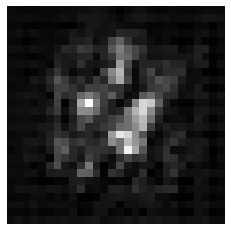

discriminator loss : 0.32066482305526733
Generator loss : [0.35291013, 0.0]
(1, 28, 28, 1)
(28, 28)


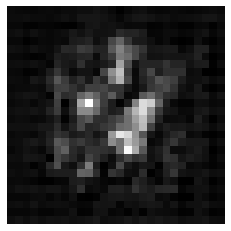

discriminator loss : 0.342637836933136
Generator loss : [0.341801, 0.0]
(1, 28, 28, 1)
(28, 28)


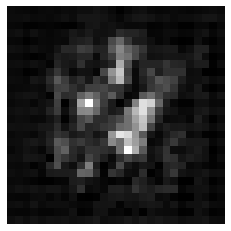

discriminator loss : 0.3390868008136749
Generator loss : [0.37354982, 0.0]
(1, 28, 28, 1)
(28, 28)


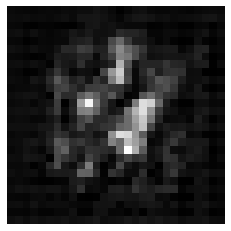

discriminator loss : 0.343777060508728
Generator loss : [0.36535674, 0.0]
(1, 28, 28, 1)
(28, 28)


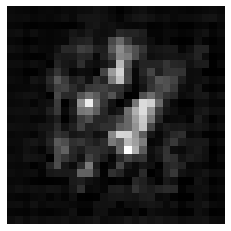

discriminator loss : 0.3378019332885742
Generator loss : [0.40503415, 0.0]
(1, 28, 28, 1)
(28, 28)


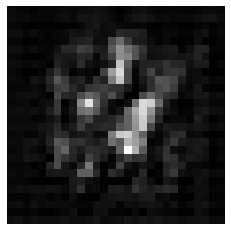

discriminator loss : 0.33924245834350586
Generator loss : [0.4540289, 0.0]
(1, 28, 28, 1)
(28, 28)


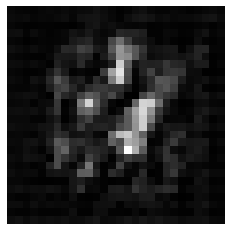

discriminator loss : 0.4098779559135437
Generator loss : [0.5606559, 0.0]
(1, 28, 28, 1)
(28, 28)


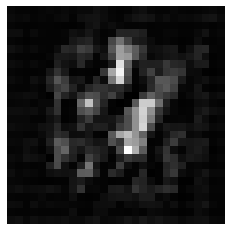

discriminator loss : 0.5134178996086121
Generator loss : [0.75294334, 0.0]
(1, 28, 28, 1)
(28, 28)


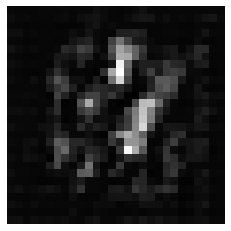

discriminator loss : 0.6845718622207642
Generator loss : [0.6833526, 0.0]
(1, 28, 28, 1)
(28, 28)


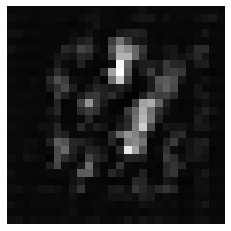

discriminator loss : 0.5276303887367249
Generator loss : [0.77091444, 0.0]
(1, 28, 28, 1)
(28, 28)


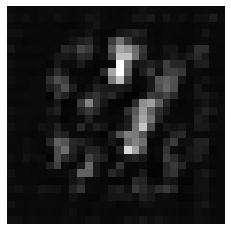

discriminator loss : 0.6703610420227051
Generator loss : [0.8833597, 0.0]
(1, 28, 28, 1)
(28, 28)


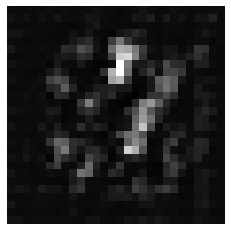

discriminator loss : 0.638984203338623
Generator loss : [0.9453315, 0.0]
(1, 28, 28, 1)
(28, 28)


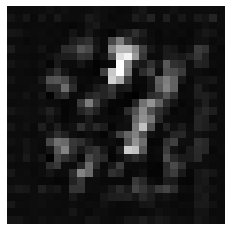

discriminator loss : 0.7623006105422974
Generator loss : [0.7855859, 0.0]
(1, 28, 28, 1)
(28, 28)


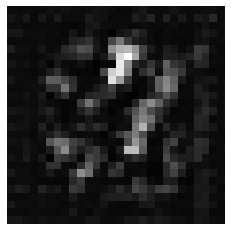

discriminator loss : 0.5614438056945801
Generator loss : [0.9222752, 0.0]
(1, 28, 28, 1)
(28, 28)


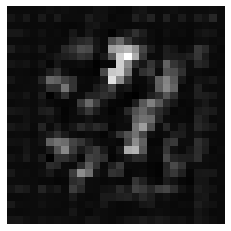

discriminator loss : 0.4361705183982849
Generator loss : [0.7287129, 0.0]
(1, 28, 28, 1)
(28, 28)


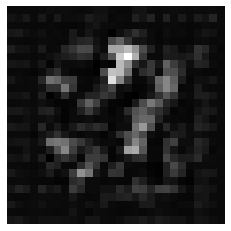

discriminator loss : 0.38218316435813904
Generator loss : [0.7888432, 0.0]
(1, 28, 28, 1)
(28, 28)


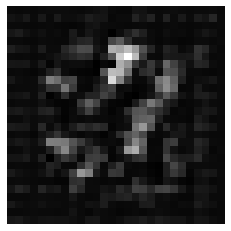

discriminator loss : 0.344659686088562
Generator loss : [0.8321838, 0.0]
(1, 28, 28, 1)
(28, 28)


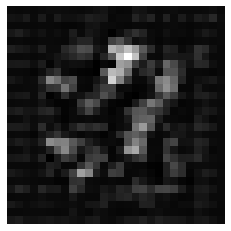

discriminator loss : 0.34670311212539673
Generator loss : [0.86818063, 0.0]
(1, 28, 28, 1)
(28, 28)


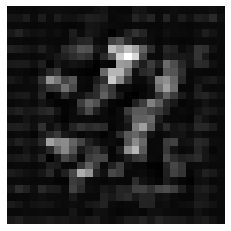

discriminator loss : 0.36535513401031494
Generator loss : [0.7341115, 0.0]
(1, 28, 28, 1)
(28, 28)


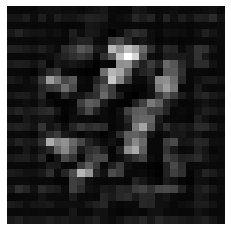

discriminator loss : 0.35836470127105713
Generator loss : [0.7227871, 0.0]
(1, 28, 28, 1)
(28, 28)


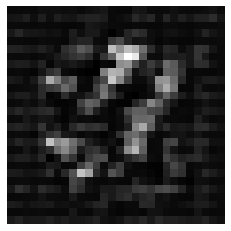

discriminator loss : 0.33318424224853516
Generator loss : [0.6575818, 0.0]
(1, 28, 28, 1)
(28, 28)


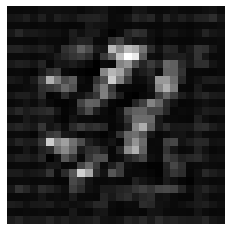

discriminator loss : 0.3542768359184265
Generator loss : [0.58130413, 0.0]
(1, 28, 28, 1)
(28, 28)


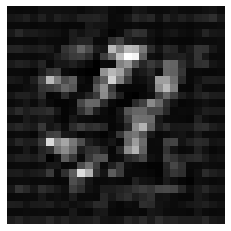

discriminator loss : 0.3330675959587097
Generator loss : [0.5515283, 0.0]
(1, 28, 28, 1)
(28, 28)


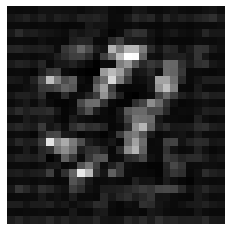

discriminator loss : 0.3784511983394623
Generator loss : [0.39168823, 0.0]
(1, 28, 28, 1)
(28, 28)


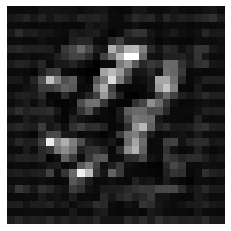

epoch : 3
discriminator loss : 0.364301860332489
Generator loss : [0.3597134, 0.0]
(1, 28, 28, 1)
(28, 28)


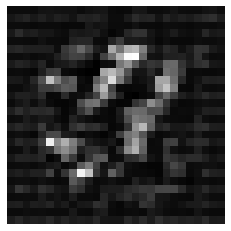

discriminator loss : 0.3566167950630188
Generator loss : [0.35270137, 0.0]
(1, 28, 28, 1)
(28, 28)


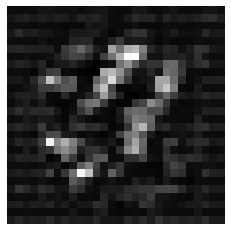

discriminator loss : 0.3340350091457367
Generator loss : [0.32882422, 0.0]
(1, 28, 28, 1)
(28, 28)


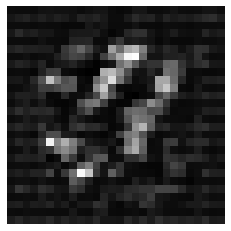

discriminator loss : 0.3404937982559204
Generator loss : [0.32045498, 0.0]
(1, 28, 28, 1)
(28, 28)


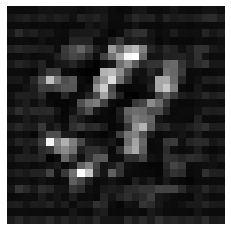

discriminator loss : 0.3490171432495117
Generator loss : [0.32309884, 0.0]
(1, 28, 28, 1)
(28, 28)


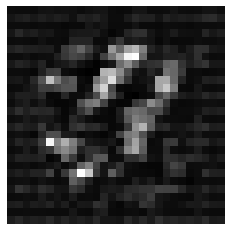

discriminator loss : 0.35501188039779663
Generator loss : [0.34395364, 0.0]
(1, 28, 28, 1)
(28, 28)


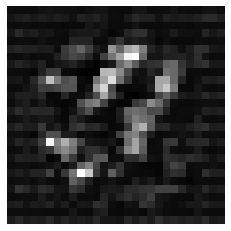

discriminator loss : 0.35622507333755493
Generator loss : [0.3277655, 0.0]
(1, 28, 28, 1)
(28, 28)


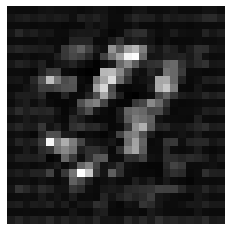

discriminator loss : 0.3624688982963562
Generator loss : [0.34397802, 0.0]
(1, 28, 28, 1)
(28, 28)


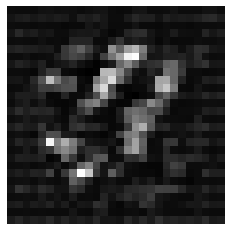

discriminator loss : 0.33361780643463135
Generator loss : [0.32669464, 0.0]
(1, 28, 28, 1)
(28, 28)


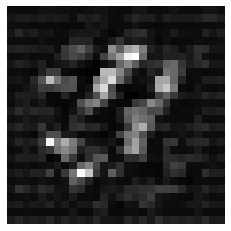

discriminator loss : 0.3427930772304535
Generator loss : [0.3250002, 0.0]
(1, 28, 28, 1)
(28, 28)


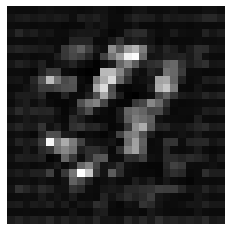

discriminator loss : 0.36195486783981323
Generator loss : [0.33924782, 0.0]
(1, 28, 28, 1)
(28, 28)


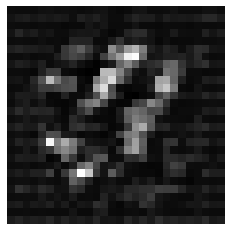

discriminator loss : 0.3582261800765991
Generator loss : [0.3508371, 0.0]
(1, 28, 28, 1)
(28, 28)


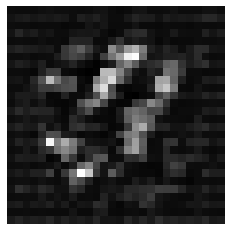

discriminator loss : 0.33664223551750183
Generator loss : [0.3189351, 0.0]
(1, 28, 28, 1)
(28, 28)


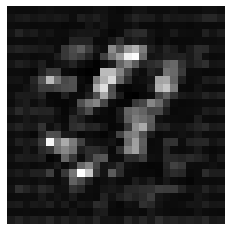

discriminator loss : 0.341077595949173
Generator loss : [0.3165278, 0.0]
(1, 28, 28, 1)
(28, 28)


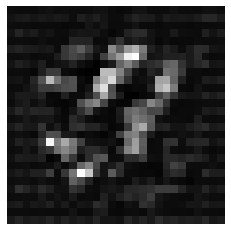

discriminator loss : 0.3448530435562134
Generator loss : [0.34126353, 0.0]
(1, 28, 28, 1)
(28, 28)


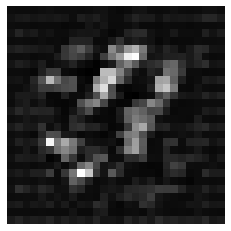

discriminator loss : 0.33717039227485657
Generator loss : [0.33433998, 0.0]
(1, 28, 28, 1)
(28, 28)


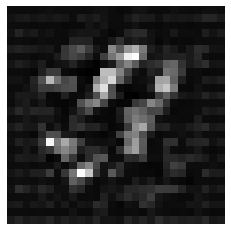

discriminator loss : 0.3383035361766815
Generator loss : [0.33250472, 0.0]
(1, 28, 28, 1)
(28, 28)


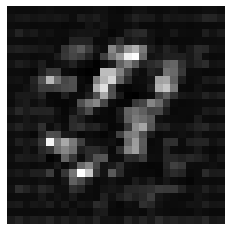

discriminator loss : 0.34231048822402954
Generator loss : [0.32858694, 0.0]
(1, 28, 28, 1)
(28, 28)


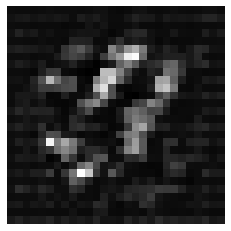

discriminator loss : 0.34212565422058105
Generator loss : [0.3258517, 0.0]
(1, 28, 28, 1)
(28, 28)


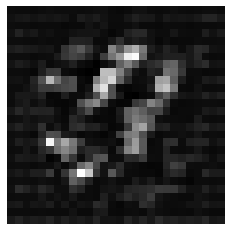

discriminator loss : 0.3303256928920746
Generator loss : [0.316069, 0.0]
(1, 28, 28, 1)
(28, 28)


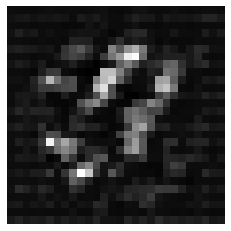

discriminator loss : 0.3562241196632385
Generator loss : [0.34334615, 0.0]
(1, 28, 28, 1)
(28, 28)


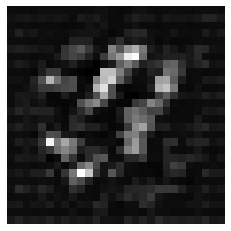

discriminator loss : 0.33282339572906494
Generator loss : [0.3220442, 0.0]
(1, 28, 28, 1)
(28, 28)


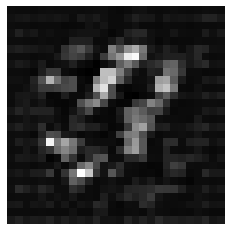

discriminator loss : 0.35314488410949707
Generator loss : [0.33564094, 0.0]
(1, 28, 28, 1)
(28, 28)


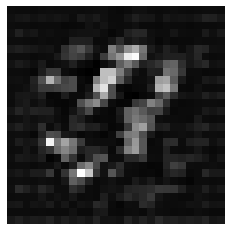

discriminator loss : 0.33719784021377563
Generator loss : [0.3206083, 0.0]
(1, 28, 28, 1)
(28, 28)


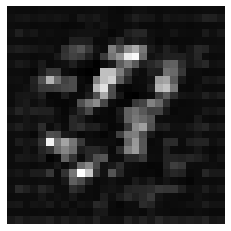

discriminator loss : 0.35908302664756775
Generator loss : [0.34040925, 0.0]
(1, 28, 28, 1)
(28, 28)


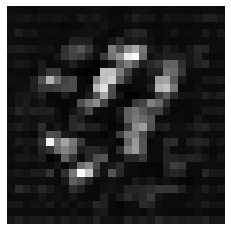

discriminator loss : 0.34941476583480835
Generator loss : [0.35337317, 0.0]
(1, 28, 28, 1)
(28, 28)


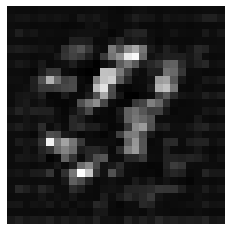

discriminator loss : 0.3313385844230652
Generator loss : [0.35455242, 0.0]
(1, 28, 28, 1)
(28, 28)


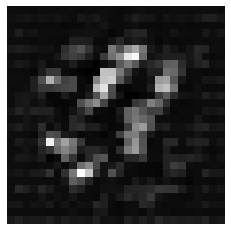

discriminator loss : 0.36524438858032227
Generator loss : [0.34529454, 0.0]
(1, 28, 28, 1)
(28, 28)


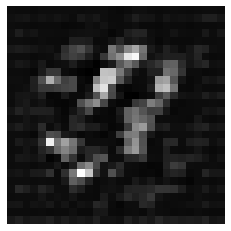

discriminator loss : 0.347382128238678
Generator loss : [0.34307098, 0.0]
(1, 28, 28, 1)
(28, 28)


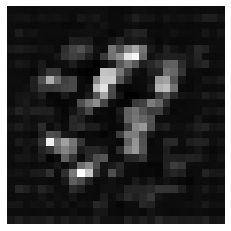

discriminator loss : 0.34329795837402344
Generator loss : [0.3612777, 0.0]
(1, 28, 28, 1)
(28, 28)


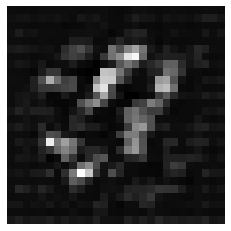

discriminator loss : 0.3497917354106903
Generator loss : [0.37396607, 0.0]
(1, 28, 28, 1)
(28, 28)


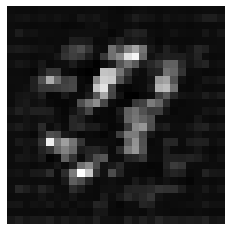

discriminator loss : 0.35485637187957764
Generator loss : [0.36962003, 0.0]
(1, 28, 28, 1)
(28, 28)


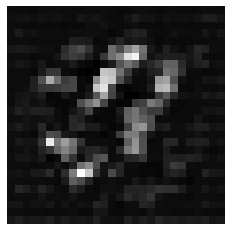

discriminator loss : 0.34169289469718933
Generator loss : [0.35009328, 0.0]
(1, 28, 28, 1)
(28, 28)


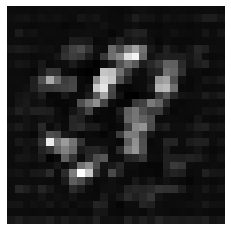

discriminator loss : 0.3350585699081421
Generator loss : [0.3721462, 0.0]
(1, 28, 28, 1)
(28, 28)


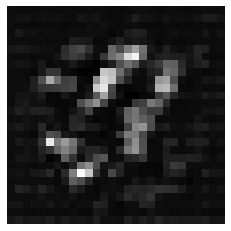

discriminator loss : 0.3374539613723755
Generator loss : [0.36073858, 0.0]
(1, 28, 28, 1)
(28, 28)


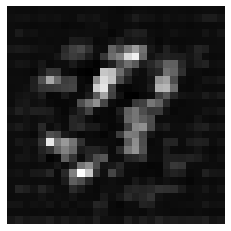

discriminator loss : 0.3434368371963501
Generator loss : [0.36472312, 0.0]
(1, 28, 28, 1)
(28, 28)


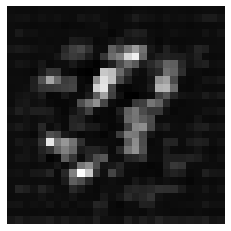

discriminator loss : 0.3601444661617279
Generator loss : [0.3649732, 0.0]
(1, 28, 28, 1)
(28, 28)


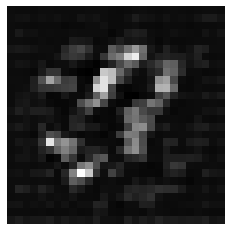

discriminator loss : 0.3620154857635498
Generator loss : [0.3934916, 0.0]
(1, 28, 28, 1)
(28, 28)


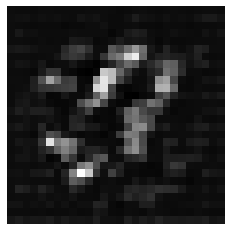

discriminator loss : 0.3408372700214386
Generator loss : [0.40221608, 0.0]
(1, 28, 28, 1)
(28, 28)


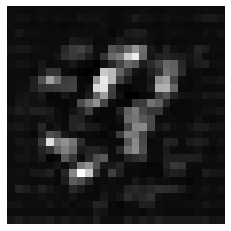

discriminator loss : 0.35270535945892334
Generator loss : [0.40977246, 0.0]
(1, 28, 28, 1)
(28, 28)


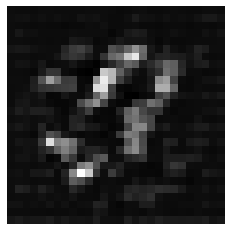

discriminator loss : 0.3716493844985962
Generator loss : [0.4224622, 0.0]
(1, 28, 28, 1)
(28, 28)


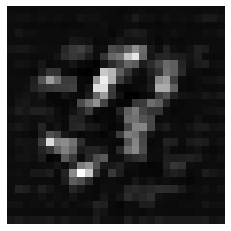

discriminator loss : 0.3543577790260315
Generator loss : [0.45606446, 0.0]
(1, 28, 28, 1)
(28, 28)


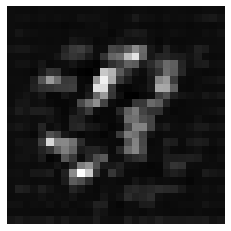

discriminator loss : 0.3668452501296997
Generator loss : [0.4995642, 0.0]
(1, 28, 28, 1)
(28, 28)


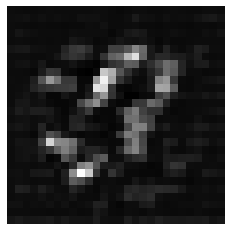

discriminator loss : 0.37825965881347656
Generator loss : [0.5014888, 0.0]
(1, 28, 28, 1)
(28, 28)


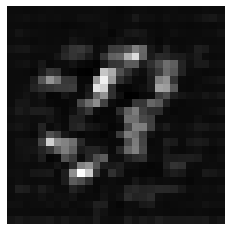

discriminator loss : 0.36905211210250854
Generator loss : [0.5497449, 0.0]
(1, 28, 28, 1)
(28, 28)


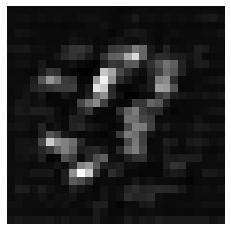

discriminator loss : 0.37285661697387695
Generator loss : [0.55980825, 0.0]
(1, 28, 28, 1)
(28, 28)


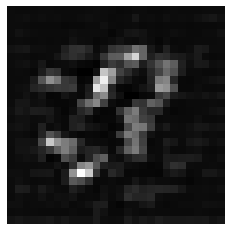

discriminator loss : 0.36277031898498535
Generator loss : [0.6177903, 0.0]
(1, 28, 28, 1)
(28, 28)


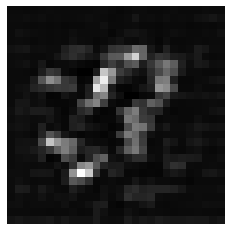

discriminator loss : 0.40929752588272095
Generator loss : [0.57362115, 0.0]
(1, 28, 28, 1)
(28, 28)


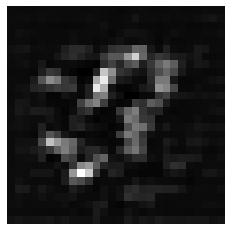

discriminator loss : 0.36498093605041504
Generator loss : [0.6583429, 0.0]
(1, 28, 28, 1)
(28, 28)


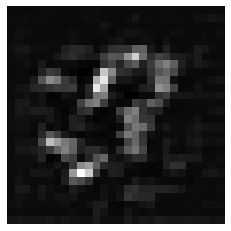

discriminator loss : 0.3956337571144104
Generator loss : [0.5128448, 0.0]
(1, 28, 28, 1)
(28, 28)


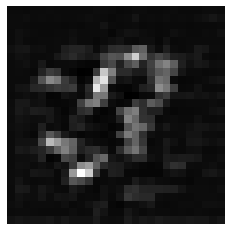

discriminator loss : 0.36160749197006226
Generator loss : [0.54697955, 0.0]
(1, 28, 28, 1)
(28, 28)


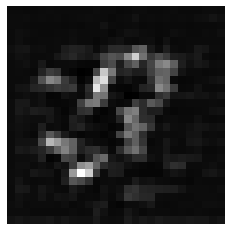

discriminator loss : 0.35625946521759033
Generator loss : [0.6023626, 0.0]
(1, 28, 28, 1)
(28, 28)


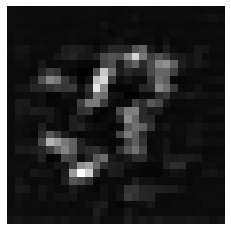

discriminator loss : 0.3551768660545349
Generator loss : [0.6239171, 0.0]
(1, 28, 28, 1)
(28, 28)


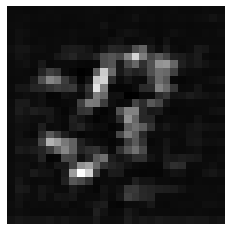

discriminator loss : 0.3562660813331604
Generator loss : [0.52864456, 0.0]
(1, 28, 28, 1)
(28, 28)


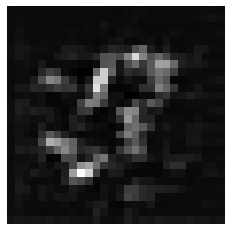

discriminator loss : 0.34579139947891235
Generator loss : [0.54063296, 0.0]
(1, 28, 28, 1)
(28, 28)


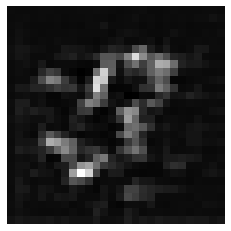

discriminator loss : 0.3479272127151489
Generator loss : [0.45420197, 0.0]
(1, 28, 28, 1)
(28, 28)


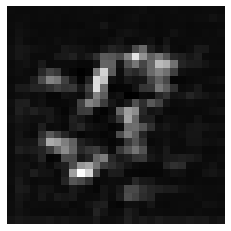

discriminator loss : 0.35154491662979126
Generator loss : [0.38645408, 0.0]
(1, 28, 28, 1)
(28, 28)


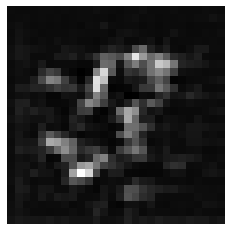

discriminator loss : 0.3647305965423584
Generator loss : [0.37516263, 0.0]
(1, 28, 28, 1)
(28, 28)


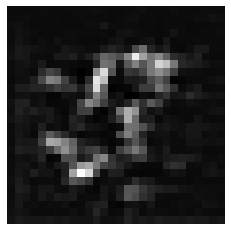

discriminator loss : 0.33764857053756714
Generator loss : [0.33778113, 0.0]
(1, 28, 28, 1)
(28, 28)


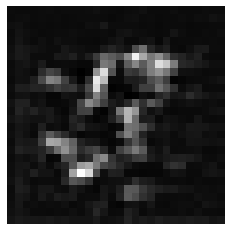

discriminator loss : 0.36070412397384644
Generator loss : [0.3413606, 0.0]
(1, 28, 28, 1)
(28, 28)


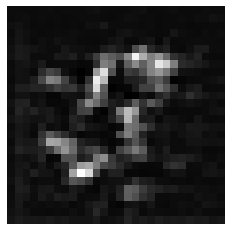

discriminator loss : 0.34137311577796936
Generator loss : [0.31223083, 0.0]
(1, 28, 28, 1)
(28, 28)


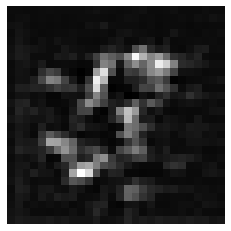

discriminator loss : 0.34160226583480835
Generator loss : [0.3204583, 0.0]
(1, 28, 28, 1)
(28, 28)


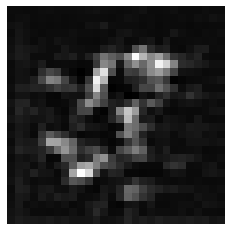

discriminator loss : 0.3413933515548706
Generator loss : [0.32780853, 0.0]
(1, 28, 28, 1)
(28, 28)


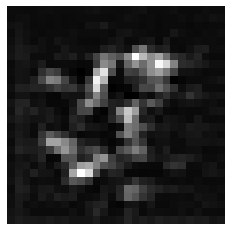

discriminator loss : 0.34028390049934387
Generator loss : [0.32096508, 0.0]
(1, 28, 28, 1)
(28, 28)


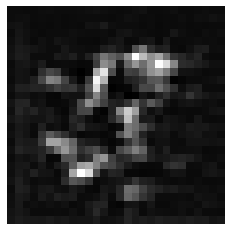

discriminator loss : 0.335773229598999
Generator loss : [0.33108422, 0.0]
(1, 28, 28, 1)
(28, 28)


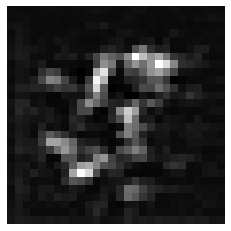

discriminator loss : 0.3344210088253021
Generator loss : [0.336427, 0.0]
(1, 28, 28, 1)
(28, 28)


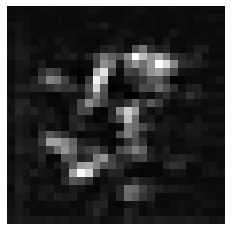

discriminator loss : 0.3290054202079773
Generator loss : [0.3104629, 0.0]
(1, 28, 28, 1)
(28, 28)


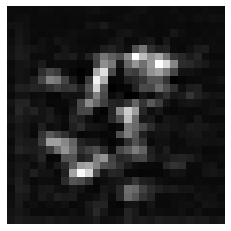

discriminator loss : 0.3452558219432831
Generator loss : [0.32994667, 0.0]
(1, 28, 28, 1)
(28, 28)


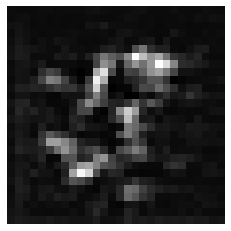

discriminator loss : 0.3438953757286072
Generator loss : [0.31732428, 0.0]
(1, 28, 28, 1)
(28, 28)


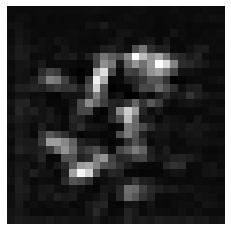

discriminator loss : 0.33046236634254456
Generator loss : [0.3315065, 0.0]
(1, 28, 28, 1)
(28, 28)


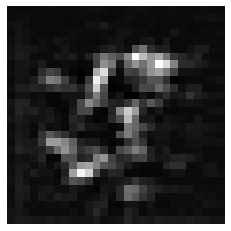

discriminator loss : 0.35049235820770264
Generator loss : [0.31836447, 0.0]
(1, 28, 28, 1)
(28, 28)


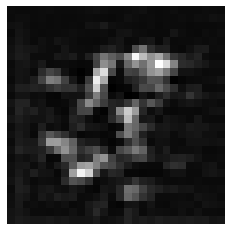

discriminator loss : 0.35147005319595337
Generator loss : [0.3163017, 0.0]
(1, 28, 28, 1)
(28, 28)


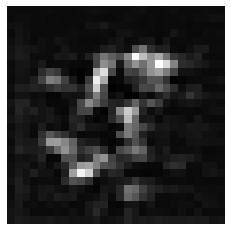

discriminator loss : 0.35403457283973694
Generator loss : [0.34169978, 0.0]
(1, 28, 28, 1)
(28, 28)


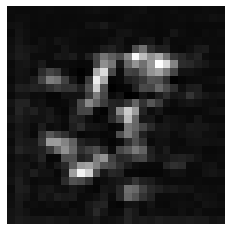

discriminator loss : 0.35972943902015686
Generator loss : [0.33488095, 0.0]
(1, 28, 28, 1)
(28, 28)


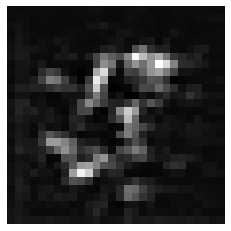

discriminator loss : 0.3501283526420593
Generator loss : [0.35176572, 0.0]
(1, 28, 28, 1)
(28, 28)


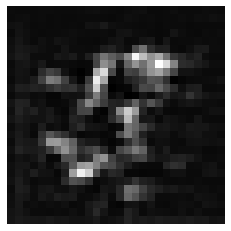

discriminator loss : 0.34439945220947266
Generator loss : [0.34486976, 0.0]
(1, 28, 28, 1)
(28, 28)


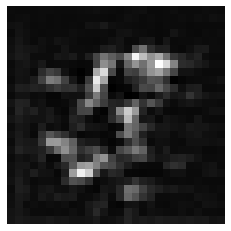

discriminator loss : 0.33705008029937744
Generator loss : [0.3269805, 0.0]
(1, 28, 28, 1)
(28, 28)


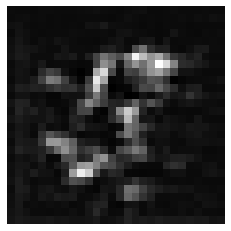

discriminator loss : 0.32427436113357544
Generator loss : [0.31381506, 0.0]
(1, 28, 28, 1)
(28, 28)


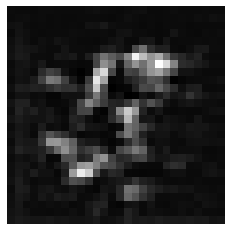

discriminator loss : 0.3447299897670746
Generator loss : [0.3403431, 0.0]
(1, 28, 28, 1)
(28, 28)


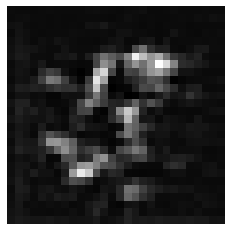

discriminator loss : 0.3357154130935669
Generator loss : [0.33161652, 0.0]
(1, 28, 28, 1)
(28, 28)


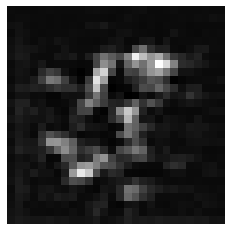

discriminator loss : 0.326742559671402
Generator loss : [0.3402981, 0.0]
(1, 28, 28, 1)
(28, 28)


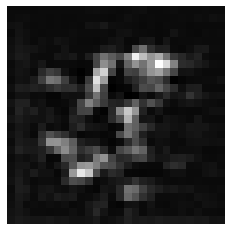

discriminator loss : 0.34132862091064453
Generator loss : [0.33510947, 0.0]
(1, 28, 28, 1)
(28, 28)


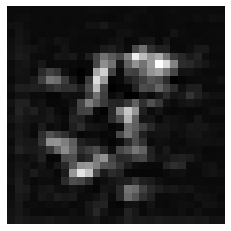

discriminator loss : 0.33986788988113403
Generator loss : [0.33386055, 0.0]
(1, 28, 28, 1)
(28, 28)


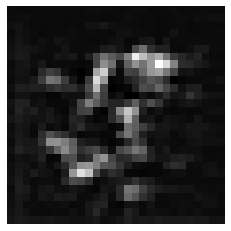

discriminator loss : 0.3203985393047333
Generator loss : [0.32596916, 0.0]
(1, 28, 28, 1)
(28, 28)


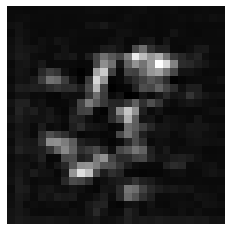

discriminator loss : 0.3181024193763733
Generator loss : [0.31434286, 0.0]
(1, 28, 28, 1)
(28, 28)


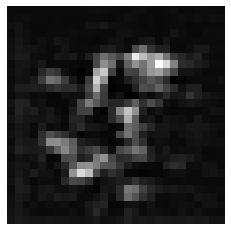

discriminator loss : 0.32728928327560425
Generator loss : [0.3247035, 0.0]
(1, 28, 28, 1)
(28, 28)


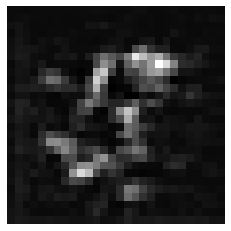

discriminator loss : 0.3222336173057556
Generator loss : [0.31956014, 0.0]
(1, 28, 28, 1)
(28, 28)


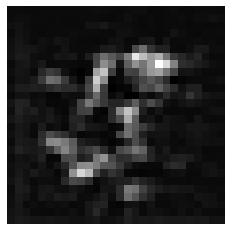

discriminator loss : 0.33991217613220215
Generator loss : [0.33883908, 0.0]
(1, 28, 28, 1)
(28, 28)


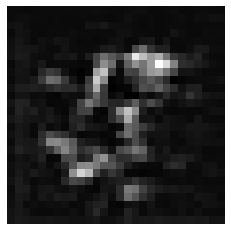

discriminator loss : 0.3297159671783447
Generator loss : [0.31426844, 0.0]
(1, 28, 28, 1)
(28, 28)


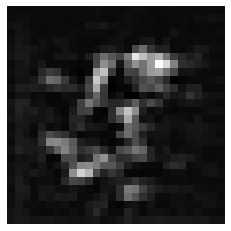

discriminator loss : 0.33958667516708374
Generator loss : [0.33835128, 0.0]
(1, 28, 28, 1)
(28, 28)


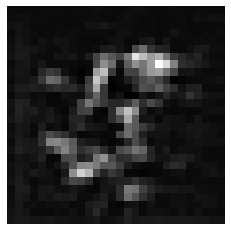

discriminator loss : 0.34053194522857666
Generator loss : [0.33914652, 0.0]
(1, 28, 28, 1)
(28, 28)


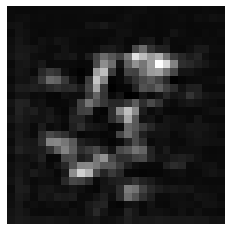

discriminator loss : 0.3308195471763611
Generator loss : [0.31239477, 0.0]
(1, 28, 28, 1)
(28, 28)


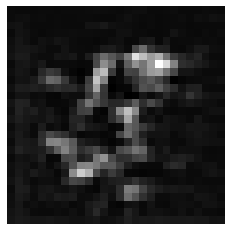

discriminator loss : 0.3413325548171997
Generator loss : [0.34700897, 0.0]
(1, 28, 28, 1)
(28, 28)


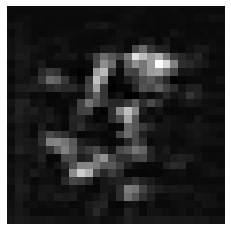

discriminator loss : 0.3352774977684021
Generator loss : [0.3240346, 0.0]
(1, 28, 28, 1)
(28, 28)


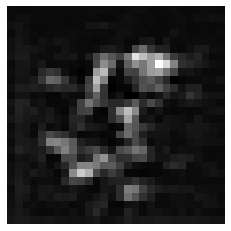

discriminator loss : 0.33585435152053833
Generator loss : [0.3288694, 0.0]
(1, 28, 28, 1)
(28, 28)


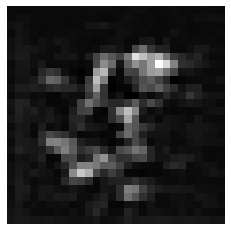

discriminator loss : 0.32415902614593506
Generator loss : [0.32912907, 0.0]
(1, 28, 28, 1)
(28, 28)


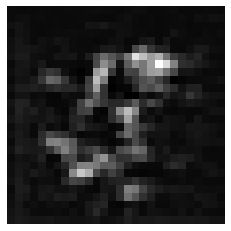

discriminator loss : 0.3279797434806824
Generator loss : [0.33742058, 0.0]
(1, 28, 28, 1)
(28, 28)


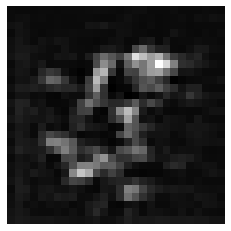

discriminator loss : 0.32786619663238525
Generator loss : [0.32674056, 0.0]
(1, 28, 28, 1)
(28, 28)


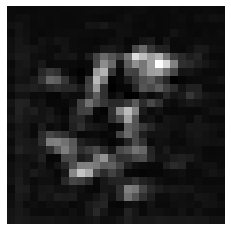

discriminator loss : 0.3366749882698059
Generator loss : [0.31559443, 0.0]
(1, 28, 28, 1)
(28, 28)


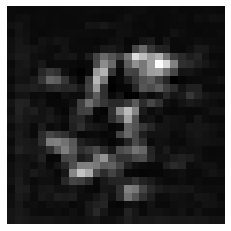

discriminator loss : 0.32173025608062744
Generator loss : [0.32165772, 0.0]
(1, 28, 28, 1)
(28, 28)


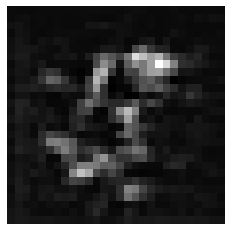

discriminator loss : 0.349538654088974
Generator loss : [0.36079112, 0.0]
(1, 28, 28, 1)
(28, 28)


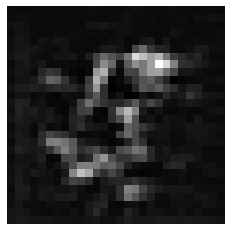

discriminator loss : 0.34189140796661377
Generator loss : [0.33897173, 0.0]
(1, 28, 28, 1)
(28, 28)


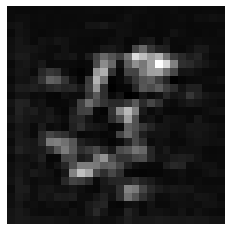

discriminator loss : 0.30923956632614136
Generator loss : [0.28919116, 0.0]
(1, 28, 28, 1)
(28, 28)


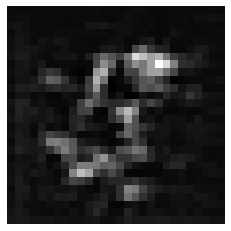

discriminator loss : 0.3328700065612793
Generator loss : [0.3167699, 0.0]
(1, 28, 28, 1)
(28, 28)


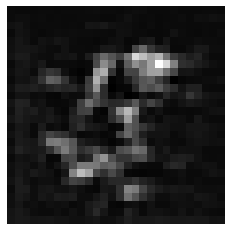

discriminator loss : 0.33368897438049316
Generator loss : [0.3402609, 0.0]
(1, 28, 28, 1)
(28, 28)


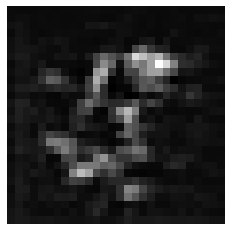

discriminator loss : 0.3238677382469177
Generator loss : [0.31945372, 0.0]
(1, 28, 28, 1)
(28, 28)


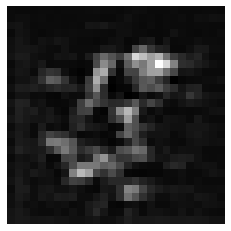

discriminator loss : 0.3279559016227722
Generator loss : [0.32489684, 0.0]
(1, 28, 28, 1)
(28, 28)


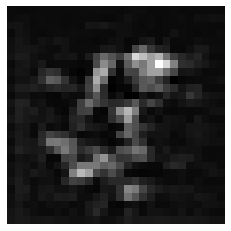

discriminator loss : 0.3422729969024658
Generator loss : [0.3435508, 0.0]
(1, 28, 28, 1)
(28, 28)


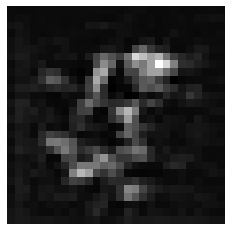

discriminator loss : 0.3423098921775818
Generator loss : [0.3304752, 0.0]
(1, 28, 28, 1)
(28, 28)


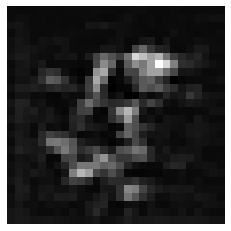

discriminator loss : 0.3514854311943054
Generator loss : [0.31737056, 0.0]
(1, 28, 28, 1)
(28, 28)


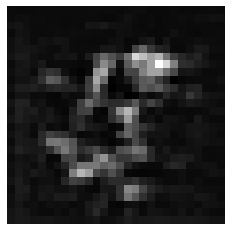

discriminator loss : 0.33365416526794434
Generator loss : [0.34775123, 0.0]
(1, 28, 28, 1)
(28, 28)


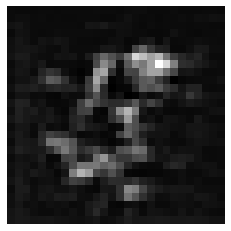

discriminator loss : 0.334722101688385
Generator loss : [0.32271415, 0.0]
(1, 28, 28, 1)
(28, 28)


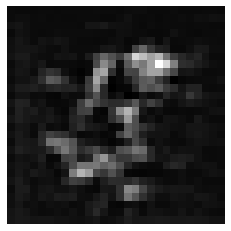

discriminator loss : 0.32026609778404236
Generator loss : [0.32208636, 0.0]
(1, 28, 28, 1)
(28, 28)


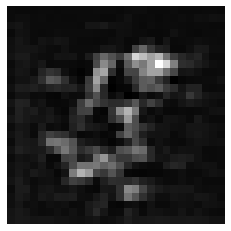

discriminator loss : 0.3334912061691284
Generator loss : [0.32731992, 0.0]
(1, 28, 28, 1)
(28, 28)


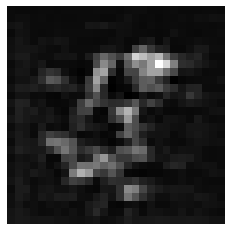

discriminator loss : 0.33195316791534424
Generator loss : [0.3347718, 0.0]
(1, 28, 28, 1)
(28, 28)


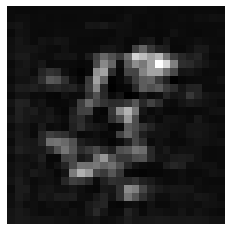

discriminator loss : 0.32294076681137085
Generator loss : [0.31733903, 0.0]
(1, 28, 28, 1)
(28, 28)


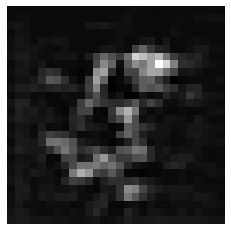

discriminator loss : 0.3234061002731323
Generator loss : [0.3142114, 0.0]
(1, 28, 28, 1)
(28, 28)


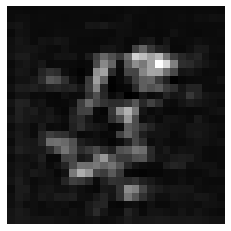

discriminator loss : 0.3323410749435425
Generator loss : [0.3223666, 0.0]
(1, 28, 28, 1)
(28, 28)


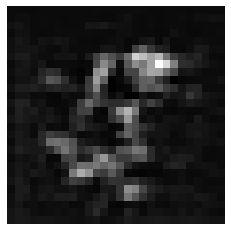

discriminator loss : 0.345074325799942
Generator loss : [0.3429402, 0.0]
(1, 28, 28, 1)
(28, 28)


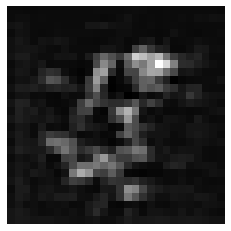

discriminator loss : 0.3271215558052063
Generator loss : [0.31825003, 0.0]
(1, 28, 28, 1)
(28, 28)


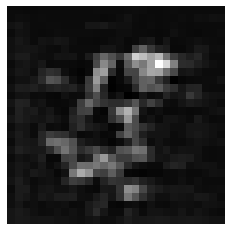

discriminator loss : 0.32785293459892273
Generator loss : [0.31889415, 0.0]
(1, 28, 28, 1)
(28, 28)


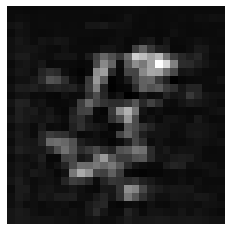

discriminator loss : 0.338238000869751
Generator loss : [0.32058743, 0.0]
(1, 28, 28, 1)
(28, 28)


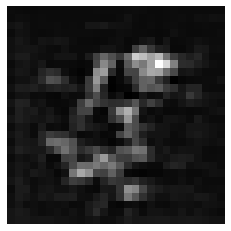

discriminator loss : 0.343475341796875
Generator loss : [0.34825125, 0.0]
(1, 28, 28, 1)
(28, 28)


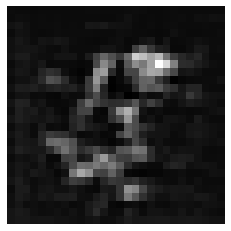

discriminator loss : 0.33990949392318726
Generator loss : [0.31991482, 0.0]
(1, 28, 28, 1)
(28, 28)


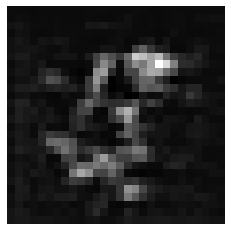

discriminator loss : 0.3311542570590973
Generator loss : [0.3166682, 0.0]
(1, 28, 28, 1)
(28, 28)


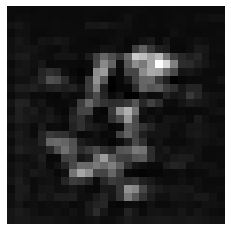

discriminator loss : 0.331678569316864
Generator loss : [0.33453292, 0.0]
(1, 28, 28, 1)
(28, 28)


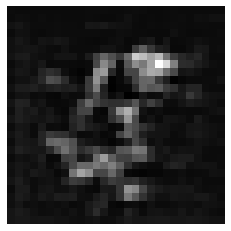

discriminator loss : 0.3403322100639343
Generator loss : [0.35033855, 0.0]
(1, 28, 28, 1)
(28, 28)


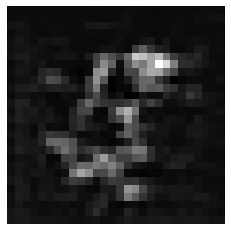

discriminator loss : 0.34880438446998596
Generator loss : [0.3457271, 0.0]
(1, 28, 28, 1)
(28, 28)


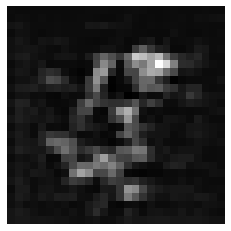

discriminator loss : 0.33898842334747314
Generator loss : [0.34999016, 0.0]
(1, 28, 28, 1)
(28, 28)


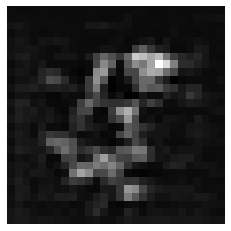

discriminator loss : 0.3366742730140686
Generator loss : [0.3541132, 0.0]
(1, 28, 28, 1)
(28, 28)


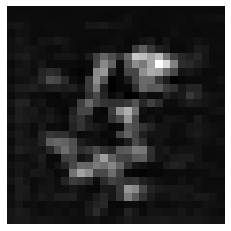

discriminator loss : 0.3391951322555542
Generator loss : [0.32388374, 0.0]
(1, 28, 28, 1)
(28, 28)


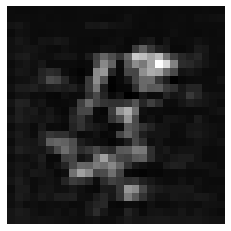

discriminator loss : 0.3474576473236084
Generator loss : [0.34439826, 0.0]
(1, 28, 28, 1)
(28, 28)


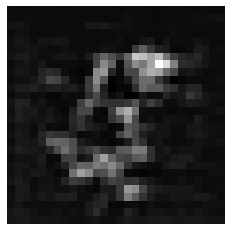

discriminator loss : 0.3550504446029663
Generator loss : [0.3393005, 0.0]
(1, 28, 28, 1)
(28, 28)


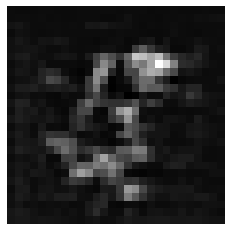

discriminator loss : 0.34395909309387207
Generator loss : [0.34854046, 0.0]
(1, 28, 28, 1)
(28, 28)


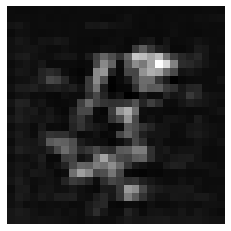

discriminator loss : 0.3229765295982361
Generator loss : [0.3102241, 0.0]
(1, 28, 28, 1)
(28, 28)


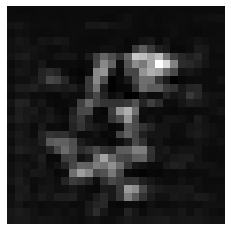

discriminator loss : 0.3382676839828491
Generator loss : [0.35153797, 0.0]
(1, 28, 28, 1)
(28, 28)


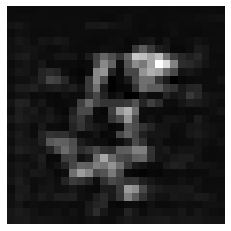

discriminator loss : 0.34929513931274414
Generator loss : [0.34352088, 0.0]
(1, 28, 28, 1)
(28, 28)


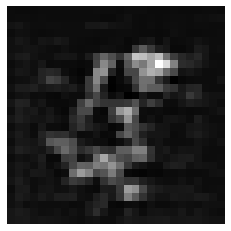

discriminator loss : 0.34746426343917847
Generator loss : [0.34901363, 0.0]
(1, 28, 28, 1)
(28, 28)


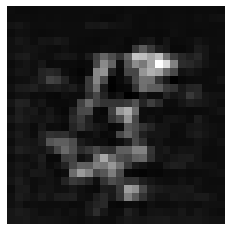

discriminator loss : 0.36165890097618103
Generator loss : [0.3678706, 0.0]
(1, 28, 28, 1)
(28, 28)


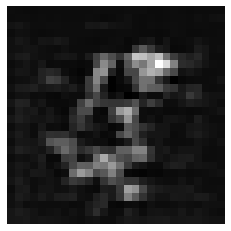

discriminator loss : 0.3231578469276428
Generator loss : [0.3312905, 0.0]
(1, 28, 28, 1)
(28, 28)


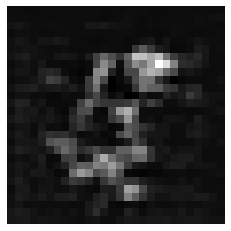

discriminator loss : 0.3284808099269867
Generator loss : [0.35137895, 0.0]
(1, 28, 28, 1)
(28, 28)


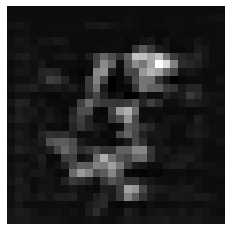

discriminator loss : 0.3296390175819397
Generator loss : [0.3514632, 0.0]
(1, 28, 28, 1)
(28, 28)


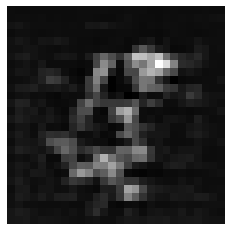

discriminator loss : 0.3345704972743988
Generator loss : [0.3507062, 0.0]
(1, 28, 28, 1)
(28, 28)


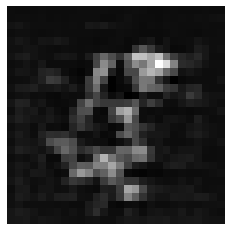

discriminator loss : 0.35736432671546936
Generator loss : [0.35296103, 0.0]
(1, 28, 28, 1)
(28, 28)


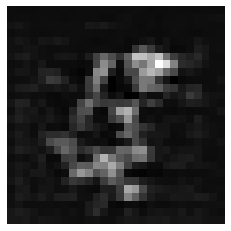

discriminator loss : 0.34475839138031006
Generator loss : [0.34447116, 0.0]
(1, 28, 28, 1)
(28, 28)


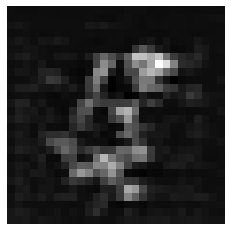

discriminator loss : 0.3384268581867218
Generator loss : [0.37708327, 0.0]
(1, 28, 28, 1)
(28, 28)


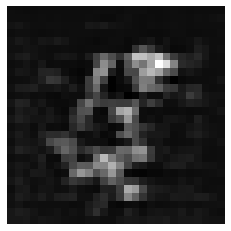

discriminator loss : 0.3202311396598816
Generator loss : [0.3403051, 0.0]
(1, 28, 28, 1)
(28, 28)


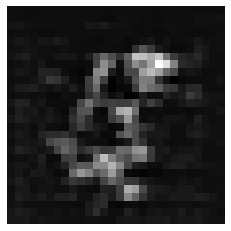

discriminator loss : 0.34293097257614136
Generator loss : [0.35235515, 0.0]
(1, 28, 28, 1)
(28, 28)


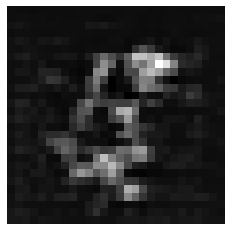

discriminator loss : 0.32400232553482056
Generator loss : [0.33820808, 0.0]
(1, 28, 28, 1)
(28, 28)


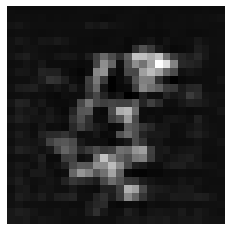

discriminator loss : 0.34300804138183594
Generator loss : [0.34749702, 0.0]
(1, 28, 28, 1)
(28, 28)


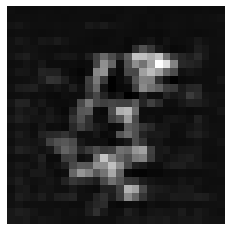

discriminator loss : 0.32441359758377075
Generator loss : [0.34201515, 0.0]
(1, 28, 28, 1)
(28, 28)


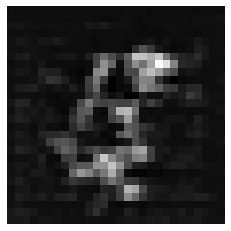

discriminator loss : 0.351673424243927
Generator loss : [0.35270512, 0.0]
(1, 28, 28, 1)
(28, 28)


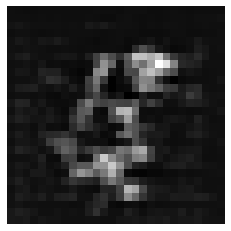

discriminator loss : 0.32149645686149597
Generator loss : [0.34366584, 0.0]
(1, 28, 28, 1)
(28, 28)


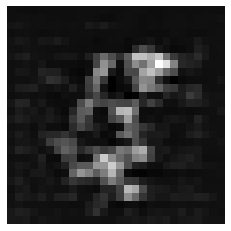

discriminator loss : 0.3502592444419861
Generator loss : [0.3238655, 0.0]
(1, 28, 28, 1)
(28, 28)


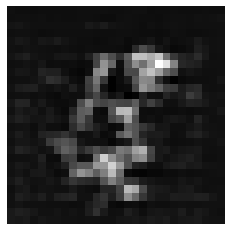

discriminator loss : 0.3348270654678345
Generator loss : [0.3373901, 0.0]
(1, 28, 28, 1)
(28, 28)


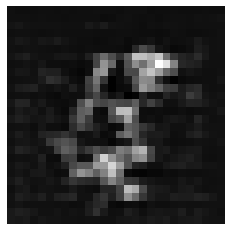

discriminator loss : 0.32762497663497925
Generator loss : [0.34823117, 0.0]
(1, 28, 28, 1)
(28, 28)


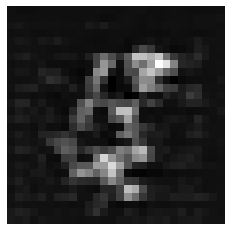

discriminator loss : 0.31918156147003174
Generator loss : [0.34122288, 0.0]
(1, 28, 28, 1)
(28, 28)


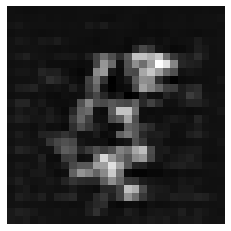

discriminator loss : 0.3407954275608063
Generator loss : [0.35426322, 0.0]
(1, 28, 28, 1)
(28, 28)


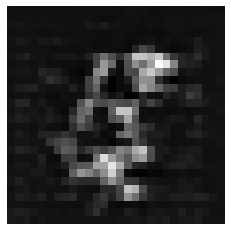

discriminator loss : 0.34530049562454224
Generator loss : [0.3473655, 0.0]
(1, 28, 28, 1)
(28, 28)


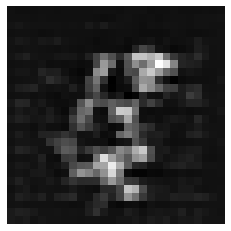

discriminator loss : 0.3494088649749756
Generator loss : [0.3512613, 0.0]
(1, 28, 28, 1)
(28, 28)


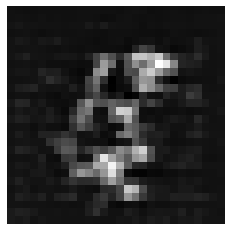

discriminator loss : 0.3506857752799988
Generator loss : [0.3986134, 0.0]
(1, 28, 28, 1)
(28, 28)


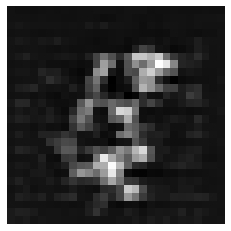

discriminator loss : 0.3800617456436157
Generator loss : [0.42320535, 0.0]
(1, 28, 28, 1)
(28, 28)


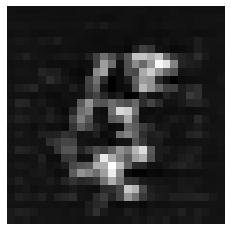

discriminator loss : 0.4123426079750061
Generator loss : [0.44743693, 0.0]
(1, 28, 28, 1)
(28, 28)


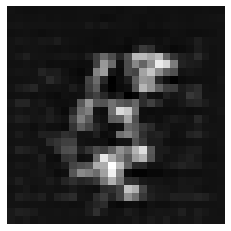

discriminator loss : 0.4087241291999817
Generator loss : [0.5076962, 0.0]
(1, 28, 28, 1)
(28, 28)


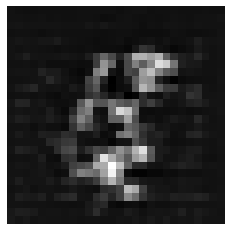

discriminator loss : 0.39202117919921875
Generator loss : [0.6528682, 0.0]
(1, 28, 28, 1)
(28, 28)


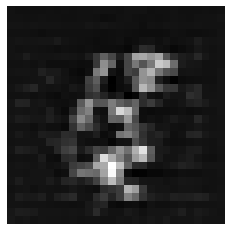

discriminator loss : 0.574418842792511
Generator loss : [0.90629303, 0.0]
(1, 28, 28, 1)
(28, 28)


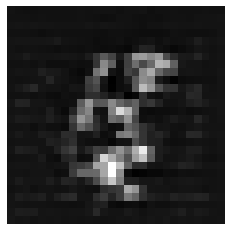

discriminator loss : 0.6977092623710632
Generator loss : [1.0540154, 0.0]
(1, 28, 28, 1)
(28, 28)


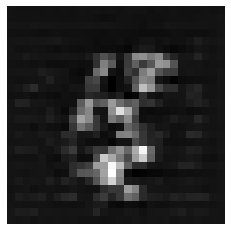

discriminator loss : 0.5591411590576172
Generator loss : [1.1533719, 0.0]
(1, 28, 28, 1)
(28, 28)


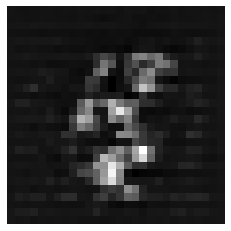

discriminator loss : 0.5295689105987549
Generator loss : [1.0391903, 0.0]
(1, 28, 28, 1)
(28, 28)


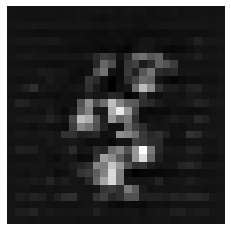

discriminator loss : 0.4855547249317169
Generator loss : [0.9296415, 0.0]
(1, 28, 28, 1)
(28, 28)


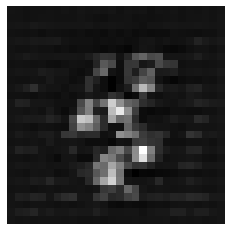

discriminator loss : 0.4022674858570099
Generator loss : [0.58478224, 0.0]
(1, 28, 28, 1)
(28, 28)


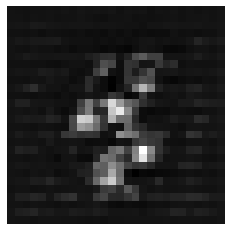

discriminator loss : 0.3779105544090271
Generator loss : [0.48132813, 0.0]
(1, 28, 28, 1)
(28, 28)


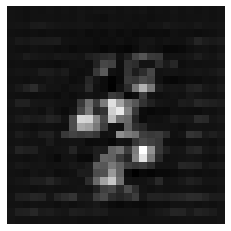

discriminator loss : 0.3838077485561371
Generator loss : [0.3882088, 0.0]
(1, 28, 28, 1)
(28, 28)


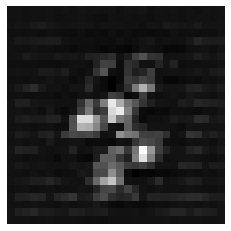

discriminator loss : 0.3709903657436371
Generator loss : [0.3456055, 0.0]
(1, 28, 28, 1)
(28, 28)


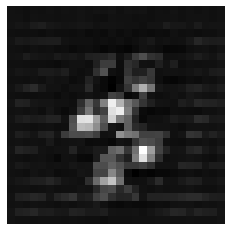

discriminator loss : 0.34990066289901733
Generator loss : [0.32909596, 0.0]
(1, 28, 28, 1)
(28, 28)


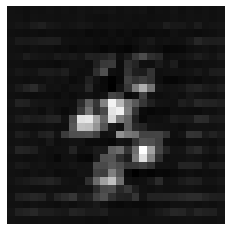

discriminator loss : 0.35040679574012756
Generator loss : [0.33178464, 0.0]
(1, 28, 28, 1)
(28, 28)


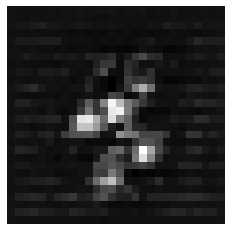

discriminator loss : 0.3459835648536682
Generator loss : [0.29849777, 0.0]
(1, 28, 28, 1)
(28, 28)


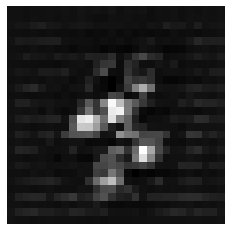

discriminator loss : 0.356710284948349
Generator loss : [0.32530665, 0.0]
(1, 28, 28, 1)
(28, 28)


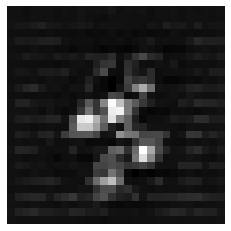

discriminator loss : 0.3418416678905487
Generator loss : [0.31321663, 0.0]
(1, 28, 28, 1)
(28, 28)


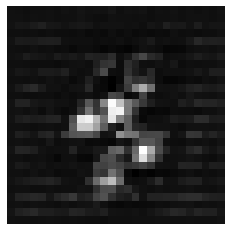

discriminator loss : 0.36360955238342285
Generator loss : [0.3462307, 0.0]
(1, 28, 28, 1)
(28, 28)


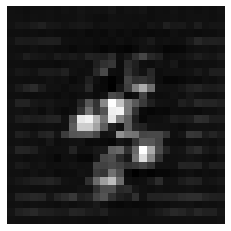

discriminator loss : 0.3524228036403656
Generator loss : [0.3473351, 0.0]
(1, 28, 28, 1)
(28, 28)


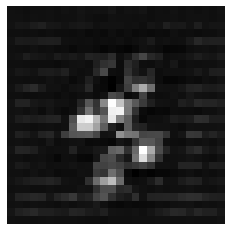

discriminator loss : 0.34252291917800903
Generator loss : [0.32803777, 0.0]
(1, 28, 28, 1)
(28, 28)


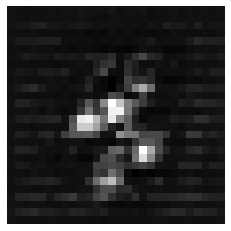

discriminator loss : 0.3484625220298767
Generator loss : [0.33342582, 0.0]
(1, 28, 28, 1)
(28, 28)


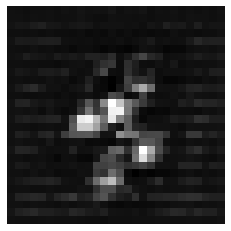

discriminator loss : 0.3391258418560028
Generator loss : [0.33762527, 0.0]
(1, 28, 28, 1)
(28, 28)


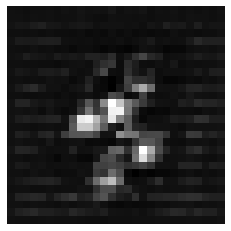

discriminator loss : 0.34406715631484985
Generator loss : [0.3337082, 0.0]
(1, 28, 28, 1)
(28, 28)


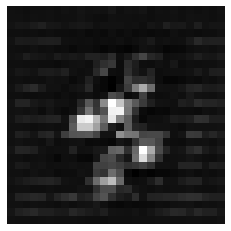

discriminator loss : 0.3389257788658142
Generator loss : [0.33009255, 0.0]
(1, 28, 28, 1)
(28, 28)


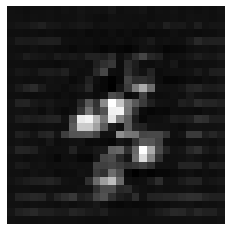

discriminator loss : 0.3182470202445984
Generator loss : [0.29111567, 0.0]
(1, 28, 28, 1)
(28, 28)


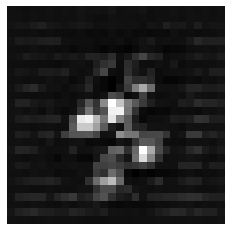

discriminator loss : 0.34391719102859497
Generator loss : [0.32035184, 0.0]
(1, 28, 28, 1)
(28, 28)


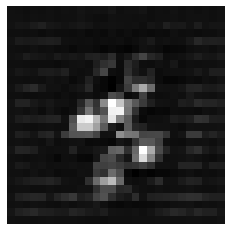

discriminator loss : 0.336896687746048
Generator loss : [0.32356018, 0.0]
(1, 28, 28, 1)
(28, 28)


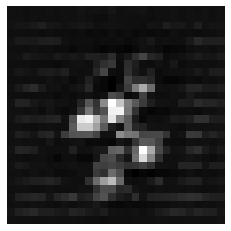

discriminator loss : 0.3530908226966858
Generator loss : [0.33713517, 0.0]
(1, 28, 28, 1)
(28, 28)


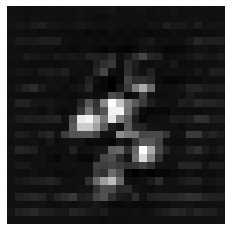

discriminator loss : 0.33063802123069763
Generator loss : [0.30917057, 0.0]
(1, 28, 28, 1)
(28, 28)


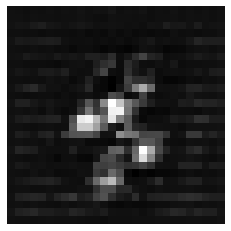

discriminator loss : 0.3433725833892822
Generator loss : [0.34539703, 0.0]
(1, 28, 28, 1)
(28, 28)


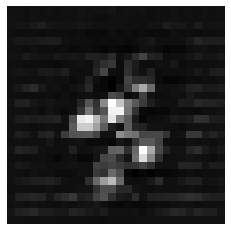

discriminator loss : 0.3344671130180359
Generator loss : [0.32614842, 0.0]
(1, 28, 28, 1)
(28, 28)


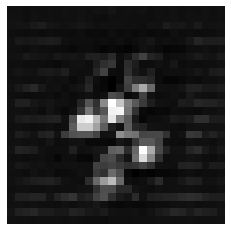

discriminator loss : 0.3329032063484192
Generator loss : [0.32542163, 0.0]
(1, 28, 28, 1)
(28, 28)


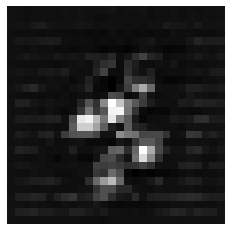

discriminator loss : 0.34930115938186646
Generator loss : [0.33122987, 0.0]
(1, 28, 28, 1)
(28, 28)


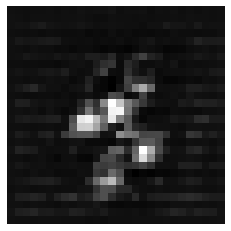

discriminator loss : 0.3453752398490906
Generator loss : [0.3402343, 0.0]
(1, 28, 28, 1)
(28, 28)


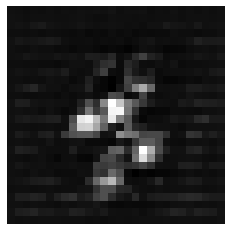

discriminator loss : 0.34786486625671387
Generator loss : [0.35055938, 0.0]
(1, 28, 28, 1)
(28, 28)


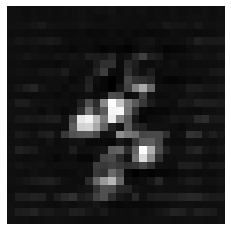

discriminator loss : 0.3468720614910126
Generator loss : [0.35216886, 0.0]
(1, 28, 28, 1)
(28, 28)


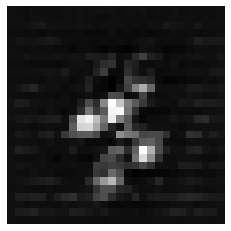

discriminator loss : 0.34506767988204956
Generator loss : [0.32816616, 0.0]
(1, 28, 28, 1)
(28, 28)


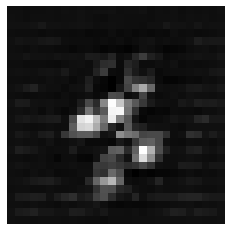

discriminator loss : 0.329282283782959
Generator loss : [0.32459876, 0.0]
(1, 28, 28, 1)
(28, 28)


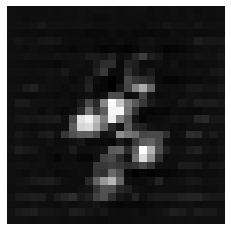

discriminator loss : 0.3346956968307495
Generator loss : [0.3388823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32854175567626953
Generator loss : [0.3362173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3414563536643982
Generator loss : [0.32484412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257836401462555
Generator loss : [0.31130534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3288933038711548
Generator loss : [0.32024202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309657871723175
Generator loss : [0.3271911, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378177285194397
Generator loss : [0.33552387, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3492923080921173
Generator loss : [0.32864064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320748209953308
Generator loss : [0.32217845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33104097843170166
Generator loss : [0.33235154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431661128997803
Generator loss : [0.3171885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34019938111305237
Generator loss : [0.33095852, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.320637971162796
Generator loss : [0.31854895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34453970193862915
Generator loss : [0.33711034, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3472532629966736
Generator loss : [0.33644843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348257541656494
Generator loss : [0.34605026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3530556559562683
Generator loss : [0.34481797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34642571210861206
Generator loss : [0.37518036, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34803611040115356
Generator loss : [0.3820513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3396986722946167
Generator loss : [0.3869328, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3552294969558716
Generator loss : [0.41150144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.357876718044281
Generator loss : [0.4473843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37865352630615234
Generator loss : [0.4878999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39875277876853943
Generator loss : [0.5303336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35641348361968994
Generator loss : [0.47684965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34755200147628784
Generator loss : [0.49356174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3854277431964874
Generator loss : [0.53984064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4788128733634949
Generator loss : [0.5431532, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4011293947696686
Generator loss : [0.34224835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3446999788284302
Generator loss : [0.34451917, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3760020136833191
Generator loss : [0.32830855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32703182101249695
Generator loss : [0.2998964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36269694566726685
Generator loss : [0.35256663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34700268507003784
Generator loss : [0.33774567, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319317698478699
Generator loss : [0.32462186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343283534049988
Generator loss : [0.33071175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3491933345794678
Generator loss : [0.3392684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3288509249687195
Generator loss : [0.31757903, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34427928924560547
Generator loss : [0.3399093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326045572757721
Generator loss : [0.34261283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399333357810974
Generator loss : [0.330021, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32989129424095154
Generator loss : [0.32949677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3220025300979614
Generator loss : [0.327937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34758010506629944
Generator loss : [0.33733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33340612053871155
Generator loss : [0.30653125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333357572555542
Generator loss : [0.33525026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33729875087738037
Generator loss : [0.33633006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33900508284568787
Generator loss : [0.3265982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308887183666229
Generator loss : [0.32386482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34980154037475586
Generator loss : [0.3444782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.343908429145813
Generator loss : [0.3523562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33577245473861694
Generator loss : [0.3280097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264603316783905
Generator loss : [0.33387062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33747151494026184
Generator loss : [0.3284698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31765425205230713
Generator loss : [0.31910172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291453719139099
Generator loss : [0.32343778, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34133732318878174
Generator loss : [0.34062517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33454328775405884
Generator loss : [0.33540785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266974687576294
Generator loss : [0.32817823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309779167175293
Generator loss : [0.31727216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307381272315979
Generator loss : [0.31822646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33655285835266113
Generator loss : [0.3171484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32897934317588806
Generator loss : [0.34055284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3323330581188202
Generator loss : [0.33439004, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274299204349518
Generator loss : [0.32273895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.326759934425354
Generator loss : [0.32148716, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32893282175064087
Generator loss : [0.3349406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433234691619873
Generator loss : [0.32988685, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3362007141113281
Generator loss : [0.32468754, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33109962940216064
Generator loss : [0.32157418, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336836099624634
Generator loss : [0.3371626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33835357427597046
Generator loss : [0.33409855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33035415410995483
Generator loss : [0.318465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32766151428222656
Generator loss : [0.3211671, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3500409722328186
Generator loss : [0.3489872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33040955662727356
Generator loss : [0.32750896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247920274734497
Generator loss : [0.3092696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34095001220703125
Generator loss : [0.33281747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32939380407333374
Generator loss : [0.32206833, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.321736603975296
Generator loss : [0.3186331, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305652141571045
Generator loss : [0.29873812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32636499404907227
Generator loss : [0.32210976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34376204013824463
Generator loss : [0.34201676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245222866535187
Generator loss : [0.32974637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31692588329315186
Generator loss : [0.30924714, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372949957847595
Generator loss : [0.3354514, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33721426129341125
Generator loss : [0.3379158, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3314947485923767
Generator loss : [0.31965035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3153756856918335
Generator loss : [0.29285577, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33258455991744995
Generator loss : [0.33348477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31991639733314514
Generator loss : [0.30300337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.324675053358078
Generator loss : [0.32884938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33568090200424194
Generator loss : [0.34101593, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31903910636901855
Generator loss : [0.31040835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31958168745040894
Generator loss : [0.33560503, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3409518897533417
Generator loss : [0.33836445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433341979980469
Generator loss : [0.3281324, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33747971057891846
Generator loss : [0.31246048, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3250499367713928
Generator loss : [0.32872736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268624544143677
Generator loss : [0.33242527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34951531887054443
Generator loss : [0.346974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3396598696708679
Generator loss : [0.33240062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358912467956543
Generator loss : [0.3355852, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33798885345458984
Generator loss : [0.3188006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3371888995170593
Generator loss : [0.32419148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330565094947815
Generator loss : [0.33005157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3429964482784271
Generator loss : [0.32678282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34298771619796753
Generator loss : [0.3362701, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264649212360382
Generator loss : [0.3255371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31121501326560974
Generator loss : [0.316742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32069236040115356
Generator loss : [0.3139176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32391536235809326
Generator loss : [0.32359836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3312588334083557
Generator loss : [0.30667233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3480227291584015
Generator loss : [0.34779456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3249260187149048
Generator loss : [0.32587042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33430713415145874
Generator loss : [0.32318664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398313522338867
Generator loss : [0.33958215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284692168235779
Generator loss : [0.3073562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359827697277069
Generator loss : [0.32476974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3516573905944824
Generator loss : [0.35785666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3439910113811493
Generator loss : [0.33688918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3242696523666382
Generator loss : [0.32249433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33021557331085205
Generator loss : [0.31896383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34104615449905396
Generator loss : [0.32595253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33950820565223694
Generator loss : [0.3290535, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438594937324524
Generator loss : [0.31742635, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33004969358444214
Generator loss : [0.32401416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32192495465278625
Generator loss : [0.3186661, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3350522220134735
Generator loss : [0.32319123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32160860300064087
Generator loss : [0.31392115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34690412878990173
Generator loss : [0.34572777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3460727334022522
Generator loss : [0.35242447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3731715679168701
Generator loss : [0.37149215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5136255025863647
Generator loss : [0.8631623, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.9619688987731934
Generator loss : [0.51673377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4417877793312073
Generator loss : [2.3946192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7110494375228882
Generator loss : [1.3341115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4539620280265808
Generator loss : [1.2733995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3833499550819397
Generator loss : [1.3930243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3891090154647827
Generator loss : [1.2272677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36930757761001587
Generator loss : [1.3456234, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3892432451248169
Generator loss : [1.4738725, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3759530782699585
Generator loss : [1.4788855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37879395484924316
Generator loss : [1.6126181, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38648998737335205
Generator loss : [1.6046219, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3990010619163513
Generator loss : [1.5962485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3870962858200073
Generator loss : [1.7493314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41194450855255127
Generator loss : [1.7277331, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39467400312423706
Generator loss : [1.7885184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4031587839126587
Generator loss : [1.6731795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39096951484680176
Generator loss : [1.6710428, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4011426568031311
Generator loss : [1.0864253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3992222547531128
Generator loss : [0.85978836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3760734498500824
Generator loss : [0.68544686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3854493498802185
Generator loss : [0.42987987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36619168519973755
Generator loss : [0.32999757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3606800436973572
Generator loss : [0.31929088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37549978494644165
Generator loss : [0.3259987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36376428604125977
Generator loss : [0.3309294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3660566508769989
Generator loss : [0.33175015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35580354928970337
Generator loss : [0.34802452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36266687512397766
Generator loss : [0.35139492, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3853191137313843
Generator loss : [0.35028946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33562302589416504
Generator loss : [0.31920364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36146628856658936
Generator loss : [0.35673076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33494240045547485
Generator loss : [0.3190459, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33723950386047363
Generator loss : [0.3164383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35119855403900146
Generator loss : [0.33262157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35020071268081665
Generator loss : [0.3363729, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33104318380355835
Generator loss : [0.32755253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34751296043395996
Generator loss : [0.33076656, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3375970125198364
Generator loss : [0.33770913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3583310842514038
Generator loss : [0.36275467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33352988958358765
Generator loss : [0.33939257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34170812368392944
Generator loss : [0.34884304, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3481334447860718
Generator loss : [0.34461957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328145742416382
Generator loss : [0.34201422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34293681383132935
Generator loss : [0.33608446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3180299997329712
Generator loss : [0.32628986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3190549612045288
Generator loss : [0.32400635, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3430440425872803
Generator loss : [0.33468053, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.349872350692749
Generator loss : [0.33025333, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3416109085083008
Generator loss : [0.33288723, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328572154045105
Generator loss : [0.3222765, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3273915648460388
Generator loss : [0.32492253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32821124792099
Generator loss : [0.33104408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284154534339905
Generator loss : [0.3145918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336526095867157
Generator loss : [0.34360722, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343009352684021
Generator loss : [0.33793435, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286406397819519
Generator loss : [0.32911167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408300280570984
Generator loss : [0.3367457, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351731300354004
Generator loss : [0.3221525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355884552001953
Generator loss : [0.32417253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34167832136154175
Generator loss : [0.34222823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33677172660827637
Generator loss : [0.33054572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326997458934784
Generator loss : [0.33121502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33941495418548584
Generator loss : [0.3369132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33368998765945435
Generator loss : [0.33943576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449769616127014
Generator loss : [0.3418677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34203654527664185
Generator loss : [0.35007194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443849980831146
Generator loss : [0.3399213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308737874031067
Generator loss : [0.31580144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3292977809906006
Generator loss : [0.33371273, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3412908911705017
Generator loss : [0.33404735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3367498517036438
Generator loss : [0.336628, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33527204394340515
Generator loss : [0.32642147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3295873999595642
Generator loss : [0.3374575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33121389150619507
Generator loss : [0.33061942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33481520414352417
Generator loss : [0.3396605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33049657940864563
Generator loss : [0.3448702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359350562095642
Generator loss : [0.36531293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308824896812439
Generator loss : [0.34328097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3315191864967346
Generator loss : [0.37255365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379684090614319
Generator loss : [0.37896976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3248264193534851
Generator loss : [0.37271118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34002989530563354
Generator loss : [0.40081787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3441183269023895
Generator loss : [0.45637903, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35632699728012085
Generator loss : [0.5200628, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36008524894714355
Generator loss : [0.65096253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3476431667804718
Generator loss : [0.78474146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37603312730789185
Generator loss : [0.6807738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4078387916088104
Generator loss : [0.8739371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3838956356048584
Generator loss : [0.5078399, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42301473021507263
Generator loss : [0.5415126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37597206234931946
Generator loss : [0.3939789, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35185661911964417
Generator loss : [0.3132208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34556156396865845
Generator loss : [0.3466309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353268504142761
Generator loss : [0.32894868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33619987964630127
Generator loss : [0.3221882, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34938907623291016
Generator loss : [0.32504308, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33373039960861206
Generator loss : [0.34104797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33933788537979126
Generator loss : [0.33074296, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.314155250787735
Generator loss : [0.2931183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34586137533187866
Generator loss : [0.34144956, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.350993275642395
Generator loss : [0.3384469, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34032922983169556
Generator loss : [0.33676326, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33650463819503784
Generator loss : [0.32204905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33191293478012085
Generator loss : [0.31214473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302680253982544
Generator loss : [0.3138775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33959078788757324
Generator loss : [0.34385002, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408064842224121
Generator loss : [0.3553577, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3411877751350403
Generator loss : [0.3359615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34125155210494995
Generator loss : [0.33795375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33926111459732056
Generator loss : [0.3458023, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3197469115257263
Generator loss : [0.32827678, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32953310012817383
Generator loss : [0.34419686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3216325044631958
Generator loss : [0.31406865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3204174041748047
Generator loss : [0.3161264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3447191119194031
Generator loss : [0.34096512, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3219575583934784
Generator loss : [0.31328267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34325483441352844
Generator loss : [0.33124417, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368164002895355
Generator loss : [0.3330364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255753517150879
Generator loss : [0.32917443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32132893800735474
Generator loss : [0.3159713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356628715991974
Generator loss : [0.32927433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34229445457458496
Generator loss : [0.3448599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3234138488769531
Generator loss : [0.3305135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338010907173157
Generator loss : [0.34900892, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35076725482940674
Generator loss : [0.36098516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3632466793060303
Generator loss : [0.35481483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3647685945034027
Generator loss : [0.36812633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3508610129356384
Generator loss : [0.38902605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.342365026473999
Generator loss : [0.4198025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3631645143032074
Generator loss : [0.4762828, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39829570055007935
Generator loss : [0.59475446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42003756761550903
Generator loss : [0.7307551, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39145714044570923
Generator loss : [0.77138436, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39913833141326904
Generator loss : [0.74497163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36471453309059143
Generator loss : [0.66598845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3532542884349823
Generator loss : [0.7133876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37108519673347473
Generator loss : [0.559822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34028393030166626
Generator loss : [0.6219809, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37504273653030396
Generator loss : [0.5103263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.316963791847229
Generator loss : [0.51654416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3205753564834595
Generator loss : [0.5281965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33990412950515747
Generator loss : [0.506427, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382754325866699
Generator loss : [0.46102703, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3313468098640442
Generator loss : [0.443921, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3394509553909302
Generator loss : [0.433379, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3424135446548462
Generator loss : [0.44062153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327261745929718
Generator loss : [0.43397683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35069340467453003
Generator loss : [0.4294999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3276076316833496
Generator loss : [0.43750042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3401823937892914
Generator loss : [0.44710514, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33409422636032104
Generator loss : [0.4226325, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34074318408966064
Generator loss : [0.42834052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3344486355781555
Generator loss : [0.43708885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33611422777175903
Generator loss : [0.4130403, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33328551054000854
Generator loss : [0.42466745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34474071860313416
Generator loss : [0.40337193, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33111506700515747
Generator loss : [0.43023422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35267728567123413
Generator loss : [0.4303981, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355103135108948
Generator loss : [0.42732525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34609901905059814
Generator loss : [0.40118572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34354519844055176
Generator loss : [0.41643292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34614187479019165
Generator loss : [0.41781244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296447992324829
Generator loss : [0.40238065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392842411994934
Generator loss : [0.44891286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32214170694351196
Generator loss : [0.43824813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355124592781067
Generator loss : [0.41929206, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3318856656551361
Generator loss : [0.4209859, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33601540327072144
Generator loss : [0.43553162, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383182883262634
Generator loss : [0.43030426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3394971191883087
Generator loss : [0.44250432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443373143672943
Generator loss : [0.4529196, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3566991686820984
Generator loss : [0.46581304, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3471764922142029
Generator loss : [0.4700375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352377116680145
Generator loss : [0.47289714, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33787983655929565
Generator loss : [0.47488126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328835070133209
Generator loss : [0.50322443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3464224934577942
Generator loss : [0.48354694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373323678970337
Generator loss : [0.457286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265814781188965
Generator loss : [0.49021176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36108309030532837
Generator loss : [0.49535215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3367663621902466
Generator loss : [0.49325314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354538679122925
Generator loss : [0.53956646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3412504196166992
Generator loss : [0.48906204, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3540741503238678
Generator loss : [0.5606247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3420201241970062
Generator loss : [0.5150507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33462411165237427
Generator loss : [0.65843284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35069021582603455
Generator loss : [0.49459714, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3468147814273834
Generator loss : [0.6028919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33117443323135376
Generator loss : [0.6342543, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34378740191459656
Generator loss : [0.5840369, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33278125524520874
Generator loss : [0.546725, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32943761348724365
Generator loss : [0.5390146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352724611759186
Generator loss : [0.5424588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3337222933769226
Generator loss : [0.51754916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34839364886283875
Generator loss : [0.49778825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32241833209991455
Generator loss : [0.4797456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33484596014022827
Generator loss : [0.4918346, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308236598968506
Generator loss : [0.4939575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33849412202835083
Generator loss : [0.46968144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316417932510376
Generator loss : [0.47230476, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390241861343384
Generator loss : [0.4664097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3413313627243042
Generator loss : [0.47589946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32374536991119385
Generator loss : [0.49494338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34265297651290894
Generator loss : [0.4638462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34108811616897583
Generator loss : [0.4904565, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339669704437256
Generator loss : [0.48161793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33492621779441833
Generator loss : [0.46512383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3150566816329956
Generator loss : [0.48927486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378596007823944
Generator loss : [0.5014018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3405143618583679
Generator loss : [0.510121, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3476164937019348
Generator loss : [0.5626062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382527530193329
Generator loss : [0.5648599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34433960914611816
Generator loss : [0.63016254, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3696008026599884
Generator loss : [0.65477264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36967211961746216
Generator loss : [0.7762333, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.382327139377594
Generator loss : [0.9443368, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3645251393318176
Generator loss : [1.0977752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309897184371948
Generator loss : [0.76831985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34449881315231323
Generator loss : [0.56976634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384275436401367
Generator loss : [0.54498625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34990835189819336
Generator loss : [0.55656123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461482524871826
Generator loss : [0.56783664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33398860692977905
Generator loss : [0.6099495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3454851806163788
Generator loss : [0.7199742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37750551104545593
Generator loss : [0.96748006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.408613383769989
Generator loss : [1.6921316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7940348386764526
Generator loss : [1.6752983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4131982922554016
Generator loss : [1.5797528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3915007710456848
Generator loss : [1.3912572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36987489461898804
Generator loss : [1.4268613, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3639996647834778
Generator loss : [1.3657974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36007875204086304
Generator loss : [1.3886614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34691935777664185
Generator loss : [1.0909578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3647775650024414
Generator loss : [1.0823666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35627225041389465
Generator loss : [0.88376325, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35846737027168274
Generator loss : [0.4974213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35958433151245117
Generator loss : [0.4106956, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33670780062675476
Generator loss : [0.40126306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35355401039123535
Generator loss : [0.3932827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3515320420265198
Generator loss : [0.33244988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34185755252838135
Generator loss : [0.3338822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358326554298401
Generator loss : [0.33327216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.344382107257843
Generator loss : [0.3248822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34963855147361755
Generator loss : [0.33320642, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33242231607437134
Generator loss : [0.32917312, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33767369389533997
Generator loss : [0.3304869, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3214115500450134
Generator loss : [0.31128168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33924347162246704
Generator loss : [0.32937863, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3303936719894409
Generator loss : [0.33361983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305688500404358
Generator loss : [0.32997504, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310072124004364
Generator loss : [0.32483658, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34269842505455017
Generator loss : [0.35059354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33537033200263977
Generator loss : [0.334854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32378464937210083
Generator loss : [0.31133884, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35149192810058594
Generator loss : [0.3226106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33757635951042175
Generator loss : [0.33427465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33062031865119934
Generator loss : [0.31603673, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231844902038574
Generator loss : [0.32589132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298647999763489
Generator loss : [0.33851743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3350590169429779
Generator loss : [0.3275096, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33495965600013733
Generator loss : [0.32011113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348381519317627
Generator loss : [0.34151486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247719407081604
Generator loss : [0.32257232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35896503925323486
Generator loss : [0.34773746, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34277573227882385
Generator loss : [0.34807187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35081344842910767
Generator loss : [0.35007632, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 4
discriminator loss : 0.34133198857307434
Generator loss : [0.34763786, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3453422784805298
Generator loss : [0.37336865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34824180603027344
Generator loss : [0.3947717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431589901447296
Generator loss : [0.49024704, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.407020628452301
Generator loss : [0.7831396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5347350239753723
Generator loss : [1.661419, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7043081521987915
Generator loss : [1.3419669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.44957220554351807
Generator loss : [0.79726654, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4207482635974884
Generator loss : [1.6352234, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4166576862335205
Generator loss : [0.5325574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36302685737609863
Generator loss : [0.395919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4081117510795593
Generator loss : [0.36499253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4096750020980835
Generator loss : [0.34372914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37571030855178833
Generator loss : [0.31436288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3640286326408386
Generator loss : [0.34460297, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33263325691223145
Generator loss : [0.31850868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408606946468353
Generator loss : [0.3407119, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353448510169983
Generator loss : [0.31870076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3547860383987427
Generator loss : [0.34314486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327270448207855
Generator loss : [0.32179454, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33377450704574585
Generator loss : [0.32454446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3387867212295532
Generator loss : [0.34230864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33916258811950684
Generator loss : [0.34289154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33377766609191895
Generator loss : [0.3235894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325551748275757
Generator loss : [0.3353907, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32910916209220886
Generator loss : [0.33413175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33876729011535645
Generator loss : [0.34894925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3324081301689148
Generator loss : [0.32295352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34015166759490967
Generator loss : [0.3350563, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33198684453964233
Generator loss : [0.34188628, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240910768508911
Generator loss : [0.32177696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270833194255829
Generator loss : [0.33803815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33689212799072266
Generator loss : [0.33336553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33168941736221313
Generator loss : [0.34073022, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3054800033569336
Generator loss : [0.31801042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406052589416504
Generator loss : [0.3521022, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33908015489578247
Generator loss : [0.3406125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33756452798843384
Generator loss : [0.34577495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33708861470222473
Generator loss : [0.33597663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33742615580558777
Generator loss : [0.35518295, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32601436972618103
Generator loss : [0.3468003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33715105056762695
Generator loss : [0.35358348, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33833324909210205
Generator loss : [0.34984913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33637917041778564
Generator loss : [0.3538978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302932679653168
Generator loss : [0.3567735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34084177017211914
Generator loss : [0.3658675, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408461809158325
Generator loss : [0.3770436, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32348358631134033
Generator loss : [0.38541412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33503738045692444
Generator loss : [0.37215477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35852164030075073
Generator loss : [0.4189444, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.352081298828125
Generator loss : [0.45208958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35659998655319214
Generator loss : [0.5590806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37702804803848267
Generator loss : [0.57149667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3629170060157776
Generator loss : [0.54866827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36349940299987793
Generator loss : [0.48271266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372722864151001
Generator loss : [0.45210502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3267584443092346
Generator loss : [0.49614698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35858452320098877
Generator loss : [0.47151485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35663020610809326
Generator loss : [0.50477004, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34683123230934143
Generator loss : [0.5200251, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35130250453948975
Generator loss : [0.502424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35174891352653503
Generator loss : [0.5145831, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336884081363678
Generator loss : [0.51259845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34959301352500916
Generator loss : [0.42529202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33482834696769714
Generator loss : [0.42341384, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232366442680359
Generator loss : [0.39591092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32363685965538025
Generator loss : [0.3653913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245161175727844
Generator loss : [0.36315086, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32489925622940063
Generator loss : [0.34690002, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3277583122253418
Generator loss : [0.36710292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3140268921852112
Generator loss : [0.33788118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34055668115615845
Generator loss : [0.34188545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32617098093032837
Generator loss : [0.3394086, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384004235267639
Generator loss : [0.3568226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289809823036194
Generator loss : [0.34438968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32517364621162415
Generator loss : [0.3400358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34744173288345337
Generator loss : [0.3589903, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422693610191345
Generator loss : [0.3528896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32069694995880127
Generator loss : [0.33393168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306576609611511
Generator loss : [0.35339767, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284441828727722
Generator loss : [0.34509173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32903385162353516
Generator loss : [0.33964536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33921486139297485
Generator loss : [0.35521343, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33810514211654663
Generator loss : [0.34416142, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3222063481807709
Generator loss : [0.34475398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34053337574005127
Generator loss : [0.3567168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33567774295806885
Generator loss : [0.35264456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32179513573646545
Generator loss : [0.33733836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32719433307647705
Generator loss : [0.33234736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232291340827942
Generator loss : [0.344986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382299840450287
Generator loss : [0.34711897, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3381117284297943
Generator loss : [0.32669765, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3362850546836853
Generator loss : [0.35026684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32460033893585205
Generator loss : [0.3395763, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32125431299209595
Generator loss : [0.32348397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291737139225006
Generator loss : [0.33589202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3369055688381195
Generator loss : [0.32894123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3304792046546936
Generator loss : [0.33497936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34729987382888794
Generator loss : [0.33293933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291144073009491
Generator loss : [0.32781684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32061219215393066
Generator loss : [0.34207192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231196105480194
Generator loss : [0.33603394, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.331302672624588
Generator loss : [0.33846298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33209431171417236
Generator loss : [0.33910343, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310287594795227
Generator loss : [0.35013747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33742040395736694
Generator loss : [0.34414428, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34312349557876587
Generator loss : [0.35463834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35351115465164185
Generator loss : [0.34298924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3201950490474701
Generator loss : [0.32928818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3371657133102417
Generator loss : [0.33751228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364177346229553
Generator loss : [0.34641135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346995711326599
Generator loss : [0.3577223, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33596348762512207
Generator loss : [0.34929314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35222673416137695
Generator loss : [0.36898506, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33732202649116516
Generator loss : [0.34929538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32394659519195557
Generator loss : [0.32537812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32301825284957886
Generator loss : [0.35532558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33272290229797363
Generator loss : [0.3693858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31403717398643494
Generator loss : [0.35763663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33583199977874756
Generator loss : [0.34687713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3495752215385437
Generator loss : [0.3554478, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3404827117919922
Generator loss : [0.34903064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34266358613967896
Generator loss : [0.35398987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33979281783103943
Generator loss : [0.3487148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31521743535995483
Generator loss : [0.36175132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34057682752609253
Generator loss : [0.34158838, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317570686340332
Generator loss : [0.35539815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32555198669433594
Generator loss : [0.32956615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3301556706428528
Generator loss : [0.3593119, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3237547278404236
Generator loss : [0.3308886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34317633509635925
Generator loss : [0.35389006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283270597457886
Generator loss : [0.342673, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3300621807575226
Generator loss : [0.34368488, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33712297677993774
Generator loss : [0.34852397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3293333649635315
Generator loss : [0.34567848, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33517640829086304
Generator loss : [0.36076564, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33635905385017395
Generator loss : [0.34817684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347781300544739
Generator loss : [0.3487516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336273729801178
Generator loss : [0.36342895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3227348327636719
Generator loss : [0.36245182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3234345614910126
Generator loss : [0.33196723, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33545804023742676
Generator loss : [0.34932175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221680521965027
Generator loss : [0.36515918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328460156917572
Generator loss : [0.36155596, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32002773880958557
Generator loss : [0.36143562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3287055194377899
Generator loss : [0.36316654, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279474079608917
Generator loss : [0.35863626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3374246656894684
Generator loss : [0.37461272, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379574716091156
Generator loss : [0.3694323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33264321088790894
Generator loss : [0.38489133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333545982837677
Generator loss : [0.38765377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3414725959300995
Generator loss : [0.39270484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34178394079208374
Generator loss : [0.40363598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330767750740051
Generator loss : [0.41574818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33326879143714905
Generator loss : [0.41265294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33301809430122375
Generator loss : [0.42039898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284926414489746
Generator loss : [0.44642267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33169257640838623
Generator loss : [0.4099722, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3552570343017578
Generator loss : [0.6131032, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.44579529762268066
Generator loss : [0.9431623, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5918096899986267
Generator loss : [0.94033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42793384194374084
Generator loss : [0.7606936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3710678517818451
Generator loss : [0.81313014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3578917384147644
Generator loss : [0.50632215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34607911109924316
Generator loss : [0.50761557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390628695487976
Generator loss : [0.52188253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3614056408405304
Generator loss : [0.52924025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33758264780044556
Generator loss : [0.65766394, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457047939300537
Generator loss : [0.49965355, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33316928148269653
Generator loss : [0.43066093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3243850767612457
Generator loss : [0.4381758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32983994483947754
Generator loss : [0.40928924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.358648419380188
Generator loss : [0.69537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36129680275917053
Generator loss : [0.5568167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3497440814971924
Generator loss : [0.62821335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39044445753097534
Generator loss : [0.5834879, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3731786906719208
Generator loss : [0.41128486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.351749449968338
Generator loss : [0.36686927, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34569063782691956
Generator loss : [0.36456245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3607308566570282
Generator loss : [0.38702255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35094180703163147
Generator loss : [0.36604622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34186816215515137
Generator loss : [0.36604232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.352295458316803
Generator loss : [0.3747564, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339117169380188
Generator loss : [0.3631794, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474460542201996
Generator loss : [0.37041515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34646692872047424
Generator loss : [0.35394412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449140191078186
Generator loss : [0.37201557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32337355613708496
Generator loss : [0.33761033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392171859741211
Generator loss : [0.34925717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35420286655426025
Generator loss : [0.37982905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3445744514465332
Generator loss : [0.36257198, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379824161529541
Generator loss : [0.3670161, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33929604291915894
Generator loss : [0.36612144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34614455699920654
Generator loss : [0.3834388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3421686291694641
Generator loss : [0.3881921, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3466188311576843
Generator loss : [0.40951648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34470999240875244
Generator loss : [0.36253482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33740687370300293
Generator loss : [0.38107058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298913836479187
Generator loss : [0.39076358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34972041845321655
Generator loss : [0.38520318, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33609408140182495
Generator loss : [0.37017745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438381552696228
Generator loss : [0.3632958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352622985839844
Generator loss : [0.39732555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.347150981426239
Generator loss : [0.3747452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32767534255981445
Generator loss : [0.3603104, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399665653705597
Generator loss : [0.3618266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32773029804229736
Generator loss : [0.3466294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33603864908218384
Generator loss : [0.34267113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31414884328842163
Generator loss : [0.3456159, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328248858451843
Generator loss : [0.35063523, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274443447589874
Generator loss : [0.33878827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3131307065486908
Generator loss : [0.3557999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33343857526779175
Generator loss : [0.33423278, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33576691150665283
Generator loss : [0.32967436, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32634127140045166
Generator loss : [0.34052497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34007060527801514
Generator loss : [0.34789822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3201581835746765
Generator loss : [0.31761548, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33801162242889404
Generator loss : [0.33095914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3202723562717438
Generator loss : [0.3339782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266160488128662
Generator loss : [0.3312357, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328857421875
Generator loss : [0.33555144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32289859652519226
Generator loss : [0.32343143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3385404348373413
Generator loss : [0.3455941, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.332669198513031
Generator loss : [0.32767963, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268381357192993
Generator loss : [0.31404424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258177936077118
Generator loss : [0.341327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35488030314445496
Generator loss : [0.35171402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3293706774711609
Generator loss : [0.34638432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34573400020599365
Generator loss : [0.3384172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32878565788269043
Generator loss : [0.34667367, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35502833127975464
Generator loss : [0.35196912, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32588809728622437
Generator loss : [0.3314243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31455981731414795
Generator loss : [0.32205456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34975600242614746
Generator loss : [0.3438849, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32788628339767456
Generator loss : [0.3430337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34017443656921387
Generator loss : [0.3273374, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3233429789543152
Generator loss : [0.34345257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3171880543231964
Generator loss : [0.31511497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34427064657211304
Generator loss : [0.34588638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239749073982239
Generator loss : [0.3240555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3242884874343872
Generator loss : [0.32985595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31088393926620483
Generator loss : [0.3508283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358097970485687
Generator loss : [0.3497267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33828264474868774
Generator loss : [0.35328603, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31329214572906494
Generator loss : [0.3406285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34570762515068054
Generator loss : [0.35519576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349947929382324
Generator loss : [0.36620206, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3476479649543762
Generator loss : [0.34938663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.340986967086792
Generator loss : [0.36099407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33954742550849915
Generator loss : [0.36124933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33599239587783813
Generator loss : [0.35496208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3444095849990845
Generator loss : [0.3471698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3303910195827484
Generator loss : [0.36080983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33760038018226624
Generator loss : [0.33880556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309330642223358
Generator loss : [0.343782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34482136368751526
Generator loss : [0.358146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33348894119262695
Generator loss : [0.34527054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296957314014435
Generator loss : [0.36471856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345596194267273
Generator loss : [0.36275524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379065990447998
Generator loss : [0.34858087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34236618876457214
Generator loss : [0.33081555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3403630256652832
Generator loss : [0.36165375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346962034702301
Generator loss : [0.3482498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345199227333069
Generator loss : [0.35302082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33102262020111084
Generator loss : [0.33458945, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32560428977012634
Generator loss : [0.34462905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422625660896301
Generator loss : [0.3531006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33939677476882935
Generator loss : [0.3487432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33203333616256714
Generator loss : [0.3383391, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31460320949554443
Generator loss : [0.34014717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.342084676027298
Generator loss : [0.36380813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489791750907898
Generator loss : [0.33444324, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320741057395935
Generator loss : [0.34792686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3475351929664612
Generator loss : [0.36011088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3425910472869873
Generator loss : [0.35378698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377609848976135
Generator loss : [0.38520035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33257538080215454
Generator loss : [0.3364559, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285004496574402
Generator loss : [0.33692145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32395750284194946
Generator loss : [0.3147509, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3370084762573242
Generator loss : [0.33793432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289403021335602
Generator loss : [0.344797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3415603041648865
Generator loss : [0.3378119, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33599331974983215
Generator loss : [0.3395555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33140164613723755
Generator loss : [0.33768255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356676697731018
Generator loss : [0.32351306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328351378440857
Generator loss : [0.34804916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32731032371520996
Generator loss : [0.33190167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408167064189911
Generator loss : [0.3418309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3335478901863098
Generator loss : [0.32709464, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33406877517700195
Generator loss : [0.33352098, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3425202965736389
Generator loss : [0.34799957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33482277393341064
Generator loss : [0.3334875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31628867983818054
Generator loss : [0.33090785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392863869667053
Generator loss : [0.32526332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3440128564834595
Generator loss : [0.3380255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240490257740021
Generator loss : [0.33813226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.342168390750885
Generator loss : [0.33685872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285157084465027
Generator loss : [0.3532235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339924216270447
Generator loss : [0.33007362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33903414011001587
Generator loss : [0.34502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31278902292251587
Generator loss : [0.33657044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3185383975505829
Generator loss : [0.32060552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33030155301094055
Generator loss : [0.34128785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3181983232498169
Generator loss : [0.3094591, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239334225654602
Generator loss : [0.3251751, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3335759937763214
Generator loss : [0.3341819, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307093381881714
Generator loss : [0.33082536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322345018386841
Generator loss : [0.34001392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3175414204597473
Generator loss : [0.31790295, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3450900614261627
Generator loss : [0.34568706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328066885471344
Generator loss : [0.32687673, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33671653270721436
Generator loss : [0.33641088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31659770011901855
Generator loss : [0.32057595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32050687074661255
Generator loss : [0.3307204, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32960397005081177
Generator loss : [0.3274216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3385731875896454
Generator loss : [0.33770835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32444292306900024
Generator loss : [0.33613366, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325631320476532
Generator loss : [0.3348089, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289055824279785
Generator loss : [0.34000033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343166708946228
Generator loss : [0.34939682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31611621379852295
Generator loss : [0.31879735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31268298625946045
Generator loss : [0.32998094, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3444163501262665
Generator loss : [0.33408165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3487226963043213
Generator loss : [0.34308797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33947524428367615
Generator loss : [0.34027326, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3365843594074249
Generator loss : [0.3586618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289201855659485
Generator loss : [0.33503005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306889533996582
Generator loss : [0.3495771, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3201581537723541
Generator loss : [0.4126248, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.356559157371521
Generator loss : [0.48603728, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.367758572101593
Generator loss : [0.3241174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34785038232803345
Generator loss : [0.334035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279569149017334
Generator loss : [0.33242488, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33836328983306885
Generator loss : [0.32633933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3313022553920746
Generator loss : [0.33118042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.332126259803772
Generator loss : [0.35658875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33679860830307007
Generator loss : [0.3528275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3362647294998169
Generator loss : [0.36093798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383464813232422
Generator loss : [0.36518332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32986152172088623
Generator loss : [0.36982793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406767249107361
Generator loss : [0.36868516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3459363579750061
Generator loss : [0.41026965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3985282778739929
Generator loss : [1.1478305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.7394993305206299
Generator loss : [1.2380455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38931915163993835
Generator loss : [2.5185518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5721083879470825
Generator loss : [4.8492646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6423858404159546
Generator loss : [2.3280115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3840793967247009
Generator loss : [0.6269781, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.43170803785324097
Generator loss : [0.42091978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40233802795410156
Generator loss : [0.38106662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3594597578048706
Generator loss : [0.35744467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3495636284351349
Generator loss : [0.3384466, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34674400091171265
Generator loss : [0.3384264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351336717605591
Generator loss : [0.30182657, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33240753412246704
Generator loss : [0.28717119, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195570111274719
Generator loss : [0.301431, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489423394203186
Generator loss : [0.30258277, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3311835527420044
Generator loss : [0.3304765, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34775644540786743
Generator loss : [0.33135533, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35181358456611633
Generator loss : [0.3493936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33068057894706726
Generator loss : [0.312372, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35694700479507446
Generator loss : [0.36998507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341031074523926
Generator loss : [0.33675113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34009864926338196
Generator loss : [0.3237042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34771639108657837
Generator loss : [0.335516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34122443199157715
Generator loss : [0.31896335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358027935028076
Generator loss : [0.31050923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286682963371277
Generator loss : [0.31665608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3114844560623169
Generator loss : [0.30739358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284369707107544
Generator loss : [0.3209115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260347247123718
Generator loss : [0.3097212, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364337086677551
Generator loss : [0.31796253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3522307872772217
Generator loss : [0.33344305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236384689807892
Generator loss : [0.3148811, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35279250144958496
Generator loss : [0.33053836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33687248826026917
Generator loss : [0.30713835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32715529203414917
Generator loss : [0.32563388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377322554588318
Generator loss : [0.3195961, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33908137679100037
Generator loss : [0.3317817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3413875102996826
Generator loss : [0.35143754, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34311389923095703
Generator loss : [0.32980168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33360010385513306
Generator loss : [0.32477406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305549621582031
Generator loss : [0.3307985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32496243715286255
Generator loss : [0.3067151, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278137445449829
Generator loss : [0.31809422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32822054624557495
Generator loss : [0.32061177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3483247756958008
Generator loss : [0.34561408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33688610792160034
Generator loss : [0.31841972, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349323868751526
Generator loss : [0.3471893, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.341766357421875
Generator loss : [0.3425999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33192384243011475
Generator loss : [0.33431476, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33519792556762695
Generator loss : [0.3207358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3261384665966034
Generator loss : [0.31910545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3409373164176941
Generator loss : [0.33713827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32418808341026306
Generator loss : [0.32365516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32527804374694824
Generator loss : [0.31835872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32626572251319885
Generator loss : [0.31714305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3491758704185486
Generator loss : [0.34557557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34600913524627686
Generator loss : [0.33874676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398406207561493
Generator loss : [0.33953747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33630216121673584
Generator loss : [0.3182947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32007062435150146
Generator loss : [0.32745922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345209062099457
Generator loss : [0.3160701, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32827726006507874
Generator loss : [0.31866127, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3189498782157898
Generator loss : [0.30971748, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32892197370529175
Generator loss : [0.318968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225746750831604
Generator loss : [0.31394184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3340097665786743
Generator loss : [0.34285268, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3366905450820923
Generator loss : [0.34545493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3211553692817688
Generator loss : [0.31994158, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3387686014175415
Generator loss : [0.34071195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33136892318725586
Generator loss : [0.33611435, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33582574129104614
Generator loss : [0.30597982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320220410823822
Generator loss : [0.32018173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34261053800582886
Generator loss : [0.3325655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31454920768737793
Generator loss : [0.3107065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3409087657928467
Generator loss : [0.34152278, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3133530020713806
Generator loss : [0.31080475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352779746055603
Generator loss : [0.32078633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195999264717102
Generator loss : [0.3266644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33230751752853394
Generator loss : [0.33972844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32875195145606995
Generator loss : [0.32567403, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379068076610565
Generator loss : [0.34190604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32278871536254883
Generator loss : [0.33107552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32448333501815796
Generator loss : [0.3206526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266676664352417
Generator loss : [0.31732807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379099369049072
Generator loss : [0.34288216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32457980513572693
Generator loss : [0.32349432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3182966709136963
Generator loss : [0.30249205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357287049293518
Generator loss : [0.33565274, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32775813341140747
Generator loss : [0.31823337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33089977502822876
Generator loss : [0.32906508, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33258336782455444
Generator loss : [0.34212518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32937192916870117
Generator loss : [0.33535498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3204336166381836
Generator loss : [0.3162007, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265966773033142
Generator loss : [0.31920344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296317458152771
Generator loss : [0.32981938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225388526916504
Generator loss : [0.31924275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3170662522315979
Generator loss : [0.31815445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3263457715511322
Generator loss : [0.3280313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32799071073532104
Generator loss : [0.32029843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33551856875419617
Generator loss : [0.32935986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33620959520339966
Generator loss : [0.34624004, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361058235168457
Generator loss : [0.33028695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489503860473633
Generator loss : [0.3583152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33146798610687256
Generator loss : [0.31987923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31793826818466187
Generator loss : [0.32024175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298259973526001
Generator loss : [0.33307785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.322246789932251
Generator loss : [0.33642304, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32105037569999695
Generator loss : [0.32896373, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33059775829315186
Generator loss : [0.34866157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357396721839905
Generator loss : [0.33187184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3427073657512665
Generator loss : [0.34447017, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438682556152344
Generator loss : [0.34941876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33700132369995117
Generator loss : [0.34671766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33417218923568726
Generator loss : [0.33276862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3205241858959198
Generator loss : [0.35361594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33531665802001953
Generator loss : [0.37553948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33020147681236267
Generator loss : [0.36165464, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34123945236206055
Generator loss : [0.33500233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337890088558197
Generator loss : [0.34577733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3375478982925415
Generator loss : [0.3690566, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32588261365890503
Generator loss : [0.36220646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32764747738838196
Generator loss : [0.355058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34443968534469604
Generator loss : [0.37901977, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3419588506221771
Generator loss : [0.38867244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34822410345077515
Generator loss : [0.4541089, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37420183420181274
Generator loss : [0.45978737, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3503694236278534
Generator loss : [0.5224588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3991297483444214
Generator loss : [0.5960801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5264303684234619
Generator loss : [0.9752097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5730334520339966
Generator loss : [0.675845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6571055054664612
Generator loss : [1.9732622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.690047562122345
Generator loss : [0.31473604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36397886276245117
Generator loss : [0.321404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38895514607429504
Generator loss : [0.32854947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4037475883960724
Generator loss : [0.35328043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34984734654426575
Generator loss : [0.34233874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34063589572906494
Generator loss : [0.39530438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34041693806648254
Generator loss : [0.45713452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3465688228607178
Generator loss : [0.54881513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3697736859321594
Generator loss : [0.69783926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4145013689994812
Generator loss : [0.9915276, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42556536197662354
Generator loss : [0.88735354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41070494055747986
Generator loss : [0.8366681, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4089553654193878
Generator loss : [0.8135991, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3961860239505768
Generator loss : [0.90664744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40025991201400757
Generator loss : [0.8109705, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40740567445755005
Generator loss : [0.7293173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4771440029144287
Generator loss : [0.70038307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.46903133392333984
Generator loss : [0.7248415, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.46603530645370483
Generator loss : [0.748019, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4229981303215027
Generator loss : [0.45011246, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38120728731155396
Generator loss : [0.38272724, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3465580940246582
Generator loss : [0.34927848, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34435194730758667
Generator loss : [0.34375054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34898459911346436
Generator loss : [0.32932618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35900524258613586
Generator loss : [0.34717125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34333962202072144
Generator loss : [0.32466793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348997235298157
Generator loss : [0.31490433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3813709020614624
Generator loss : [0.35305646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3448496460914612
Generator loss : [0.3210976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34197938442230225
Generator loss : [0.33577365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35055792331695557
Generator loss : [0.33914378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35424917936325073
Generator loss : [0.3269385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3415587246417999
Generator loss : [0.34036696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3413638472557068
Generator loss : [0.35476026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33637356758117676
Generator loss : [0.3299964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457852303981781
Generator loss : [0.34976682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34342503547668457
Generator loss : [0.37439495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34482473134994507
Generator loss : [0.342115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33155691623687744
Generator loss : [0.32942298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32623291015625
Generator loss : [0.34466136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34115779399871826
Generator loss : [0.3380239, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3583391010761261
Generator loss : [0.3522709, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3376113176345825
Generator loss : [0.34143752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33702683448791504
Generator loss : [0.3461429, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3473335802555084
Generator loss : [0.3221889, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33327633142471313
Generator loss : [0.3324919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33125489950180054
Generator loss : [0.35410216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34255993366241455
Generator loss : [0.32777327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386537432670593
Generator loss : [0.3316818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359953761100769
Generator loss : [0.3221363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256257176399231
Generator loss : [0.32547942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457714915275574
Generator loss : [0.34594926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35083526372909546
Generator loss : [0.34554076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33280080556869507
Generator loss : [0.3423691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32863983511924744
Generator loss : [0.3501605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3532657027244568
Generator loss : [0.37110958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474155366420746
Generator loss : [0.36266446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33149635791778564
Generator loss : [0.34249398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3332340717315674
Generator loss : [0.36081788, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3408733606338501
Generator loss : [0.36307657, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3419184684753418
Generator loss : [0.35473228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317912518978119
Generator loss : [0.34470698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363720178604126
Generator loss : [0.35443306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355948328971863
Generator loss : [0.35415605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33494833111763
Generator loss : [0.3666991, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33167123794555664
Generator loss : [0.34674495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34788212180137634
Generator loss : [0.35964328, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337028831243515
Generator loss : [0.3495305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3186955153942108
Generator loss : [0.34155372, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360956311225891
Generator loss : [0.35259983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372877836227417
Generator loss : [0.38055637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246106505393982
Generator loss : [0.36841992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3217543661594391
Generator loss : [0.38513646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32717767357826233
Generator loss : [0.3617529, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35034018754959106
Generator loss : [0.4356516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3313538134098053
Generator loss : [0.3426467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31883591413497925
Generator loss : [0.34879443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3548358082771301
Generator loss : [0.40072402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33928775787353516
Generator loss : [0.33666736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34735268354415894
Generator loss : [0.34285668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390886187553406
Generator loss : [0.35924098, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.343234121799469
Generator loss : [0.4009574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32964181900024414
Generator loss : [0.3290213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37500518560409546
Generator loss : [0.58168447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4769931435585022
Generator loss : [0.922354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9679023027420044
Generator loss : [2.716953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38457101583480835
Generator loss : [0.3745831, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3637852072715759
Generator loss : [0.542938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3823464512825012
Generator loss : [0.38896134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5261741876602173
Generator loss : [0.3556742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4407860040664673
Generator loss : [0.33227703, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3434308171272278
Generator loss : [0.32049602, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3571423888206482
Generator loss : [0.34801847, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373100757598877
Generator loss : [0.342209, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34224966168403625
Generator loss : [0.32691973, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32144755125045776
Generator loss : [0.33064538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3642849922180176
Generator loss : [0.35366014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461458683013916
Generator loss : [0.32950336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3342437148094177
Generator loss : [0.32663807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320003151893616
Generator loss : [0.3106554, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33405807614326477
Generator loss : [0.33913517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240851163864136
Generator loss : [0.3271833, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34316709637641907
Generator loss : [0.34588182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33799058198928833
Generator loss : [0.31925097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3259086012840271
Generator loss : [0.31670365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327586829662323
Generator loss : [0.322279, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361903429031372
Generator loss : [0.35488936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339248597621918
Generator loss : [0.33084053, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33706095814704895
Generator loss : [0.32234725, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326091170310974
Generator loss : [0.3344581, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33614581823349
Generator loss : [0.3293569, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32656049728393555
Generator loss : [0.31629562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32352960109710693
Generator loss : [0.3229114, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34163132309913635
Generator loss : [0.34263802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33948397636413574
Generator loss : [0.34160283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225584328174591
Generator loss : [0.3221502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239361345767975
Generator loss : [0.31422216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256823420524597
Generator loss : [0.3249088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378249406814575
Generator loss : [0.3324615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255734443664551
Generator loss : [0.32367572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32527676224708557
Generator loss : [0.31115392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31689146161079407
Generator loss : [0.31593344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351304829120636
Generator loss : [0.32894284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34119856357574463
Generator loss : [0.33055556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247261047363281
Generator loss : [0.3257151, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34088563919067383
Generator loss : [0.33230263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360174298286438
Generator loss : [0.31757784, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 5
discriminator loss : 0.31513068079948425
Generator loss : [0.30538923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32683244347572327
Generator loss : [0.34863812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34811586141586304
Generator loss : [0.35415658, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3165486752986908
Generator loss : [0.3139045, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3380278944969177
Generator loss : [0.33726382, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32194221019744873
Generator loss : [0.31303275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.322443425655365
Generator loss : [0.32075083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325517475605011
Generator loss : [0.3312157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3162679374217987
Generator loss : [0.315309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333173394203186
Generator loss : [0.31523538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360964059829712
Generator loss : [0.33191615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285346031188965
Generator loss : [0.32100117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296884596347809
Generator loss : [0.32604802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32570838928222656
Generator loss : [0.32236317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351784348487854
Generator loss : [0.3423992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34141480922698975
Generator loss : [0.36496124, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291197419166565
Generator loss : [0.39524624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.346145361661911
Generator loss : [0.624212, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4415105879306793
Generator loss : [0.40289038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4433717727661133
Generator loss : [0.8202523, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.034796953201294
Generator loss : [1.561904, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9297568798065186
Generator loss : [13.074283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3131425082683563
Generator loss : [2.1823587, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0531916618347168
Generator loss : [7.8596187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7115839123725891
Generator loss : [0.6759673, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328343331813812
Generator loss : [0.3373239, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40239495038986206
Generator loss : [0.4732752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37155047059059143
Generator loss : [0.53424925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3814932107925415
Generator loss : [0.33152822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4196217656135559
Generator loss : [2.1389577, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9549722671508789
Generator loss : [8.102148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9880678057670593
Generator loss : [10.084949, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4822484850883484
Generator loss : [0.6358131, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32793211936950684
Generator loss : [0.33399993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33031976222991943
Generator loss : [0.32796016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4246073067188263
Generator loss : [0.38287145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39094263315200806
Generator loss : [0.4410265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4678778052330017
Generator loss : [0.3612896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.990033745765686
Generator loss : [0.30972642, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9941783547401428
Generator loss : [0.3297923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9438191652297974
Generator loss : [0.30340913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9174309968948364
Generator loss : [0.31793556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8982424139976501
Generator loss : [0.33473247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9678196310997009
Generator loss : [0.31186497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9454288482666016
Generator loss : [0.30942285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9520514011383057
Generator loss : [0.32892326, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9451625943183899
Generator loss : [0.3343717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0288463830947876
Generator loss : [0.3418012, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.04574453830719
Generator loss : [0.33576953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9278337359428406
Generator loss : [0.30972126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9600129127502441
Generator loss : [0.32997245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9502798914909363
Generator loss : [0.30074954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9446972608566284
Generator loss : [0.33613068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9642838835716248
Generator loss : [0.31965402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9582866430282593
Generator loss : [0.32454526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9913783073425293
Generator loss : [0.32565135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.986682116985321
Generator loss : [0.31891316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9865536689758301
Generator loss : [0.30068892, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9522981643676758
Generator loss : [0.33796456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9526817202568054
Generator loss : [0.3525068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.758897066116333
Generator loss : [0.35303676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4774209260940552
Generator loss : [0.3775379, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.48979079723358154
Generator loss : [0.32224017, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.48697108030319214
Generator loss : [0.3027443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42848604917526245
Generator loss : [0.31610772, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35189107060432434
Generator loss : [0.3314896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3885257840156555
Generator loss : [0.34813222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3400862216949463
Generator loss : [0.3418743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32910606265068054
Generator loss : [0.32202315, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3181881606578827
Generator loss : [0.30327687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32922154664993286
Generator loss : [0.33471397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3259624242782593
Generator loss : [0.333794, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3397056460380554
Generator loss : [0.34652284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326531648635864
Generator loss : [0.33342236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33488309383392334
Generator loss : [0.35877964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3254650831222534
Generator loss : [0.3309317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3475226163864136
Generator loss : [0.34894755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305937349796295
Generator loss : [0.3276502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34247419238090515
Generator loss : [0.33156964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203740119934082
Generator loss : [0.31763318, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32408663630485535
Generator loss : [0.32817706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32011446356773376
Generator loss : [0.32802817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32705605030059814
Generator loss : [0.3347184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3023439645767212
Generator loss : [0.29951984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3182469308376312
Generator loss : [0.30995238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3069053292274475
Generator loss : [0.31033885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352656662464142
Generator loss : [0.32587108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32965925335884094
Generator loss : [0.33410805, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345951437950134
Generator loss : [0.3323151, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34302711486816406
Generator loss : [0.34089798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232669234275818
Generator loss : [0.3320778, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302609622478485
Generator loss : [0.33869606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3187636733055115
Generator loss : [0.32394454, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3371566832065582
Generator loss : [0.33910516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247399628162384
Generator loss : [0.31882566, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32976555824279785
Generator loss : [0.33075824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31722939014434814
Generator loss : [0.31881744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3212398886680603
Generator loss : [0.33475238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3425808548927307
Generator loss : [0.3329397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336003839969635
Generator loss : [0.3319014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30462098121643066
Generator loss : [0.30201286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32530248165130615
Generator loss : [0.32806164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3146982789039612
Generator loss : [0.31417018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31356382369995117
Generator loss : [0.308194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3162478804588318
Generator loss : [0.30142412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3228164315223694
Generator loss : [0.32479373, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31906595826148987
Generator loss : [0.30187225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221503496170044
Generator loss : [0.3141614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3300431966781616
Generator loss : [0.33009145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240097761154175
Generator loss : [0.32481498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379806578159332
Generator loss : [0.33599582, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294495940208435
Generator loss : [0.33731496, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31484657526016235
Generator loss : [0.29622382, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373531699180603
Generator loss : [0.32211322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32874101400375366
Generator loss : [0.3434759, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270869851112366
Generator loss : [0.34396228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33706384897232056
Generator loss : [0.35241184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32971620559692383
Generator loss : [0.3281146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31250202655792236
Generator loss : [0.3017307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32790523767471313
Generator loss : [0.32960787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34107705950737
Generator loss : [0.3355612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32799866795539856
Generator loss : [0.33252102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3167482018470764
Generator loss : [0.3147109, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3344796597957611
Generator loss : [0.33698282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31773269176483154
Generator loss : [0.32091892, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3369142413139343
Generator loss : [0.32882637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3370509445667267
Generator loss : [0.3439411, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256257176399231
Generator loss : [0.3366148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246734142303467
Generator loss : [0.33022273, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364869952201843
Generator loss : [0.34883448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398483097553253
Generator loss : [0.34373528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3094624876976013
Generator loss : [0.33842975, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33532941341400146
Generator loss : [0.35018766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.334744393825531
Generator loss : [0.3329547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33032578229904175
Generator loss : [0.35297298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33789604902267456
Generator loss : [0.35886303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310617208480835
Generator loss : [0.3600735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346844017505646
Generator loss : [0.3399661, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33209800720214844
Generator loss : [0.34101176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433021605014801
Generator loss : [0.36073753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3412308096885681
Generator loss : [0.34790775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32359492778778076
Generator loss : [0.34279943, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32715368270874023
Generator loss : [0.34135625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290698230266571
Generator loss : [0.3578121, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247797191143036
Generator loss : [0.34485683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32943788170814514
Generator loss : [0.34359887, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3293996751308441
Generator loss : [0.345874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356231451034546
Generator loss : [0.34336403, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353312015533447
Generator loss : [0.3584473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32638055086135864
Generator loss : [0.36451724, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3213382959365845
Generator loss : [0.35484192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.341109961271286
Generator loss : [0.31999674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245912790298462
Generator loss : [0.3340552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268054127693176
Generator loss : [0.33097252, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33308684825897217
Generator loss : [0.32300568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31512534618377686
Generator loss : [0.31612056, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33469998836517334
Generator loss : [0.33416793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32169878482818604
Generator loss : [0.3367614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32850295305252075
Generator loss : [0.32123658, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326261639595032
Generator loss : [0.32988858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298494517803192
Generator loss : [0.32454833, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252883553504944
Generator loss : [0.325404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443586826324463
Generator loss : [0.33484825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338150382041931
Generator loss : [0.33702976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3213545083999634
Generator loss : [0.32471055, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33070558309555054
Generator loss : [0.32619718, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431548774242401
Generator loss : [0.35166743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33446499705314636
Generator loss : [0.33626655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260834813117981
Generator loss : [0.3310236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31275010108947754
Generator loss : [0.32605344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3138140141963959
Generator loss : [0.33324355, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195208013057709
Generator loss : [0.32469174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257344961166382
Generator loss : [0.3119818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3099691569805145
Generator loss : [0.3227583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3447017967700958
Generator loss : [0.3334894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3244754672050476
Generator loss : [0.30577248, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34320253133773804
Generator loss : [0.34447178, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32845067977905273
Generator loss : [0.33730438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346964418888092
Generator loss : [0.3221327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274858593940735
Generator loss : [0.33391553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3223212957382202
Generator loss : [0.33519375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31859511137008667
Generator loss : [0.33732194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325691223144531
Generator loss : [0.33482236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282771706581116
Generator loss : [0.33439416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32708054780960083
Generator loss : [0.33555913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289531469345093
Generator loss : [0.3159551, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32638004422187805
Generator loss : [0.33450013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32641685009002686
Generator loss : [0.33092064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32671958208084106
Generator loss : [0.3174303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33428484201431274
Generator loss : [0.34239766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32699400186538696
Generator loss : [0.33401644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32239019870758057
Generator loss : [0.3195804, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3514648675918579
Generator loss : [0.35169208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3167639374732971
Generator loss : [0.32583618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433462977409363
Generator loss : [0.33985135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3161097764968872
Generator loss : [0.31815335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32912707328796387
Generator loss : [0.33973607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3293558657169342
Generator loss : [0.338822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290294110774994
Generator loss : [0.32075074, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33741819858551025
Generator loss : [0.34129623, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360713720321655
Generator loss : [0.33859962, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33919811248779297
Generator loss : [0.33986795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457251191139221
Generator loss : [0.34068015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438102602958679
Generator loss : [0.34773526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32746076583862305
Generator loss : [0.33099803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.321677029132843
Generator loss : [0.3358168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31108736991882324
Generator loss : [0.32840878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364388346672058
Generator loss : [0.32713103, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327025771141052
Generator loss : [0.32839385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.314361035823822
Generator loss : [0.33526364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3210553526878357
Generator loss : [0.32070082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32038354873657227
Generator loss : [0.31793135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33193445205688477
Generator loss : [0.33291835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363278806209564
Generator loss : [0.3307221, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3414615988731384
Generator loss : [0.3499809, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31654712557792664
Generator loss : [0.32383385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3267976641654968
Generator loss : [0.3343664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3220733404159546
Generator loss : [0.31808755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3119681477546692
Generator loss : [0.32771817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286479115486145
Generator loss : [0.33075672, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3222661018371582
Generator loss : [0.3322818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320998549461365
Generator loss : [0.33102894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31694185733795166
Generator loss : [0.3108035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221312165260315
Generator loss : [0.31955755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33371034264564514
Generator loss : [0.33476976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33283311128616333
Generator loss : [0.3373969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32377171516418457
Generator loss : [0.3284954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33789390325546265
Generator loss : [0.3393644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3179546594619751
Generator loss : [0.3200286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299385905265808
Generator loss : [0.35120735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3481227159500122
Generator loss : [0.31714103, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3162047863006592
Generator loss : [0.31280872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3277692496776581
Generator loss : [0.32597974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33201903104782104
Generator loss : [0.33596614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3304617404937744
Generator loss : [0.31061032, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3220122456550598
Generator loss : [0.32989055, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317149579524994
Generator loss : [0.33664286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3188990652561188
Generator loss : [0.3252018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32700830698013306
Generator loss : [0.33004418, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33453863859176636
Generator loss : [0.34053573, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32832857966423035
Generator loss : [0.32679066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3248547911643982
Generator loss : [0.3400136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32937097549438477
Generator loss : [0.34478298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239256739616394
Generator loss : [0.3140871, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373781740665436
Generator loss : [0.32944375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32331767678260803
Generator loss : [0.3474862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3242185115814209
Generator loss : [0.3243404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32614970207214355
Generator loss : [0.33062756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3314037621021271
Generator loss : [0.3391018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3050920367240906
Generator loss : [0.32437575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32738035917282104
Generator loss : [0.34175572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32716071605682373
Generator loss : [0.3343575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3248545229434967
Generator loss : [0.3321257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32403916120529175
Generator loss : [0.33533615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3177316188812256
Generator loss : [0.31335634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31552156805992126
Generator loss : [0.32047924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225218951702118
Generator loss : [0.31221, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308658003807068
Generator loss : [0.3474731, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32076096534729004
Generator loss : [0.33087352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3217817544937134
Generator loss : [0.34015456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30198049545288086
Generator loss : [0.31630626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308228552341461
Generator loss : [0.32015163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31887930631637573
Generator loss : [0.3154937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260555863380432
Generator loss : [0.3323954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3342466950416565
Generator loss : [0.33725947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264196813106537
Generator loss : [0.34704494, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33702945709228516
Generator loss : [0.32261798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31682389974594116
Generator loss : [0.3230588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247933089733124
Generator loss : [0.31686643, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289497494697571
Generator loss : [0.32865793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31798359751701355
Generator loss : [0.32595623, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33298271894454956
Generator loss : [0.3352866, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32478266954421997
Generator loss : [0.32325536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32731473445892334
Generator loss : [0.32348052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3388449549674988
Generator loss : [0.32814884, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3226725161075592
Generator loss : [0.31978664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3400222361087799
Generator loss : [0.35874867, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.2987849712371826
Generator loss : [0.32016236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3370187282562256
Generator loss : [0.33514702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.343525230884552
Generator loss : [0.35898647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3332531452178955
Generator loss : [0.36292958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336712121963501
Generator loss : [0.35064757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348482847213745
Generator loss : [0.3334521, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3362307846546173
Generator loss : [0.3328925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32715874910354614
Generator loss : [0.34249842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298444151878357
Generator loss : [0.32272777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31910592317581177
Generator loss : [0.33204818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33484798669815063
Generator loss : [0.31496888, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3429811894893646
Generator loss : [0.33308727, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3216676414012909
Generator loss : [0.3438908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31936705112457275
Generator loss : [0.36857745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3478061556816101
Generator loss : [0.33305264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322235941886902
Generator loss : [0.31948507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32968369126319885
Generator loss : [0.3277048, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33029383420944214
Generator loss : [0.32535058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32204681634902954
Generator loss : [0.33636647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3499877452850342
Generator loss : [0.6708357, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.45350182056427
Generator loss : [0.36711052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33002975583076477
Generator loss : [0.33724052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3450341820716858
Generator loss : [0.3713163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34296754002571106
Generator loss : [0.5315922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3523135483264923
Generator loss : [0.35706288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.47658973932266235
Generator loss : [2.1732159, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.4353694915771484
Generator loss : [0.6829911, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34274375438690186
Generator loss : [0.8374256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5527764558792114
Generator loss : [1.2882712, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4995809495449066
Generator loss : [1.6533933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4922355115413666
Generator loss : [1.6150289, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.44582629203796387
Generator loss : [1.5542091, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.45108747482299805
Generator loss : [1.3065174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6366682648658752
Generator loss : [1.2089016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6000548005104065
Generator loss : [1.4567208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6464592218399048
Generator loss : [1.2921299, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.48159101605415344
Generator loss : [1.4680389, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39668768644332886
Generator loss : [1.7607785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4168560802936554
Generator loss : [1.6759702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.380592405796051
Generator loss : [1.7518213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37025946378707886
Generator loss : [1.8470814, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36940741539001465
Generator loss : [1.7660189, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36026206612586975
Generator loss : [1.5368321, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36257869005203247
Generator loss : [1.474434, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3790045976638794
Generator loss : [1.393463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4062005877494812
Generator loss : [1.3701515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38393813371658325
Generator loss : [1.4443241, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39288073778152466
Generator loss : [1.2835629, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3569079041481018
Generator loss : [1.110003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35380393266677856
Generator loss : [0.9226339, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3590080142021179
Generator loss : [0.7120866, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294611871242523
Generator loss : [0.58636194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35972562432289124
Generator loss : [0.44769257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438834846019745
Generator loss : [0.4607386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3633849322795868
Generator loss : [0.36414894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34708184003829956
Generator loss : [0.36934987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3608536720275879
Generator loss : [0.3133734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3424898087978363
Generator loss : [0.32592627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3545670807361603
Generator loss : [0.32440758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3410991430282593
Generator loss : [0.32385266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37565717101097107
Generator loss : [0.336236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3592405915260315
Generator loss : [0.3382303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3833840489387512
Generator loss : [0.32851914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3704566955566406
Generator loss : [0.34797278, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3666946291923523
Generator loss : [0.33455226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34178370237350464
Generator loss : [0.33413926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282456398010254
Generator loss : [0.32463756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34695008397102356
Generator loss : [0.33281803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255987763404846
Generator loss : [0.32914338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33799970149993896
Generator loss : [0.30690345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33406969904899597
Generator loss : [0.32116482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33745452761650085
Generator loss : [0.32505035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33974429965019226
Generator loss : [0.34599888, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34078705310821533
Generator loss : [0.33583358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3315451741218567
Generator loss : [0.31481284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33506304025650024
Generator loss : [0.35588753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34796226024627686
Generator loss : [0.34883565, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325626850128174
Generator loss : [0.32544422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.344082236289978
Generator loss : [0.34904426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338334560394287
Generator loss : [0.3478437, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32988983392715454
Generator loss : [0.33829594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32589462399482727
Generator loss : [0.33634606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3590303063392639
Generator loss : [0.3375361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33283406496047974
Generator loss : [0.36280978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3506227135658264
Generator loss : [0.32551455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33340299129486084
Generator loss : [0.33712372, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3229687213897705
Generator loss : [0.3339112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32579344511032104
Generator loss : [0.3440091, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.330135703086853
Generator loss : [0.36488774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33933109045028687
Generator loss : [0.32624164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34021615982055664
Generator loss : [0.378553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325333833694458
Generator loss : [0.3553371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32778382301330566
Generator loss : [0.364253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.318164199590683
Generator loss : [0.34973633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33238503336906433
Generator loss : [0.3605585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327970504760742
Generator loss : [0.3703211, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3340347707271576
Generator loss : [0.39590445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.356964647769928
Generator loss : [0.37095916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35646766424179077
Generator loss : [0.4599096, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333154320716858
Generator loss : [0.4222918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3194150924682617
Generator loss : [0.42867982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3344821333885193
Generator loss : [0.42926896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34020936489105225
Generator loss : [0.5194504, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32596099376678467
Generator loss : [0.5446956, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406815528869629
Generator loss : [0.6298828, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33764711022377014
Generator loss : [0.7969374, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382716178894043
Generator loss : [0.91369164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34158480167388916
Generator loss : [1.1637422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32393577694892883
Generator loss : [1.2963936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3241497576236725
Generator loss : [1.3878001, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33688730001449585
Generator loss : [1.2696831, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433566391468048
Generator loss : [1.1162306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3435027599334717
Generator loss : [1.0475165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3656423091888428
Generator loss : [1.3157125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36949044466018677
Generator loss : [1.3783181, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3911343812942505
Generator loss : [1.0776756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34694698452949524
Generator loss : [0.8529202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3684346675872803
Generator loss : [0.57480687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34666770696640015
Generator loss : [0.4506702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37196534872055054
Generator loss : [0.44866753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35673242807388306
Generator loss : [0.41517943, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3476825952529907
Generator loss : [0.42113018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368954062461853
Generator loss : [0.40378395, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258245885372162
Generator loss : [0.40162006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461979031562805
Generator loss : [0.4028307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3251035213470459
Generator loss : [0.40068766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34457671642303467
Generator loss : [0.3950276, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333228200674057
Generator loss : [0.40215883, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286013603210449
Generator loss : [0.3857201, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32890623807907104
Generator loss : [0.38253674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.330161452293396
Generator loss : [0.36869854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34320253133773804
Generator loss : [0.34962314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3332979381084442
Generator loss : [0.35672745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32003360986709595
Generator loss : [0.34089106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33740198612213135
Generator loss : [0.35793602, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379715085029602
Generator loss : [0.35726887, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461461663246155
Generator loss : [0.36139023, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360292911529541
Generator loss : [0.35782242, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290550112724304
Generator loss : [0.36857334, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3313919007778168
Generator loss : [0.38787743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3448275327682495
Generator loss : [0.36638096, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281972408294678
Generator loss : [0.37503734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3178963363170624
Generator loss : [0.35949874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3329934775829315
Generator loss : [0.35661802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384038209915161
Generator loss : [0.35394156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368644118309021
Generator loss : [0.3527621, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.346401572227478
Generator loss : [0.36583108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33183613419532776
Generator loss : [0.37535745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34288445115089417
Generator loss : [0.3627422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3210645914077759
Generator loss : [0.3736837, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364473879337311
Generator loss : [0.36845183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31443268060684204
Generator loss : [0.36506122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33330824971199036
Generator loss : [0.36229688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360557556152344
Generator loss : [0.3408744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3500996232032776
Generator loss : [0.3594874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.317691445350647
Generator loss : [0.35582078, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3175135850906372
Generator loss : [0.3540158, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3434247374534607
Generator loss : [0.3747003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32506728172302246
Generator loss : [0.35135642, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328982949256897
Generator loss : [0.34222332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3523753881454468
Generator loss : [0.36098003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3432939648628235
Generator loss : [0.35775077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3163142204284668
Generator loss : [0.32718197, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338603973388672
Generator loss : [0.36324775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3381182849407196
Generator loss : [0.34194565, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34617364406585693
Generator loss : [0.3487967, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33430641889572144
Generator loss : [0.35543075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3147163391113281
Generator loss : [0.32693344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32531219720840454
Generator loss : [0.35954568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325270712375641
Generator loss : [0.35123175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3452391028404236
Generator loss : [0.35778347, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3350415825843811
Generator loss : [0.33969536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.324354887008667
Generator loss : [0.3578331, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337904155254364
Generator loss : [0.3356305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279584050178528
Generator loss : [0.3404666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33748388290405273
Generator loss : [0.3467364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33742913603782654
Generator loss : [0.3363605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.326649010181427
Generator loss : [0.34285235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3234627842903137
Generator loss : [0.33764943, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32356739044189453
Generator loss : [0.34398708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3212885558605194
Generator loss : [0.32193738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32524120807647705
Generator loss : [0.33239546, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361741304397583
Generator loss : [0.3386166, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294801712036133
Generator loss : [0.33820695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3404862582683563
Generator loss : [0.35127154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3416629433631897
Generator loss : [0.33646324, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32701075077056885
Generator loss : [0.33351097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265632390975952
Generator loss : [0.34535626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31535059213638306
Generator loss : [0.31592143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31676530838012695
Generator loss : [0.32642677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346526622772217
Generator loss : [0.34173894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3262549638748169
Generator loss : [0.33876786, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3167450428009033
Generator loss : [0.3180748, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3193732798099518
Generator loss : [0.3241723, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32342764735221863
Generator loss : [0.33129948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32168444991111755
Generator loss : [0.33313698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34592288732528687
Generator loss : [0.35006627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3300160765647888
Generator loss : [0.34543598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294069766998291
Generator loss : [0.33751738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306714594364166
Generator loss : [0.32745492, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278977870941162
Generator loss : [0.34236863, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349655270576477
Generator loss : [0.34225768, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32134494185447693
Generator loss : [0.32339737, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31823742389678955
Generator loss : [0.33002606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32976412773132324
Generator loss : [0.34257996, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260343670845032
Generator loss : [0.33549324, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33574503660202026
Generator loss : [0.3345498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32203245162963867
Generator loss : [0.3323987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3314741253852844
Generator loss : [0.32370782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32496851682662964
Generator loss : [0.32008976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3218251168727875
Generator loss : [0.3364811, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33834701776504517
Generator loss : [0.34183517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3334147334098816
Generator loss : [0.33910674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3193718194961548
Generator loss : [0.32657054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264026343822479
Generator loss : [0.33195254, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33208388090133667
Generator loss : [0.3354112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32469433546066284
Generator loss : [0.33338782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307611346244812
Generator loss : [0.33861747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33327996730804443
Generator loss : [0.3273442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32866716384887695
Generator loss : [0.34521475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3350599408149719
Generator loss : [0.33469373, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326743543148041
Generator loss : [0.3604652, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32913583517074585
Generator loss : [0.34104252, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34432801604270935
Generator loss : [0.32918423, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3211737871170044
Generator loss : [0.31321442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.342892050743103
Generator loss : [0.3255727, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3227626085281372
Generator loss : [0.32534495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33973515033721924
Generator loss : [0.33345035, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33040815591812134
Generator loss : [0.34343842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32916563749313354
Generator loss : [0.32175556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3423219621181488
Generator loss : [0.35193157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307366371154785
Generator loss : [0.33964473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3227902948856354
Generator loss : [0.3395563, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3300030827522278
Generator loss : [0.33040375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264983892440796
Generator loss : [0.3275356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195909559726715
Generator loss : [0.33731708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3180082440376282
Generator loss : [0.3298972, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3094344437122345
Generator loss : [0.32024208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291018009185791
Generator loss : [0.32735527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3342553973197937
Generator loss : [0.3427815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33271580934524536
Generator loss : [0.34404123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3179551362991333
Generator loss : [0.31679264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33608853816986084
Generator loss : [0.34354854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33391934633255005
Generator loss : [0.31937146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3262418508529663
Generator loss : [0.31342512, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270268440246582
Generator loss : [0.32162994, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3427845239639282
Generator loss : [0.3343013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3082455098628998
Generator loss : [0.3190692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32202720642089844
Generator loss : [0.34575117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275277614593506
Generator loss : [0.34892058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3280607759952545
Generator loss : [0.3391071, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338058590888977
Generator loss : [0.33421093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3311004042625427
Generator loss : [0.332471, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359302282333374
Generator loss : [0.35460708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341712951660156
Generator loss : [0.32001886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3210870027542114
Generator loss : [0.3155953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32510536909103394
Generator loss : [0.32352465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341864049434662
Generator loss : [0.32932633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268052041530609
Generator loss : [0.31956118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3381190299987793
Generator loss : [0.34794903, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246494233608246
Generator loss : [0.3374051, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34055906534194946
Generator loss : [0.3470608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34272870421409607
Generator loss : [0.34089264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285585939884186
Generator loss : [0.34286445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3466842770576477
Generator loss : [0.35313648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319889307022095
Generator loss : [0.33460486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422626554965973
Generator loss : [0.3386732, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386828899383545
Generator loss : [0.3429992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33086448907852173
Generator loss : [0.33515775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3242414891719818
Generator loss : [0.3222487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34498780965805054
Generator loss : [0.3411764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31874001026153564
Generator loss : [0.3326584, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34612560272216797
Generator loss : [0.35655186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32430946826934814
Generator loss : [0.33380458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3143986463546753
Generator loss : [0.3229704, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317614197731018
Generator loss : [0.33423924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355753421783447
Generator loss : [0.3593734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33976268768310547
Generator loss : [0.34076405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3199515640735626
Generator loss : [0.32588518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33143579959869385
Generator loss : [0.33649012, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33212119340896606
Generator loss : [0.3219715, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3226090669631958
Generator loss : [0.32411182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33048301935195923
Generator loss : [0.34136546, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34556227922439575
Generator loss : [0.34750044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264634609222412
Generator loss : [0.33648488, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323648601770401
Generator loss : [0.33452037, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3219831585884094
Generator loss : [0.33599246, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32929301261901855
Generator loss : [0.32022667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.306865930557251
Generator loss : [0.32211217, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3167095184326172
Generator loss : [0.34218648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33791184425354004
Generator loss : [0.33338416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3395402431488037
Generator loss : [0.32051128, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3292091488838196
Generator loss : [0.33144286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3323301672935486
Generator loss : [0.34038964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3259431719779968
Generator loss : [0.32013473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3450590968132019
Generator loss : [0.3469358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31326624751091003
Generator loss : [0.33465293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33477890491485596
Generator loss : [0.33235303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3166946470737457
Generator loss : [0.33127502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32032540440559387
Generator loss : [0.33325607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32045668363571167
Generator loss : [0.30889758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34251174330711365
Generator loss : [0.34072044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372654616832733
Generator loss : [0.3500053, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3210320770740509
Generator loss : [0.31901425, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32377907633781433
Generator loss : [0.32893127, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3269726037979126
Generator loss : [0.3220557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3219611346721649
Generator loss : [0.32667768, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320974111557007
Generator loss : [0.33434218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231196403503418
Generator loss : [0.32548496, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.339935839176178
Generator loss : [0.3404446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322821855545044
Generator loss : [0.33863068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3487144112586975
Generator loss : [0.34365365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32902470231056213
Generator loss : [0.35359752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449430465698242
Generator loss : [0.34616554, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33224186301231384
Generator loss : [0.35083362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32908719778060913
Generator loss : [0.31325158, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33221250772476196
Generator loss : [0.31783202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302507996559143
Generator loss : [0.32175183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331223130226135
Generator loss : [0.32590973, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32453182339668274
Generator loss : [0.33974525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323672890663147
Generator loss : [0.32998, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32801759243011475
Generator loss : [0.323782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3395788371562958
Generator loss : [0.3535782, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 6
discriminator loss : 0.3321537673473358
Generator loss : [0.33336732, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3430873155593872
Generator loss : [0.33967265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32295113801956177
Generator loss : [0.32521594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3301631808280945
Generator loss : [0.33653378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3365081250667572
Generator loss : [0.32361662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31885242462158203
Generator loss : [0.30734077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336159288883209
Generator loss : [0.35069534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275899291038513
Generator loss : [0.3247138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32885295152664185
Generator loss : [0.33619326, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31380796432495117
Generator loss : [0.31708342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3434092402458191
Generator loss : [0.34630775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3419695496559143
Generator loss : [0.3305984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337660014629364
Generator loss : [0.35379398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281094431877136
Generator loss : [0.3278332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3235994577407837
Generator loss : [0.3497547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3444117307662964
Generator loss : [0.3364117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32250308990478516
Generator loss : [0.33521172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3074185848236084
Generator loss : [0.334157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33306384086608887
Generator loss : [0.33396968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325067937374115
Generator loss : [0.3207953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33297446370124817
Generator loss : [0.34081972, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291139304637909
Generator loss : [0.3291356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31792330741882324
Generator loss : [0.32863164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32483774423599243
Generator loss : [0.32857788, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34291666746139526
Generator loss : [0.3444173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33366912603378296
Generator loss : [0.33084574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32636404037475586
Generator loss : [0.3292345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32888931035995483
Generator loss : [0.33538315, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308941125869751
Generator loss : [0.3381338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31751683354377747
Generator loss : [0.31638268, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3337794542312622
Generator loss : [0.3302932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31676051020622253
Generator loss : [0.31747606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3219657838344574
Generator loss : [0.3320661, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33190423250198364
Generator loss : [0.31955647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33534514904022217
Generator loss : [0.33175132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348749279975891
Generator loss : [0.33858085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32557737827301025
Generator loss : [0.34441182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285226821899414
Generator loss : [0.3326706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32176071405410767
Generator loss : [0.33281717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294067680835724
Generator loss : [0.34259495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34705352783203125
Generator loss : [0.34997532, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3223891258239746
Generator loss : [0.3291426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203510046005249
Generator loss : [0.32712233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32776573300361633
Generator loss : [0.33935237, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33205893635749817
Generator loss : [0.32933345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3134017288684845
Generator loss : [0.3275262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348205089569092
Generator loss : [0.3220309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33208248019218445
Generator loss : [0.33669034, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221619725227356
Generator loss : [0.30852184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32686305046081543
Generator loss : [0.31245843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275091052055359
Generator loss : [0.33812916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33358147740364075
Generator loss : [0.34327504, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3416788876056671
Generator loss : [0.3323638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3297615051269531
Generator loss : [0.33328837, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33815208077430725
Generator loss : [0.35005784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32666832208633423
Generator loss : [0.35338688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32092273235321045
Generator loss : [0.32235122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296554684638977
Generator loss : [0.33243003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195900022983551
Generator loss : [0.32332298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34122103452682495
Generator loss : [0.33299655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33730974793434143
Generator loss : [0.3170281, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3365894556045532
Generator loss : [0.3488598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31844502687454224
Generator loss : [0.32282585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330085873603821
Generator loss : [0.31939694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34511154890060425
Generator loss : [0.36683938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3217821717262268
Generator loss : [0.3407657, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32765066623687744
Generator loss : [0.33301222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32545608282089233
Generator loss : [0.31617385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32943594455718994
Generator loss : [0.33174384, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265395760536194
Generator loss : [0.33189878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3226638436317444
Generator loss : [0.33047128, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31657540798187256
Generator loss : [0.3041065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322368860244751
Generator loss : [0.321282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32719433307647705
Generator loss : [0.32439125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32344120740890503
Generator loss : [0.314992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33756494522094727
Generator loss : [0.32760087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255179524421692
Generator loss : [0.3277216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31678539514541626
Generator loss : [0.34643137, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317645192146301
Generator loss : [0.34734532, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31921976804733276
Generator loss : [0.31200343, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34445077180862427
Generator loss : [0.34256187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3148123621940613
Generator loss : [0.31823003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317222595214844
Generator loss : [0.32096946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278532028198242
Generator loss : [0.32972038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32163965702056885
Generator loss : [0.30626014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278203010559082
Generator loss : [0.34466803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34019026160240173
Generator loss : [0.336448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33261650800704956
Generator loss : [0.33401477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284657299518585
Generator loss : [0.32835925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31826263666152954
Generator loss : [0.3364886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32533085346221924
Generator loss : [0.3103608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34426751732826233
Generator loss : [0.33627892, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33776891231536865
Generator loss : [0.32976344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31801122426986694
Generator loss : [0.31479445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302612900733948
Generator loss : [0.33492506, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3442012071609497
Generator loss : [0.31939897, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35167133808135986
Generator loss : [0.34083784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34356462955474854
Generator loss : [0.33809483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33320653438568115
Generator loss : [0.3290152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360355496406555
Generator loss : [0.34697187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33028537034988403
Generator loss : [0.34898433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422679901123047
Generator loss : [0.33469075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330397605895996
Generator loss : [0.3264235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32694846391677856
Generator loss : [0.32825243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32147762179374695
Generator loss : [0.30515388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31398189067840576
Generator loss : [0.32792318, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32321178913116455
Generator loss : [0.3306491, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3444880545139313
Generator loss : [0.35296264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316774368286133
Generator loss : [0.3345487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33811333775520325
Generator loss : [0.33560076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281536102294922
Generator loss : [0.33806407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285868763923645
Generator loss : [0.34704363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33340924978256226
Generator loss : [0.32194313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3412509560585022
Generator loss : [0.34017655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3550441563129425
Generator loss : [0.32514393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3640630841255188
Generator loss : [0.42407542, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3881593644618988
Generator loss : [0.3548614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35117268562316895
Generator loss : [0.3418612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378489017486572
Generator loss : [0.38905376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3442413806915283
Generator loss : [0.34689686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33629870414733887
Generator loss : [0.3422068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474733233451843
Generator loss : [0.35630453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33496272563934326
Generator loss : [0.3461744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351660966873169
Generator loss : [0.34375724, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32808464765548706
Generator loss : [0.33814985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32855352759361267
Generator loss : [0.3411685, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32900696992874146
Generator loss : [0.3197139, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.2991137206554413
Generator loss : [0.32360518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284996449947357
Generator loss : [0.32522872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33273088932037354
Generator loss : [0.33866674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32888010144233704
Generator loss : [0.3250013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3208395540714264
Generator loss : [0.32362217, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323203444480896
Generator loss : [0.34781128, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32355597615242004
Generator loss : [0.33852485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32308781147003174
Generator loss : [0.33350027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316537141799927
Generator loss : [0.33115235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32343459129333496
Generator loss : [0.3321231, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34507447481155396
Generator loss : [0.34033147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.317630410194397
Generator loss : [0.32262132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35528862476348877
Generator loss : [0.36041442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3185727596282959
Generator loss : [0.3022858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3220391869544983
Generator loss : [0.33027208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32860079407691956
Generator loss : [0.34197313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32435721158981323
Generator loss : [0.33464924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3321595788002014
Generator loss : [0.31288505, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3269900679588318
Generator loss : [0.32065517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3230063319206238
Generator loss : [0.3189073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32918787002563477
Generator loss : [0.34401688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3323325514793396
Generator loss : [0.3374138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240736126899719
Generator loss : [0.3482148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264949321746826
Generator loss : [0.33207262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258856236934662
Generator loss : [0.3184445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3334936797618866
Generator loss : [0.33737764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3100033402442932
Generator loss : [0.30785856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3119344711303711
Generator loss : [0.3140459, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33947324752807617
Generator loss : [0.33759072, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3105500340461731
Generator loss : [0.3105179, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31871187686920166
Generator loss : [0.3230322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31860750913619995
Generator loss : [0.32715562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33809393644332886
Generator loss : [0.33618984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33116257190704346
Generator loss : [0.3287697, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392690420150757
Generator loss : [0.3250783, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232693374156952
Generator loss : [0.3226617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359963893890381
Generator loss : [0.3411898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305646777153015
Generator loss : [0.31234267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32008689641952515
Generator loss : [0.30670467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359588384628296
Generator loss : [0.3187468, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31933796405792236
Generator loss : [0.34054697, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33489084243774414
Generator loss : [0.33094233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282342553138733
Generator loss : [0.33217603, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383379280567169
Generator loss : [0.3391645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3254902958869934
Generator loss : [0.3348748, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358011543750763
Generator loss : [0.3312822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232066035270691
Generator loss : [0.30877322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33156418800354004
Generator loss : [0.3289078, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3216550052165985
Generator loss : [0.31435835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357223570346832
Generator loss : [0.3425928, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32897037267684937
Generator loss : [0.32487735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33080828189849854
Generator loss : [0.31895164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33056411147117615
Generator loss : [0.3290226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34202492237091064
Generator loss : [0.35027218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3272779583930969
Generator loss : [0.32314968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33509212732315063
Generator loss : [0.33763748, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32848381996154785
Generator loss : [0.3361493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285701274871826
Generator loss : [0.3395269, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3315809965133667
Generator loss : [0.3334349, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33233532309532166
Generator loss : [0.33557853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357687294483185
Generator loss : [0.33199492, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32242661714553833
Generator loss : [0.3243335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333927392959595
Generator loss : [0.33564225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245754539966583
Generator loss : [0.3236054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32980889081954956
Generator loss : [0.32404768, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3303872346878052
Generator loss : [0.33551311, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33072948455810547
Generator loss : [0.33171952, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.324144184589386
Generator loss : [0.34000933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3140484392642975
Generator loss : [0.31921902, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32162708044052124
Generator loss : [0.33563092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33982205390930176
Generator loss : [0.34606853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337438702583313
Generator loss : [0.34064385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32883405685424805
Generator loss : [0.33081236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32884615659713745
Generator loss : [0.31125036, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305518329143524
Generator loss : [0.33544552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3329748511314392
Generator loss : [0.35505038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32656198740005493
Generator loss : [0.33910552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31520572304725647
Generator loss : [0.30164587, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32660973072052
Generator loss : [0.32756007, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33254972100257874
Generator loss : [0.33771133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377417325973511
Generator loss : [0.36174202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34065738320350647
Generator loss : [0.3286988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317418694496155
Generator loss : [0.33960655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336118459701538
Generator loss : [0.32175463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316042125225067
Generator loss : [0.33585054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.308652400970459
Generator loss : [0.3051358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32551008462905884
Generator loss : [0.3274693, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34251606464385986
Generator loss : [0.33872756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3238963782787323
Generator loss : [0.33834624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32995009422302246
Generator loss : [0.33574829, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203219771385193
Generator loss : [0.31695196, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3134414255619049
Generator loss : [0.31740043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34191685914993286
Generator loss : [0.35630578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35308921337127686
Generator loss : [0.33050996, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4007461667060852
Generator loss : [0.6487263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8584655523300171
Generator loss : [2.716342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0778629779815674
Generator loss : [2.0010695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8444021940231323
Generator loss : [0.84497213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3956138491630554
Generator loss : [1.2970876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3509451746940613
Generator loss : [1.3298568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31584423780441284
Generator loss : [1.2324097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34546804428100586
Generator loss : [0.9616163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349132835865021
Generator loss : [0.7629402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449486196041107
Generator loss : [0.6694653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34103208780288696
Generator loss : [0.7268702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32682162523269653
Generator loss : [0.9129493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3335074782371521
Generator loss : [0.97189665, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3411245048046112
Generator loss : [0.7612958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336070775985718
Generator loss : [0.5999255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34113624691963196
Generator loss : [0.53463453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3172450661659241
Generator loss : [0.48352233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3451470136642456
Generator loss : [0.43365872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34253033995628357
Generator loss : [0.40038118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3273399770259857
Generator loss : [0.35757115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256146311759949
Generator loss : [0.34639186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3164500594139099
Generator loss : [0.34320465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398435115814209
Generator loss : [0.35269642, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260367512702942
Generator loss : [0.3419322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255210518836975
Generator loss : [0.3397519, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32205769419670105
Generator loss : [0.3225562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307702839374542
Generator loss : [0.33629435, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.345549076795578
Generator loss : [0.3381448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351508677005768
Generator loss : [0.31795168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32808080315589905
Generator loss : [0.32437682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329301655292511
Generator loss : [0.33282006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3251756727695465
Generator loss : [0.3310455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306710124015808
Generator loss : [0.31648383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32541990280151367
Generator loss : [0.32051337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286994993686676
Generator loss : [0.32584557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317769467830658
Generator loss : [0.32510558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34505265951156616
Generator loss : [0.3500024, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32651203870773315
Generator loss : [0.330103, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3198147416114807
Generator loss : [0.31915805, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33367571234703064
Generator loss : [0.33584136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330731987953186
Generator loss : [0.34725302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33338597416877747
Generator loss : [0.33061928, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33676058053970337
Generator loss : [0.34240794, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3215292990207672
Generator loss : [0.32205296, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34134310483932495
Generator loss : [0.34695178, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33903390169143677
Generator loss : [0.34339836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3253321647644043
Generator loss : [0.32259256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34083718061447144
Generator loss : [0.34591284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327156662940979
Generator loss : [0.34072626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203445076942444
Generator loss : [0.34633484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3271257281303406
Generator loss : [0.35784617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3131592869758606
Generator loss : [0.32783073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33814090490341187
Generator loss : [0.36756307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354278802871704
Generator loss : [0.34860063, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32309210300445557
Generator loss : [0.338632, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31325942277908325
Generator loss : [0.33246267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31936007738113403
Generator loss : [0.35063392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3224053978919983
Generator loss : [0.36406717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323991060256958
Generator loss : [0.3556361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32301151752471924
Generator loss : [0.35585105, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34056127071380615
Generator loss : [0.3793351, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32549935579299927
Generator loss : [0.3745841, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32672667503356934
Generator loss : [0.37029582, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34605640172958374
Generator loss : [0.37297335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3183037042617798
Generator loss : [0.37496838, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3133348226547241
Generator loss : [0.35378182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3218759298324585
Generator loss : [0.36033168, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34010493755340576
Generator loss : [0.37999707, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265165090560913
Generator loss : [0.36204052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32580116391181946
Generator loss : [0.3611112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327701210975647
Generator loss : [0.36446965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3176434636116028
Generator loss : [0.35620618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341560363769531
Generator loss : [0.37397784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32462745904922485
Generator loss : [0.3606497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34384506940841675
Generator loss : [0.3620577, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3222925662994385
Generator loss : [0.34291336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3482247591018677
Generator loss : [0.37874505, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3267631530761719
Generator loss : [0.35249367, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34309667348861694
Generator loss : [0.37571952, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33456820249557495
Generator loss : [0.38343734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32346028089523315
Generator loss : [0.36250043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258321285247803
Generator loss : [0.35992202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32443010807037354
Generator loss : [0.3656082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431750535964966
Generator loss : [0.37692416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32522761821746826
Generator loss : [0.35958987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347925543785095
Generator loss : [0.36464068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309999108314514
Generator loss : [0.375624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3205093741416931
Generator loss : [0.38102284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3432237505912781
Generator loss : [0.3834964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33239874243736267
Generator loss : [0.3690361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291321098804474
Generator loss : [0.37396583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337257981300354
Generator loss : [0.37936124, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3400646150112152
Generator loss : [0.38927335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351748585700989
Generator loss : [0.38209698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34336233139038086
Generator loss : [0.39764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256853520870209
Generator loss : [0.37028152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3542373776435852
Generator loss : [0.44710082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34521037340164185
Generator loss : [0.42453083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38734209537506104
Generator loss : [0.62934935, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5050603747367859
Generator loss : [0.72543204, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4638017416000366
Generator loss : [1.0201087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41412851214408875
Generator loss : [1.0371253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37101131677627563
Generator loss : [2.077611, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3944926857948303
Generator loss : [1.0848981, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32415515184402466
Generator loss : [0.69506097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32328641414642334
Generator loss : [0.5377786, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3376525044441223
Generator loss : [0.4498287, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3134007453918457
Generator loss : [0.42283246, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33278828859329224
Generator loss : [0.41364697, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33036696910858154
Generator loss : [0.42085037, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3381817936897278
Generator loss : [0.43527916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3190910518169403
Generator loss : [0.41778293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30846983194351196
Generator loss : [0.378859, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3237472176551819
Generator loss : [0.37781376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32835692167282104
Generator loss : [0.35547438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3213964104652405
Generator loss : [0.35360253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32171952724456787
Generator loss : [0.3556389, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3454267978668213
Generator loss : [0.36566132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236929178237915
Generator loss : [0.34584072, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34447750449180603
Generator loss : [0.36227822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3344859480857849
Generator loss : [0.3571404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3451908528804779
Generator loss : [0.35861087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33347147703170776
Generator loss : [0.36924458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33975815773010254
Generator loss : [0.33215877, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33222848176956177
Generator loss : [0.36177713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33857011795043945
Generator loss : [0.37846482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316608667373657
Generator loss : [0.37432224, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489915728569031
Generator loss : [0.37003386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221285343170166
Generator loss : [0.37550065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33463627099990845
Generator loss : [0.38860044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33737221360206604
Generator loss : [0.38876316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3389660120010376
Generator loss : [0.4002585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32419970631599426
Generator loss : [0.40878353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32913780212402344
Generator loss : [0.4248107, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337406188249588
Generator loss : [0.39698985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354225754737854
Generator loss : [0.42335555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265652060508728
Generator loss : [0.43430138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3494088053703308
Generator loss : [0.42244896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3261401057243347
Generator loss : [0.47052193, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274950385093689
Generator loss : [0.44904533, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3375488221645355
Generator loss : [0.43636203, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32938218116760254
Generator loss : [0.48633838, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3144584894180298
Generator loss : [0.4755141, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3568297028541565
Generator loss : [0.8942155, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36129483580589294
Generator loss : [0.51834285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32549428939819336
Generator loss : [0.55463004, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35704153776168823
Generator loss : [0.73959345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34626975655555725
Generator loss : [0.7178963, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9942243695259094
Generator loss : [1.0744472, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.345004916191101
Generator loss : [3.991177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5790423154830933
Generator loss : [6.003873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5400963425636292
Generator loss : [4.4527493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39379391074180603
Generator loss : [2.4198008, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.355394572019577
Generator loss : [1.424112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3754767179489136
Generator loss : [1.6661029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34557822346687317
Generator loss : [1.749793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35057568550109863
Generator loss : [1.6408522, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40455377101898193
Generator loss : [1.5032445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5380606651306152
Generator loss : [1.3998239, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.588473916053772
Generator loss : [1.3022089, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40908199548721313
Generator loss : [1.6496738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4175521731376648
Generator loss : [1.8791515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4099031090736389
Generator loss : [2.1284518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5105279088020325
Generator loss : [2.8796463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7904822826385498
Generator loss : [5.385319, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0312162637710571
Generator loss : [2.3394094, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4928133189678192
Generator loss : [1.2647287, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4868638515472412
Generator loss : [0.5724886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4215771555900574
Generator loss : [0.33636415, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3847377300262451
Generator loss : [0.32245433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3727486729621887
Generator loss : [0.32752964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37099528312683105
Generator loss : [0.34102544, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33486297726631165
Generator loss : [0.31326148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3478055000305176
Generator loss : [0.32711083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3532350957393646
Generator loss : [0.34299567, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33651798963546753
Generator loss : [0.33074865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33650141954421997
Generator loss : [0.32330748, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3369552195072174
Generator loss : [0.3379687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299056887626648
Generator loss : [0.3424654, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3276575803756714
Generator loss : [0.33170655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290526866912842
Generator loss : [0.31513122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283337652683258
Generator loss : [0.32987785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341977596282959
Generator loss : [0.33491594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34463751316070557
Generator loss : [0.34511906, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33751237392425537
Generator loss : [0.3561951, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34384608268737793
Generator loss : [0.3513557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31249451637268066
Generator loss : [0.3065783, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3324904441833496
Generator loss : [0.31897143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3179580867290497
Generator loss : [0.32416648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33686143159866333
Generator loss : [0.34224793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274766206741333
Generator loss : [0.33631226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406118154525757
Generator loss : [0.3331532, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319275379180908
Generator loss : [0.33889154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264346718788147
Generator loss : [0.32866955, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33029210567474365
Generator loss : [0.34149718, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32556116580963135
Generator loss : [0.3376254, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31618911027908325
Generator loss : [0.33879882, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3076726794242859
Generator loss : [0.33185396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3318997025489807
Generator loss : [0.3315566, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33747678995132446
Generator loss : [0.3308905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32226425409317017
Generator loss : [0.34043777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347868323326111
Generator loss : [0.33290058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274094760417938
Generator loss : [0.33384675, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.340194433927536
Generator loss : [0.35511482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354567289352417
Generator loss : [0.3569149, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239296078681946
Generator loss : [0.34178275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3163977265357971
Generator loss : [0.34706914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33211982250213623
Generator loss : [0.34302765, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33730924129486084
Generator loss : [0.34725913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32553911209106445
Generator loss : [0.3238948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31661415100097656
Generator loss : [0.36047378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266286849975586
Generator loss : [0.33851987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3394995331764221
Generator loss : [0.34587926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33247947692871094
Generator loss : [0.36202115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32566821575164795
Generator loss : [0.35615695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34333059191703796
Generator loss : [0.35988873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34433498978614807
Generator loss : [0.34628075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34419381618499756
Generator loss : [0.35798016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34351181983947754
Generator loss : [0.36709443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33630016446113586
Generator loss : [0.3649021, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348643183708191
Generator loss : [0.3490218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.334649920463562
Generator loss : [0.34939232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34703147411346436
Generator loss : [0.3345539, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3546287417411804
Generator loss : [0.3322536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431733250617981
Generator loss : [0.32960334, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33106428384780884
Generator loss : [0.33036378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3437170386314392
Generator loss : [0.32470664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310103118419647
Generator loss : [0.32365605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34651094675064087
Generator loss : [0.3232891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461594581604004
Generator loss : [0.32803878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33406543731689453
Generator loss : [0.32671115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32542484998703003
Generator loss : [0.32724172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281484842300415
Generator loss : [0.32641086, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32379162311553955
Generator loss : [0.3109278, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32959869503974915
Generator loss : [0.33030236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349491059780121
Generator loss : [0.32419354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32265937328338623
Generator loss : [0.32252398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225504755973816
Generator loss : [0.33657542, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3142647445201874
Generator loss : [0.31171298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245645761489868
Generator loss : [0.3187302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3442758619785309
Generator loss : [0.33614293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283746540546417
Generator loss : [0.33550918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33786121010780334
Generator loss : [0.3417669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290870785713196
Generator loss : [0.33577675, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34124597907066345
Generator loss : [0.33941305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346084952354431
Generator loss : [0.33713853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3774263858795166
Generator loss : [0.32879555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278544545173645
Generator loss : [0.33653194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33962559700012207
Generator loss : [0.34226918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3199964761734009
Generator loss : [0.30672672, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32981622219085693
Generator loss : [0.33339146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310871124267578
Generator loss : [0.32711238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289157748222351
Generator loss : [0.31988958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3366983234882355
Generator loss : [0.3421277, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32715219259262085
Generator loss : [0.32028753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232930898666382
Generator loss : [0.3256844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358842730522156
Generator loss : [0.34728423, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33865469694137573
Generator loss : [0.35076463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245278000831604
Generator loss : [0.33543462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33345505595207214
Generator loss : [0.3293894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33341822028160095
Generator loss : [0.35259983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34373342990875244
Generator loss : [0.3531122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3330155611038208
Generator loss : [0.32537284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3269886076450348
Generator loss : [0.33123302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3164103627204895
Generator loss : [0.31934476, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32604244351387024
Generator loss : [0.3306953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3510081470012665
Generator loss : [0.35674098, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3159288167953491
Generator loss : [0.34343177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3300151228904724
Generator loss : [0.32564458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3410841226577759
Generator loss : [0.34768537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3315489888191223
Generator loss : [0.33583248, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33357667922973633
Generator loss : [0.3468721, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3280227482318878
Generator loss : [0.33443427, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33043405413627625
Generator loss : [0.33661923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3499809503555298
Generator loss : [0.3339984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3250426650047302
Generator loss : [0.32552442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3213288187980652
Generator loss : [0.32283992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363446295261383
Generator loss : [0.33849087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31888383626937866
Generator loss : [0.31814155, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281034231185913
Generator loss : [0.3392092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3210872709751129
Generator loss : [0.32163465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327532708644867
Generator loss : [0.32695043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33814918994903564
Generator loss : [0.3487767, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443017601966858
Generator loss : [0.33556062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357532024383545
Generator loss : [0.31976894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3334861993789673
Generator loss : [0.34439382, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307061791419983
Generator loss : [0.3391936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3455883860588074
Generator loss : [0.3599557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33125418424606323
Generator loss : [0.3424598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302914500236511
Generator loss : [0.32493576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33035191893577576
Generator loss : [0.35175517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3508843779563904
Generator loss : [0.35125867, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32928866147994995
Generator loss : [0.325223, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3329453468322754
Generator loss : [0.32510605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32378578186035156
Generator loss : [0.3191455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3415248394012451
Generator loss : [0.330916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33760130405426025
Generator loss : [0.3373414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386673927307129
Generator loss : [0.3380083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32513511180877686
Generator loss : [0.3370473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35034647583961487
Generator loss : [0.34842914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3355928063392639
Generator loss : [0.3426406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310033082962036
Generator loss : [0.31896922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337802529335022
Generator loss : [0.3279873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364591598510742
Generator loss : [0.33607697, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32571735978126526
Generator loss : [0.32448536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246661424636841
Generator loss : [0.33178154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34093278646469116
Generator loss : [0.3475033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3293052911758423
Generator loss : [0.34286538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270191550254822
Generator loss : [0.33537292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319206237792969
Generator loss : [0.32874253, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282417058944702
Generator loss : [0.32813984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32071661949157715
Generator loss : [0.3375804, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33638501167297363
Generator loss : [0.352496, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33348166942596436
Generator loss : [0.34036717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32495275139808655
Generator loss : [0.32490897, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32358771562576294
Generator loss : [0.3313513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3420007824897766
Generator loss : [0.35266513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33510300517082214
Generator loss : [0.34205604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3462766408920288
Generator loss : [0.36010677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348342180252075
Generator loss : [0.31846526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343992829322815
Generator loss : [0.33160636, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33498233556747437
Generator loss : [0.32549155, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33629167079925537
Generator loss : [0.33568448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309629559516907
Generator loss : [0.33134362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34349319338798523
Generator loss : [0.34617627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33205878734588623
Generator loss : [0.3486885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31485050916671753
Generator loss : [0.30251786, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3304051160812378
Generator loss : [0.33190784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3243424594402313
Generator loss : [0.3194669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281594514846802
Generator loss : [0.3447407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265635073184967
Generator loss : [0.34063232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3486860394477844
Generator loss : [0.33576587, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32956844568252563
Generator loss : [0.3160454, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265548348426819
Generator loss : [0.34561905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33545351028442383
Generator loss : [0.32958642, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33769911527633667
Generator loss : [0.34277627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260136842727661
Generator loss : [0.3477048, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361544609069824
Generator loss : [0.3363513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3241282105445862
Generator loss : [0.3320644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305407166481018
Generator loss : [0.32226285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3388415575027466
Generator loss : [0.34116775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3276459574699402
Generator loss : [0.34090546, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327905535697937
Generator loss : [0.34057647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33704742789268494
Generator loss : [0.35776496, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34446537494659424
Generator loss : [0.34993744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30972135066986084
Generator loss : [0.32320678, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278445899486542
Generator loss : [0.34552836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489948511123657
Generator loss : [0.38001677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3303340971469879
Generator loss : [0.3811876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34645935893058777
Generator loss : [0.3980214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35757896304130554
Generator loss : [0.39576215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37877076864242554
Generator loss : [0.5302557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3629673719406128
Generator loss : [0.6485631, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38304728269577026
Generator loss : [0.42807353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3535790741443634
Generator loss : [0.4328003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3618782162666321
Generator loss : [0.6242617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3803803324699402
Generator loss : [0.41200134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3517652153968811
Generator loss : [0.42373863, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3463752865791321
Generator loss : [0.47829115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40066027641296387
Generator loss : [0.9212668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.434181809425354
Generator loss : [0.6398898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3900066614151001
Generator loss : [0.91513205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5430837869644165
Generator loss : [1.9810991, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5083284974098206
Generator loss : [0.9498191, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4673209488391876
Generator loss : [1.2662047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4286513328552246
Generator loss : [0.6434328, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4327976107597351
Generator loss : [0.356229, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.47983288764953613
Generator loss : [0.36694244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3730367124080658
Generator loss : [0.37326798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42527472972869873
Generator loss : [0.34310207, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4285791218280792
Generator loss : [0.31360844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.374026358127594
Generator loss : [0.33672634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3933632969856262
Generator loss : [0.40055457, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5198973417282104
Generator loss : [0.34887984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40256673097610474
Generator loss : [0.32385552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35098159313201904
Generator loss : [0.3220829, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35273122787475586
Generator loss : [0.33232346, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34732484817504883
Generator loss : [0.34582385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32363778352737427
Generator loss : [0.33039504, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 7
discriminator loss : 0.3252371549606323
Generator loss : [0.31864613, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296021819114685
Generator loss : [0.336336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34780353307724
Generator loss : [0.3348284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386270999908447
Generator loss : [0.339756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35357922315597534
Generator loss : [0.33173743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357718586921692
Generator loss : [0.32959947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31692156195640564
Generator loss : [0.30131307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32845932245254517
Generator loss : [0.32979342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3448793590068817
Generator loss : [0.33757627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34063711762428284
Generator loss : [0.32987908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294985294342041
Generator loss : [0.32126376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.339960515499115
Generator loss : [0.34153453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3405348062515259
Generator loss : [0.32856187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32973581552505493
Generator loss : [0.31310737, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33521920442581177
Generator loss : [0.33256555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34536415338516235
Generator loss : [0.3435696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346102833747864
Generator loss : [0.3206905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33437925577163696
Generator loss : [0.34254473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3132414221763611
Generator loss : [0.31765464, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258555233478546
Generator loss : [0.32465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33740055561065674
Generator loss : [0.32595244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384230434894562
Generator loss : [0.32737443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3543938994407654
Generator loss : [0.339607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33903080224990845
Generator loss : [0.32864198, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33689314126968384
Generator loss : [0.32941058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33615046739578247
Generator loss : [0.33293855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422238826751709
Generator loss : [0.31693965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32850754261016846
Generator loss : [0.32547274, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3238428235054016
Generator loss : [0.31262437, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33572226762771606
Generator loss : [0.33547553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3157869577407837
Generator loss : [0.31344408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285549283027649
Generator loss : [0.33418778, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323758989572525
Generator loss : [0.31112373, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3076254725456238
Generator loss : [0.3184073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32235273718833923
Generator loss : [0.30555806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281424045562744
Generator loss : [0.33465195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32568103075027466
Generator loss : [0.32299483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32531559467315674
Generator loss : [0.32822135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.338626503944397
Generator loss : [0.32404473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34689468145370483
Generator loss : [0.338143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3230205774307251
Generator loss : [0.3288764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31602972745895386
Generator loss : [0.32844803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32825690507888794
Generator loss : [0.32200122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33983537554740906
Generator loss : [0.32245886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266568183898926
Generator loss : [0.32335272, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32914161682128906
Generator loss : [0.31746796, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32748591899871826
Generator loss : [0.32111192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3371966481208801
Generator loss : [0.3296419, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32011592388153076
Generator loss : [0.32641456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32669299840927124
Generator loss : [0.33557323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284495770931244
Generator loss : [0.3210302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266434669494629
Generator loss : [0.3258929, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32334673404693604
Generator loss : [0.32221562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3455190658569336
Generator loss : [0.3353026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328680157661438
Generator loss : [0.34655792, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33358579874038696
Generator loss : [0.32968238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3161812424659729
Generator loss : [0.33418986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32275697588920593
Generator loss : [0.3305419, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32340866327285767
Generator loss : [0.3311385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257320523262024
Generator loss : [0.33364597, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32865163683891296
Generator loss : [0.33659607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32353270053863525
Generator loss : [0.32850227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343425989151001
Generator loss : [0.33931434, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3423141539096832
Generator loss : [0.353923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33644142746925354
Generator loss : [0.36027122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291844129562378
Generator loss : [0.34723005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308996260166168
Generator loss : [0.3758683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.332226037979126
Generator loss : [0.3708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406319320201874
Generator loss : [0.3955247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3423963189125061
Generator loss : [0.3960331, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3395109474658966
Generator loss : [0.3758801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3540809750556946
Generator loss : [0.3819114, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35149526596069336
Generator loss : [0.3886927, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35674387216567993
Generator loss : [0.37067145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31998464465141296
Generator loss : [0.37037, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31672513484954834
Generator loss : [0.36558592, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386780619621277
Generator loss : [0.36834392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378201425075531
Generator loss : [0.33853686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333309292793274
Generator loss : [0.36127403, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32386428117752075
Generator loss : [0.34555733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35685741901397705
Generator loss : [0.37055612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32385575771331787
Generator loss : [0.33860946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291598856449127
Generator loss : [0.329716, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3234099745750427
Generator loss : [0.3163068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329438716173172
Generator loss : [0.32633746, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327288329601288
Generator loss : [0.33797473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3316200077533722
Generator loss : [0.33614823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33957934379577637
Generator loss : [0.34144208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32999444007873535
Generator loss : [0.3218891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33970314264297485
Generator loss : [0.34146592, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32922881841659546
Generator loss : [0.3163346, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32618120312690735
Generator loss : [0.3167408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3185635209083557
Generator loss : [0.32665896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33675795793533325
Generator loss : [0.3438631, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246178925037384
Generator loss : [0.33016264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33290380239486694
Generator loss : [0.31946594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.318541944026947
Generator loss : [0.30716708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449566662311554
Generator loss : [0.32823735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35589247941970825
Generator loss : [0.34584576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279338777065277
Generator loss : [0.3082653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3427324891090393
Generator loss : [0.35954303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3350432515144348
Generator loss : [0.3329131, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283848464488983
Generator loss : [0.33300537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3211860656738281
Generator loss : [0.33935773, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3446342945098877
Generator loss : [0.34855235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33315205574035645
Generator loss : [0.34390432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33274853229522705
Generator loss : [0.32215714, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336800217628479
Generator loss : [0.35226682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305203318595886
Generator loss : [0.33422744, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32084423303604126
Generator loss : [0.32808053, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3262755274772644
Generator loss : [0.3264377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398301601409912
Generator loss : [0.33315793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33243313431739807
Generator loss : [0.33451378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363426923751831
Generator loss : [0.31491297, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33195340633392334
Generator loss : [0.33243477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33302029967308044
Generator loss : [0.322038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34524595737457275
Generator loss : [0.343627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32945531606674194
Generator loss : [0.326622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3439232110977173
Generator loss : [0.35171247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34498780965805054
Generator loss : [0.35218945, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32529473304748535
Generator loss : [0.3340643, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319593667984009
Generator loss : [0.3301981, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34050363302230835
Generator loss : [0.34437755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33672547340393066
Generator loss : [0.3203851, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34056878089904785
Generator loss : [0.33078125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34833046793937683
Generator loss : [0.35008195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33904391527175903
Generator loss : [0.33138856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35014599561691284
Generator loss : [0.33872908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364097774028778
Generator loss : [0.3358795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33171752095222473
Generator loss : [0.33607534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34283795952796936
Generator loss : [0.3298899, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329362154006958
Generator loss : [0.32489082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32789039611816406
Generator loss : [0.32725343, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325636386871338
Generator loss : [0.3325015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281248211860657
Generator loss : [0.33834708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363097608089447
Generator loss : [0.31660038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3437258005142212
Generator loss : [0.3395842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3329405188560486
Generator loss : [0.32616216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32260462641716003
Generator loss : [0.3281888, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.338341623544693
Generator loss : [0.33034557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3508971035480499
Generator loss : [0.33682084, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33757826685905457
Generator loss : [0.34398147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32474225759506226
Generator loss : [0.33161536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35062116384506226
Generator loss : [0.33762375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32193952798843384
Generator loss : [0.32584378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32628095149993896
Generator loss : [0.33040297, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345702290534973
Generator loss : [0.34054038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32607927918434143
Generator loss : [0.32693362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384639322757721
Generator loss : [0.34011865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31395477056503296
Generator loss : [0.3197958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3126043677330017
Generator loss : [0.32810977, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34797659516334534
Generator loss : [0.32883313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3407166302204132
Generator loss : [0.34103683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32560092210769653
Generator loss : [0.31884864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32406115531921387
Generator loss : [0.32654887, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32586216926574707
Generator loss : [0.3401314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245357871055603
Generator loss : [0.3292657, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32516175508499146
Generator loss : [0.297779, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32961148023605347
Generator loss : [0.3223016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32743704319000244
Generator loss : [0.3213287, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34275108575820923
Generator loss : [0.3380853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327843576669693
Generator loss : [0.32670724, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363114893436432
Generator loss : [0.34789836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359205722808838
Generator loss : [0.3193995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31222081184387207
Generator loss : [0.31757802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33935627341270447
Generator loss : [0.34605965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461173176765442
Generator loss : [0.3412721, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32921090722084045
Generator loss : [0.33696228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32844746112823486
Generator loss : [0.32930124, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3324340581893921
Generator loss : [0.35221186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33340781927108765
Generator loss : [0.32802483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31415119767189026
Generator loss : [0.32310176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32652825117111206
Generator loss : [0.3335404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33706432580947876
Generator loss : [0.329963, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31750962138175964
Generator loss : [0.30093223, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3295643925666809
Generator loss : [0.31833133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282434344291687
Generator loss : [0.32059777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195277750492096
Generator loss : [0.32427692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31947481632232666
Generator loss : [0.32979473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3314574360847473
Generator loss : [0.34312183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3188597559928894
Generator loss : [0.31351316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3404695689678192
Generator loss : [0.3381256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33188074827194214
Generator loss : [0.3333969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3340880274772644
Generator loss : [0.3442857, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329700767993927
Generator loss : [0.33650222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3314116299152374
Generator loss : [0.32124588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3462415337562561
Generator loss : [0.34085932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31971293687820435
Generator loss : [0.320057, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32198354601860046
Generator loss : [0.31071353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268470764160156
Generator loss : [0.3309953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30193960666656494
Generator loss : [0.30609038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31432390213012695
Generator loss : [0.3299025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3439761996269226
Generator loss : [0.35494605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33031970262527466
Generator loss : [0.33380342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3648313283920288
Generator loss : [0.34419215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384856879711151
Generator loss : [0.32478583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33866584300994873
Generator loss : [0.3451256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31303778290748596
Generator loss : [0.33176032, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3226695656776428
Generator loss : [0.31957343, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33431708812713623
Generator loss : [0.34241092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3298017084598541
Generator loss : [0.33346096, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32434171438217163
Generator loss : [0.332915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32916200160980225
Generator loss : [0.35085323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3125062584877014
Generator loss : [0.3251733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32359760999679565
Generator loss : [0.34082422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33382660150527954
Generator loss : [0.3389406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323600172996521
Generator loss : [0.33515567, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3491273522377014
Generator loss : [0.35206088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.326263427734375
Generator loss : [0.34006858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3256617784500122
Generator loss : [0.3357676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320932388305664
Generator loss : [0.33702838, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33249354362487793
Generator loss : [0.34225574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32755953073501587
Generator loss : [0.35315305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3461284041404724
Generator loss : [0.37739578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3645104169845581
Generator loss : [0.33979785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33746159076690674
Generator loss : [0.34477764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3403612971305847
Generator loss : [0.37433288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351653814315796
Generator loss : [0.41552562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3833009600639343
Generator loss : [0.3618956, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.714215099811554
Generator loss : [1.3541406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5764190554618835
Generator loss : [0.69360083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4219256043434143
Generator loss : [0.97434014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3554290533065796
Generator loss : [0.77045554, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35649409890174866
Generator loss : [0.78181624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34643805027008057
Generator loss : [0.7045083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3678995668888092
Generator loss : [0.63551295, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3469688296318054
Generator loss : [0.6178896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33973926305770874
Generator loss : [0.60698795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3522883653640747
Generator loss : [0.54182917, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33102965354919434
Generator loss : [0.480766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36283940076828003
Generator loss : [0.43348777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3467050790786743
Generator loss : [0.4314581, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33242788910865784
Generator loss : [0.43488213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32912617921829224
Generator loss : [0.4287616, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34092622995376587
Generator loss : [0.4199978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3160752058029175
Generator loss : [0.3977078, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3365382254123688
Generator loss : [0.3952762, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32795852422714233
Generator loss : [0.3858487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32578080892562866
Generator loss : [0.38712457, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3462664484977722
Generator loss : [0.37970075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.330345094203949
Generator loss : [0.36720604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3315712809562683
Generator loss : [0.37009156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320663869380951
Generator loss : [0.357019, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247799873352051
Generator loss : [0.35218427, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31559598445892334
Generator loss : [0.33539146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3393891453742981
Generator loss : [0.36536777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3376718759536743
Generator loss : [0.3637755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356406092643738
Generator loss : [0.34578583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3323458731174469
Generator loss : [0.3472456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3449060618877411
Generator loss : [0.35924438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3260277807712555
Generator loss : [0.3389925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377767503261566
Generator loss : [0.33540586, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3273768424987793
Generator loss : [0.3417557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3058813214302063
Generator loss : [0.3112358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3264024257659912
Generator loss : [0.32910377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333492875099182
Generator loss : [0.33070529, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231831192970276
Generator loss : [0.3147701, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3246714174747467
Generator loss : [0.3328859, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33643707633018494
Generator loss : [0.33319226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345901370048523
Generator loss : [0.33645552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34230196475982666
Generator loss : [0.3392762, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32901453971862793
Generator loss : [0.34296167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252355456352234
Generator loss : [0.3298648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33156538009643555
Generator loss : [0.31791013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35204970836639404
Generator loss : [0.3375616, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3175950050354004
Generator loss : [0.31874394, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33191055059432983
Generator loss : [0.33054164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322691321372986
Generator loss : [0.3407747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33984410762786865
Generator loss : [0.33270264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.331682026386261
Generator loss : [0.31608805, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35016024112701416
Generator loss : [0.35268635, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33404630422592163
Generator loss : [0.3333813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33902984857559204
Generator loss : [0.33279136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.323417067527771
Generator loss : [0.33005083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3230322003364563
Generator loss : [0.32704717, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32651007175445557
Generator loss : [0.32286277, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3323686122894287
Generator loss : [0.321781, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3120206594467163
Generator loss : [0.299311, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3458092212677002
Generator loss : [0.3307442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32475772500038147
Generator loss : [0.31257683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33082330226898193
Generator loss : [0.31675634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3273783326148987
Generator loss : [0.33417016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33068788051605225
Generator loss : [0.3376699, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33398717641830444
Generator loss : [0.3391412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3205242455005646
Generator loss : [0.31490266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3349287509918213
Generator loss : [0.32266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33808737993240356
Generator loss : [0.33000553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438481092453003
Generator loss : [0.33121964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3324359059333801
Generator loss : [0.34473184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3404293954372406
Generator loss : [0.34041747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32992690801620483
Generator loss : [0.3341608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33242160081863403
Generator loss : [0.31956553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33116546273231506
Generator loss : [0.3432918, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31727880239486694
Generator loss : [0.3373478, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33688074350357056
Generator loss : [0.32887307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33583295345306396
Generator loss : [0.33538055, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32962745428085327
Generator loss : [0.32833436, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32959383726119995
Generator loss : [0.3289179, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294634222984314
Generator loss : [0.330289, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289525806903839
Generator loss : [0.3307378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3407612144947052
Generator loss : [0.33185023, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34145766496658325
Generator loss : [0.3461102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282153904438019
Generator loss : [0.32667315, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360969126224518
Generator loss : [0.3384961, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32480233907699585
Generator loss : [0.3382134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3417356610298157
Generator loss : [0.3516129, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3597753047943115
Generator loss : [0.33904812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3369215726852417
Generator loss : [0.3225686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32840198278427124
Generator loss : [0.3406457, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31065434217453003
Generator loss : [0.34264687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33542144298553467
Generator loss : [0.35270584, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3250133693218231
Generator loss : [0.3276992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32559943199157715
Generator loss : [0.32914257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294849097728729
Generator loss : [0.3517911, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3446727395057678
Generator loss : [0.35490584, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3419630527496338
Generator loss : [0.3659353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268465995788574
Generator loss : [0.38590974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.332080602645874
Generator loss : [0.4053662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294961750507355
Generator loss : [0.45123997, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33701783418655396
Generator loss : [0.55187476, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33787649869918823
Generator loss : [0.6108772, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38116878271102905
Generator loss : [1.1220528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41815006732940674
Generator loss : [0.6788153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4107705354690552
Generator loss : [1.4023116, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35036206245422363
Generator loss : [1.7534465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37234067916870117
Generator loss : [1.0656234, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457639217376709
Generator loss : [0.8916294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38788437843322754
Generator loss : [1.2445666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.351040244102478
Generator loss : [1.0328999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34394073486328125
Generator loss : [0.7329259, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3732263147830963
Generator loss : [0.4930645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3497074246406555
Generator loss : [0.4189407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33476465940475464
Generator loss : [0.41127735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32858097553253174
Generator loss : [0.38911545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33097901940345764
Generator loss : [0.35879338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34481194615364075
Generator loss : [0.33346057, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377276659011841
Generator loss : [0.33264932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325343132019043
Generator loss : [0.3378483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336382508277893
Generator loss : [0.3443978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3426721692085266
Generator loss : [0.34596148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33470088243484497
Generator loss : [0.33403432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33860301971435547
Generator loss : [0.3361447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3334828019142151
Generator loss : [0.32441008, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35038936138153076
Generator loss : [0.33722073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34450554847717285
Generator loss : [0.32865688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.334455281496048
Generator loss : [0.34243378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3280518054962158
Generator loss : [0.3462845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3495367765426636
Generator loss : [0.33565724, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32807427644729614
Generator loss : [0.32653207, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3188142776489258
Generator loss : [0.33084008, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34547555446624756
Generator loss : [0.3393463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3401722311973572
Generator loss : [0.37088323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364720046520233
Generator loss : [0.3613541, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34281593561172485
Generator loss : [0.34665573, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336296081542969
Generator loss : [0.39156467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390239477157593
Generator loss : [0.39189377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34219059348106384
Generator loss : [0.43145886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33129817247390747
Generator loss : [0.42939898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331211805343628
Generator loss : [0.45441875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.331684410572052
Generator loss : [0.35568374, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3147793114185333
Generator loss : [0.30087683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34245502948760986
Generator loss : [0.32367152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3526151776313782
Generator loss : [0.33229527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35656923055648804
Generator loss : [0.33638868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34369900822639465
Generator loss : [0.33323202, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31858792901039124
Generator loss : [0.33282116, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32187631726264954
Generator loss : [0.30059427, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333361744880676
Generator loss : [0.33464774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284875154495239
Generator loss : [0.32940865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3254939019680023
Generator loss : [0.3218851, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3120330572128296
Generator loss : [0.30754167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32893985509872437
Generator loss : [0.31125414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252495229244232
Generator loss : [0.32396948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3092082142829895
Generator loss : [0.3115869, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291330337524414
Generator loss : [0.32423165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33144670724868774
Generator loss : [0.32897145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3235397934913635
Generator loss : [0.30603993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3378831148147583
Generator loss : [0.32776082, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32572707533836365
Generator loss : [0.30938733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3245092034339905
Generator loss : [0.3230668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3035864233970642
Generator loss : [0.30178607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3191707730293274
Generator loss : [0.32333288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32913899421691895
Generator loss : [0.31595677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31627756357192993
Generator loss : [0.3274332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3381415903568268
Generator loss : [0.33310908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33515065908432007
Generator loss : [0.32469368, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3268107771873474
Generator loss : [0.31802106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3176494240760803
Generator loss : [0.31501687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.340664803981781
Generator loss : [0.33234683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31991124153137207
Generator loss : [0.34049484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.321684867143631
Generator loss : [0.32446265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372669219970703
Generator loss : [0.33561382, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34604358673095703
Generator loss : [0.33078668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3460838496685028
Generator loss : [0.3454342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3440278470516205
Generator loss : [0.34038258, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32762575149536133
Generator loss : [0.32911667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3374759554862976
Generator loss : [0.33496132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32542818784713745
Generator loss : [0.3188694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363609313964844
Generator loss : [0.33232853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3254547715187073
Generator loss : [0.32722047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33420610427856445
Generator loss : [0.33063304, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32453015446662903
Generator loss : [0.31454185, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31878921389579773
Generator loss : [0.30773288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252236843109131
Generator loss : [0.32279095, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31768548488616943
Generator loss : [0.3151926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399074077606201
Generator loss : [0.33971366, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3242538571357727
Generator loss : [0.3199526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3083485960960388
Generator loss : [0.3123472, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3403897285461426
Generator loss : [0.35511887, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3338938355445862
Generator loss : [0.3288755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33430925011634827
Generator loss : [0.33885357, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3168800175189972
Generator loss : [0.30584157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317185640335083
Generator loss : [0.30409983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33150714635849
Generator loss : [0.33028334, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3292892575263977
Generator loss : [0.32556835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3346436619758606
Generator loss : [0.34387645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31491371989250183
Generator loss : [0.3148952, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32269322872161865
Generator loss : [0.32646942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3370439112186432
Generator loss : [0.33767197, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3369119167327881
Generator loss : [0.34850854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274194598197937
Generator loss : [0.3331537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305993378162384
Generator loss : [0.33138916, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399319052696228
Generator loss : [0.33078644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32883939146995544
Generator loss : [0.3325105, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32450664043426514
Generator loss : [0.3296559, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3367183208465576
Generator loss : [0.3324439, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33374297618865967
Generator loss : [0.34549987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307059407234192
Generator loss : [0.3467701, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32963547110557556
Generator loss : [0.32757783, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31588155031204224
Generator loss : [0.3322589, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3255760073661804
Generator loss : [0.3365015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328229159116745
Generator loss : [0.3292946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33106714487075806
Generator loss : [0.3341763, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33216971158981323
Generator loss : [0.33120167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236009478569031
Generator loss : [0.3306467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33434003591537476
Generator loss : [0.34305042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331037163734436
Generator loss : [0.3618081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392084240913391
Generator loss : [0.36355644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33176547288894653
Generator loss : [0.35683003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3335164785385132
Generator loss : [0.34758878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3593175709247589
Generator loss : [0.3560029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3420213460922241
Generator loss : [0.3558935, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3238011598587036
Generator loss : [0.345392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3277319073677063
Generator loss : [0.34317946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328138142824173
Generator loss : [0.33323228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31957200169563293
Generator loss : [0.35696015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34079235792160034
Generator loss : [0.38382813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279544711112976
Generator loss : [0.36328053, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3124692440032959
Generator loss : [0.36504218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284493088722229
Generator loss : [0.37572038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32998746633529663
Generator loss : [0.39127755, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32857194542884827
Generator loss : [0.38194266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443743586540222
Generator loss : [0.40094388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32821178436279297
Generator loss : [0.36856908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32827720046043396
Generator loss : [0.36720914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3262736201286316
Generator loss : [0.36385572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3230670392513275
Generator loss : [0.35437134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32416170835494995
Generator loss : [0.365985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348082900047302
Generator loss : [0.38551497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3403504490852356
Generator loss : [0.37468362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3477258086204529
Generator loss : [0.40390095, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34193339943885803
Generator loss : [0.39629087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34023618698120117
Generator loss : [0.4456993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3482321798801422
Generator loss : [0.42460445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31776589155197144
Generator loss : [0.4561726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328939288854599
Generator loss : [0.45086354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310003876686096
Generator loss : [0.45102525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35647767782211304
Generator loss : [0.48985907, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33378177881240845
Generator loss : [0.5321754, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3374720811843872
Generator loss : [0.5283818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34865275025367737
Generator loss : [0.5611029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383978009223938
Generator loss : [0.5130676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3420214056968689
Generator loss : [0.47449654, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32711780071258545
Generator loss : [0.45261872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285095989704132
Generator loss : [0.4343742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33871227502822876
Generator loss : [0.4168055, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3544089198112488
Generator loss : [0.36565983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34394603967666626
Generator loss : [0.37787497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3414134383201599
Generator loss : [0.35698238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33324992656707764
Generator loss : [0.35422146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3443143665790558
Generator loss : [0.36316404, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236199617385864
Generator loss : [0.3550207, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3209691643714905
Generator loss : [0.3307014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.339717298746109
Generator loss : [0.34997696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289773166179657
Generator loss : [0.3511427, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343639373779297
Generator loss : [0.34330493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31996625661849976
Generator loss : [0.33634543, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3312000036239624
Generator loss : [0.35246614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32856953144073486
Generator loss : [0.3282241, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32109177112579346
Generator loss : [0.3306546, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3364261984825134
Generator loss : [0.32997796, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33347809314727783
Generator loss : [0.32779703, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31899815797805786
Generator loss : [0.3156638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3292391896247864
Generator loss : [0.32931873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32937780022621155
Generator loss : [0.33443183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3192390203475952
Generator loss : [0.31373143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.315170019865036
Generator loss : [0.3278201, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34096309542655945
Generator loss : [0.35656726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32863956689834595
Generator loss : [0.32950956, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33532384037971497
Generator loss : [0.3221619, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239079713821411
Generator loss : [0.31809363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3263699412345886
Generator loss : [0.34508172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32457077503204346
Generator loss : [0.33660156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339639902114868
Generator loss : [0.33438683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32330816984176636
Generator loss : [0.31749356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3324766457080841
Generator loss : [0.32921398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.326027512550354
Generator loss : [0.3480653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33271318674087524
Generator loss : [0.34461525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.331109881401062
Generator loss : [0.350167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3208758234977722
Generator loss : [0.32452857, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353232145309448
Generator loss : [0.3162801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3281872868537903
Generator loss : [0.33512193, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3318415880203247
Generator loss : [0.33173206, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358588218688965
Generator loss : [0.3413988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3271375596523285
Generator loss : [0.3346568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363151252269745
Generator loss : [0.3400101, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331543803215027
Generator loss : [0.33866948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3118455410003662
Generator loss : [0.3226205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3379127085208893
Generator loss : [0.34949848, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33610090613365173
Generator loss : [0.33564332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34021487832069397
Generator loss : [0.3317606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358297049999237
Generator loss : [0.3351118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33317357301712036
Generator loss : [0.3355036, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32385653257369995
Generator loss : [0.33867255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3284182548522949
Generator loss : [0.33709842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3239426612854004
Generator loss : [0.3472422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283257782459259
Generator loss : [0.33938065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32984986901283264
Generator loss : [0.3286653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33816206455230713
Generator loss : [0.33623406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252975344657898
Generator loss : [0.34007356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30994337797164917
Generator loss : [0.3287979, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33069631457328796
Generator loss : [0.37047192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31678494811058044
Generator loss : [0.36212885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33083203434944153
Generator loss : [0.3371721, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333618700504303
Generator loss : [0.35828084, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31637346744537354
Generator loss : [0.34355432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32410186529159546
Generator loss : [0.35176522, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34415215253829956
Generator loss : [0.368945, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3401208817958832
Generator loss : [0.36184633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3366006314754486
Generator loss : [0.3634401, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3295247256755829
Generator loss : [0.35793737, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3325025141239166
Generator loss : [0.37433922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384704887866974
Generator loss : [0.37450466, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3416881561279297
Generator loss : [0.37538993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33653223514556885
Generator loss : [0.36332986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31468260288238525
Generator loss : [0.37177262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3261721730232239
Generator loss : [0.39959773, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252620995044708
Generator loss : [0.3899005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34182488918304443
Generator loss : [0.4370756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33886998891830444
Generator loss : [0.39644393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33683910965919495
Generator loss : [0.44619858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32502251863479614
Generator loss : [0.44587767, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.338698148727417
Generator loss : [0.4492538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3311803638935089
Generator loss : [0.48599407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34816351532936096
Generator loss : [0.59052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34774065017700195
Generator loss : [0.48843807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34155404567718506
Generator loss : [0.49723363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3465702533721924
Generator loss : [0.55935377, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3387274444103241
Generator loss : [0.5439936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34785211086273193
Generator loss : [0.6203522, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36345407366752625
Generator loss : [0.7010453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3513514995574951
Generator loss : [0.59759295, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33157438039779663
Generator loss : [0.53676873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5691922903060913
Generator loss : [3.06117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1063368320465088
Generator loss : [0.9222474, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3869986832141876
Generator loss : [2.119211, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.419926255941391
Generator loss : [1.5975691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3469453454017639
Generator loss : [1.6144056, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35153093934059143
Generator loss : [1.1713086, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41517335176467896
Generator loss : [0.7068338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3479344844818115
Generator loss : [0.47291514, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.398325115442276
Generator loss : [0.61582893, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3501095771789551
Generator loss : [0.64225316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4021008014678955
Generator loss : [0.5481647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.48862117528915405
Generator loss : [1.0663218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3578084409236908
Generator loss : [0.9976218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4844312071800232
Generator loss : [1.0909938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40751010179519653
Generator loss : [1.0066699, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34501612186431885
Generator loss : [1.2379352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3657659888267517
Generator loss : [1.1451676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3675360679626465
Generator loss : [0.8621399, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368634581565857
Generator loss : [0.6854012, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3601265251636505
Generator loss : [0.6997788, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356258273124695
Generator loss : [0.74297273, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399946689605713
Generator loss : [0.74101126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34661173820495605
Generator loss : [0.64100075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474311828613281
Generator loss : [0.5909554, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33967626094818115
Generator loss : [0.52755326, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299839496612549
Generator loss : [0.5328007, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34731554985046387
Generator loss : [0.5247249, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363840579986572
Generator loss : [0.49270695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32171952724456787
Generator loss : [0.47338757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33371835947036743
Generator loss : [0.47458282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.338944673538208
Generator loss : [0.476431, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348541855812073
Generator loss : [0.5122362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3466225862503052
Generator loss : [0.40427658, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3436574339866638
Generator loss : [0.38082093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33900386095046997
Generator loss : [0.36280677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.344210684299469
Generator loss : [0.37555516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3444057106971741
Generator loss : [0.3417563, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 8
discriminator loss : 0.33061376214027405
Generator loss : [0.35161495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3464546203613281
Generator loss : [0.34757155, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382311463356018
Generator loss : [0.35087222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33544638752937317
Generator loss : [0.3295475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3200048804283142
Generator loss : [0.31103337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32158833742141724
Generator loss : [0.31649685, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258802890777588
Generator loss : [0.32062063, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3410681486129761
Generator loss : [0.34279644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3189123272895813
Generator loss : [0.31928885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3228124976158142
Generator loss : [0.3019385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33715224266052246
Generator loss : [0.33250672, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34338003396987915
Generator loss : [0.32143843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33982449769973755
Generator loss : [0.33425975, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3479810953140259
Generator loss : [0.35142413, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299507796764374
Generator loss : [0.32130143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3568814992904663
Generator loss : [0.3501639, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.335000604391098
Generator loss : [0.34433806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33935853838920593
Generator loss : [0.3476872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3426041007041931
Generator loss : [0.33870006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32343655824661255
Generator loss : [0.3310038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354628384113312
Generator loss : [0.33160615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3387559950351715
Generator loss : [0.3278232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317387104034424
Generator loss : [0.31706983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3218533992767334
Generator loss : [0.32386068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33237552642822266
Generator loss : [0.33379886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32740581035614014
Generator loss : [0.33387983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32255619764328003
Generator loss : [0.3296646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299345076084137
Generator loss : [0.32654515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270498514175415
Generator loss : [0.3310118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33462801575660706
Generator loss : [0.34459347, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3184671401977539
Generator loss : [0.31358016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31697383522987366
Generator loss : [0.3343085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34409794211387634
Generator loss : [0.33020005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333562970161438
Generator loss : [0.32541928, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3189545273780823
Generator loss : [0.30913165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33651167154312134
Generator loss : [0.3380205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32907411456108093
Generator loss : [0.32721576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363862633705139
Generator loss : [0.34079066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3251973092556
Generator loss : [0.3276599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3267849087715149
Generator loss : [0.34836996, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386215269565582
Generator loss : [0.34736928, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32845979928970337
Generator loss : [0.32879907, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236469030380249
Generator loss : [0.3213715, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33768439292907715
Generator loss : [0.356828, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3388538360595703
Generator loss : [0.35486084, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3934241533279419
Generator loss : [0.6502851, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42751288414001465
Generator loss : [0.8775856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38881605863571167
Generator loss : [1.5772265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34512826800346375
Generator loss : [1.5100039, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34190133213996887
Generator loss : [0.9481406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35880783200263977
Generator loss : [0.4450288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34928351640701294
Generator loss : [0.4240102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37906312942504883
Generator loss : [0.6160868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35719186067581177
Generator loss : [0.9422923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3835415840148926
Generator loss : [1.72287, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3914473354816437
Generator loss : [6.047908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5005205869674683
Generator loss : [1.7596527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.831291139125824
Generator loss : [0.6764821, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8927960395812988
Generator loss : [0.30373102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7830007076263428
Generator loss : [0.4643784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5027523040771484
Generator loss : [0.6919351, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.373260736465454
Generator loss : [1.1357002, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9599047303199768
Generator loss : [0.7428175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0187827348709106
Generator loss : [0.36939904, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7279991507530212
Generator loss : [0.33548644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.44642722606658936
Generator loss : [0.3484823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.355030357837677
Generator loss : [0.38774613, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.45739200711250305
Generator loss : [0.3255607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6143255233764648
Generator loss : [0.33648372, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5358270406723022
Generator loss : [0.32429087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3549634516239166
Generator loss : [0.3528125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4800158441066742
Generator loss : [0.32906872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6887718439102173
Generator loss : [0.33926702, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.588352382183075
Generator loss : [0.33581153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3780352473258972
Generator loss : [0.34641337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38362154364585876
Generator loss : [0.33391145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39682644605636597
Generator loss : [0.34402198, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31981563568115234
Generator loss : [0.3060756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3479422330856323
Generator loss : [0.33888653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353307247161865
Generator loss : [0.33103997, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203577399253845
Generator loss : [0.3263743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32177695631980896
Generator loss : [0.32339862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33143651485443115
Generator loss : [0.3479056, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3179054856300354
Generator loss : [0.3245136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35119006037712097
Generator loss : [0.35741383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33672550320625305
Generator loss : [0.33558926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31172704696655273
Generator loss : [0.31235433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32489657402038574
Generator loss : [0.3174036, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3211016058921814
Generator loss : [0.32003352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3147018551826477
Generator loss : [0.30946946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286423683166504
Generator loss : [0.3254038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33394843339920044
Generator loss : [0.31497625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.332925409078598
Generator loss : [0.33707988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33622831106185913
Generator loss : [0.3370307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32908350229263306
Generator loss : [0.3478378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398580253124237
Generator loss : [0.33930898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3215988874435425
Generator loss : [0.3162675, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33166301250457764
Generator loss : [0.31048676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.334365576505661
Generator loss : [0.33459648, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3277130424976349
Generator loss : [0.33123222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34234702587127686
Generator loss : [0.3495959, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3165786862373352
Generator loss : [0.2906507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283124268054962
Generator loss : [0.32565516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339081406593323
Generator loss : [0.33935547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32412609457969666
Generator loss : [0.31811953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.324815571308136
Generator loss : [0.3112405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322345018386841
Generator loss : [0.29678, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352688252925873
Generator loss : [0.33940503, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356190323829651
Generator loss : [0.32821533, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32723701000213623
Generator loss : [0.3234354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3195844888687134
Generator loss : [0.3351419, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32589438557624817
Generator loss : [0.34134853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3135497570037842
Generator loss : [0.31606367, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406544327735901
Generator loss : [0.3388058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3301880359649658
Generator loss : [0.31602216, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3176298141479492
Generator loss : [0.3085707, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32067543268203735
Generator loss : [0.33253127, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33085501194000244
Generator loss : [0.32018113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.319580614566803
Generator loss : [0.31109932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285478949546814
Generator loss : [0.33258125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247445821762085
Generator loss : [0.33771402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3191060423851013
Generator loss : [0.3194182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3190602660179138
Generator loss : [0.30988923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3083021342754364
Generator loss : [0.31624416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30818256735801697
Generator loss : [0.31322157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3351677656173706
Generator loss : [0.33302802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3207052946090698
Generator loss : [0.32227957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31967610120773315
Generator loss : [0.33009285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3088908791542053
Generator loss : [0.3096907, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363277316093445
Generator loss : [0.33581066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31656962633132935
Generator loss : [0.32588646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3294549286365509
Generator loss : [0.33288032, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3205375671386719
Generator loss : [0.33725604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236652612686157
Generator loss : [0.3495324, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33440253138542175
Generator loss : [0.37359583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34575217962265015
Generator loss : [0.39584255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3550807237625122
Generator loss : [0.44285014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3394997715950012
Generator loss : [0.45175064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34224027395248413
Generator loss : [0.423137, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35700106620788574
Generator loss : [0.3708815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3438761830329895
Generator loss : [0.3254976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3302358090877533
Generator loss : [0.32200268, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35234054923057556
Generator loss : [0.33447638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3251708149909973
Generator loss : [0.31403005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33198797702789307
Generator loss : [0.34027982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286161422729492
Generator loss : [0.33329067, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3365558087825775
Generator loss : [0.35004142, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329418808221817
Generator loss : [0.3268866, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3342217206954956
Generator loss : [0.3387435, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32855015993118286
Generator loss : [0.34872818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33783644437789917
Generator loss : [0.33477268, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286149501800537
Generator loss : [0.33576474, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3146288990974426
Generator loss : [0.31366256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3059753179550171
Generator loss : [0.3014856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32262009382247925
Generator loss : [0.31218386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31910043954849243
Generator loss : [0.3244927, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290041983127594
Generator loss : [0.3239013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31916749477386475
Generator loss : [0.30292037, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32536089420318604
Generator loss : [0.32338905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3149065375328064
Generator loss : [0.31329867, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319133520126343
Generator loss : [0.32343277, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31451907753944397
Generator loss : [0.30754298, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275461792945862
Generator loss : [0.32495785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32546091079711914
Generator loss : [0.32808334, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3228815793991089
Generator loss : [0.32038003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282089829444885
Generator loss : [0.3182345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3277258276939392
Generator loss : [0.33437905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3200642168521881
Generator loss : [0.31770027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32524049282073975
Generator loss : [0.32354093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32678696513175964
Generator loss : [0.3151715, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319448232650757
Generator loss : [0.31700307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32355040311813354
Generator loss : [0.32065633, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31586751341819763
Generator loss : [0.30894166, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33981823921203613
Generator loss : [0.34153518, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308641314506531
Generator loss : [0.32415774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32216036319732666
Generator loss : [0.31247327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31621161103248596
Generator loss : [0.31118846, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.319071888923645
Generator loss : [0.31973028, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32372525334358215
Generator loss : [0.33359376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3171772360801697
Generator loss : [0.3208718, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3081969916820526
Generator loss : [0.31454968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3162403702735901
Generator loss : [0.31957066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31987982988357544
Generator loss : [0.3219519, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279708921909332
Generator loss : [0.341409, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31950998306274414
Generator loss : [0.34591222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3385011851787567
Generator loss : [0.34670526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32819265127182007
Generator loss : [0.34455955, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3225078582763672
Generator loss : [0.35056698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3155502676963806
Generator loss : [0.37060353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31065869331359863
Generator loss : [0.38737798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33503466844558716
Generator loss : [0.45372987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33682769536972046
Generator loss : [0.54346424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3436134457588196
Generator loss : [0.6625235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3343921899795532
Generator loss : [0.62883574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3413624167442322
Generator loss : [0.46047062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3265681266784668
Generator loss : [0.40316764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.314796507358551
Generator loss : [0.4056703, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31553423404693604
Generator loss : [0.42284256, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31816601753234863
Generator loss : [0.41915694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32713645696640015
Generator loss : [0.40807414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33849191665649414
Generator loss : [0.39916846, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3241634964942932
Generator loss : [0.40996906, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3133133053779602
Generator loss : [0.3768666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3280489444732666
Generator loss : [0.38626328, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.30988556146621704
Generator loss : [0.37371632, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279886245727539
Generator loss : [0.37830684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31477099657058716
Generator loss : [0.37519553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331865668296814
Generator loss : [0.377406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231763243675232
Generator loss : [0.36737478, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3398550748825073
Generator loss : [0.3738195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.327781617641449
Generator loss : [0.38358098, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33729279041290283
Generator loss : [0.39902097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308865427970886
Generator loss : [0.4399155, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422769010066986
Generator loss : [0.43035683, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337485134601593
Generator loss : [0.5060957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33355528116226196
Generator loss : [0.52970797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33439940214157104
Generator loss : [0.62837225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33512818813323975
Generator loss : [0.7438553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3442285656929016
Generator loss : [0.8319834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35292959213256836
Generator loss : [0.8613872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3547942340373993
Generator loss : [0.9456292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3575035333633423
Generator loss : [0.99253947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37571755051612854
Generator loss : [0.9783384, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36483144760131836
Generator loss : [1.1150361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3594478964805603
Generator loss : [1.1736045, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37719786167144775
Generator loss : [0.9658974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38542407751083374
Generator loss : [1.0872416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0778510570526123
Generator loss : [4.996028, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 2.5728225708007812
Generator loss : [2.7115104, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4509243965148926
Generator loss : [2.5910952, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6279932260513306
Generator loss : [1.4096065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6053577065467834
Generator loss : [0.7799612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6676064729690552
Generator loss : [1.3186451, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8253844380378723
Generator loss : [1.1892606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4533882737159729
Generator loss : [1.652245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40606117248535156
Generator loss : [1.6398232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3618927597999573
Generator loss : [1.7680709, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36149683594703674
Generator loss : [1.8084388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3483577370643616
Generator loss : [1.8551174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.373394250869751
Generator loss : [1.8317066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35570651292800903
Generator loss : [1.7607508, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3641786277294159
Generator loss : [1.5553807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3470269441604614
Generator loss : [1.4560486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34823253750801086
Generator loss : [1.451923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36705565452575684
Generator loss : [1.5084538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33793920278549194
Generator loss : [1.4684705, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34400755167007446
Generator loss : [1.4567293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34295061230659485
Generator loss : [1.4603618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3463051915168762
Generator loss : [1.4436243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3473637104034424
Generator loss : [1.4203191, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3354671597480774
Generator loss : [1.5242479, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33940351009368896
Generator loss : [1.554141, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299162685871124
Generator loss : [1.4947236, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35529908537864685
Generator loss : [1.5683864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33433058857917786
Generator loss : [1.6016247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347073793411255
Generator loss : [1.4737889, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33702898025512695
Generator loss : [1.4472327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3460913896560669
Generator loss : [1.4770051, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33052122592926025
Generator loss : [1.4532859, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.335402250289917
Generator loss : [1.4975799, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33614620566368103
Generator loss : [1.5939493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322770297527313
Generator loss : [1.6100807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33562448620796204
Generator loss : [1.4909401, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32753586769104004
Generator loss : [1.524503, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34333211183547974
Generator loss : [1.4343615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33517158031463623
Generator loss : [1.4140816, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32661932706832886
Generator loss : [1.5331106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3506072759628296
Generator loss : [1.6191901, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33938732743263245
Generator loss : [1.5943637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3429933786392212
Generator loss : [1.5290958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33007603883743286
Generator loss : [1.5133842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358997702598572
Generator loss : [1.4830006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35760658979415894
Generator loss : [1.4925582, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34050577878952026
Generator loss : [1.4238706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327859938144684
Generator loss : [1.4474385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3334410786628723
Generator loss : [1.511734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431323766708374
Generator loss : [1.526722, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221017122268677
Generator loss : [1.377007, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31902939081192017
Generator loss : [1.4127471, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3541427254676819
Generator loss : [1.4727254, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3237089216709137
Generator loss : [1.4789667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31663811206817627
Generator loss : [1.458891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.341449499130249
Generator loss : [1.4431558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33358341455459595
Generator loss : [1.3184934, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34486913681030273
Generator loss : [1.3390671, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3203415274620056
Generator loss : [1.3005604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368573784828186
Generator loss : [1.2267815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3428570628166199
Generator loss : [1.1031106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34193938970565796
Generator loss : [0.9772058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33879944682121277
Generator loss : [0.9901612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291507363319397
Generator loss : [0.92532396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3261428475379944
Generator loss : [0.76287246, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34154975414276123
Generator loss : [0.89130646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3600412607192993
Generator loss : [0.7553154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34165599942207336
Generator loss : [0.5499049, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33321309089660645
Generator loss : [0.5196407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32770442962646484
Generator loss : [0.5140257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3466411828994751
Generator loss : [0.47608072, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257942497730255
Generator loss : [0.46594405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35402393341064453
Generator loss : [0.42507064, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33214908838272095
Generator loss : [0.42013985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3441143035888672
Generator loss : [0.40220967, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333478718996048
Generator loss : [0.36821815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3250400424003601
Generator loss : [0.3707312, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34293031692504883
Generator loss : [0.36100563, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34410011768341064
Generator loss : [0.34828368, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36173519492149353
Generator loss : [0.34547412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3452661633491516
Generator loss : [0.328592, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347546458244324
Generator loss : [0.343864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33643674850463867
Generator loss : [0.3384639, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32576441764831543
Generator loss : [0.30704778, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382580578327179
Generator loss : [0.31536448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306428790092468
Generator loss : [0.31697407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3401148319244385
Generator loss : [0.35265934, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33728113770484924
Generator loss : [0.34886205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3366158604621887
Generator loss : [0.31493038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33015328645706177
Generator loss : [0.32024574, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3341444730758667
Generator loss : [0.3309341, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372325003147125
Generator loss : [0.3382172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3171529769897461
Generator loss : [0.32397056, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3489516079425812
Generator loss : [0.33628494, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34983837604522705
Generator loss : [0.34164616, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356509804725647
Generator loss : [0.33465192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33259880542755127
Generator loss : [0.34655473, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333393335342407
Generator loss : [0.3243215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3371131122112274
Generator loss : [0.32909983, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33148622512817383
Generator loss : [0.33421752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35845184326171875
Generator loss : [0.3403894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33770549297332764
Generator loss : [0.3352684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33283478021621704
Generator loss : [0.34165138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3353601098060608
Generator loss : [0.3416395, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3307516872882843
Generator loss : [0.33254653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322976529598236
Generator loss : [0.33262092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33280009031295776
Generator loss : [0.34540445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3393101096153259
Generator loss : [0.32750455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3292613625526428
Generator loss : [0.33222455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3429321050643921
Generator loss : [0.34835547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3336384892463684
Generator loss : [0.32913142, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32237309217453003
Generator loss : [0.34463218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33310380578041077
Generator loss : [0.36914986, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34732046723365784
Generator loss : [0.36951742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33851349353790283
Generator loss : [0.35755122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348581790924072
Generator loss : [0.34802246, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3397253155708313
Generator loss : [0.3540148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34675920009613037
Generator loss : [0.3463622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33265018463134766
Generator loss : [0.3731669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33824488520622253
Generator loss : [0.38956192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34337037801742554
Generator loss : [0.3778123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3372728228569031
Generator loss : [0.37378734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34425926208496094
Generator loss : [0.43567136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.340725839138031
Generator loss : [0.44319165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.384552538394928
Generator loss : [0.6491446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.44666963815689087
Generator loss : [1.6070923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6615725755691528
Generator loss : [1.4556758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5055967569351196
Generator loss : [1.3814726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5168319940567017
Generator loss : [1.2936449, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4808008670806885
Generator loss : [1.3804524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5636470317840576
Generator loss : [1.2469615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5115212202072144
Generator loss : [1.3158617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5194076299667358
Generator loss : [1.247621, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5023634433746338
Generator loss : [1.2076726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.43121132254600525
Generator loss : [1.2772799, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40283945202827454
Generator loss : [1.3560405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4284352660179138
Generator loss : [1.6589645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4072222411632538
Generator loss : [1.4902774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.43095117807388306
Generator loss : [1.5654777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.42099493741989136
Generator loss : [1.3993862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3909514546394348
Generator loss : [1.3032355, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4034487009048462
Generator loss : [1.0630659, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3980538845062256
Generator loss : [1.3031964, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39535900950431824
Generator loss : [1.1418262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6208504438400269
Generator loss : [4.7111034, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8754079937934875
Generator loss : [1.9189198, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4518861770629883
Generator loss : [1.7555679, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5330535769462585
Generator loss : [1.5270163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7238249182701111
Generator loss : [1.2477739, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8827120065689087
Generator loss : [1.2456937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.7086290121078491
Generator loss : [0.4995922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4947843551635742
Generator loss : [0.34328339, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38509780168533325
Generator loss : [0.41240662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38643860816955566
Generator loss : [0.47097588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4124501347541809
Generator loss : [0.43454552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39074692130088806
Generator loss : [0.36271214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38080894947052
Generator loss : [0.31788725, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3857840597629547
Generator loss : [0.33933285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3979305028915405
Generator loss : [0.43275678, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36405521631240845
Generator loss : [0.41625118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4756118059158325
Generator loss : [0.87757105, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.48443594574928284
Generator loss : [0.399043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4143243432044983
Generator loss : [0.33933944, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3520886301994324
Generator loss : [0.32627636, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3407084047794342
Generator loss : [0.3354033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.320684015750885
Generator loss : [0.3206868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34367895126342773
Generator loss : [0.34657025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3382701575756073
Generator loss : [0.3234293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31988853216171265
Generator loss : [0.30601323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390001654624939
Generator loss : [0.32822904, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358422517776489
Generator loss : [0.3260411, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308908939361572
Generator loss : [0.3358337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31402164697647095
Generator loss : [0.32946113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3539901375770569
Generator loss : [0.33065525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33360743522644043
Generator loss : [0.3283694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3571872413158417
Generator loss : [0.3395563, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3409039378166199
Generator loss : [0.3438775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377969264984131
Generator loss : [0.3397496, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3339410424232483
Generator loss : [0.3237882, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32406866550445557
Generator loss : [0.3315432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33265379071235657
Generator loss : [0.31712225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32086479663848877
Generator loss : [0.30541962, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.328921914100647
Generator loss : [0.315296, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3322257101535797
Generator loss : [0.3185672, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3328059911727905
Generator loss : [0.3199221, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32965153455734253
Generator loss : [0.3180524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32920408248901367
Generator loss : [0.33069977, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3286769986152649
Generator loss : [0.3030632, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32331013679504395
Generator loss : [0.31817085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331097662448883
Generator loss : [0.32662904, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3423056900501251
Generator loss : [0.32789227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3539884388446808
Generator loss : [0.34226426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3340650498867035
Generator loss : [0.33372283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3221524953842163
Generator loss : [0.32597706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3359060287475586
Generator loss : [0.33265895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3285900056362152
Generator loss : [0.33000132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33158719539642334
Generator loss : [0.3271497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361514210700989
Generator loss : [0.32724994, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32388290762901306
Generator loss : [0.3259228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3126014173030853
Generator loss : [0.3074772, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3276219666004181
Generator loss : [0.327627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3175557255744934
Generator loss : [0.30656797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3212212324142456
Generator loss : [0.32482833, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3412676453590393
Generator loss : [0.33984527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3308029770851135
Generator loss : [0.33230317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32952186465263367
Generator loss : [0.3310754, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3197703957557678
Generator loss : [0.30332097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3410532772541046
Generator loss : [0.33633327, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257293701171875
Generator loss : [0.33407176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3492991626262665
Generator loss : [0.33163753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3397334814071655
Generator loss : [0.35793915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33730000257492065
Generator loss : [0.34999993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33644598722457886
Generator loss : [0.32500297, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3391045928001404
Generator loss : [0.35401413, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32190918922424316
Generator loss : [0.33712062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383491635322571
Generator loss : [0.32454014, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34759217500686646
Generator loss : [0.35109875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33158552646636963
Generator loss : [0.34167632, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275807499885559
Generator loss : [0.3415638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384683132171631
Generator loss : [0.34428898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31130969524383545
Generator loss : [0.32222784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33980226516723633
Generator loss : [0.34388047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373066186904907
Generator loss : [0.33306924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3282248377799988
Generator loss : [0.3483173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3327970504760742
Generator loss : [0.36376357, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3335539698600769
Generator loss : [0.3415026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.333427757024765
Generator loss : [0.34602353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3321346640586853
Generator loss : [0.35416588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3477391004562378
Generator loss : [0.36444134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3109653890132904
Generator loss : [0.3861971, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3385753631591797
Generator loss : [0.34911662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357437252998352
Generator loss : [0.42477134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35963374376296997
Generator loss : [0.3775869, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33846092224121094
Generator loss : [0.4571482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3275969922542572
Generator loss : [0.44722915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3290598392486572
Generator loss : [0.48497808, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34427034854888916
Generator loss : [0.53931826, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3168218731880188
Generator loss : [0.6571005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34894418716430664
Generator loss : [0.69357634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3509432077407837
Generator loss : [0.8978504, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38340508937835693
Generator loss : [1.1086029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3440573215484619
Generator loss : [1.5092969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3540276288986206
Generator loss : [1.6740814, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4256708323955536
Generator loss : [1.6512177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5105699300765991
Generator loss : [1.6359745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6859610080718994
Generator loss : [1.3191943, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.49637770652770996
Generator loss : [0.5660353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.346513956785202
Generator loss : [0.5815679, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39729440212249756
Generator loss : [1.0298213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36030909419059753
Generator loss : [0.7251993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3424905836582184
Generator loss : [0.56649774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36384516954421997
Generator loss : [0.56259996, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33303752541542053
Generator loss : [0.58309203, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3448604345321655
Generator loss : [0.5034306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3357663154602051
Generator loss : [0.49165016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3312312960624695
Generator loss : [0.45894969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34900709986686707
Generator loss : [0.42516065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.337940514087677
Generator loss : [0.43992844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34787097573280334
Generator loss : [0.45218223, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3475918173789978
Generator loss : [0.41260922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3430977463722229
Generator loss : [0.3614939, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3427748680114746
Generator loss : [0.3677615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3801807463169098
Generator loss : [0.37017158, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3527572751045227
Generator loss : [0.34819806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32317838072776794
Generator loss : [0.3162385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3522046208381653
Generator loss : [0.3422508, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3337029218673706
Generator loss : [0.33953923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33697962760925293
Generator loss : [0.32395402, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3431656062602997
Generator loss : [0.32015416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3421890139579773
Generator loss : [0.33591363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34400296211242676
Generator loss : [0.3386875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3333688974380493
Generator loss : [0.32450062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3347751498222351
Generator loss : [0.32037517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3186856508255005
Generator loss : [0.3130549, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33907783031463623
Generator loss : [0.32826915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33639198541641235
Generator loss : [0.34327552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32756930589675903
Generator loss : [0.3192395, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34628480672836304
Generator loss : [0.30401322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384990990161896
Generator loss : [0.33038157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309648633003235
Generator loss : [0.3173831, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3407413959503174
Generator loss : [0.31626692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433772921562195
Generator loss : [0.3462681, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3310362696647644
Generator loss : [0.3329049, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3375137746334076
Generator loss : [0.34044564, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291090726852417
Generator loss : [0.3384108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3162773847579956
Generator loss : [0.31503445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3247361183166504
Generator loss : [0.30634606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283923864364624
Generator loss : [0.3159093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33729368448257446
Generator loss : [0.3364902, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32322433590888977
Generator loss : [0.32914567, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3421052098274231
Generator loss : [0.32104203, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331523835659027
Generator loss : [0.3342498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33318325877189636
Generator loss : [0.33012798, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33586156368255615
Generator loss : [0.33600047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3409627676010132
Generator loss : [0.33669844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33870071172714233
Generator loss : [0.31106046, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3283114433288574
Generator loss : [0.33317536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3223220109939575
Generator loss : [0.3298626, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3392345905303955
Generator loss : [0.33730263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31920328736305237
Generator loss : [0.32980874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3363097906112671
Generator loss : [0.32211572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3291689157485962
Generator loss : [0.32932502, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33100616931915283
Generator loss : [0.32664108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31988611817359924
Generator loss : [0.32254437, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33794093132019043
Generator loss : [0.3400827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326027989387512
Generator loss : [0.3373622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32670915126800537
Generator loss : [0.3210825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3174678683280945
Generator loss : [0.32323733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32717013359069824
Generator loss : [0.33056486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32563021779060364
Generator loss : [0.32288003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336264967918396
Generator loss : [0.34905797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383864164352417
Generator loss : [0.3563924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3495415449142456
Generator loss : [0.3507451, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3352065682411194
Generator loss : [0.3575048, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3305225968360901
Generator loss : [0.32895052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3429636061191559
Generator loss : [0.34751102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3319539427757263
Generator loss : [0.35359487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.345180869102478
Generator loss : [0.3636995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278604745864868
Generator loss : [0.36412555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317077159881592
Generator loss : [0.34667957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33571064472198486
Generator loss : [0.34648243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289220333099365
Generator loss : [0.35790524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33162721991539
Generator loss : [0.3672601, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3366389274597168
Generator loss : [0.35769212, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33325210213661194
Generator loss : [0.35997775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3279876708984375
Generator loss : [0.3664199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34189146757125854
Generator loss : [0.4065665, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33909255266189575
Generator loss : [0.431057, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33140987157821655
Generator loss : [0.41612557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41787636280059814
Generator loss : [0.717081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3835518956184387
Generator loss : [0.65400183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41650354862213135
Generator loss : [0.7921267, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40855473279953003
Generator loss : [0.9531089, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4305483400821686
Generator loss : [0.8971988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35906654596328735
Generator loss : [0.7288507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36056846380233765
Generator loss : [0.628557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3520250618457794
Generator loss : [0.6651614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.338704913854599
Generator loss : [0.54857874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33619895577430725
Generator loss : [0.46439543, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3278161585330963
Generator loss : [0.4023292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.350902259349823
Generator loss : [0.39978787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3479476571083069
Generator loss : [0.40638387, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3373635411262512
Generator loss : [0.4072199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32022231817245483
Generator loss : [0.38552076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35231077671051025
Generator loss : [0.40137845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474575877189636
Generator loss : [0.40576255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3361782431602478
Generator loss : [0.3885753, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3368653953075409
Generator loss : [0.39688718, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3447398245334625
Generator loss : [0.41685855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33460038900375366
Generator loss : [0.40275925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3426896333694458
Generator loss : [0.37474316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34394943714141846
Generator loss : [0.39724252, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33470189571380615
Generator loss : [0.39150807, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35324496030807495
Generator loss : [0.41583875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3716776967048645
Generator loss : [0.44212663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36364269256591797
Generator loss : [0.4437316, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3691294193267822
Generator loss : [0.50848603, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40774035453796387
Generator loss : [0.59462774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.47722190618515015
Generator loss : [0.65888125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6213008165359497
Generator loss : [0.80171484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4852094352245331
Generator loss : [0.82836175, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40940791368484497
Generator loss : [0.85737425, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4226751923561096
Generator loss : [0.7475972, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3960782587528229
Generator loss : [0.7739125, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4374791383743286
Generator loss : [0.9532599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39706486463546753
Generator loss : [0.5965863, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3705838918685913
Generator loss : [0.5602313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3767857849597931
Generator loss : [0.60691583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5347355604171753
Generator loss : [0.38906816, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3900333046913147
Generator loss : [0.32360795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3564448952674866
Generator loss : [0.34845227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3499816358089447
Generator loss : [0.38431817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306627869606018
Generator loss : [0.40188766, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 9
discriminator loss : 0.3603942394256592
Generator loss : [0.42692584, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34862953424453735
Generator loss : [0.43904635, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3465706706047058
Generator loss : [0.41868687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36154359579086304
Generator loss : [0.41278863, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3600509762763977
Generator loss : [0.4187845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3608383536338806
Generator loss : [0.3860396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35440802574157715
Generator loss : [0.35736877, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.348625123500824
Generator loss : [0.33756408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36298176646232605
Generator loss : [0.34547073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33626699447631836
Generator loss : [0.32713547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33174848556518555
Generator loss : [0.3334641, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33808356523513794
Generator loss : [0.34687656, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3213198781013489
Generator loss : [0.331608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34195011854171753
Generator loss : [0.34304973, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35091134905815125
Generator loss : [0.34305793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3415530323982239
Generator loss : [0.3332594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34490686655044556
Generator loss : [0.33336997, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31851816177368164
Generator loss : [0.3082322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33730363845825195
Generator loss : [0.32745227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33099687099456787
Generator loss : [0.30686447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3498280644416809
Generator loss : [0.34724176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3236580789089203
Generator loss : [0.3146806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31662195920944214
Generator loss : [0.32732758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32946568727493286
Generator loss : [0.32946146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33858031034469604
Generator loss : [0.3369133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3386596739292145
Generator loss : [0.3470787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3326604962348938
Generator loss : [0.33063027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.335951030254364
Generator loss : [0.335909, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3547319769859314
Generator loss : [0.3458659, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34354305267333984
Generator loss : [0.33866006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33919757604599
Generator loss : [0.3458313, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3472853899002075
Generator loss : [0.36635262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258344531059265
Generator loss : [0.3388113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3348807692527771
Generator loss : [0.3498926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34043818712234497
Generator loss : [0.38854608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3422374725341797
Generator loss : [0.42239383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3538338541984558
Generator loss : [0.5004152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3564011752605438
Generator loss : [0.64275575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39620208740234375
Generator loss : [1.4434288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5146939158439636
Generator loss : [3.6483643, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5165745615959167
Generator loss : [1.8366393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37434160709381104
Generator loss : [1.2567407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3541306257247925
Generator loss : [0.6284585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3457902669906616
Generator loss : [0.3917041, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3274213373661041
Generator loss : [0.33220413, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34386277198791504
Generator loss : [0.33640844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32603591680526733
Generator loss : [0.32976985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3516644835472107
Generator loss : [0.33417282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3445715606212616
Generator loss : [0.34067756, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3388293981552124
Generator loss : [0.34334996, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35627466440200806
Generator loss : [0.340265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34248533844947815
Generator loss : [0.31614515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3170017600059509
Generator loss : [0.32222527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3296886384487152
Generator loss : [0.33552226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3198522925376892
Generator loss : [0.30620077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32981982827186584
Generator loss : [0.33336255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34096696972846985
Generator loss : [0.32458988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3376004695892334
Generator loss : [0.31477436, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33013710379600525
Generator loss : [0.32217416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33178871870040894
Generator loss : [0.31873512, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3320028781890869
Generator loss : [0.315194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3356015384197235
Generator loss : [0.32524085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32736915349960327
Generator loss : [0.32772213, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3376117944717407
Generator loss : [0.33780262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3380182981491089
Generator loss : [0.33942872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3219224810600281
Generator loss : [0.31953758, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329060822725296
Generator loss : [0.34742624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390929102897644
Generator loss : [0.3340233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3345094919204712
Generator loss : [0.33250988, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3299984931945801
Generator loss : [0.31903237, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3182314932346344
Generator loss : [0.3209117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31650933623313904
Generator loss : [0.31944385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.344321072101593
Generator loss : [0.33977607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3411034345626831
Generator loss : [0.31945506, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33320119976997375
Generator loss : [0.32948068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317311406135559
Generator loss : [0.32304645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32226499915122986
Generator loss : [0.31942666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32696565985679626
Generator loss : [0.33229843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34894663095474243
Generator loss : [0.3518235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32666194438934326
Generator loss : [0.3201919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3231738209724426
Generator loss : [0.32982495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33914273977279663
Generator loss : [0.3469833, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3201912045478821
Generator loss : [0.33209595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3240005075931549
Generator loss : [0.32312453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3534958064556122
Generator loss : [0.34974495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32306748628616333
Generator loss : [0.31838915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33944809436798096
Generator loss : [0.3271491, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3434777855873108
Generator loss : [0.33502957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33799731731414795
Generator loss : [0.327031, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33907556533813477
Generator loss : [0.3337046, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377958834171295
Generator loss : [0.3413586, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32043999433517456
Generator loss : [0.31119227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3222951292991638
Generator loss : [0.3234285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3227043151855469
Generator loss : [0.33717063, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3399506211280823
Generator loss : [0.32951352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3266506791114807
Generator loss : [0.3259858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3306139409542084
Generator loss : [0.3361961, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3232104480266571
Generator loss : [0.31320968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32674533128738403
Generator loss : [0.33049908, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.331310510635376
Generator loss : [0.31348693, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3433803915977478
Generator loss : [0.33106595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3261018991470337
Generator loss : [0.3312397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32022786140441895
Generator loss : [0.3354124, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3150438666343689
Generator loss : [0.31787646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3270878493785858
Generator loss : [0.32137448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34046471118927
Generator loss : [0.35008308, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34414488077163696
Generator loss : [0.3505679, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33571773767471313
Generator loss : [0.33788165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3252139687538147
Generator loss : [0.33203247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3390830159187317
Generator loss : [0.35381144, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3228958249092102
Generator loss : [0.3353162, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31653666496276855
Generator loss : [0.3289396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3460261821746826
Generator loss : [0.33041152, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383083641529083
Generator loss : [0.33995906, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34171849489212036
Generator loss : [0.3219746, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33448219299316406
Generator loss : [0.33003846, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33747583627700806
Generator loss : [0.33111537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32135283946990967
Generator loss : [0.32831314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31650227308273315
Generator loss : [0.30591682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34014028310775757
Generator loss : [0.334982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325764000415802
Generator loss : [0.31561834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3383709192276001
Generator loss : [0.34022513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3148139715194702
Generator loss : [0.31389847, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32471024990081787
Generator loss : [0.31828687, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32388460636138916
Generator loss : [0.34194794, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32917165756225586
Generator loss : [0.33166572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32311782240867615
Generator loss : [0.3202855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32960641384124756
Generator loss : [0.33621156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3337152302265167
Generator loss : [0.33445442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33855682611465454
Generator loss : [0.3437801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3309907019138336
Generator loss : [0.32533485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32934045791625977
Generator loss : [0.33593163, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32485106587409973
Generator loss : [0.32878911, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3311554789543152
Generator loss : [0.3186797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3384360074996948
Generator loss : [0.33803242, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.31634682416915894
Generator loss : [0.32121757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474288880825043
Generator loss : [0.34915116, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3407134413719177
Generator loss : [0.3362511, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34125393629074097
Generator loss : [0.33115083, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34267348051071167
Generator loss : [0.34978825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33104637265205383
Generator loss : [0.33871433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3208414316177368
Generator loss : [0.31996247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33543771505355835
Generator loss : [0.3353306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.325408011674881
Generator loss : [0.32164773, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3257591128349304
Generator loss : [0.32846862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32115527987480164
Generator loss : [0.3370784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33418136835098267
Generator loss : [0.3278604, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3317722678184509
Generator loss : [0.34079456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32979732751846313
Generator loss : [0.36169043, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32722872495651245
Generator loss : [0.36017555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32798779010772705
Generator loss : [0.34517086, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3358800411224365
Generator loss : [0.3326784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34868931770324707
Generator loss : [0.36818263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33443084359169006
Generator loss : [0.3473199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33258485794067383
Generator loss : [0.3590107, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33666378259658813
Generator loss : [0.36583433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.329459547996521
Generator loss : [0.36423033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3452891409397125
Generator loss : [0.35551995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34423136711120605
Generator loss : [0.35105136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3289155960083008
Generator loss : [0.36452156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33356910943984985
Generator loss : [0.3443688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3406127095222473
Generator loss : [0.40067032, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3507992625236511
Generator loss : [0.4331481, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3566223084926605
Generator loss : [0.47891754, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38630175590515137
Generator loss : [0.7208283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8178853988647461
Generator loss : [1.3355914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.41225695610046387
Generator loss : [1.2301406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37605124711990356
Generator loss : [1.0659617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38053879141807556
Generator loss : [0.71183336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3738970160484314
Generator loss : [0.763925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3644314408302307
Generator loss : [1.0949149, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35828202962875366
Generator loss : [0.9311586, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4001286029815674
Generator loss : [1.32319, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3823838233947754
Generator loss : [1.0114446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37308230996131897
Generator loss : [0.88274896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3488326966762543
Generator loss : [0.71614265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4120689630508423
Generator loss : [1.268049, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3816261291503906
Generator loss : [0.8894922, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.40097296237945557
Generator loss : [1.4610482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37732255458831787
Generator loss : [0.91175795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3426561951637268
Generator loss : [0.6311735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3736504912376404
Generator loss : [0.6596976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3524433374404907
Generator loss : [0.7462607, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3822019398212433
Generator loss : [1.5388429, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4132766127586365
Generator loss : [1.0348302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3488789498806
Generator loss : [1.8696644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3591111898422241
Generator loss : [1.7012422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3572996258735657
Generator loss : [1.5613587, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3520351052284241
Generator loss : [1.5809157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3401825428009033
Generator loss : [1.5474836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3588939905166626
Generator loss : [1.3568405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34139907360076904
Generator loss : [1.230505, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3258061408996582
Generator loss : [1.0965878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3527064323425293
Generator loss : [0.81201124, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.344400018453598
Generator loss : [0.6063579, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3477029502391815
Generator loss : [0.46815193, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3332539200782776
Generator loss : [0.4443677, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.336228609085083
Generator loss : [0.45509598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3331063389778137
Generator loss : [0.4323619, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33616888523101807
Generator loss : [0.46204317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3377110958099365
Generator loss : [0.46988618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32956230640411377
Generator loss : [0.4287356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3241944909095764
Generator loss : [0.4322244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3430618345737457
Generator loss : [0.4349455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32653576135635376
Generator loss : [0.4539062, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33994853496551514
Generator loss : [0.48085836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3218434751033783
Generator loss : [0.5545511, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3318529725074768
Generator loss : [0.597978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.32700252532958984
Generator loss : [0.581054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3380677103996277
Generator loss : [0.7540585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3529204726219177
Generator loss : [1.3000662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4051142632961273
Generator loss : [2.1232245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3360593020915985
Generator loss : [1.5325475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.34001433849334717
Generator loss : [1.9175617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3576410114765167
Generator loss : [1.86905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39428770542144775
Generator loss : [2.001336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5769407153129578
Generator loss : [2.686741, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3604937791824341
Generator loss : [0.40178826, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.6750917434692383
Generator loss : [1.4597286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.422527015209198
Generator loss : [1.3584433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4190061688423157
Generator loss : [1.8796551, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.37989938259124756
Generator loss : [1.5761659, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3621569573879242
Generator loss : [1.7038876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3474428653717041
Generator loss : [1.1879982, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38792815804481506
Generator loss : [0.9742808, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.33421143889427185
Generator loss : [0.6489235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3656408488750458
Generator loss : [0.646698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3737921714782715
Generator loss : [0.91445005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4253579378128052
Generator loss : [2.3958824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4552646577358246
Generator loss : [0.86073965, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3749995827674866
Generator loss : [0.6714568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5622251033782959
Generator loss : [2.9575927, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.5888662934303284
Generator loss : [1.3450688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.4502313733100891
Generator loss : [1.3354927, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39648616313934326
Generator loss : [1.3415829, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39536964893341064
Generator loss : [1.8507477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36286044120788574
Generator loss : [2.0881608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.36092132329940796
Generator loss : [2.1590335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.38936540484428406
Generator loss : [1.6569699, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3803999125957489
Generator loss : [2.214364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3973549008369446
Generator loss : [2.0823421, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.39035385847091675
Generator loss : [1.2868745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.29375159740448
Generator loss : [14.62106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.4184236526489258
Generator loss : [14.461073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0956177711486816
Generator loss : [14.347796, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1149530410766602
Generator loss : [14.566429, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.09590744972229
Generator loss : [14.57074, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.134171724319458
Generator loss : [14.566782, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9956508874893188
Generator loss : [14.541695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9827178716659546
Generator loss : [14.470834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9678080677986145
Generator loss : [14.602713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8909775614738464
Generator loss : [14.513392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9403742551803589
Generator loss : [14.404385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0199050903320312
Generator loss : [14.569874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9995410442352295
Generator loss : [14.507528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9688469767570496
Generator loss : [14.68065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0408285856246948
Generator loss : [14.385992, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9807329773902893
Generator loss : [14.300072, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9947990775108337
Generator loss : [0.7911176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 5.975724697113037
Generator loss : [14.560538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.9803032875061035
Generator loss : [14.439386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.3438127040863037
Generator loss : [14.575384, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.379539966583252
Generator loss : [14.657398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.4564480781555176
Generator loss : [14.529969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.2294089794158936
Generator loss : [14.699126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0059155225753784
Generator loss : [1.2625479, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 7.372176647186279
Generator loss : [5.4247003, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.624851405620575
Generator loss : [3.2255013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.3927778899669647
Generator loss : [2.0471997, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.45638442039489746
Generator loss : [5.288533, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.35015207529067993
Generator loss : [4.851937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.179124116897583
Generator loss : [14.37981, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 2.3575286865234375
Generator loss : [14.469294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1736981868743896
Generator loss : [14.488472, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1725744009017944
Generator loss : [14.594052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0973930358886719
Generator loss : [14.663191, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.120042324066162
Generator loss : [14.536399, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0866763591766357
Generator loss : [14.403914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1028016805648804
Generator loss : [14.578713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1296639442443848
Generator loss : [14.536341, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0275630950927734
Generator loss : [14.47705, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0260839462280273
Generator loss : [14.605088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0702273845672607
Generator loss : [14.567618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0715948343276978
Generator loss : [14.632757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0713948011398315
Generator loss : [14.478637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0592488050460815
Generator loss : [14.439973, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9972332715988159
Generator loss : [14.455747, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0834693908691406
Generator loss : [14.511411, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0425233840942383
Generator loss : [14.548244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9862022995948792
Generator loss : [14.384735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.109048843383789
Generator loss : [14.49905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9920417070388794
Generator loss : [14.524363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.903927743434906
Generator loss : [14.655919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0019100904464722
Generator loss : [14.461357, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9730361700057983
Generator loss : [14.628332, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0224883556365967
Generator loss : [14.392954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.937813401222229
Generator loss : [14.526911, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9710911512374878
Generator loss : [14.668593, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9851120710372925
Generator loss : [14.576591, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.025464415550232
Generator loss : [14.64531, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0170297622680664
Generator loss : [14.428679, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0152214765548706
Generator loss : [14.357981, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.994755208492279
Generator loss : [14.441431, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0038073062896729
Generator loss : [14.575247, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9585984349250793
Generator loss : [14.479883, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9856724739074707
Generator loss : [14.343489, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9969047904014587
Generator loss : [14.474192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9452873468399048
Generator loss : [14.561462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9452837705612183
Generator loss : [14.670145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0015041828155518
Generator loss : [14.396248, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.064291000366211
Generator loss : [14.3910475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9381977319717407
Generator loss : [14.65186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.848415732383728
Generator loss : [14.523338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0610836744308472
Generator loss : [14.4456625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.016029715538025
Generator loss : [14.654176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0565985441207886
Generator loss : [14.437594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.001927137374878
Generator loss : [14.62695, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9109174609184265
Generator loss : [14.562791, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0230042934417725
Generator loss : [14.483173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0103944540023804
Generator loss : [14.349016, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9224282503128052
Generator loss : [14.446333, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0382182598114014
Generator loss : [14.565609, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9783722758293152
Generator loss : [14.577559, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9925375580787659
Generator loss : [14.389057, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9258075952529907
Generator loss : [14.450905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0369913578033447
Generator loss : [14.508406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9580192565917969
Generator loss : [14.580874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9731510281562805
Generator loss : [14.540319, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9513410329818726
Generator loss : [14.576205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9616202712059021
Generator loss : [14.585227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9513520002365112
Generator loss : [14.442924, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9231923222541809
Generator loss : [14.462974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9630179405212402
Generator loss : [14.477531, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9453959465026855
Generator loss : [14.490784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9988051652908325
Generator loss : [14.433813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9343637228012085
Generator loss : [14.438005, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9878265261650085
Generator loss : [14.491578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9531141519546509
Generator loss : [14.632438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9353833198547363
Generator loss : [14.44738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9933377504348755
Generator loss : [14.349928, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9963784217834473
Generator loss : [14.438199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8982784748077393
Generator loss : [14.482501, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9196202754974365
Generator loss : [14.467108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0513594150543213
Generator loss : [14.575195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9714133739471436
Generator loss : [14.526446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9254101514816284
Generator loss : [14.438469, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9561218023300171
Generator loss : [14.44156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9455006718635559
Generator loss : [14.564415, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9124442338943481
Generator loss : [14.595637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9319689273834229
Generator loss : [14.298388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9134020805358887
Generator loss : [14.584044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9544113278388977
Generator loss : [14.360309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8933982849121094
Generator loss : [14.343932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9726300835609436
Generator loss : [14.416731, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9409522414207458
Generator loss : [14.520588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9562090635299683
Generator loss : [14.439296, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9405612349510193
Generator loss : [14.475541, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.021169900894165
Generator loss : [14.449555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9811452031135559
Generator loss : [14.526578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0038402080535889
Generator loss : [14.521028, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9021742939949036
Generator loss : [14.703085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.019397258758545
Generator loss : [14.4471445, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9358108043670654
Generator loss : [14.432661, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1132416725158691
Generator loss : [14.411282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9651169180870056
Generator loss : [14.553897, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.015528917312622
Generator loss : [14.5228405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9742727279663086
Generator loss : [14.436645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9564086198806763
Generator loss : [14.50634, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9794656038284302
Generator loss : [14.539148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9115297794342041
Generator loss : [14.66681, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8410550355911255
Generator loss : [14.545946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9609535932540894
Generator loss : [14.498081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9369804263114929
Generator loss : [14.506205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9855471849441528
Generator loss : [14.632655, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0605087280273438
Generator loss : [14.289218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.026572346687317
Generator loss : [14.362971, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.051844835281372
Generator loss : [14.551177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9359723329544067
Generator loss : [14.636227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9817336201667786
Generator loss : [14.424773, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0003840923309326
Generator loss : [14.452784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9773332476615906
Generator loss : [14.569958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9826874732971191
Generator loss : [14.756617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9506898522377014
Generator loss : [14.543146, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9965901970863342
Generator loss : [14.436406, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9757318496704102
Generator loss : [14.537854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9834612011909485
Generator loss : [14.493534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.95885169506073
Generator loss : [14.572942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9864965677261353
Generator loss : [14.581233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8560028076171875
Generator loss : [14.537583, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9537838697433472
Generator loss : [14.465275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.015453815460205
Generator loss : [14.460942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9610491991043091
Generator loss : [14.590002, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9925004243850708
Generator loss : [14.257366, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9119644165039062
Generator loss : [14.490823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9718436002731323
Generator loss : [14.478713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9697047472000122
Generator loss : [14.3341465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9962695837020874
Generator loss : [14.4678135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9711998105049133
Generator loss : [14.496252, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9419727921485901
Generator loss : [14.48447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.054236650466919
Generator loss : [14.460608, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9841024875640869
Generator loss : [14.463393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9985184073448181
Generator loss : [14.66258, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0016765594482422
Generator loss : [14.539138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8827379941940308
Generator loss : [14.632203, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9472625851631165
Generator loss : [14.599779, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9809390306472778
Generator loss : [14.473126, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9861992597579956
Generator loss : [14.6185, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8944751620292664
Generator loss : [14.516658, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9616469740867615
Generator loss : [14.436828, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9283878803253174
Generator loss : [14.66222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9299303889274597
Generator loss : [14.53241, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9860674142837524
Generator loss : [14.549069, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.030745506286621
Generator loss : [14.617836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9565708637237549
Generator loss : [14.487698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0258467197418213
Generator loss : [14.432984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0017451047897339
Generator loss : [14.536335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9595635533332825
Generator loss : [14.437854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8952211737632751
Generator loss : [14.778855, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9978669285774231
Generator loss : [14.382286, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.000436782836914
Generator loss : [14.445857, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9656689167022705
Generator loss : [14.340407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9718665480613708
Generator loss : [14.516793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9376093745231628
Generator loss : [14.581867, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9736824631690979
Generator loss : [14.489645, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9301830530166626
Generator loss : [14.337188, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8924391269683838
Generator loss : [14.534764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8817216157913208
Generator loss : [14.565266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9651075601577759
Generator loss : [14.64886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.03352952003479
Generator loss : [14.4503975, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0333844423294067
Generator loss : [14.481458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9360433220863342
Generator loss : [14.529615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9099504351615906
Generator loss : [14.527353, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0162956714630127
Generator loss : [14.620052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9749150276184082
Generator loss : [14.473289, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.94926518201828
Generator loss : [14.508637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0051255226135254
Generator loss : [14.490305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9862456917762756
Generator loss : [14.490452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0135324001312256
Generator loss : [14.5162, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9589525461196899
Generator loss : [14.59401, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0082508325576782
Generator loss : [14.359597, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9583035707473755
Generator loss : [14.482708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9461203217506409
Generator loss : [14.615951, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9164742231369019
Generator loss : [14.506414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9732743501663208
Generator loss : [14.555836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0306257009506226
Generator loss : [14.358115, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9799046516418457
Generator loss : [14.613704, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9530288577079773
Generator loss : [14.5367, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.025741457939148
Generator loss : [14.377738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0709160566329956
Generator loss : [14.493112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9882624745368958
Generator loss : [14.599374, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9833959341049194
Generator loss : [14.427027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9479566812515259
Generator loss : [14.601044, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8925643563270569
Generator loss : [14.570259, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0325820446014404
Generator loss : [14.429227, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9814426898956299
Generator loss : [14.560036, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9190122485160828
Generator loss : [14.573307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9727230072021484
Generator loss : [14.546942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9425489902496338
Generator loss : [14.574954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9376233816146851
Generator loss : [14.497666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0422829389572144
Generator loss : [14.582883, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9458752274513245
Generator loss : [14.552801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9376348257064819
Generator loss : [14.366046, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9923804402351379
Generator loss : [14.3927355, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0085291862487793
Generator loss : [14.496905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.009129524230957
Generator loss : [14.457556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9464231133460999
Generator loss : [14.383802, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0341567993164062
Generator loss : [14.469074, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9683893918991089
Generator loss : [14.594238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9378229975700378
Generator loss : [14.51557, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0698211193084717
Generator loss : [14.270738, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9492520093917847
Generator loss : [14.453979, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0244438648223877
Generator loss : [14.618819, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0147321224212646
Generator loss : [14.446882, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9678993821144104
Generator loss : [14.573526, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.93465656042099
Generator loss : [14.323217, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9668235778808594
Generator loss : [14.600888, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0481202602386475
Generator loss : [14.563752, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9701219797134399
Generator loss : [14.504137, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9597893953323364
Generator loss : [14.699808, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0051732063293457
Generator loss : [14.445487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8891441822052002
Generator loss : [14.463409, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9478299617767334
Generator loss : [14.461347, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9601030945777893
Generator loss : [14.633069, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0330560207366943
Generator loss : [14.4795065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9628920555114746
Generator loss : [14.679141, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.89619380235672
Generator loss : [14.4452505, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.959534764289856
Generator loss : [14.530919, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9904741644859314
Generator loss : [14.687936, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8854660391807556
Generator loss : [14.514149, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9315388202667236
Generator loss : [14.417777, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9680640697479248
Generator loss : [14.688818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9831429719924927
Generator loss : [14.460568, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9835900068283081
Generator loss : [14.459441, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9104635715484619
Generator loss : [14.616081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0340499877929688
Generator loss : [14.4236145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.034712314605713
Generator loss : [14.476612, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0161714553833008
Generator loss : [14.515794, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.012718677520752
Generator loss : [14.479501, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9547330141067505
Generator loss : [14.376978, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.988109827041626
Generator loss : [14.423934, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9826177954673767
Generator loss : [14.522048, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9962897896766663
Generator loss : [14.429192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9722211360931396
Generator loss : [14.451602, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.946132242679596
Generator loss : [14.639205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9629405736923218
Generator loss : [14.562453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0068714618682861
Generator loss : [14.477827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9419988989830017
Generator loss : [14.484276, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.080268144607544
Generator loss : [14.578796, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9531069397926331
Generator loss : [14.534823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8905054330825806
Generator loss : [14.654172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9612171649932861
Generator loss : [14.625524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8755716681480408
Generator loss : [14.560497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0159069299697876
Generator loss : [14.583824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.044904351234436
Generator loss : [14.563442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9616272449493408
Generator loss : [14.422508, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0781314373016357
Generator loss : [14.542067, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9094446301460266
Generator loss : [14.395386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0034445524215698
Generator loss : [14.456132, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0330809354782104
Generator loss : [14.492795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9924600124359131
Generator loss : [14.308871, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9521053433418274
Generator loss : [14.47644, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8454143404960632
Generator loss : [14.510419, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9328287839889526
Generator loss : [14.552464, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9782221913337708
Generator loss : [14.480068, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9502376914024353
Generator loss : [14.622772, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.964240550994873
Generator loss : [14.474876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0468560457229614
Generator loss : [14.516119, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0863336324691772
Generator loss : [14.230433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9522230625152588
Generator loss : [14.540371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9544275999069214
Generator loss : [14.411587, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9895085692405701
Generator loss : [14.385102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9690256714820862
Generator loss : [14.525237, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9885948300361633
Generator loss : [14.560349, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9232478141784668
Generator loss : [14.395038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9230490922927856
Generator loss : [14.461113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9716921448707581
Generator loss : [14.415903, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.983597993850708
Generator loss : [14.551806, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9601480960845947
Generator loss : [14.350652, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9589655995368958
Generator loss : [14.45281, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.94724041223526
Generator loss : [14.547691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9395174384117126
Generator loss : [14.60154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9394807815551758
Generator loss : [14.566411, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9564403295516968
Generator loss : [14.463232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.017849326133728
Generator loss : [14.596021, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0264811515808105
Generator loss : [14.463862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9172222018241882
Generator loss : [14.477299, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0080242156982422
Generator loss : [14.437579, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9919427037239075
Generator loss : [14.34529, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9209365248680115
Generator loss : [14.508088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9156002402305603
Generator loss : [14.6831665, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.973337709903717
Generator loss : [14.465288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9564551711082458
Generator loss : [14.642482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9967883229255676
Generator loss : [14.513156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0017528533935547
Generator loss : [14.501976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8815934062004089
Generator loss : [14.459775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8737433552742004
Generator loss : [14.606262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9028724431991577
Generator loss : [14.506959, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.965756356716156
Generator loss : [14.429138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9870204925537109
Generator loss : [14.586433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9197809100151062
Generator loss : [14.713636, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9552408456802368
Generator loss : [14.61699, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9110520482063293
Generator loss : [14.500932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9412950873374939
Generator loss : [14.535759, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0082522630691528
Generator loss : [14.609491, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9552713632583618
Generator loss : [14.528494, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0404932498931885
Generator loss : [14.444488, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.065506100654602
Generator loss : [14.603834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0650931596755981
Generator loss : [14.447879, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9533787965774536
Generator loss : [14.467245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9835346937179565
Generator loss : [14.611179, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0315028429031372
Generator loss : [14.514895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.986717939376831
Generator loss : [14.372477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8663713932037354
Generator loss : [14.595894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9898823499679565
Generator loss : [14.510746, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.046177625656128
Generator loss : [14.555041, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9380502104759216
Generator loss : [14.467263, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9910405874252319
Generator loss : [14.4564, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0199861526489258
Generator loss : [14.325137, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9189995527267456
Generator loss : [14.461156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9606436491012573
Generator loss : [14.478087, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8794000148773193
Generator loss : [14.584882, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9727808833122253
Generator loss : [14.428907, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.949868381023407
Generator loss : [14.617349, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8805842399597168
Generator loss : [14.641995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0048141479492188
Generator loss : [14.492336, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9657026529312134
Generator loss : [14.410061, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.943099856376648
Generator loss : [14.353145, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.983155369758606
Generator loss : [14.557254, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9535008668899536
Generator loss : [14.615108, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0463005304336548
Generator loss : [14.442938, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9670932292938232
Generator loss : [14.529984, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9580812454223633
Generator loss : [14.613804, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0105401277542114
Generator loss : [14.565387, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9937969446182251
Generator loss : [14.519123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0091103315353394
Generator loss : [14.515734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9252443909645081
Generator loss : [14.560099, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9533873796463013
Generator loss : [14.491337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8829710483551025
Generator loss : [14.560358, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0099282264709473
Generator loss : [14.392071, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0035371780395508
Generator loss : [14.805604, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 10
discriminator loss : 0.9587016105651855
Generator loss : [14.535186, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0168588161468506
Generator loss : [14.507524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.930141806602478
Generator loss : [14.557617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9328608512878418
Generator loss : [14.443531, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0624624490737915
Generator loss : [14.369122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9209020137786865
Generator loss : [14.584711, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9884385466575623
Generator loss : [14.409674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0017260313034058
Generator loss : [14.579094, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9151530265808105
Generator loss : [14.7249565, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9508309364318848
Generator loss : [14.46941, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9137755632400513
Generator loss : [14.482282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9789052605628967
Generator loss : [14.551458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9891480207443237
Generator loss : [14.443348, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9450938105583191
Generator loss : [14.455601, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9965635538101196
Generator loss : [14.553018, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.00136137008667
Generator loss : [14.464531, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9674964547157288
Generator loss : [14.477129, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9814213514328003
Generator loss : [14.514737, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0824259519577026
Generator loss : [14.54038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9847352504730225
Generator loss : [14.70027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9896959066390991
Generator loss : [14.487493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.012927770614624
Generator loss : [14.415546, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9752852320671082
Generator loss : [14.556097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0250403881072998
Generator loss : [14.592864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9991852641105652
Generator loss : [14.393926, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0212693214416504
Generator loss : [14.614274, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9882509708404541
Generator loss : [14.450239, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9432339668273926
Generator loss : [14.522305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9623394012451172
Generator loss : [14.650647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0861846208572388
Generator loss : [14.411865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9677572250366211
Generator loss : [14.537139, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9818174839019775
Generator loss : [14.384483, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9737377762794495
Generator loss : [14.452712, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.008372187614441
Generator loss : [14.641249, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0416145324707031
Generator loss : [14.477303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9127781391143799
Generator loss : [14.432817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0440244674682617
Generator loss : [14.637669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0007339715957642
Generator loss : [14.592442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9088232517242432
Generator loss : [14.533197, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0474621057510376
Generator loss : [14.36884, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9490882158279419
Generator loss : [14.604581, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0305843353271484
Generator loss : [14.323076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9940275549888611
Generator loss : [14.4201, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9504539370536804
Generator loss : [14.577551, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9707341194152832
Generator loss : [14.528413, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9745679497718811
Generator loss : [14.45021, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0014383792877197
Generator loss : [14.632801, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9416436553001404
Generator loss : [14.636133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.029012680053711
Generator loss : [14.558947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.994297444820404
Generator loss : [14.317562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9680737257003784
Generator loss : [14.500696, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9497455954551697
Generator loss : [14.424875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9974724650382996
Generator loss : [14.474077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.039329171180725
Generator loss : [14.43288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9808601140975952
Generator loss : [14.402262, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9292922019958496
Generator loss : [14.5610485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0517033338546753
Generator loss : [14.493211, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9591716527938843
Generator loss : [14.595013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9082783460617065
Generator loss : [14.334773, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.926343560218811
Generator loss : [14.398857, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9595417976379395
Generator loss : [14.511704, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9964830875396729
Generator loss : [14.480136, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9495017528533936
Generator loss : [14.4358835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.047905683517456
Generator loss : [14.366395, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9783979058265686
Generator loss : [14.410736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9754956960678101
Generator loss : [14.4952135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8850748538970947
Generator loss : [14.484088, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9446432590484619
Generator loss : [14.562475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.824537992477417
Generator loss : [14.565185, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9675099849700928
Generator loss : [14.344304, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9546928405761719
Generator loss : [14.4470825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0012315511703491
Generator loss : [14.550193, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0613747835159302
Generator loss : [14.592566, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9773695468902588
Generator loss : [14.405103, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0189123153686523
Generator loss : [14.589302, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9780844449996948
Generator loss : [14.395233, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0321502685546875
Generator loss : [14.429207, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9588422775268555
Generator loss : [14.490176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0574679374694824
Generator loss : [14.4846945, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9904394149780273
Generator loss : [14.608448, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9462228417396545
Generator loss : [14.513954, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9525696635246277
Generator loss : [14.483167, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0134440660476685
Generator loss : [14.407426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9991816282272339
Generator loss : [14.424396, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8822837471961975
Generator loss : [14.658849, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0273228883743286
Generator loss : [14.55344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0208386182785034
Generator loss : [14.534967, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8960586786270142
Generator loss : [14.50292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.941790759563446
Generator loss : [14.438829, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9765350222587585
Generator loss : [14.391169, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0742141008377075
Generator loss : [14.443352, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9401822090148926
Generator loss : [14.569235, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9554557800292969
Generator loss : [14.671556, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9662245512008667
Generator loss : [14.515054, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0029127597808838
Generator loss : [14.494292, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9291056990623474
Generator loss : [14.415513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.95140141248703
Generator loss : [14.566885, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8874763250350952
Generator loss : [14.463156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9747430682182312
Generator loss : [14.726624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.897183895111084
Generator loss : [14.741913, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9101895093917847
Generator loss : [14.454475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9252215623855591
Generator loss : [14.580838, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9848265647888184
Generator loss : [14.480757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0006754398345947
Generator loss : [14.4970255, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9903439879417419
Generator loss : [14.455423, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9495970010757446
Generator loss : [14.540077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9639922380447388
Generator loss : [14.567041, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9566812515258789
Generator loss : [14.374497, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9839494228363037
Generator loss : [14.637345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9921033382415771
Generator loss : [14.43812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9969807267189026
Generator loss : [14.327506, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0088353157043457
Generator loss : [14.508792, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9856188297271729
Generator loss : [14.698215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9382243156433105
Generator loss : [14.501141, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9405914545059204
Generator loss : [14.815474, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.978828489780426
Generator loss : [14.430564, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0130195617675781
Generator loss : [14.474176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8911768794059753
Generator loss : [14.398114, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9404658079147339
Generator loss : [14.440666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8996850848197937
Generator loss : [14.49503, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8897995948791504
Generator loss : [14.549392, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0439270734786987
Generator loss : [14.488307, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1002843379974365
Generator loss : [14.410123, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8975229263305664
Generator loss : [14.582514, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9360325932502747
Generator loss : [14.528297, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9891433119773865
Generator loss : [14.431474, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0051946640014648
Generator loss : [14.409873, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9718316793441772
Generator loss : [14.496599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8913570046424866
Generator loss : [14.432599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8658870458602905
Generator loss : [14.583434, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9740551710128784
Generator loss : [14.417799, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9308860301971436
Generator loss : [14.395949, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0063490867614746
Generator loss : [14.653652, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9602179527282715
Generator loss : [14.417485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9727016687393188
Generator loss : [14.57214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0111786127090454
Generator loss : [14.652113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9028030037879944
Generator loss : [14.539684, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9829429388046265
Generator loss : [14.560891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9577916264533997
Generator loss : [14.5513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9927117824554443
Generator loss : [14.560894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9520520567893982
Generator loss : [14.456025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0415921211242676
Generator loss : [14.577096, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0595155954360962
Generator loss : [14.466649, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0562660694122314
Generator loss : [14.54685, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.968957245349884
Generator loss : [14.41341, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9595985412597656
Generator loss : [14.44726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9939678907394409
Generator loss : [14.583622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.03555166721344
Generator loss : [14.455698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9476038217544556
Generator loss : [14.336536, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9560053944587708
Generator loss : [14.313284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8867908120155334
Generator loss : [14.554662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9066680073738098
Generator loss : [14.469363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9938957095146179
Generator loss : [14.529311, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8979320526123047
Generator loss : [14.439622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9537448287010193
Generator loss : [14.492588, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9755527377128601
Generator loss : [14.365735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8990828990936279
Generator loss : [14.637832, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0427138805389404
Generator loss : [14.562666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9006959795951843
Generator loss : [14.501049, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9921358823776245
Generator loss : [14.5839205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0358858108520508
Generator loss : [14.427622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9469099044799805
Generator loss : [14.512997, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9933819770812988
Generator loss : [14.547047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0320113897323608
Generator loss : [14.539245, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0007001161575317
Generator loss : [14.383566, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9804847836494446
Generator loss : [14.545803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.974259614944458
Generator loss : [14.56832, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.937961757183075
Generator loss : [14.554226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0116790533065796
Generator loss : [14.513523, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.989389955997467
Generator loss : [14.53029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0121710300445557
Generator loss : [14.55138, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8893212080001831
Generator loss : [14.539611, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9673551321029663
Generator loss : [14.391522, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9548599720001221
Generator loss : [14.490242, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9434497952461243
Generator loss : [14.602222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9164237976074219
Generator loss : [14.609371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9467208981513977
Generator loss : [14.555128, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0185346603393555
Generator loss : [14.41442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0001368522644043
Generator loss : [14.590415, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.032509446144104
Generator loss : [14.579306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.00410795211792
Generator loss : [14.522571, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.951134979724884
Generator loss : [14.614033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9701915979385376
Generator loss : [14.561891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9912210702896118
Generator loss : [14.494785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9088206887245178
Generator loss : [14.564323, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.986774206161499
Generator loss : [14.589363, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.948053240776062
Generator loss : [14.550055, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9201950430870056
Generator loss : [14.403303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9640803933143616
Generator loss : [14.481617, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.974048912525177
Generator loss : [14.452472, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9574313759803772
Generator loss : [14.449354, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9666552543640137
Generator loss : [14.625708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.034517526626587
Generator loss : [14.6454735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9101231694221497
Generator loss : [14.497159, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0232419967651367
Generator loss : [14.577494, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9128022789955139
Generator loss : [14.560212, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9569372534751892
Generator loss : [14.523805, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9752843379974365
Generator loss : [14.467388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9150837659835815
Generator loss : [14.643133, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0277220010757446
Generator loss : [14.518269, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9879583716392517
Generator loss : [14.337206, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0212161540985107
Generator loss : [14.454299, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9388940334320068
Generator loss : [14.540469, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9855986833572388
Generator loss : [14.576426, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9936920404434204
Generator loss : [14.473547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9855364561080933
Generator loss : [14.416812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9670876264572144
Generator loss : [14.536749, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0389726161956787
Generator loss : [14.603689, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9411824345588684
Generator loss : [14.423345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9964056611061096
Generator loss : [14.519851, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9918311834335327
Generator loss : [14.479836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9477615356445312
Generator loss : [14.660824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.949881911277771
Generator loss : [14.420001, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9323175549507141
Generator loss : [14.689766, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.908374547958374
Generator loss : [14.55315, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0065557956695557
Generator loss : [14.442408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.026308536529541
Generator loss : [14.465763, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8959367275238037
Generator loss : [14.563362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9159819483757019
Generator loss : [14.5174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8910752534866333
Generator loss : [14.663177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9751738905906677
Generator loss : [14.581386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9958922863006592
Generator loss : [14.493579, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9910544157028198
Generator loss : [14.392438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9624327421188354
Generator loss : [14.517102, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.004686713218689
Generator loss : [14.335079, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9834908246994019
Generator loss : [14.4952345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.889938473701477
Generator loss : [14.483379, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9572127461433411
Generator loss : [14.516454, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9623295068740845
Generator loss : [14.611178, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0294963121414185
Generator loss : [14.451199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0278172492980957
Generator loss : [14.483667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9856143593788147
Generator loss : [14.648682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9402917623519897
Generator loss : [14.404736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8898943066596985
Generator loss : [14.436621, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9638282060623169
Generator loss : [14.528932, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9197024703025818
Generator loss : [14.644039, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9959148168563843
Generator loss : [14.505555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9617013931274414
Generator loss : [14.340874, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9464844465255737
Generator loss : [14.504812, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0120697021484375
Generator loss : [14.43463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9641234874725342
Generator loss : [14.587778, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9653065204620361
Generator loss : [14.595179, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9389427304267883
Generator loss : [14.491192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0155997276306152
Generator loss : [14.43169, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9603899717330933
Generator loss : [14.321887, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.004823088645935
Generator loss : [14.570085, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9055679440498352
Generator loss : [14.556487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9634840488433838
Generator loss : [14.447999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8419628143310547
Generator loss : [14.648987, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9656485915184021
Generator loss : [14.389387, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.087127923965454
Generator loss : [14.47017, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0462656021118164
Generator loss : [14.514896, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9615439176559448
Generator loss : [14.490519, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9284365177154541
Generator loss : [14.49309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0778127908706665
Generator loss : [14.523538, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0251168012619019
Generator loss : [14.338614, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9913980960845947
Generator loss : [14.539733, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.907576322555542
Generator loss : [14.63947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8487583994865417
Generator loss : [14.433414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9905826449394226
Generator loss : [14.678843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9477762579917908
Generator loss : [14.463051, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0490692853927612
Generator loss : [14.593117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9888603687286377
Generator loss : [14.525226, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0051816701889038
Generator loss : [14.378205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0451852083206177
Generator loss : [14.5522995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9768415689468384
Generator loss : [14.432643, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0248905420303345
Generator loss : [14.617731, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0710760354995728
Generator loss : [14.331129, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8758331537246704
Generator loss : [14.460969, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9221263527870178
Generator loss : [14.651416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0196633338928223
Generator loss : [14.478649, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0075738430023193
Generator loss : [14.606868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9468692541122437
Generator loss : [14.487824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.013168215751648
Generator loss : [14.5504465, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9895497560501099
Generator loss : [14.395412, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9585278034210205
Generator loss : [14.455052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.004469871520996
Generator loss : [14.549691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9442099928855896
Generator loss : [14.497849, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9562835097312927
Generator loss : [14.411944, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0785200595855713
Generator loss : [14.449598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9742087721824646
Generator loss : [14.581116, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0799307823181152
Generator loss : [14.64331, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.037844181060791
Generator loss : [14.419991, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9626758694648743
Generator loss : [14.583668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9754268527030945
Generator loss : [14.596579, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0837910175323486
Generator loss : [14.6560335, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8982715010643005
Generator loss : [14.648879, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0262821912765503
Generator loss : [14.410966, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9446848034858704
Generator loss : [14.555273, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9010171294212341
Generator loss : [14.591554, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.949428915977478
Generator loss : [14.394066, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9347200989723206
Generator loss : [14.609023, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9158064723014832
Generator loss : [14.551562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9274775981903076
Generator loss : [14.562558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9611203074455261
Generator loss : [14.575872, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.001546859741211
Generator loss : [14.50886, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9957399964332581
Generator loss : [14.562898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8995693922042847
Generator loss : [14.485939, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8678541779518127
Generator loss : [14.698742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9904841184616089
Generator loss : [14.551835, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9906169772148132
Generator loss : [14.54493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0143213272094727
Generator loss : [14.49674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9470329284667969
Generator loss : [14.563573, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9613831639289856
Generator loss : [14.513716, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9588988423347473
Generator loss : [14.349081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0577571392059326
Generator loss : [14.513348, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9990848898887634
Generator loss : [14.601309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9920477867126465
Generator loss : [14.509494, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0279932022094727
Generator loss : [14.585694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9311156272888184
Generator loss : [14.631692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9218770265579224
Generator loss : [14.617214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9073867201805115
Generator loss : [14.567122, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0068891048431396
Generator loss : [14.5499525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0246626138687134
Generator loss : [14.529364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.023351788520813
Generator loss : [14.462866, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0577366352081299
Generator loss : [14.35699, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9398491978645325
Generator loss : [14.449492, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0249985456466675
Generator loss : [14.489691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9237541556358337
Generator loss : [14.3123865, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9279305338859558
Generator loss : [14.488117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9342834949493408
Generator loss : [14.560559, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0240365266799927
Generator loss : [14.509159, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0137187242507935
Generator loss : [14.444736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9891192317008972
Generator loss : [14.530142, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9698296785354614
Generator loss : [14.454386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8828486204147339
Generator loss : [14.577562, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9448018074035645
Generator loss : [14.586671, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0454028844833374
Generator loss : [14.49385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9373663067817688
Generator loss : [14.537212, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.002498984336853
Generator loss : [14.621637, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.956613302230835
Generator loss : [14.479174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9864515066146851
Generator loss : [14.457961, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9254751205444336
Generator loss : [14.510312, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9824228882789612
Generator loss : [14.511931, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9811133146286011
Generator loss : [14.686466, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0255743265151978
Generator loss : [14.486181, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.038684368133545
Generator loss : [14.44277, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.955416202545166
Generator loss : [14.48509, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9832399487495422
Generator loss : [14.588757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9674162864685059
Generator loss : [14.477594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8591216802597046
Generator loss : [14.426537, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9419593811035156
Generator loss : [14.457528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9919411540031433
Generator loss : [14.5310545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0030479431152344
Generator loss : [14.391409, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9666231870651245
Generator loss : [14.526397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.014176607131958
Generator loss : [14.525344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9382983446121216
Generator loss : [14.450074, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0122488737106323
Generator loss : [14.6221, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9731184244155884
Generator loss : [14.609462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.001053810119629
Generator loss : [14.573817, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.004945993423462
Generator loss : [14.478625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9351601600646973
Generator loss : [14.528447, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0936729907989502
Generator loss : [14.458174, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.017381191253662
Generator loss : [14.427674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9346528053283691
Generator loss : [14.607362, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.000809907913208
Generator loss : [14.483945, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9633315801620483
Generator loss : [14.560692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9017181992530823
Generator loss : [14.570368, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0312162637710571
Generator loss : [14.466486, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9318588376045227
Generator loss : [14.418027, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0258022546768188
Generator loss : [14.551925, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9096783399581909
Generator loss : [14.552356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9555114507675171
Generator loss : [14.572706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0009713172912598
Generator loss : [14.707368, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.967687726020813
Generator loss : [14.740691, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.955127477645874
Generator loss : [14.388836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9420721530914307
Generator loss : [14.586416, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9670125842094421
Generator loss : [14.7871895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9993157982826233
Generator loss : [14.505034, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9551481604576111
Generator loss : [14.631501, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8652119636535645
Generator loss : [14.450349, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.080428123474121
Generator loss : [14.306099, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9019612669944763
Generator loss : [14.489405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9452431797981262
Generator loss : [14.498103, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.921185314655304
Generator loss : [14.472849, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9827335476875305
Generator loss : [14.350779, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0646893978118896
Generator loss : [14.506422, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.913347065448761
Generator loss : [14.629665, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9192309975624084
Generator loss : [14.413466, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9632879495620728
Generator loss : [14.675321, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9687159657478333
Generator loss : [14.431462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8925444483757019
Generator loss : [14.633398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0110141038894653
Generator loss : [14.484004, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9645082354545593
Generator loss : [14.6396265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0118131637573242
Generator loss : [14.474441, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8857684135437012
Generator loss : [14.57825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9424231648445129
Generator loss : [14.482793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9809103012084961
Generator loss : [14.578709, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9221832752227783
Generator loss : [14.612024, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0069600343704224
Generator loss : [14.414787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0510890483856201
Generator loss : [14.335891, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8951718807220459
Generator loss : [14.638118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9823973774909973
Generator loss : [14.564818, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9593953490257263
Generator loss : [14.407041, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8918168544769287
Generator loss : [14.377627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9613094329833984
Generator loss : [14.386348, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9983670711517334
Generator loss : [14.339784, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9404142498970032
Generator loss : [14.499739, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9890393018722534
Generator loss : [14.389636, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9193398952484131
Generator loss : [14.458172, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9145317077636719
Generator loss : [14.402867, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9951038956642151
Generator loss : [14.474369, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.935062050819397
Generator loss : [14.487561, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.939644992351532
Generator loss : [14.4781275, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0022146701812744
Generator loss : [14.370164, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9289865493774414
Generator loss : [14.652109, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8621285557746887
Generator loss : [14.510215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0421189069747925
Generator loss : [14.596143, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.91148442029953
Generator loss : [14.816273, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.905203640460968
Generator loss : [14.54453, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8622117638587952
Generator loss : [14.72722, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9889567494392395
Generator loss : [14.635577, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0656613111495972
Generator loss : [14.451189, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0202139616012573
Generator loss : [14.654841, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0007257461547852
Generator loss : [14.3824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9561318755149841
Generator loss : [14.661866, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.037824034690857
Generator loss : [14.692516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9350666999816895
Generator loss : [14.535852, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9230803847312927
Generator loss : [14.507184, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9052912592887878
Generator loss : [14.536365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0619421005249023
Generator loss : [14.383407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.921238124370575
Generator loss : [14.467142, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.006049633026123
Generator loss : [14.575619, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9448282122612
Generator loss : [14.648433, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0355169773101807
Generator loss : [14.36391, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.949769139289856
Generator loss : [14.431521, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9745123386383057
Generator loss : [14.579905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9171562194824219
Generator loss : [14.358074, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0067040920257568
Generator loss : [14.602571, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9105908870697021
Generator loss : [14.484462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9630394577980042
Generator loss : [14.596601, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9639355540275574
Generator loss : [14.611244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0128631591796875
Generator loss : [14.493391, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.969835102558136
Generator loss : [14.518859, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9606016874313354
Generator loss : [14.363653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0598810911178589
Generator loss : [14.607793, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9686906933784485
Generator loss : [14.479188, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8472141623497009
Generator loss : [14.655552, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8654367923736572
Generator loss : [14.491317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9776694774627686
Generator loss : [14.4784975, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9245957732200623
Generator loss : [14.458569, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0300025939941406
Generator loss : [14.428339, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.966478168964386
Generator loss : [14.670971, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9701300263404846
Generator loss : [14.56148, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9547736048698425
Generator loss : [14.566946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8668999671936035
Generator loss : [14.382019, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9506152868270874
Generator loss : [14.578425, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0017858743667603
Generator loss : [14.436432, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9500101804733276
Generator loss : [14.595454, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9952588081359863
Generator loss : [14.568346, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9351527690887451
Generator loss : [14.6375475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9217166900634766
Generator loss : [14.782576, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9051583409309387
Generator loss : [14.498524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0519260168075562
Generator loss : [14.538787, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0594806671142578
Generator loss : [14.693843, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9256817698478699
Generator loss : [14.621947, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9579184055328369
Generator loss : [14.51921, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9236080646514893
Generator loss : [14.554507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.979134738445282
Generator loss : [14.399305, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0085084438323975
Generator loss : [14.369524, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8779188990592957
Generator loss : [14.636558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9923776388168335
Generator loss : [14.54099, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9850386381149292
Generator loss : [14.534955, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9943662881851196
Generator loss : [14.578195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9653356075286865
Generator loss : [14.566098, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.974200427532196
Generator loss : [14.637831, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9813501834869385
Generator loss : [14.416767, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9357410073280334
Generator loss : [14.4068165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0524804592132568
Generator loss : [14.443953, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0335216522216797
Generator loss : [14.635999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9352349042892456
Generator loss : [14.352131, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9638293981552124
Generator loss : [14.563424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8975949883460999
Generator loss : [14.534516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9586688280105591
Generator loss : [14.485282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0360945463180542
Generator loss : [14.329635, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.040925145149231
Generator loss : [14.522182, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.964536190032959
Generator loss : [14.502622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9775927662849426
Generator loss : [14.363385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0334402322769165
Generator loss : [14.60622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9818162322044373
Generator loss : [14.478452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.973452091217041
Generator loss : [14.560883, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9642283320426941
Generator loss : [14.469638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9918809533119202
Generator loss : [14.49274, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8858615756034851
Generator loss : [14.426361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9363364577293396
Generator loss : [14.422205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.013746976852417
Generator loss : [14.488116, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9848505258560181
Generator loss : [14.328458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0664054155349731
Generator loss : [14.490252, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1184535026550293
Generator loss : [14.368451, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.987610399723053
Generator loss : [14.577706, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9886630177497864
Generator loss : [14.583539, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9924392104148865
Generator loss : [14.573359, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9151557683944702
Generator loss : [14.48029, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0360386371612549
Generator loss : [14.491458, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0208543539047241
Generator loss : [14.497456, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9905160069465637
Generator loss : [14.422214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9627652764320374
Generator loss : [14.482156, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9641561508178711
Generator loss : [14.413714, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9425054788589478
Generator loss : [14.615037, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0134036540985107
Generator loss : [14.420189, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9981838464736938
Generator loss : [14.18823, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9661429524421692
Generator loss : [14.406803, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9630735516548157
Generator loss : [14.416472, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9982550740242004
Generator loss : [14.36914, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0096170902252197
Generator loss : [14.523291, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9156577587127686
Generator loss : [14.401464, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.928999662399292
Generator loss : [14.608232, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9622282385826111
Generator loss : [14.604344, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9955745935440063
Generator loss : [14.392716, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0303349494934082
Generator loss : [14.4391775, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.947017252445221
Generator loss : [14.501065, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9453026652336121
Generator loss : [14.569374, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.067630648612976
Generator loss : [14.566073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.932883620262146
Generator loss : [14.497385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9164587259292603
Generator loss : [14.615876, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9895450472831726
Generator loss : [14.369694, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9464507699012756
Generator loss : [14.517495, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9623925685882568
Generator loss : [14.461708, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.992872953414917
Generator loss : [14.533856, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9242810010910034
Generator loss : [14.399176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9670951962471008
Generator loss : [14.5875, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9614686965942383
Generator loss : [14.470394, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.937153160572052
Generator loss : [14.551649, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9988232851028442
Generator loss : [14.431187, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9603063464164734
Generator loss : [14.513293, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9839420318603516
Generator loss : [14.648993, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9515485167503357
Generator loss : [14.484161, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9436386823654175
Generator loss : [14.388381, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8980669975280762
Generator loss : [14.524478, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.049431324005127
Generator loss : [14.594385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9776029586791992
Generator loss : [14.547312, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9383849501609802
Generator loss : [14.430225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9682965278625488
Generator loss : [14.703052, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9836537837982178
Generator loss : [14.4123955, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9257111549377441
Generator loss : [14.427015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9976134896278381
Generator loss : [14.511842, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9327688217163086
Generator loss : [14.593854, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9774225354194641
Generator loss : [14.534584, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.986430287361145
Generator loss : [14.50244, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9808842539787292
Generator loss : [14.482897, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.989216685295105
Generator loss : [14.495615, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0100159645080566
Generator loss : [14.381147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9424487948417664
Generator loss : [14.535605, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9726576209068298
Generator loss : [14.388973, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9507141709327698
Generator loss : [14.5467, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9905179738998413
Generator loss : [14.588061, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0018649101257324
Generator loss : [14.449319, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9879236221313477
Generator loss : [14.322971, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.082345962524414
Generator loss : [14.395581, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0431571006774902
Generator loss : [14.549225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9393868446350098
Generator loss : [14.439828, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8656301498413086
Generator loss : [14.515551, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.017398715019226
Generator loss : [14.648025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0341957807540894
Generator loss : [14.404359, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9615938067436218
Generator loss : [14.507385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9354873895645142
Generator loss : [14.461834, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9079650044441223
Generator loss : [14.637976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9361326694488525
Generator loss : [14.466957, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0068213939666748
Generator loss : [14.374638, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9470702409744263
Generator loss : [14.433602, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.020870327949524
Generator loss : [14.568712, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.986200213432312
Generator loss : [14.425682, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0234451293945312
Generator loss : [14.563895, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9662377238273621
Generator loss : [14.481595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9466729760169983
Generator loss : [14.394059, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.942131757736206
Generator loss : [14.5029545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9073805212974548
Generator loss : [14.587735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9385843873023987
Generator loss : [14.590948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9805312156677246
Generator loss : [14.41351, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9330808520317078
Generator loss : [14.479949, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9703855514526367
Generator loss : [14.310705, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.907684862613678
Generator loss : [14.412727, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9078353643417358
Generator loss : [14.539462, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0060824155807495
Generator loss : [14.498662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9684548377990723
Generator loss : [14.387726, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9779511094093323
Generator loss : [14.538069, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.02017080783844
Generator loss : [14.417442, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9474987983703613
Generator loss : [14.449674, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9285801649093628
Generator loss : [14.420664, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9276179075241089
Generator loss : [14.584398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.009281873703003
Generator loss : [14.436276, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9802062511444092
Generator loss : [14.49191, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0248935222625732
Generator loss : [14.639072, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0488768815994263
Generator loss : [14.502067, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9469445943832397
Generator loss : [14.477722, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9943990707397461
Generator loss : [14.55389, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9912171363830566
Generator loss : [14.396414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9300883412361145
Generator loss : [14.563974, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.971660852432251
Generator loss : [14.421673, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0114244222640991
Generator loss : [14.486438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.052112102508545
Generator loss : [14.553405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0868339538574219
Generator loss : [14.513606, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9849377870559692
Generator loss : [14.4925585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.003190040588379
Generator loss : [14.450131, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9558483958244324
Generator loss : [14.534372, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0750372409820557
Generator loss : [14.453434, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9651497006416321
Generator loss : [14.353771, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9833675026893616
Generator loss : [14.337378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0777994394302368
Generator loss : [14.240558, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9812190532684326
Generator loss : [14.4418, 0.0]
(1, 28, 28, 1)
(28, 28)


epoch : 11
discriminator loss : 0.9558539986610413
Generator loss : [14.484415, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9532904028892517
Generator loss : [14.528713, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0104860067367554
Generator loss : [14.440498, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9592815637588501
Generator loss : [14.507279, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.927044153213501
Generator loss : [14.347325, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9423092007637024
Generator loss : [14.523206, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.075535535812378
Generator loss : [14.512281, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0522488355636597
Generator loss : [14.538624, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9594829082489014
Generator loss : [14.3293295, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.017149806022644
Generator loss : [14.388001, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9266742467880249
Generator loss : [14.270721, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9826850891113281
Generator loss : [14.531507, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9689010381698608
Generator loss : [14.647022, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0182216167449951
Generator loss : [14.426767, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9748571515083313
Generator loss : [14.59173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9712458252906799
Generator loss : [14.525463, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0433274507522583
Generator loss : [14.542542, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9718618988990784
Generator loss : [14.395023, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0100194215774536
Generator loss : [14.379662, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9162748456001282
Generator loss : [14.528194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.075095534324646
Generator loss : [14.658461, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.973061740398407
Generator loss : [14.599405, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9814428091049194
Generator loss : [14.36076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9888899326324463
Generator loss : [14.493361, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.936073362827301
Generator loss : [14.442031, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0025959014892578
Generator loss : [14.417809, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.058666467666626
Generator loss : [14.497849, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9766315221786499
Generator loss : [14.475868, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9898045063018799
Generator loss : [14.59398, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9657284021377563
Generator loss : [14.604166, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.012616515159607
Generator loss : [14.336669, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.012279987335205
Generator loss : [14.640118, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9422870874404907
Generator loss : [14.583676, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9482934474945068
Generator loss : [14.619197, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8810369968414307
Generator loss : [14.5479555, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9338587522506714
Generator loss : [14.501995, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9944285750389099
Generator loss : [14.616517, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9391111135482788
Generator loss : [14.567038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9169909358024597
Generator loss : [14.704309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9279760122299194
Generator loss : [14.520408, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9504186511039734
Generator loss : [14.541937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.000169277191162
Generator loss : [14.500375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0273445844650269
Generator loss : [14.406407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0115785598754883
Generator loss : [14.504513, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9692668914794922
Generator loss : [14.527192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8355564475059509
Generator loss : [14.6749, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9517983794212341
Generator loss : [14.634385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.032375454902649
Generator loss : [14.366785, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.932269811630249
Generator loss : [14.472668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9728677272796631
Generator loss : [14.517547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.019925594329834
Generator loss : [14.443249, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9274013638496399
Generator loss : [14.602317, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8960885405540466
Generator loss : [14.457201, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0208176374435425
Generator loss : [14.542999, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9066694974899292
Generator loss : [14.769933, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9497292637825012
Generator loss : [14.608822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0330469608306885
Generator loss : [14.552371, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.922626256942749
Generator loss : [14.54137, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.928382158279419
Generator loss : [14.459844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1055538654327393
Generator loss : [14.374443, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9837210178375244
Generator loss : [14.627388, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9784399271011353
Generator loss : [14.608595, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9757772088050842
Generator loss : [14.387208, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0168882608413696
Generator loss : [14.611375, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9932031035423279
Generator loss : [14.4541025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9037988185882568
Generator loss : [14.505028, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.887601375579834
Generator loss : [14.383468, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9758889675140381
Generator loss : [14.429194, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9963669776916504
Generator loss : [14.630611, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0111429691314697
Generator loss : [14.576878, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9457469582557678
Generator loss : [14.620283, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9829117059707642
Generator loss : [14.490547, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0010796785354614
Generator loss : [14.470493, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9779293537139893
Generator loss : [14.410534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9752953052520752
Generator loss : [14.443446, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0889761447906494
Generator loss : [14.360288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9442934989929199
Generator loss : [14.637093, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9372759461402893
Generator loss : [14.581107, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9657922387123108
Generator loss : [14.579153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9261392951011658
Generator loss : [14.645337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9478843212127686
Generator loss : [14.568599, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.937320351600647
Generator loss : [14.685215, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0149492025375366
Generator loss : [14.498512, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9199645519256592
Generator loss : [14.611977, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.049811840057373
Generator loss : [14.416693, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8795081377029419
Generator loss : [14.491049, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0677685737609863
Generator loss : [14.502153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9571163058280945
Generator loss : [14.578117, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.008506178855896
Generator loss : [14.597774, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8918224573135376
Generator loss : [14.596157, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0135486125946045
Generator loss : [14.468376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9392700791358948
Generator loss : [14.557356, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9946250319480896
Generator loss : [14.523477, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0368571281433105
Generator loss : [14.473092, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9505434036254883
Generator loss : [14.44825, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9766716361045837
Generator loss : [14.614824, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9538039565086365
Generator loss : [14.532195, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9945134520530701
Generator loss : [14.5620985, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9780087471008301
Generator loss : [14.367141, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9789956212043762
Generator loss : [14.3628025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9404710531234741
Generator loss : [14.369707, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9774437546730042
Generator loss : [14.680106, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9453035593032837
Generator loss : [14.525841, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9694266319274902
Generator loss : [14.567322, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0750367641448975
Generator loss : [14.591788, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9839047193527222
Generator loss : [14.641532, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9959844946861267
Generator loss : [14.508097, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9697040319442749
Generator loss : [14.41572, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9032626748085022
Generator loss : [14.545894, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9782724380493164
Generator loss : [14.353968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9221043586730957
Generator loss : [14.480308, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9539695978164673
Generator loss : [14.74223, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.901931881904602
Generator loss : [14.574198, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9202055335044861
Generator loss : [14.392858, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9782513380050659
Generator loss : [14.492214, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.086944341659546
Generator loss : [14.638393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9568969011306763
Generator loss : [14.501129, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.995019257068634
Generator loss : [14.653485, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0017216205596924
Generator loss : [14.483192, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0865041017532349
Generator loss : [14.573864, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9329915046691895
Generator loss : [14.648968, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9766132831573486
Generator loss : [14.547795, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9684171676635742
Generator loss : [14.617288, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9853734374046326
Generator loss : [14.508976, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0015692710876465
Generator loss : [14.482306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0170592069625854
Generator loss : [14.359523, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9521795511245728
Generator loss : [14.448667, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.924769401550293
Generator loss : [14.575525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9568222761154175
Generator loss : [14.37341, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9821444153785706
Generator loss : [14.587688, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.994612455368042
Generator loss : [14.364771, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0055737495422363
Generator loss : [14.567022, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9894005656242371
Generator loss : [14.506268, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9987543821334839
Generator loss : [14.532069, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9682865738868713
Generator loss : [14.582942, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0037444829940796
Generator loss : [14.509342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0176665782928467
Generator loss : [14.55378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0444601774215698
Generator loss : [14.442474, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9706729650497437
Generator loss : [14.534757, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9887300133705139
Generator loss : [14.564862, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.944121241569519
Generator loss : [14.523751, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8600738644599915
Generator loss : [14.605385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.064436435699463
Generator loss : [14.347967, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0822272300720215
Generator loss : [14.414808, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9525197744369507
Generator loss : [14.588797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9224724769592285
Generator loss : [14.497553, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9668499231338501
Generator loss : [14.566424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0062029361724854
Generator loss : [14.488418, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9383813142776489
Generator loss : [14.516711, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9584495425224304
Generator loss : [14.5157585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9741491079330444
Generator loss : [14.579616, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.935538649559021
Generator loss : [14.632176, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9652873873710632
Generator loss : [14.369159, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.855903685092926
Generator loss : [14.454338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.015736699104309
Generator loss : [14.455006, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.018479347229004
Generator loss : [14.384342, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9752974510192871
Generator loss : [14.548095, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9727859497070312
Generator loss : [14.408281, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0726640224456787
Generator loss : [14.470364, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0070980787277222
Generator loss : [14.3481455, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9615269899368286
Generator loss : [14.472478, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0004308223724365
Generator loss : [14.511728, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0156986713409424
Generator loss : [14.4737625, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0214465856552124
Generator loss : [14.527963, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9731919169425964
Generator loss : [14.520847, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9404147863388062
Generator loss : [14.583573, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9618338346481323
Generator loss : [14.584386, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9091991186141968
Generator loss : [14.625735, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9041876196861267
Generator loss : [14.537616, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0102280378341675
Generator loss : [14.564452, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9162092804908752
Generator loss : [14.465165, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9812544584274292
Generator loss : [14.333946, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9583655595779419
Generator loss : [14.608734, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.862571120262146
Generator loss : [14.624218, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9943216443061829
Generator loss : [14.293743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.900722324848175
Generator loss : [14.5132475, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9212678670883179
Generator loss : [14.437383, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.892210841178894
Generator loss : [14.407836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.1415331363677979
Generator loss : [14.437438, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9366732835769653
Generator loss : [14.588173, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0273313522338867
Generator loss : [14.493813, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9869254231452942
Generator loss : [14.444337, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0035713911056519
Generator loss : [14.472958, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9808496236801147
Generator loss : [14.495038, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0231969356536865
Generator loss : [14.654183, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9245211482048035
Generator loss : [14.577666, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0035425424575806
Generator loss : [14.601294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9968675374984741
Generator loss : [14.444266, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9054152965545654
Generator loss : [14.4686575, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.936905026435852
Generator loss : [14.567147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0176125764846802
Generator loss : [14.5914135, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9775483012199402
Generator loss : [14.625378, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9533453583717346
Generator loss : [14.669598, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9131155014038086
Generator loss : [14.432898, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9609230160713196
Generator loss : [14.551309, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9941586256027222
Generator loss : [14.452265, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9530201554298401
Generator loss : [14.554222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.036118984222412
Generator loss : [14.301382, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0041931867599487
Generator loss : [14.534528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9481385946273804
Generator loss : [14.673147, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.882592499256134
Generator loss : [14.50742, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.039567470550537
Generator loss : [14.467877, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0355851650238037
Generator loss : [14.495301, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0081405639648438
Generator loss : [14.471487, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0120536088943481
Generator loss : [14.525622, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9702513217926025
Generator loss : [14.43177, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9630802273750305
Generator loss : [14.738026, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.971302330493927
Generator loss : [14.679832, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9852588772773743
Generator loss : [14.663723, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0546444654464722
Generator loss : [14.459284, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8736175298690796
Generator loss : [14.485294, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9619928598403931
Generator loss : [14.354376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9387454986572266
Generator loss : [14.583225, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8692747950553894
Generator loss : [14.467659, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9905860424041748
Generator loss : [14.608764, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9271039962768555
Generator loss : [14.662668, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0228022336959839
Generator loss : [14.372937, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9915650486946106
Generator loss : [14.505154, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0198042392730713
Generator loss : [14.538243, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9070160388946533
Generator loss : [14.334393, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9264078140258789
Generator loss : [14.5947075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9860020279884338
Generator loss : [14.582001, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9841535091400146
Generator loss : [14.545741, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9781358242034912
Generator loss : [14.540527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9922052025794983
Generator loss : [14.571185, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.033119797706604
Generator loss : [14.631736, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8923866748809814
Generator loss : [14.6531315, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.003045678138733
Generator loss : [14.363845, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9579064846038818
Generator loss : [14.501815, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9901705980300903
Generator loss : [14.623578, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9952883720397949
Generator loss : [14.511797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9664976596832275
Generator loss : [14.502939, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.026671290397644
Generator loss : [14.521257, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9751249551773071
Generator loss : [14.4688015, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0414931774139404
Generator loss : [14.560647, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9724481701850891
Generator loss : [14.546692, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.010675072669983
Generator loss : [14.615905, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9913401007652283
Generator loss : [14.593047, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9440520405769348
Generator loss : [14.490025, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9873636364936829
Generator loss : [14.434413, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.013953685760498
Generator loss : [14.404285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9786250591278076
Generator loss : [14.608424, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9143759608268738
Generator loss : [14.627948, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.976089596748352
Generator loss : [14.530715, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9741220474243164
Generator loss : [14.553822, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.014182448387146
Generator loss : [14.360841, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9387350678443909
Generator loss : [14.46365, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9667762517929077
Generator loss : [14.609345, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0626213550567627
Generator loss : [14.325731, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9139698147773743
Generator loss : [14.584836, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9814409017562866
Generator loss : [14.516428, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0480691194534302
Generator loss : [14.590671, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9793972969055176
Generator loss : [14.519207, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8853632211685181
Generator loss : [14.447879, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9764931201934814
Generator loss : [14.4650545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9833892583847046
Generator loss : [14.55314, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9940024614334106
Generator loss : [14.476063, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.992588460445404
Generator loss : [14.5108385, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.969418466091156
Generator loss : [14.53534, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9402077794075012
Generator loss : [14.492923, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9909266233444214
Generator loss : [14.570479, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9848147630691528
Generator loss : [14.385516, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9225649833679199
Generator loss : [14.656844, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.886712372303009
Generator loss : [14.352761, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9659781455993652
Generator loss : [14.595107, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.040348768234253
Generator loss : [14.45484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9974266886711121
Generator loss : [14.518613, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.933668315410614
Generator loss : [14.498423, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0173356533050537
Generator loss : [14.488966, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9727105498313904
Generator loss : [14.579199, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9540902972221375
Generator loss : [14.591989, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9955732822418213
Generator loss : [14.54013, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0460684299468994
Generator loss : [14.582264, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9328325390815735
Generator loss : [14.585545, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9168496131896973
Generator loss : [14.385672, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9936585426330566
Generator loss : [14.466528, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0602189302444458
Generator loss : [14.480058, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9072351455688477
Generator loss : [14.450745, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0023937225341797
Generator loss : [14.52076, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8752145171165466
Generator loss : [14.496033, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9801599383354187
Generator loss : [14.59075, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9979116916656494
Generator loss : [14.470303, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0004783868789673
Generator loss : [14.429853, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.992228090763092
Generator loss : [14.378338, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.954506516456604
Generator loss : [14.554282, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.962887167930603
Generator loss : [14.704698, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9325412511825562
Generator loss : [14.620134, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9874670505523682
Generator loss : [14.305376, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9784278273582458
Generator loss : [14.524188, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9569408297538757
Generator loss : [14.467237, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0256925821304321
Generator loss : [14.397042, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9709415435791016
Generator loss : [14.483325, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9788548946380615
Generator loss : [14.599073, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9501512050628662
Generator loss : [14.5197525, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9655941724777222
Generator loss : [14.511319, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0180526971817017
Generator loss : [14.390381, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9096980094909668
Generator loss : [14.595222, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0994393825531006
Generator loss : [14.478652, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.974186897277832
Generator loss : [14.642627, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9379029273986816
Generator loss : [14.456071, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9925858974456787
Generator loss : [14.443827, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8919751644134521
Generator loss : [14.600594, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.948140561580658
Generator loss : [14.529646, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9215059876441956
Generator loss : [14.499153, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9687060713768005
Generator loss : [14.498112, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.03554368019104
Generator loss : [14.445728, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0298471450805664
Generator loss : [14.56482, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9799307584762573
Generator loss : [14.532515, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9821280837059021
Generator loss : [14.507081, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0782586336135864
Generator loss : [14.513306, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9802370071411133
Generator loss : [14.588654, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.006609320640564
Generator loss : [14.492743, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9567782878875732
Generator loss : [14.504618, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.914685070514679
Generator loss : [14.659039, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.953199028968811
Generator loss : [14.417228, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9421355724334717
Generator loss : [14.5839205, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9624112844467163
Generator loss : [14.525113, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9656473994255066
Generator loss : [14.512407, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9819687604904175
Generator loss : [14.545285, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.943163275718689
Generator loss : [14.501653, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9710084199905396
Generator loss : [14.456329, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9648193120956421
Generator loss : [14.5126915, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9290693998336792
Generator loss : [14.410484, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0238399505615234
Generator loss : [14.398397, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9835214018821716
Generator loss : [14.548414, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9541968107223511
Generator loss : [14.614527, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9101079106330872
Generator loss : [14.453797, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0033692121505737
Generator loss : [14.502851, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0300205945968628
Generator loss : [14.53077, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9851128458976746
Generator loss : [14.4525585, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0207961797714233
Generator loss : [14.374559, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0289373397827148
Generator loss : [14.505623, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9921761155128479
Generator loss : [14.488238, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9906409978866577
Generator loss : [14.440697, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9430296421051025
Generator loss : [14.350901, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8921892046928406
Generator loss : [14.4715185, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.8989623785018921
Generator loss : [14.3475685, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.937290608882904
Generator loss : [14.429276, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 1.0443384647369385
Generator loss : [14.263686, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9490740299224854
Generator loss : [14.578241, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9447557926177979
Generator loss : [14.538663, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9554786682128906
Generator loss : [14.504569, 0.0]
(1, 28, 28, 1)
(28, 28)


discriminator loss : 0.9113920331001282
Generator loss : [14.530103, 0.0]
(1, 28, 28, 1)
(28, 28)


In [0]:
if __name__ == '__main__':
  train()